### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.3.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

[]

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 24;
WINDOW_SIZE = 12;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
FEATURES = multi_data.shape[1] - 1;

### Utility functions

In [7]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    dataset = tf.data.Dataset.from_tensor_slices(series); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [8]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [9]:
class myCallbacks(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        mse = logs.get("mse");
        if(mse < 0.0025):
            print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
            self.model.stop_training = True;

In [10]:
def NN_model(dataset, test = None):
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES+1])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,12,43))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [11]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, :]))

    results = [float(x[0][0]) for x in forecast];
    timeline = range(WINDOW_SIZE, MONTHS);
    time_test = range(SPLIT, MONTHS);
    actual = list(series_transformed[WINDOW_SIZE:, 0]);

    forecast = series_transformed[SPLIT - WINDOW_SIZE:,:].copy();

    for time in range(TEST_LENGTH): # Change temp[time + WINDOW_SIZE]
        forecast[time + WINDOW_SIZE, 0] =\
        model.predict(forecast[np.newaxis, time:time + WINDOW_SIZE, :])[0][0];

    pure_forecast = forecast[WINDOW_SIZE:,0];
    
    print(len(results), len(actual), len(pure_forecast))
    
    return results, actual, pure_forecast;

In [12]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    results, actual, pure_forecast = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_test = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_test, MSE_pure,\
        np.array(pure_forecast[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0025 in round 247 and stopped training

60 60 12


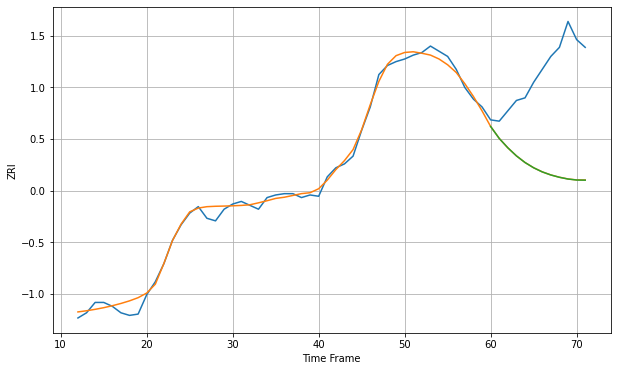

Wall time: 13.6 s
1013 4.594099623587685 77.15805051564129 77.19636806923648 [1093.89059456 1084.66831155 1077.41538639 1071.19186739 1066.05923234
 1062.01052112 1058.82795786 1056.45271779 1054.65193083 1053.31186884
 1052.53947654 1052.43945938]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


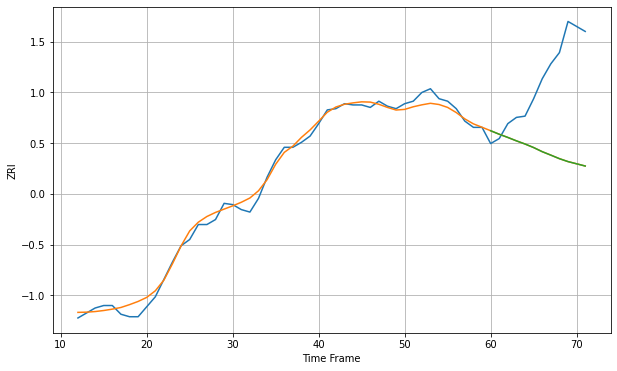

Wall time: 11 s
1020 5.039781271810547 67.78916187883355 67.79856979257045 [1125.30078684 1122.47649482 1119.91256231 1117.16889433 1114.63469312
 1111.78930647 1108.48142314 1105.71301636 1102.86089604 1100.51615112
 1098.74884765 1096.95219749]

Got an mse at 0.0025 in round 262 and stopped training

60 60 12


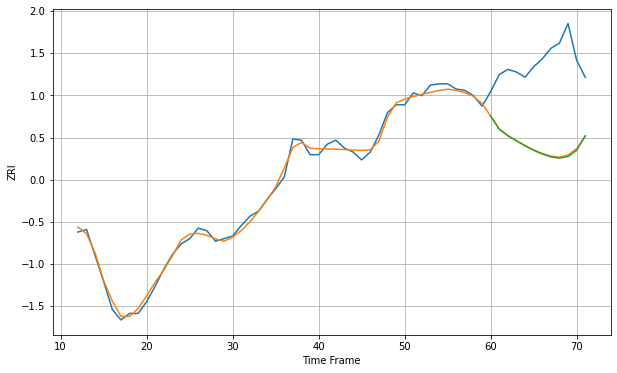

Wall time: 13.4 s
1040 3.5880072633883358 64.68035415950642 65.14477847327659 [1093.45704692 1083.48037681 1078.43889297 1074.56493062 1070.75337698
 1067.35822295 1064.46903142 1062.33467962 1061.32559106 1062.61599435
 1067.25480776 1078.42622247]

Got an mse at 0.0025 in round 273 and stopped training

60 60 12


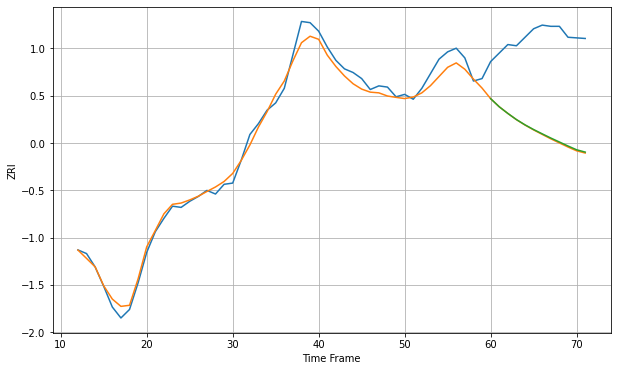

Wall time: 13.1 s
1085 6.682261388880148 78.26672374824314 77.7839504660651 [1141.47502089 1134.78459859 1129.32330254 1124.26400153 1119.91956754
 1116.05934497 1112.53627426 1109.07649171 1105.81325305 1102.5246545
 1099.41267676 1097.50470687]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


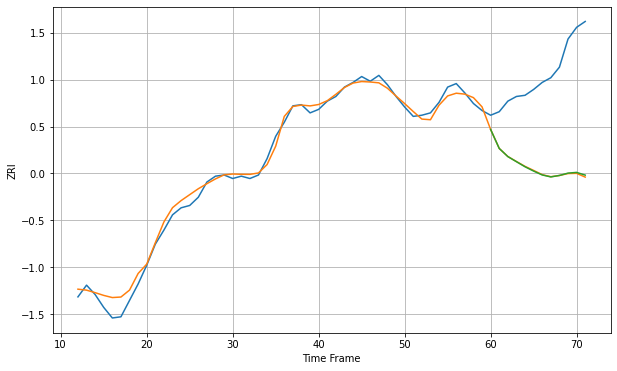

Wall time: 10 s
1104 5.955347557282379 83.21304982213658 82.95299440611389 [1100.83728416 1084.65707595 1077.71684458 1073.34648578 1069.01783845
 1065.32776395 1062.02427374 1060.36341731 1061.59126428 1063.60825655
 1064.21527471 1061.88933757]

Got an mse at 0.0025 in round 284 and stopped training

60 60 12


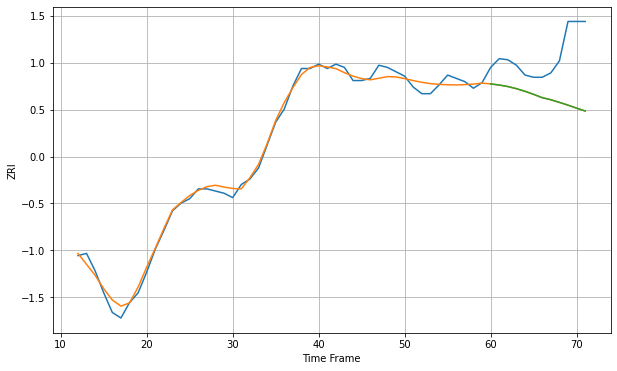

Wall time: 12.9 s
1108 5.2997122663451375 44.31530932767516 44.29375188094845 [1182.9266091  1181.90896728 1180.52474875 1178.56590647 1176.16426515
 1173.36690232 1170.35046142 1168.44399231 1166.04195265 1163.50333234
 1160.78268892 1158.18335905]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


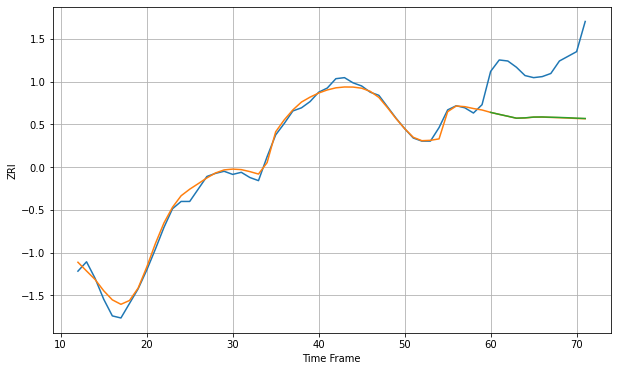

Wall time: 10.7 s
1109 5.51161302304768 54.211053199695996 54.069744095757216 [1149.60517251 1147.71432906 1145.90540608 1144.05019358 1144.352027
 1145.11091278 1145.20945429 1144.95618491 1144.74047922 1144.44069678
 1144.0445142  1143.73182254]

Got an mse at 0.0024 in round 156 and stopped training

60 60 12


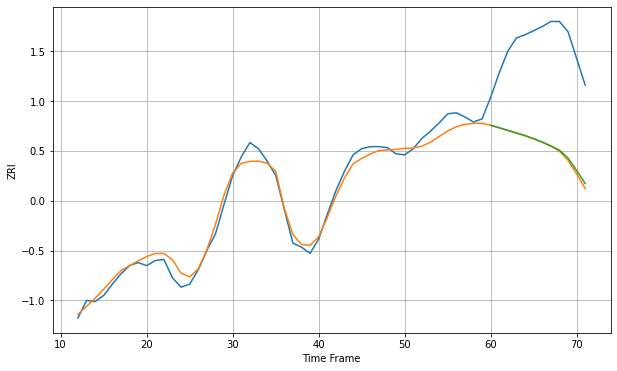

Wall time: 9.68 s
1420 7.849748574374207 100.40488258273524 99.27283295093031 [1224.82724341 1222.39079224 1219.83206366 1217.33955549 1214.74589836
 1211.76758148 1208.46352946 1204.79056858 1200.59397348 1192.86476127
 1180.83303085 1167.99119524]

Got an mse at 0.0025 in round 185 and stopped training

60 60 12


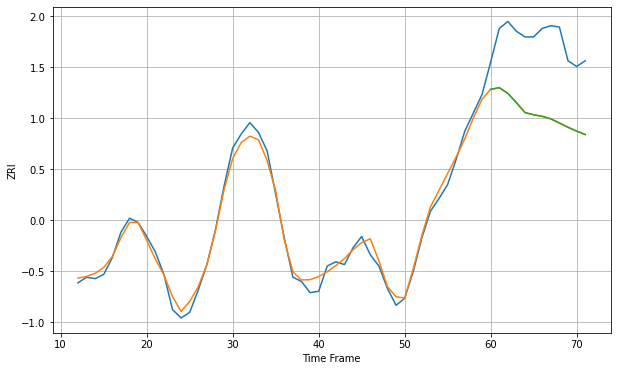

Wall time: 10.4 s
1440 4.955875684376643 52.735816828248595 52.74959108236669 [1195.67176996 1196.89615581 1192.81285958 1186.17302123 1179.11569615
 1177.60791375 1176.50027486 1174.6642203  1171.75637513 1168.72027722
 1165.99379993 1163.53262606]

Got an mse at 0.0025 in round 191 and stopped training

60 60 12


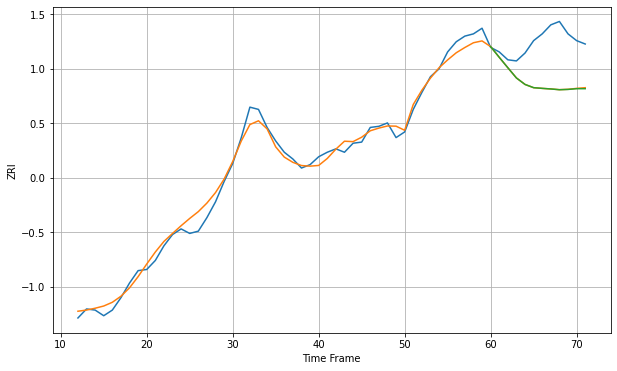

Wall time: 11.5 s
1453 6.824252558824836 38.47203978136052 38.59040478755358 [1319.69882091 1310.21100231 1300.96909451 1291.88890808 1286.14326641
 1283.27011016 1282.66342559 1282.12959001 1281.45728579 1281.72240989
 1282.37066336 1282.37147775]
60 60 12


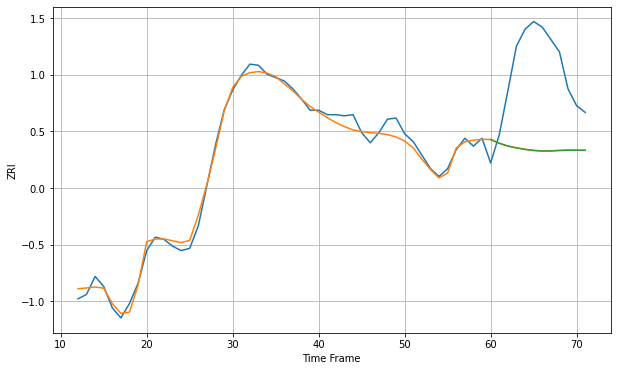

Wall time: 19.7 s
1545 6.036056104418608 76.94286610646225 77.00240000380954 [1521.89847811 1518.57411508 1516.08055683 1514.43941724 1513.12978921
 1512.1642119  1511.62488781 1511.68743434 1512.11013682 1512.40125468
 1512.36515755 1512.30295263]

Got an mse at 0.0025 in round 203 and stopped training

60 60 12


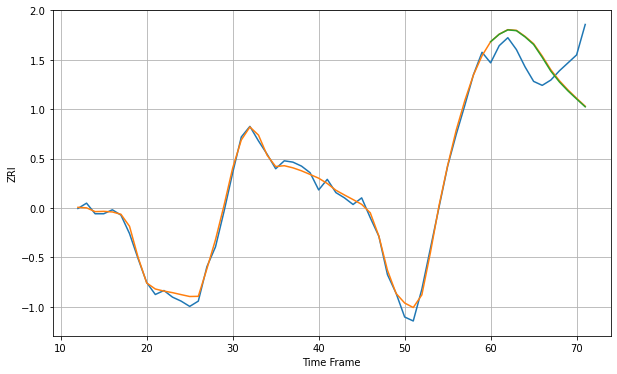

Wall time: 11 s
1550 3.95258415539543 25.553290041078846 25.575975190135313 [1248.9680962  1254.60003041 1257.90719098 1257.30288889 1252.62066628
 1246.85981857 1237.16745921 1226.76381712 1218.57943386 1211.78287243
 1205.7073936  1199.79056932]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


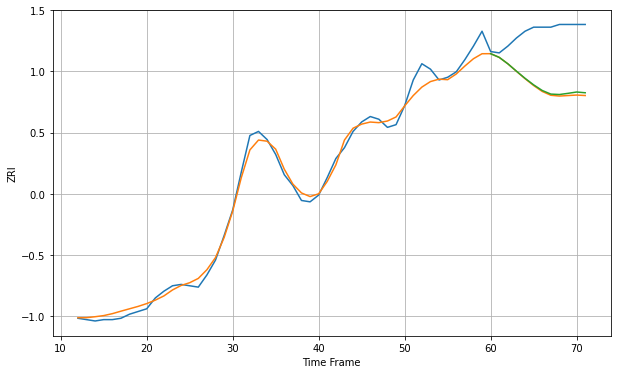

Wall time: 9.86 s
1602 5.610247941845204 40.500597436869235 39.509732108621705 [1388.42627178 1385.68639538 1380.96550634 1375.51489791 1370.23929103
 1365.41482063 1361.24231017 1358.57857268 1358.26199009 1359.1288743
 1360.10588183 1359.55525026]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


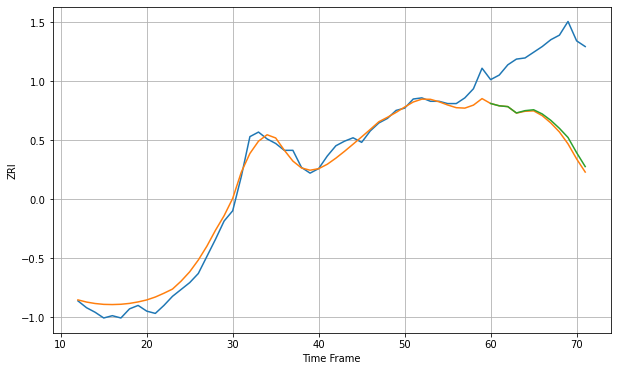

Wall time: 10.2 s
1603 8.274776892153293 70.7907510156642 68.08285611181421 [1280.07137616 1278.02919954 1277.32709365 1271.77708424 1273.79495253
 1274.57615334 1270.9008556  1265.28839519 1258.2899445  1250.26068774
 1236.96590133 1224.76431038]

Got an mse at 0.0025 in round 328 and stopped training

60 60 12


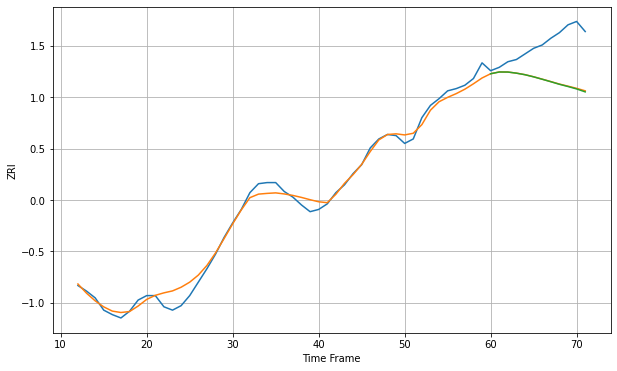

Wall time: 15 s
1604 6.373846472364077 35.56387557096963 35.8465224621553 [1341.27625506 1342.84648756 1342.79154917 1341.79535327 1340.3968724
 1338.50166641 1336.34678608 1334.14012064 1331.85020393 1329.85521228
 1327.70537069 1325.06379771]

Got an mse at 0.0025 in round 138 and stopped training

60 60 12


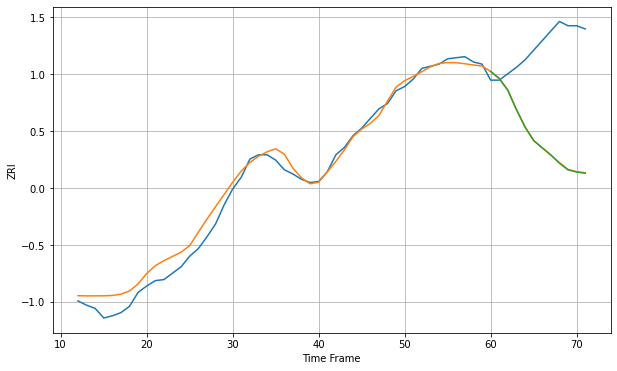

Wall time: 15.5 s
1605 9.546138011699423 95.36737574590792 95.58317896735005 [1307.13439517 1300.53802383 1289.58234262 1271.31915924 1254.93923158
 1242.45001831 1235.53934024 1228.82461242 1221.15336608 1214.86504302
 1212.81516288 1211.68875509]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


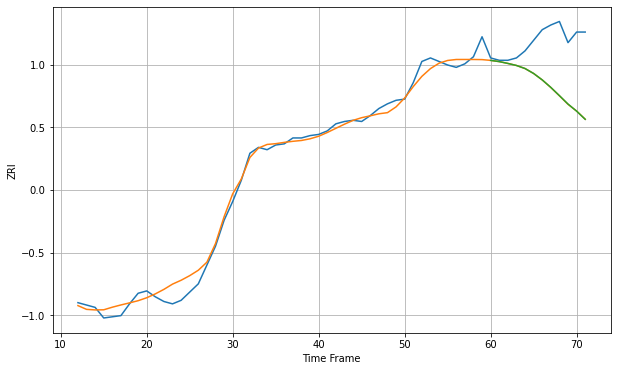

Wall time: 11.6 s
1610 6.898941184383799 43.25965609612604 43.22356548719299 [1317.92029577 1316.88728837 1315.34133758 1313.60578181 1311.00498175
 1306.79735136 1301.34565709 1294.96890193 1287.97327785 1280.80592826
 1274.78715123 1267.839934  ]
60 60 12


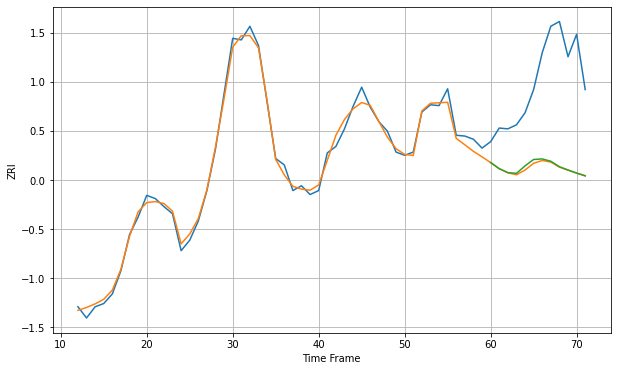

Wall time: 19.3 s
1702 7.720086142708571 117.29018039763065 116.28058332087261 [2250.92337517 2243.2963743  2238.39121696 2237.45219825 2246.79034157
 2254.77935121 2255.47294025 2252.5740607  2245.73306114 2241.65646797
 2237.81822934 2234.27078723]

Got an mse at 0.0025 in round 184 and stopped training

60 60 12


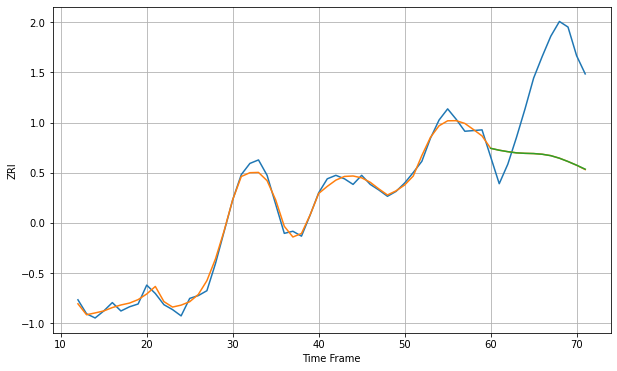

Wall time: 10.2 s
1752 7.756806345747412 124.52648665446353 124.48875242323398 [2040.61577754 2037.8836852  2035.79065744 2034.12027589 2033.44083999
 2033.11156522 2032.11610573 2030.09683211 2026.45265499 2021.70206966
 2016.46713735 2010.76618822]

Got an mse at 0.0025 in round 336 and stopped training

60 60 12


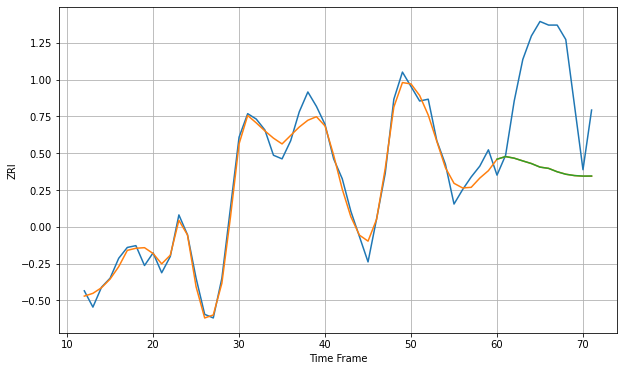

Wall time: 14.2 s
1757 5.5820516408149174 55.53287805802558 55.533903635138515 [1450.81386203 1452.26674657 1451.37681816 1449.85993609 1448.40404581
 1446.43101589 1445.73062948 1443.85075063 1442.48830554 1441.7683658
 1441.47360058 1441.52142746]
60 60 12


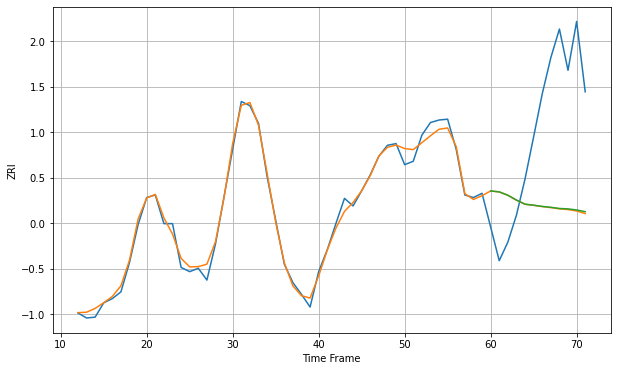

Wall time: 20.6 s
1760 7.466773486687143 133.34822936479688 132.77357956389002 [2297.79917113 2296.68272283 2292.74574795 2286.98287001 2282.08412121
 2280.88669932 2279.43800952 2278.38045669 2277.00293979 2276.52582909
 2275.20541533 2273.21253965]

Got an mse at 0.0025 in round 298 and stopped training

60 60 12


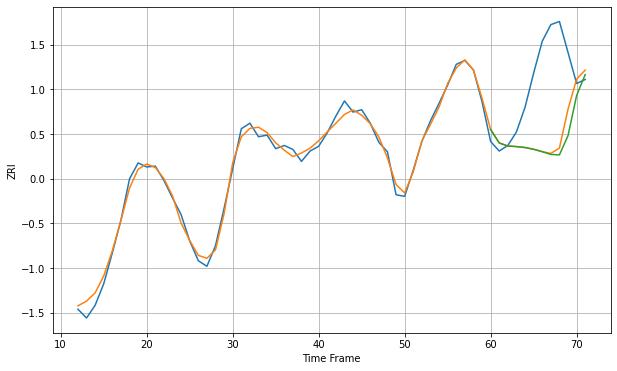

Wall time: 13.3 s
1801 7.737863883069031 85.88959767614404 90.2471220178493 [2218.09831398 2201.10420202 2197.32289765 2196.60753424 2195.41760492
 2193.20908614 2190.14714045 2186.72254014 2186.16625412 2210.32979925
 2260.84792331 2287.16402141]

Got an mse at 0.0025 in round 315 and stopped training

60 60 12


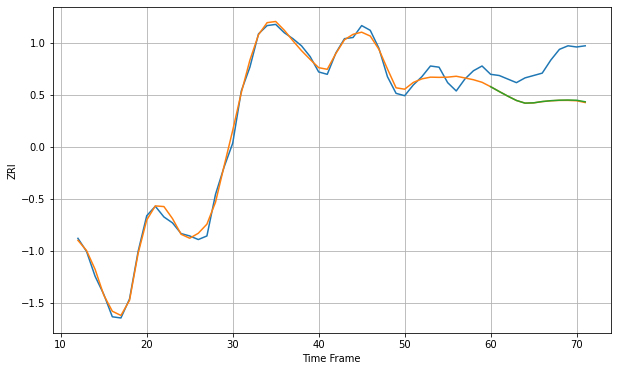

Wall time: 14.3 s
1830 5.24049176609138 31.266812371197172 31.060121644574874 [1615.58197285 1611.5316629  1607.62979804 1604.01796192 1601.76604467
 1602.00833204 1603.10477285 1603.82869637 1604.23348371 1604.36414589
 1604.19029824 1602.90217286]

Got an mse at 0.0025 in round 219 and stopped training

60 60 12


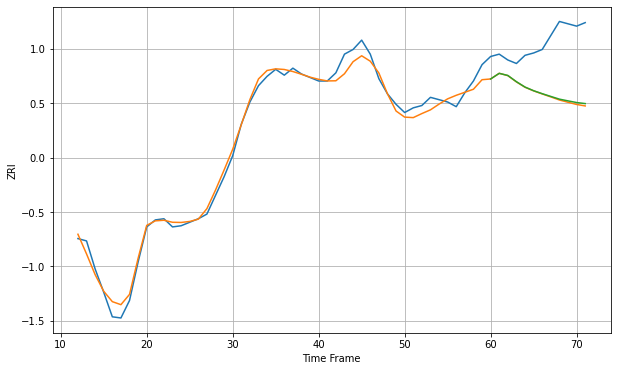

Wall time: 11.3 s
1832 6.488605428292842 46.305444388394825 45.539975104701696 [1567.74088701 1572.55941122 1570.74266128 1565.40066761 1560.80323141
 1557.67661769 1555.1313729  1552.77236134 1550.45443359 1548.97719279
 1547.54729917 1546.65473739]

Got an mse at 0.0025 in round 489 and stopped training

60 60 12


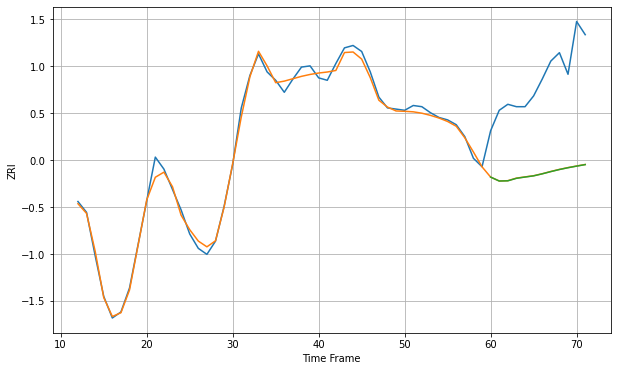

Wall time: 19.4 s
1841 4.618780145554556 79.97288262474446 80.07092113278911 [1553.35983413 1550.0781692  1550.25347988 1552.34274449 1553.40485889
 1554.385761   1556.06219749 1557.93783006 1559.67041853 1561.16477482
 1562.48745514 1563.75644577]

Got an mse at 0.0025 in round 450 and stopped training

60 60 12


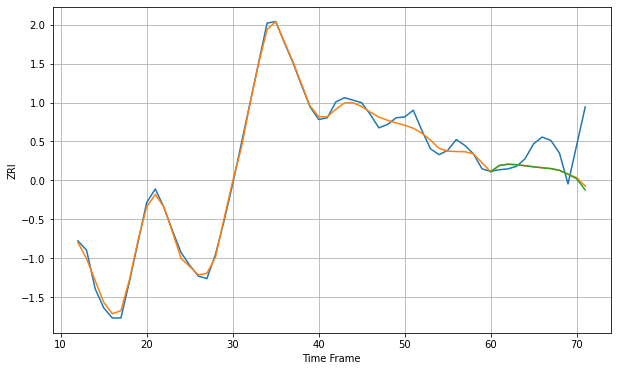

Wall time: 18.8 s
1843 6.586194161260999 34.59743359918127 35.7740363230493 [1671.56844326 1679.02850573 1680.55822779 1679.99270558 1678.77204812
 1677.46948665 1676.298744   1675.33752078 1673.33455674 1668.7054576
 1663.26439788 1649.76153064]

Got an mse at 0.0025 in round 450 and stopped training

60 60 12


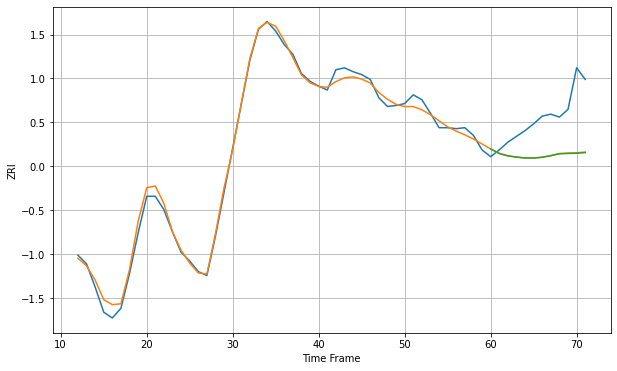

Wall time: 17.2 s
1844 6.1129246434577995 44.08304886246168 44.292237383866755 [1675.07301668 1670.39398181 1667.8433431  1666.5893408  1665.66702645
 1665.5987144  1666.43830193 1668.02867716 1670.09941882 1670.33262907
 1670.52898342 1671.22732324]

Got an mse at 0.0025 in round 267 and stopped training

60 60 12


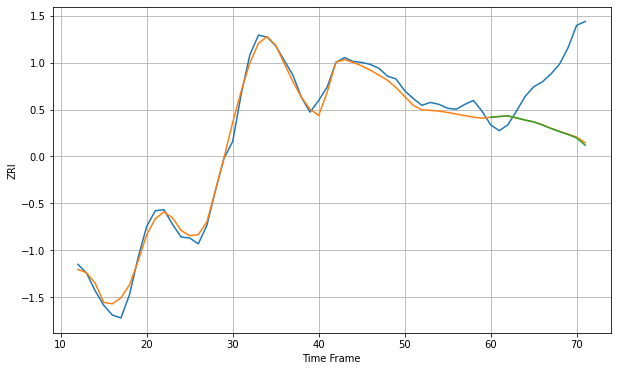

Wall time: 12.5 s
1845 7.7900645057526114 63.51631771523114 64.13992410137274 [1801.75982628 1802.55502359 1803.16897574 1801.17071672 1798.94524223
 1797.08006994 1793.98849588 1790.40270633 1787.12326693 1784.06234472
 1780.57244211 1773.15359993]

Got an mse at 0.0025 in round 414 and stopped training

60 60 12


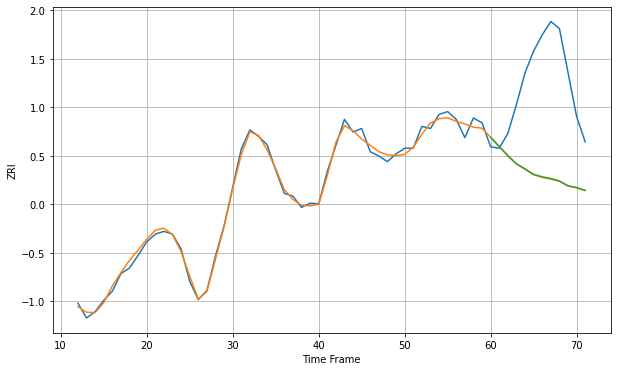

Wall time: 15.9 s
1850 6.889235712111534 140.44459827133343 140.11209893343673 [1978.5245167  1965.38502339 1952.46251808 1940.85129075 1933.49584816
 1925.84802483 1922.39927472 1920.03665426 1916.45802953 1909.70916582
 1907.18790667 1903.16479869]

Got an mse at 0.0025 in round 414 and stopped training

60 60 12


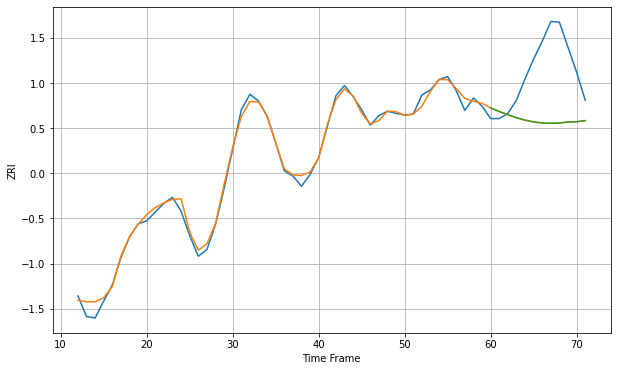

Wall time: 18.1 s
1851 7.441908203862323 80.21323034602592 80.19932056243408 [1999.4487169  1994.64031295 1990.20095615 1986.26946643 1982.90810014
 1980.47402801 1978.99241608 1978.64301165 1979.03117719 1980.32296534
 1980.76535553 1982.25854827]

Got an mse at 0.0025 in round 249 and stopped training

60 60 12


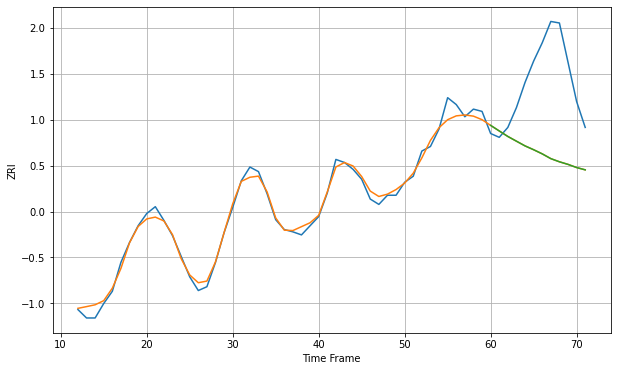

Wall time: 12.2 s
1852 8.233055844578743 107.25001618677949 107.25810434027873 [1975.67060892 1968.36607716 1961.1344242  1954.93842175 1948.75621536
 1943.73282178 1938.30743273 1932.04279927 1927.90414553 1924.49049468
 1920.35085629 1917.30871572]

Got an mse at 0.0025 in round 256 and stopped training

60 60 12


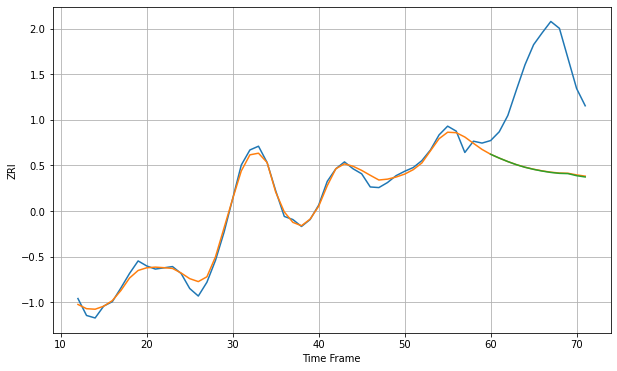

Wall time: 12.5 s
1854 8.606656264689223 161.4622498798253 161.875040742666 [1990.13503293 1984.04000822 1978.47220851 1973.49934759 1969.3608431
 1966.06154795 1963.35095267 1961.16717195 1959.71361384 1959.28025348
 1955.97758149 1953.91047151]

Got an mse at 0.0025 in round 231 and stopped training

60 60 12


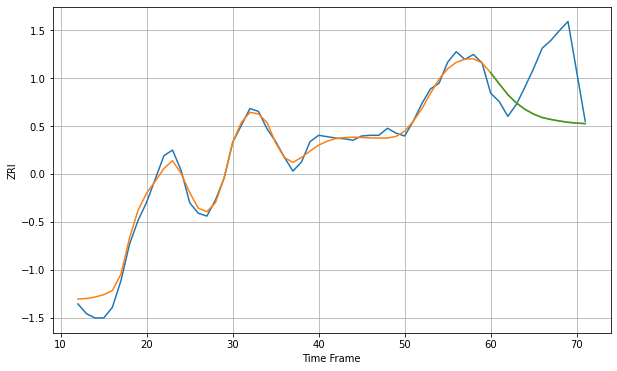

Wall time: 11.7 s
1876 11.259520035429322 77.77763101862344 77.82026581967003 [2180.09130712 2164.18960039 2148.86957038 2136.87044266 2127.89702423
 2121.13084842 2116.30115958 2113.51970235 2111.289813   2109.51304657
 2108.26912856 2107.57502838]

Got an mse at 0.0025 in round 400 and stopped training

60 60 12


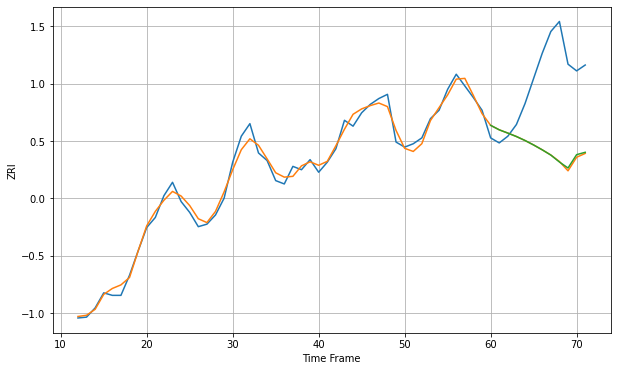

Wall time: 15.9 s
1880 7.899228261070873 95.699329950824 95.02656158034918 [2191.98674903 2186.63791618 2182.72804711 2178.62362962 2173.87829656
 2168.53619406 2162.75676734 2156.49968208 2148.21538615 2141.05128251
 2156.9904702  2159.8107081 ]

Got an mse at 0.0025 in round 245 and stopped training

60 60 12


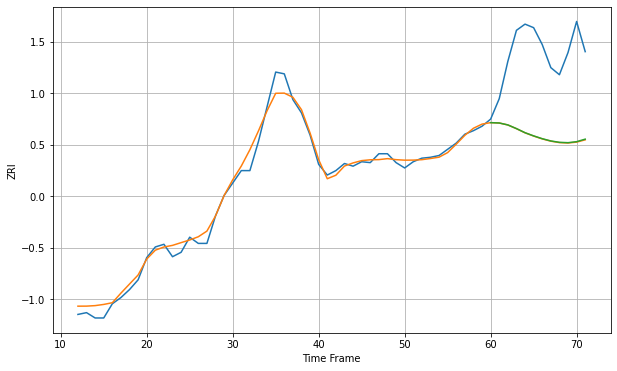

Wall time: 12.4 s
1902 8.364026796664113 96.08695495021388 95.81195927711214 [1758.03185995 1757.63955468 1755.46474778 1751.34204108 1746.70496563
 1743.12574767 1739.95983828 1737.41615302 1735.85793368 1735.45122426
 1736.59216917 1739.44394011]
60 60 12


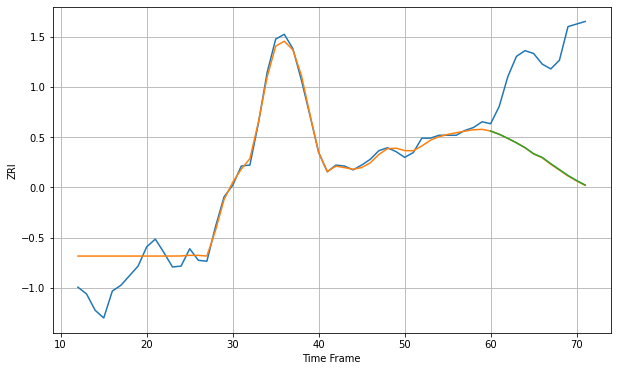

Wall time: 20 s
1905 17.048178577394914 110.44076589817283 110.13520376278439 [1748.38387828 1745.02673422 1740.78140443 1736.15172212 1731.10218619
 1724.79437898 1720.97433384 1714.43204317 1708.30494215 1702.21188599
 1696.95159466 1692.23913169]

Got an mse at 0.0025 in round 213 and stopped training

60 60 12


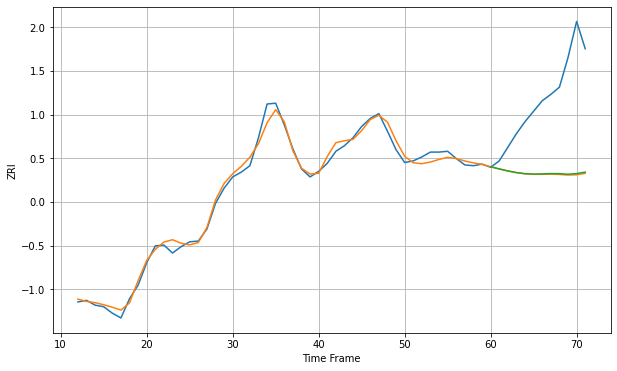

Wall time: 11.9 s
1915 7.246153170808572 102.56612468900434 101.80818059507907 [1818.71328764 1815.98049394 1813.47825495 1811.4251816  1810.03936987
 1809.5513501  1809.79248726 1810.22126225 1810.09458584 1809.36718622
 1810.18310979 1812.00697507]

Got an mse at 0.0025 in round 354 and stopped training

60 60 12


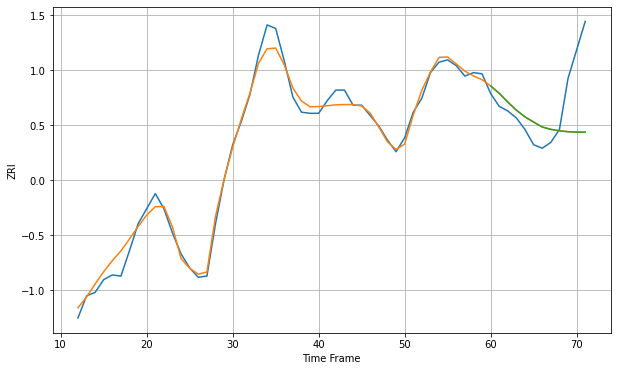

Wall time: 15.1 s
1930 7.454389852782223 38.045240527271005 38.06004221040698 [1773.56306629 1767.21470146 1759.65008194 1752.65425826 1746.88288623
 1742.48639839 1738.2344595  1736.17165231 1734.93874297 1734.17578575
 1733.85956246 1733.79159216]

Got an mse at 0.0025 in round 256 and stopped training

60 60 12


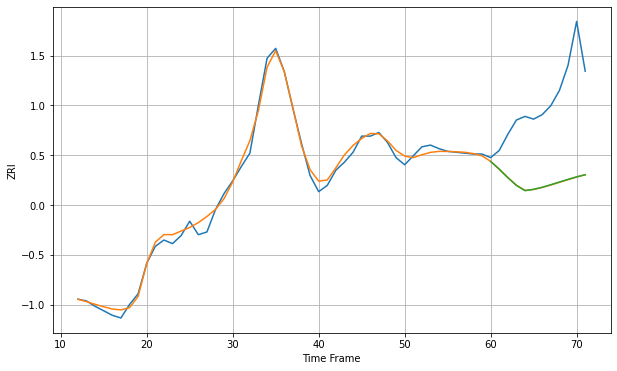

Wall time: 12.4 s
1960 6.451206139015593 93.91423153929712 93.81486682893897 [1789.77836191 1781.08928921 1771.67833046 1762.95689324 1757.17532093
 1758.61307893 1760.9236736  1763.74990997 1766.75803419 1769.72358573
 1772.49161219 1774.89013961]

Got an mse at 0.0025 in round 363 and stopped training

60 60 12


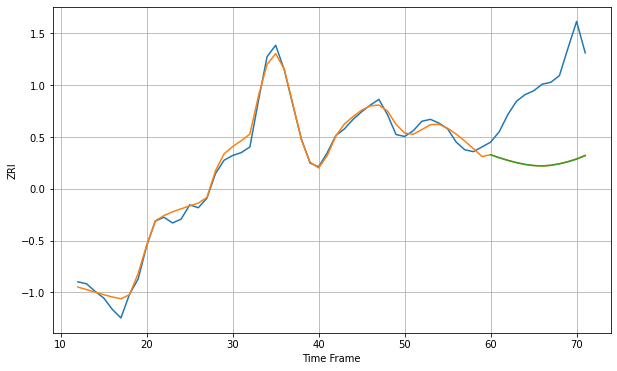

Wall time: 15 s
1970 6.8429547391126615 86.30045437678775 86.42002822841782 [1823.76451206 1820.627362   1817.8453717  1815.47691952 1813.59469912
 1812.40258581 1811.95626534 1812.61423072 1814.20131701 1816.38051743
 1819.16572088 1822.78056316]

Got an mse at 0.0024 in round 247 and stopped training

60 60 12


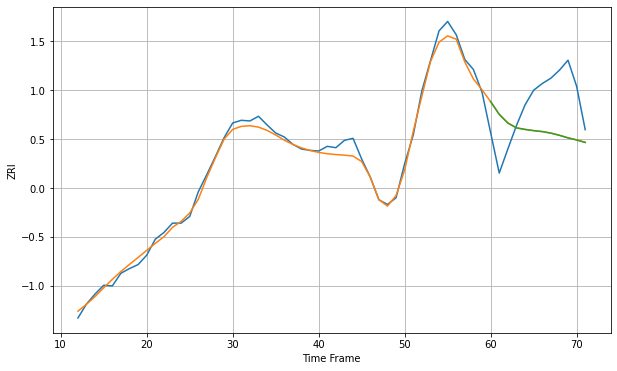

Wall time: 11.3 s
2026 9.129084048594247 69.57040823046975 69.67384011231826 [2244.98900943 2225.89125296 2212.88348598 2205.63823164 2203.30926204
 2201.48796223 2200.07163316 2197.78920523 2194.49865347 2190.62623918
 2187.47552932 2183.7588    ]

Got an mse at 0.0025 in round 188 and stopped training

60 60 12


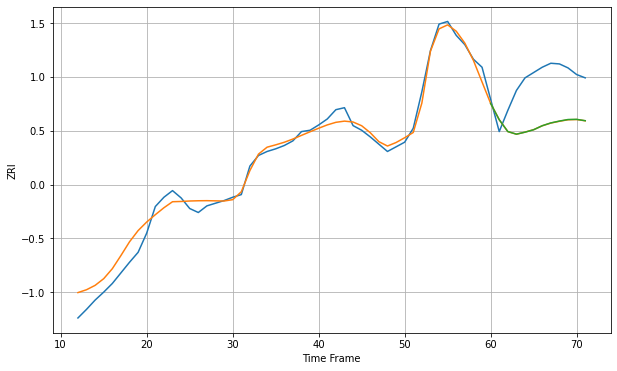

Wall time: 10.8 s
2062 14.645853484520304 69.61551490311892 69.48984373443801 [2131.45972824 2106.86750482 2089.02119141 2085.07505562 2088.10071176
 2091.77012296 2097.81803655 2102.0468431  2104.85998513 2107.17885706
 2107.4527589  2105.40890904]

Got an mse at 0.0025 in round 273 and stopped training

60 60 12


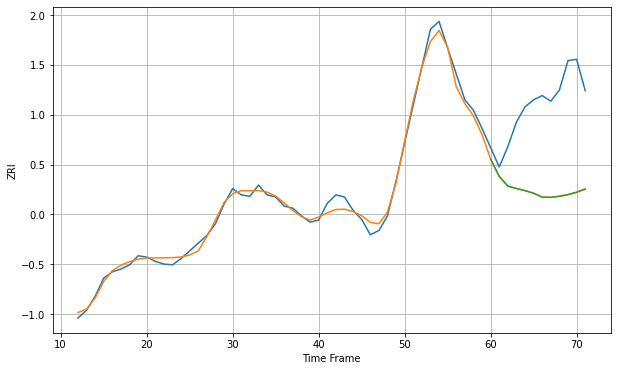

Wall time: 12.1 s
2072 8.285524495217985 129.48140061414873 129.1987165242123 [1914.14886143 1889.38770075 1875.64506653 1872.1584936  1869.1043388
 1865.39525053 1859.76528827 1859.64597078 1861.14762286 1863.60202671
 1866.95911222 1871.67203133]
60 60 12


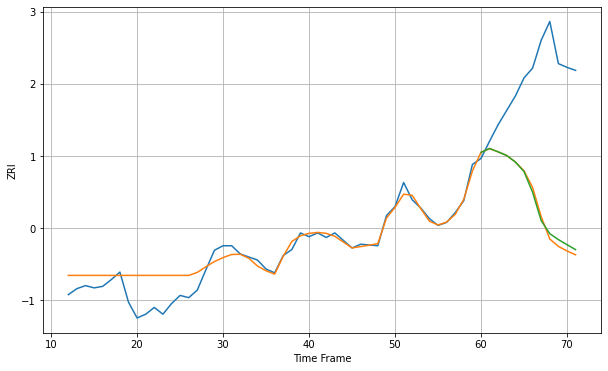

Wall time: 18.4 s
2111 19.438700132993443 175.65148852656156 173.05301320635468 [2862.1002699  2867.19794016 2862.69702963 2857.8720403  2849.1841339
 2836.63395893 2809.00417676 2771.354886   2754.00827262 2746.17635976
 2739.39375881 2732.80238914]
60 60 12


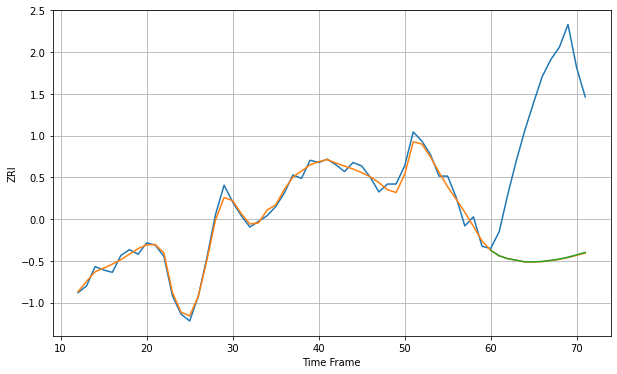

Wall time: 18.7 s
2113 4.957542363640023 137.6744950532286 137.47502172358648 [2592.49966134 2587.58192851 2585.04049112 2583.67915818 2582.2464945
 2582.27923316 2582.57008372 2583.54355749 2584.70410083 2586.35560244
 2588.4546487  2590.60218198]
60 60 12


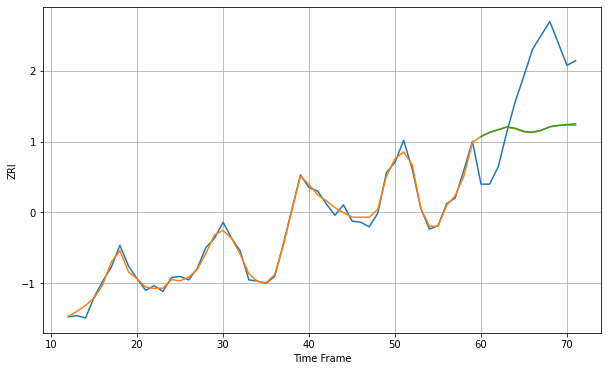

Wall time: 18.4 s
2114 4.037055556016296 57.00642314623339 56.73515052824541 [2799.24110483 2802.93732331 2805.27577684 2807.64725537 2806.41502549
 2803.7049667  2803.02998493 2804.73218188 2807.81179576 2808.9254605
 2809.61567286 2810.23279182]
60 60 12


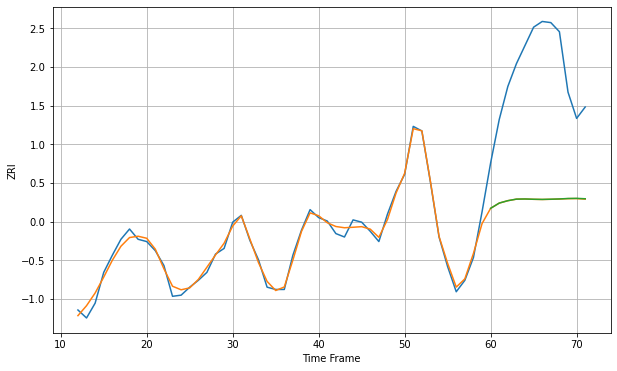

Wall time: 18 s
2115 4.455851146141752 116.22659273974782 116.15710377113979 [2913.15615827 2917.74667128 2919.85384569 2921.21426491 2921.34582841
 2921.09292977 2920.95347156 2921.13621913 2921.37448362 2921.77311224
 2921.8920817  2921.54272064]

Got an mse at 0.0025 in round 449 and stopped training

60 60 12


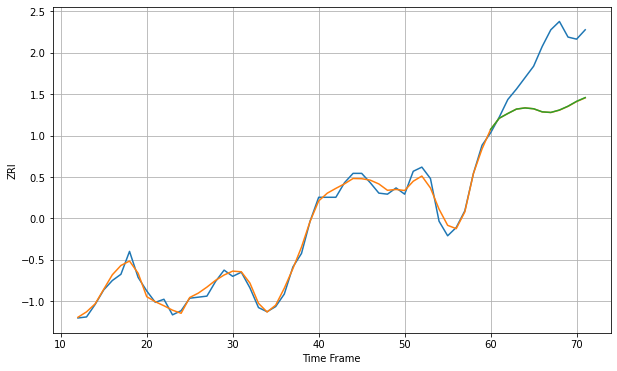

Wall time: 17.4 s
2116 5.282176372430286 52.40246228967377 52.29835502187982 [2825.31189528 2835.98987039 2840.53329301 2844.7759893  2845.90577749
 2845.09230302 2842.11754607 2841.57314645 2843.8765797  2847.56241622
 2852.24615407 2855.84404401]

Got an mse at 0.0024 in round 337 and stopped training

60 60 12


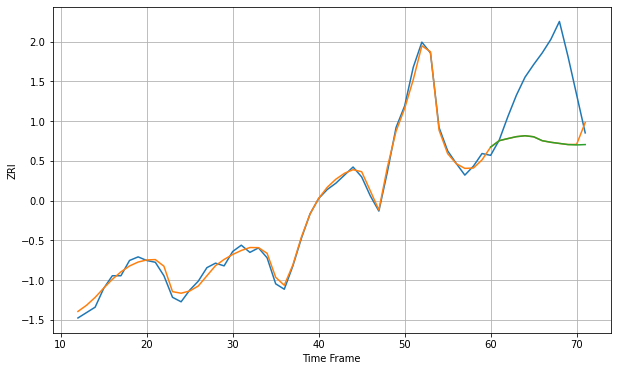

Wall time: 15.1 s
2118 5.464165165846835 74.93327333528097 74.99157298949416 [2962.21215809 2969.3260127  2971.65261822 2973.79744652 2974.81114087
 2973.66501559 2969.30675415 2967.54368584 2966.25748439 2965.00126305
 2964.59560647 2964.98294376]

Got an mse at 0.0025 in round 436 and stopped training

60 60 12


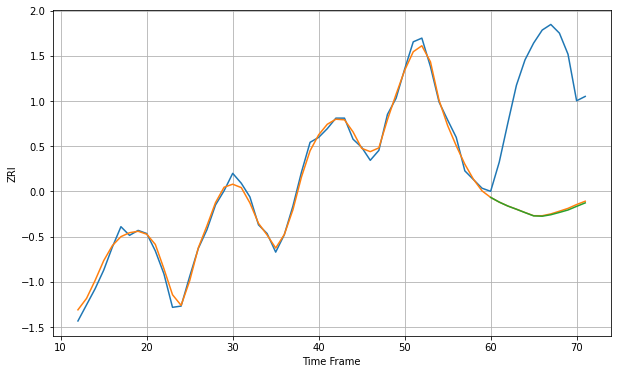

Wall time: 19.5 s
2119 9.204190779427638 220.53724898267401 221.63720300826938 [2773.21285384 2765.62272574 2759.30968914 2754.15071132 2748.71544997
 2743.44671578 2742.88596471 2745.2530752  2748.9753136  2752.92170695
 2758.75848199 2764.37347763]

Got an mse at 0.0025 in round 287 and stopped training

60 60 12


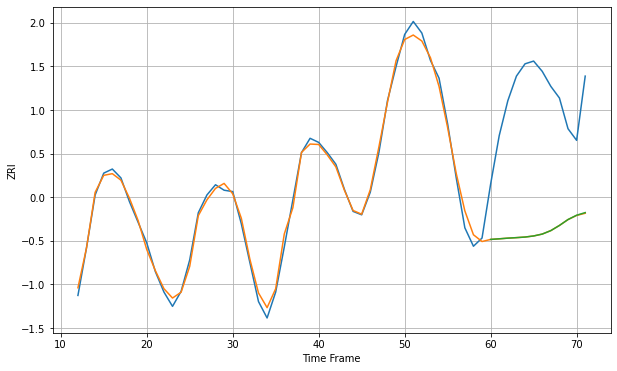

Wall time: 13.7 s
2120 8.91058982024515 196.1659639477018 196.05653632583483 [3099.97711793 3100.87455548 3101.84026171 3102.59323654 3103.44167413
 3105.04734453 3107.79716882 3112.88176859 3120.42830971 3129.09927157
 3135.38069393 3139.25539972]

Got an mse at 0.0025 in round 426 and stopped training

60 60 12


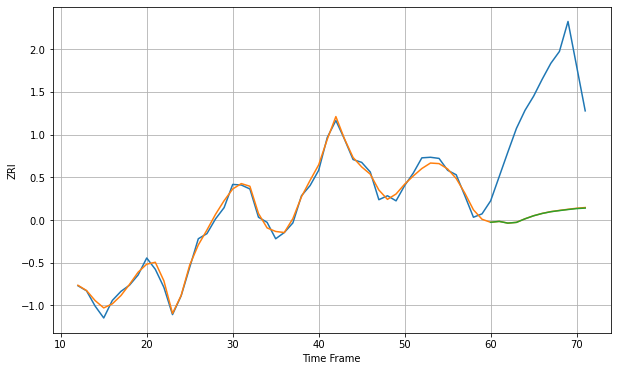

Wall time: 16.4 s
2121 8.555548265098224 211.86294343117427 212.11988645216064 [2374.09752422 2375.66950972 2372.63211221 2373.92013806 2380.23736336
 2385.61630173 2389.70554571 2392.77487977 2394.79166227 2396.6549367
 2398.32551108 2399.21369248]
60 60 12


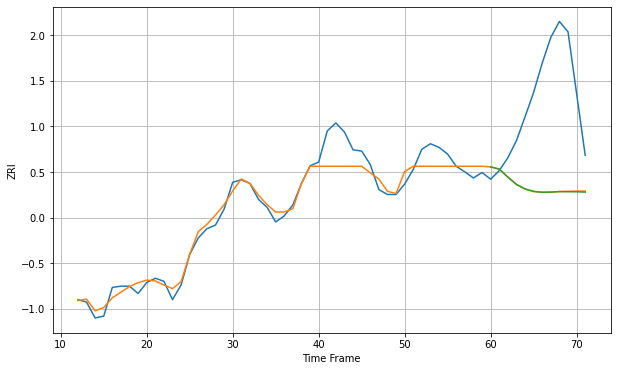

Wall time: 18.3 s
2122 20.630811547798913 165.80057362710335 165.9876534960405 [2428.10843701 2424.5531006  2411.39980966 2399.50853203 2391.96040938
 2388.013738   2386.65501022 2386.89821026 2387.75113712 2387.52603979
 2387.39830759 2386.84799338]
60 60 12


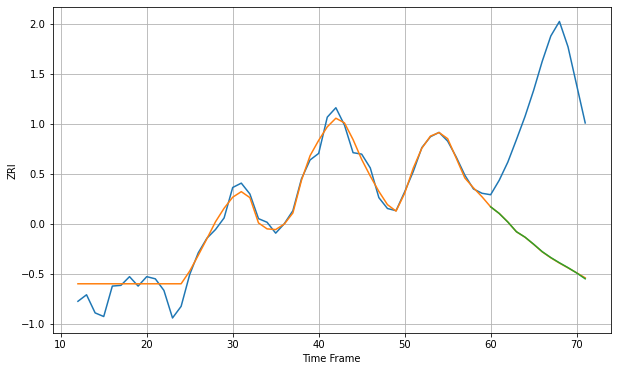

Wall time: 18.4 s
2124 14.635880156099148 219.43344246097647 219.3734217004689 [2290.30024007 2281.14381788 2269.36596976 2256.00757019 2248.4911305
 2238.77602433 2228.48811696 2220.32758022 2213.14313254 2206.41447229
 2199.14139622 2191.02561433]

Got an mse at 0.0024 in round 376 and stopped training

60 60 12


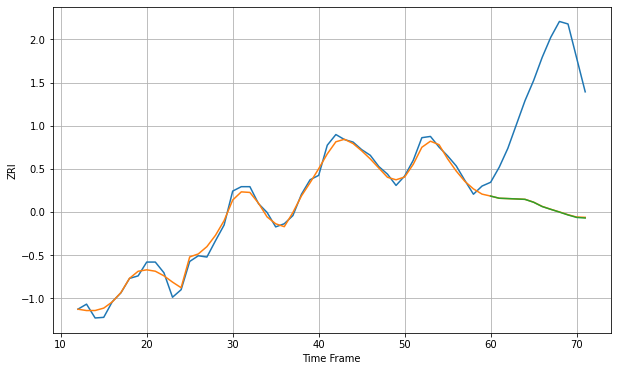

Wall time: 14.6 s
2125 8.8072738774871 205.1796573621977 205.46371542147878 [2482.04496165 2478.5863534  2478.05984209 2477.46877855 2476.78192474
 2472.20352653 2465.34561892 2460.88550704 2456.57861832 2451.98959474
 2448.06915408 2447.10311979]

Got an mse at 0.0024 in round 320 and stopped training

60 60 12


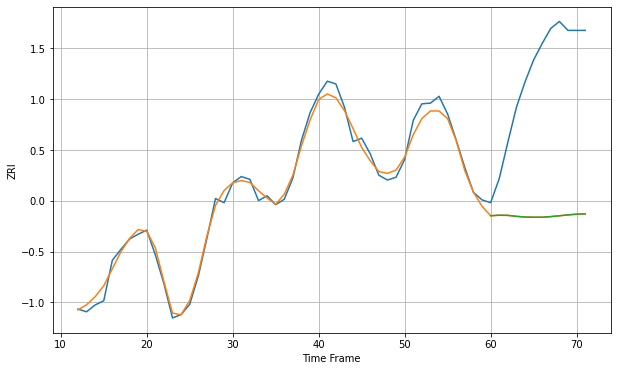

Wall time: 14 s
2126 10.657099802084508 217.2322345639201 217.17330282349812 [2267.93383903 2268.71764637 2268.49466312 2267.08901237 2266.05813699
 2265.81246981 2265.80191968 2266.69612572 2267.93139495 2269.20354309
 2270.25218792 2270.71898865]

Got an mse at 0.0025 in round 475 and stopped training

60 60 12


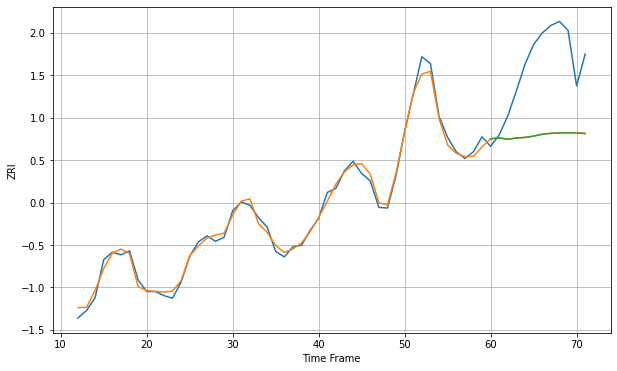

Wall time: 18.3 s
2127 8.29068919850154 112.4824110004309 112.52963154826772 [2872.20318266 2873.46467239 2871.30988434 2873.28497691 2874.09199932
 2876.01125866 2878.80824909 2880.04512711 2880.72165465 2880.95488099
 2880.69029839 2879.74565198]

Got an mse at 0.0024 in round 206 and stopped training

60 60 12


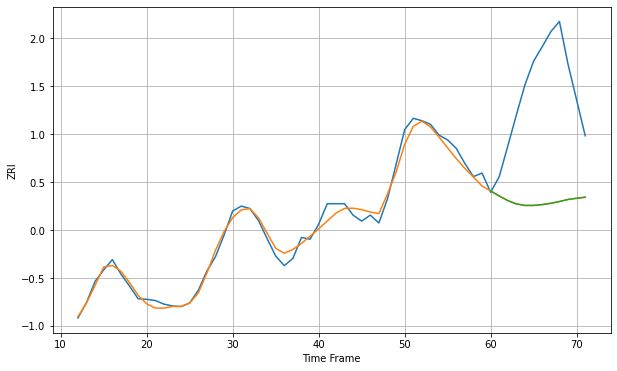

Wall time: 12.1 s
2128 11.060085258610425 195.16096012631644 195.13543785731278 [2462.21806765 2453.76597553 2446.12172904 2440.58203282 2438.08991767
 2438.11461995 2439.51696385 2441.65657482 2444.58872139 2448.0823847
 2450.0121555  2451.9609389 ]
60 60 12


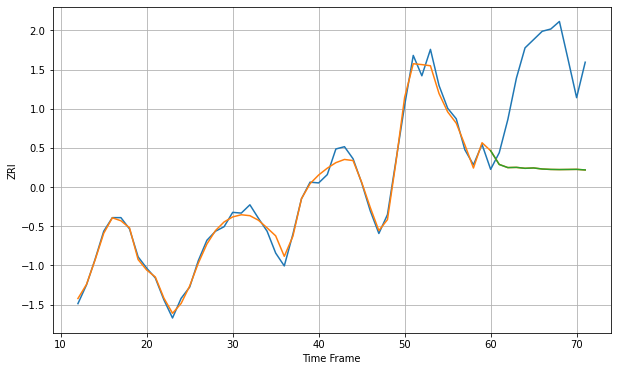

Wall time: 19.3 s
2129 8.269981272337416 138.64303775875436 138.6343514132318 [2800.69834564 2782.46129629 2778.31957497 2778.61679753 2777.36962586
 2777.84521924 2776.45277622 2775.88547483 2775.70479882 2775.83236205
 2775.97536196 2775.20824753]
60 60 12


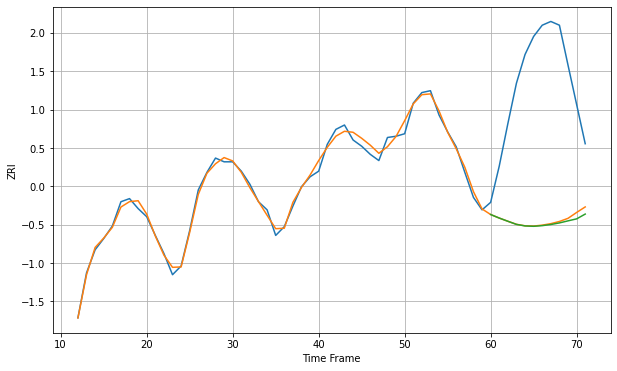

Wall time: 19 s
2130 7.9317261524990075 234.18234584240437 236.20851533957244 [2601.49313222 2595.83855639 2590.69017118 2585.67098718 2583.2010611
 2582.62169218 2583.65996749 2585.47854029 2588.02681064 2591.33370146
 2594.51651648 2602.19962779]
60 60 12


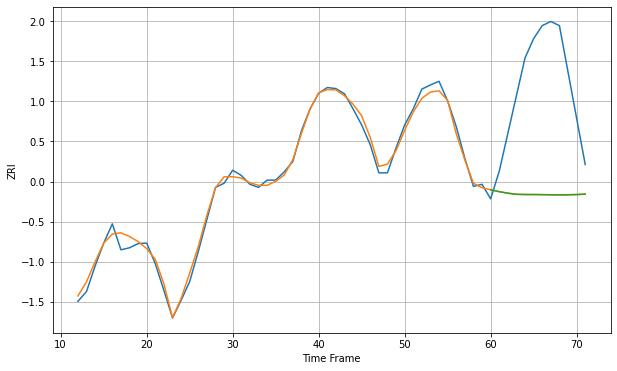

Wall time: 19.1 s
2131 11.283653549666612 226.0577876302023 225.91471069994128 [2384.49658639 2380.82473956 2377.90906978 2375.75032548 2375.36133356
 2375.31874582 2375.16336225 2374.88100549 2374.75824566 2374.91894465
 2375.48093972 2376.09397022]

Got an mse at 0.0025 in round 385 and stopped training

60 60 12


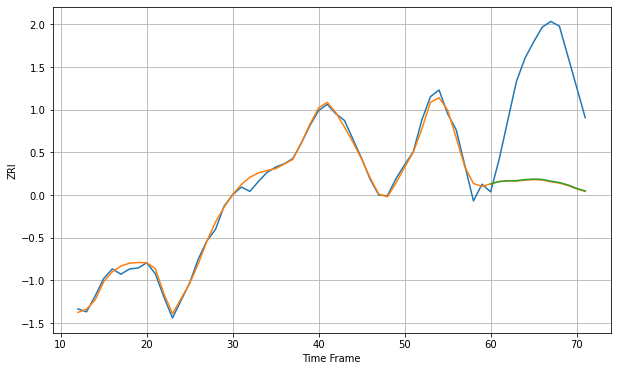

Wall time: 15.5 s
2132 10.745901088140458 238.0493956306988 237.15820994668553 [2389.86655671 2394.52758327 2396.21643749 2396.50659264 2398.67564997
 2399.7994003  2399.16618389 2395.3946923  2392.56251119 2387.41057716
 2380.3449898  2374.81509458]

Got an mse at 0.0025 in round 327 and stopped training

60 60 12


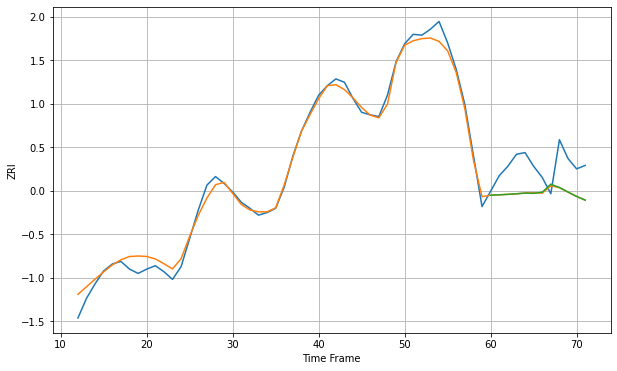

Wall time: 14.4 s
2134 9.01455424183082 34.92174160281507 34.98936744749824 [2597.20728035 2597.72563563 2598.25147704 2598.91022752 2599.67996546
 2599.44166561 2600.70019989 2610.12543532 2606.23279895 2600.9410755
 2595.78746191 2591.4559595 ]

Got an mse at 0.0024 in round 344 and stopped training

60 60 12


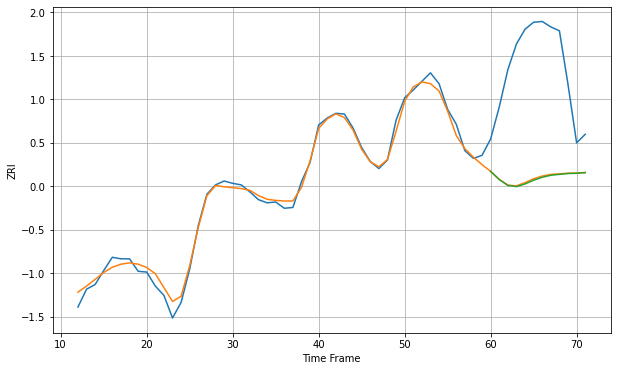

Wall time: 15.4 s
2135 7.917257947529733 150.25788058627313 151.178394100768 [2706.35184272 2695.94285942 2688.34304155 2686.77630159 2690.23247027
 2694.98738286 2698.80917283 2701.40258725 2702.54090628 2703.62212543
 2703.92277171 2704.66454721]

Got an mse at 0.0025 in round 280 and stopped training

60 60 12


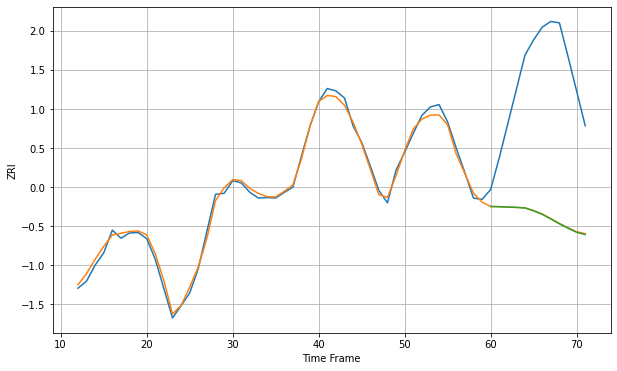

Wall time: 14.9 s
2136 9.93161249243068 306.3032204063474 306.87980669592497 [2332.14543119 2331.70621138 2330.79934662 2330.22719923 2329.01285088
 2322.97714687 2315.61078334 2305.73891667 2295.4503818  2286.1051302
 2277.39571416 2272.80723006]

Got an mse at 0.0025 in round 347 and stopped training

60 60 12


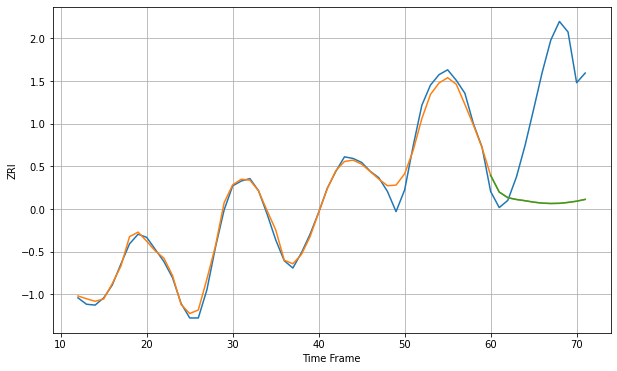

Wall time: 15.6 s
2138 8.264536854731487 138.14987454268655 138.15544795646954 [2541.00084743 2520.24290725 2513.25286078 2511.02757947 2509.52833702
 2507.77420747 2506.55772568 2506.08851734 2506.31904564 2507.37833651
 2508.90750701 2511.14963971]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


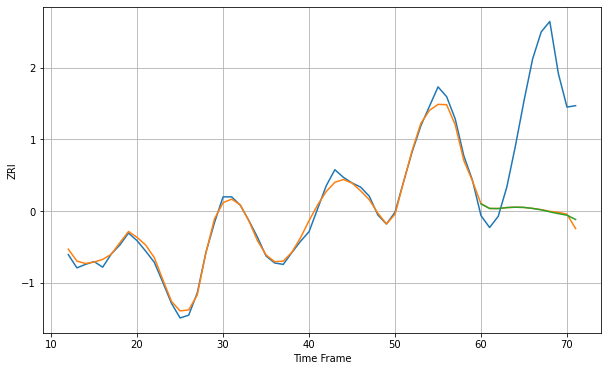

Wall time: 13.8 s
2139 7.229171992559799 161.60929308186905 160.91634974125483 [2599.01284542 2592.3163421  2592.2072249  2593.6358768  2594.14049787
 2593.82094217 2592.37630606 2590.38056989 2587.48537658 2584.88535104
 2582.65903216 2576.50847167]

Got an mse at 0.0025 in round 293 and stopped training

60 60 12


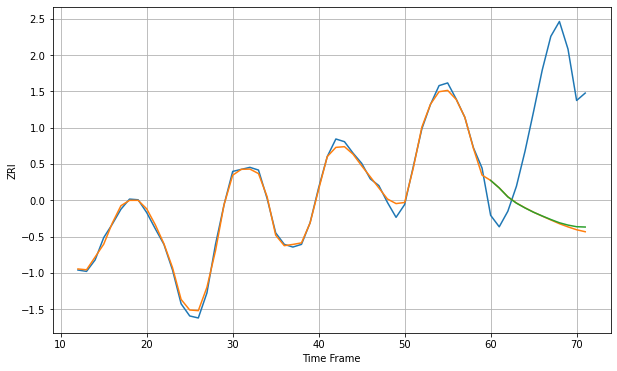

Wall time: 13.7 s
2140 6.064846085382364 181.37975154953853 179.72195415280726 [2563.66225053 2552.48101048 2539.26771043 2530.01733238 2522.9079277
 2516.52970735 2511.00686977 2505.79293322 2500.98485398 2497.5261889
 2495.11380553 2494.64417787]

Got an mse at 0.0025 in round 279 and stopped training

60 60 12


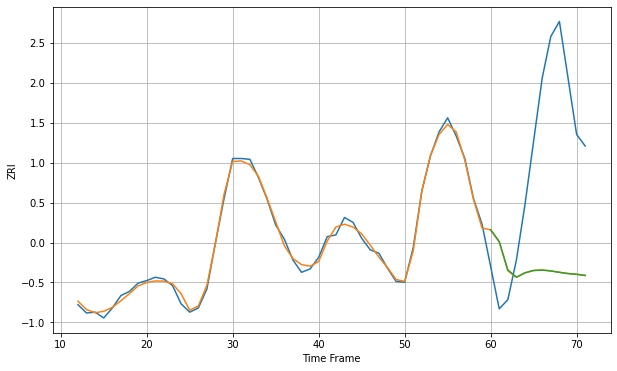

Wall time: 12.8 s
2141 4.806180065148066 176.47978990897505 176.51876661054587 [2557.18371471 2542.99747411 2508.84850317 2500.15090627 2505.38462917
 2508.19635162 2508.73227345 2507.61579847 2505.96984013 2504.4386311
 2503.53093006 2502.25973622]

Got an mse at 0.0025 in round 273 and stopped training

60 60 12


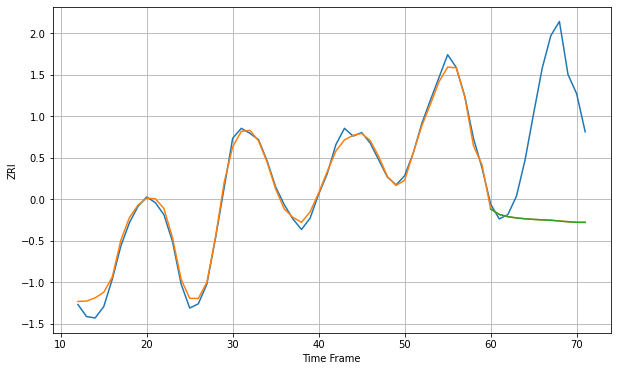

Wall time: 12.9 s
2143 8.799676151887054 162.32135710679128 162.44263090309192 [2417.04453693 2409.28659475 2406.19031532 2404.33327021 2403.18660908
 2402.28522675 2401.63308217 2401.10601408 2399.96009439 2398.89428756
 2398.12595767 2397.97275268]

Got an mse at 0.0025 in round 308 and stopped training

60 60 12


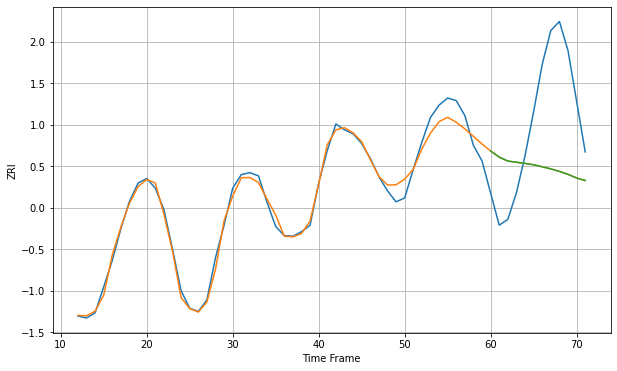

Wall time: 13.9 s
2144 12.96325074410492 131.7524733720613 131.80284616694118 [2610.35097043 2600.86491906 2594.82887839 2593.03454717 2591.19260526
 2589.18527613 2586.01303267 2582.73721065 2578.94013623 2574.31258132
 2568.66115082 2564.82184747]

Got an mse at 0.0025 in round 393 and stopped training

60 60 12


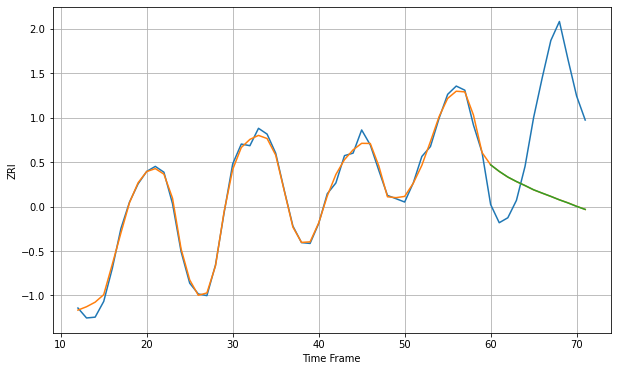

Wall time: 15.3 s
2145 6.178664642943327 121.69678065589162 121.71155802201876 [2387.89170834 2379.9939436  2373.16760029 2367.75319734 2362.90792545
 2357.78273766 2353.74498102 2349.81385243 2345.633157   2341.91428609
 2337.76223622 2334.05329897]

Got an mse at 0.0024 in round 301 and stopped training

60 60 12


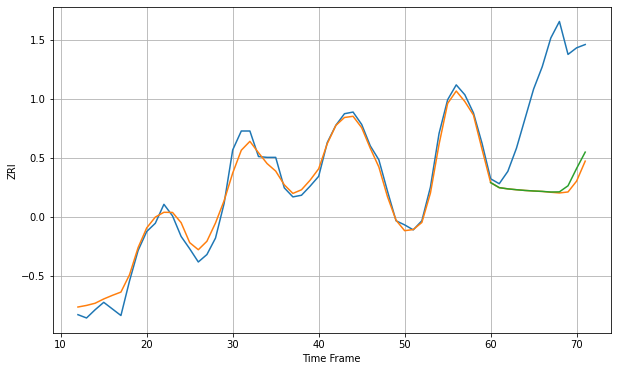

Wall time: 14 s
2148 10.830228315147327 129.56303009786524 126.02616723285237 [2191.367889   2185.23159293 2183.76057789 2182.7194734  2181.83770668
 2181.18662145 2180.69054101 2179.90249822 2180.12829529 2187.49349619
 2208.57690536 2228.37571391]

Got an mse at 0.0025 in round 239 and stopped training

60 60 12


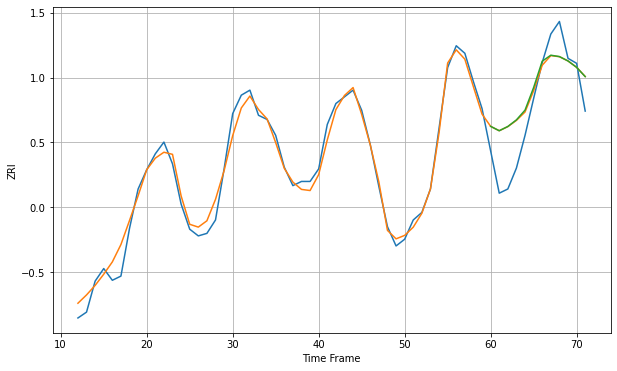

Wall time: 11.6 s
2149 11.601045508465276 41.06159160701644 41.32914434153007 [2280.77509073 2275.54722761 2280.62222107 2288.52465786 2300.1232902
 2327.11781804 2358.60628264 2365.71029166 2364.07216875 2358.84205907
 2351.20835277 2340.14342087]

Got an mse at 0.0025 in round 310 and stopped training

60 60 12


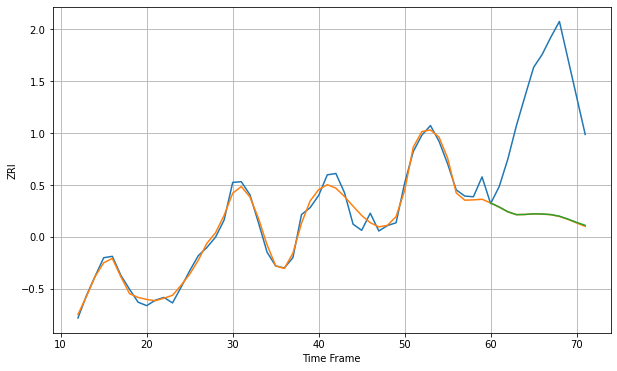

Wall time: 14.1 s
2150 10.28006168786885 184.58660448772972 184.26454693684062 [2379.96348651 2373.97157724 2367.07715721 2362.88160001 2363.1934859
 2364.1090657  2363.87147612 2363.02279715 2360.63171404 2356.43173747
 2351.60565922 2347.30463472]
60 60 12


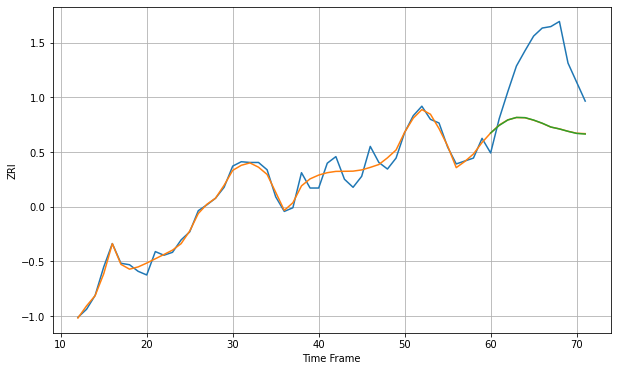

Wall time: 18.8 s
2151 9.488774549739649 92.25148124643749 92.24640602818216 [2388.31440337 2398.68263765 2406.17335262 2409.63803758 2409.35682553
 2406.03625363 2401.72610699 2396.52519133 2393.85808885 2390.62076615
 2387.7670058  2386.91399892]
60 60 12


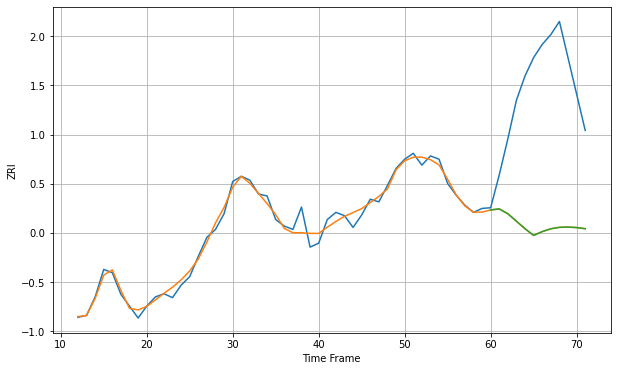

Wall time: 18.8 s
2152 10.127758171274282 219.0521324883573 218.99341419478978 [2439.69846317 2441.25326493 2433.87352231 2422.45659533 2411.03118668
 2400.8927892  2406.66229777 2410.99912994 2413.19450675 2413.61044929
 2412.86955814 2411.14832062]

Got an mse at 0.0024 in round 213 and stopped training

60 60 12


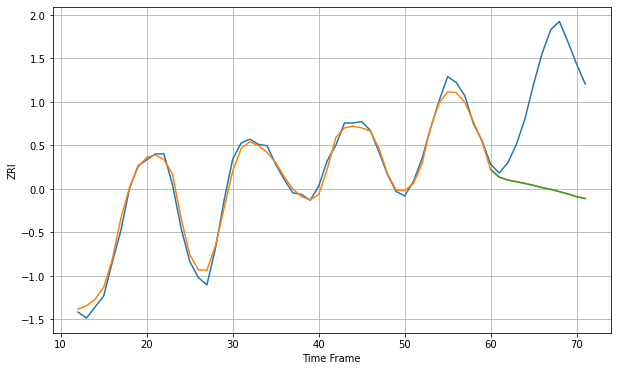

Wall time: 10.8 s
2155 8.958065007898819 148.17491289142515 148.16763098432614 [2339.88124529 2329.4146736  2325.49351908 2323.19639331 2320.81219447
 2318.16389444 2315.11298248 2312.74232694 2309.68906094 2306.5514938
 2302.87769426 2300.3269168 ]

Got an mse at 0.0025 in round 245 and stopped training

60 60 12


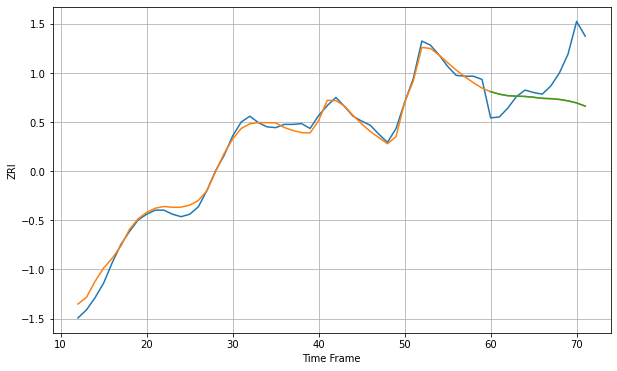

Wall time: 11.9 s
2169 7.629572788136929 44.74998276169073 44.71007341667667 [2012.02068232 2009.04668155 2007.11505295 2006.57333371 2006.19719458
 2005.20135286 2003.90183288 2003.48238796 2002.53699607 2000.83199796
 1998.30515915 1994.41513011]
60 60 12


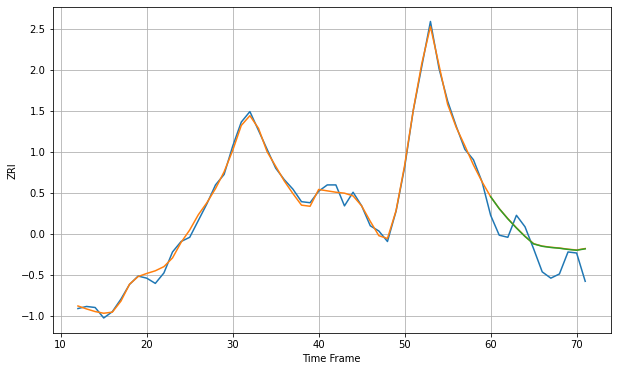

Wall time: 18.2 s
2170 4.229309954025465 19.591260156585662 19.47871353009493 [1924.74125292 1913.30572161 1903.62005125 1894.8630146  1886.76203903
 1879.69662609 1877.42731466 1876.30438631 1875.55902081 1874.44750271
 1873.62882635 1875.00409117]

Got an mse at 0.0025 in round 280 and stopped training

60 60 12


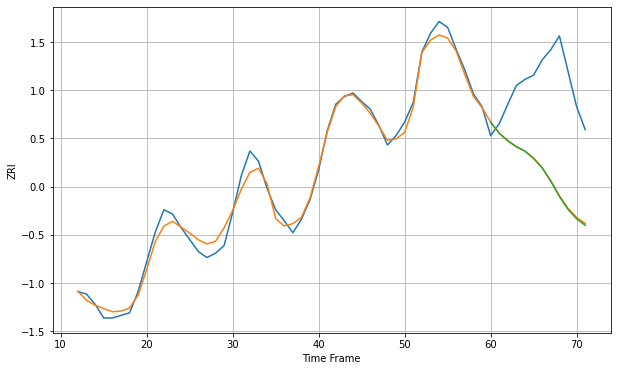

Wall time: 13.3 s
2171 9.26717422184597 113.2112630034062 113.90870833051147 [2181.79196427 2168.90077281 2159.93100692 2152.93972347 2147.71829002
 2139.27525804 2128.01206263 2112.50013131 2094.60560523 2079.54073577
 2068.42952763 2060.75737235]

Got an mse at 0.0025 in round 269 and stopped training

60 60 12


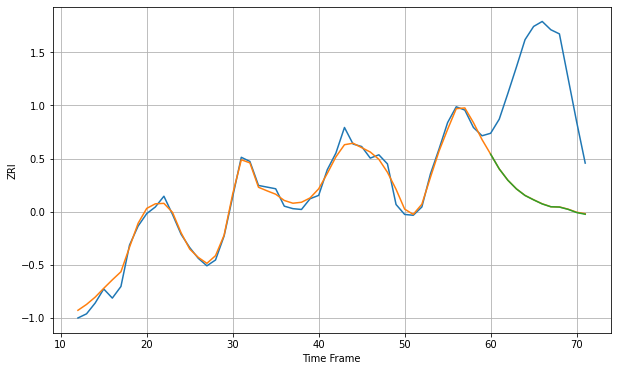

Wall time: 14.5 s
2176 7.634136677742423 156.6870294612192 156.8107276281859 [2241.76903337 2223.98443793 2210.33511535 2199.82987488 2191.90261686
 2186.61841938 2181.69042742 2178.27978336 2177.91853259 2175.18287496
 2171.29590507 2169.22492301]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


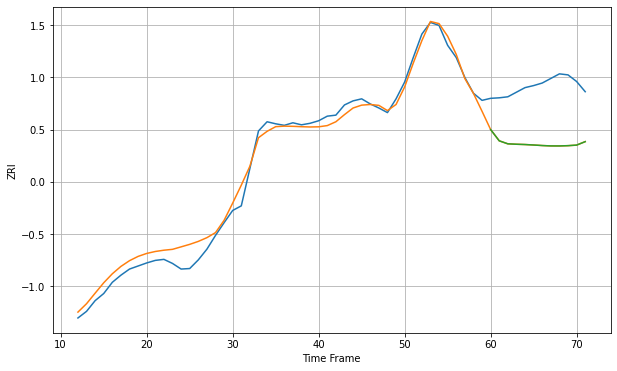

Wall time: 11.6 s
2184 17.84964747684297 112.90072672934407 112.87759249019153 [2133.67811892 2111.61806725 2105.73079489 2104.89276215 2104.34127346
 2103.41381928 2102.36316294 2101.63354419 2101.58148194 2102.13949812
 2103.23954874 2109.97579318]
60 60 12


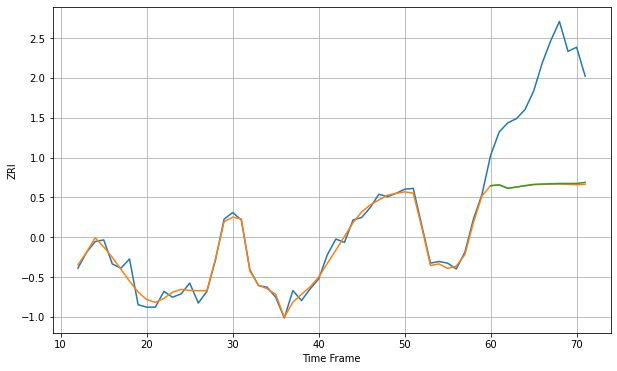

Wall time: 18.4 s
2210 7.338633841986417 128.77496644132762 128.09952740109136 [2887.25231431 2888.21112047 2884.16295415 2885.64436389 2887.31964615
 2888.79034497 2889.24002331 2889.65250192 2889.96766166 2889.95993014
 2890.04291082 2891.18171446]

Got an mse at 0.0025 in round 202 and stopped training

60 60 12


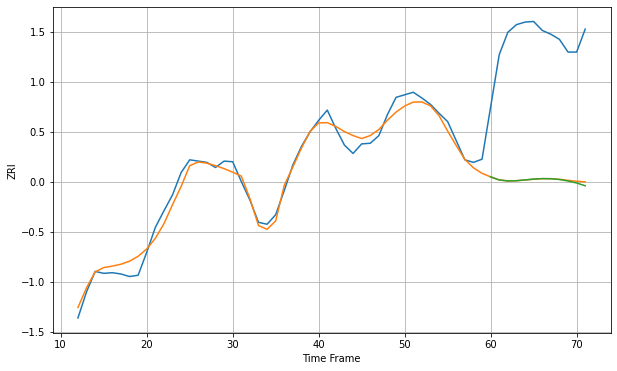

Wall time: 11.4 s
2215 13.308511976205034 219.83458205698224 220.67129469084838 [2343.29454874 2338.45708121 2336.88338215 2337.25779698 2338.47414161
 2339.78276945 2340.58330499 2340.43168709 2339.19742557 2336.78204521
 2333.68170521 2329.34510009]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


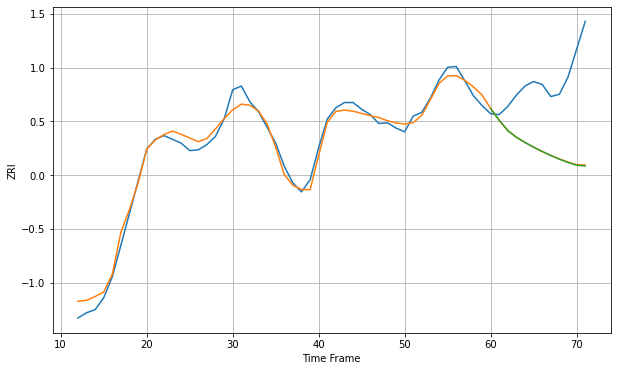

Wall time: 10.1 s
2301 10.578193881145461 96.6936769748597 97.10002386446219 [1662.1098673  1646.2093681  1632.59583975 1623.69509477 1616.79854234
 1610.52602632 1604.70622586 1599.37197612 1594.52112626 1590.15541485
 1586.42880701 1585.60633825]

Got an mse at 0.0025 in round 182 and stopped training

60 60 12


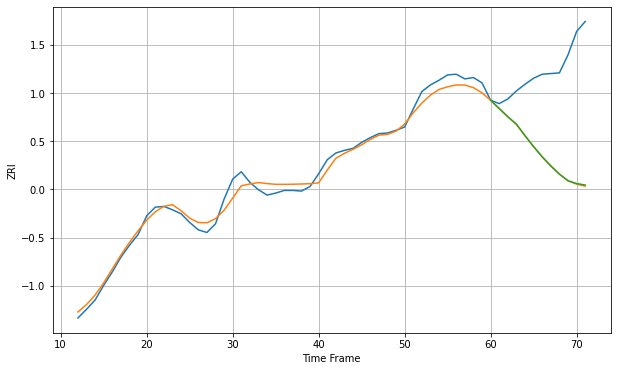

Wall time: 10.7 s
2302 10.918248066791207 137.19273468080465 136.76004828941902 [1701.00088311 1688.54323021 1676.36215972 1665.05771469 1647.98492064
 1631.55110612 1616.28535784 1602.6857254  1590.47526421 1580.53957938
 1576.26496826 1574.09848927]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


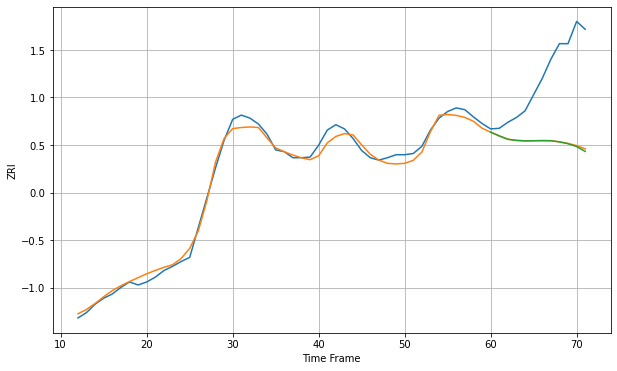

Wall time: 11.3 s
2360 9.826238964188235 121.36924412034273 122.2591235014703 [1763.58325368 1757.31578102 1751.78086168 1749.8442519  1749.09950039
 1749.29409895 1749.49334772 1749.35826247 1747.33873221 1744.33728291
 1739.52828756 1731.48828523]

Got an mse at 0.0024 in round 315 and stopped training

60 60 12


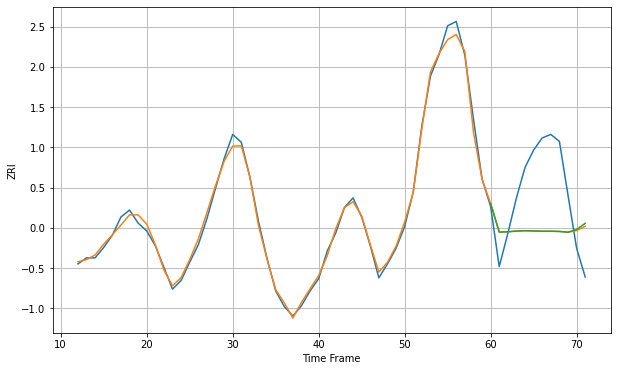

Wall time: 13.2 s
2445 5.863428099324575 69.11556548843664 69.36759471219158 [2793.43627554 2760.62322246 2760.97305744 2761.83577665 2762.2240959
 2761.94793445 2761.62501844 2761.64570926 2761.39573742 2760.53323093
 2763.67168624 2770.71737333]

Got an mse at 0.0025 in round 294 and stopped training

60 60 12


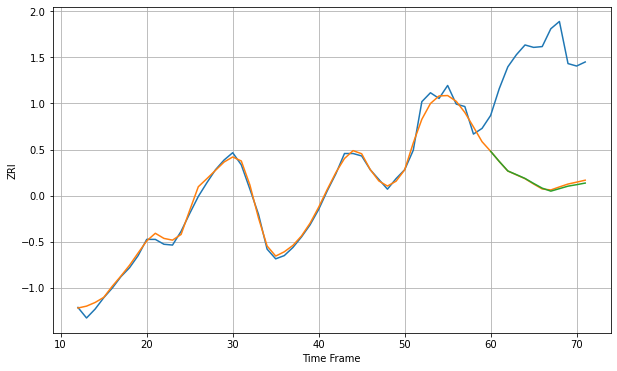

Wall time: 13.8 s
2446 6.808553778351387 152.86741050625082 153.78363575872578 [2868.74665919 2856.24051226 2844.48237909 2839.91652271 2835.23868556
 2829.09086179 2823.24707931 2819.55174689 2822.62751077 2825.70721342
 2827.53484728 2829.52340269]

Got an mse at 0.0024 in round 497 and stopped training

60 60 12


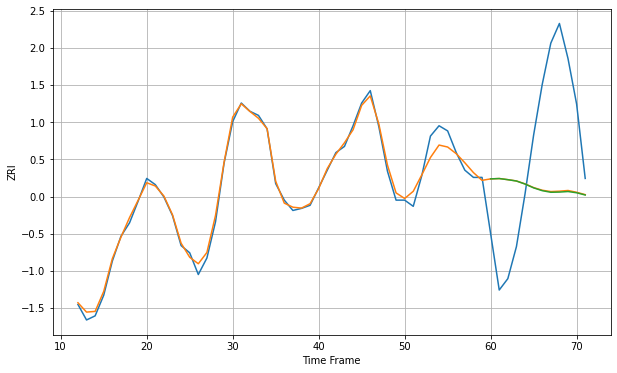

Wall time: 19.8 s
2451 6.247661662667676 96.47514407193536 96.87749611798073 [2432.56257751 2432.90275591 2431.7925849  2430.49873272 2427.57882291
 2423.88469218 2421.16313412 2419.60890928 2419.78165671 2420.33202907
 2419.12539332 2416.96311137]

Got an mse at 0.0025 in round 253 and stopped training

60 60 12


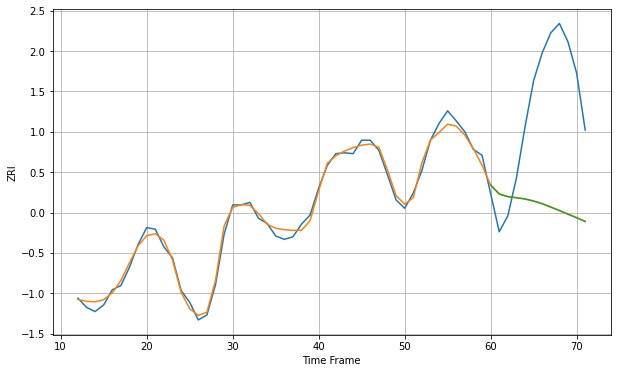

Wall time: 12.4 s
2453 6.53271031494777 141.2551530775172 141.35000577358593 [2382.64341044 2372.00604564 2368.85538371 2367.54877638 2366.05328213
 2363.57150652 2360.39769928 2356.34138352 2352.2742598  2347.86254055
 2343.69045823 2339.18474863]

Got an mse at 0.0024 in round 380 and stopped training

60 60 12


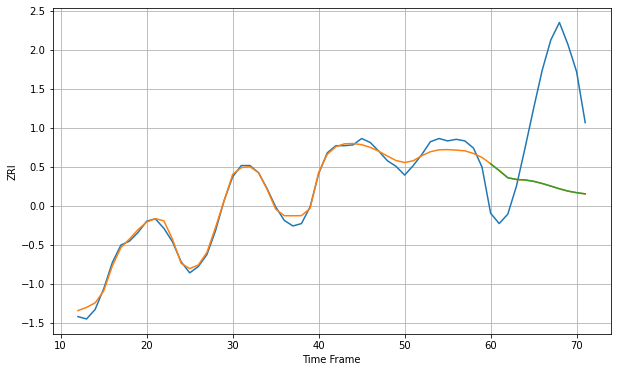

Wall time: 15.2 s
2458 7.051664193304632 123.71113199328983 123.63006371213643 [2551.21874089 2542.66730979 2533.59485231 2531.52706195 2530.90351444
 2529.18053234 2526.43452103 2523.20149985 2519.78576721 2516.90001268
 2514.94106722 2513.47490984]

Got an mse at 0.0025 in round 493 and stopped training

60 60 12


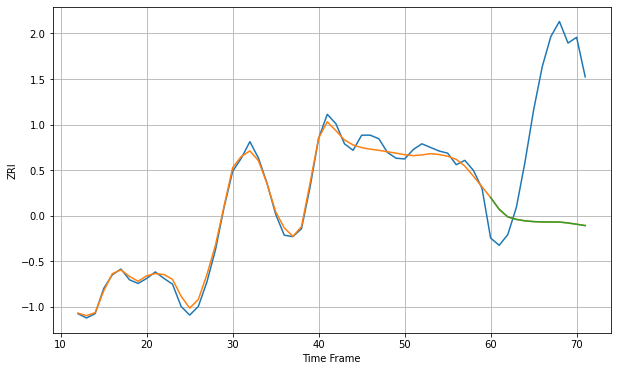

Wall time: 19.1 s
2460 7.871796747310333 182.6663261587815 182.7127177853986 [2605.32022867 2588.92418373 2578.40677215 2574.97633367 2572.97131463
 2571.90302062 2571.43154094 2571.33273096 2571.26139519 2570.0042724
 2568.19531617 2566.31218908]

Got an mse at 0.0025 in round 196 and stopped training

60 60 12


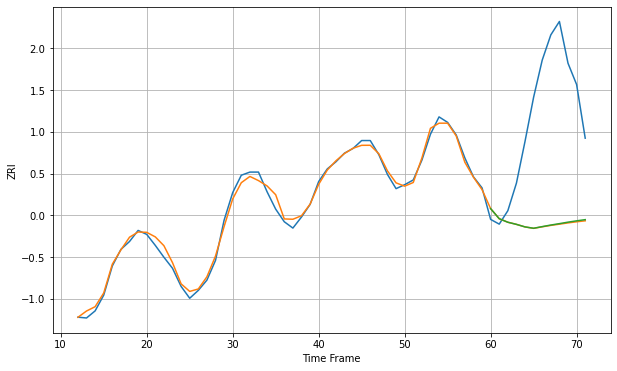

Wall time: 10.5 s
2472 6.3221798599521035 156.53466688920125 156.0458131466573 [2364.67159976 2351.87410896 2347.39772276 2344.70399569 2341.47250022
 2339.76584942 2341.85376587 2343.84411825 2345.62644739 2347.50714039
 2349.17197404 2350.6845365 ]

Got an mse at 0.0025 in round 298 and stopped training

60 60 12


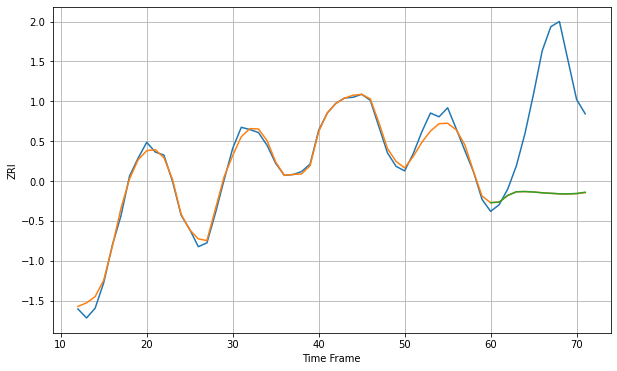

Wall time: 14.3 s
2474 7.8280432647517415 135.66629970346605 135.57142163941376 [2350.57831964 2351.45165645 2360.36101788 2365.12965657 2365.43519068
 2364.80303111 2363.80123616 2363.08275722 2362.44238642 2362.31309833
 2362.88172138 2364.48931007]

Got an mse at 0.0025 in round 312 and stopped training

60 60 12


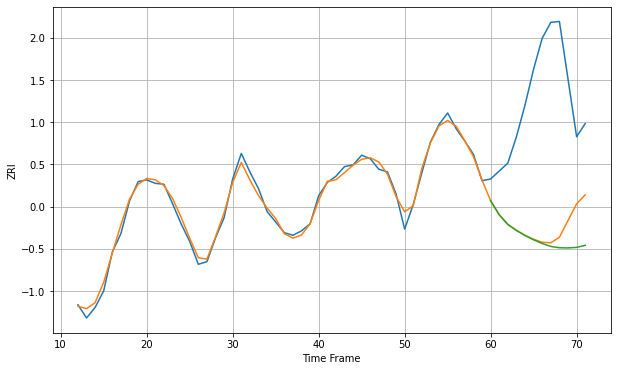

Wall time: 13.4 s
2476 5.7841175119062305 156.3889348108126 167.3995665898797 [2257.23027438 2241.23059385 2230.23236034 2223.47097888 2217.7151567
 2212.82913303 2208.61554289 2205.33109342 2203.8130851  2203.61985915
 2204.21162261 2206.5666258 ]

Got an mse at 0.0024 in round 253 and stopped training

60 60 12


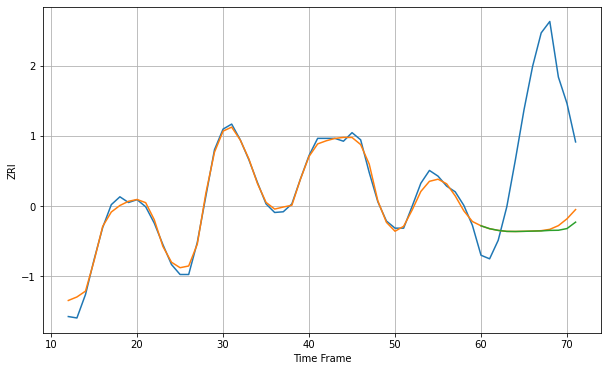

Wall time: 12.4 s
2478 7.922240165172781 167.8647368177521 170.856000169628 [2440.31563817 2436.25955769 2433.88037147 2432.48146636 2432.33583358
 2432.55923137 2432.85788255 2433.12173294 2433.88344248 2434.06956721
 2436.45169866 2445.44657108]
60 60 12


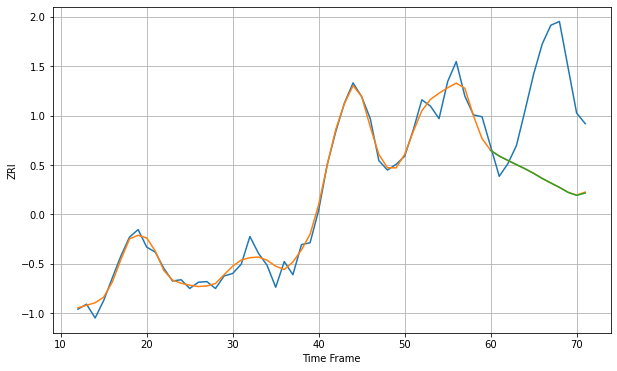

Wall time: 20.4 s
2494 14.266520220823834 153.82733675696605 153.95929630971344 [2789.42546102 2780.30267985 2773.3757625  2766.65994739 2759.98208595
 2752.7222352  2744.54572646 2737.39401141 2730.2994239  2722.44940326
 2717.64226768 2721.23124679]

Got an mse at 0.0024 in round 441 and stopped training

60 60 12


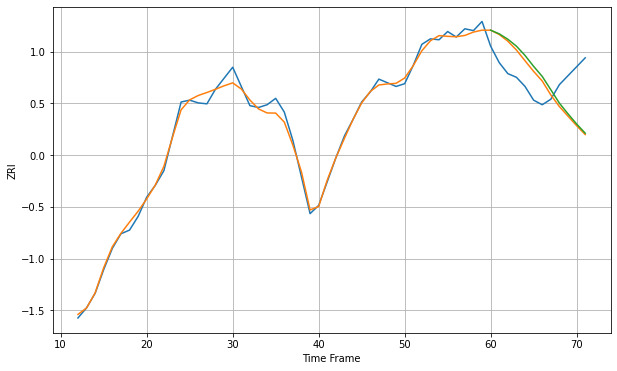

Wall time: 16.9 s
2703 6.028462720684892 40.381782763606964 41.114277360570696 [1447.48399727 1443.47487882 1437.6108368  1430.01432476 1419.87322969
 1407.94906475 1396.95240813 1382.39646825 1367.69591514 1356.03846884
 1344.97172891 1334.93330323]

Got an mse at 0.0025 in round 282 and stopped training

60 60 12


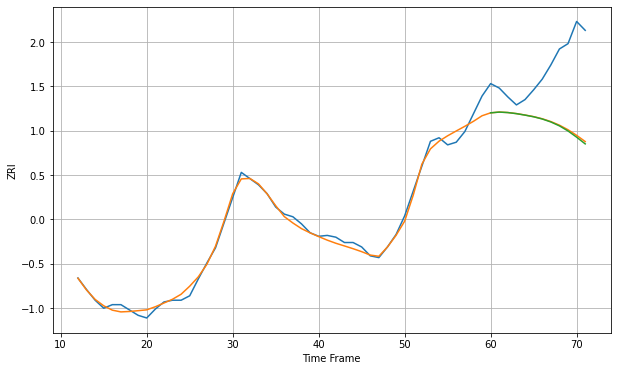

Wall time: 13.6 s
2721 6.055379007819192 69.76294750120898 70.77199006086433 [1072.0836829  1072.90398883 1072.37656777 1071.15298176 1069.50224682
 1067.6284725  1065.1459329  1061.80524033 1057.3945347  1051.66498391
 1044.66103381 1037.09814556]

Got an mse at 0.0025 in round 172 and stopped training

60 60 12


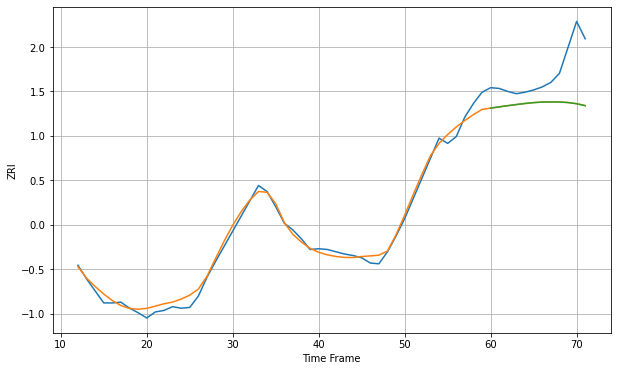

Wall time: 9.9 s
2723 7.81046824339293 50.059787918353 50.13369183912876 [1153.86853665 1155.51259272 1157.0878018  1158.60649912 1160.00489062
 1161.15467144 1161.87436833 1162.09946805 1161.96659534 1161.23279911
 1159.67798852 1157.06390291]

Got an mse at 0.0025 in round 399 and stopped training

60 60 12


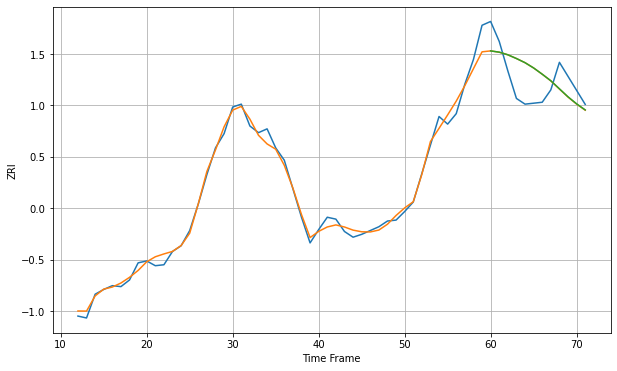

Wall time: 16 s
2740 7.1773391107726905 27.21407047736884 27.160502264027937 [1272.03057497 1270.68582215 1267.94429952 1263.99876718 1259.62033587
 1254.07022378 1247.52019881 1240.6138582  1232.15227223 1223.71737298
 1216.34368045 1209.93295517]

Got an mse at 0.0025 in round 271 and stopped training

60 60 12


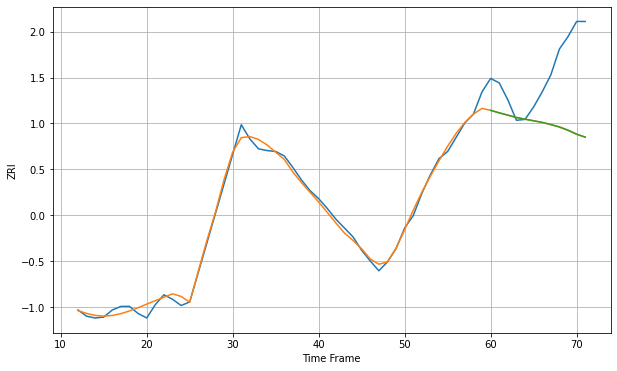

Wall time: 12.4 s
2746 5.916538923299021 70.13860823305035 69.98875399626061 [1112.17905206 1109.37215032 1106.82105883 1104.15477357 1102.26215051
 1100.47484598 1098.66132015 1096.28452572 1093.60716764 1089.98824788
 1085.49440181 1082.11941143]

Got an mse at 0.0025 in round 429 and stopped training

60 60 12


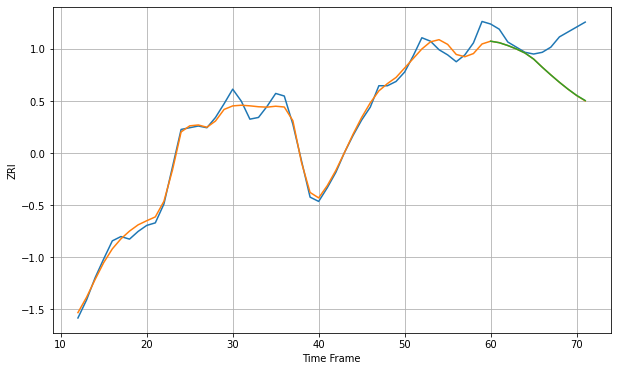

Wall time: 17.2 s
2780 8.260396447026903 44.860005685276285 44.768854558645145 [1395.96390382 1394.23567105 1390.92040197 1386.90645697 1382.13836426
 1375.12153912 1365.61613141 1356.6376117  1348.04079097 1340.03235055
 1332.71493074 1326.7425294 ]

Got an mse at 0.0025 in round 421 and stopped training

60 60 12


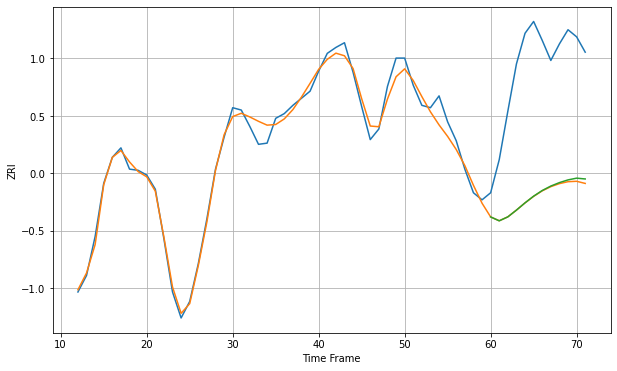

Wall time: 17.2 s
2840 7.586561110692565 113.43395638232158 112.58336541451806 [1794.54550702 1791.24477026 1794.58516622 1800.31295269 1806.46316628
 1812.11012241 1816.89902324 1820.67764084 1823.58839543 1825.88293085
 1827.36035093 1826.67590631]

Got an mse at 0.0025 in round 206 and stopped training

60 60 12


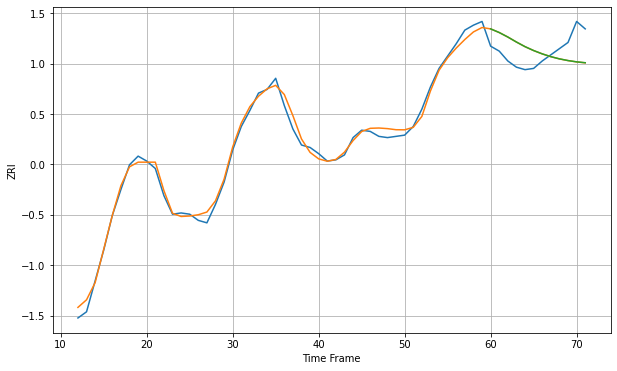

Wall time: 12 s
2860 4.621138811856241 18.060123623227103 18.042096658090102 [1213.99739223 1211.04079907 1207.40280693 1203.35748711 1199.61452886
 1196.4630999  1193.77490199 1191.52128368 1189.72590201 1188.35785899
 1187.30749594 1186.60862641]

Got an mse at 0.0025 in round 257 and stopped training

60 60 12


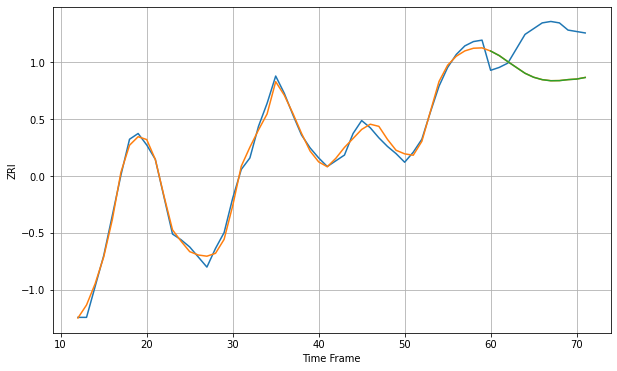

Wall time: 13.2 s
2861 3.881648154487488 29.450403860621375 29.475333229144244 [1189.41756432 1186.24094618 1182.01536902 1177.9698121  1173.9319233
 1171.16142342 1169.47580242 1168.73361537 1168.8150523  1169.49108629
 1169.89024257 1170.98348325]

Got an mse at 0.0025 in round 371 and stopped training

60 60 12


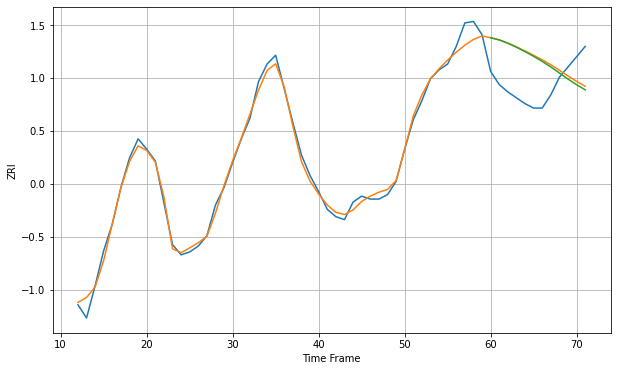

Wall time: 15.6 s
2863 4.617767915880344 27.2803782514055 27.27367576175901 [1222.93337058 1221.41895612 1219.18081504 1216.4673085  1213.46852533
 1210.22911689 1206.78619656 1203.01579948 1198.90253888 1194.73639042
 1190.9301964  1187.42657979]
60 60 12


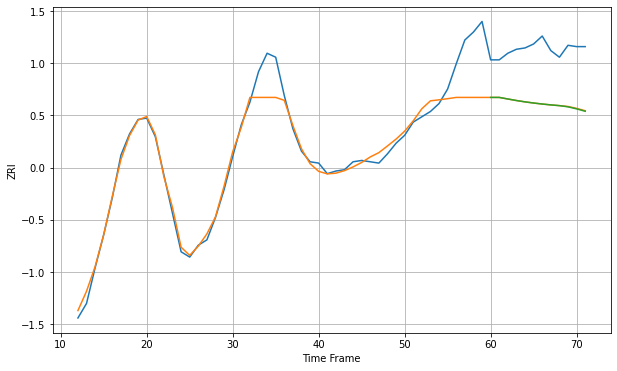

Wall time: 19.4 s
2864 15.325553430067014 41.112971124829684 41.204952849381485 [1230.6216086  1230.6216086  1229.43856032 1228.27937464 1227.26622774
 1226.3884455  1225.6291824  1224.97062707 1224.41217311 1223.50680071
 1221.97255423 1220.1526574 ]

Got an mse at 0.0024 in round 379 and stopped training

60 60 12


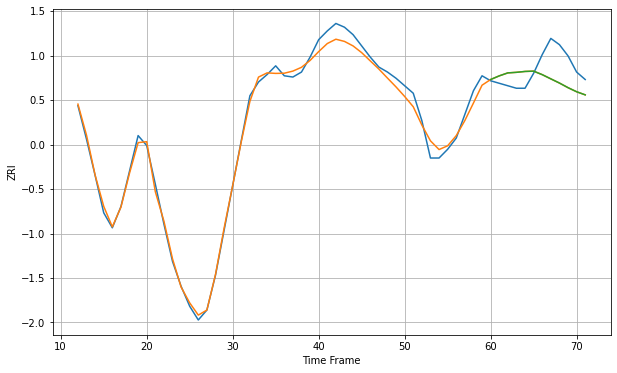

Wall time: 15.9 s
2891 5.756615186535236 17.818193310529352 17.805714371522686 [1205.01443804 1207.93671832 1210.32984907 1210.7761872  1211.48485899
 1211.72596702 1208.91834291 1205.54192549 1202.19208611 1198.48426612
 1195.20252826 1192.68723855]
60 60 12


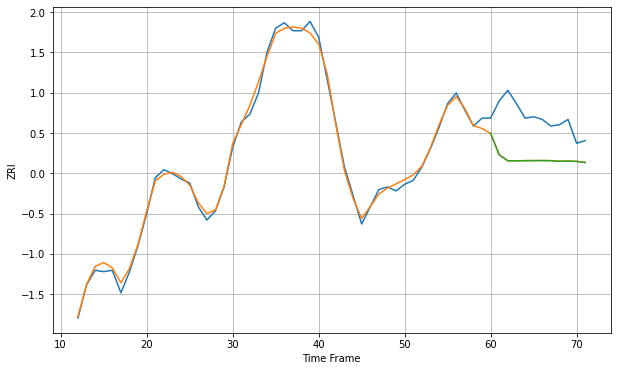

Wall time: 18.3 s
2893 3.722435668487827 32.26537656306793 32.268118509153325 [1220.39679368 1204.26411389 1199.7878746  1199.7183886  1199.84431403
 1199.8919175  1199.92325502 1199.83164361 1199.39788852 1199.5263721
 1199.26646066 1198.44262883]

Got an mse at 0.0025 in round 210 and stopped training

60 60 12


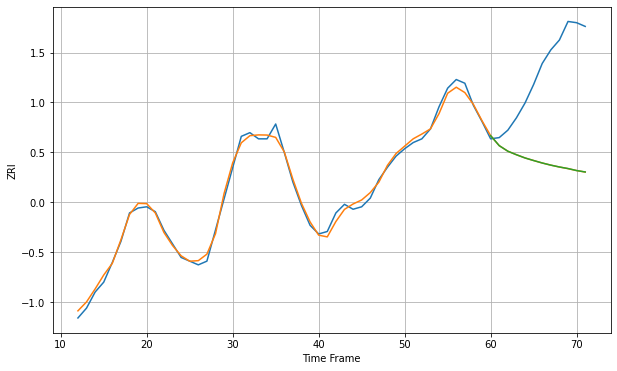

Wall time: 11.5 s
2895 3.9293308397659015 79.1486692145466 79.1271388845364 [1070.56026582 1062.47916743 1057.98094465 1055.1280751  1052.52429076
 1050.43416543 1048.44389257 1046.7087764  1045.21210506 1043.9426108
 1042.32389129 1041.19155749]

Got an mse at 0.0025 in round 291 and stopped training

60 60 12


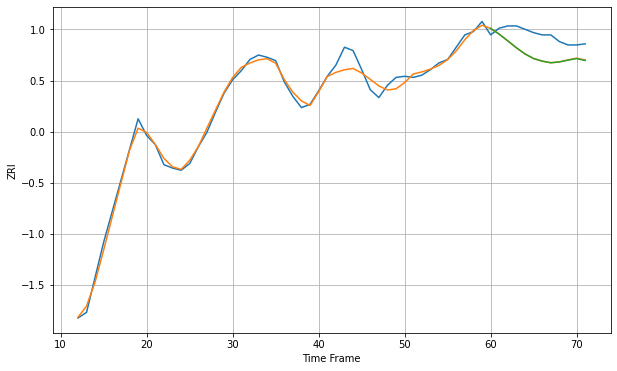

Wall time: 13.3 s
2904 5.588136401785096 17.49419542117191 17.54686975141381 [1244.80342921 1239.61919508 1233.63249346 1227.46298706 1221.98055418
 1217.86486788 1215.54576286 1214.11182943 1214.84606305 1216.47618117
 1217.81754141 1216.12688021]

Got an mse at 0.0024 in round 165 and stopped training

60 60 12


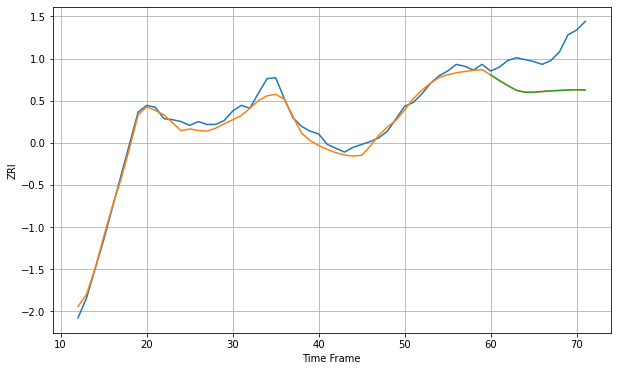

Wall time: 10.5 s
2905 6.810836488725793 40.947913918583914 41.01643463538954 [1265.94079369 1260.17164135 1254.64416314 1249.81553656 1247.76195275
 1247.76681096 1248.51063596 1249.21264137 1249.59967811 1250.10653861
 1250.32018327 1250.08779038]

Got an mse at 0.0025 in round 121 and stopped training

60 60 12


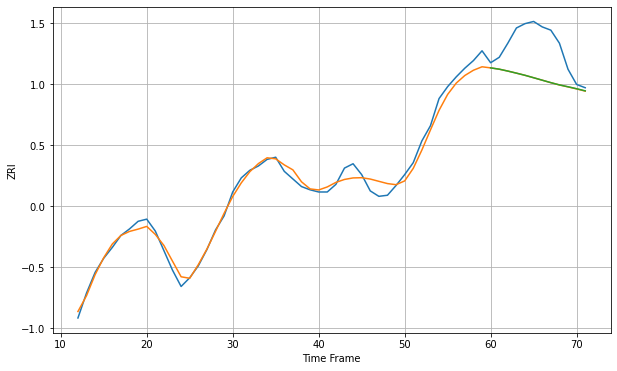

Wall time: 10.7 s
2906 6.378774265135675 34.152090700022434 34.12878131364994 [1546.26687659 1545.06525447 1543.32642115 1541.42249852 1539.42996444
 1537.19634563 1534.93658721 1532.67175465 1530.5967137  1528.88451535
 1527.08158816 1525.12731632]

Got an mse at 0.0025 in round 230 and stopped training

60 60 12


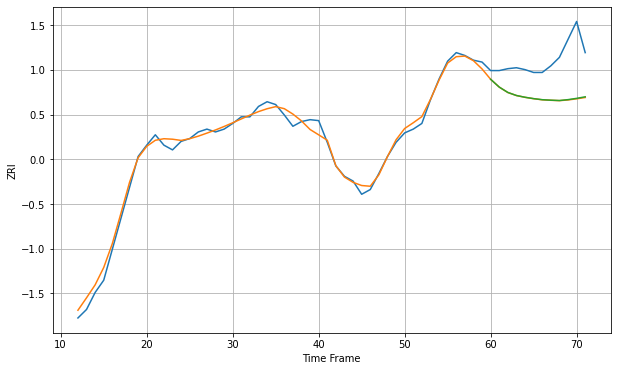

Wall time: 12 s
2907 6.089606648647209 41.71397150177392 41.48135962074955 [1242.76555308 1234.51078975 1228.83656088 1225.60275794 1223.72744012
 1222.28575399 1221.15349412 1220.63149352 1220.27271743 1221.21377223
 1222.57018243 1224.20619074]

Got an mse at 0.0025 in round 174 and stopped training

60 60 12


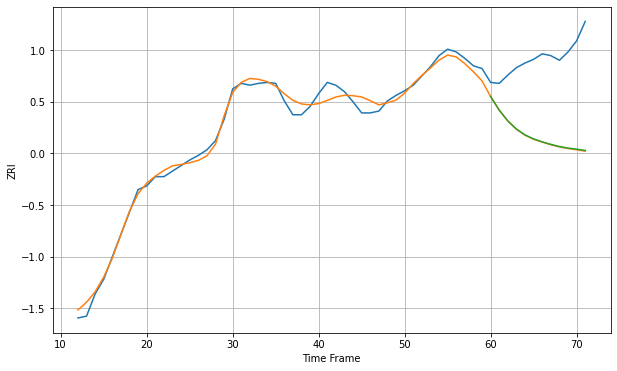

Wall time: 10 s
2908 7.495962084757776 88.19000482537452 87.83044931925934 [1245.72929249 1230.99946891 1219.30543507 1210.50322233 1204.13955759
 1199.81187529 1196.67219631 1193.91609159 1191.60481701 1189.92015925
 1188.75405651 1187.38401336]

Got an mse at 0.0025 in round 165 and stopped training

60 60 12


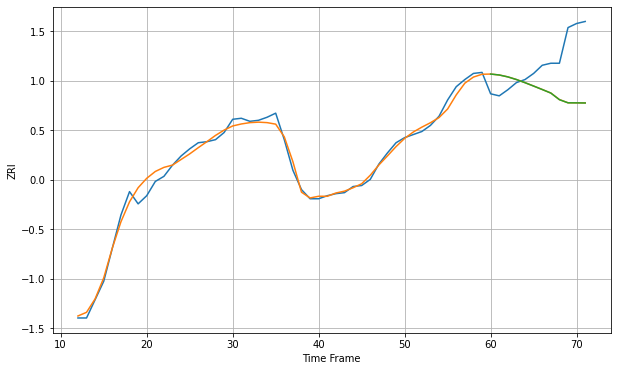

Wall time: 10.1 s
2909 5.6950099261292 42.530534855796226 42.57344275475356 [1253.38767685 1252.47489218 1250.60709591 1248.00555129 1244.92024542
 1241.59906003 1238.21370069 1234.73917686 1228.24360671 1225.14503714
 1225.10236128 1224.99667768]

Got an mse at 0.0025 in round 167 and stopped training

60 60 12


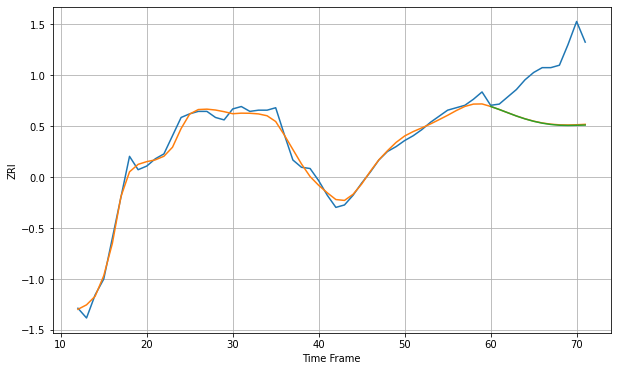

Wall time: 9.59 s
2910 5.006466636056932 46.659632106291525 46.915530895324174 [1204.07865223 1201.56632046 1198.87303244 1196.19900966 1193.84480017
 1191.86472684 1190.3156724  1189.23345175 1188.61383625 1188.43418855
 1188.57443222 1188.74895817]

Got an mse at 0.0025 in round 207 and stopped training

60 60 12


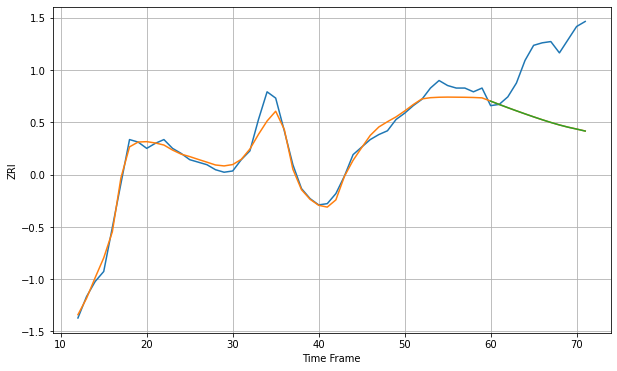

Wall time: 11.4 s
2914 6.137405167637363 54.71304993992092 54.72099393664585 [1255.59473893 1252.94216161 1250.38423233 1247.88196523 1245.45186942
 1243.07555831 1240.78886862 1238.62579841 1236.62709104 1234.86910955
 1233.3527453  1231.77431559]

Got an mse at 0.0025 in round 173 and stopped training

60 60 12


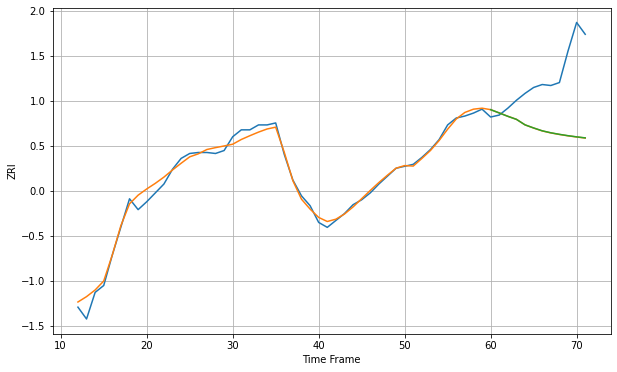

Wall time: 9.83 s
2920 5.898406440927416 59.553059112839556 59.45028921305272 [1236.48221541 1233.15222483 1229.72438882 1226.64171164 1221.06682089
 1217.91461564 1215.02524865 1213.01198432 1211.43542308 1210.05402165
 1208.88312046 1207.84245792]

Got an mse at 0.0025 in round 349 and stopped training

60 60 12


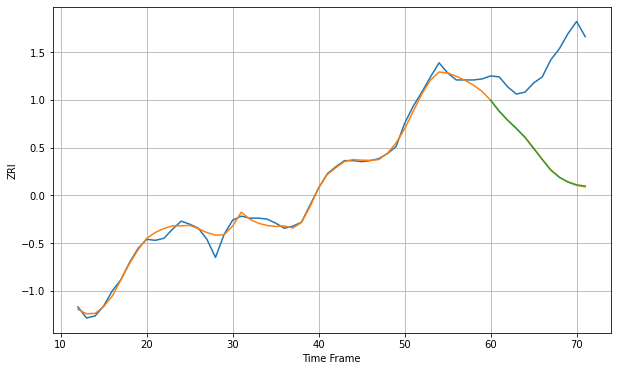

Wall time: 15.4 s
3038 5.172123290187341 98.0273449694855 97.89512890966374 [1341.86845745 1330.98490467 1321.91367373 1313.78532747 1304.99540522
 1294.07995594 1283.19625636 1272.63972489 1265.52518584 1260.88015165
 1257.9874568  1256.80054583]

Got an mse at 0.0025 in round 266 and stopped training

60 60 12


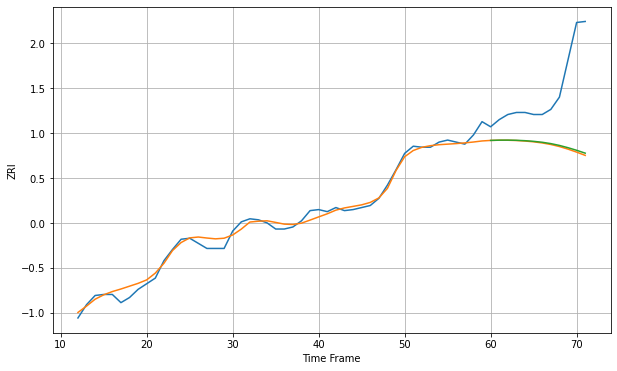

Wall time: 12.6 s
3060 5.74173277919381 63.654399859712065 62.643881889090224 [1422.65430096 1422.90833678 1422.9503987  1422.77992923 1422.39123486
 1421.76348043 1420.85326506 1419.54573761 1417.76782439 1415.53202122
 1413.00991234 1410.19686222]

Got an mse at 0.0025 in round 125 and stopped training

60 60 12


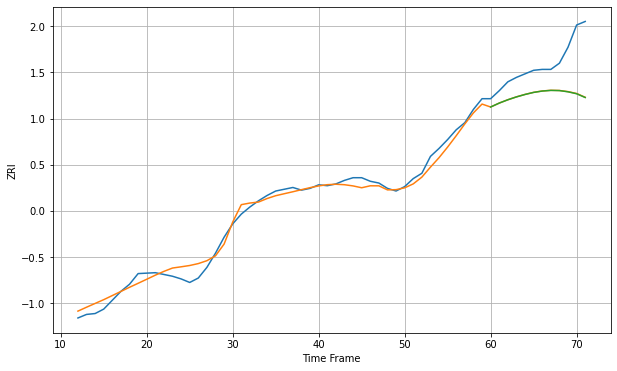

Wall time: 8.79 s
3102 7.376691191773462 40.98678000682464 41.12679717494193 [1294.63420081 1299.05934602 1302.79174963 1306.01974524 1308.76825856
 1311.08931064 1312.61124366 1313.35106318 1313.14137937 1311.75582615
 1309.57872428 1305.33629105]

Got an mse at 0.0024 in round 64 and stopped training

60 60 12


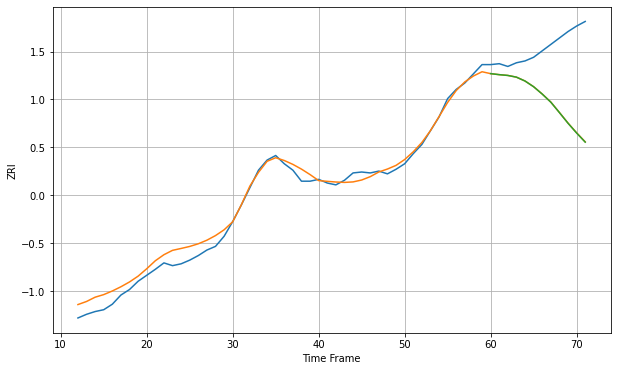

Wall time: 9.51 s
3103 8.467441758732292 67.99107545782891 68.12654447649625 [1270.16462842 1269.05172691 1268.19717368 1266.32912817 1262.11759609
 1255.89592367 1247.90431732 1239.07762505 1227.73464367 1216.14578922
 1205.49158521 1195.55543687]

Got an mse at 0.0025 in round 103 and stopped training

60 60 12


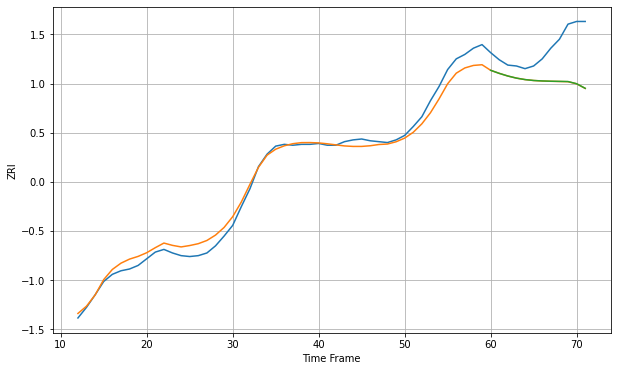

Wall time: 9.09 s
3104 9.0331320537331 41.19420430403635 41.11715781461717 [1269.15772877 1265.72405139 1262.73895209 1260.376807   1258.74021435
 1257.71820149 1257.20032875 1256.89333248 1256.71219882 1256.52950803
 1254.08516063 1248.92363908]

Got an mse at 0.0025 in round 347 and stopped training

60 60 12


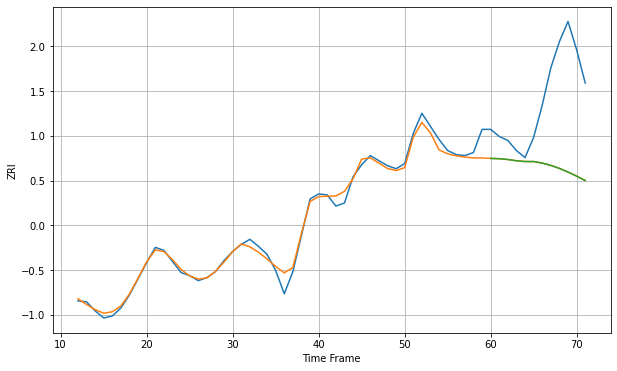

Wall time: 15 s
3301 6.568400203816573 80.70376340692025 80.71429522224368 [1282.23284126 1281.89526065 1281.12599766 1279.88407526 1279.12403282
 1279.12176974 1277.58874458 1275.31372965 1272.2906841  1268.68999399
 1264.64353592 1260.2383991 ]

Got an mse at 0.0025 in round 402 and stopped training

60 60 12


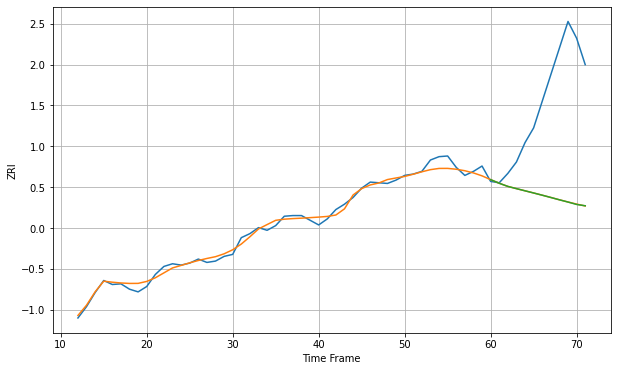

Wall time: 16.5 s
3820 7.117998859778536 158.13778944827496 158.19682431431076 [1363.67107236 1358.28186233 1353.56716232 1350.25090016 1346.98768131
 1343.74580417 1340.42964486 1337.02895938 1333.54312743 1330.18979772
 1326.60151503 1324.64789523]

Got an mse at 0.0024 in round 382 and stopped training

60 60 12


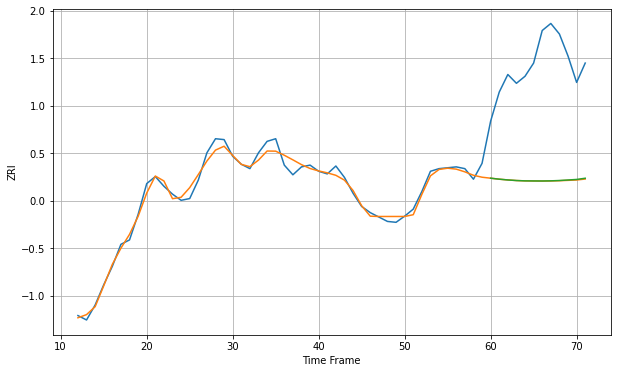

Wall time: 16.3 s
4101 6.825547620380602 132.73984296773583 132.53364509109358 [1661.13960318 1660.01257607 1659.15571804 1658.48127498 1658.11310508
 1658.01932319 1657.97202179 1658.13045324 1658.51003253 1659.09996315
 1659.7212287  1661.09298482]

Got an mse at 0.0025 in round 253 and stopped training

60 60 12


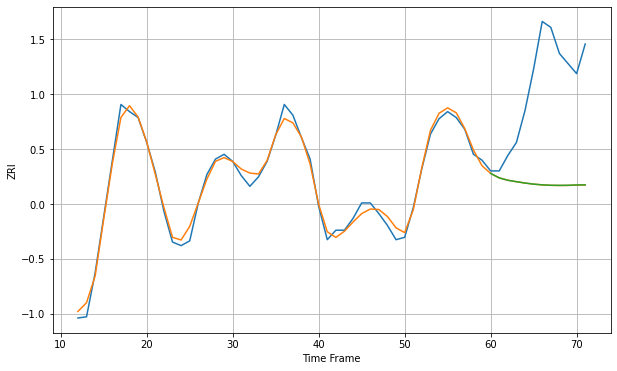

Wall time: 13.1 s
4102 5.408365607556127 90.08595320431286 90.02758586358203 [1639.8703764  1636.11399562 1634.12746796 1632.90421684 1631.7724885
 1630.8479495  1630.24833637 1629.89724428 1629.80045585 1629.87444461
 1630.15818386 1630.22880144]

Got an mse at 0.0025 in round 206 and stopped training

60 60 12


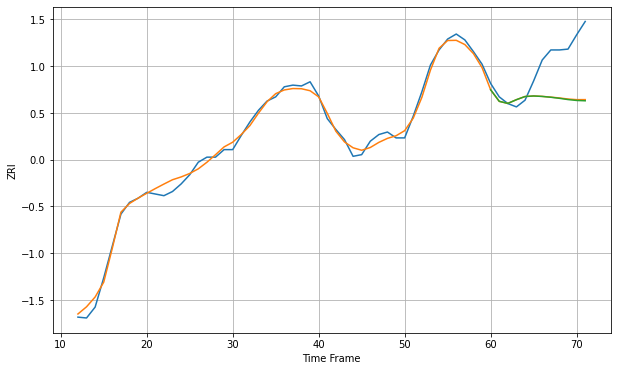

Wall time: 11.3 s
4103 6.379657623951338 47.510256059842916 48.00018364515343 [1563.4410328  1549.67463676 1547.16868701 1551.61373723 1555.38348163
 1556.04193479 1555.48775404 1554.5146973  1553.24999753 1551.76202924
 1550.69689056 1550.30140278]
60 60 12


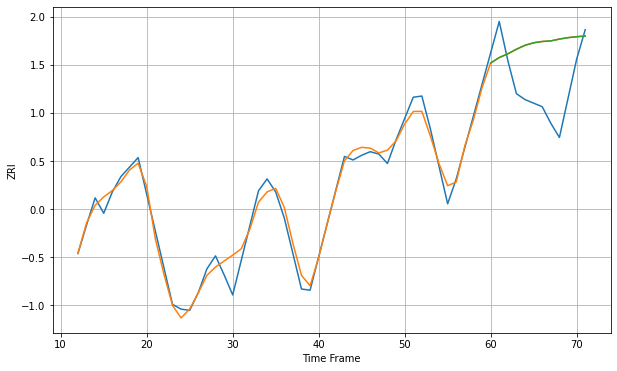

Wall time: 19 s
4210 8.371158719034103 45.61783637808028 45.60696613517066 [1077.85654646 1082.49691635 1085.68559483 1089.5546664  1092.87708001
 1094.98975546 1096.0910521  1096.58892605 1098.10852439 1099.30289123
 1100.06208071 1100.60037272]
60 60 12


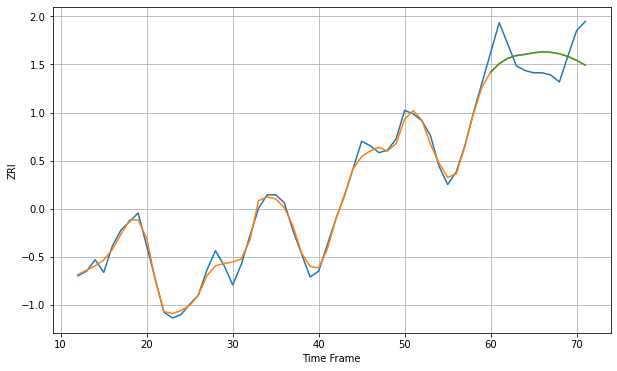

Wall time: 22.1 s
4240 5.683208768142063 22.028755888755935 22.01932985862093 [1054.54848899 1062.01649377 1066.75396663 1069.1547445  1070.16801634
 1071.53880059 1072.43423417 1071.90914112 1070.66474032 1068.26692599
 1064.87415683 1060.78210309]

Got an mse at 0.0024 in round 324 and stopped training

60 60 12


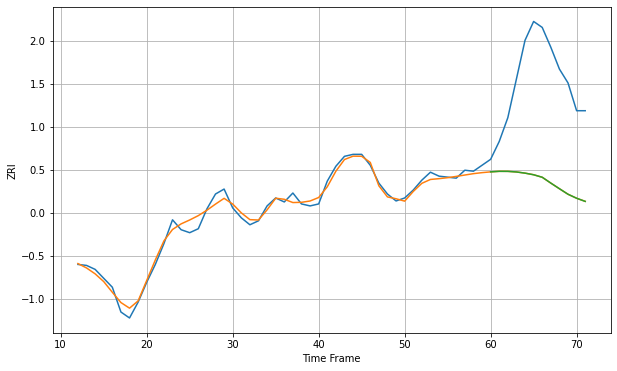

Wall time: 14.8 s
4401 5.542532052349929 107.82664896191734 107.83028667196956 [1115.33818539 1115.87870116 1115.83041929 1115.23803761 1114.05371641
 1112.41987423 1109.9006939  1104.02177231 1098.35044535 1092.77054543
 1088.73243115 1085.55822144]

Got an mse at 0.0025 in round 467 and stopped training

60 60 12


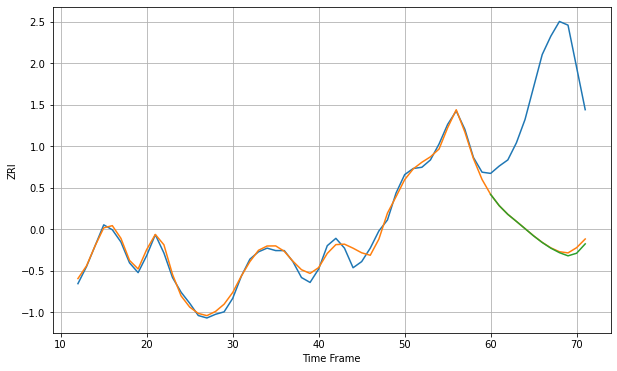

Wall time: 17.8 s
4901 4.456477418145739 124.53377327429028 125.7187340849953 [854.8291503  845.64874133 838.56424485 832.79731053 826.90067115
 820.98110894 815.59875167 810.98304063 807.31481584 804.71825886
 806.83290946 814.46883602]

Got an mse at 0.0024 in round 229 and stopped training

60 60 12


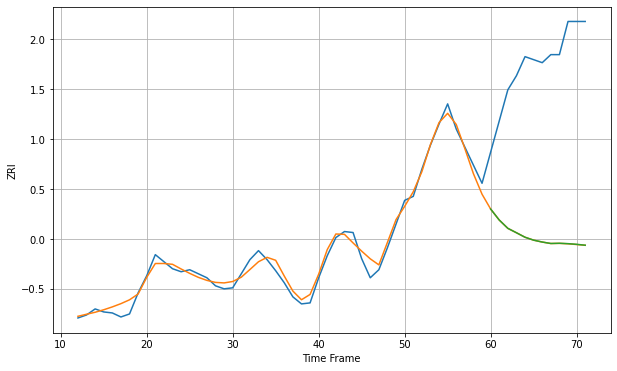

Wall time: 11.8 s
4937 6.759375041028633 175.84039060869895 175.78187227258098 [959.38861089 948.45710383 940.17646803 935.79385763 931.32589112
 928.4201565  926.55027215 925.11116469 925.32037169 924.94233733
 924.28159764 923.39596962]

Got an mse at 0.0025 in round 373 and stopped training

60 60 12


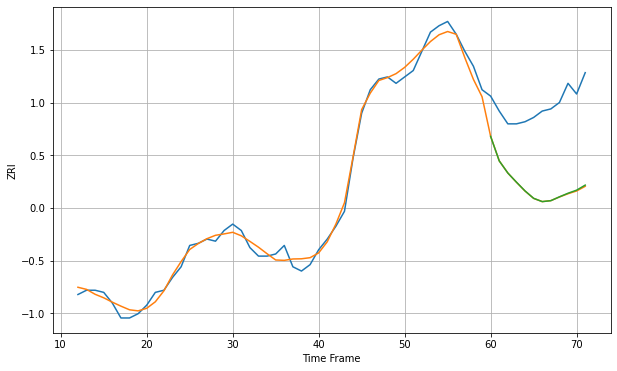

Wall time: 15.5 s
6010 3.1859458223453374 38.593765648358826 38.450456236316754 [1044.12572741 1032.63984507 1026.96642171 1022.6700839  1018.55559637
 1015.09631051 1013.55314491 1013.98608586 1015.78626851 1017.47426623
 1018.92057064 1021.28686686]

Got an mse at 0.0025 in round 388 and stopped training

60 60 12


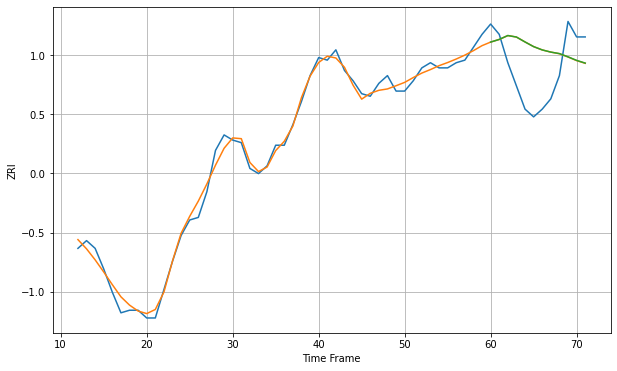

Wall time: 15.2 s
6040 2.7348017247929275 16.45807396633656 16.448875952313948 [1193.00255035 1194.03481501 1195.54405937 1194.95830528 1193.05143567
 1191.24499249 1189.96334981 1189.12366826 1188.53637434 1187.28339185
 1185.90497558 1184.85695985]

Got an mse at 0.0024 in round 386 and stopped training

60 60 12


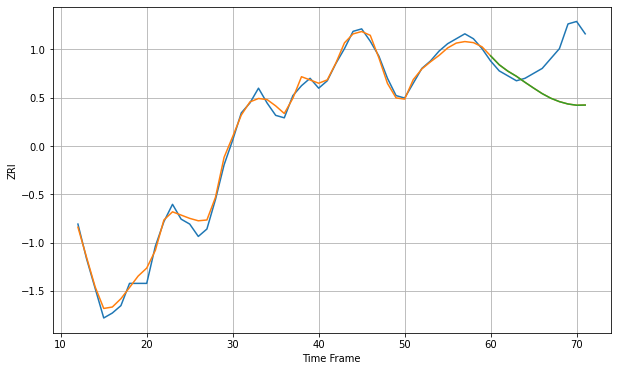

Wall time: 14.9 s
6051 2.35952514324655 18.04422632388444 18.04598803793221 [1103.07667927 1099.47204999 1096.8994621  1094.81647153 1092.37186267
 1090.03850266 1087.79210694 1085.92932559 1084.55560075 1083.59803963
 1083.10197788 1083.17157789]

Got an mse at 0.0025 in round 230 and stopped training

60 60 12


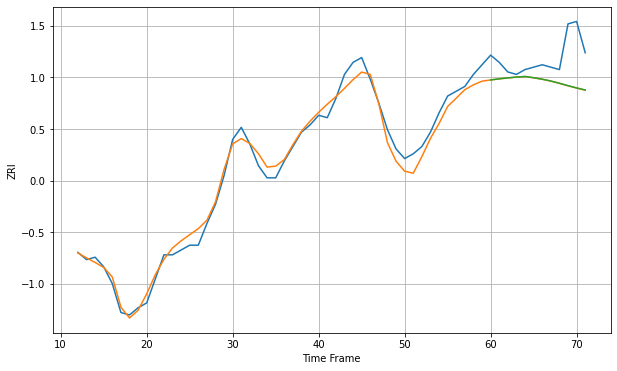

Wall time: 11.5 s
6053 3.770424470968312 12.786025143544588 12.755655511689012 [1155.69521512 1156.1490289  1156.54833596 1156.87092652 1157.12346925
 1156.60723367 1155.99217147 1155.2459761  1154.31452397 1153.30693503
 1152.37424261 1151.51914752]
60 60 12


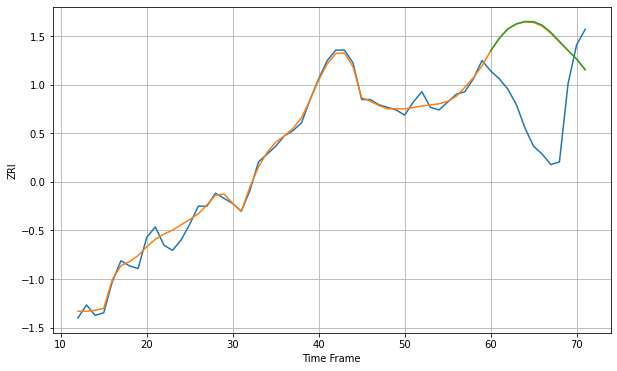

Wall time: 19.1 s
6082 2.4626752758649406 33.25013392629406 33.4338149195177 [1240.69767964 1245.52344693 1249.14714042 1251.10569642 1252.0123229
 1251.92832752 1250.58317488 1247.84628525 1244.37624347 1240.8675609
 1237.58972875 1233.45389617]

Got an mse at 0.0025 in round 484 and stopped training

60 60 12


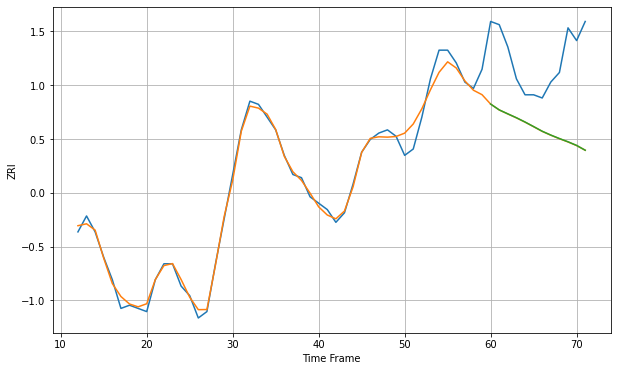

Wall time: 18.4 s
6106 2.605039315818117 24.096580172685087 24.06916140136472 [1103.08908831 1101.26296811 1100.01963942 1098.80013806 1097.46436627
 1096.02963226 1094.5681318  1093.36711134 1092.27611099 1091.25913649
 1090.12137918 1088.61431883]
60 60 12


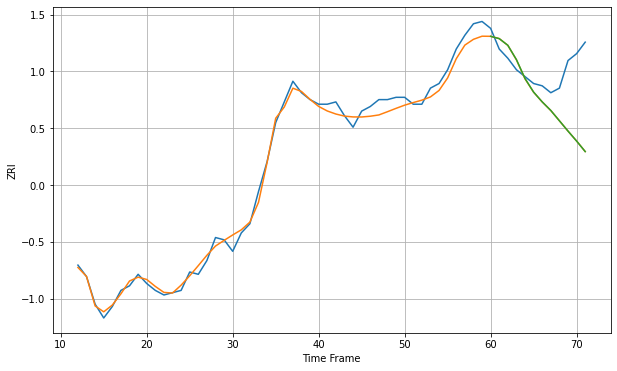

Wall time: 18.5 s
6108 3.2613832254855737 20.53882121611173 20.54201795318459 [1204.53863295 1203.52355646 1200.62760865 1194.40356265 1186.16883057
 1180.26763462 1176.01174276 1172.26648421 1167.79112893 1163.30594377
 1158.96809439 1154.3924197 ]
60 60 12


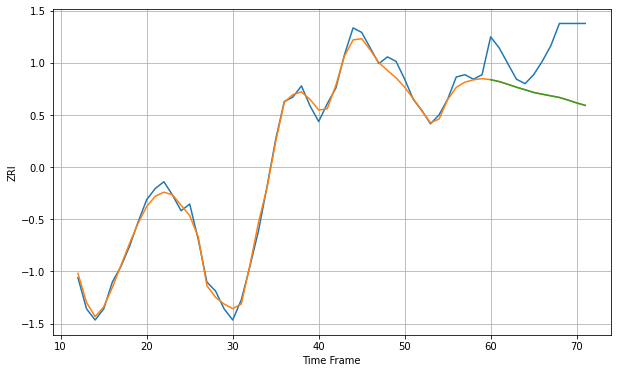

Wall time: 19.1 s
6112 2.8641571066423106 23.07709103466266 23.073331536361366 [1133.78037808 1132.92767177 1131.71575822 1130.41781686 1129.28018863
 1128.06261603 1127.28238261 1126.53776316 1125.80463663 1124.64582849
 1123.36801256 1122.26301796]

Got an mse at 0.0025 in round 417 and stopped training

60 60 12


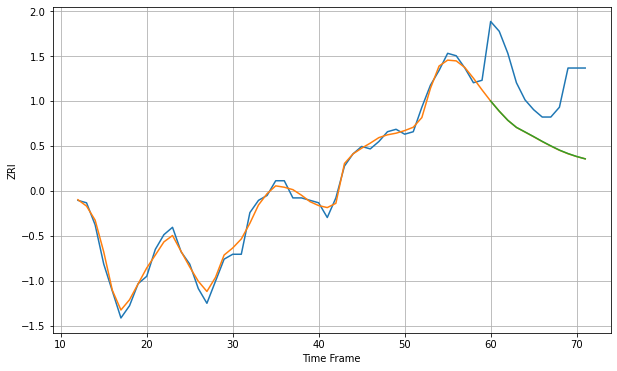

Wall time: 16.2 s
6114 2.544932518932244 25.728644221067032 25.701412446195807 [1106.52502831 1102.39554249 1098.67355796 1095.77854251 1093.91090759
 1092.01950499 1090.05935246 1088.22869706 1086.50846727 1085.09319507
 1083.90848383 1082.93237406]

Got an mse at 0.0025 in round 272 and stopped training

60 60 12


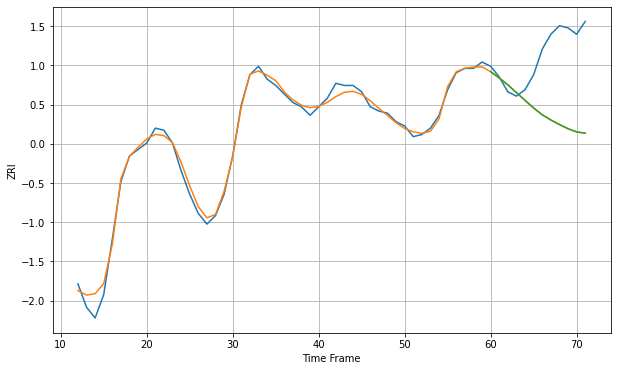

Wall time: 12.3 s
6119 2.8923323160101777 31.71465911669584 31.707138439996637 [1378.4767085  1375.51651622 1372.29665535 1368.67116319 1365.02093513
 1361.45219697 1358.24671781 1355.81431613 1353.68578536 1351.74066903
 1350.22033582 1349.63166278]

Got an mse at 0.0025 in round 349 and stopped training

60 60 12


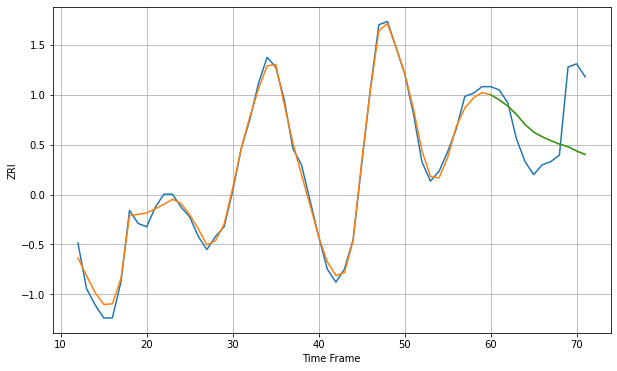

Wall time: 15.7 s
6320 2.165936007979535 14.080173062164727 14.079782494542812 [1061.52810093 1059.93676738 1058.03772215 1055.47954676 1052.38239656
 1050.05853292 1048.60345599 1047.43380761 1046.38167719 1045.56431766
 1044.24797638 1043.19215728]

Got an mse at 0.0024 in round 379 and stopped training

60 60 12


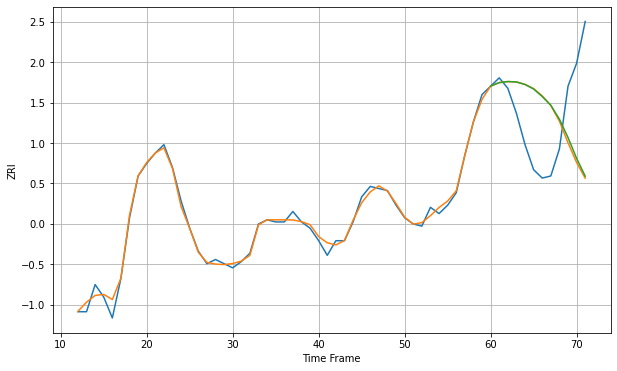

Wall time: 16.9 s
6360 2.373674111437448 34.24580569178346 33.67829993806561 [1110.05993141 1111.72413102 1112.22410617 1112.03341981 1110.80615946
 1108.64080081 1105.06988096 1100.8739329  1094.17919712 1085.41762914
 1075.42590147 1066.90542116]

Got an mse at 0.0025 in round 270 and stopped training

60 60 12


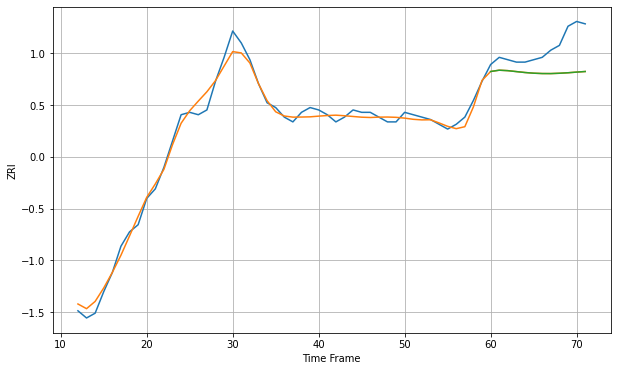

Wall time: 17 s
6401 2.8953911920426774 11.639693755864112 11.64241160472711 [1232.07445556 1232.61609892 1232.42219763 1232.02816575 1231.64461249
 1231.36582989 1231.21949164 1231.20548536 1231.34024119 1231.54895252
 1231.8252115  1232.07549104]
60 60 12


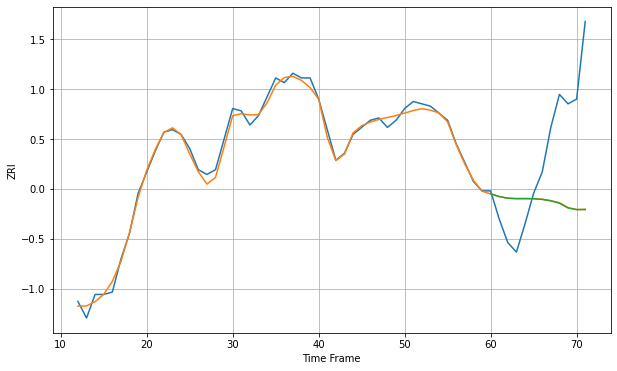

Wall time: 19 s
6405 2.2335017407054596 35.15235670124951 35.214632088840276 [1296.74625158 1295.59611762 1294.89295596 1294.70997104 1294.72817255
 1294.668528   1294.38284456 1293.75530954 1292.80379165 1290.75109992
 1290.03977969 1290.09089987]
60 60 12


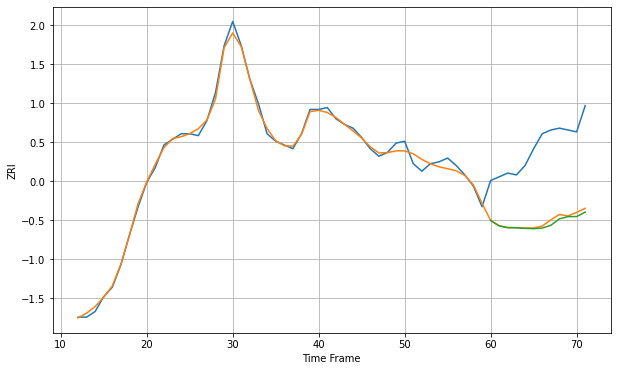

Wall time: 18.7 s
6418 2.449755426927094 40.33385662540765 41.48373370666794 [1186.6294471  1183.74333483 1182.80640308 1182.74706365 1182.4615646
 1182.2723863  1182.60261868 1184.07216354 1187.53772929 1188.70088889
 1188.75920378 1191.15592177]

Got an mse at 0.0025 in round 275 and stopped training

60 60 12


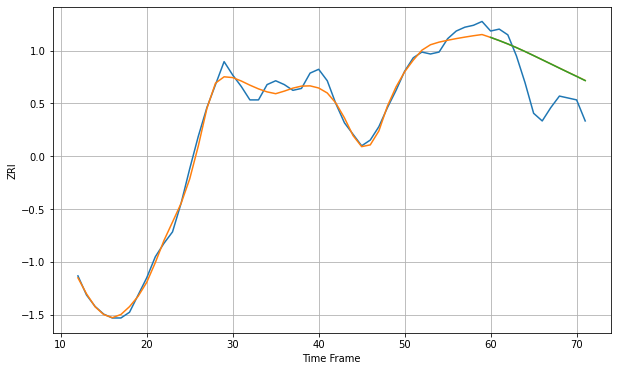

Wall time: 12.7 s
6450 3.893575805756764 17.80253273067089 17.786428458103494 [1157.66202532 1156.0179277  1154.24593627 1152.33291816 1150.29388899
 1148.15854505 1145.98373232 1143.80241306 1141.61002771 1139.43905977
 1137.29170114 1135.09257915]
60 60 12


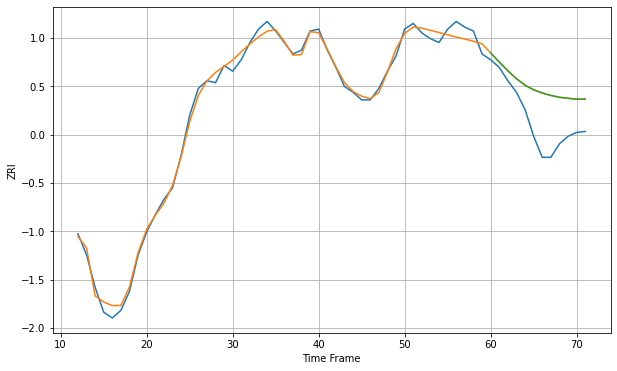

Wall time: 17.6 s
6451 3.3572028322495524 19.576487305388145 19.57514893710218 [1140.55480986 1135.82352776 1131.23383945 1127.07939239 1123.71132623
 1121.26074172 1119.59752223 1118.32161314 1117.37535424 1116.81762294
 1116.39653314 1116.43932106]
60 60 12


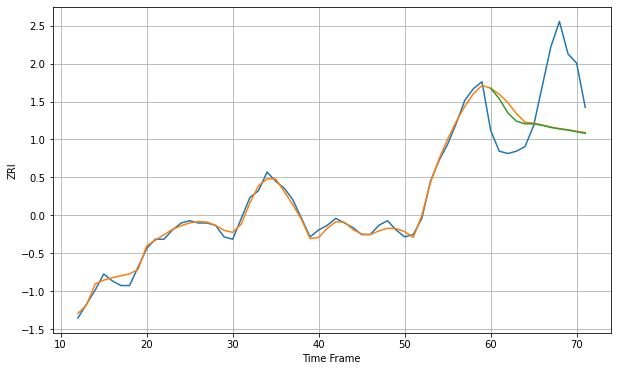

Wall time: 17.8 s
6457 1.9507895301956573 24.93769773673132 24.400458242103017 [1250.18891279 1245.66203257 1239.52955055 1235.94001689 1234.8143068
 1234.80891716 1234.14206593 1233.25312355 1232.62367473 1232.10505815
 1231.39990696 1230.68901776]

Got an mse at 0.0025 in round 344 and stopped training

60 60 12


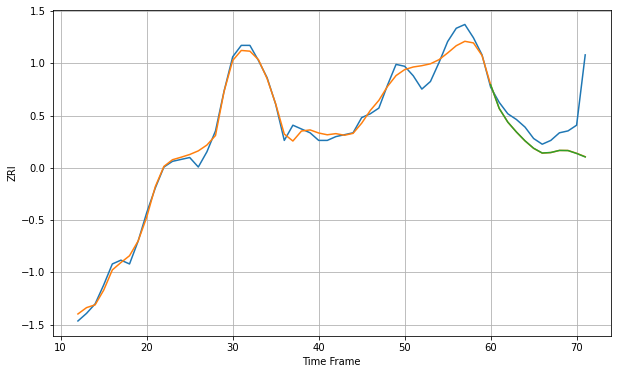

Wall time: 16.1 s
6460 4.15254315240448 17.074129377217858 17.1053679823506 [1438.26905246 1425.80292104 1418.60856086 1413.41908346 1408.77962072
 1404.87504778 1402.36890262 1402.63506445 1403.73904654 1403.65134068
 1402.13552055 1400.31082865]
60 60 12


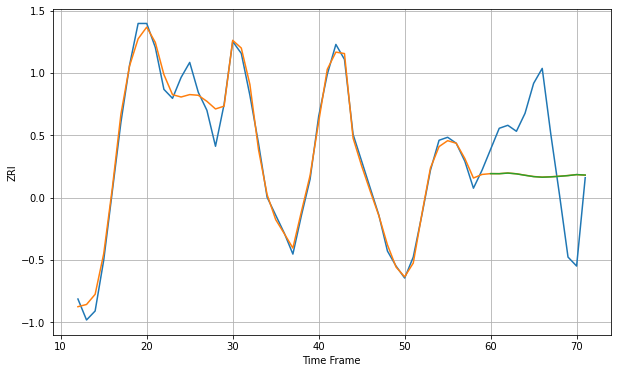

Wall time: 18.4 s
6484 3.3548860106031504 21.163318945845766 21.177193345869306 [1424.8615466  1424.83782087 1425.04299589 1424.78957945 1424.30683864
 1423.86323416 1423.66352978 1423.78043089 1423.9619547  1424.19810943
 1424.53986599 1424.38785163]
60 60 12


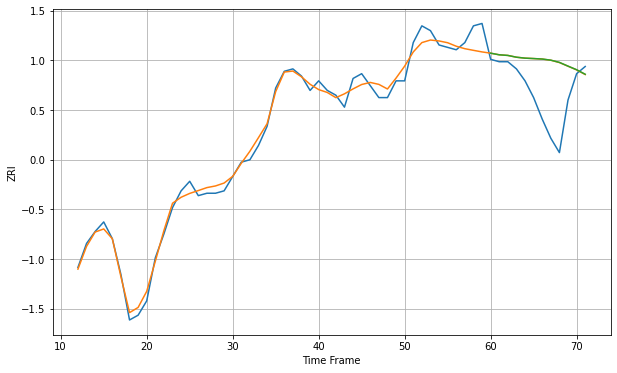

Wall time: 18.3 s
6489 3.7191572912438495 17.625682099970792 17.646490102162318 [1250.57425299 1249.89695727 1249.63496767 1248.88875882 1248.49590701
 1248.32570208 1248.12594029 1247.65399829 1246.72023042 1245.16256735
 1243.65719114 1241.76217045]

Got an mse at 0.0025 in round 360 and stopped training

60 60 12


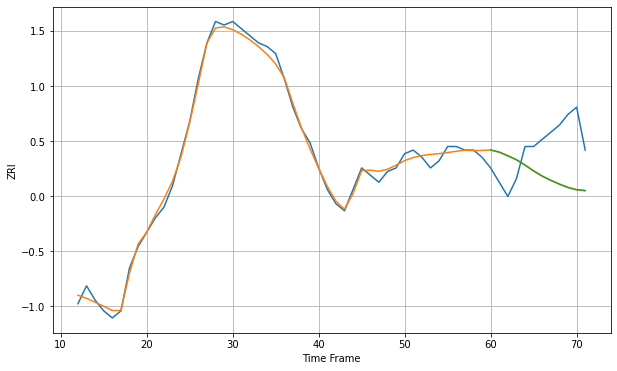

Wall time: 14.5 s
6492 1.5707488273376087 12.817380048337323 12.809217913068537 [1218.02710096 1217.43255283 1216.39556219 1215.29035985 1213.80220171
 1212.16418558 1210.71293742 1209.52973538 1208.47071265 1207.54167525
 1206.9064238  1206.66000345]

Got an mse at 0.0025 in round 235 and stopped training

60 60 12


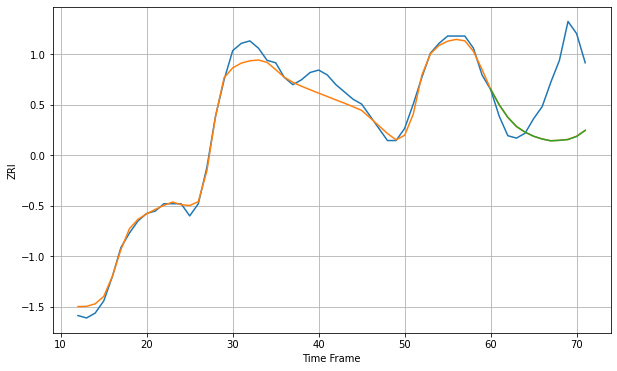

Wall time: 11.9 s
6511 3.6968238842883596 23.990512433158706 24.01489720938618 [1257.17294822 1250.69451745 1245.5332795  1241.78379139 1239.4493833
 1237.76876718 1236.62791017 1235.90882087 1236.08875525 1236.4211556
 1237.69071854 1240.1780614 ]
60 60 12


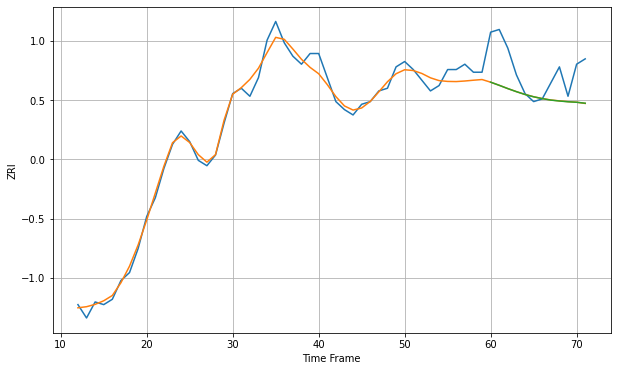

Wall time: 18.2 s
6512 2.975875745623941 12.066415665399163 12.066601945090126 [1311.26879343 1310.1000543  1308.86624635 1307.71755294 1306.6641137
 1305.79488196 1305.11440313 1304.56162488 1304.22105494 1303.93754775
 1303.75254156 1303.39506946]

Got an mse at 0.0025 in round 306 and stopped training

60 60 12


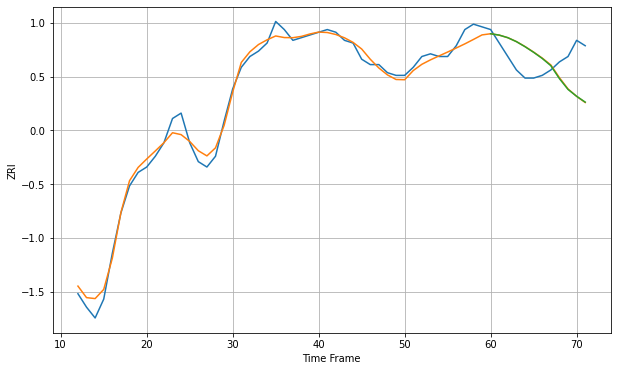

Wall time: 13.5 s
6513 2.9439890483784668 11.177236035421052 11.161522474278783 [1249.44352623 1248.93960203 1247.97468253 1246.51072512 1244.64001276
 1242.55322508 1240.28152737 1237.59039244 1232.79172172 1228.79335493
 1226.24300143 1224.08037371]

Got an mse at 0.0025 in round 231 and stopped training

60 60 12


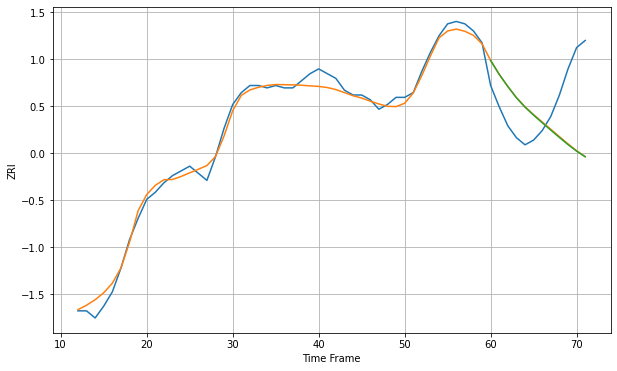

Wall time: 11 s
6515 2.997419342388919 23.93051364986678 24.005080346552873 [1232.55131784 1226.69269227 1221.56520752 1216.84558472 1212.88626233
 1209.49352081 1206.30125642 1203.17605344 1200.09389595 1197.09831109
 1194.32701721 1191.9597417 ]
60 60 12


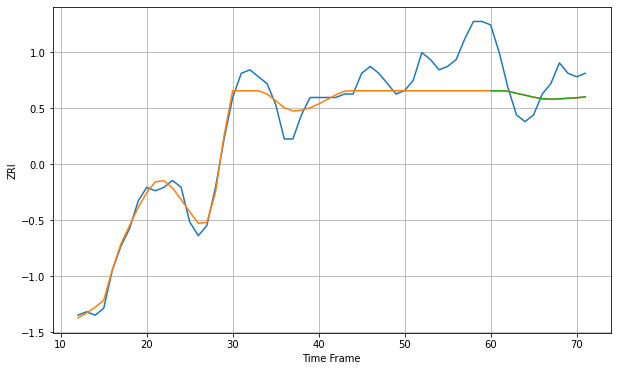

Wall time: 19.7 s
6516 6.204451257673028 8.56189625871008 8.53722094302309 [1252.94347934 1252.94347934 1252.82551206 1252.21940232 1251.67807202
 1251.09194666 1250.65390828 1250.51281649 1250.62466821 1250.80126795
 1250.93148772 1251.21559896]

Got an mse at 0.0024 in round 243 and stopped training

60 60 12


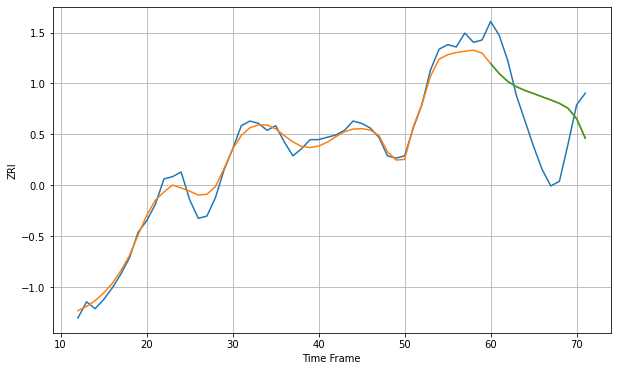

Wall time: 12.1 s
6519 3.687280784303129 21.50489169486861 21.49577947009551 [1275.82382634 1271.5020767  1268.0739224  1265.83603787 1264.19859926
 1262.84761103 1261.47577699 1260.09687831 1258.61658374 1256.46179505
 1251.91630805 1243.54221942]

Got an mse at 0.0025 in round 230 and stopped training

60 60 12


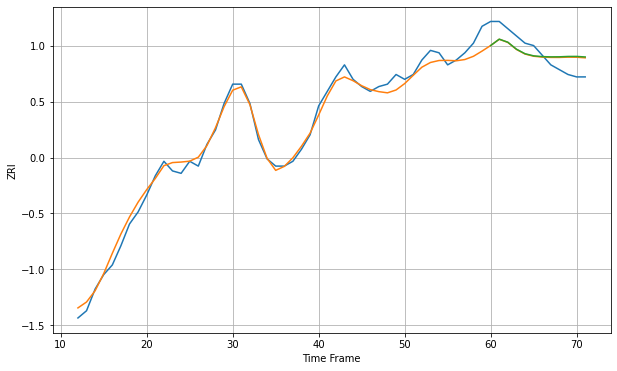

Wall time: 11.5 s
6604 3.1713212795465506 6.292932291692277 6.385399467499946 [1346.01258068 1348.6599927  1347.39700218 1344.50819714 1342.61823127
 1341.73652976 1341.42514244 1341.31292761 1341.34027601 1341.48856414
 1341.50312759 1341.27761049]

Got an mse at 0.0025 in round 250 and stopped training

60 60 12


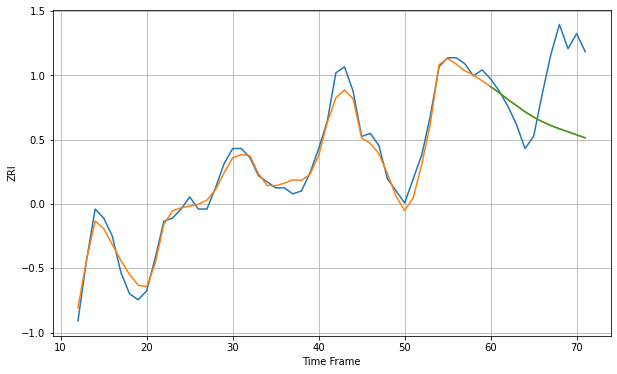

Wall time: 12.6 s
6605 3.14741017013696 19.878636367812796 19.883725580214705 [1406.41356139 1404.4464416  1402.20657384 1400.20783774 1398.15080386
 1396.36666897 1394.88693195 1393.6116887  1392.52388045 1391.52910431
 1390.52470736 1389.50680017]

Got an mse at 0.0025 in round 184 and stopped training

60 60 12


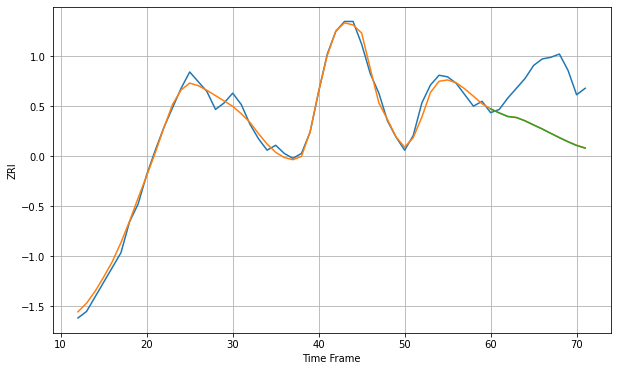

Wall time: 10.7 s
6606 3.7798311099979247 33.324052882383555 33.399689523169506 [1413.35073214 1410.86477559 1408.66710317 1408.03061806 1406.01434431
 1403.45224817 1401.00058162 1398.28785864 1395.64473877 1393.1317737
 1390.86420433 1389.2322933 ]

Got an mse at 0.0024 in round 462 and stopped training

60 60 12


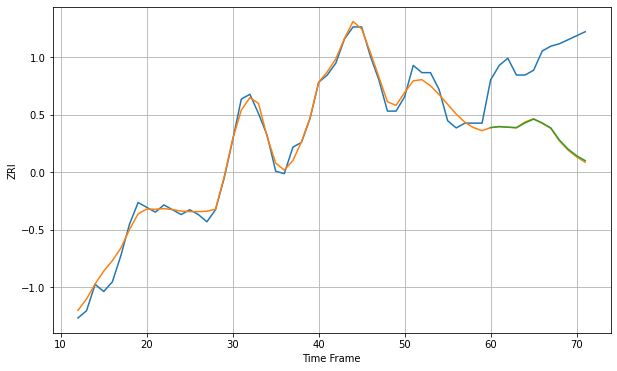

Wall time: 20 s
6607 3.380254713241332 34.65631888574972 34.440932580597476 [1307.1348055  1307.56621104 1307.31892359 1307.06031033 1309.08029661
 1310.67329921 1309.06360512 1307.01061656 1301.97029155 1298.23170266
 1295.4586987  1293.39917558]

Got an mse at 0.0024 in round 301 and stopped training

60 60 12


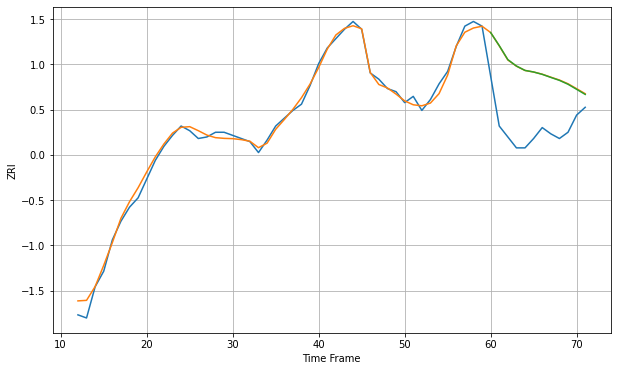

Wall time: 15.3 s
6608 3.4537549884283627 38.82796870234556 38.798200632617664 [1368.90322585 1360.52067993 1351.53724506 1347.43999208 1344.6273513
 1343.61521779 1342.11959986 1340.15710676 1338.26273055 1335.76529839
 1332.5259585  1329.25871369]

Got an mse at 0.0025 in round 218 and stopped training

60 60 12


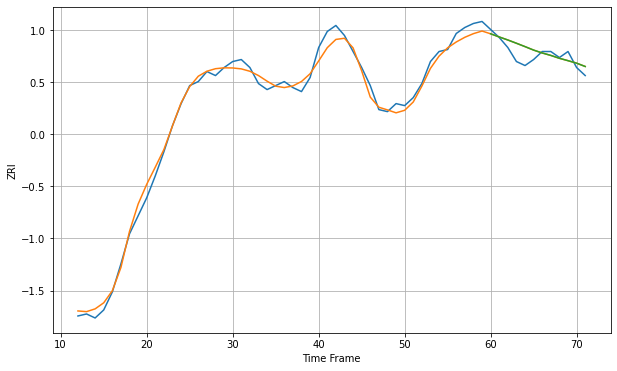

Wall time: 11.6 s
6610 3.5804656432105 4.693222479042664 4.691142334246877 [1325.84447526 1324.26140777 1322.75540729 1321.12353599 1319.44728666
 1317.71139688 1316.27776925 1315.05044495 1313.6152425  1312.42577379
 1311.1826161  1309.51872973]

Got an mse at 0.0025 in round 403 and stopped training

60 60 12


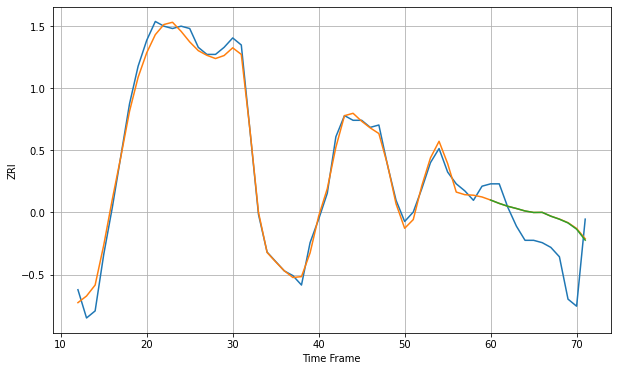

Wall time: 16.7 s
6614 3.602119242116898 16.543433662227155 16.494296184564313 [1477.10759388 1475.68373935 1474.46810975 1473.51839349 1472.47650537
 1471.83201749 1471.87806634 1470.25702456 1468.97571294 1467.37822469
 1464.72151735 1460.0665121 ]

Got an mse at 0.0025 in round 147 and stopped training

60 60 12


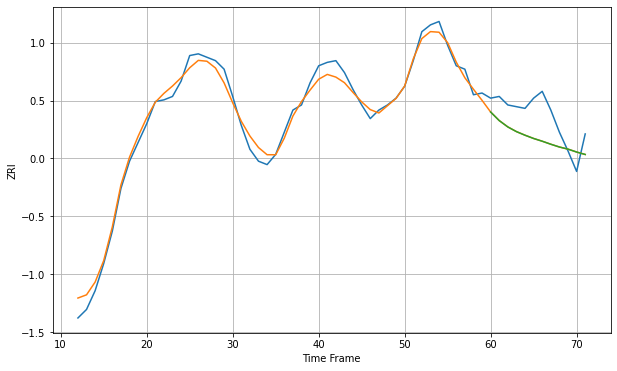

Wall time: 13.1 s
6615 4.848733346912026 15.97852094802393 15.98557803191614 [1461.86456086 1456.8295275  1453.10210365 1450.35611033 1448.2406115
 1446.32787687 1444.72652936 1442.95168414 1441.32517954 1440.07647051
 1438.38312603 1436.95458944]
60 60 12


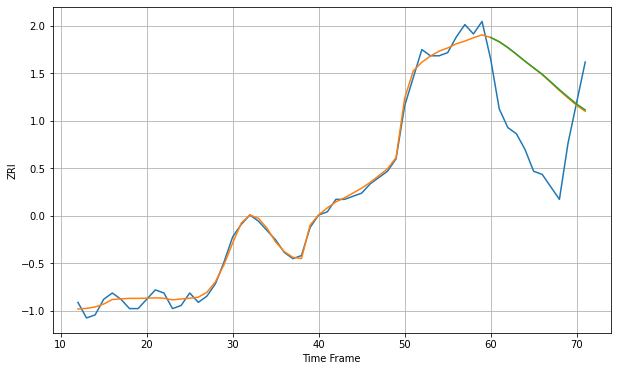

Wall time: 20.5 s
6704 1.921832784760745 25.04286351618788 25.118804780112534 [983.87855964 982.50544211 980.64382524 978.50656096 976.26900227
 974.17866709 972.08427264 969.65626445 967.16072535 964.82111288
 962.54734408 960.66340401]

Got an mse at 0.0024 in round 221 and stopped training

60 60 12


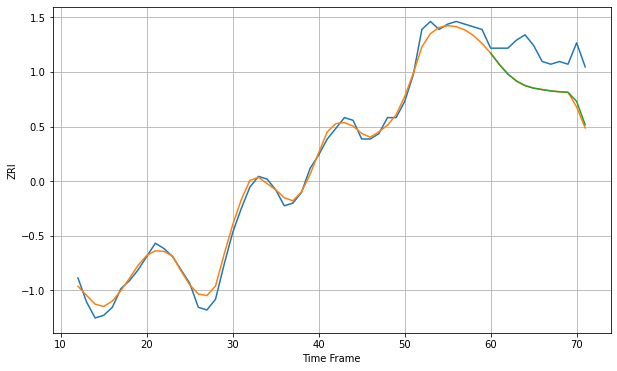

Wall time: 13.8 s
6705 2.729920232694715 14.523685833871783 14.085675690461098 [1004.14465119  999.97065045  996.33535962  993.71525344  991.99827072
  991.04942452  990.49582203  990.01014368  989.67385296  989.48393527
  986.10570773  977.31590044]

Got an mse at 0.0025 in round 267 and stopped training

60 60 12


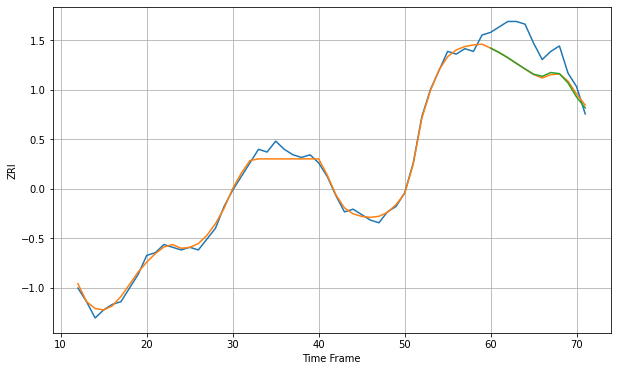

Wall time: 12.5 s
6708 1.8287075052313981 9.974467399222375 9.885091324837628 [1008.19945445 1006.5618621  1004.67633008 1002.58931375 1000.54331842
  998.61571206  997.85526809  999.22801939  998.81363748  995.3929795
  990.1722179   986.1990617 ]
60 60 12


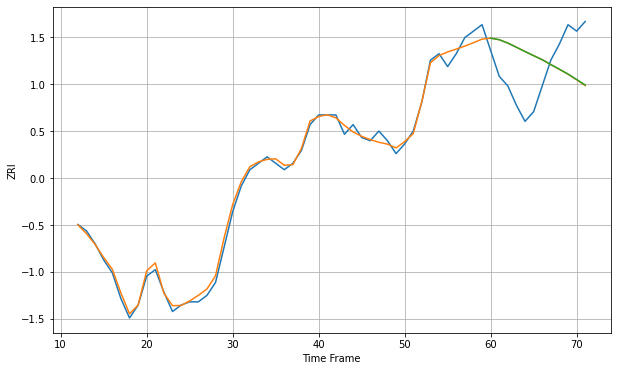

Wall time: 18.5 s
6710 1.7505679134171939 14.157402310484642 14.1240135328231 [919.82151953 919.34351348 918.29025002 917.00701662 915.67072899
 914.39237656 913.13129034 911.62731804 910.17661931 908.67615713
 907.01009915 905.28070924]

Got an mse at 0.0025 in round 202 and stopped training

60 60 12


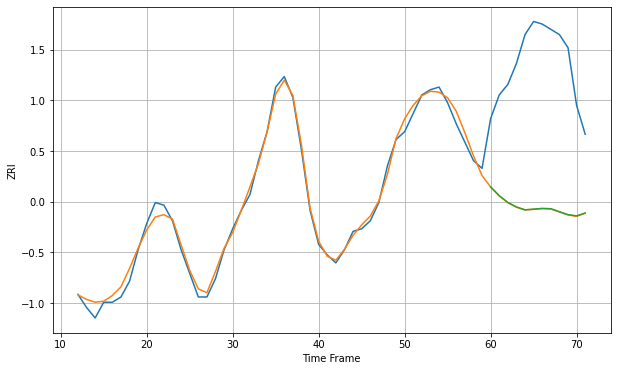

Wall time: 10.5 s
6770 2.5041960130723493 56.076863372945525 56.00111364712579 [1104.92135946 1101.59210007 1099.02126507 1097.29025144 1096.21097815
 1096.47351409 1096.75702549 1096.63834775 1095.48935279 1094.37178187
 1093.91549043 1094.99258195]
60 60 12


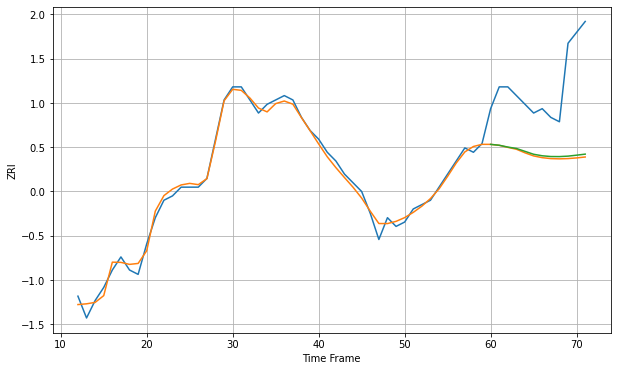

Wall time: 20.4 s
6790 1.2898988408689642 17.305793103837903 16.930457163137405 [863.81299205 863.6134674  863.19562549 862.8737158  862.2091831
 861.54557374 861.19698405 861.02522154 861.0111629  861.11545766
 861.33537955 861.57477895]
60 60 12


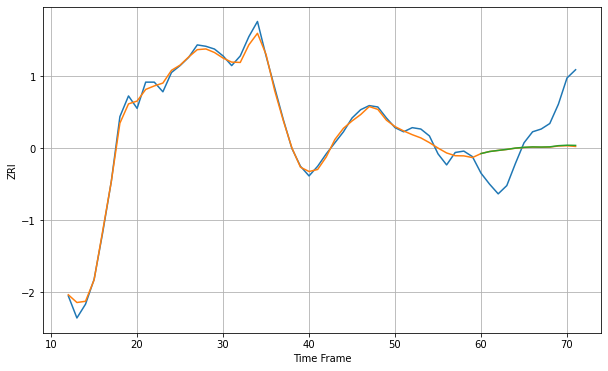

Wall time: 20.6 s
6810 3.8750575782438443 28.2697787004805 28.057793690500013 [1650.21226914 1651.70146101 1652.50048488 1653.2504054  1654.185214
 1654.74730668 1655.03604275 1654.94609205 1655.08126194 1655.92897852
 1656.26887246 1656.13443208]
60 60 12


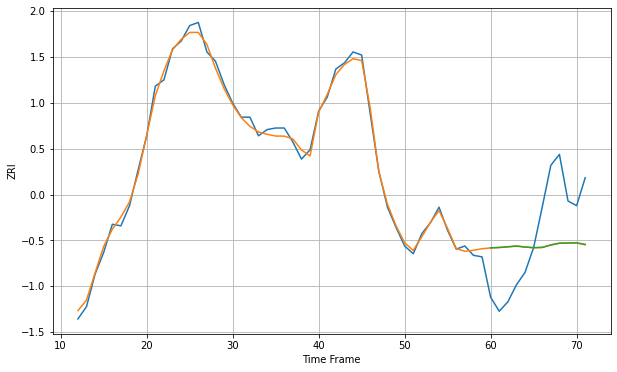

Wall time: 18.5 s
6824 3.519176787049387 34.87983321118929 34.84779989395462 [1843.79633158 1844.03247087 1844.46724813 1844.9542996  1844.3329915
 1843.92023091 1844.08844558 1845.67569592 1846.81898396 1846.94272055
 1847.03643906 1846.00309631]
60 60 12


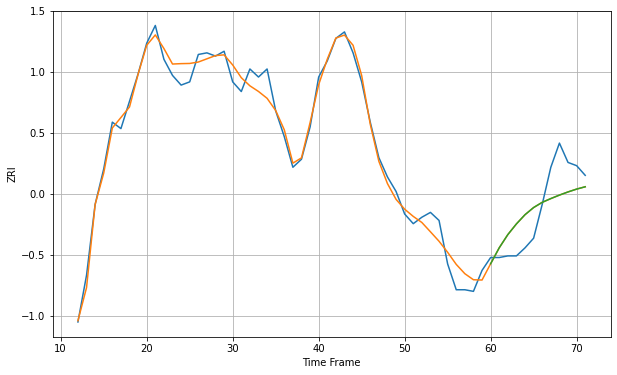

Wall time: 17.9 s
6825 6.932927169171747 16.88765148129714 16.889635268201832 [1640.1343464  1650.02774293 1658.2223103  1664.86774675 1670.58033709
 1675.01953086 1678.2498162  1680.57895925 1682.7353837  1684.69671546
 1686.44952331 1687.89227281]
60 60 12


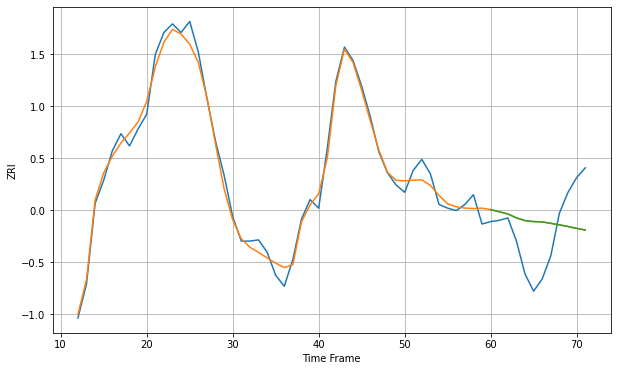

Wall time: 20.4 s
6830 7.689716679015263 33.88997134077112 33.87587433045139 [2322.80643318 2321.08093849 2319.23306078 2316.02044271 2313.78987227
 2312.99307026 2312.69655331 2311.52566976 2310.33249835 2308.94646115
 2307.40903438 2306.08683545]
60 60 12


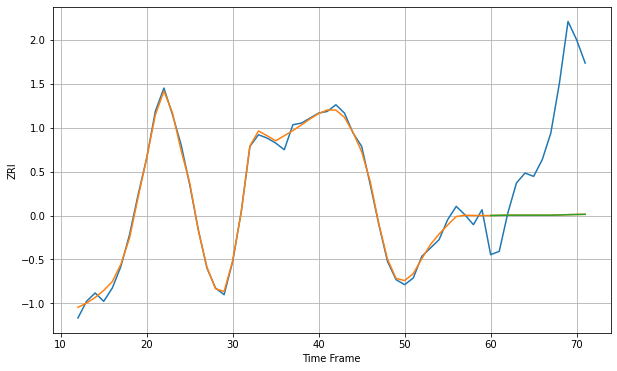

Wall time: 19.4 s
6851 2.853896404882894 61.28736945550511 61.2893454976445 [1814.51622608 1814.63306624 1814.70197183 1814.70197183 1814.70197183
 1814.70197183 1814.70197183 1814.70197183 1814.84212451 1815.00430731
 1815.12852057 1815.22188883]

Got an mse at 0.0025 in round 467 and stopped training

60 60 12


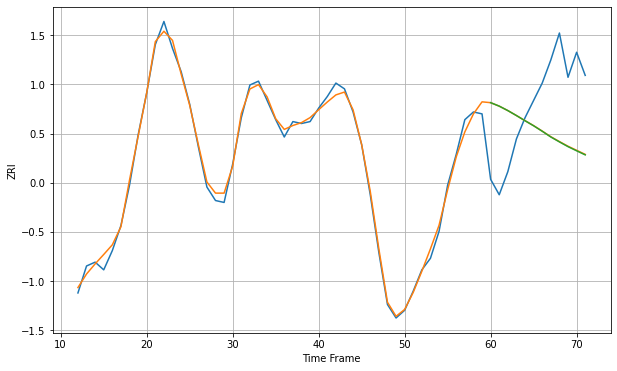

Wall time: 17.5 s
6854 2.97013647103992 36.49131874848132 36.602013978461486 [1837.82313206 1836.02147511 1833.71060981 1831.13054856 1828.43963495
 1825.82352695 1822.97819124 1820.00232177 1817.44999462 1814.98399385
 1812.83091658 1810.71286082]

Got an mse at 0.0025 in round 457 and stopped training

60 60 12


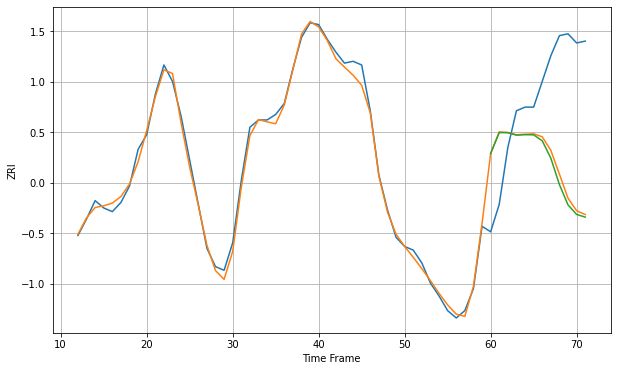

Wall time: 17.5 s
6855 3.350582805304968 56.78220530668108 58.7973254146872 [1840.71617653 1852.10115962 1852.06517453 1850.72707528 1850.95209486
 1850.8779066  1847.65292082 1838.17174076 1823.76542945 1812.66534193
 1807.45878763 1806.02032383]

Got an mse at 0.0024 in round 478 and stopped training

60 60 12


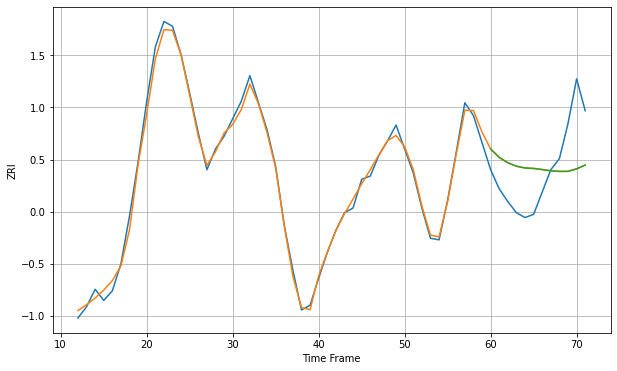

Wall time: 23.3 s
6902 3.7737358195452315 27.86179325805317 27.86802102272567 [2115.03426047 2109.73025756 2106.38145863 2104.20954381 2103.09283683
 2102.81511964 2102.10056178 2101.31382464 2100.93574059 2100.97609659
 2102.53932574 2104.91123249]

Got an mse at 0.0025 in round 439 and stopped training

60 60 12


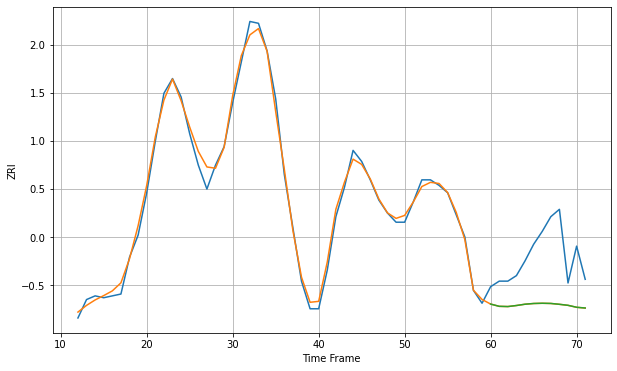

Wall time: 17.5 s
6906 3.6610535018503465 29.179062527175937 29.166371578725414 [1906.54921125 1905.32458825 1905.19882849 1905.76761134 1906.47335081
 1906.86727165 1906.99173646 1906.88928064 1906.42707437 1905.87708272
 1904.81689007 1904.4147769 ]

Got an mse at 0.0025 in round 209 and stopped training

60 60 12


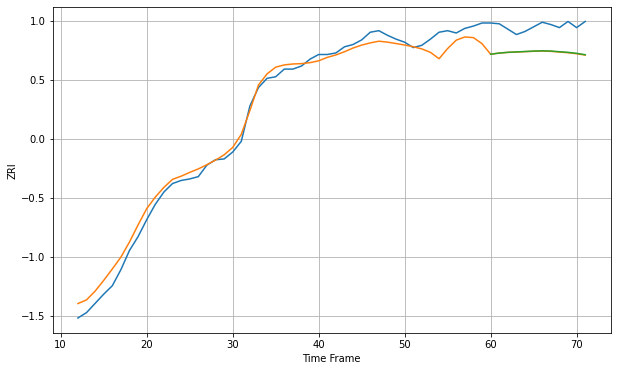

Wall time: 11.2 s
7002 12.305331277744306 34.90463410420778 34.60978511591881 [1793.37744321 1794.86294555 1795.8365494  1796.33821384 1796.90088855
 1797.4526532  1797.79286955 1797.50033813 1796.61672178 1795.80171962
 1794.53821136 1792.70415455]

Got an mse at 0.0025 in round 129 and stopped training

60 60 12


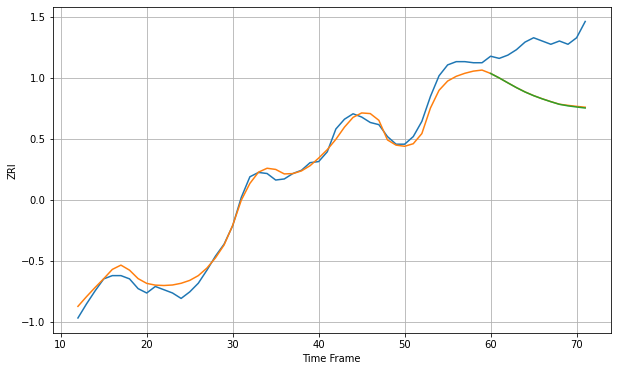

Wall time: 9.15 s
7003 7.233829852357874 49.81087778526204 50.04363305270582 [1631.12868499 1626.99199799 1622.49677874 1618.08689055 1614.09310009
 1610.68837055 1607.76008543 1605.13580427 1602.71650643 1601.29295571
 1600.24484025 1599.30811617]

Got an mse at 0.0025 in round 222 and stopped training

60 60 12


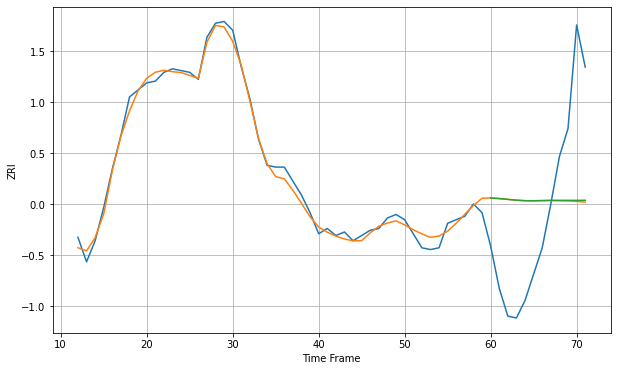

Wall time: 11.6 s
7030 3.8807887130979273 55.04717667019172 54.82079533574802 [2528.38007843 2528.05300843 2527.59352349 2527.13675353 2526.86359848
 2526.81854838 2526.94570813 2527.06956592 2527.04474292 2527.05084262
 2527.03625542 2527.10037472]

Got an mse at 0.0025 in round 271 and stopped training

60 60 12


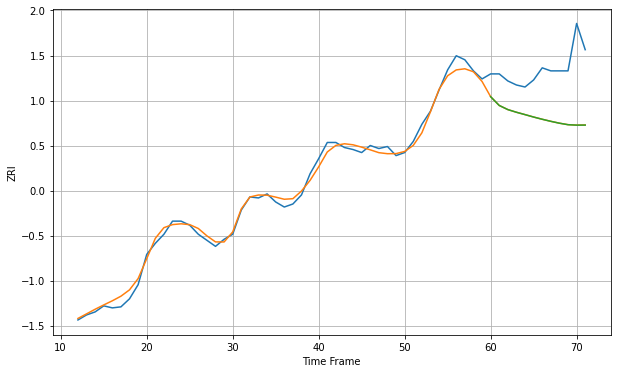

Wall time: 12.3 s
7055 5.364567385014138 51.22612485189499 51.260382174569976 [1713.39773387 1704.69829951 1700.60305411 1697.95856211 1695.61749511
 1693.21399253 1691.00737237 1688.95566712 1687.10610325 1685.61806149
 1685.18815955 1685.23432417]
60 60 12


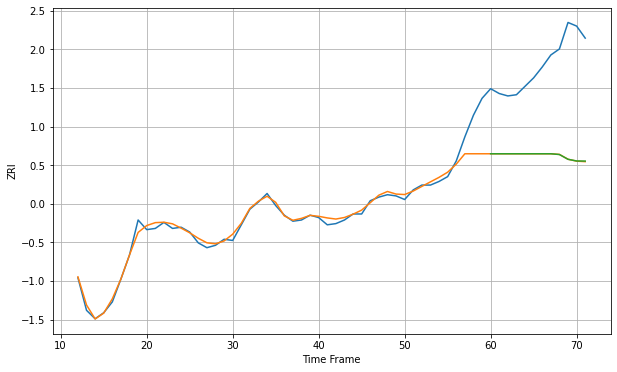

Wall time: 19.2 s
7093 8.823812029100619 77.88824840466563 77.83242312674653 [1933.98682595 1933.98682595 1933.98682595 1933.98682595 1933.98682595
 1933.98682595 1933.98682595 1933.98682595 1933.36285023 1929.39202971
 1928.01139756 1927.92329023]

Got an mse at 0.0025 in round 142 and stopped training

60 60 12


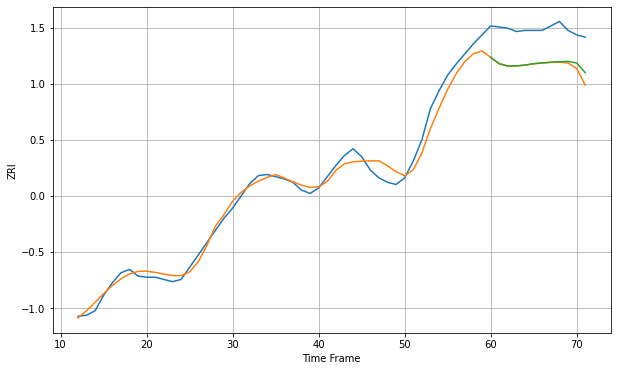

Wall time: 11 s
7109 7.534401598764485 32.50654943828891 30.85510501741139 [1590.89564552 1585.18057211 1583.10718741 1583.21448764 1583.97564453
 1585.18351185 1585.90800337 1586.54034002 1587.00567831 1587.23150624
 1585.86165603 1577.20556978]

Got an mse at 0.0025 in round 110 and stopped training

60 60 12


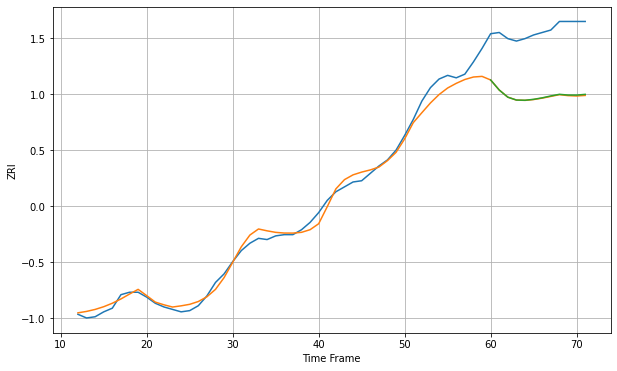

Wall time: 10.4 s
7111 6.344945795220923 53.17636119284689 52.876896654265785 [1405.24972493 1397.03327285 1391.20101021 1388.8632083  1388.69104116
 1389.452913   1390.67778707 1392.21094474 1393.5448827  1392.95257646
 1392.91418327 1393.5094498 ]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


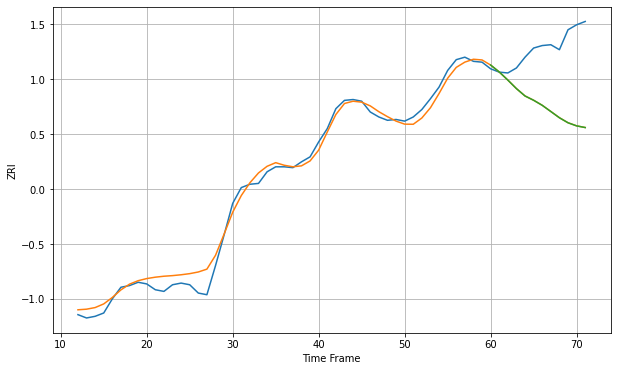

Wall time: 9.69 s
7201 9.718492807419636 75.73206290007282 75.75815191635024 [1744.53557927 1736.21144723 1726.45051901 1716.16167335 1707.28163636
 1702.12508515 1696.04212677 1688.57390479 1681.06285601 1675.02551944
 1671.2881355  1669.27761299]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


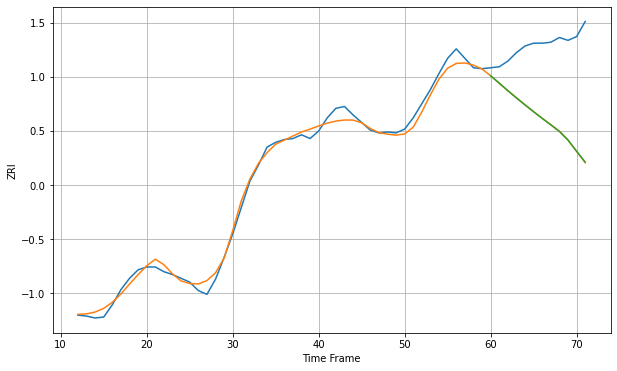

Wall time: 9.25 s
7202 6.500364352416264 84.11401100573873 84.04896545291868 [1685.48033816 1677.66929258 1669.73066229 1662.07283424 1654.66260736
 1647.37558251 1640.36110039 1633.50709963 1626.55538854 1617.40724672
 1605.50926605 1594.11634357]

Got an mse at 0.0025 in round 176 and stopped training

60 60 12


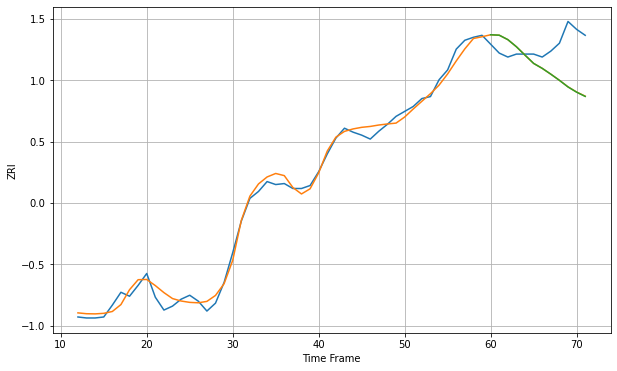

Wall time: 10.4 s
7206 6.685106040582916 35.53011139728394 35.59971252496948 [1730.542997   1730.10379267 1725.63156477 1718.419897   1709.92651372
 1701.56317289 1696.55531967 1690.67078913 1684.4408125  1677.75430975
 1672.47395065 1668.16837799]

Got an mse at 0.0025 in round 145 and stopped training

60 60 12


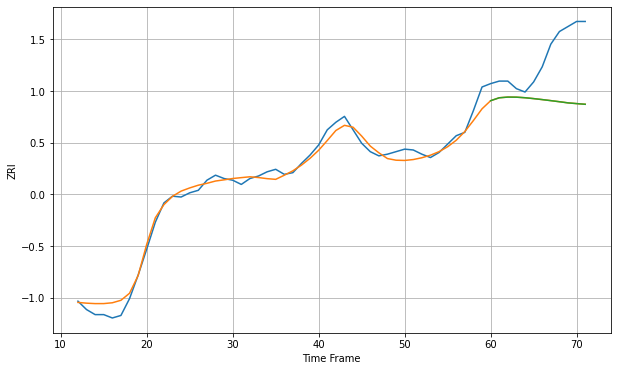

Wall time: 9.9 s
7302 8.584016816109825 59.34648516480557 59.36953924078164 [2490.66709323 2494.13438911 2494.96490303 2494.86108005 2494.1933335
 2493.15722339 2491.98034104 2490.73502466 2489.4434661  2488.0647318
 2487.20129254 2486.40475498]

Got an mse at 0.0025 in round 204 and stopped training

60 60 12


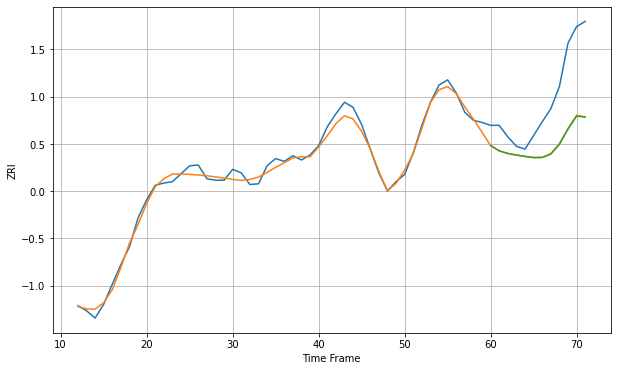

Wall time: 11.1 s
7960 8.026288833684765 72.44083091406783 72.93852796928029 [2192.94124728 2185.68452931 2182.02001807 2179.8210738  2177.93505518
 2176.32385375 2176.41648972 2181.17195078 2194.62102277 2215.77207064
 2233.77317545 2232.43732019]

Got an mse at 0.0025 in round 446 and stopped training

60 60 12


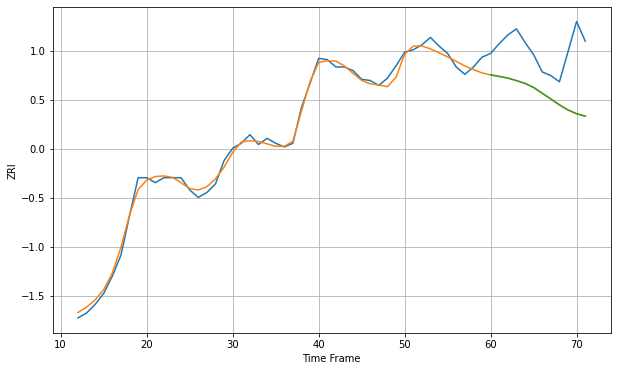

Wall time: 19.8 s
8901 4.5632889168571245 39.18727668042456 39.205076169441455 [1728.5951035  1727.32127912 1725.98234445 1723.92996929 1721.65748043
 1718.33823029 1713.64657763 1709.0020142  1704.23080392 1700.02595173
 1696.99975873 1695.02537219]

Got an mse at 0.0025 in round 306 and stopped training

60 60 12


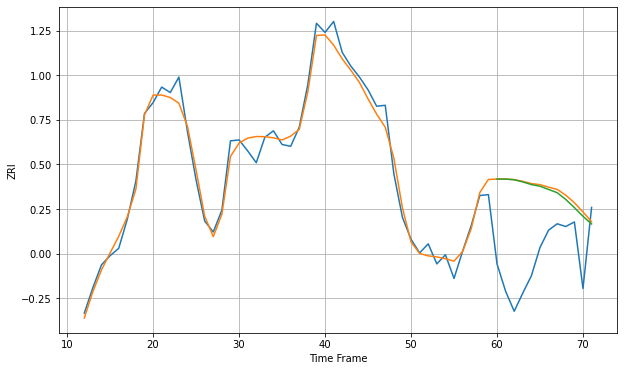

Wall time: 13.5 s
10001 11.385446227363385 85.26744442821004 84.1082995151151 [3748.07893415 3748.02162608 3747.27072131 3744.92789467 3742.02872608
 3740.22183421 3736.65211761 3733.11329195 3725.66480832 3716.71130824
 3707.19195603 3698.78598664]
60 60 12


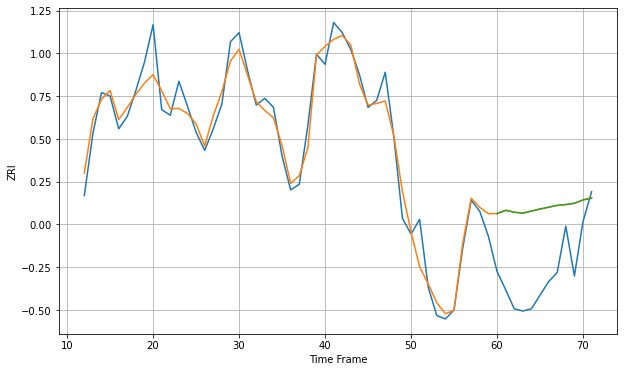

Wall time: 19.4 s
10002 14.234749043761923 63.39914546995016 63.43639315104518 [3492.0969358  3495.06270951 3493.36399351 3492.50541214 3494.37173772
 3496.16763394 3497.77354769 3499.36850683 3500.13160362 3501.19908564
 3504.14400213 3505.68317138]

Got an mse at 0.0025 in round 426 and stopped training

60 60 12


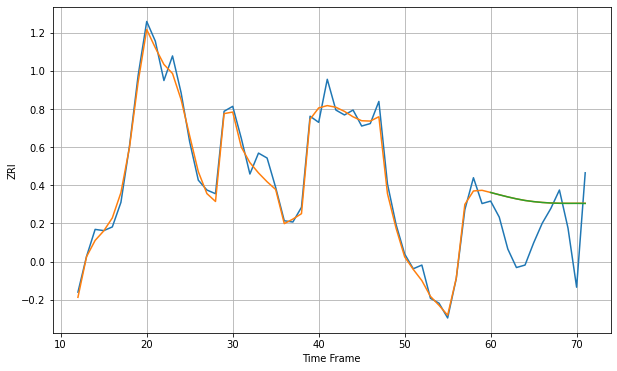

Wall time: 16.5 s
10003 7.901410336155936 35.68046802139274 35.670753917682106 [3669.99501348 3668.15512547 3666.3939686  3664.82120847 3663.50642703
 3662.56917318 3661.88529382 3661.44179852 3661.20689883 3661.1472078
 3661.1551156  3661.08294256]

Got an mse at 0.0024 in round 224 and stopped training

60 60 12


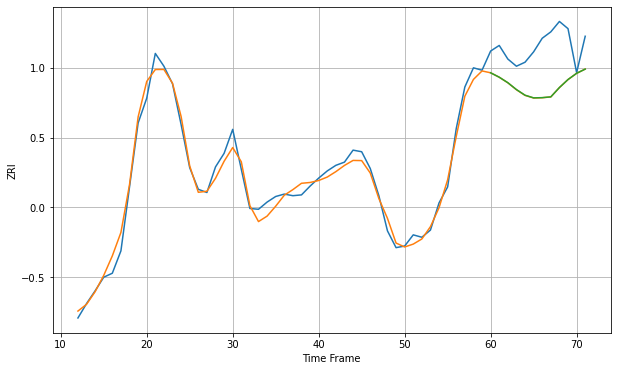

Wall time: 11.5 s
10005 10.713508977351594 53.14666311359602 53.05471327621177 [3673.77182421 3668.26190385 3661.40290913 3652.80380711 3645.75879512
 3642.37671102 3642.68714235 3643.66398316 3655.35887515 3665.36495092
 3673.13534499 3678.39301247]
60 60 12


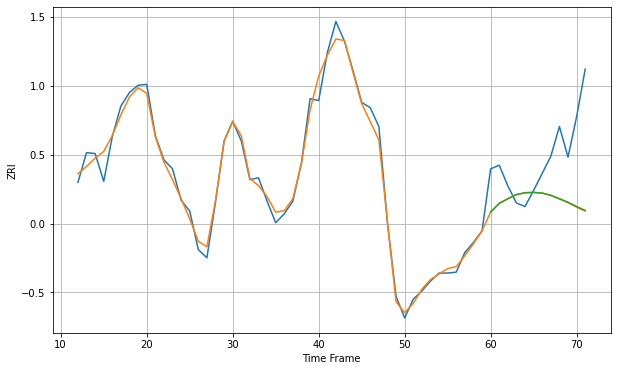

Wall time: 23 s
10009 9.557915513316201 65.33634562382532 65.01207539509329 [3691.86418996 3701.43389376 3706.66627035 3711.29107929 3713.39013137
 3713.78334089 3713.05080545 3710.55899254 3706.77765764 3702.83016969
 3698.02986793 3693.70788827]

Got an mse at 0.0024 in round 189 and stopped training

60 60 12


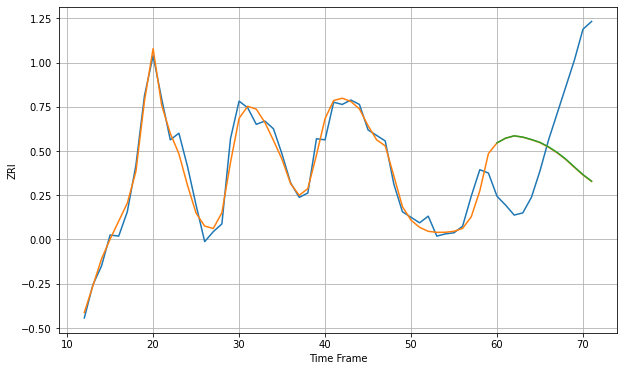

Wall time: 10.3 s
10010 9.732746152479923 77.69195747624067 77.56880742415069 [3707.28295051 3711.52249236 3713.64702978 3712.48849379 3710.31055381
 3707.71006342 3703.646227   3698.62077514 3692.59164839 3685.50217734
 3678.57010117 3672.66881611]
60 60 12


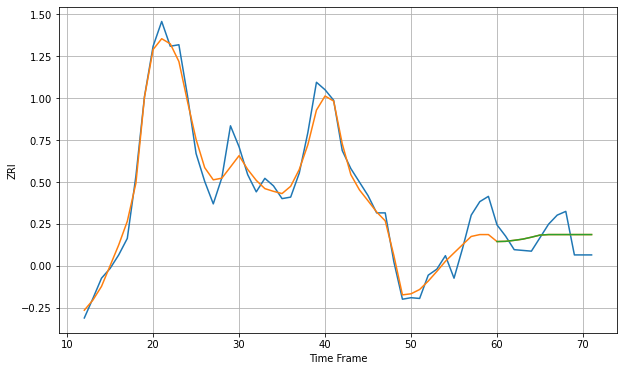

Wall time: 18.3 s
10011 18.7126931324946 21.019155570406514 21.01914601805202 [3764.79980902 3765.09512878 3766.42971722 3768.05027738 3770.60414785
 3773.45073238 3774.10177625 3774.10177625 3774.10177625 3774.10177625
 3774.10177625 3774.10177625]
60 60 12


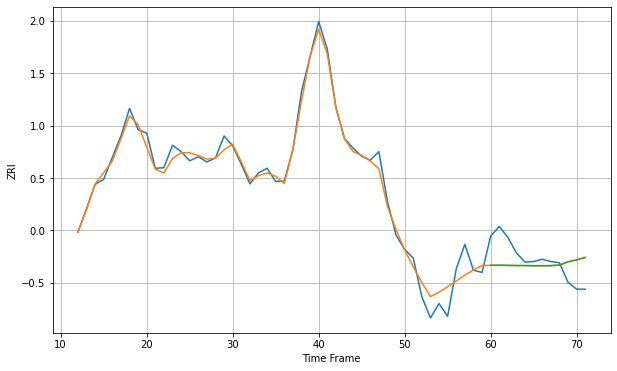

Wall time: 18.2 s
10012 16.448053038181445 37.8298997135517 37.7369601197326 [3521.53645939 3521.58045377 3521.33693708 3521.11005313 3521.0100292
 3520.79330321 3520.77994016 3520.91688045 3521.82365113 3527.50102653
 3530.79424218 3535.02739254]

Got an mse at 0.0025 in round 490 and stopped training

60 60 12


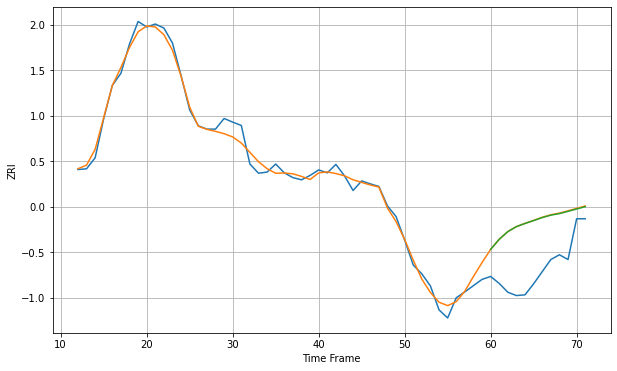

Wall time: 23.4 s
10013 19.485686668899277 135.18148991949656 134.6240348779304 [4515.70107533 4543.20885055 4564.08765828 4577.58804559 4586.20844106
 4594.05557036 4602.2165065  4608.82590997 4613.08425698 4619.19124668
 4625.57595705 4631.9605771 ]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


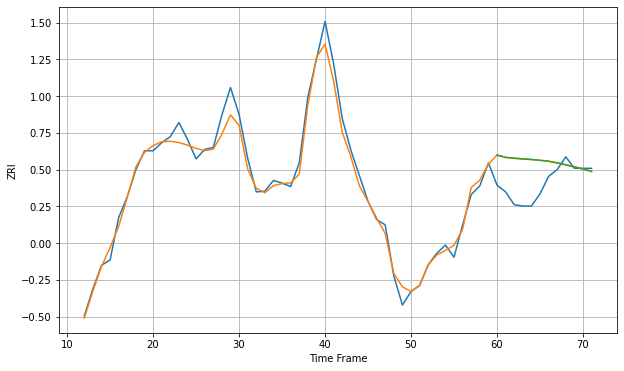

Wall time: 14.5 s
10014 14.023332289545413 43.104675865992945 43.11300181608397 [3874.73625557 3871.20621628 3869.99865759 3868.8668446  3868.08341181
 3866.89932803 3865.52468729 3862.9407609  3860.08252098 3857.05802322
 3853.8906129  3850.20023533]

Got an mse at 0.0025 in round 325 and stopped training

60 60 12


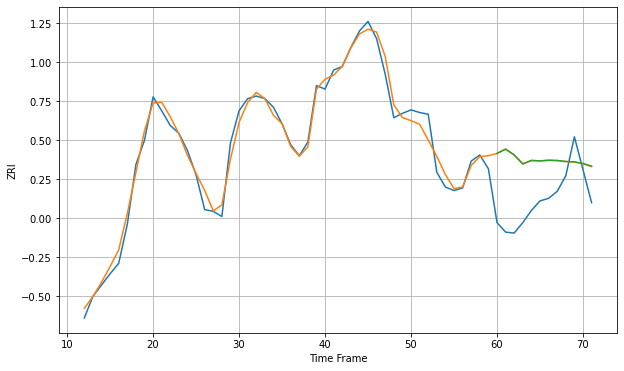

Wall time: 14.8 s
10016 10.664212135814484 57.531718183697144 57.629035097142875 [3594.79304603 3599.81884045 3593.09182915 3582.6434708  3586.73504882
 3586.20796364 3586.94373839 3586.66209167 3585.49952458 3585.04333108
 3583.17706288 3580.18209483]

Got an mse at 0.0025 in round 398 and stopped training

60 60 12


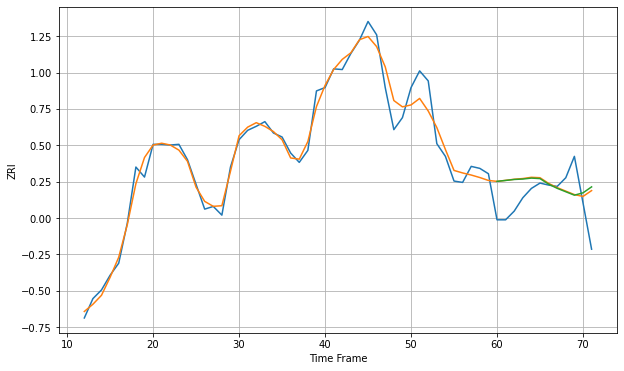

Wall time: 15.7 s
10017 16.725638662023666 42.55062893682845 43.65083762450325 [3501.55786954 3502.95741495 3504.40974083 3505.05463707 3506.45701341
 3505.7300534  3497.42334192 3491.15444241 3486.00343167 3480.88430418
 3484.36442576 3493.31419547]

Got an mse at 0.0025 in round 317 and stopped training

60 60 12


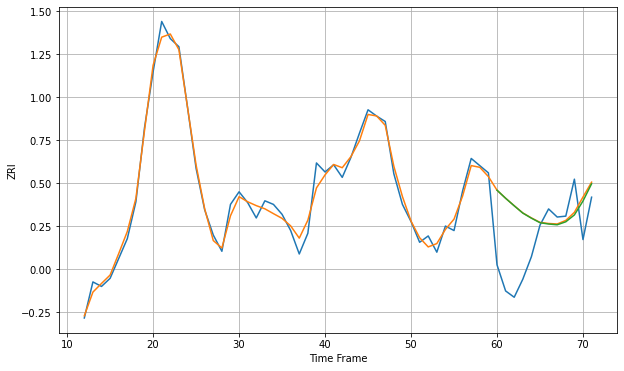

Wall time: 15.3 s
10018 8.628938607155982 57.16916343739855 56.9739198294569 [3671.77997139 3662.81473557 3654.46099805 3646.38329927 3640.73745292
 3635.68418514 3634.25282858 3633.39902123 3636.72629241 3644.34438638
 3659.76595756 3678.84926575]

Got an mse at 0.0025 in round 284 and stopped training

60 60 12


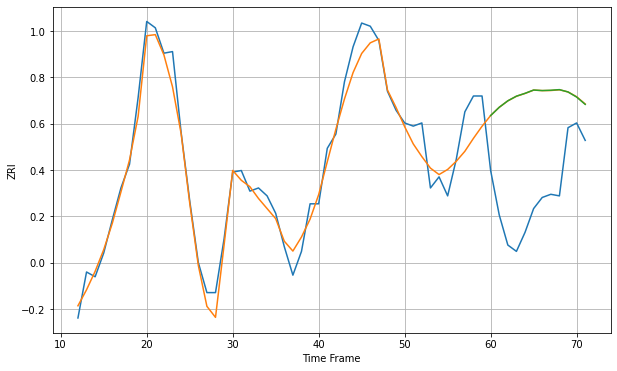

Wall time: 14.6 s
10019 10.77840409109264 65.51797591301042 65.55640286997979 [3634.67442673 3639.87209526 3643.9587049  3646.88589871 3648.67069335
 3650.7563557  3650.41516656 3650.62270943 3651.01316302 3649.54173902
 3646.33946231 3641.71455989]

Got an mse at 0.0025 in round 465 and stopped training

60 60 12


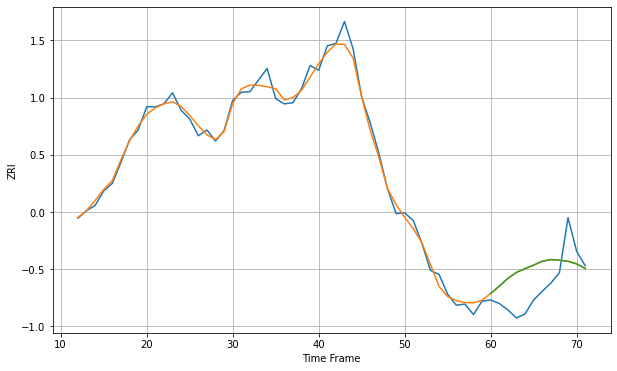

Wall time: 17.7 s
10021 12.003863171104214 50.60280777600924 50.641998399266605 [3128.19121918 3140.71331406 3154.12851739 3164.59544164 3170.90680753
 3177.13993637 3183.80505908 3186.69277724 3185.65453644 3183.74801986
 3179.11721212 3171.15283371]

Got an mse at 0.0025 in round 247 and stopped training

60 60 12


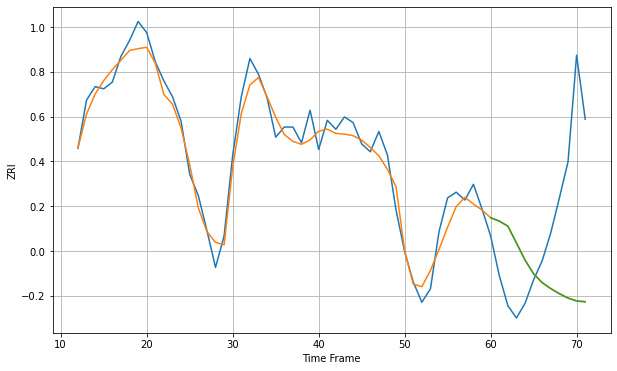

Wall time: 12.3 s
10022 12.914459068233768 96.87074008484548 96.9918243244111 [3968.27884603 3965.24919207 3960.79900832 3945.78856205 3930.47178527
 3918.18845076 3910.35163626 3905.03774423 3900.53844989 3896.65911583
 3894.08248878 3893.26916719]
60 60 12


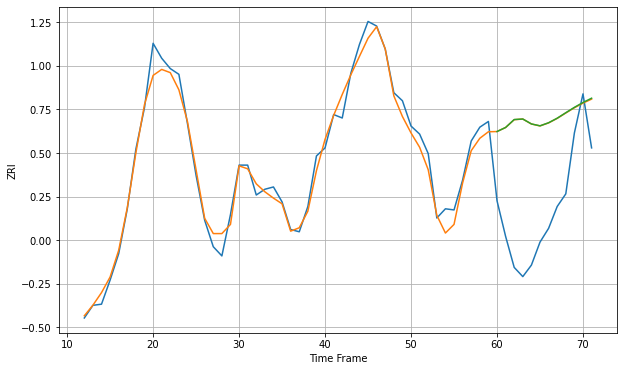

Wall time: 18.4 s
10023 9.6188640136165 88.88437181948727 88.9941058137447 [3575.2297137  3578.76709225 3585.66287081 3586.1198044  3581.84098647
 3580.18826252 3582.86621253 3586.82642076 3591.59715629 3596.26478438
 3600.506546   3604.22628657]
60 60 12


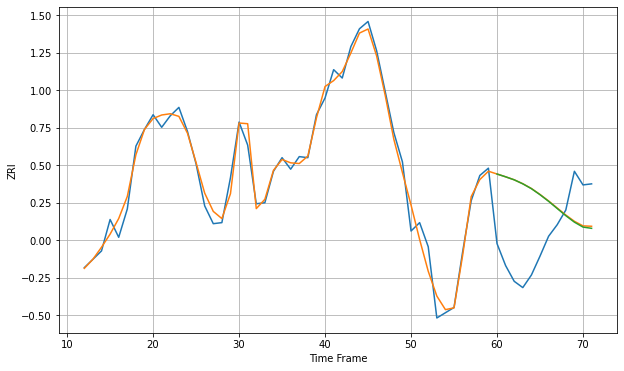

Wall time: 17.8 s
10024 9.714402843228685 63.21462408306156 63.35318627051764 [3444.40058288 3441.73328335 3438.83778418 3435.02345932 3430.4168062
 3424.6647015  3418.34706356 3411.49811026 3404.65182142 3398.459386
 3393.75254891 3392.56653308]
60 60 12


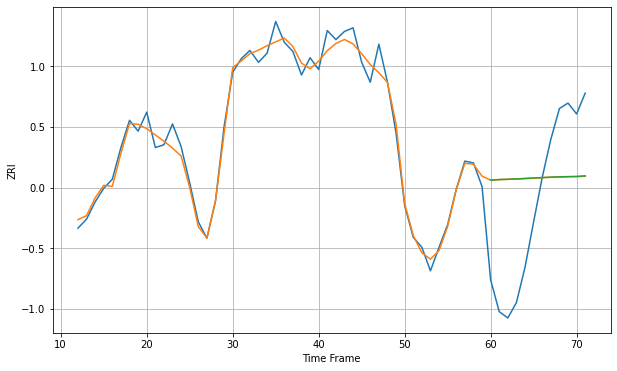

Wall time: 18 s
10025 11.053093433464111 97.64272200541714 97.58014541876817 [3619.01635015 3619.63868385 3619.93422989 3620.32495816 3620.80955714
 3621.29674524 3621.82406428 3622.28285455 3622.64654191 3622.90323609
 3623.10208938 3623.71126115]
60 60 12


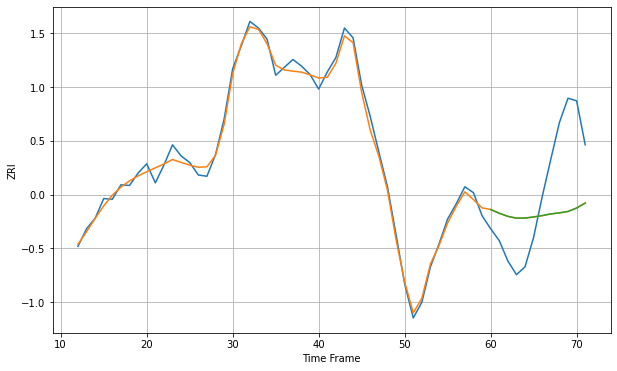

Wall time: 18.4 s
10027 9.806595327370928 96.7240166677678 96.73911801820311 [2989.34581103 2983.67206793 2978.92060673 2976.16034991 2976.30747407
 2978.0264027  2980.05973232 2982.6590107  2984.21830301 2986.35654931
 2991.56216823 2999.12958326]

Got an mse at 0.0025 in round 465 and stopped training

60 60 12


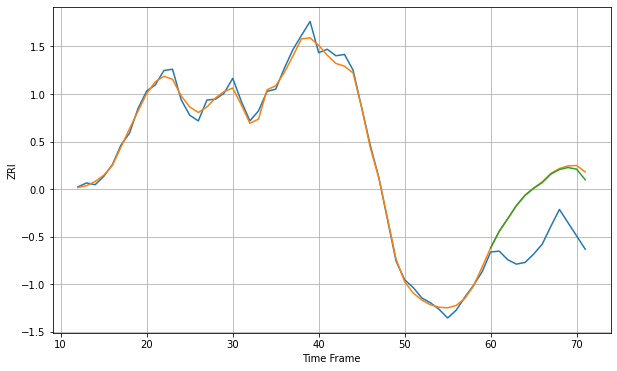

Wall time: 22.5 s
10028 12.620745015113348 127.80440565120702 124.03148610657189 [3058.49592582 3096.64841909 3125.9579288  3155.97490964 3179.38118932
 3195.54058928 3208.81424131 3228.3773717  3238.96950063 3243.54138845
 3239.79054553 3215.33429392]
60 60 12


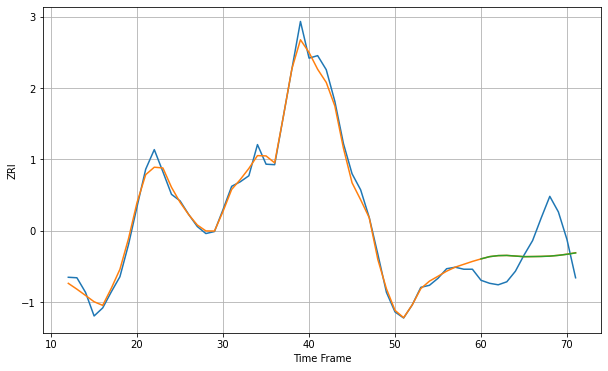

Wall time: 20.5 s
10029 13.71500871538325 60.154133719598725 60.189335017351105 [2809.54625926 2814.04876671 2816.08638216 2816.44900164 2815.20108071
 2813.98586636 2814.17743591 2814.42400667 2815.04379562 2816.56297411
 2818.73247373 2821.47238107]

Got an mse at 0.0025 in round 448 and stopped training

60 60 12


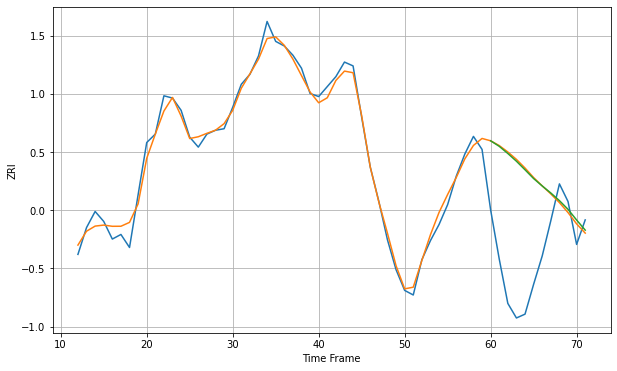

Wall time: 17.3 s
10031 10.797642045973902 122.17556708323453 121.05716172690553 [2795.24751625 2788.03471529 2778.68142883 2768.59485515 2757.40118714
 2745.96286698 2736.29942497 2727.11700452 2717.12849923 2705.80470708
 2691.85413393 2678.65221199]

Got an mse at 0.0025 in round 410 and stopped training

60 60 12


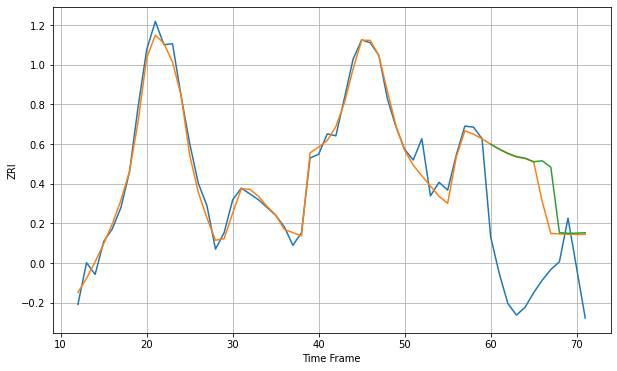

Wall time: 16.4 s
10036 10.154407672314298 106.32032737967704 113.57628990210374 [3581.30183824 3576.31236416 3571.89915886 3568.57574934 3566.96080038
 3563.19389446 3564.21491583 3557.59184934 3490.02934311 3489.38049403
 3489.54286272 3489.9767897 ]

Got an mse at 0.0025 in round 299 and stopped training

60 60 12


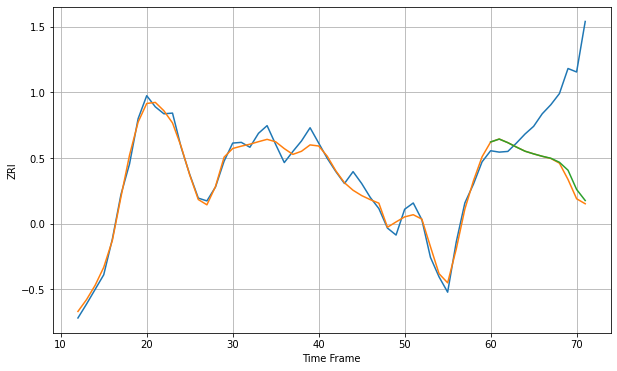

Wall time: 14.1 s
10038 10.604988378254712 111.58471133083793 107.2155561314318 [3902.54532012 3906.7432963  3901.56044656 3895.23320931 3889.30942609
 3885.49686746 3882.06776761 3879.21750926 3873.42890055 3862.03276129
 3834.43382252 3818.54333741]

Got an mse at 0.0025 in round 264 and stopped training

60 60 12


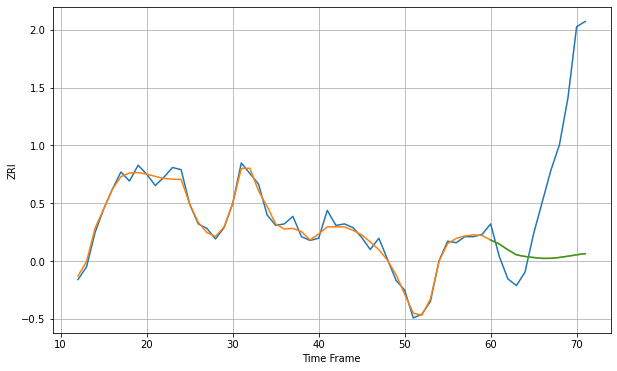

Wall time: 12.4 s
10065 7.503149663470402 152.3456970085647 152.31312295662346 [3950.56638603 3945.3090227  3937.67996308 3930.93614664 3928.71005711
 3927.35121077 3926.22897488 3926.24157298 3927.43246387 3929.09857278
 3930.99337017 3932.49150573]

Got an mse at 0.0025 in round 458 and stopped training

60 60 12


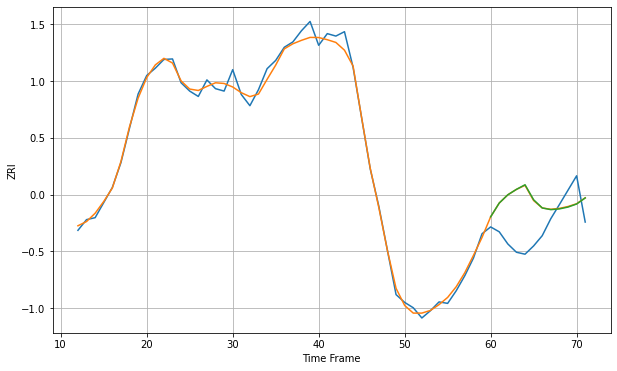

Wall time: 18.3 s
10075 12.724536445668038 76.39441091248426 76.81470209204377 [3089.70220041 3118.0422054  3134.98904903 3146.14079379 3155.61907256
 3124.79945361 3107.98741941 3104.52188261 3106.01375732 3109.80404425
 3116.07620655 3128.57615965]

Got an mse at 0.0025 in round 377 and stopped training

60 60 12


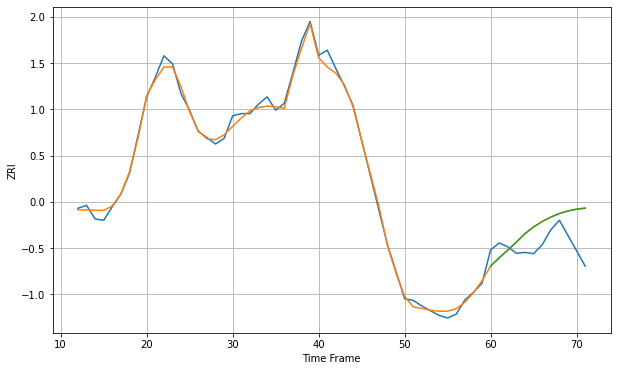

Wall time: 17.1 s
10128 11.97781207539469 60.64743063062606 60.829861088383176 [2881.34587508 2900.55011463 2918.39893284 2937.14953614 2956.98220902
 2972.46503923 2985.07033325 2995.44461239 3003.89243617 3009.75487301
 3014.12607818 3016.58030904]

Got an mse at 0.0025 in round 271 and stopped training

60 60 12


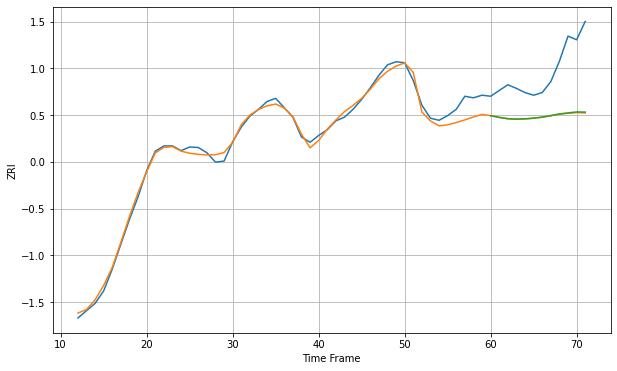

Wall time: 13 s
10302 13.172516694687424 93.44584860108301 92.80705496409863 [1829.80933399 1826.591882   1824.0221138  1823.20876636 1823.79312199
 1825.11084728 1827.19073408 1830.09226793 1833.25199605 1835.17371194
 1836.96756317 1836.67621004]

Got an mse at 0.0025 in round 166 and stopped training

60 60 12


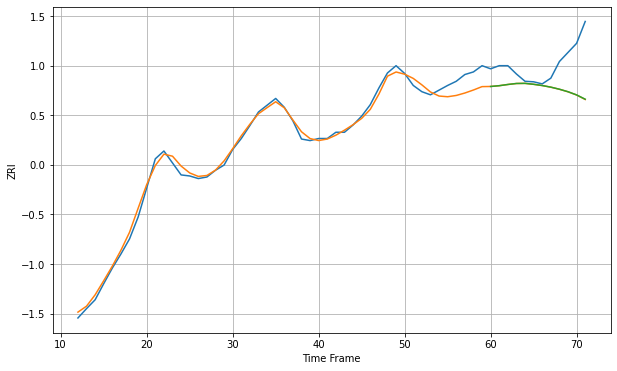

Wall time: 9.51 s
10303 13.104544090588663 61.624391845146846 61.46863927783247 [2031.02359817 2032.52636814 2034.86133721 2036.79520295 2037.01755018
 2035.21312896 2032.86767789 2029.73735941 2025.75083672 2020.91581316
 2014.78704573 2006.56622759]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


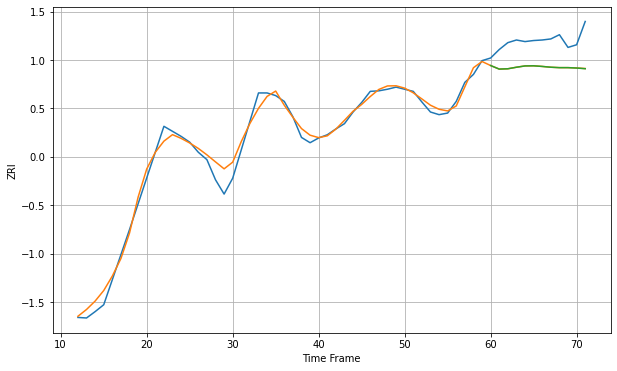

Wall time: 9.99 s
10304 14.341756215442784 51.26393793824201 51.329900771225205 [1918.74764966 1912.05545705 1912.6536847  1915.5560859  1918.0132604
 1918.24265611 1917.05883321 1915.57797765 1914.78816441 1914.78702364
 1914.04096439 1912.77543447]

Got an mse at 0.0024 in round 103 and stopped training

60 60 12


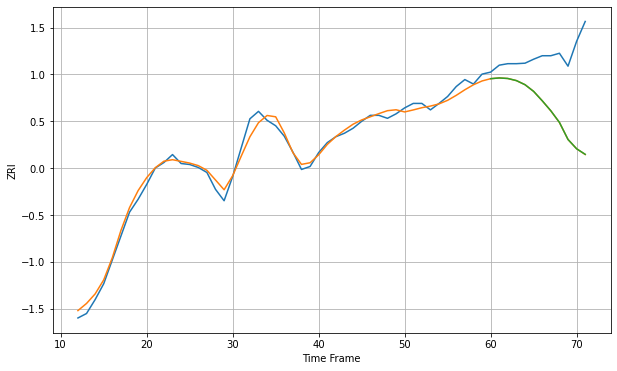

Wall time: 8.3 s
10305 12.191626840340378 125.58109778657409 125.48427625771433 [1933.78334325 1935.26483405 1934.18102801 1929.90929191 1921.67793508
 1908.23767007 1889.37477586 1869.19185139 1845.84681571 1811.37977004
 1792.67169007 1781.50850406]

Got an mse at 0.0025 in round 396 and stopped training

60 60 12


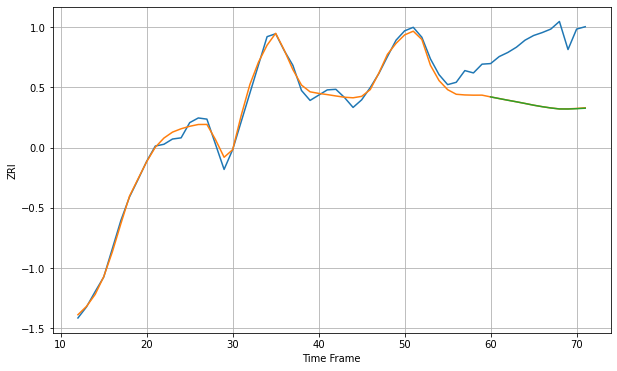

Wall time: 15.3 s
10306 14.185234831286596 113.36054047666286 113.51552362735708 [1857.00997828 1854.15045234 1851.33246143 1848.64025865 1845.79475166
 1842.82581545 1840.27670952 1838.08363938 1836.38191758 1836.31001418
 1836.87190523 1837.70147065]

Got an mse at 0.0025 in round 181 and stopped training

60 60 12


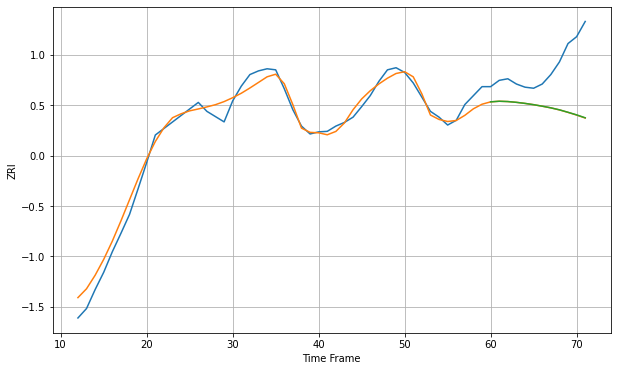

Wall time: 10.4 s
10310 17.235310108838682 88.81829537201929 88.63858377084021 [1908.10447664 1909.24251214 1908.65865753 1907.16913928 1905.14176962
 1902.72459236 1899.85618196 1896.72683417 1892.92345919 1888.24879779
 1883.31627391 1877.78790305]

Got an mse at 0.0025 in round 259 and stopped training

60 60 12


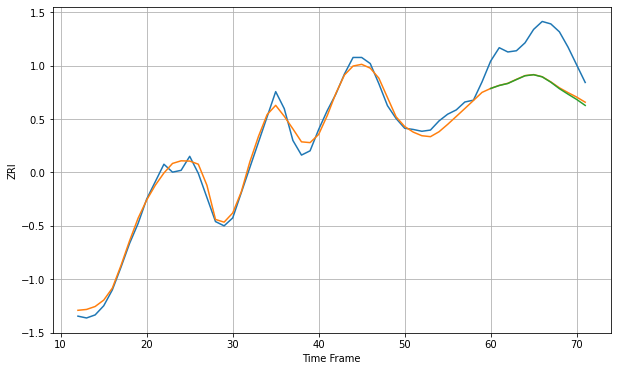

Wall time: 12.2 s
10312 11.304607406837285 67.13950228872928 68.20925403101985 [1762.17026618 1767.04201135 1770.33669577 1776.77880248 1782.97662604
 1784.69587485 1781.20145611 1772.44261235 1761.8309475  1752.86199754
 1744.23345476 1734.39428429]

Got an mse at 0.0025 in round 372 and stopped training

60 60 12


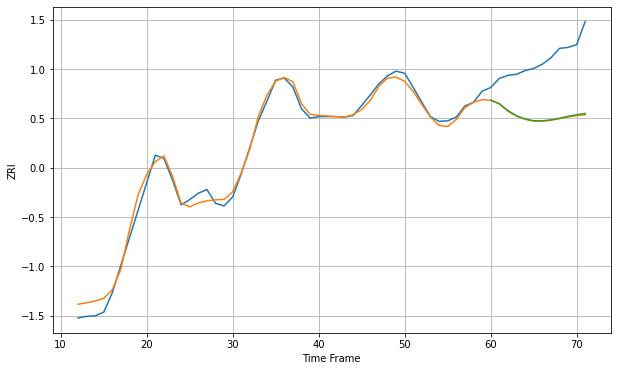

Wall time: 16.1 s
10314 12.317314074869552 108.7149375581127 107.64745376091362 [1836.0967334  1829.59045205 1816.47423361 1806.54641607 1800.49547447
 1797.20809242 1796.99354262 1798.84997586 1801.89309594 1805.50543484
 1808.42183201 1810.95818818]

Got an mse at 0.0025 in round 100 and stopped training

60 60 12


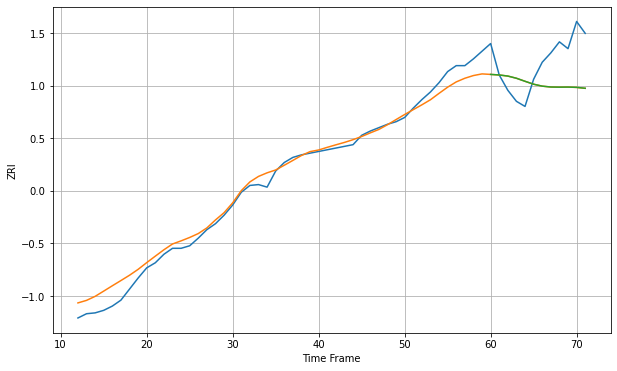

Wall time: 8.23 s
10453 11.330433435929649 41.59533808303205 41.56217161069008 [1650.67840039 1650.02767309 1648.74000262 1646.15691104 1642.58200567
 1639.14824435 1636.88244398 1635.84329632 1635.66964313 1635.78046247
 1635.43842846 1634.38763578]

Got an mse at 0.0025 in round 124 and stopped training

60 60 12


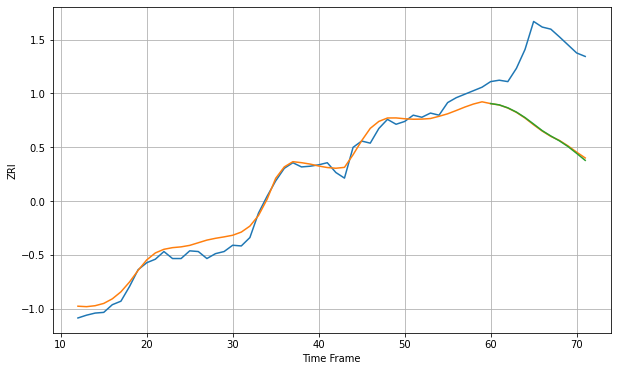

Wall time: 8.5 s
10455 12.37083147047512 118.5786577719847 118.94397181761849 [1859.55874791 1857.71216595 1853.47211843 1847.42121044 1839.55628955
 1830.30439543 1820.90087537 1813.25240363 1806.31179953 1798.13009491
 1788.43716394 1778.39698308]

Got an mse at 0.0025 in round 67 and stopped training

60 60 12


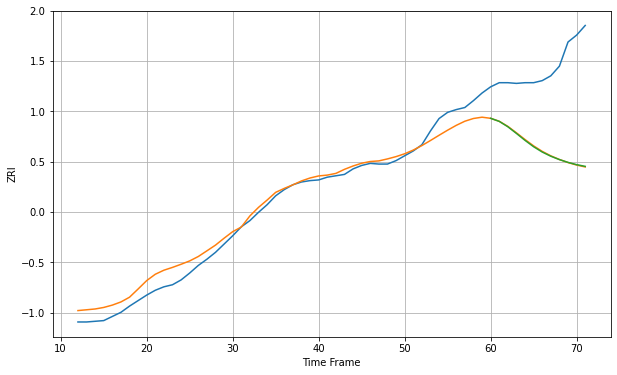

Wall time: 8.6 s
10456 14.781171063854906 122.48459290521522 122.61404568781894 [1742.35073674 1737.91366386 1730.12621799 1720.42349862 1710.36822956
 1701.12173645 1693.44338026 1687.358605   1682.4727198  1678.42291137
 1675.15493647 1672.66374612]

Got an mse at 0.0025 in round 105 and stopped training

60 60 12


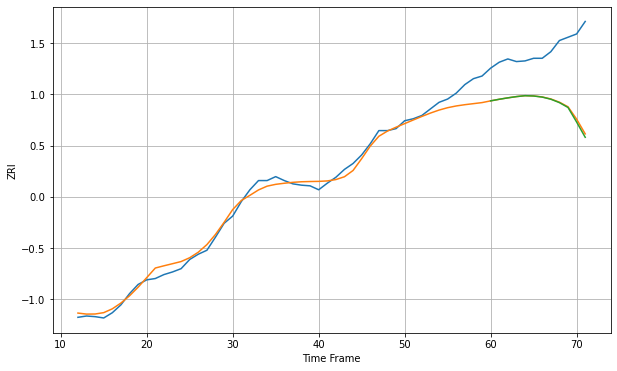

Wall time: 8.03 s
10457 12.101059569626932 87.89161598000257 89.49196884552852 [1814.22617952 1816.65559072 1818.80522341 1820.70942379 1822.08794699
 1821.63067253 1819.97798459 1816.74725877 1811.55473261 1804.14658327
 1782.02372983 1758.85366047]

Got an mse at 0.0025 in round 89 and stopped training

60 60 12


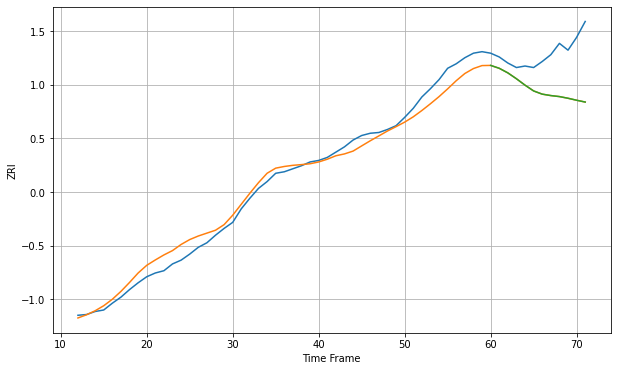

Wall time: 7.53 s
10458 12.802175037812495 53.71304956199364 53.70471745114629 [1740.82340828 1737.01285119 1730.93541326 1723.15480499 1714.67513491
 1707.00655542 1702.78293379 1700.89258711 1699.55104709 1697.34186184
 1694.70931593 1692.30895439]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


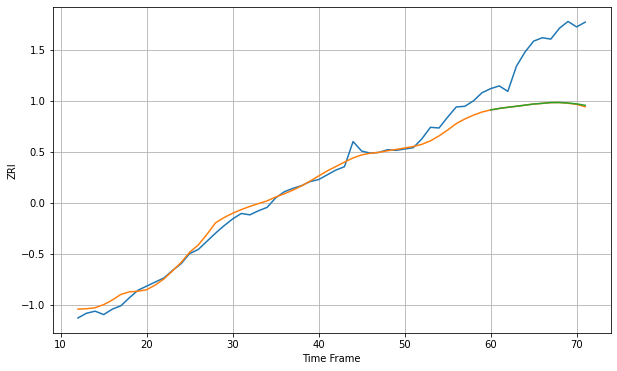

Wall time: 8.78 s
10459 11.16375702210831 88.52607637084971 88.15112352523074 [1798.62213373 1800.77706379 1802.53719606 1804.02618278 1805.66462421
 1807.31378428 1808.31020203 1809.49019672 1809.59409581 1808.80808028
 1807.56347893 1805.41558459]

Got an mse at 0.0025 in round 74 and stopped training

60 60 12


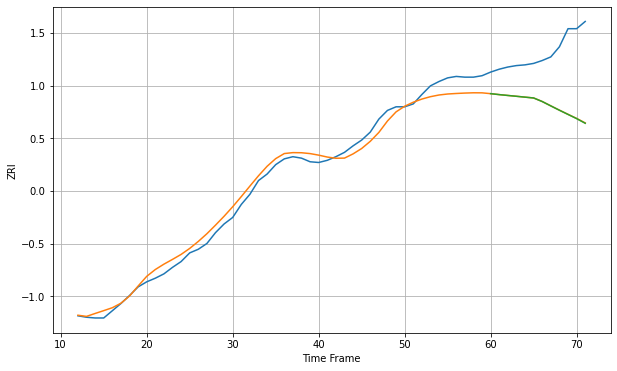

Wall time: 7.23 s
10460 11.806118484863033 78.69764071830744 78.84222876603036 [1779.16801361 1777.85520032 1776.68600863 1775.54466841 1774.35145882
 1773.21206972 1768.26754202 1762.22665205 1756.24523822 1750.44856899
 1744.67446152 1738.2205325 ]

Got an mse at 0.0025 in round 80 and stopped training

60 60 12


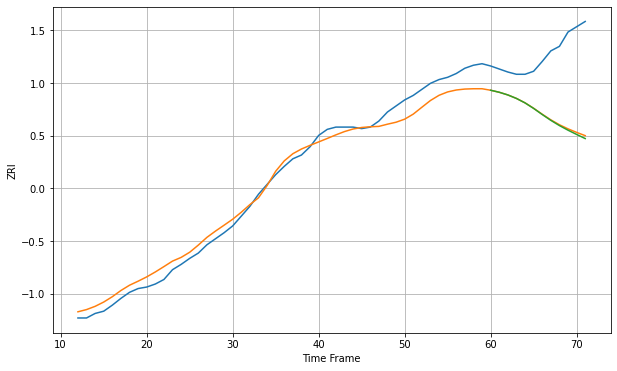

Wall time: 7.5 s
10461 14.578163294471812 86.9734451413259 88.33455440196109 [1802.85136216 1800.16199066 1796.62053355 1791.96578237 1786.05711689
 1778.74717611 1770.66707093 1762.94355901 1756.00148501 1749.89256369
 1744.26140661 1738.79449189]

Got an mse at 0.0025 in round 87 and stopped training

60 60 12


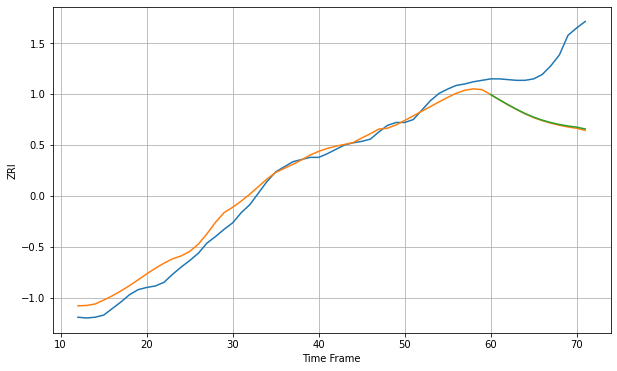

Wall time: 8.06 s
10462 12.914862501251829 84.70811656290165 83.75268423427441 [1788.43741633 1781.38362461 1774.61678286 1768.25457515 1762.37046582
 1757.34302473 1753.22831512 1749.93725899 1747.2399806  1745.15985832
 1743.62636213 1741.05845669]

Got an mse at 0.0025 in round 225 and stopped training

60 60 12


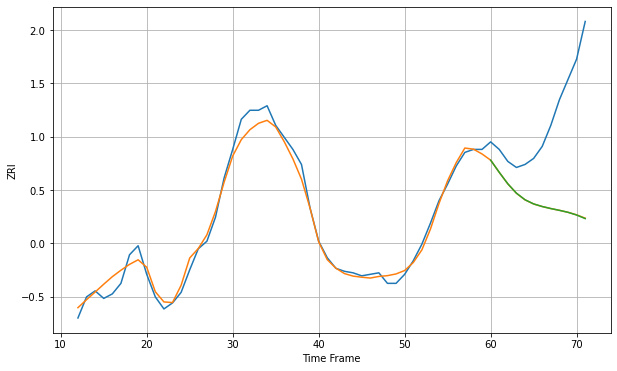

Wall time: 11.3 s
10463 5.576088834128922 63.25016630741457 63.30580269413569 [1787.85708637 1779.78106512 1772.13784376 1765.91898824 1761.53249432
 1758.78224505 1757.05549213 1755.70234592 1754.52200691 1753.20196273
 1751.41386792 1749.01561746]

Got an mse at 0.0025 in round 142 and stopped training

60 60 12


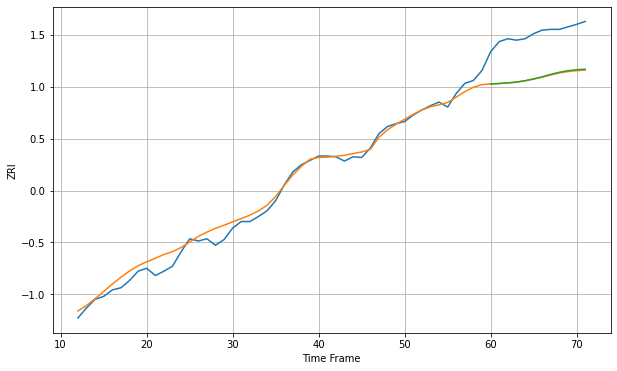

Wall time: 8.92 s
10465 9.858926617706599 60.87340057844377 60.30221104886531 [1885.15330452 1885.82116401 1886.64803276 1887.81731582 1889.68812109
 1892.21738596 1895.15000399 1898.47172242 1901.43401181 1903.58982311
 1904.96823381 1905.64799371]

Got an mse at 0.0025 in round 66 and stopped training

60 60 12


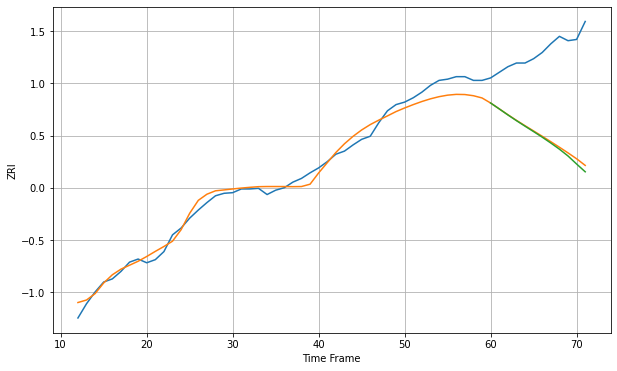

Wall time: 6.84 s
10466 13.796788288068623 142.0252005577674 145.73063252182519 [1852.51031726 1843.0325179  1833.40933901 1824.13255781 1815.20096431
 1806.4380434  1797.46132113 1788.03750403 1778.12679053 1767.1393236
 1754.1767535  1741.67572083]

Got an mse at 0.0025 in round 31 and stopped training

60 60 12


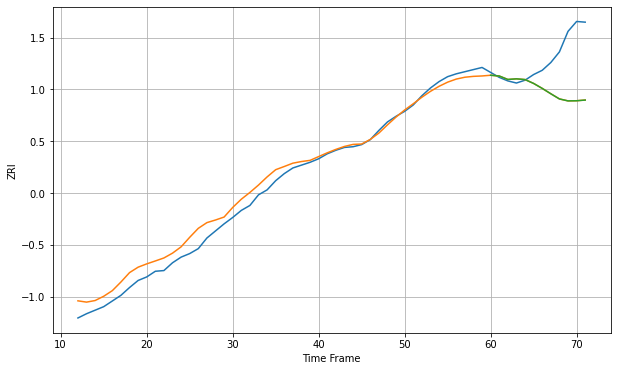

Wall time: 6.04 s
10467 13.175897759932498 58.83301063672503 58.85617230793366 [1784.99030738 1783.94069775 1779.04372391 1779.92641575 1778.90327942
 1773.41727336 1766.42386519 1758.82490842 1751.51583702 1748.74441347
 1748.9547952  1749.92595842]

Got an mse at 0.0025 in round 79 and stopped training

60 60 12


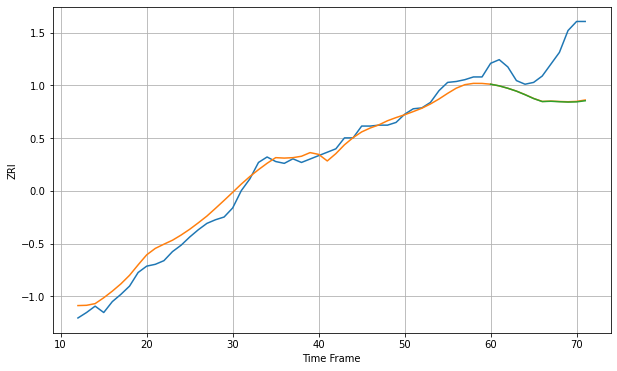

Wall time: 7.08 s
10468 9.212862302437593 49.26478989983554 49.56026367485577 [1538.01788288 1536.18929492 1533.53439279 1530.3903364  1526.49753859
 1522.25713492 1518.93442257 1519.26218048 1518.7730269  1518.37151209
 1518.59795841 1519.829499  ]

Got an mse at 0.0025 in round 59 and stopped training

60 60 12


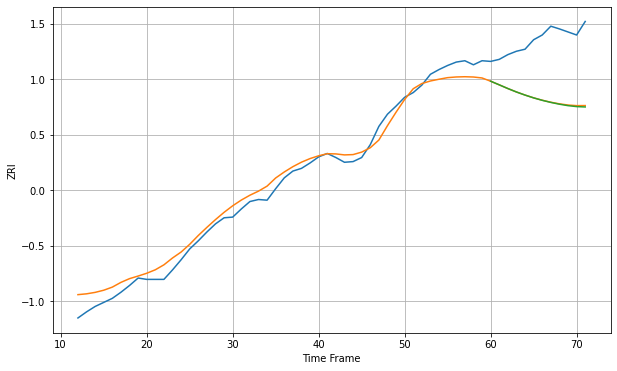

Wall time: 6.96 s
10469 14.525210689596175 87.76699057051457 88.36353539150257 [1870.74551864 1865.38602235 1859.92296793 1854.8398385  1850.26363037
 1846.11962663 1842.52109877 1839.41614216 1836.77578077 1834.64630708
 1833.24413131 1832.71236174]

Got an mse at 0.0025 in round 126 and stopped training

60 60 12


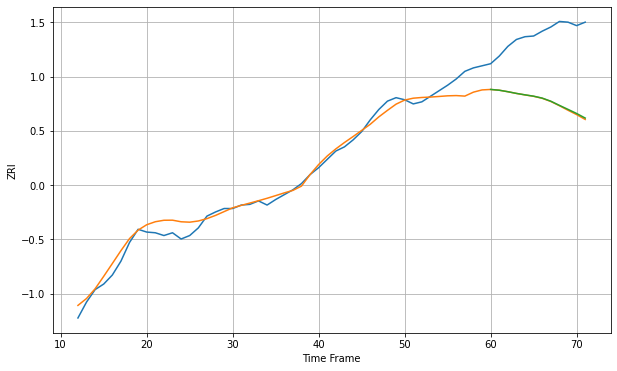

Wall time: 8.65 s
10470 13.49570151435152 98.71456420254746 98.01890541823296 [1836.8754899  1835.76038882 1833.61587144 1831.15886056 1829.08455622
 1827.16424545 1824.37715169 1819.90090633 1813.88155493 1808.10872514
 1802.16446891 1795.57532521]

Got an mse at 0.0025 in round 115 and stopped training

60 60 12


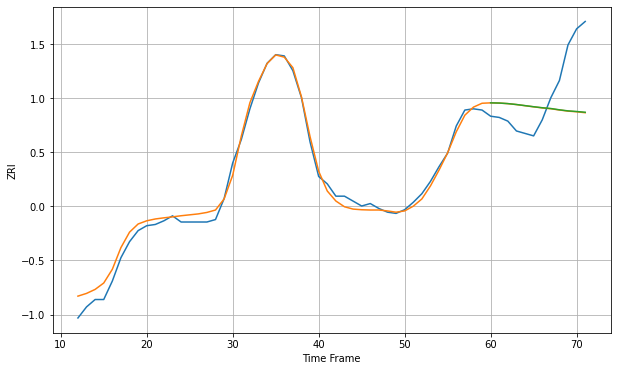

Wall time: 8.38 s
10471 5.958319743068648 36.14491122956241 36.02358684667891 [1860.85130394 1860.69120383 1860.23829846 1859.4973902  1858.59954076
 1857.70018022 1856.87972881 1856.2402606  1855.19422568 1854.32140295
 1853.82735175 1853.20276067]

Got an mse at 0.0025 in round 83 and stopped training

60 60 12


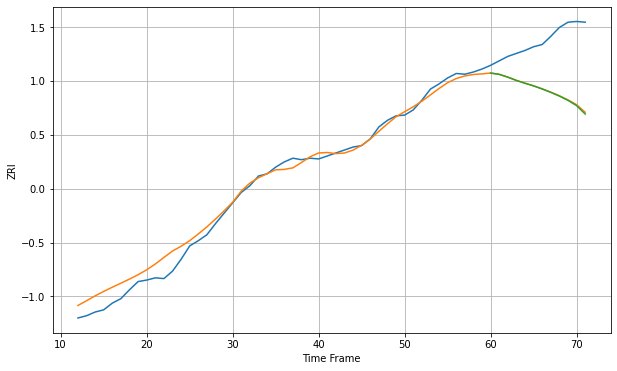

Wall time: 10.2 s
10472 11.57555387300597 72.49551825418334 73.17912217579442 [1816.56743258 1814.86965014 1811.04695843 1806.61595301 1802.8558514
 1799.25770018 1795.1161607  1790.58275228 1785.57395602 1779.79208815
 1772.7277029  1761.41478855]

Got an mse at 0.0025 in round 207 and stopped training

60 60 12


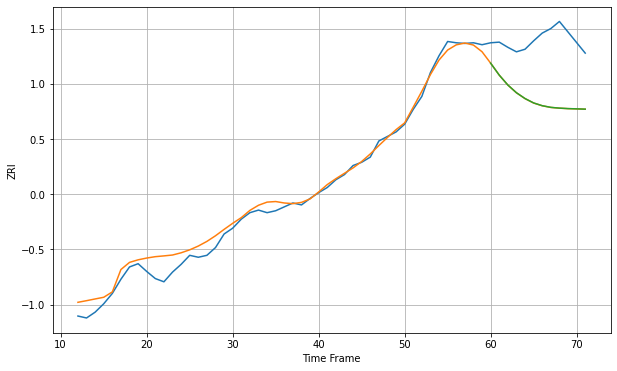

Wall time: 11 s
10473 13.441932827236403 93.03481506360627 92.94708625826216 [2006.45382582 1987.96785812 1972.66470593 1960.70363643 1951.68383317
 1944.88479321 1940.61974394 1938.04337628 1936.85878956 1936.12215042
 1935.72229594 1935.28015592]

Got an mse at 0.0025 in round 384 and stopped training

60 60 12


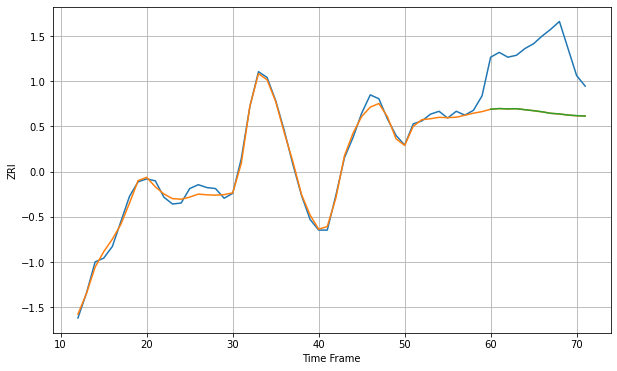

Wall time: 15.6 s
10528 5.213967836578416 65.47615560639017 65.44126762162426 [2473.11783539 2473.82158833 2473.46921117 2473.69034576 2472.63259626
 2471.61467474 2470.44796028 2468.90488826 2468.26247537 2467.11987472
 2466.46641152 2466.06331082]

Got an mse at 0.0025 in round 293 and stopped training

60 60 12


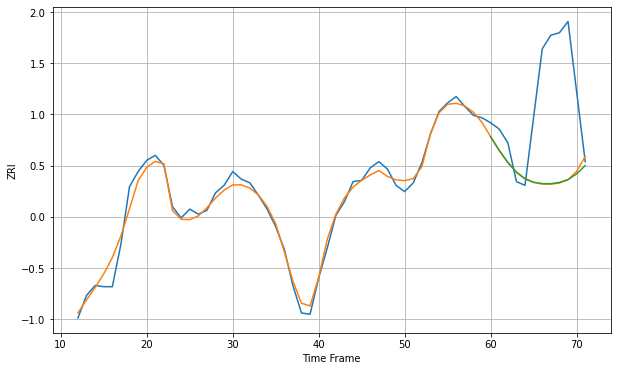

Wall time: 13.1 s
10543 6.307236955136907 72.92783395816126 72.89244967681641 [2417.83813727 2406.92385132 2397.35325637 2389.59516431 2384.29274184
 2381.462191   2380.3590463  2380.32929238 2381.36652692 2383.58916555
 2388.17022298 2394.78494664]

Got an mse at 0.0025 in round 234 and stopped training

60 60 12


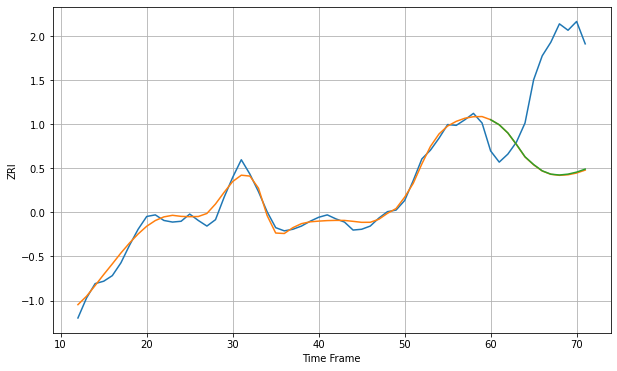

Wall time: 11.5 s
10562 7.727398387483708 127.52887459467287 127.03887563703879 [2115.08568057 2108.75012367 2098.58607856 2084.18018663 2068.65914877
 2058.99157857 2051.11393838 2046.94815268 2045.88175959 2046.98331671
 2049.49165138 2053.29799325]

Got an mse at 0.0025 in round 312 and stopped training

60 60 12


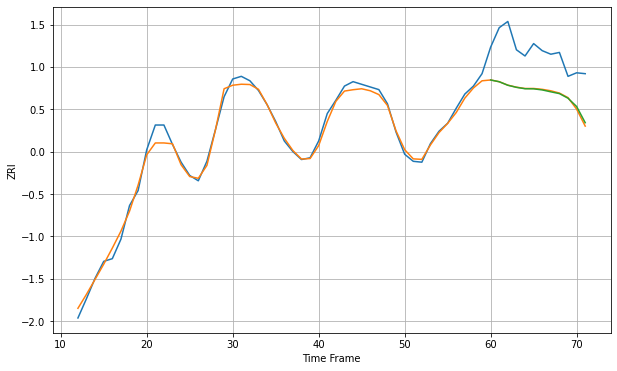

Wall time: 13.6 s
10573 6.5536218893967915 47.852035885995065 47.56651831794097 [2254.89695587 2252.88509922 2248.92597144 2246.57059718 2245.00176532
 2244.89121502 2243.64525947 2241.51044432 2239.49318732 2234.27626589
 2224.92116083 2206.62428407]

Got an mse at 0.0025 in round 102 and stopped training

60 60 12


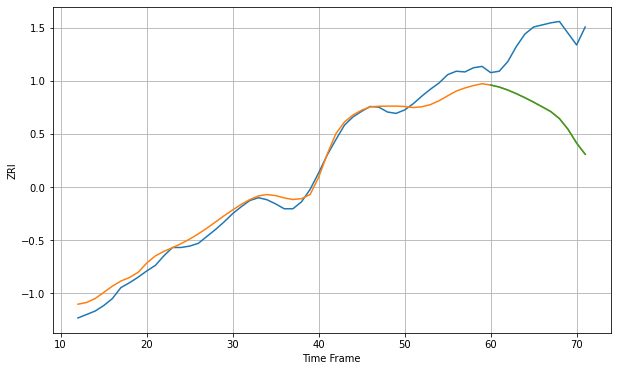

Wall time: 8.38 s
10701 13.735153647891845 112.24942585071128 112.2978207261848 [2019.06701075 2016.14580857 2011.76824874 2006.47115372 2000.5919349
 1994.20746135 1987.45364268 1980.53658917 1970.38605721 1955.03385456
 1935.10420746 1918.77188031]

Got an mse at 0.0024 in round 95 and stopped training

60 60 12


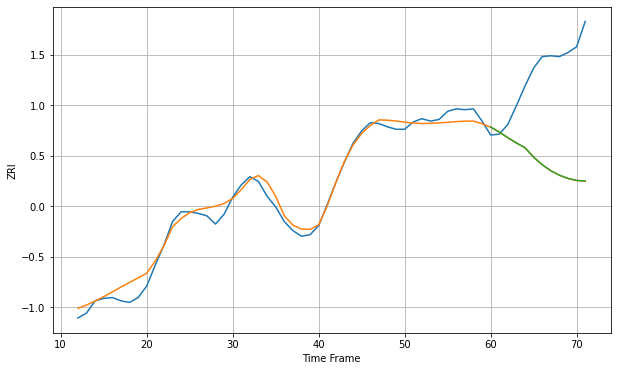

Wall time: 8.04 s
10703 10.11147893103804 118.08337315148208 118.03232747868952 [2113.77639999 2107.64943034 2100.72925467 2094.2541956  2088.40115018
 2076.85447032 2067.61424884 2060.28783139 2054.7921145  2050.89426722
 2048.435438   2047.60695092]

Got an mse at 0.0025 in round 305 and stopped training

60 60 12


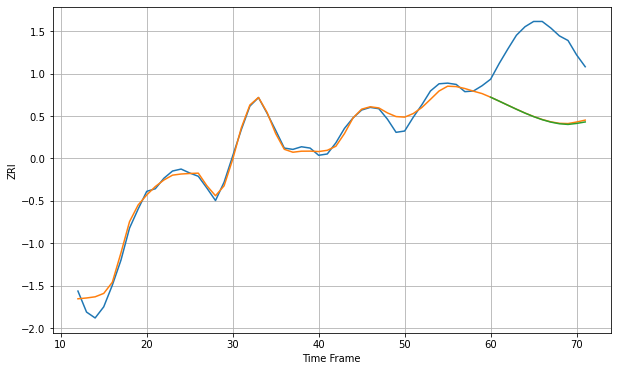

Wall time: 13.7 s
10704 9.744030962015989 114.0351796948172 114.67962813862299 [2168.52716321 2162.49403884 2156.31627456 2150.18350696 2144.29866856
 2138.93730556 2134.28262548 2130.57520129 2128.0648433  2127.02459658
 2128.5590127  2130.81324314]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


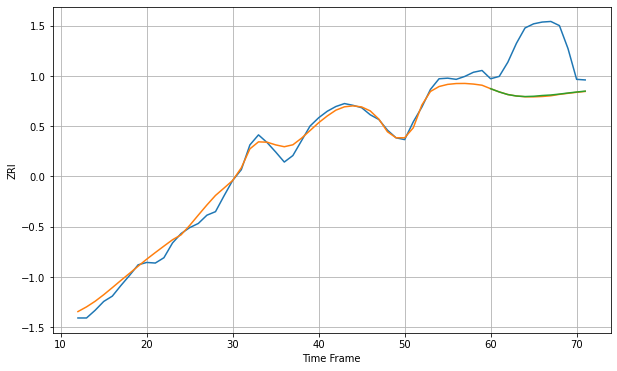

Wall time: 12 s
10705 11.76903774371948 87.85307891928471 87.24148553309816 [1974.16088865 1968.68587919 1964.24289131 1961.81799078 1960.86587386
 1961.35286625 1962.63256574 1963.51073139 1965.04606004 1966.85388117
 1968.5366656  1970.0807039 ]

Got an mse at 0.0024 in round 339 and stopped training

60 60 12


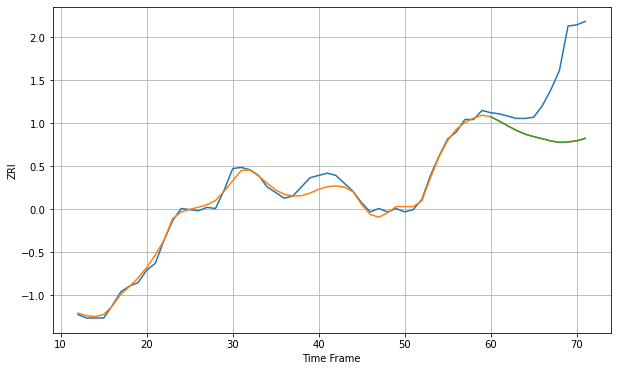

Wall time: 20 s
10940 4.757270474249052 56.75146715409467 56.82009094822514 [1429.4996346  1425.67407188 1421.41667683 1417.47608153 1414.19214851
 1412.00144695 1410.17626778 1408.20036309 1406.97160045 1407.31116619
 1408.25237881 1410.42135924]

Got an mse at 0.0024 in round 112 and stopped training

60 60 12


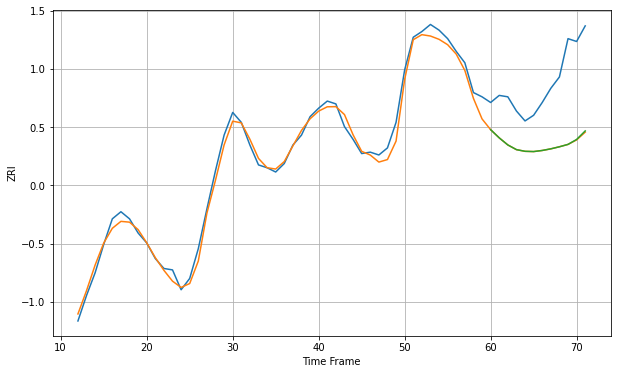

Wall time: 10.4 s
10960 5.35289956787781 46.22371931417951 46.058065717481966 [1834.83710908 1829.06499536 1824.08138073 1820.78302771 1819.6001885
 1819.41772485 1820.18789439 1821.33614678 1822.7826603  1824.47340756
 1827.94790674 1833.96643246]

Got an mse at 0.0025 in round 313 and stopped training

60 60 12


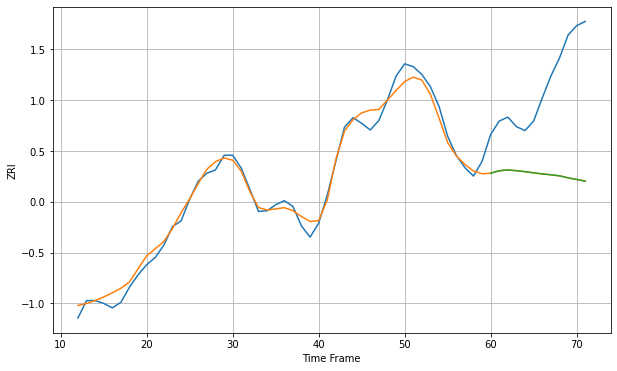

Wall time: 13.7 s
10977 14.698889133453081 172.05585305112535 172.11049446619745 [2038.02897824 2042.42588065 2043.81832122 2042.54368996 2040.72849729
 2038.69974182 2036.78170174 2035.28014221 2033.31888912 2029.80071782
 2026.77825367 2023.88483325]

Got an mse at 0.0025 in round 156 and stopped training

60 60 12


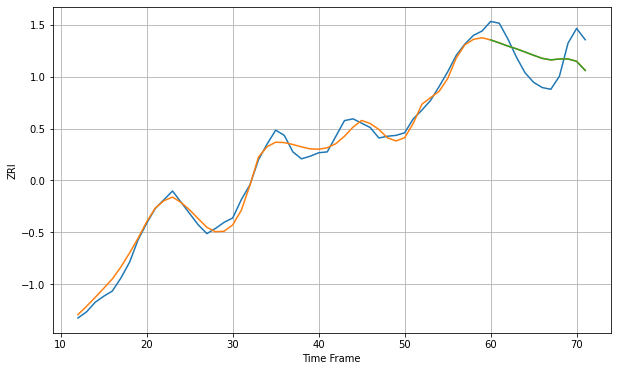

Wall time: 9.92 s
11001 7.577728088266767 26.332260327682423 26.349126730433525 [2179.78259595 2176.36557146 2172.70950164 2169.54955513 2165.85243891
 2162.09927697 2158.5668868  2156.79428959 2157.83309088 2157.88003717
 2155.10103259 2144.70147664]

Got an mse at 0.0025 in round 349 and stopped training

60 60 12


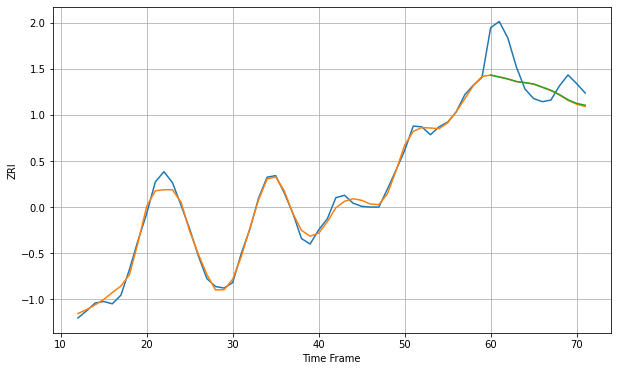

Wall time: 14.7 s
11003 6.776166628919383 34.99443041742717 34.823278617993545 [2224.82914976 2222.41975244 2219.88272228 2216.6089217  2215.23285221
 2213.48547038 2209.53249096 2205.53365405 2200.05698369 2193.47697938
 2188.8507205  2186.52715372]

Got an mse at 0.0025 in round 311 and stopped training

60 60 12


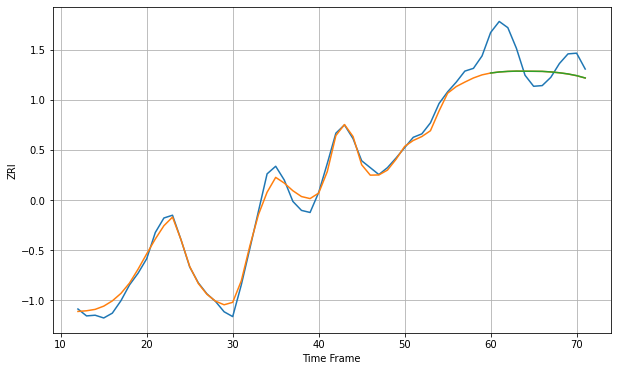

Wall time: 13.1 s
11010 10.879288043117054 37.85123966270919 37.83227864517507 [2374.22796255 2375.76019324 2376.60213551 2376.98440775 2376.82822804
 2376.7659196  2376.62215388 2375.83491904 2374.60222059 2372.90294472
 2370.45176722 2367.04136603]

Got an mse at 0.0025 in round 182 and stopped training

60 60 12


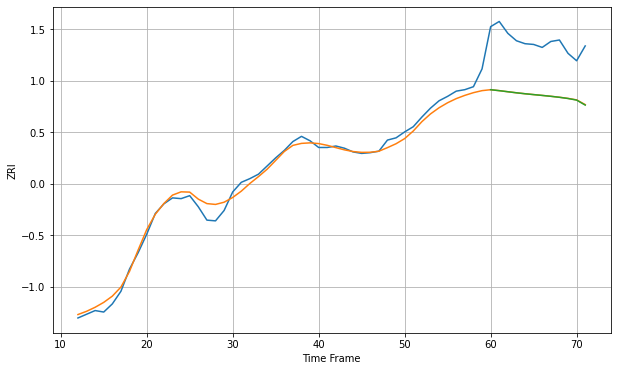

Wall time: 10.6 s
11050 8.965088808571855 73.36030570259663 73.46617055523636 [2574.94031529 2573.65816715 2572.19990467 2570.76630993 2569.48572612
 2568.33339841 2567.22236945 2566.03238109 2564.69776968 2563.07699222
 2560.93433803 2554.18924733]
60 60 12


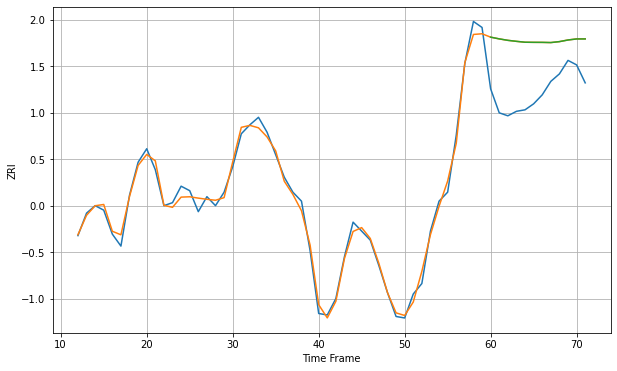

Wall time: 18.2 s
11101 4.257272274142521 36.275081019716666 36.2705043350645 [2522.5204755  2521.37088444 2520.40010439 2519.73134998 2519.14013672
 2519.07012224 2519.04249543 2518.91537703 2519.54343824 2520.62579628
 2521.32067128 2521.32062274]

Got an mse at 0.0025 in round 420 and stopped training

60 60 12


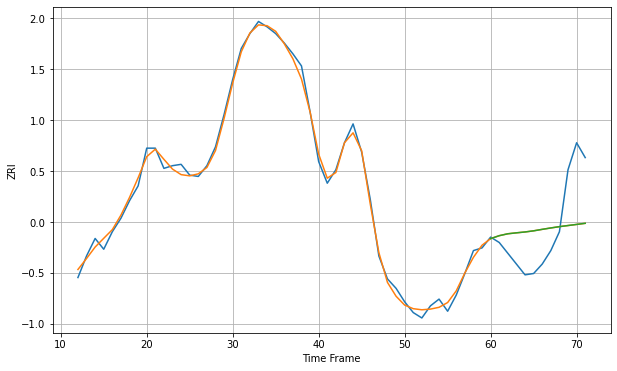

Wall time: 18.8 s
11102 4.152166845111462 30.976121678510754 30.97011711063054 [2186.87344711 2189.05912725 2190.47527457 2191.17458316 2191.81385932
 2192.65987604 2193.75666385 2194.79458524 2195.76032897 2196.59017109
 2197.41408862 2198.24736731]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


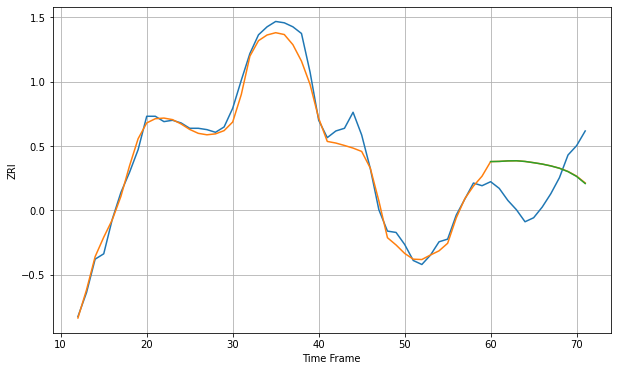

Wall time: 11.6 s
11103 7.802848364715478 29.3080186087208 29.374378535248482 [2169.06112358 2169.19485647 2169.57582047 2169.68628055 2169.16477931
 2168.23962759 2167.20282828 2165.82346032 2164.06660915 2161.54977833
 2157.93099487 2152.62182636]

Got an mse at 0.0025 in round 412 and stopped training

60 60 12


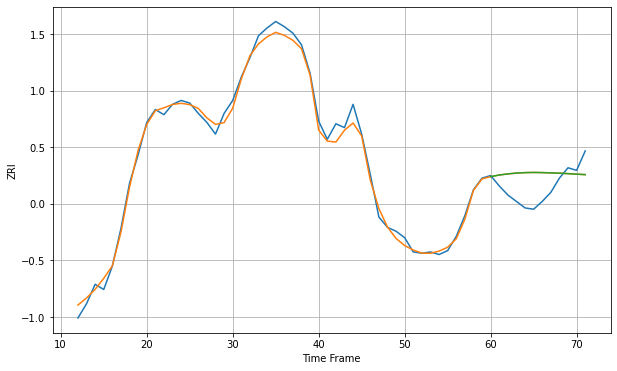

Wall time: 16.3 s
11104 5.237159198957341 16.99565154184987 16.998044424011063 [2103.16192151 2104.40294314 2105.28016921 2105.89895734 2106.27084363
 2106.39123031 2106.28427679 2106.06976941 2105.82451136 2105.48385973
 2105.06453368 2104.71900128]

Got an mse at 0.0025 in round 261 and stopped training

60 60 12


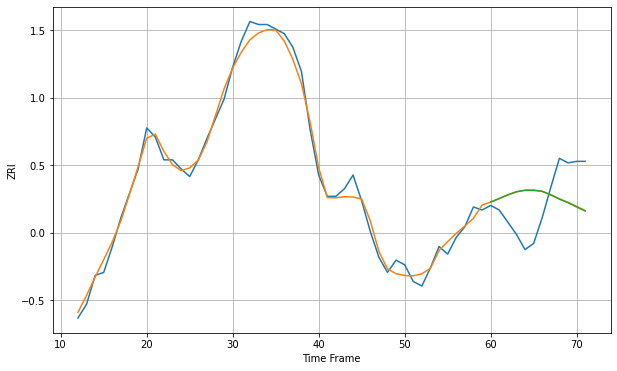

Wall time: 12.2 s
11105 5.4346348961336375 25.07429029312144 25.17549731844351 [2189.21126151 2191.56536266 2193.96915375 2195.9803852  2197.03302606
 2197.03714799 2196.2492799  2193.91466925 2191.218353   2188.84534183
 2186.07815132 2183.34216397]

Got an mse at 0.0025 in round 427 and stopped training

60 60 12


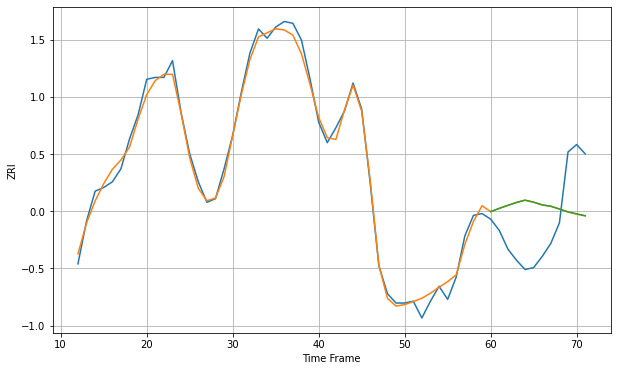

Wall time: 17.1 s
11106 4.125996507952583 27.402739466617696 27.387790674207032 [2137.99287614 2139.76570011 2141.37739478 2142.93978188 2144.18589815
 2143.10153358 2141.63509537 2140.93274216 2139.433909   2137.92117804
 2136.81637513 2135.83242065]
60 60 12


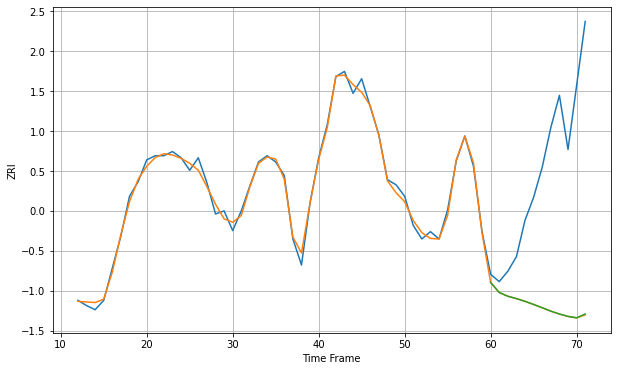

Wall time: 18.4 s
11201 5.106444717047352 149.37947184642522 149.2162427219351 [2831.20728233 2821.56378647 2817.9379225  2815.68200486 2813.04434709
 2810.03014318 2806.90068133 2803.62978715 2800.85776904 2798.61079828
 2797.27143862 2800.82730787]
60 60 12


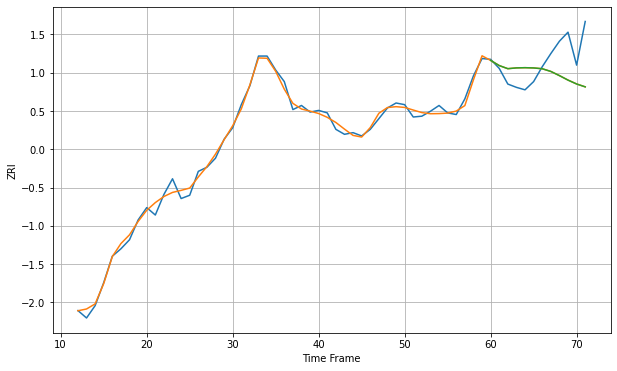

Wall time: 18.8 s
11203 6.020479843340773 34.56884082560041 34.58274799953165 [2155.69539009 2149.45322079 2145.67163586 2146.62657292 2146.89186708
 2146.57698258 2145.6074096  2142.33374622 2137.26651253 2131.79886053
 2127.08620286 2123.60285133]

Got an mse at 0.0025 in round 281 and stopped training

60 60 12


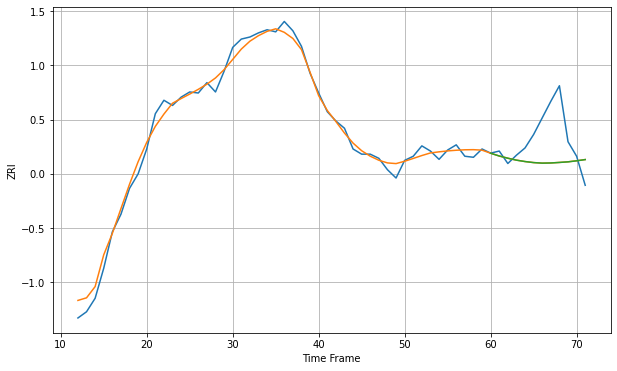

Wall time: 12.8 s
11204 7.287588493126529 32.78880564197775 32.79617484404549 [1997.90450493 1995.23500739 1993.09821081 1991.2336025  1989.88840014
 1988.87671741 1988.35287215 1988.51287916 1989.00826507 1989.59073767
 1990.57683799 1991.763036  ]
60 60 12


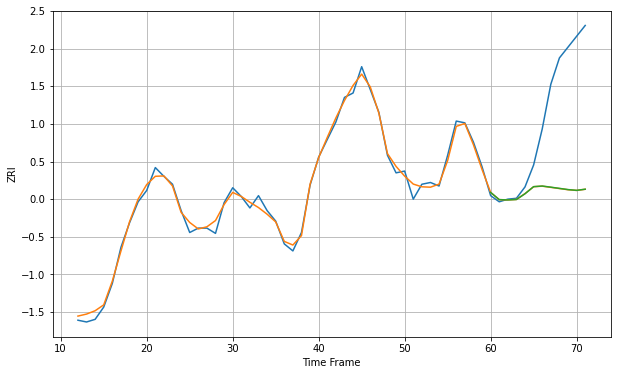

Wall time: 21.6 s
11205 6.123121554520709 105.31863252734819 105.22510331303 [2788.68366555 2780.45676115 2780.11547568 2780.60601747 2787.18157025
 2795.25518215 2795.96979549 2794.67488013 2793.288739   2791.91942259
 2791.04415695 2792.34146365]

Got an mse at 0.0024 in round 328 and stopped training

60 60 12


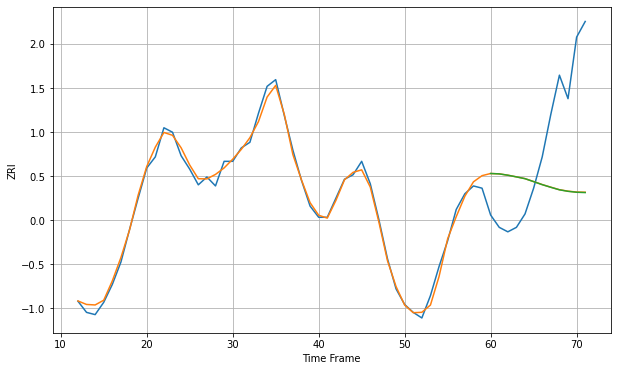

Wall time: 14.2 s
11206 4.960919573117047 78.47838631112997 78.58516385090822 [2579.12111703 2578.78301998 2577.59156799 2576.09791492 2574.49472911
 2571.86846245 2569.15842724 2566.79718485 2564.54847291 2563.19061931
 2562.36209831 2562.08182466]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


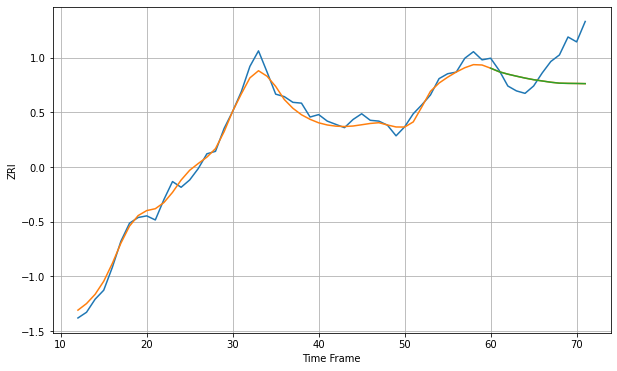

Wall time: 11.9 s
11207 8.449727605989729 34.92822985246685 34.929971399321666 [2249.78219886 2245.43661015 2242.49818566 2240.03355791 2237.71235362
 2235.70000969 2234.15720817 2232.59970918 2231.46070303 2231.19941658
 2231.0979368  2230.89269175]

Got an mse at 0.0025 in round 340 and stopped training

60 60 12


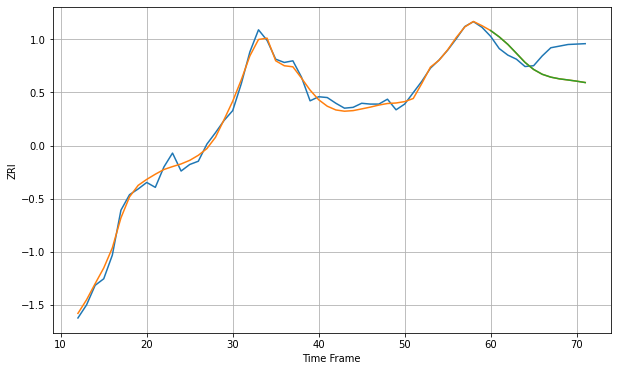

Wall time: 14 s
11208 6.851360231125258 29.08639470726497 29.081746003978186 [2259.06288407 2251.33153976 2242.15282719 2231.18378161 2220.07843261
 2211.44275074 2205.52404003 2202.01175407 2199.91963807 2198.55497372
 2197.09102661 2195.39398927]

Got an mse at 0.0024 in round 220 and stopped training

60 60 12


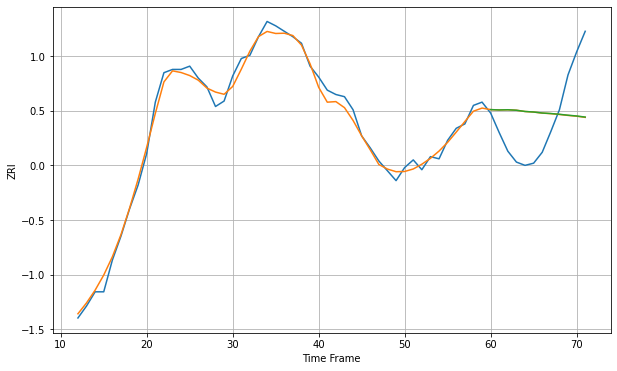

Wall time: 11.4 s
11209 6.347954550925547 42.28540623609424 42.22351129288414 [2085.14009683 2084.82903802 2084.99352996 2084.55948359 2083.43755333
 2082.9418011  2082.01920739 2081.54882407 2080.8459346  2079.99885525
 2079.30122052 2078.29778842]

Got an mse at 0.0025 in round 120 and stopped training

60 60 12


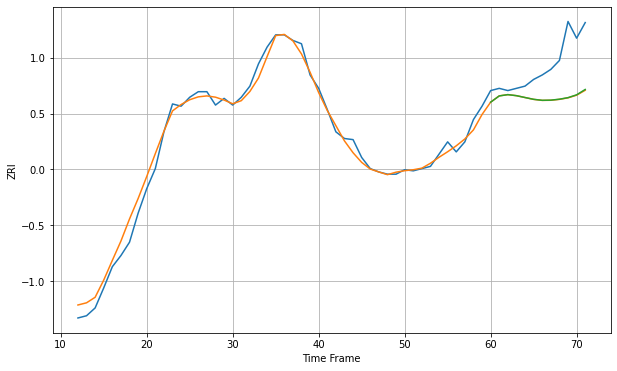

Wall time: 8.83 s
11210 7.215475181737982 34.32493534291071 34.119553010589264 [1949.5821177  1955.20557464 1956.35518616 1955.43016784 1953.78048352
 1952.15949425 1951.26939752 1951.41490418 1952.25564561 1953.66910256
 1956.20083343 1960.98828507]
60 60 12


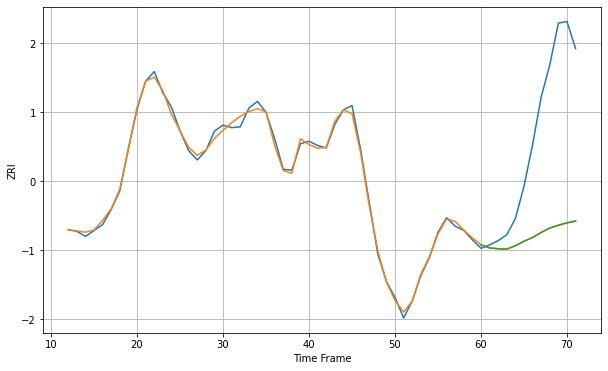

Wall time: 18.3 s
11211 4.553632912182876 139.68407009286256 139.52772373803086 [2710.05472171 2706.44791076 2705.49387804 2705.02794713 2709.02232191
 2714.3134704  2718.73655889 2724.67555905 2729.86107356 2733.20540234
 2736.11462306 2738.26781789]

Got an mse at 0.0025 in round 323 and stopped training

60 60 12


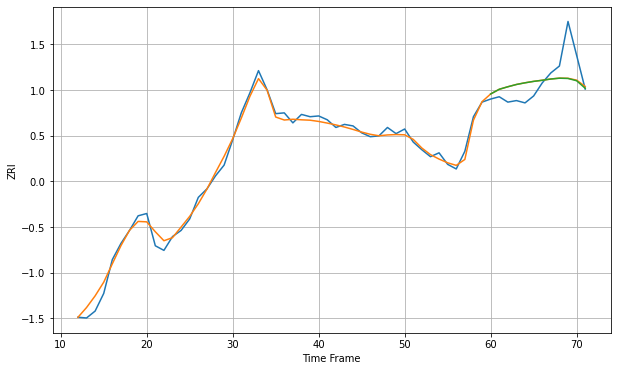

Wall time: 15.1 s
11212 7.421432138341823 27.20024332455055 27.317174556335303 [2165.58809118 2171.71072928 2174.99506359 2177.96229472 2180.14277671
 2181.9918348  2183.42638257 2185.06082348 2186.13061128 2185.79543912
 2182.83804158 2173.01966119]

Got an mse at 0.0025 in round 469 and stopped training

60 60 12


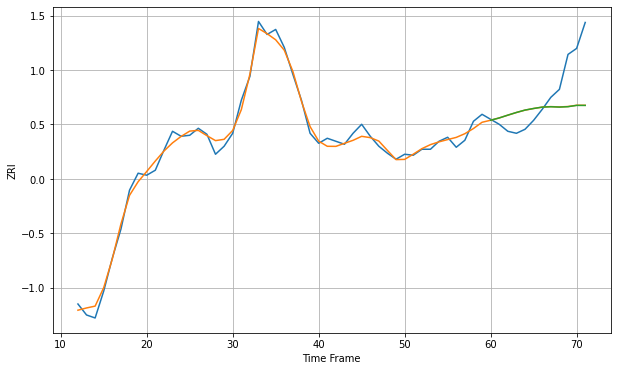

Wall time: 18.8 s
11213 6.158188878699739 34.75285515139751 34.83342094052649 [2303.0733911  2305.36606838 2308.16550344 2310.86362598 2313.25320636
 2314.85480405 2316.21522983 2316.57722051 2316.23158106 2316.63576789
 2317.93250741 2317.91534333]
60 60 12


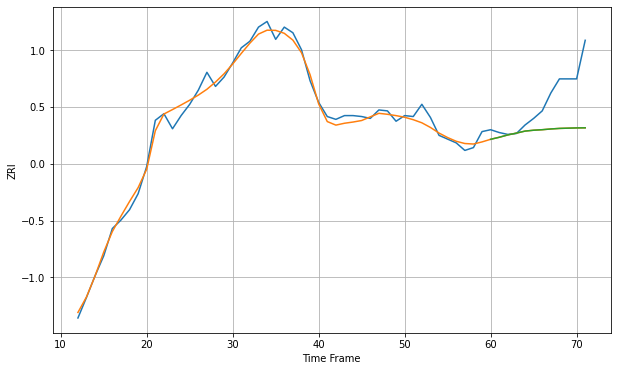

Wall time: 18.7 s
11214 7.474009532504033 39.85200526884387 39.85232054467385 [2069.81390274 2071.96607234 2074.46545115 2076.40388321 2078.53157848
 2079.45841883 2080.00991465 2080.79735901 2081.3798239  2081.65237792
 2081.90508762 2082.00682728]
60 60 12


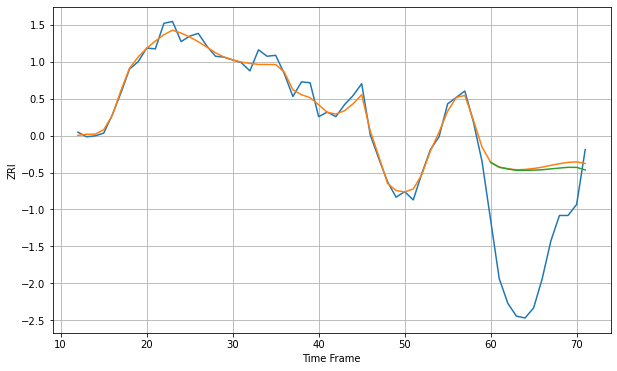

Wall time: 19 s
11215 7.416097314943247 110.39142333381265 108.93379340806656 [2549.07053948 2543.66301295 2541.81269449 2540.29703479 2540.33169442
 2540.5934084  2540.98993915 2541.92170131 2542.81394856 2543.62663245
 2543.5794427  2540.74933221]

Got an mse at 0.0025 in round 448 and stopped training

60 60 12


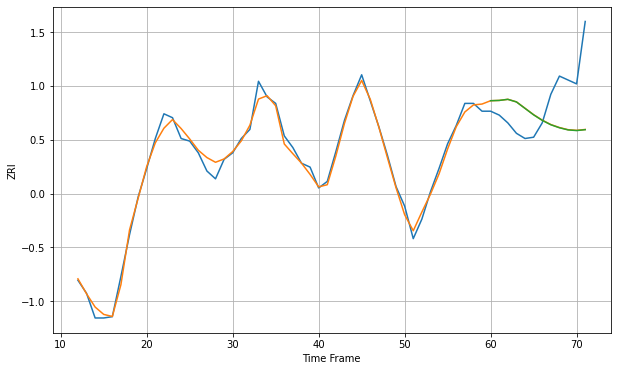

Wall time: 17.7 s
11216 4.950950173892096 33.77589583727884 33.850611748881846 [2514.06183558 2514.2830109  2515.11608572 2513.12164498 2508.1504986
 2503.18946    2498.9641568  2495.57406249 2493.26714971 2491.61969132
 2491.10830135 2491.78939945]
60 60 12


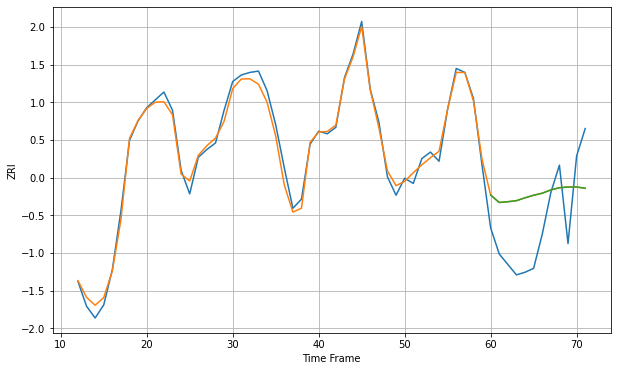

Wall time: 18.6 s
11217 5.336001680627994 40.74280333393821 40.73257688335148 [2816.12326036 2810.42772774 2810.99767193 2811.79335016 2814.00427554
 2815.94438852 2817.49804226 2820.03393053 2821.71269787 2822.22039198
 2822.29346096 2821.27965323]

Got an mse at 0.0025 in round 476 and stopped training

60 60 12


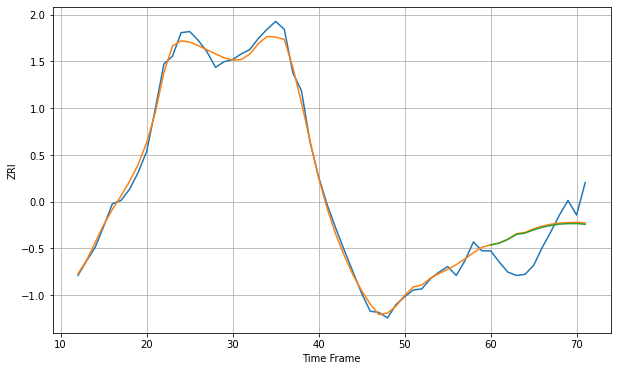

Wall time: 18.3 s
11218 5.773794073381067 24.539216024877962 24.461124969695977 [2040.25450068 2041.93863831 2045.21323149 2049.77030532 2050.84505964
 2053.73702354 2056.07250715 2057.68992645 2058.8638955  2059.31566546
 2059.36240715 2058.79777496]

Got an mse at 0.0024 in round 317 and stopped training

60 60 12


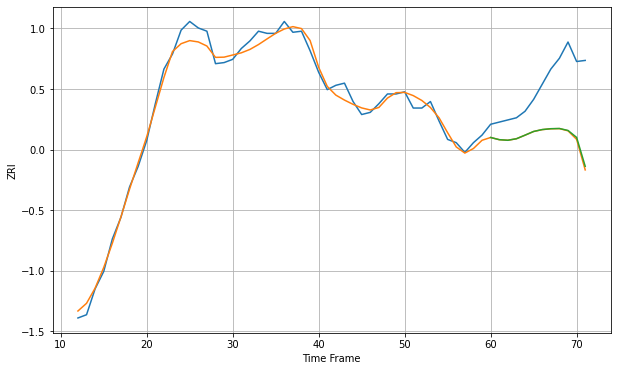

Wall time: 14.8 s
11219 7.0299303490512814 52.984547321128474 52.18279068837063 [2098.79235358 2096.76895408 2096.22220379 2097.63596328 2100.94490399
 2104.36045663 2106.11527287 2106.90305224 2107.10198733 2105.27988504
 2098.85537748 2072.16673582]

Got an mse at 0.0025 in round 274 and stopped training

60 60 12


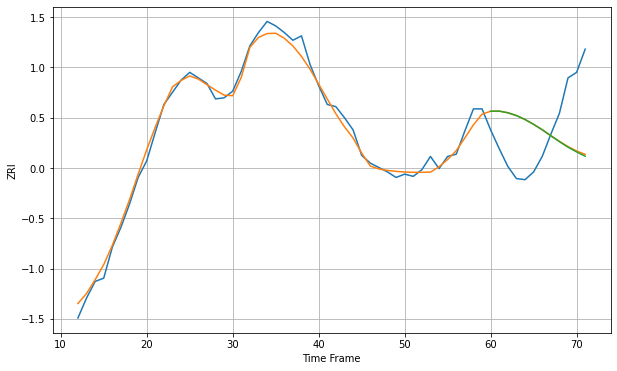

Wall time: 15.7 s
11220 6.468798489864268 50.84967700909724 51.26867243177923 [2081.85105461 2081.9549189  2080.47995376 2077.94837347 2074.37907673
 2069.98594583 2065.10688445 2059.68862142 2054.36877387 2049.37943318
 2045.07771577 2041.18803622]
60 60 12


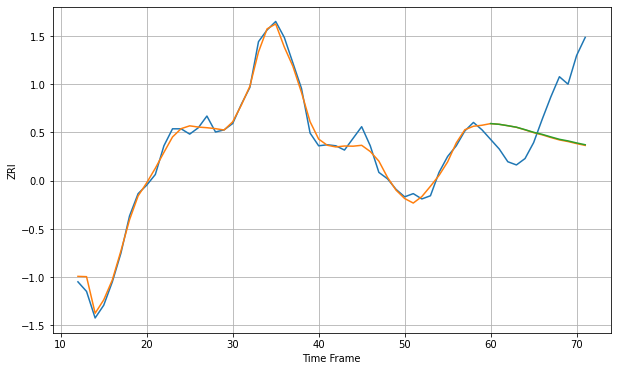

Wall time: 18.8 s
11221 6.027429027635441 49.423782541443046 49.08766325197194 [2449.90468416 2449.22236572 2447.91734131 2446.50942838 2444.19022859
 2441.72581991 2439.77057618 2437.36979074 2435.12942606 2433.60811852
 2431.69969071 2430.00364794]
60 60 12


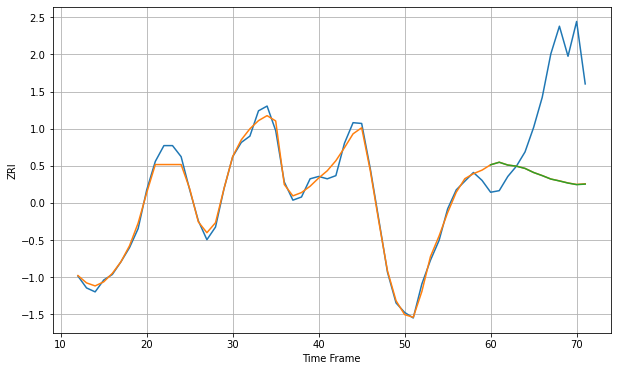

Wall time: 18.7 s
11222 8.375732682582527 116.75904023680748 116.86635709273106 [2749.76066954 2752.94241766 2749.36837078 2747.98436045 2745.13379469
 2739.98490282 2736.05600326 2731.70277691 2729.2939227  2726.62532658
 2724.65573559 2725.29787687]
60 60 12


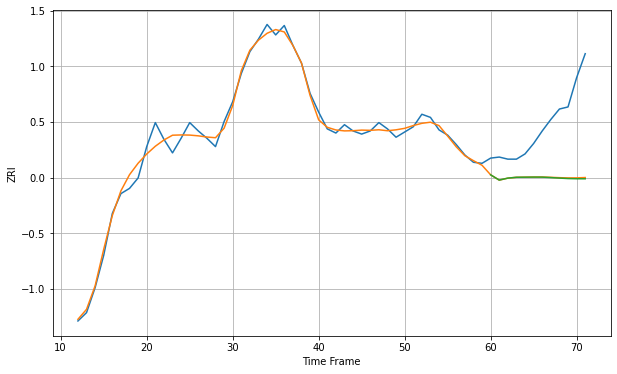

Wall time: 18.7 s
11223 6.596075817059272 57.832221871546786 58.281400444219074 [1990.98437328 1985.9375613  1987.83615731 1988.63968429 1988.72526852
 1988.79654132 1988.76231511 1988.34937831 1987.85594041 1987.41476266
 1987.22003468 1987.19357926]

Got an mse at 0.0025 in round 424 and stopped training

60 60 12


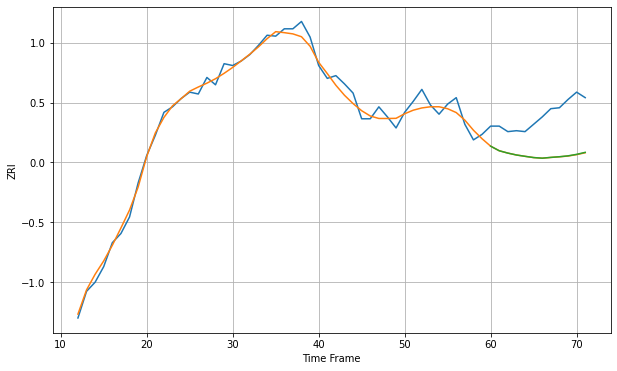

Wall time: 16.9 s
11224 7.669489375321169 44.920799696138026 44.788621946461795 [2088.14292574 2083.15756907 2080.61209193 2078.55360609 2077.10311686
 2075.74343371 2075.06944802 2075.93050925 2076.65030496 2077.61066692
 2079.24146891 2081.43130774]
60 60 12


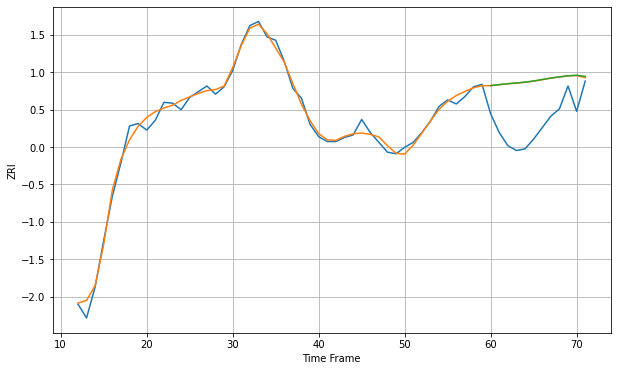

Wall time: 18.8 s
11225 7.040451515639028 56.323509041286336 56.48706166481283 [2311.43455699 2312.6409773  2313.81848259 2314.67118656 2315.75862846
 2317.14278614 2318.94428246 2320.76190906 2322.18089471 2323.52886759
 2324.16009585 2322.73448199]

Got an mse at 0.0025 in round 363 and stopped training

60 60 12


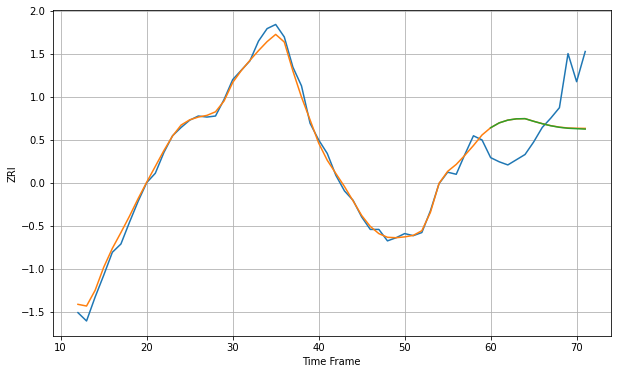

Wall time: 15 s
11226 5.507984559569474 41.0343035659644 41.21071726774363 [2053.74477674 2058.4127431  2061.05940291 2062.28896199 2062.45996172
 2059.92783086 2057.6287669  2055.63740607 2054.16440886 2053.2448082
 2052.83146813 2052.43189754]

Got an mse at 0.0025 in round 350 and stopped training

60 60 12


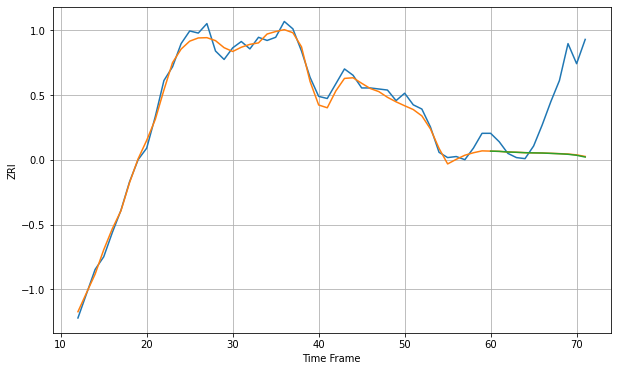

Wall time: 18.4 s
11228 6.4572619946948775 57.07833747903837 57.27565937967627 [2094.11709535 2093.88934034 2093.28966849 2093.0158969  2092.63658455
 2092.4451819  2092.31554471 2091.98200344 2091.60605446 2091.13244759
 2090.18283034 2088.50269155]

Got an mse at 0.0024 in round 287 and stopped training

60 60 12


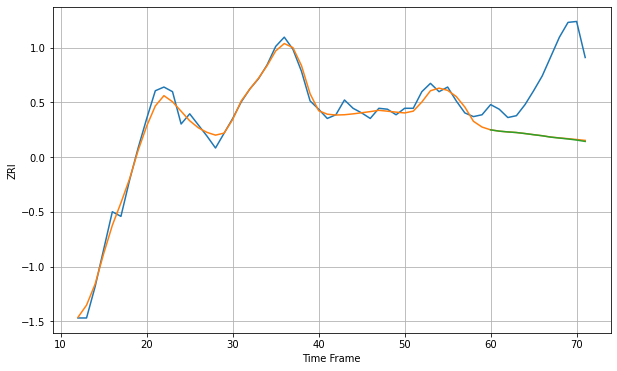

Wall time: 14.1 s
11229 7.5770876144066985 75.85508949075906 76.12056647171252 [2049.65460392 2048.25911991 2047.41597614 2046.75759651 2045.65456395
 2044.42050154 2043.2584986  2041.78580509 2040.77487465 2039.79701942
 2038.61142531 2037.11561595]
60 60 12


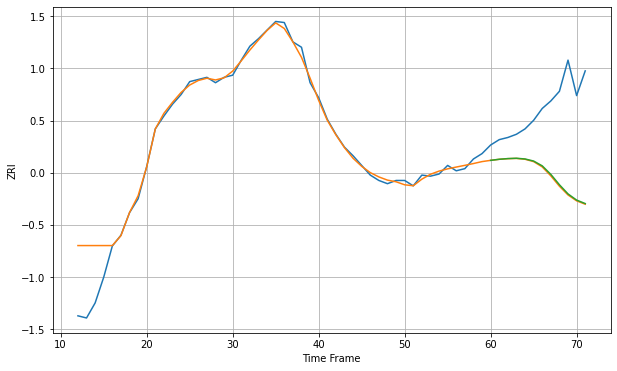

Wall time: 18.1 s
11230 16.413720450602877 70.75859687887316 70.08672687144376 [1955.71843458 1956.71983175 1957.35922044 1957.6645586  1957.00966359
 1955.07373521 1950.61004324 1942.67249676 1933.01400623 1924.48649769
 1918.73250897 1915.50548304]
60 60 12


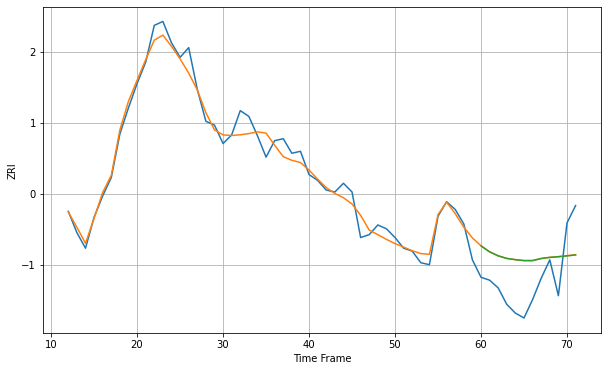

Wall time: 19 s
11231 10.765894762162219 39.9815690570381 40.009878576911454 [2738.44093882 2732.23707609 2728.1063319  2725.44017554 2724.17814231
 2723.21658176 2723.22539797 2725.38774394 2726.52951522 2727.21460961
 2728.10366569 2729.02828662]

Got an mse at 0.0025 in round 437 and stopped training

60 60 12


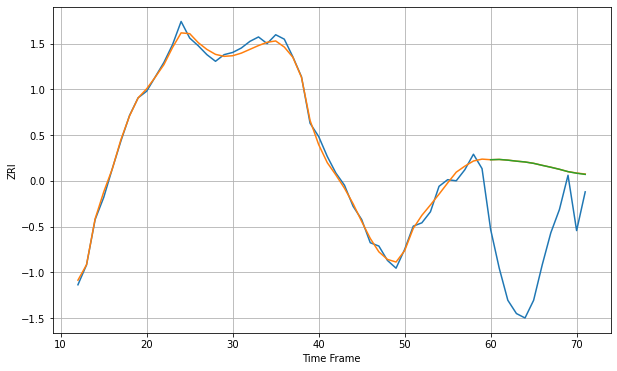

Wall time: 16.7 s
11232 4.554614591340464 91.18056256737714 91.1573256633899 [2150.03438774 2150.28256021 2149.65450965 2148.73929568 2148.00539547
 2146.76198252 2144.94767943 2143.23669351 2141.39729995 2139.26783146
 2137.82429606 2136.78928773]

Got an mse at 0.0025 in round 180 and stopped training

60 60 12


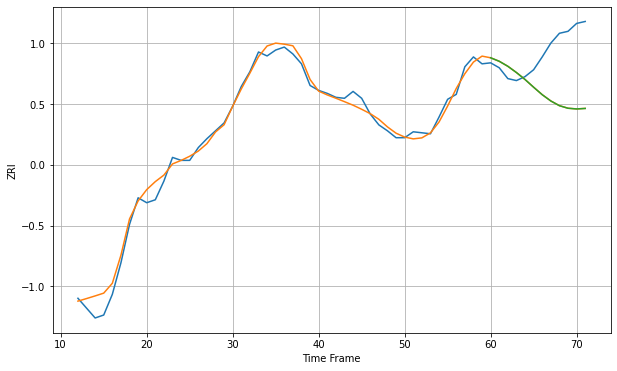

Wall time: 10.3 s
11233 7.95195931161461 51.908754611901585 51.939302130007846 [2318.12729295 2314.57994199 2309.51047554 2303.15558081 2296.08936686
 2288.22961124 2280.65313726 2274.28055759 2269.49736452 2266.88723306
 2266.19468715 2266.69617459]
60 60 12


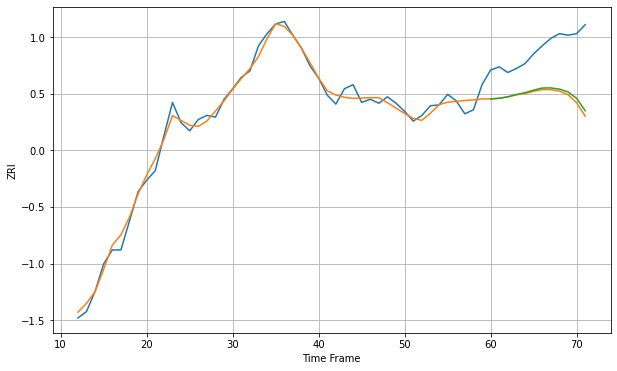

Wall time: 18.4 s
11234 8.355423665957078 61.6260832542612 58.94365174770014 [2062.39375669 2063.15957011 2065.08503687 2067.87937673 2070.07893904
 2073.21741898 2075.83593896 2075.98426989 2074.52975676 2071.04910375
 2063.08300691 2047.78612467]

Got an mse at 0.0024 in round 349 and stopped training

60 60 12


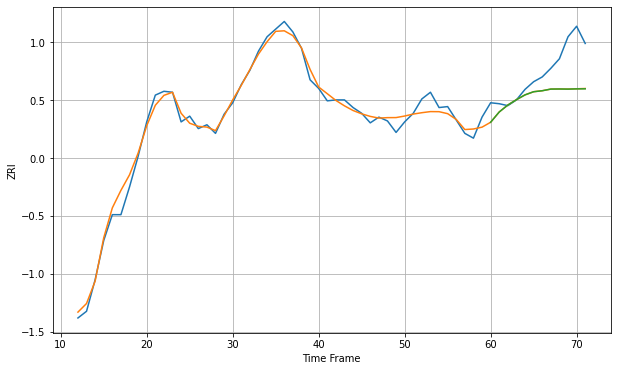

Wall time: 18.8 s
11235 7.801216324924288 31.342107978038907 31.416642143247117 [2091.61532959 2102.36374609 2109.62397132 2115.22244232 2120.24932708
 2123.5361167  2124.56853611 2126.31037763 2126.39851001 2126.27804881
 2126.50747938 2126.56773226]
60 60 12


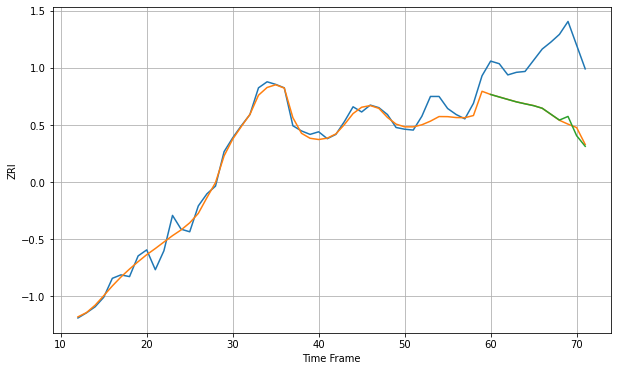

Wall time: 19.8 s
11236 9.472332815441009 71.76466042953831 71.86928635144928 [2101.28476537 2098.38663415 2095.5290001  2092.69802426 2090.43896566
 2088.29458563 2085.33647026 2078.44046057 2071.59244105 2075.81643043
 2053.49711446 2041.15685694]
60 60 12


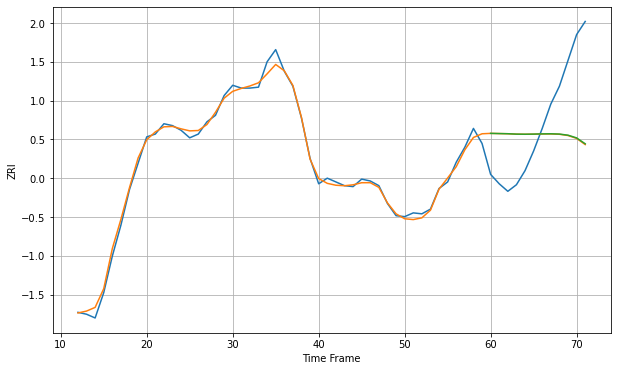

Wall time: 19.2 s
11237 5.263424306949526 66.33642941375372 66.07221160554396 [2460.73318436 2460.53767798 2460.35953584 2459.93118285 2459.82771546
 2459.96567482 2460.19129077 2460.30093011 2459.99492355 2458.80521141
 2455.90770023 2449.64668956]
60 60 12


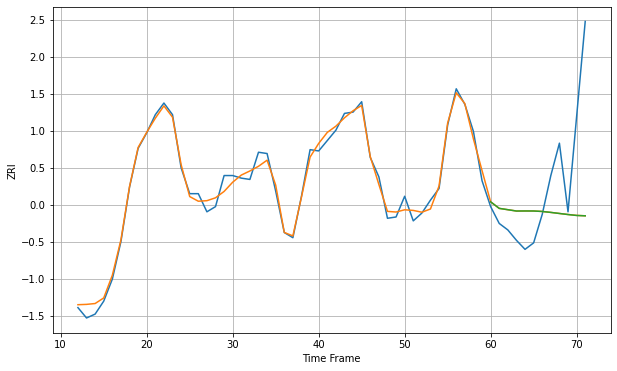

Wall time: 19.2 s
11238 5.2448125613024414 53.6161523672241 53.62854776317791 [2706.68969986 2701.64367114 2700.62605181 2699.59588351 2699.64125629
 2699.62173168 2699.26232866 2698.53200096 2697.70766742 2696.88609632
 2696.16931059 2695.90190456]

Got an mse at 0.0025 in round 119 and stopped training

60 60 12


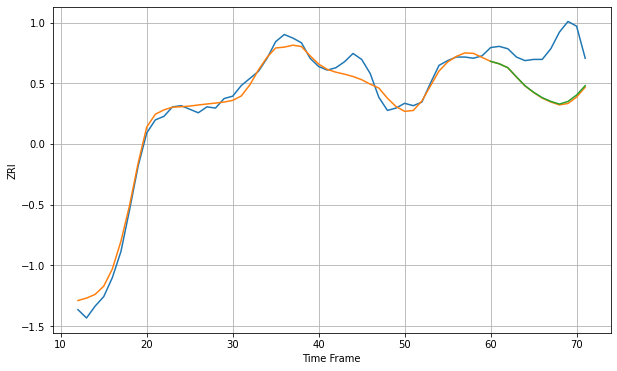

Wall time: 10.2 s
11354 6.932096263942296 38.632859133117165 37.894713440545175 [2112.37601673 2110.31942631 2107.04233101 2099.29527361 2091.80371322
 2086.32515634 2081.74792865 2078.61683897 2076.35751039 2078.57096466
 2084.00323296 2091.87580504]

Got an mse at 0.0025 in round 205 and stopped training

60 60 12


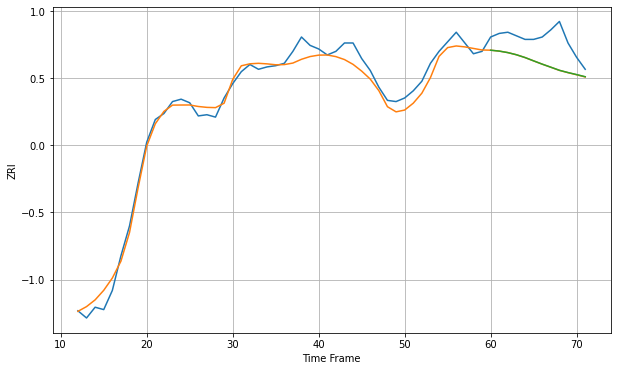

Wall time: 11.6 s
11355 7.767950867806117 21.363710162086115 21.313580224726046 [2175.96827937 2175.21547507 2173.95663033 2172.16184009 2169.83127894
 2167.04694748 2164.30807275 2161.75789587 2159.15912934 2157.26712008
 2155.57415592 2153.80098728]

Got an mse at 0.0025 in round 233 and stopped training

60 60 12


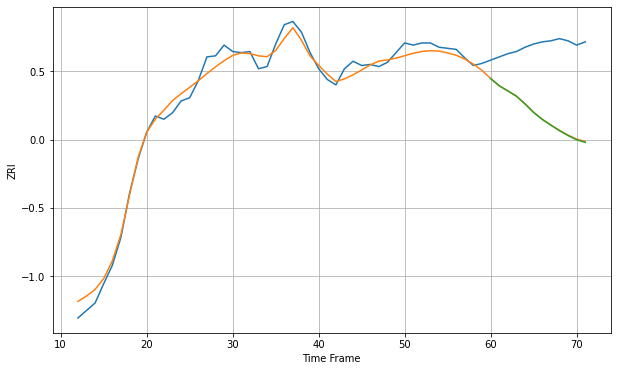

Wall time: 12.9 s
11356 7.728391583263283 66.64224679104905 66.94072991074432 [2184.89915644 2178.13348925 2173.35440065 2168.43730631 2161.2066449
 2153.27713738 2146.81843875 2141.47875144 2136.42725206 2131.83819005
 2127.94698986 2125.41221127]

Got an mse at 0.0025 in round 217 and stopped training

60 60 12


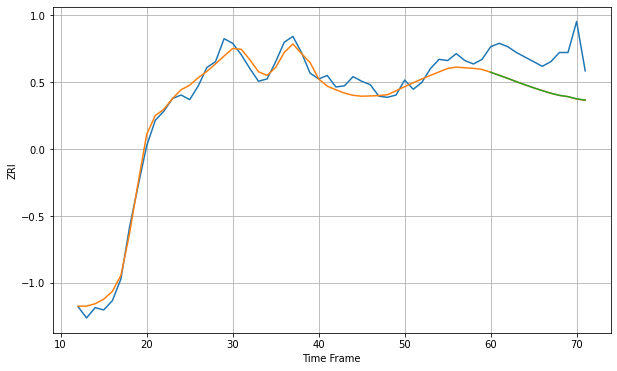

Wall time: 12.1 s
11357 7.285201754664005 32.97910166659528 32.92325897782982 [2210.82433727 2208.14465675 2205.44521475 2202.61587669 2199.88687301
 2197.28259161 2194.82853434 2192.56439033 2190.71643183 2189.58243585
 2187.72362808 2186.59447648]

Got an mse at 0.0025 in round 93 and stopped training

60 60 12


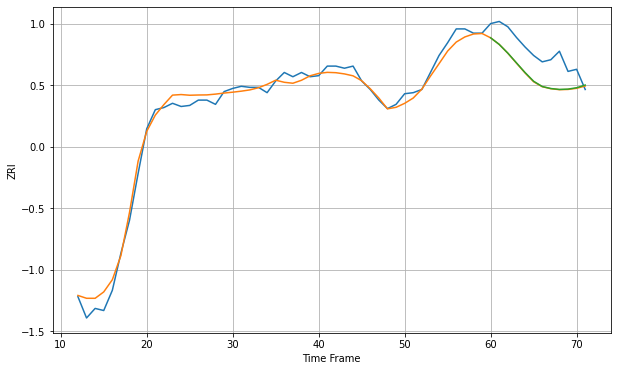

Wall time: 9.73 s
11358 7.110067674617227 22.872318630686873 22.654396823999456 [2205.60711857 2199.40842949 2191.23502136 2182.08495736 2172.97723846
 2164.7477856  2159.79117263 2157.89569516 2157.03806849 2157.3500306
 2158.63945838 2161.17556413]

Got an mse at 0.0025 in round 233 and stopped training

60 60 12


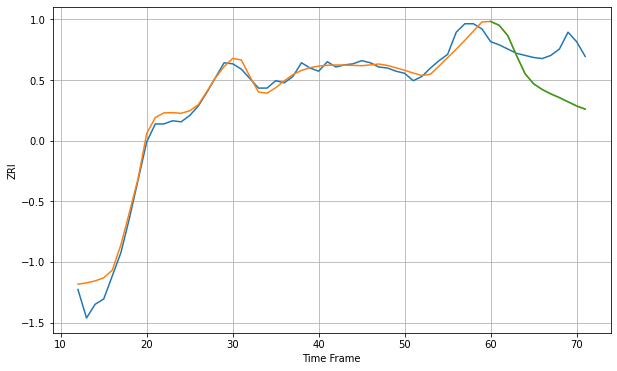

Wall time: 13.1 s
11360 8.648222159323918 37.33478480580063 37.250241015857476 [2293.17151058 2289.46153854 2279.62565523 2261.03915401 2243.63713333
 2234.05608517 2228.68574798 2224.52921712 2220.99160485 2217.00807988
 2213.09203112 2210.15283219]

Got an mse at 0.0025 in round 104 and stopped training

60 60 12


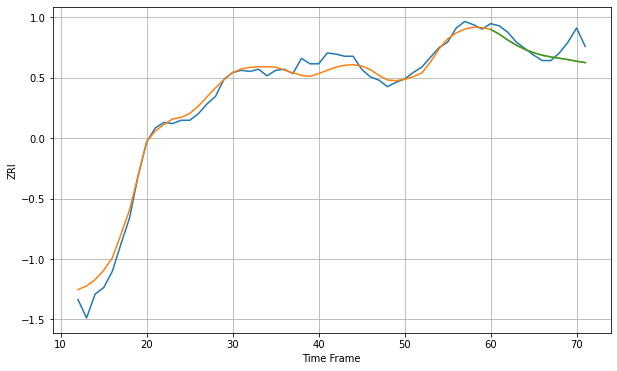

Wall time: 8.95 s
11361 8.233167530270038 11.643270338458827 11.661753505579632 [2203.71053358 2199.33546662 2193.88546423 2189.13754374 2185.25559576
 2182.22673388 2179.9284524  2178.33159267 2177.13830115 2175.83306191
 2174.36012984 2173.10990748]

Got an mse at 0.0025 in round 112 and stopped training

60 60 12


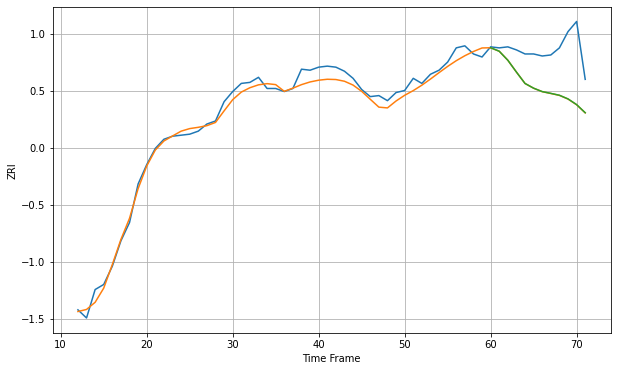

Wall time: 9.86 s
11364 7.219159993962193 40.562938224238486 40.46694443614936 [2251.11335448 2247.68408834 2238.81467755 2227.16849843 2215.94889579
 2211.29725326 2207.93335026 2206.18843889 2204.33999109 2200.74884455
 2195.1313706  2187.1280648 ]

Got an mse at 0.0025 in round 253 and stopped training

60 60 12


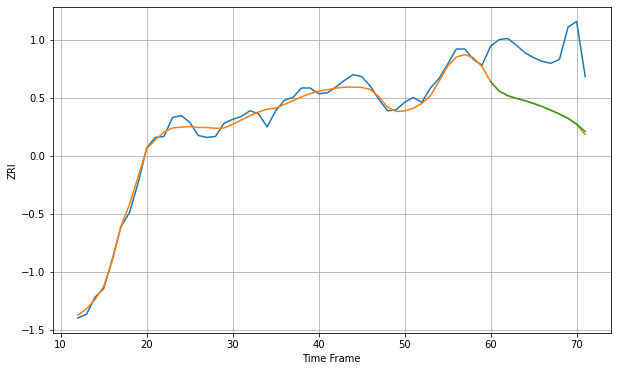

Wall time: 12.8 s
11365 6.71697400777382 63.69718831269383 63.32730448182539 [2202.59197176 2192.66705575 2187.9029807  2185.02698915 2182.61683962
 2179.68236017 2176.42292599 2172.65841437 2168.60895134 2164.07809862
 2158.16119721 2150.2684436 ]

Got an mse at 0.0025 in round 180 and stopped training

60 60 12


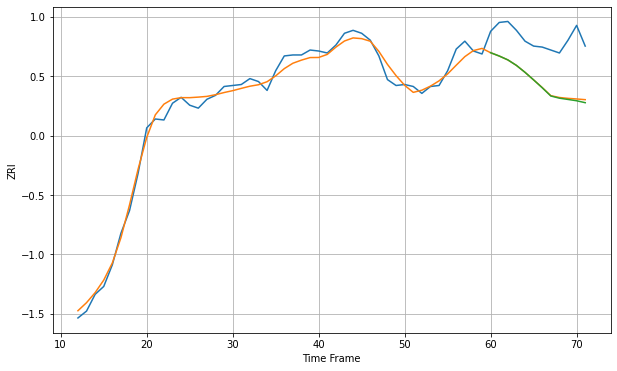

Wall time: 9.9 s
11366 7.349712130858415 45.18081763539916 45.970322287885544 [2205.27684034 2201.9161346  2198.00294624 2192.39511662 2185.36375176
 2177.67955598 2169.70447886 2161.34819761 2159.12142464 2157.83408677
 2156.51055676 2154.54313468]

Got an mse at 0.0025 in round 146 and stopped training

60 60 12


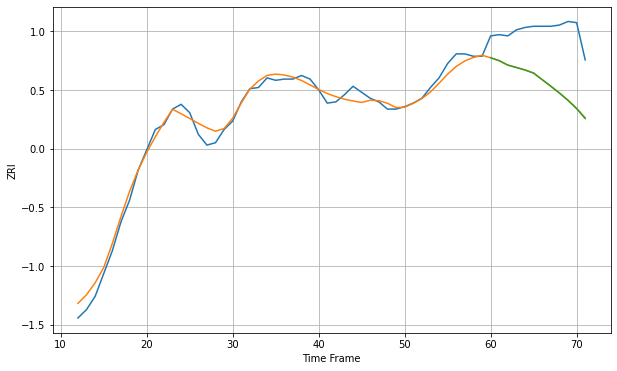

Wall time: 9.1 s
11367 6.1293038924883625 45.220395209280376 45.35501483831615 [2060.79446985 2058.31128469 2054.65179504 2052.65329646 2050.57202879
 2047.98732841 2042.49209058 2037.03590582 2031.37318737 2025.23553878
 2018.35156284 2010.13198765]

Got an mse at 0.0024 in round 191 and stopped training

60 60 12


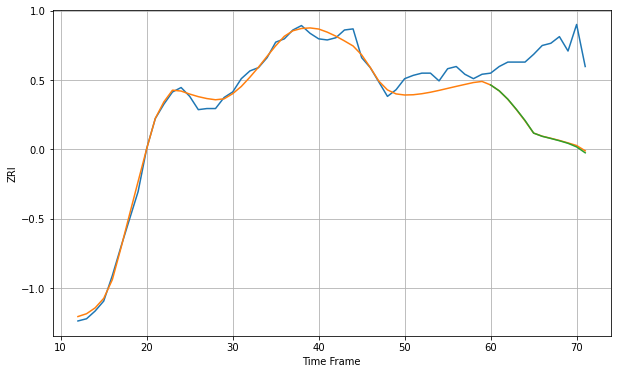

Wall time: 10.4 s
11368 8.095946459416956 70.14621262091667 70.52815834200426 [2202.3140218  2197.01644935 2189.46529246 2180.20626861 2170.25582467
 2158.81498157 2155.89229255 2153.95364036 2151.89883875 2149.57699051
 2146.33822959 2141.01316942]

Got an mse at 0.0025 in round 248 and stopped training

60 60 12


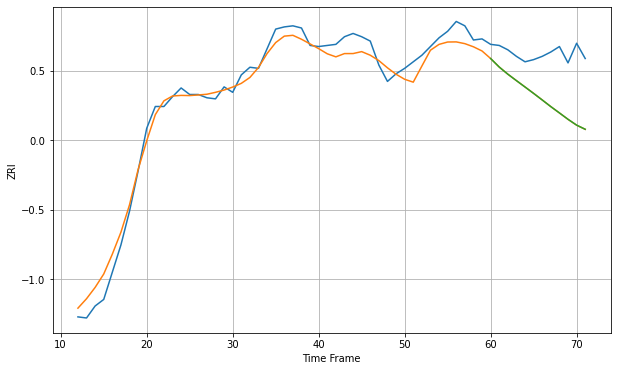

Wall time: 12.4 s
11369 10.556768282723235 44.17830304399219 44.16211244759689 [2232.00077906 2224.17975975 2217.64493676 2211.71796325 2205.87678266
 2199.99664738 2193.97865686 2187.87838425 2182.10401845 2176.25758492
 2170.91528084 2167.09731929]

Got an mse at 0.0024 in round 250 and stopped training

60 60 12


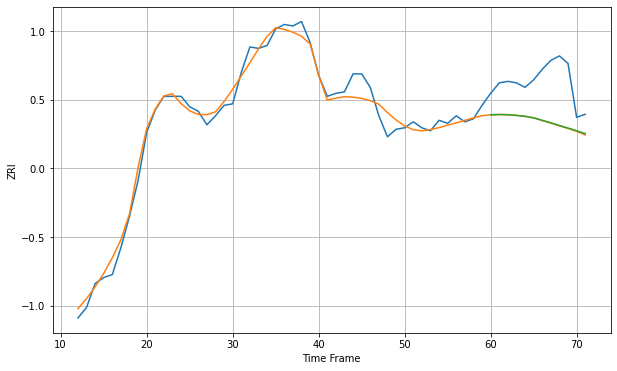

Wall time: 11.7 s
11370 6.294368731179497 28.723160373186946 28.586191695483475 [2147.6966729  2147.87245584 2147.73833554 2147.29901608 2146.67335352
 2145.65622411 2143.96823129 2142.29720601 2140.50274814 2138.80111444
 2137.03540469 2135.07874196]

Got an mse at 0.0025 in round 172 and stopped training

60 60 12


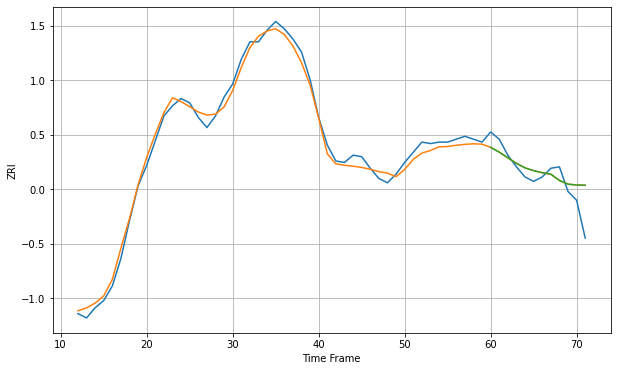

Wall time: 13.8 s
11372 4.62103032507357 12.462120337094126 12.457111299403548 [1979.38833633 1976.11833465 1972.20680533 1968.39583007 1965.28375202
 1963.33526125 1961.93435813 1960.9464615  1956.62728213 1954.06815848
 1953.49196881 1953.32849872]

Got an mse at 0.0025 in round 204 and stopped training

60 60 12


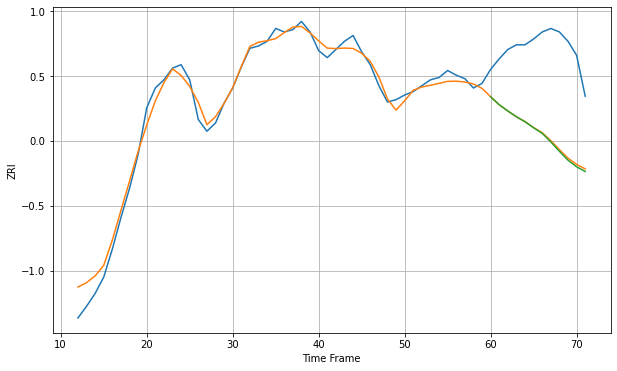

Wall time: 16.2 s
11373 8.04482636417963 75.41760161241776 76.32111255313879 [2138.46590427 2131.66388565 2126.31721668 2121.311493   2117.09716164
 2111.94252697 2107.16204147 2099.84654958 2091.75441945 2084.13092803
 2078.51559744 2074.49782507]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


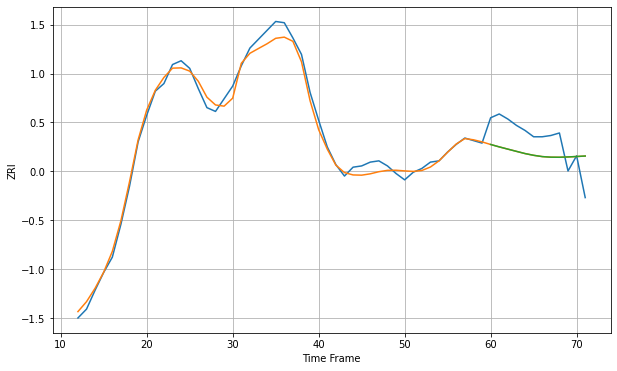

Wall time: 10.5 s
11374 5.44690513131274 19.902854171807608 19.907475082425414 [1995.91551722 1994.02214661 1992.25188317 1990.48980267 1988.74966967
 1987.37128661 1986.35939774 1985.89841405 1985.83948176 1986.09415221
 1986.43652967 1986.81700133]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


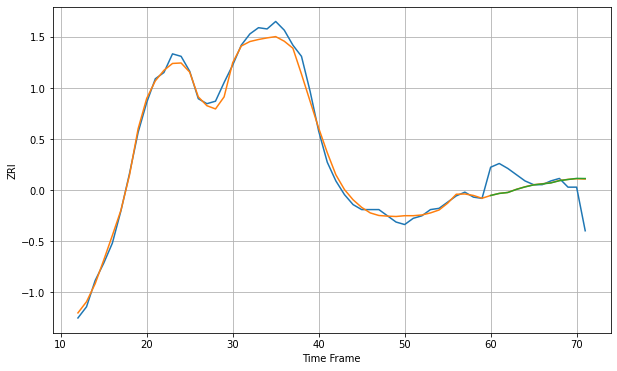

Wall time: 11.6 s
11375 5.208049217968924 16.92022954319646 17.018592988812625 [1985.32547788 1986.97617794 1987.72767778 1990.19928588 1992.20228116
 1993.81061715 1994.5844058  1995.38336348 1997.18747019 1998.15160791
 1999.02066852 1998.91904704]

Got an mse at 0.0024 in round 311 and stopped training

60 60 12


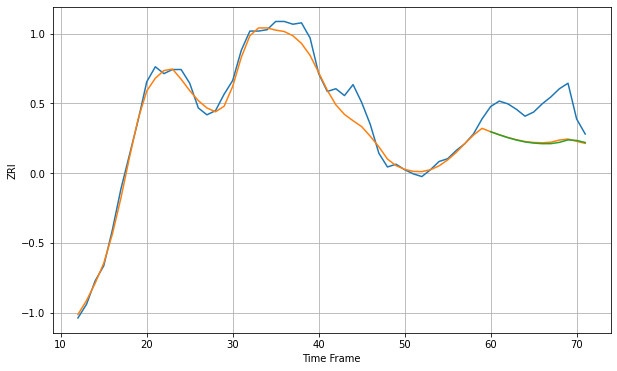

Wall time: 15.5 s
11377 7.296387448962805 26.00562363565523 26.491651010112715 [2123.68225555 2121.43616344 2119.36979164 2117.62796407 2116.235553
 2115.40335128 2114.97091943 2114.98211074 2115.92775105 2117.73073067
 2117.34992949 2115.81302607]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


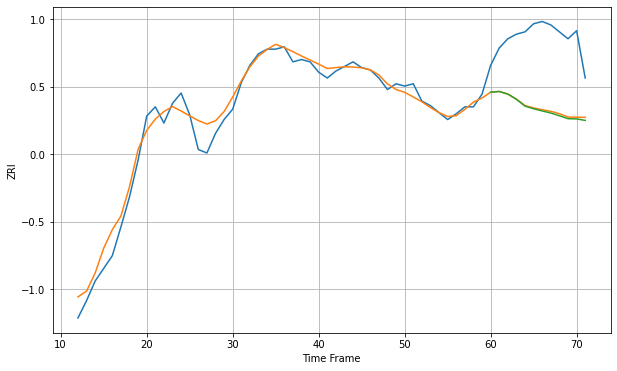

Wall time: 10.6 s
11378 9.356830454379025 61.033972155650225 62.01766924358252 [2137.67649605 2138.33060461 2136.01729538 2131.5048557  2125.626648
 2123.35010735 2121.4430772  2119.64953541 2117.259721   2114.73439129
 2114.54118397 2113.26096103]

Got an mse at 0.0024 in round 377 and stopped training

60 60 12


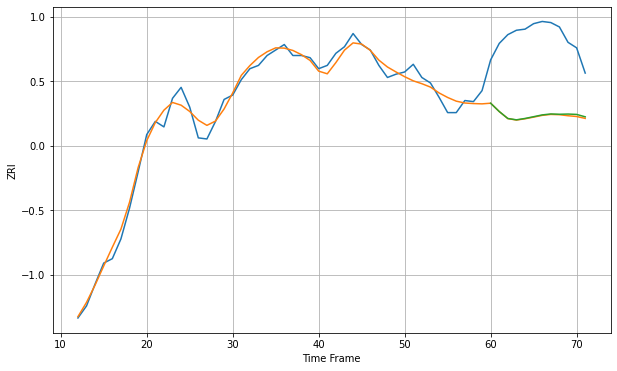

Wall time: 15.6 s
11379 7.250966979963066 72.23363821189702 71.69488974121676 [2108.57090229 2101.0103381  2094.64822764 2093.43454929 2094.68331723
 2096.28148107 2097.91862257 2098.78059903 2098.50145023 2098.69325958
 2098.36350898 2096.17180487]

Got an mse at 0.0024 in round 175 and stopped training

60 60 12


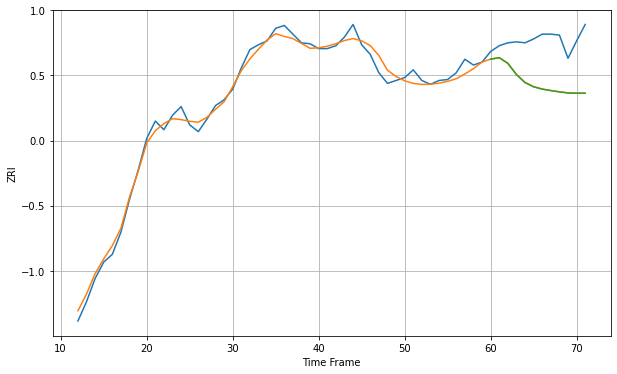

Wall time: 11.2 s
11385 7.246839136261472 45.879470532175766 46.00509260540335 [2164.07211732 2165.62757435 2159.68524144 2148.09270304 2139.71803148
 2135.41036387 2133.0357722  2131.52836115 2130.20487412 2129.08085344
 2128.85404029 2128.78451725]

Got an mse at 0.0025 in round 253 and stopped training

60 60 12


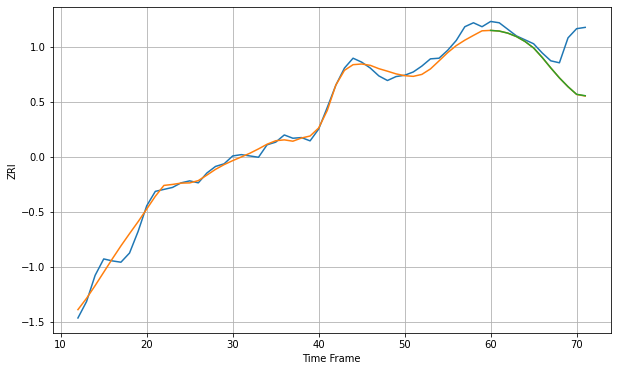

Wall time: 12 s
11412 10.202562135646374 48.03431702073141 47.892318189670874 [2201.36340902 2200.35893535 2197.21223549 2191.97241834 2184.4627721
 2174.57987384 2160.13870433 2144.16485839 2129.01391057 2115.59537443
 2103.92810166 2101.82295954]

Got an mse at 0.0025 in round 149 and stopped training

60 60 12


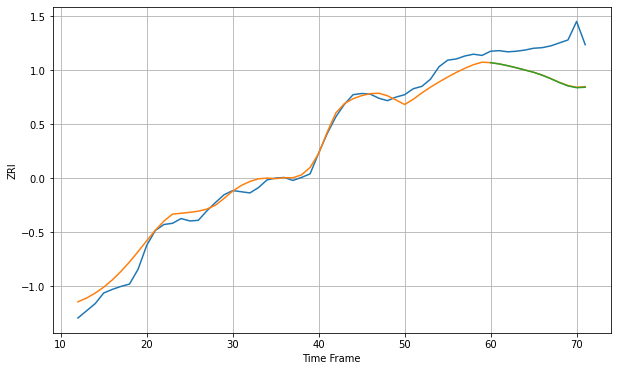

Wall time: 9.7 s
11413 14.801515364117517 55.909365741529335 56.28330613277369 [2221.80457917 2219.68672915 2216.64726001 2213.19398461 2209.44785234
 2205.63403861 2200.78039664 2194.85717076 2188.36587816 2182.75073624
 2179.74320423 2180.50814699]

Got an mse at 0.0025 in round 127 and stopped training

60 60 12


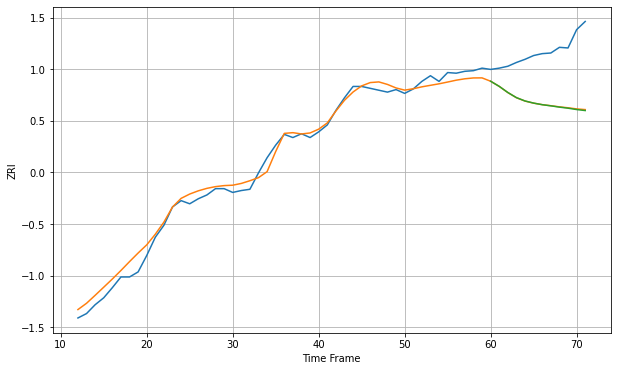

Wall time: 8.95 s
11414 11.693630181552248 83.08043061735187 83.5116089316563 [2173.23954009 2165.12115987 2155.40626814 2147.2819291  2141.96798122
 2138.60315928 2136.08240675 2134.26053863 2132.22369881 2130.53827593
 2128.39638552 2126.78756044]

Got an mse at 0.0025 in round 128 and stopped training

60 60 12


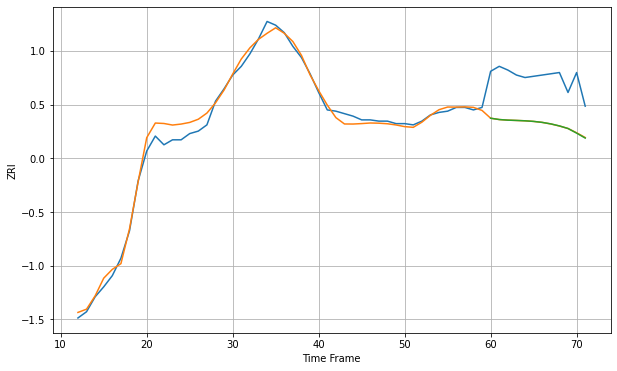

Wall time: 9.58 s
11415 5.748947180118253 38.10661054829982 38.14094980144795 [1912.33927154 1911.27990899 1910.80269748 1910.55879217 1910.26914569
 1909.78420185 1908.99723813 1907.79423386 1906.15771132 1904.08422506
 1900.37351509 1896.40674646]

Got an mse at 0.0025 in round 126 and stopped training

60 60 12


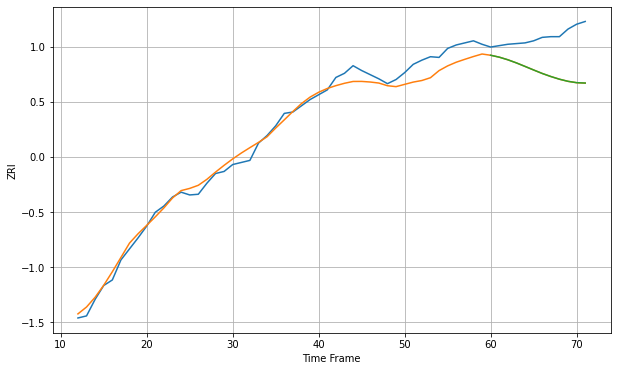

Wall time: 8.42 s
11416 13.43435270905969 54.251611546635104 54.21889660496793 [2162.12001629 2159.36174923 2155.57819928 2151.03180764 2145.95671379
 2140.80816163 2135.77595251 2131.35896731 2127.4714286  2124.40218156
 2122.45127777 2121.9206835 ]

Got an mse at 0.0025 in round 182 and stopped training

60 60 12


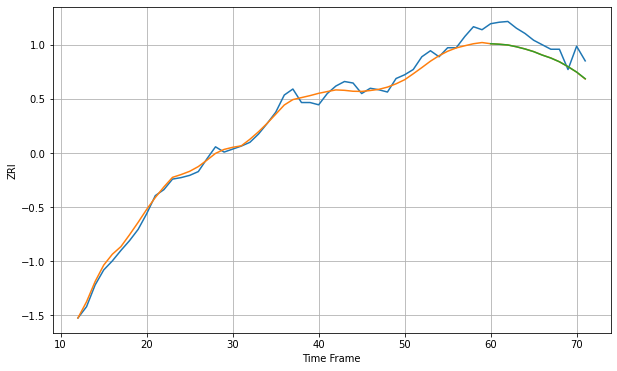

Wall time: 11.2 s
11417 8.209735279751552 22.733951260663794 22.714938922941585 [2097.33506357 2096.66438416 2095.66616884 2093.27545653 2090.35388066
 2086.82906504 2082.23207942 2078.28989057 2073.29365913 2066.80130074
 2059.59746426 2050.69403023]

Got an mse at 0.0025 in round 229 and stopped training

60 60 12


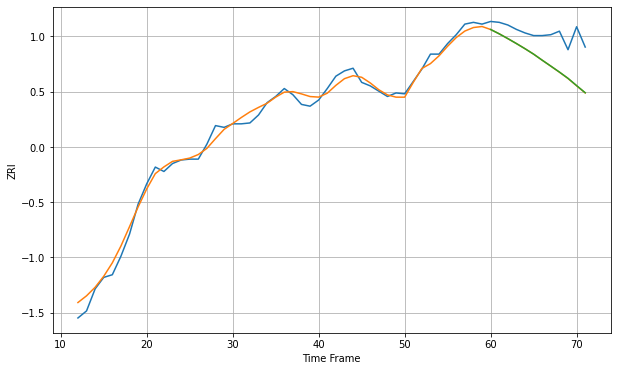

Wall time: 11.4 s
11418 7.35752515008413 34.10670532440286 34.01087701266054 [2071.90175484 2066.97724133 2061.57230038 2055.96117169 2050.1141973
 2043.96008761 2037.09401393 2030.41233039 2023.64976523 2016.56554447
 2008.33070798 2000.2282894 ]

Got an mse at 0.0025 in round 272 and stopped training

60 60 12


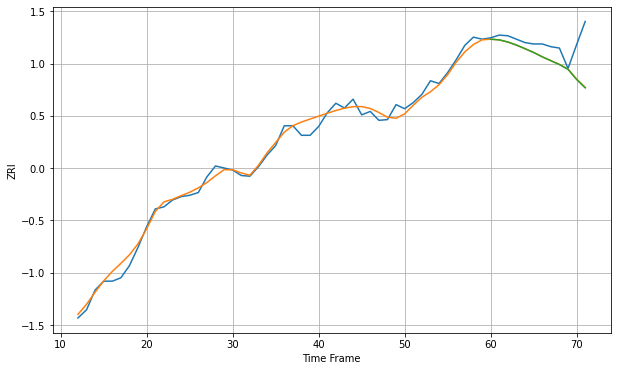

Wall time: 12.1 s
11419 9.465556761197988 33.76372632114889 34.059595733403086 [2181.96863433 2181.02346186 2177.84303362 2173.36541714 2168.02172155
 2162.53741716 2156.12640417 2150.44358663 2144.76427454 2137.78669957
 2122.91229908 2110.55274105]

Got an mse at 0.0025 in round 270 and stopped training

60 60 12


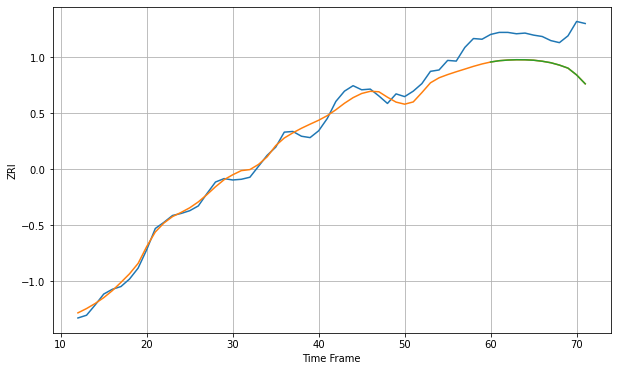

Wall time: 12.4 s
11420 13.219031598531723 49.0725610381763 49.07465645294569 [2140.64729067 2142.57298318 2143.51959183 2143.98439252 2143.90779904
 2143.28447849 2141.79827998 2139.60025574 2136.15724441 2131.68428939
 2121.75228819 2108.71178439]

Got an mse at 0.0025 in round 312 and stopped training

60 60 12


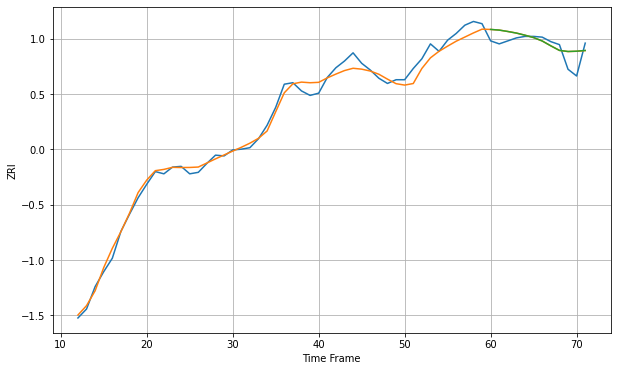

Wall time: 14.1 s
11421 9.078597664008702 14.87044484043233 14.900970428825214 [2148.33356393 2147.44754022 2145.57375862 2143.44830227 2140.58563295
 2137.41779659 2132.85586454 2126.36334457 2120.2566169  2118.80757446
 2119.20737024 2120.17068312]

Got an mse at 0.0025 in round 146 and stopped training

60 60 12


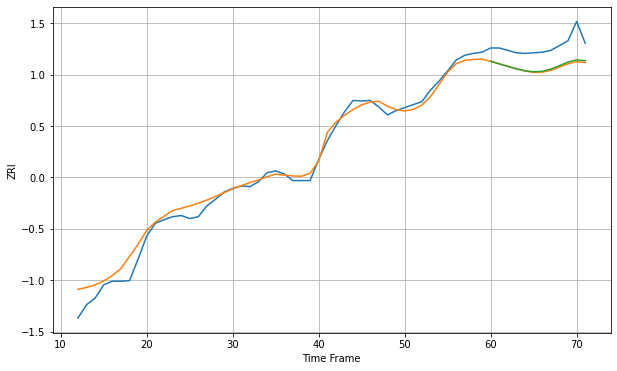

Wall time: 9.08 s
11422 14.141473037788503 35.29102033046433 33.732800962390975 [2206.92173318 2202.70875965 2198.52820789 2194.57456287 2191.22472443
 2189.47931476 2190.21267876 2193.8701802  2199.65499034 2205.60040477
 2209.2431687  2207.91289744]

Got an mse at 0.0025 in round 167 and stopped training

60 60 12


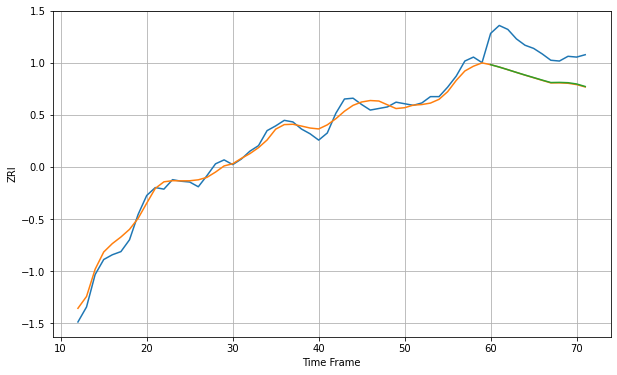

Wall time: 9.43 s
11423 8.558952894037168 39.01906480080447 38.7338019233446 [2066.42336844 2063.42533273 2060.08629989 2056.65480795 2053.30754182
 2050.11423322 2046.89489365 2043.81251758 2044.00067248 2043.60776143
 2041.99498979 2038.80231406]

Got an mse at 0.0025 in round 331 and stopped training

60 60 12


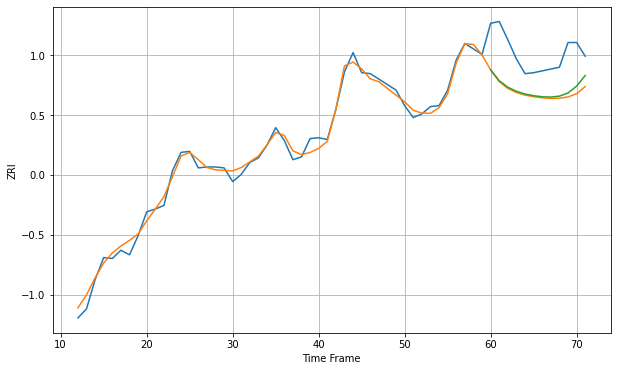

Wall time: 14.2 s
11426 6.80527171019574 43.91277971524348 41.17385821687733 [2113.05109627 2101.24588988 2094.19335758 2089.69745924 2086.7148981
 2084.8587222  2083.72335011 2083.38635093 2084.41140051 2087.80901776
 2095.34454582 2106.92974736]

Got an mse at 0.0025 in round 314 and stopped training

60 60 12


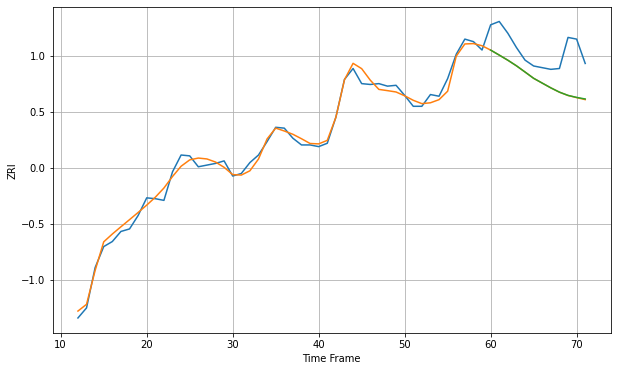

Wall time: 14.1 s
11427 7.017947400518264 38.22214686179415 38.09278441803267 [2148.9127895  2142.97685405 2136.8683673  2130.22684157 2122.83108033
 2115.33336842 2109.63153601 2103.97242411 2098.85964003 2094.98380474
 2092.59291545 2090.71316266]

Got an mse at 0.0025 in round 122 and stopped training

60 60 12


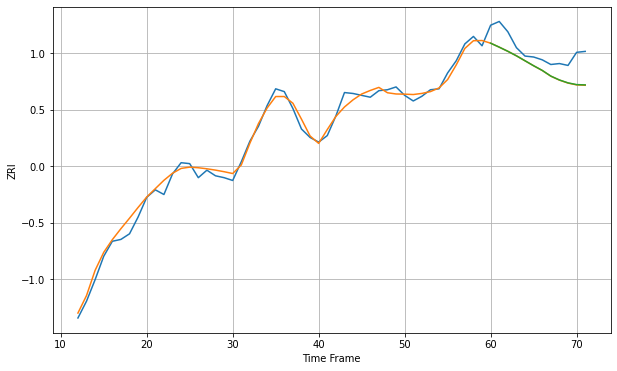

Wall time: 8.48 s
11428 6.7281402829188535 20.88043915854755 20.735876379271197 [2061.77228221 2057.53889215 2053.10425859 2048.28969964 2042.9724651
 2037.66645158 2032.68318529 2026.61524466 2022.44804718 2019.34939772
 2017.4920973  2017.18317632]

Got an mse at 0.0025 in round 363 and stopped training

60 60 12


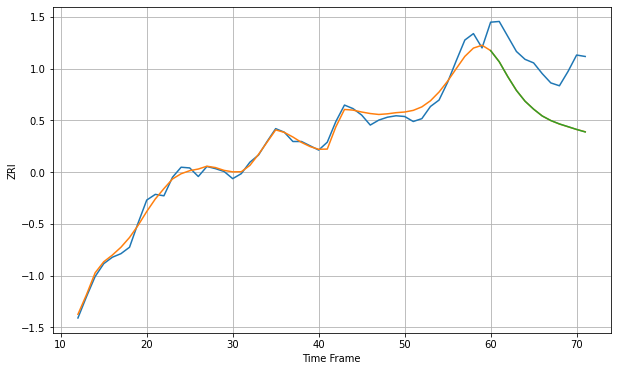

Wall time: 14.7 s
11429 8.565733248696631 68.07620547991006 68.08949220680681 [2119.19696878 2103.60298104 2082.66827006 2063.47879641 2048.415
 2037.24699022 2027.75376666 2021.34325035 2016.57484723 2012.76231726
 2008.87653739 2005.38839596]

Got an mse at 0.0025 in round 89 and stopped training

60 60 12


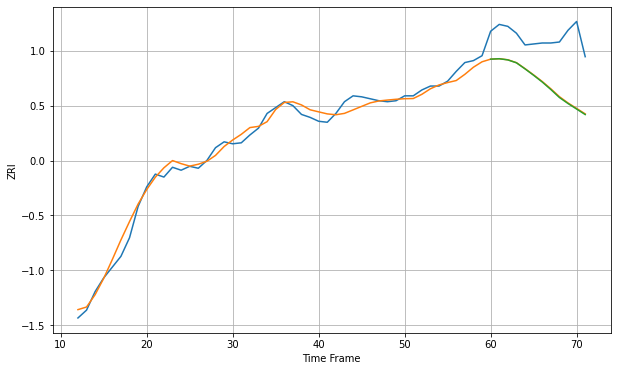

Wall time: 7.63 s
11432 7.08390779908021 49.47976122016292 49.94037502442239 [1987.47257518 1987.90289969 1986.73100346 1983.75724903 1977.54587404
 1971.00719617 1964.13904527 1956.48097869 1948.29938341 1942.13990081
 1936.50284792 1930.86749888]

Got an mse at 0.0025 in round 179 and stopped training

60 60 12


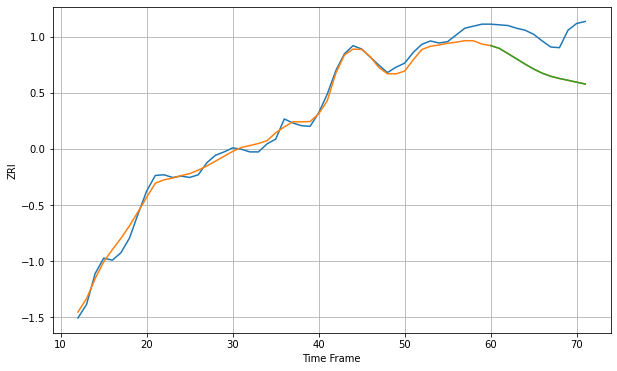

Wall time: 10.2 s
11433 10.074888314019688 57.27158311726175 57.28051306214691 [2176.10206555 2172.04547871 2164.39364029 2156.52258656 2148.61702974
 2141.3003608  2135.09373721 2130.43041692 2127.16971065 2124.5816809
 2121.67960235 2118.90791343]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


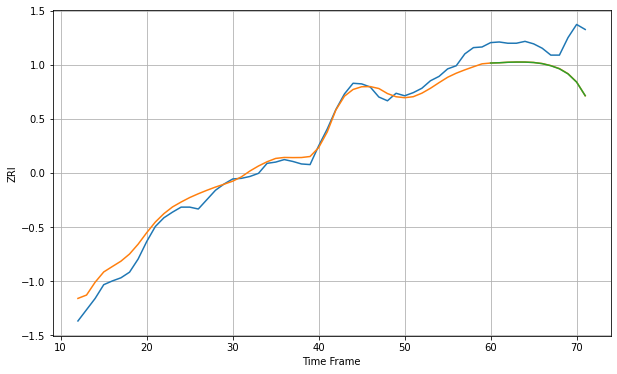

Wall time: 8.74 s
11434 15.274681608821084 50.277631312130104 50.34562757133206 [2162.3522226  2162.77268683 2163.54892216 2163.88716063 2163.83829658
 2163.16836281 2161.3711892  2158.0276112  2153.15052066 2145.00776874
 2131.85520459 2110.18517954]

Got an mse at 0.0025 in round 115 and stopped training

60 60 12


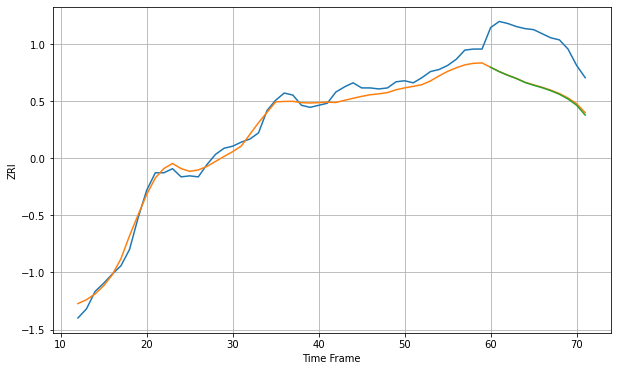

Wall time: 9.15 s
11435 7.649716753502178 48.03281488200729 48.585701397459175 [1973.17343304 1968.93376416 1965.35354226 1962.16678794 1958.3662108
 1955.63603092 1953.17356053 1950.26051387 1946.78046815 1942.16940499
 1936.06293195 1926.44096892]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


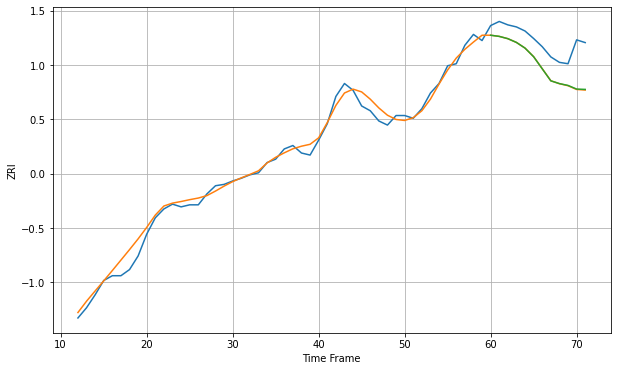

Wall time: 10.2 s
11436 10.491196115855972 38.04573767802095 37.794897010615124 [2125.81405255 2124.10257965 2120.75512076 2115.24282162 2106.92167319
 2094.28365862 2076.60048147 2058.88478854 2054.86224527 2052.15443324
 2046.82586422 2046.3365422 ]

Got an mse at 0.0025 in round 102 and stopped training

60 60 12


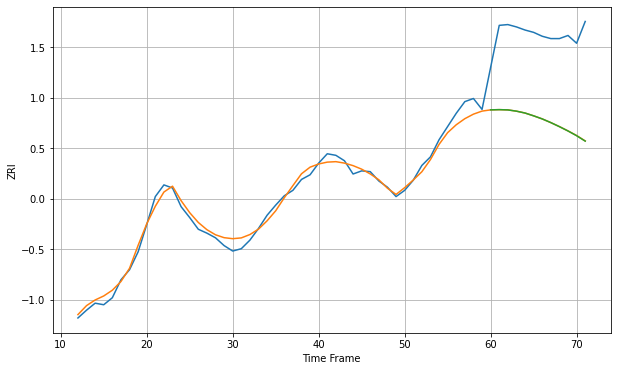

Wall time: 8.39 s
11542 8.349086060744717 111.69609481565735 111.76099003972084 [2345.40750807 2345.69974215 2345.36142985 2343.74014486 2341.34515478
 2337.73339662 2333.77746626 2329.03528978 2323.84339525 2318.27947121
 2312.20826139 2305.25046236]

Got an mse at 0.0024 in round 441 and stopped training

60 60 12


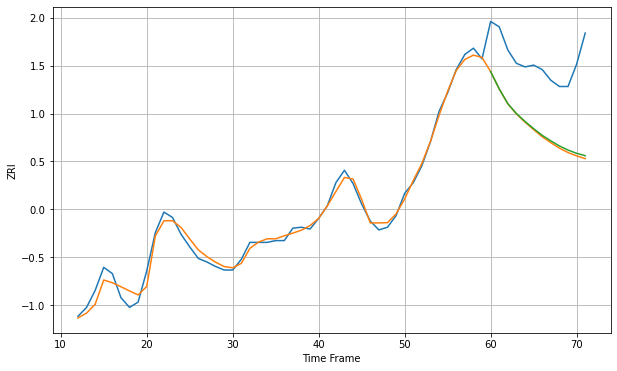

Wall time: 17.1 s
11550 7.284684508689227 79.25150646017899 77.60486388560533 [2231.69770749 2212.268709   2195.73486676 2184.60499178 2175.74101261
 2167.71465988 2160.16993216 2153.98415763 2148.25191743 2143.64010062
 2139.98785856 2137.28933491]

Got an mse at 0.0025 in round 117 and stopped training

60 60 12


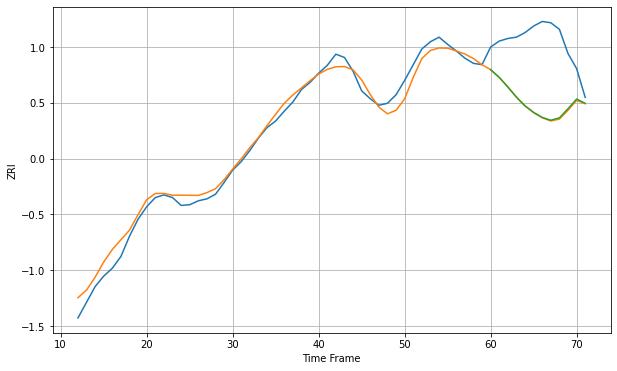

Wall time: 8.76 s
11561 13.382853035665391 100.46084076692549 99.7424311745333 [2464.32726921 2452.52567474 2437.98648755 2422.38832351 2409.09067916
 2399.05209347 2391.39107116 2387.06010497 2390.81901069 2404.75296297
 2419.45037748 2412.90133817]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


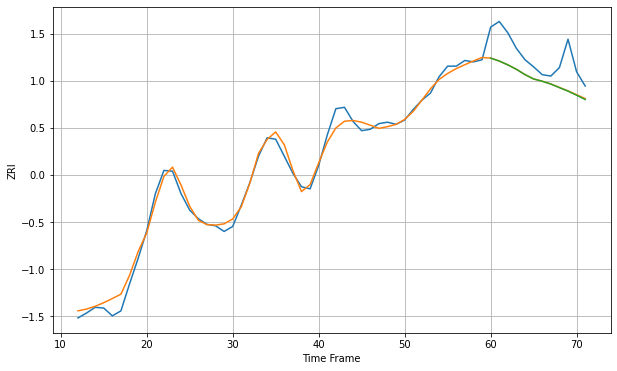

Wall time: 10.8 s
11563 9.629634832650968 36.85756776798073 37.060871737473484 [2293.34697154 2289.21592734 2283.8254599  2277.53026779 2270.08447062
 2263.93193061 2260.70254139 2256.7912933  2251.70280911 2246.77183417
 2240.98305084 2234.9901525 ]

Got an mse at 0.0025 in round 390 and stopped training

60 60 12


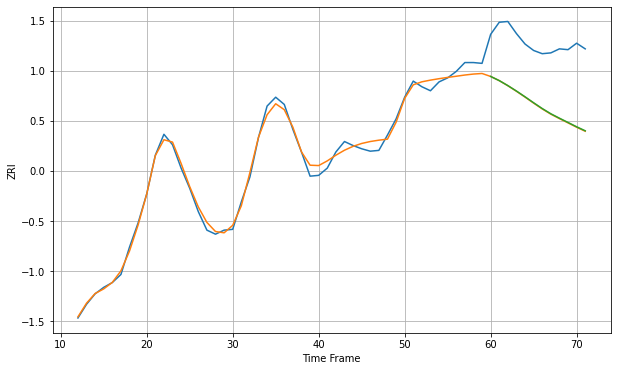

Wall time: 16.9 s
11580 7.120446038325492 79.38656804636382 78.99583196168803 [2191.76684067 2186.60780917 2180.41827    2173.66422659 2166.51815292
 2159.10771807 2151.94656405 2145.45523111 2139.96092361 2134.66030652
 2129.29569896 2124.32702756]

Got an mse at 0.0025 in round 207 and stopped training

60 60 12


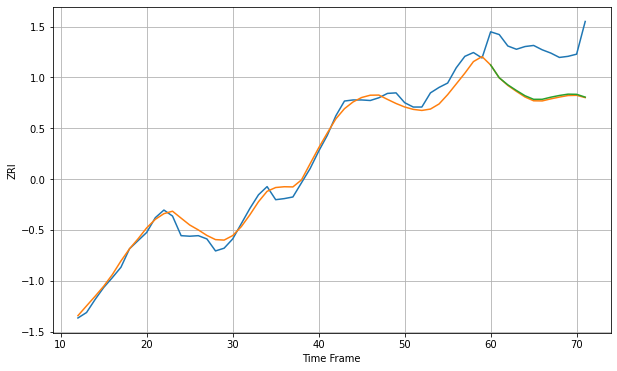

Wall time: 10.9 s
11590 14.531790908761028 87.37929380072045 85.57108563700157 [2549.14777687 2525.70693838 2512.72623745 2502.39288331 2492.73998098
 2486.17173153 2486.20949831 2490.06571174 2493.21921105 2495.64118648
 2495.3204569  2490.19686648]

Got an mse at 0.0025 in round 124 and stopped training

60 60 12


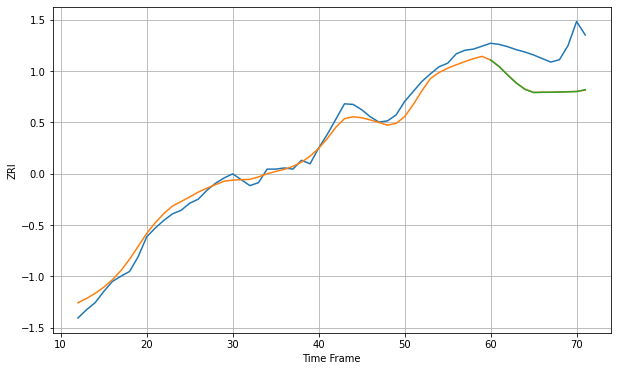

Wall time: 8.6 s
11691 13.272474356246226 66.93959250767436 66.97914779468854 [2184.53841016 2173.23141914 2158.70625595 2145.13770848 2134.56371704
 2129.27662929 2129.56620806 2129.656317   2130.02841497 2130.39493711
 2130.88574577 2134.13525794]

Got an mse at 0.0024 in round 139 and stopped training

60 60 12


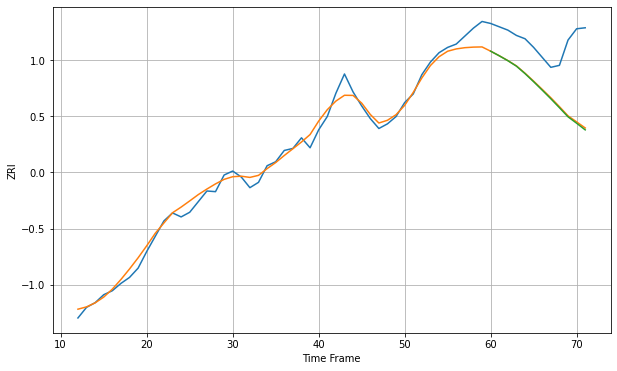

Wall time: 8.98 s
11692 11.989111457403546 79.92605685565148 81.19309482299089 [2166.30692449 2159.37151218 2152.00462904 2143.78407034 2132.56984881
 2120.37023084 2107.67825724 2094.75382488 2081.30804983 2067.5867994
 2057.94856445 2047.94314068]

Got an mse at 0.0025 in round 173 and stopped training

60 60 12


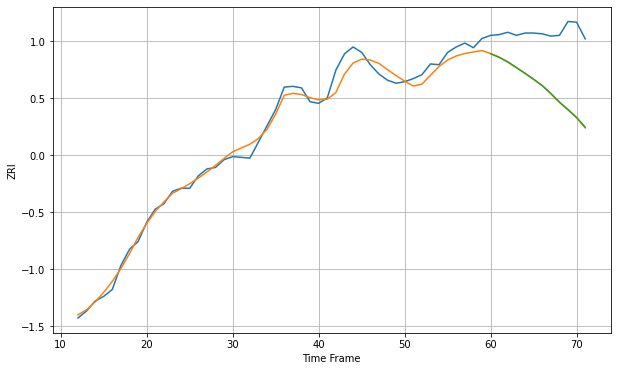

Wall time: 10.3 s
11694 10.150001971469198 76.5197292334921 76.24747733889815 [2135.30098768 2130.6196313  2124.54405328 2117.22862696 2109.85562146
 2102.08241299 2093.96724587 2083.73491499 2072.55706122 2062.92912515
 2052.68383766 2040.01721334]

Got an mse at 0.0025 in round 364 and stopped training

60 60 12


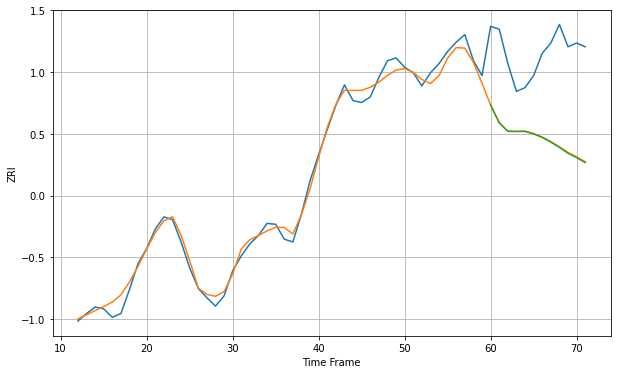

Wall time: 15.5 s
11758 8.117788230743699 95.9390280557436 96.43050243771586 [2377.19836307 2358.05321363 2349.24297879 2348.97466156 2348.97055506
 2346.27402406 2342.40791696 2337.40846974 2331.70375439 2325.50989009
 2320.71151838 2315.36277336]
60 60 12


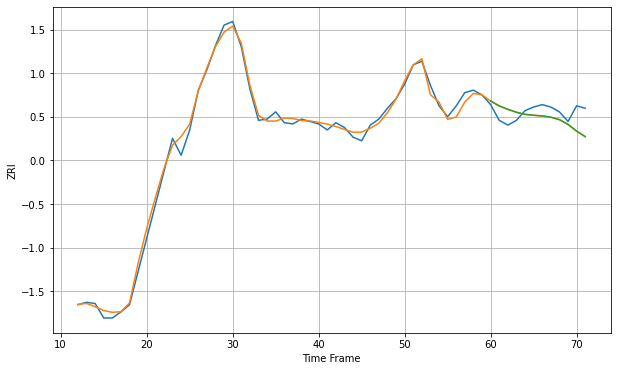

Wall time: 18.5 s
12047 4.74874386145964 11.655363040238816 11.616333060522967 [1134.00103646 1129.94058572 1127.10407606 1124.66451054 1122.93918159
 1122.18958899 1121.61602325 1120.61944148 1118.58613681 1114.62850535
 1109.05032237 1104.50829297]

Got an mse at 0.0025 in round 289 and stopped training

60 60 12


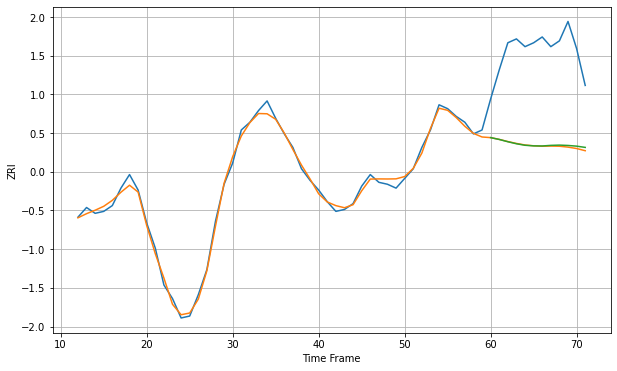

Wall time: 12.3 s
12180 2.389166779709362 49.45836211260041 49.10992174264277 [998.06488105 997.11607579 995.93756095 994.89348155 994.11506572
 993.80684846 993.75545784 994.0641601  994.19687725 994.01984188
 993.66468743 993.01745164]
60 60 12


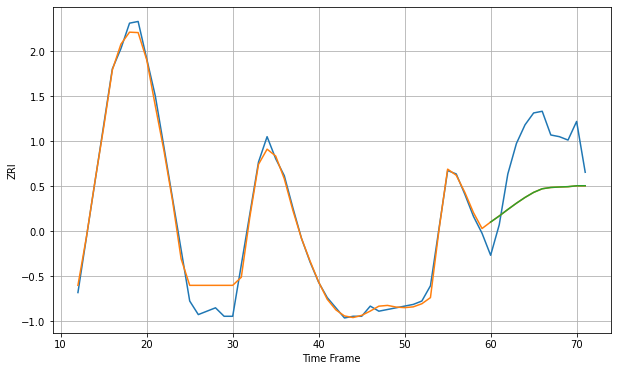

Wall time: 18 s
12182 6.203893247191522 32.05842523434337 32.04687316824032 [ 998.61881447 1002.20290625 1006.03664437 1009.7302719  1013.13631743
 1016.12354277 1018.26436365 1019.02945104 1019.31718216 1019.50438387
 1020.01783881 1020.04406928]

Got an mse at 0.0025 in round 336 and stopped training

60 60 12


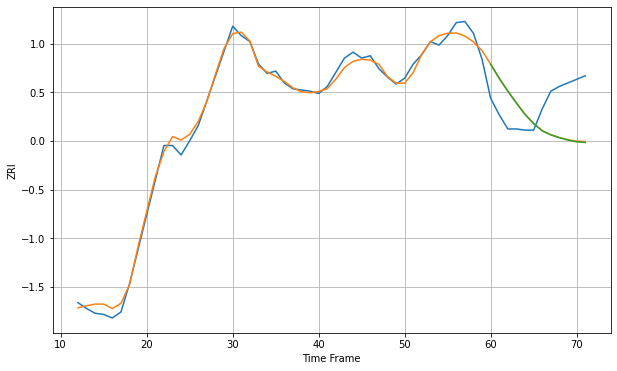

Wall time: 14.6 s
12189 5.289952023304246 35.622627021237406 35.84696584640497 [1124.83310513 1112.87308872 1101.99399055 1091.90914068 1082.2611583
 1074.55587479 1068.44022224 1065.01247465 1062.60043335 1060.56288104
 1059.11168143 1058.55694441]
60 60 12


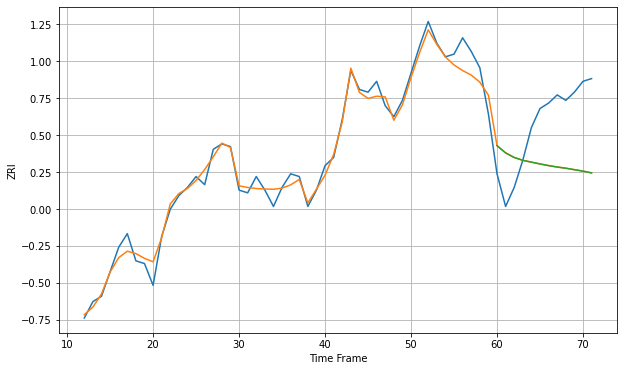

Wall time: 18.6 s
12202 3.754233986455377 22.627190579401258 22.64277010848175 [1091.33047328 1088.68773268 1087.00281414 1085.95872921 1085.29044457
 1084.62295151 1084.01397098 1083.48770579 1083.05357516 1082.50784716
 1081.96984999 1081.30392723]

Got an mse at 0.0025 in round 250 and stopped training

60 60 12


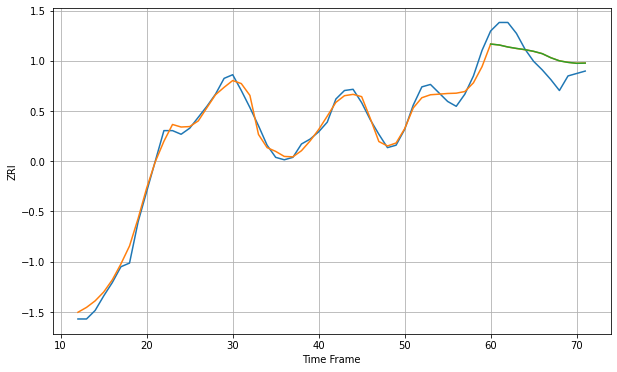

Wall time: 12.1 s
12203 5.717667291349739 14.221709746387248 14.208689821570989 [1303.24151516 1302.46720234 1300.83538505 1299.64723143 1298.63728506
 1297.26543913 1295.34131424 1291.99642954 1289.41961628 1288.15195232
 1287.38034687 1287.55782915]

Got an mse at 0.0025 in round 143 and stopped training

60 60 12


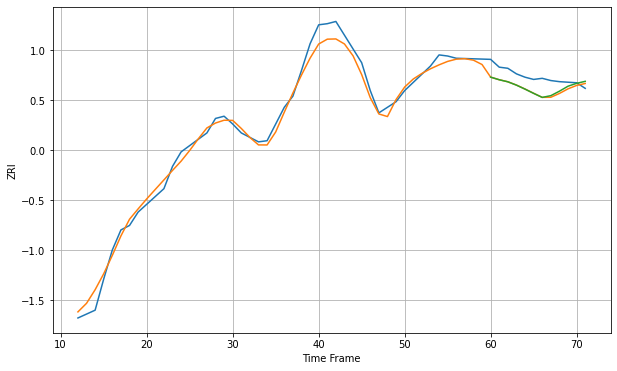

Wall time: 9.62 s
12206 7.04084993662171 11.489344837904353 11.19625718057285 [1221.06440086 1218.70832357 1216.87244362 1213.88379328 1210.30011842
 1206.49891126 1202.88089501 1204.44781696 1208.4419162  1212.91472156
 1215.50353134 1217.29141895]

Got an mse at 0.0024 in round 393 and stopped training

60 60 12


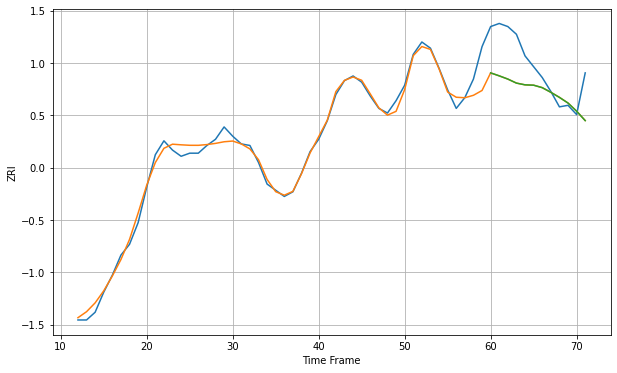

Wall time: 15.1 s
12208 5.546228348391637 21.87800609525142 21.88085836931234 [1266.99210078 1265.07511111 1262.98829746 1260.38929363 1259.25684279
 1259.0342989  1257.43594268 1254.42415743 1251.13661767 1247.46572036
 1242.16853111 1236.08968685]

Got an mse at 0.0025 in round 294 and stopped training

60 60 12


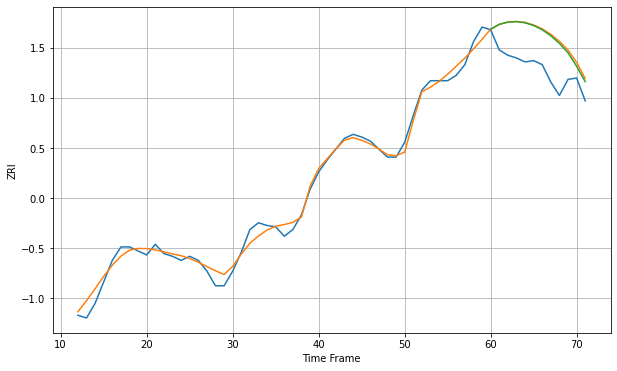

Wall time: 13.6 s
12209 5.232358124912574 25.495968202789822 24.672734321183224 [1195.47413719 1199.03166326 1200.69722915 1201.06346133 1200.25550869
 1198.18072117 1195.04741662 1190.52345457 1184.88084571 1177.87521001
 1167.74726299 1156.32488129]

Got an mse at 0.0025 in round 493 and stopped training

60 60 12


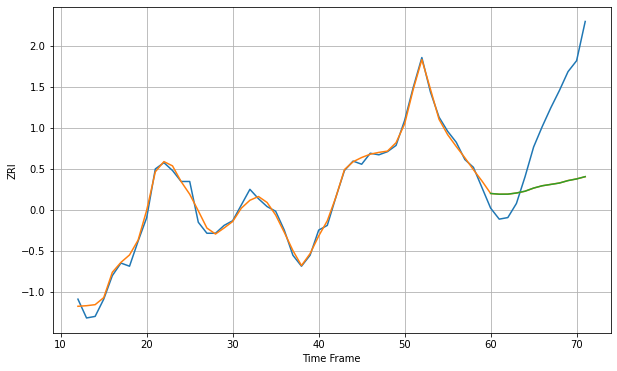

Wall time: 18.8 s
12210 3.348716592671474 49.12010500609623 49.120644700282234 [1050.35987584 1049.89737649 1049.93853326 1050.66868648 1051.80778064
 1053.80563571 1055.27176757 1056.12705403 1057.00975425 1058.56385918
 1059.62510581 1061.10176741]

Got an mse at 0.0025 in round 336 and stopped training

60 60 12


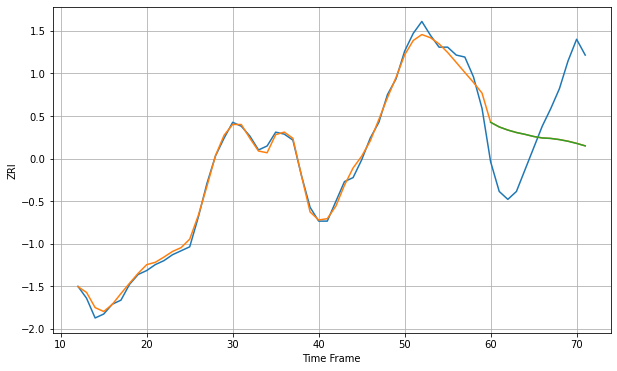

Wall time: 14 s
12303 2.7863880756886537 30.805193885887974 30.827825117190653 [1012.97926418 1010.64382656 1009.06514526 1007.82192746 1006.88887212
 1005.81880348 1005.07591579 1004.82888407 1004.22541664 1003.39165943
 1002.30008553 1001.05677166]

Got an mse at 0.0024 in round 486 and stopped training

60 60 12


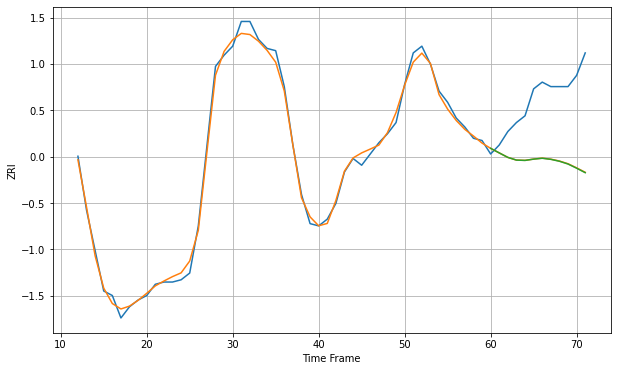

Wall time: 18.8 s
12304 2.6342658589622525 29.978442808549477 30.06152367558451 [1018.51767232 1016.48505044 1014.48835787 1013.28268687 1013.14495824
 1013.71086004 1014.10185654 1013.61779084 1012.76824195 1011.53536925
 1009.67298812 1007.68344093]

Got an mse at 0.0025 in round 349 and stopped training

60 60 12


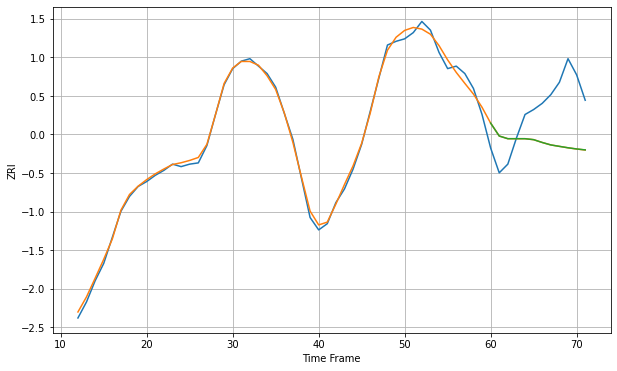

Wall time: 14.7 s
12306 3.4046339604206133 39.085001055088824 39.059777200246344 [1057.08460679 1046.66821757 1044.50241324 1044.50241324 1044.50241324
 1043.72858111 1041.46056333 1039.48629719 1038.32729773 1037.19435881
 1036.2416023  1035.48419029]
60 60 12


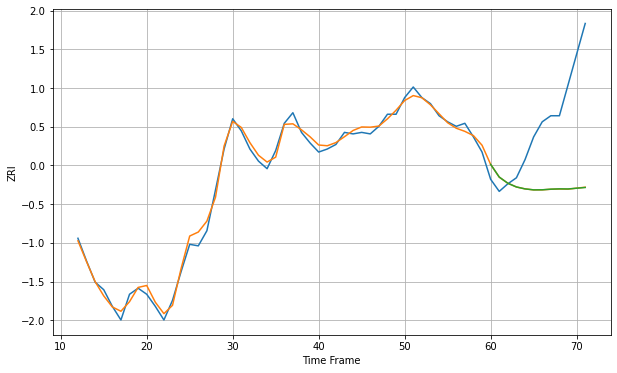

Wall time: 18.5 s
12307 3.722312675826918 52.3204207188158 52.32761293835414 [945.87203635 937.48063395 933.37509119 930.92560716 929.65111796
 928.99570095 929.0430557  929.47217677 929.66766413 929.60457608
 930.10188744 930.58119672]
60 60 12


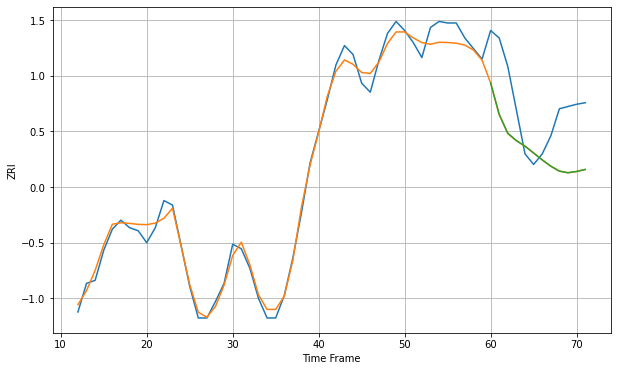

Wall time: 18.9 s
12401 6.271811359520317 34.56453965958579 34.500498068372835 [1407.08874897 1386.26171553 1373.70319706 1368.81877416 1365.14771321
 1360.59613239 1356.01679908 1351.82143088 1348.55849943 1347.48022305
 1348.33094309 1349.69367179]

Got an mse at 0.0025 in round 136 and stopped training

60 60 12


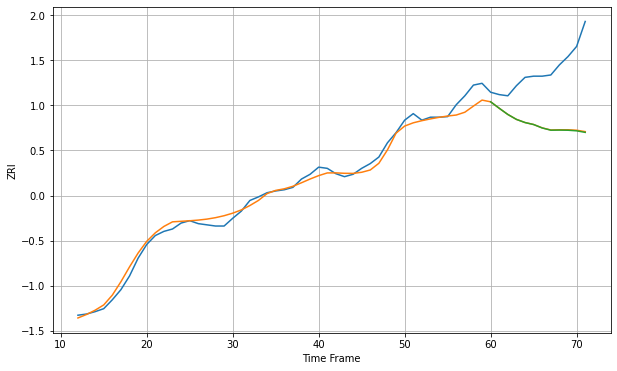

Wall time: 9.39 s
12508 11.157337994285966 97.77126165539764 98.2742225215034 [1566.88090307 1556.02476229 1545.60377411 1537.31384884 1532.01971486
 1528.66219964 1522.90560662 1519.15452009 1519.33371783 1519.08114708
 1518.08050164 1515.48226192]

Got an mse at 0.0025 in round 334 and stopped training

60 60 12


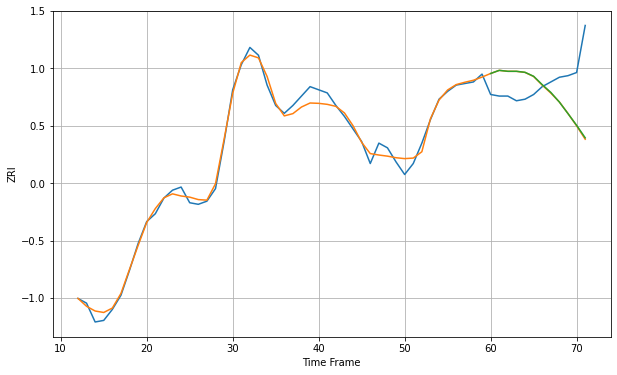

Wall time: 14 s
12550 4.182771694064277 27.032701786617686 26.80644604040675 [1415.38810505 1417.38340375 1416.78423521 1416.78496262 1416.13648966
 1413.6099585  1408.27204707 1403.32571688 1397.1359387  1389.7913648
 1382.35608978 1374.38227392]

Got an mse at 0.0025 in round 143 and stopped training

60 60 12


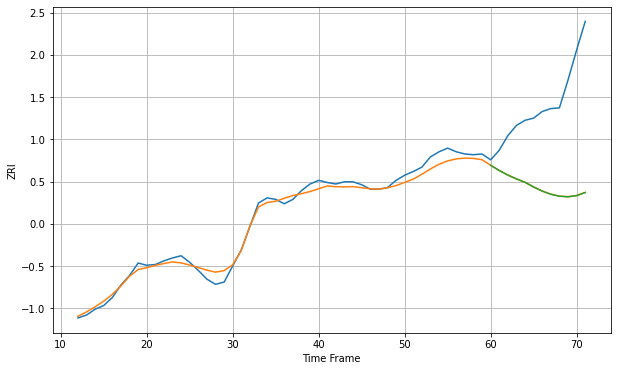

Wall time: 9.26 s
12590 7.922568976380767 123.97742033850766 124.07707441667525 [1482.53324632 1475.46244587 1469.19009532 1463.97527622 1459.33048856
 1452.91301619 1447.27610168 1442.96457257 1440.28711617 1439.50015959
 1441.16708246 1445.3047566 ]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


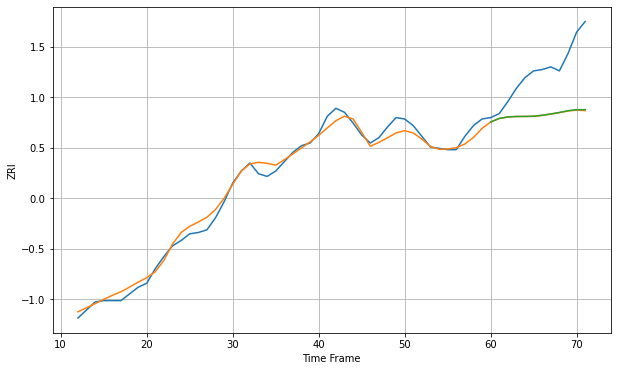

Wall time: 12.5 s
12601 5.197884823519361 36.20062085929107 35.99516422121372 [1243.72509212 1246.38679932 1247.49823662 1247.86698746 1247.89841218
 1248.03231859 1248.77163746 1249.75622997 1250.87197599 1252.18467998
 1252.95288888 1252.97603005]

Got an mse at 0.0025 in round 146 and stopped training

60 60 12


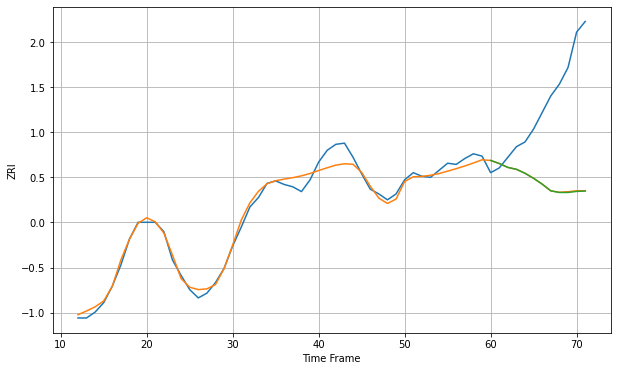

Wall time: 10.2 s
12603 5.986612653723646 77.01433927406676 77.2200358538457 [1400.35874271 1397.76696404 1394.45689163 1392.84276933 1389.49459345
 1385.19910316 1380.288209   1374.65326938 1373.22852472 1373.23915438
 1374.14887536 1374.4375631 ]

Got an mse at 0.0025 in round 323 and stopped training

60 60 12


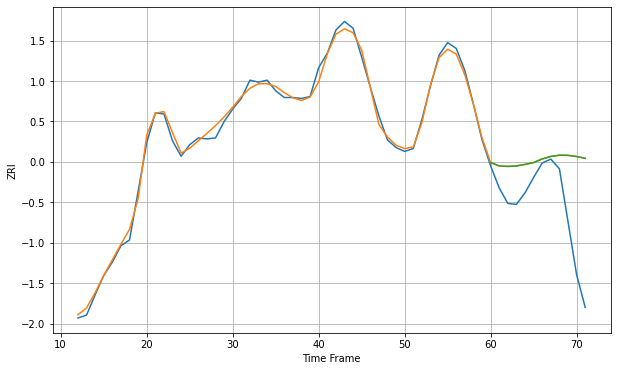

Wall time: 14.4 s
12866 5.390583775329071 63.709805832974496 63.7327331292689 [1687.42900398 1683.97927831 1683.40520664 1683.93593206 1685.51802283
 1687.44580878 1691.20818441 1693.82387737 1695.06636106 1694.93300305
 1693.70862805 1691.88735519]
60 60 12


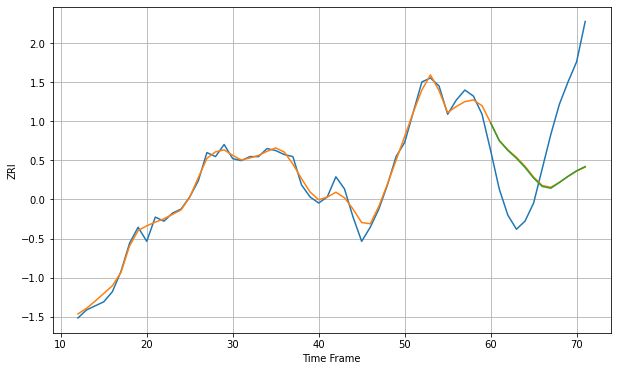

Wall time: 18.1 s
13203 3.08921287001736 37.189590250663535 37.04791462333333 [899.780656   890.92660897 886.10851388 882.18050508 877.64904217
 872.33879797 868.21541229 867.31621841 870.17782364 873.22122265
 875.97754038 878.06871375]

Got an mse at 0.0025 in round 351 and stopped training

60 60 12


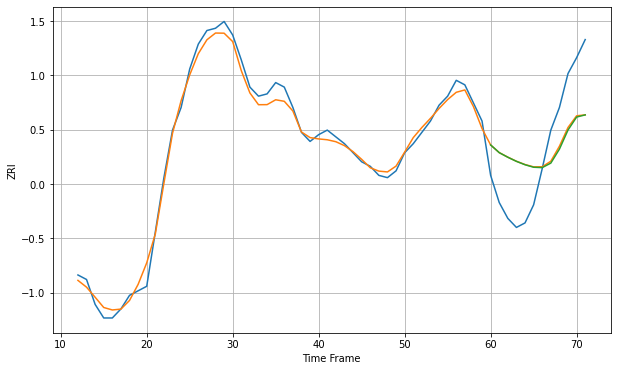

Wall time: 15.2 s
13204 3.4042208401133296 22.39388399372148 22.645857327370358 [892.44705347 889.03965522 887.00794084 885.19107518 883.70024608
 882.59018529 882.42744648 884.422171   890.59158717 899.0358066
 904.76414985 905.72737299]
60 60 12


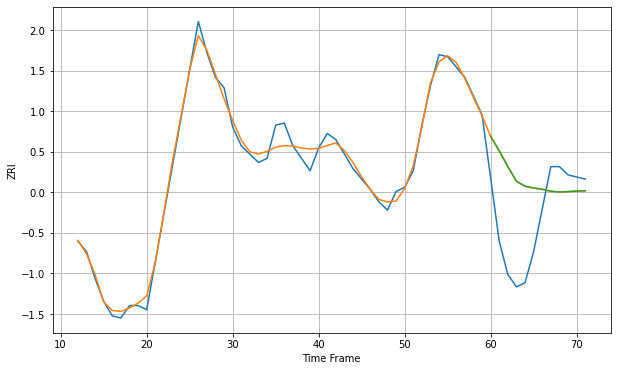

Wall time: 18.3 s
13205 3.7606305937204625 30.612329116561167 30.598521643548125 [923.61835838 916.58465365 909.00907865 901.93712439 899.52606232
 898.67405793 898.06142432 897.10349837 896.74131286 896.95875128
 897.18452574 897.39452333]

Got an mse at 0.0025 in round 431 and stopped training

60 60 12


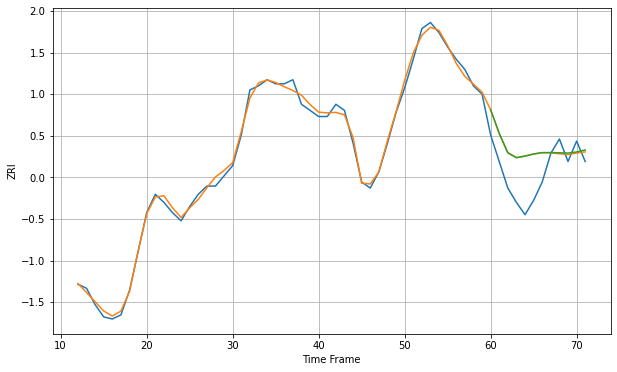

Wall time: 16.5 s
13206 2.3036489412506707 15.233093892023614 15.214332160090065 [895.28904183 883.75312239 874.25948691 871.84991092 872.63116391
 873.65974049 874.35306418 874.377401   874.26299677 874.13939777
 874.67718264 875.65852782]

Got an mse at 0.0024 in round 442 and stopped training

60 60 12


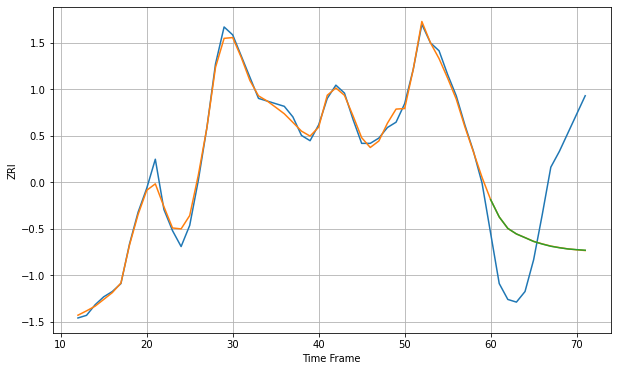

Wall time: 16.8 s
13208 2.3488212925800416 32.854716458281565 32.84423545926532 [870.73906636 864.17746205 859.84762579 857.75730095 856.35861726
 854.92654535 853.95136104 853.11125741 852.54796401 852.08608597
 851.82028287 851.60395765]
60 60 12


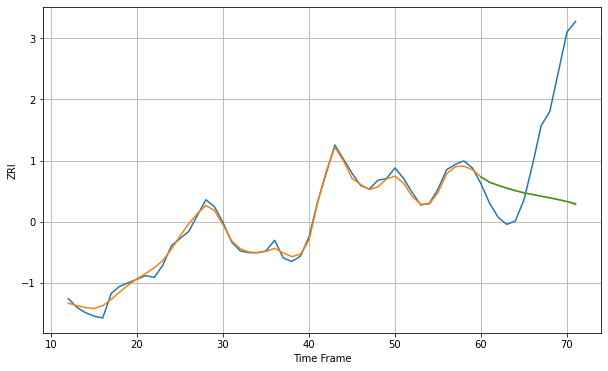

Wall time: 18.8 s
13440 2.553852310067909 50.622872357519086 50.513404309166376 [745.85419071 742.89534793 741.12807804 739.54652234 738.09930831
 736.87408131 735.95578457 734.95043036 734.06666929 733.06603904
 731.98972432 730.79575325]
60 60 12


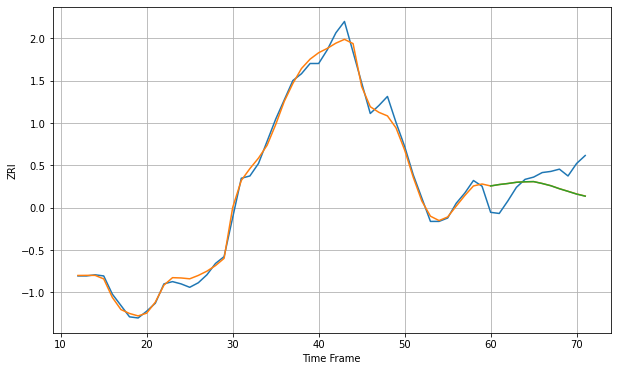

Wall time: 18.3 s
13501 5.368898803079174 18.67456507071122 18.709267762153033 [833.21222694 834.46052147 835.35968029 836.44182283 836.8739358
 837.03134131 835.3683626  833.41565772 830.76760018 828.45538489
 826.0670642  824.21529017]

Got an mse at 0.0025 in round 279 and stopped training

60 60 12


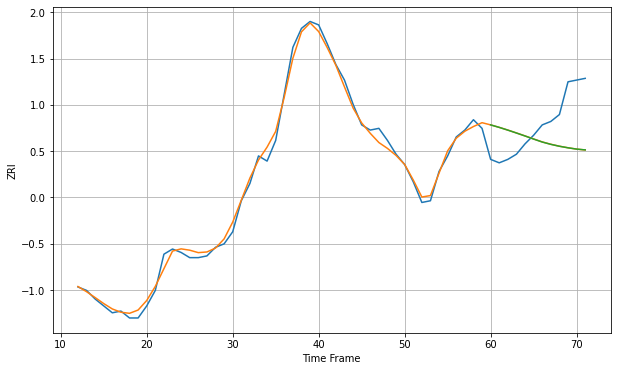

Wall time: 13 s
13502 3.3864033691233115 23.61896262610171 23.61520275912163 [825.00530762 823.55658405 821.9739725  820.29496878 818.56894018
 816.78329033 815.06628213 813.71782034 812.60445892 811.71392311
 810.96071455 810.50520422]
60 60 12


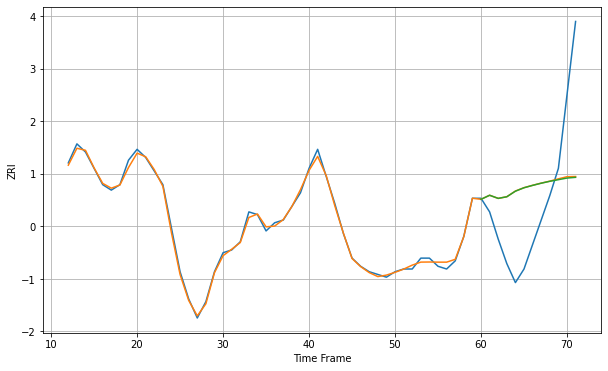

Wall time: 18.9 s
13601 1.0749710096975258 25.40654908015204 25.501941930940333 [849.62322411 851.11272002 849.96341576 850.55843468 852.60922899
 853.8703928  854.73984506 855.54008044 856.24245209 856.8400004
 857.43487331 857.70366919]
60 60 12


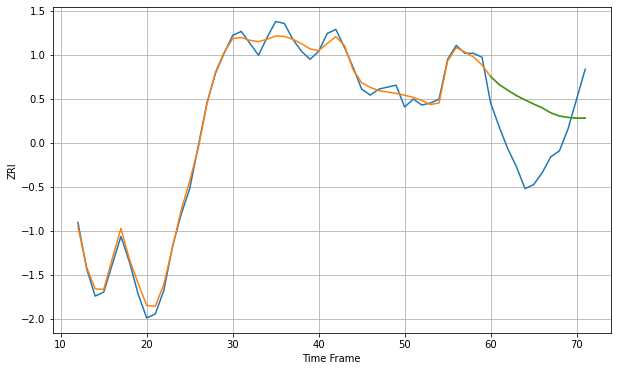

Wall time: 18.2 s
13760 3.2835396125625267 27.36187240089869 27.369187587150286 [885.34041477 881.26977835 878.45531611 875.75864024 873.59125765
 871.50764425 869.58162121 867.06551445 865.46051211 864.77016857
 864.36188128 864.43484413]

Got an mse at 0.0024 in round 417 and stopped training

60 60 12


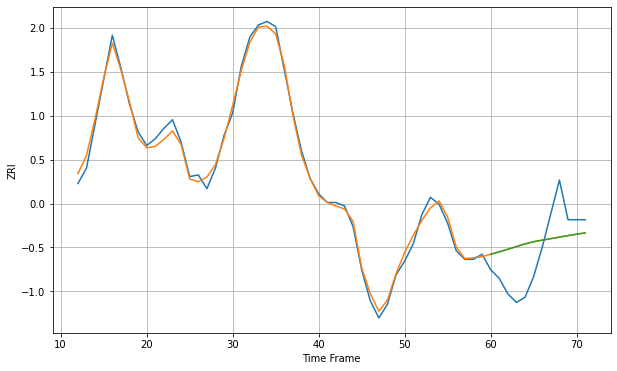

Wall time: 16.4 s
13903 3.430622535222424 20.295187670758615 20.283990999330687 [834.9536391  836.36946301 837.86062122 839.41001478 840.95717529
 842.24839249 843.15130054 844.01087823 844.93480391 845.8064089
 846.62548144 847.36843796]
60 60 12


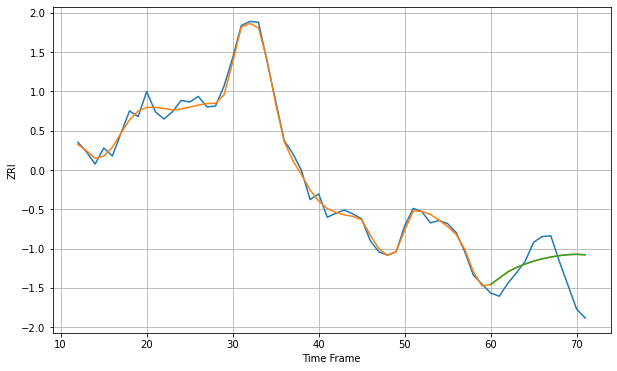

Wall time: 18.7 s
14020 6.939751582007921 35.52841184220169 35.534081275399416 [1209.52610786 1217.40505007 1225.19627382 1230.6640278  1234.88539708
 1238.60045656 1241.38318087 1243.66084798 1245.38585881 1246.56048647
 1247.01610681 1246.4238559 ]

Got an mse at 0.0025 in round 323 and stopped training

60 60 12


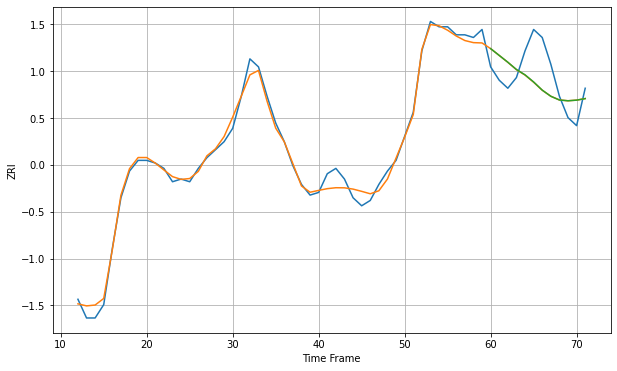

Wall time: 14.1 s
14043 2.6071018639631762 10.761019664803317 10.736434813729435 [963.82732219 961.28244161 958.73934122 956.01824742 954.02374725
 951.35305161 948.30233625 945.99676245 944.59539829 944.30738626
 944.54336184 945.12332502]
60 60 12


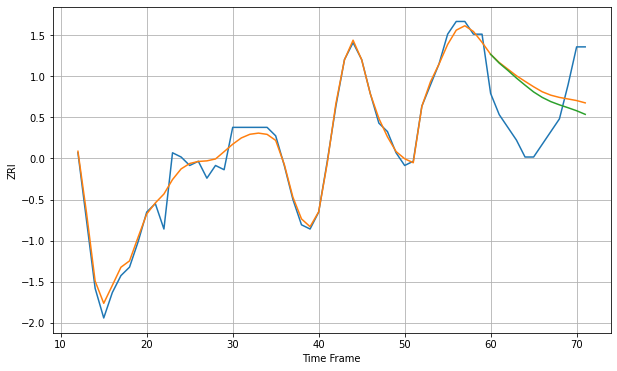

Wall time: 17.9 s
14150 2.224551554922082 12.418507213549903 12.404186494740292 [893.24803628 891.16712542 889.45482424 887.64093729 885.97138605
 884.35999039 883.07577908 882.07553593 881.31670941 880.63782256
 879.92357888 879.07309406]
60 60 12


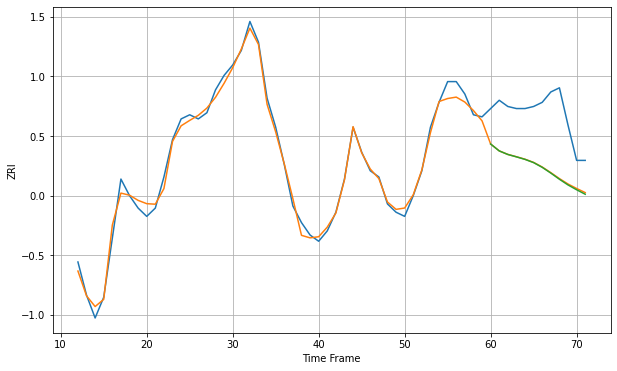

Wall time: 18.7 s
14201 3.349614262509878 27.267177415184953 27.47640057739473 [922.89871685 919.56490717 917.84956527 916.7044981  915.48408846
 913.91763793 911.64732152 908.87390376 905.90774799 903.15994564
 900.83718025 898.67537487]

Got an mse at 0.0025 in round 418 and stopped training

60 60 12


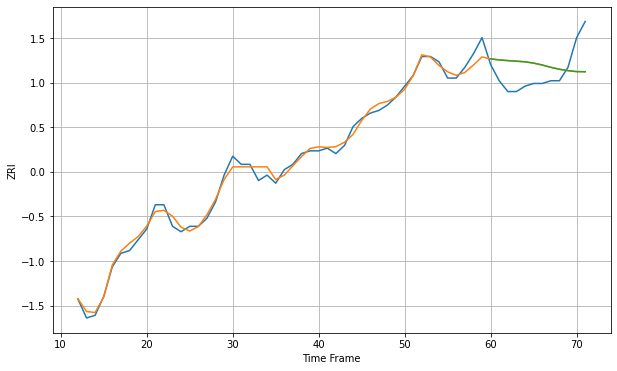

Wall time: 16.9 s
14206 2.1703926589151536 9.397462324061971 9.395370556386931 [810.12615313 809.73140484 809.47891829 809.25947301 809.03467894
 808.54383629 807.85318259 806.978908   806.27170231 805.75129791
 805.39580536 805.35927944]

Got an mse at 0.0025 in round 413 and stopped training

60 60 12


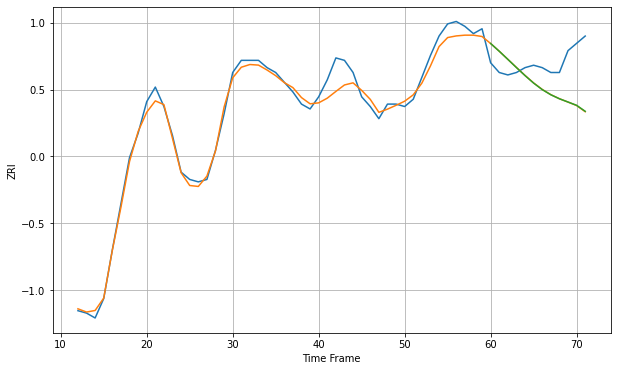

Wall time: 16.8 s
14207 3.7307667419032287 14.71940068732063 14.686922990699276 [820.93485176 817.75614586 814.41234375 811.04058081 807.7375495
 804.64082112 801.97456911 799.84332018 798.19121412 796.8499
 795.49154237 793.03853815]

Got an mse at 0.0024 in round 149 and stopped training

60 60 12


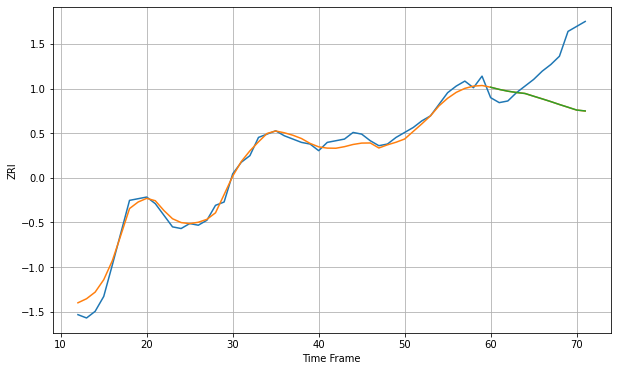

Wall time: 9.8 s
14208 4.186706024530688 28.07910567822212 28.0613911357049 [810.29756945 808.98318916 807.91312035 807.12765915 806.51933419
 804.87521769 803.27594715 801.6255886  799.87489581 798.22232655
 796.53865672 795.98316899]
60 60 12


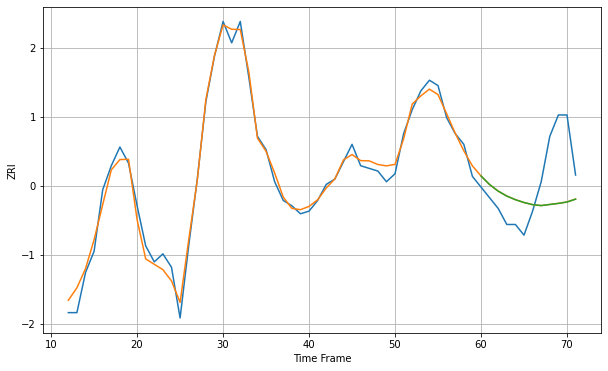

Wall time: 18.8 s
14209 3.3468454799395397 16.845458997757465 16.852889413355552 [1045.15729941 1041.94376285 1039.4817951  1037.63920382 1036.28343745
 1035.22458398 1034.42827414 1034.07550601 1034.48765515 1034.89212138
 1035.41450245 1036.48243191]

Got an mse at 0.0024 in round 177 and stopped training

60 60 12


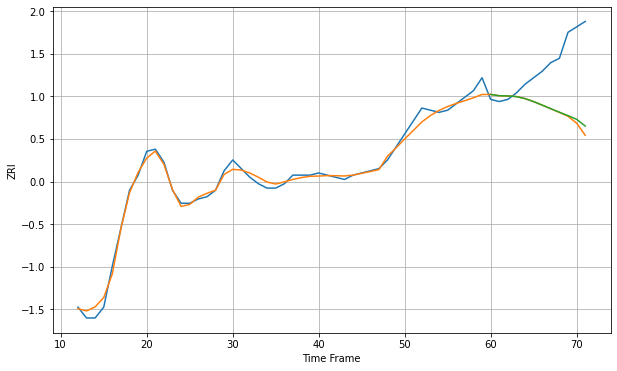

Wall time: 10.9 s
14210 2.502672008145403 25.435398669867602 24.40241990564112 [790.2924062  789.69049829 789.60472187 789.28480219 788.36096097
 786.97551367 785.35186616 783.68705715 782.07572488 780.48674807
 778.79102855 775.68376925]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


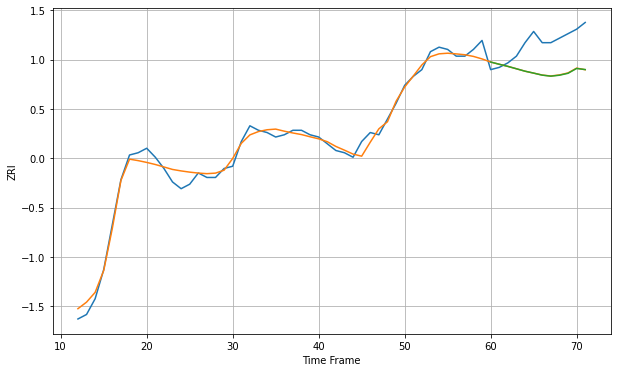

Wall time: 11.5 s
14211 3.1908366210923185 13.83061106472003 13.879566784035525 [787.38525781 786.39485853 785.45234877 784.38655328 783.30486833
 782.45070117 781.54948902 781.09009007 781.51048514 782.36887677
 784.52123001 784.02946506]

Got an mse at 0.0024 in round 343 and stopped training

60 60 12


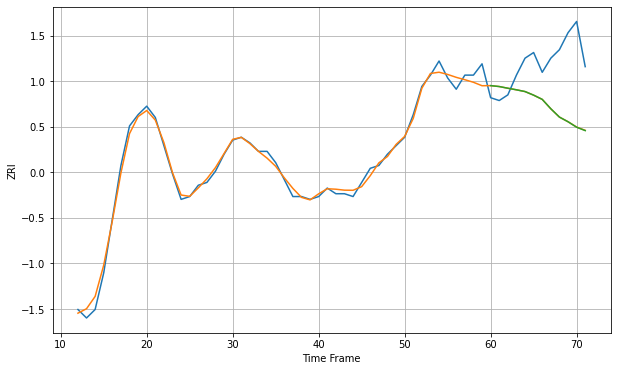

Wall time: 14.9 s
14212 2.1001962695454863 18.985645933597095 19.001768679330144 [778.27653667 777.95621339 777.35809521 776.80336011 776.18236683
 774.90737714 773.4165115  770.08435147 767.13798644 765.48933166
 763.55962764 762.3498072 ]

Got an mse at 0.0025 in round 237 and stopped training

60 60 12


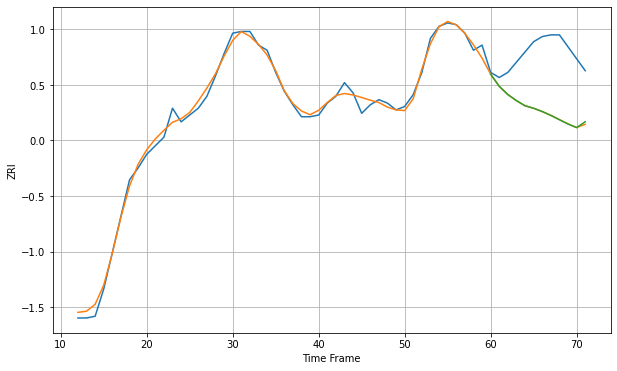

Wall time: 11.5 s
14213 3.3895396357374676 34.775290799713424 34.68266888364109 [863.97006607 856.82657216 852.0109939  848.45225301 845.43568704
 843.97815516 842.03564586 839.78855416 837.25720557 834.73834789
 832.63139959 836.0612621 ]

Got an mse at 0.0025 in round 182 and stopped training

60 60 12


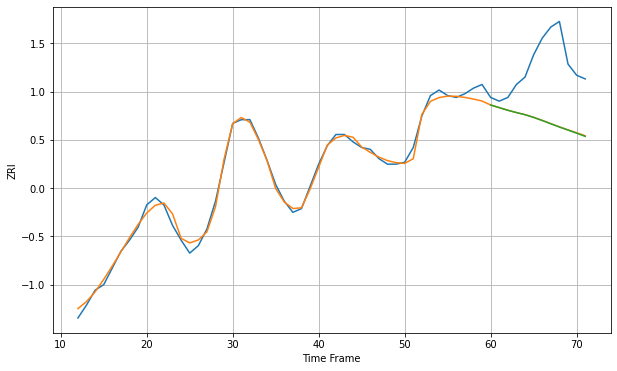

Wall time: 10.2 s
14214 2.859509882926875 32.848353183223104 32.92777856974386 [915.92251254 914.50187711 913.08599625 911.82950899 910.69876817
 909.23316057 907.56953201 905.79497692 904.04017673 902.37987993
 900.73542354 898.99041012]

Got an mse at 0.0025 in round 170 and stopped training

60 60 12


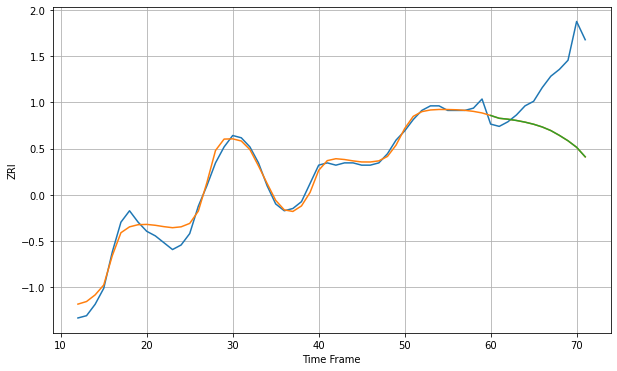

Wall time: 10 s
14215 3.4781820792004563 27.11309748205449 27.10217714716601 [777.78375729 776.55200867 776.1520397  775.58988212 774.86110494
 773.94151196 772.74556447 771.16826789 769.04740746 766.69156731
 763.83979677 759.66895125]

Got an mse at 0.0025 in round 173 and stopped training

60 60 12


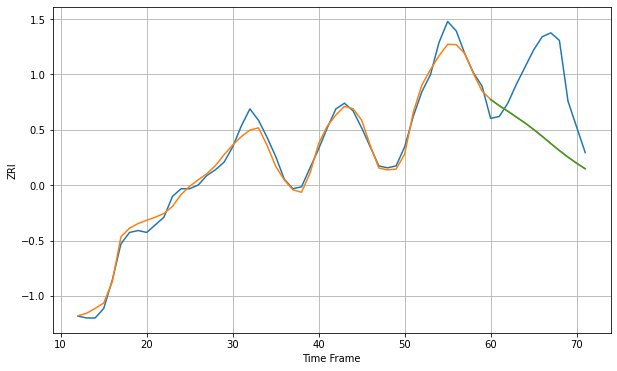

Wall time: 10.2 s
14216 4.006686764547508 33.98790917428432 33.97855640002021 [1035.93452859 1032.70074258 1029.77834063 1026.67750829 1023.58922812
 1020.18390808 1016.55955148 1012.75825062 1009.09291466 1005.6568909
 1002.43784656  999.50719405]
60 60 12


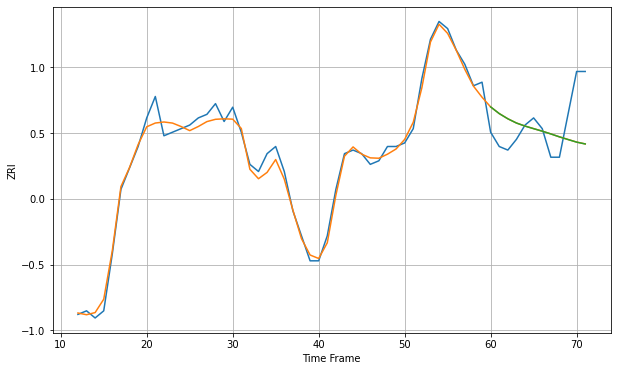

Wall time: 18.7 s
14217 2.277467980464557 9.868384012956275 9.87218795599999 [891.08227317 889.21305383 887.75615309 886.57157566 885.71436363
 884.99347208 884.29164951 883.51727154 882.6966415  881.95517028
 881.22424527 880.71075523]

Got an mse at 0.0025 in round 282 and stopped training

60 60 12


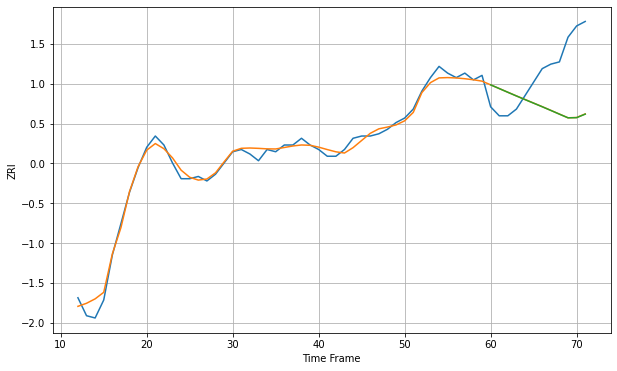

Wall time: 13.3 s
14218 2.5847899455061794 23.040268252093234 23.07204258003612 [824.78535451 823.13151467 821.47504996 819.83295642 818.2243201
 816.6298569  815.03733757 813.39765535 811.73655337 810.1033218
 810.18198452 811.74297712]

Got an mse at 0.0024 in round 219 and stopped training

60 60 12


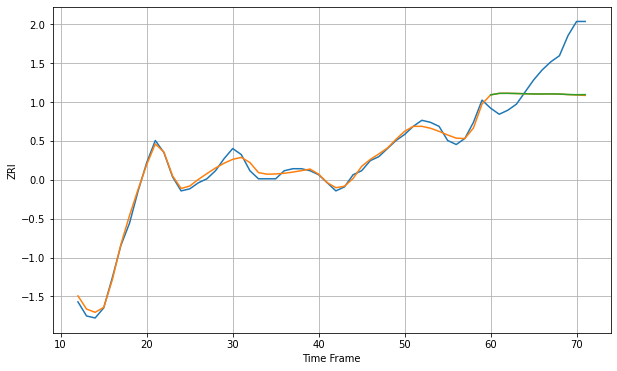

Wall time: 11.5 s
14220 2.0943671089788363 19.547999477095928 19.45219970102802 [814.60998899 815.35226323 815.37041513 815.2733835  815.1631793
 815.05409967 815.03818728 815.07503694 815.02380063 814.79789963
 814.68630825 814.74058856]
60 60 12


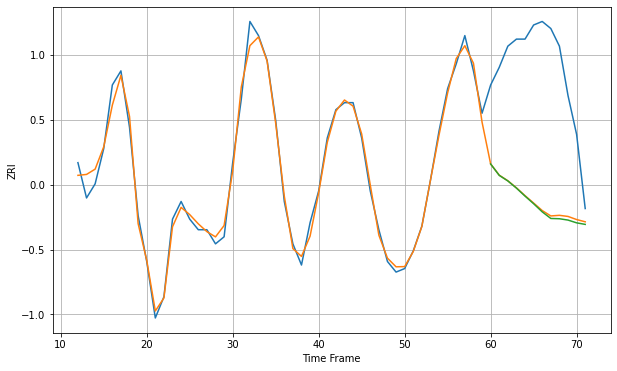

Wall time: 19.4 s
14221 2.422361916048519 39.713201596372414 40.107359042934405 [1123.62795422 1120.39879123 1118.8229583  1116.79267804 1114.52895867
 1112.36843004 1110.06284132 1108.19028801 1108.1120076  1107.73301147
 1106.95089247 1106.51330985]

Got an mse at 0.0025 in round 419 and stopped training

60 60 12


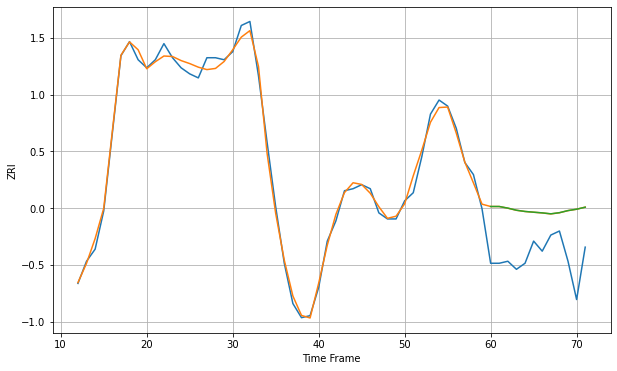

Wall time: 16.5 s
14222 3.3837480559111874 25.148075225136807 25.16767719426772 [1086.16910982 1086.16910982 1085.37305139 1084.32712178 1083.71608801
 1083.35181395 1083.0110661  1082.5464566  1083.09728089 1084.15018739
 1084.83020638 1085.83301087]
60 60 12


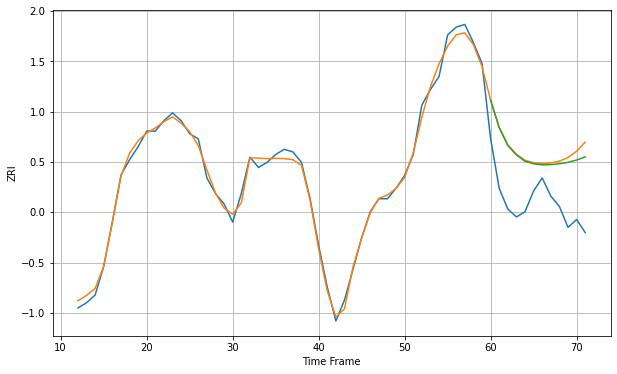

Wall time: 18.1 s
14224 2.181639618891282 21.573690554151916 20.109888411681393 [963.89417134 953.3088844  946.43916103 942.84587276 940.41401956
 939.41364287 939.04193742 939.11314616 939.44830228 940.00941573
 940.86758739 942.07595295]

Got an mse at 0.0024 in round 414 and stopped training

60 60 12


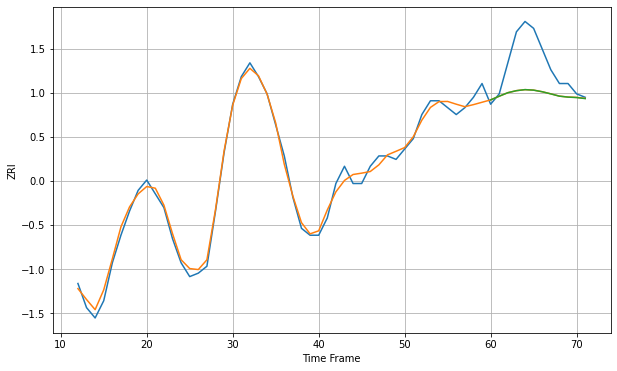

Wall time: 16.6 s
14225 1.9306614730902558 10.456428646038319 10.461594636801754 [860.25397941 861.32618044 862.33951534 862.92781066 863.22815366
 863.07945601 862.61268046 861.99462936 861.3316616  861.05982065
 860.93227163 860.63266386]
60 60 12


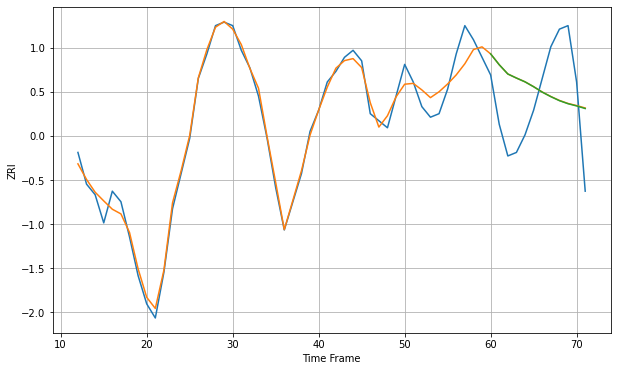

Wall time: 18.4 s
14228 3.091337076314629 16.56915535219475 16.569688249512716 [1098.9774138  1095.89537774 1093.26976237 1092.11656841 1091.03775165
 1089.65469068 1088.12293425 1086.83876178 1085.70173255 1084.83102482
 1084.20119049 1083.46022453]

Got an mse at 0.0025 in round 400 and stopped training

60 60 12


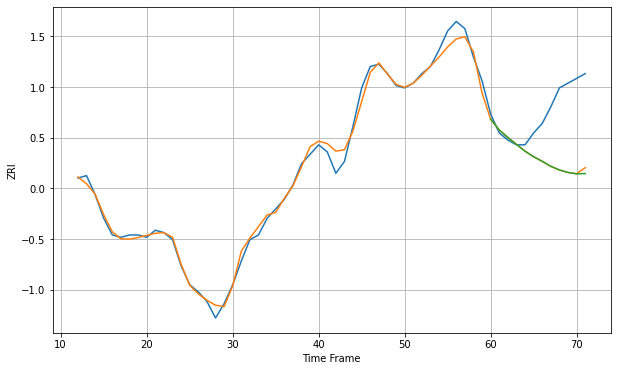

Wall time: 16.1 s
14301 2.970476399238027 23.803965324901483 24.16869436380603 [637.8086289  633.24689273 630.09470157 627.19230859 624.30554655
 621.97863611 620.04223009 617.91983547 616.39050548 615.3489532
 614.73300649 614.88450221]

Got an mse at 0.0024 in round 419 and stopped training

60 60 12


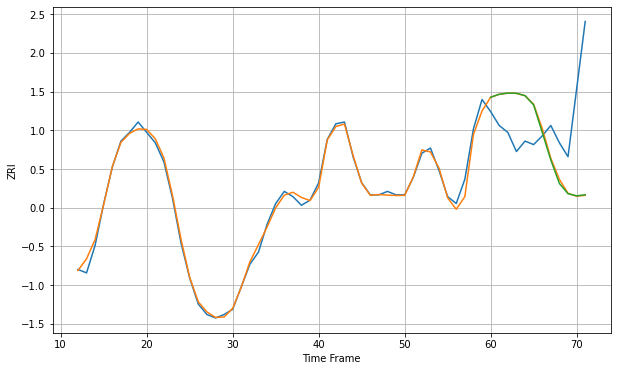

Wall time: 16.7 s
14607 2.7940267699104098 39.14921021670118 39.183946129707216 [1087.28129729 1089.01696936 1089.69607499 1089.59865872 1088.20696203
 1082.86703886 1067.02434436 1051.10877045 1037.53967059 1031.67550779
 1030.4440476  1031.08160707]
60 60 12


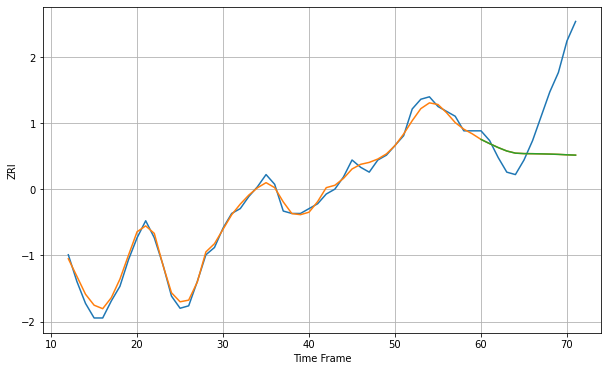

Wall time: 19.7 s
14609 2.2393246729241505 24.95356939196905 24.948757987574695 [828.46097348 826.73821863 825.11860884 823.69980007 822.82158725
 822.63415049 822.5905927  822.52109793 822.43356242 822.31436822
 822.13705882 822.00542738]
60 60 12


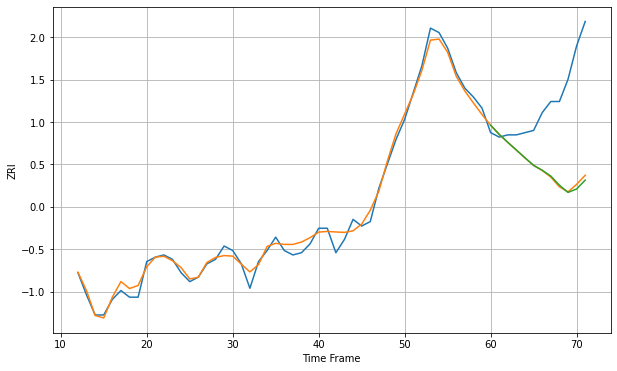

Wall time: 18.4 s
14611 3.1231929090070154 35.32585084967472 35.91456139775058 [871.33513576 867.20228583 863.61449962 860.1423422  856.65002244
 853.26756752 851.06715427 848.46971268 844.36450174 841.11830184
 842.67073791 846.65257563]

Got an mse at 0.0025 in round 356 and stopped training

60 60 12


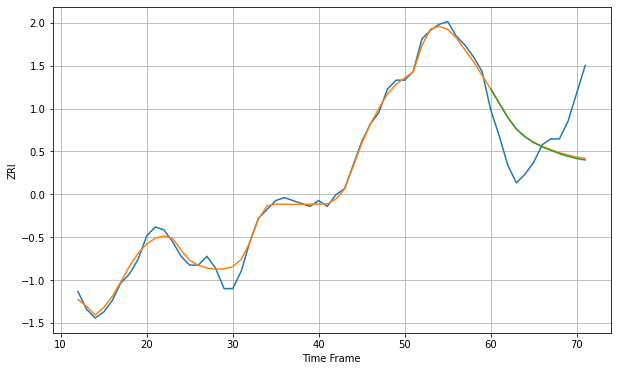

Wall time: 13.4 s
14613 2.219447498759051 14.80717946438519 14.978158170933433 [767.06038724 762.15670271 757.27397026 753.29781547 750.68029299
 748.75298894 747.29622514 746.11433169 744.99950502 744.06713135
 743.31000861 742.80700396]

Got an mse at 0.0025 in round 268 and stopped training

60 60 12


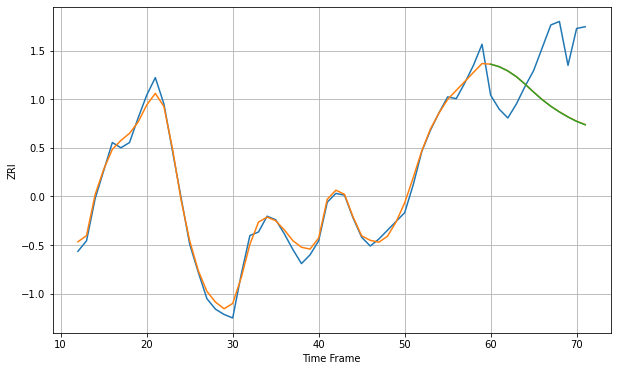

Wall time: 11.3 s
14620 4.029807280155255 34.693023088602025 34.74208557693036 [1092.64835756 1091.21834304 1088.79280786 1085.49917523 1081.29575335
 1076.74424673 1072.43472917 1068.65615298 1065.41795123 1062.54459824
 1060.05487883 1058.11776394]

Got an mse at 0.0025 in round 498 and stopped training

60 60 12


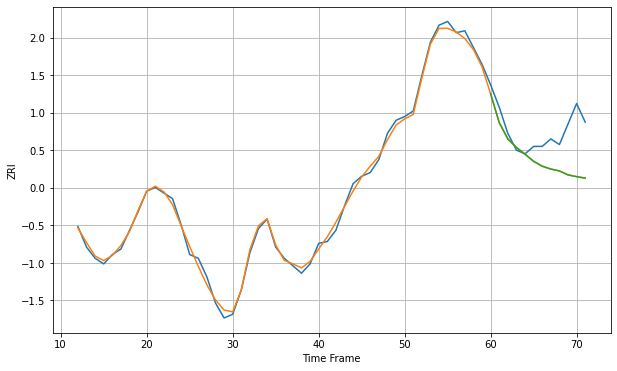

Wall time: 17 s
14621 2.2830752333227515 18.05578534109153 18.09281009046558 [814.13203274 798.76582746 790.00092793 785.43145863 781.82590725
 777.9891607  775.38441089 773.84905892 772.83695477 770.71043652
 769.75114525 768.96463908]

Got an mse at 0.0025 in round 486 and stopped training

60 60 12


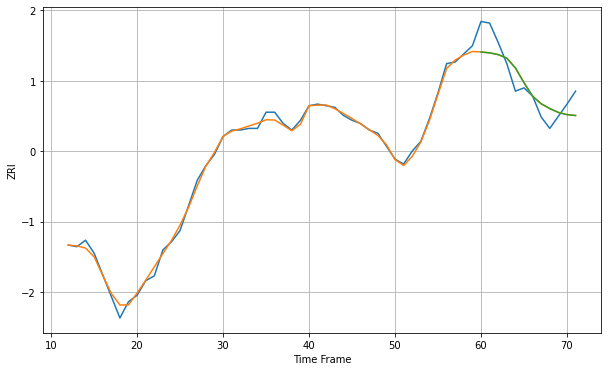

Wall time: 16.9 s
14701 2.3907259748759184 11.048115889741835 11.05797075649516 [668.1605619  667.61976202 666.54597422 664.37567867 658.33514936
 649.22625713 640.88517405 636.18907108 633.2341995  630.83956028
 629.47153208 628.93746572]

Got an mse at 0.0025 in round 396 and stopped training

60 60 12


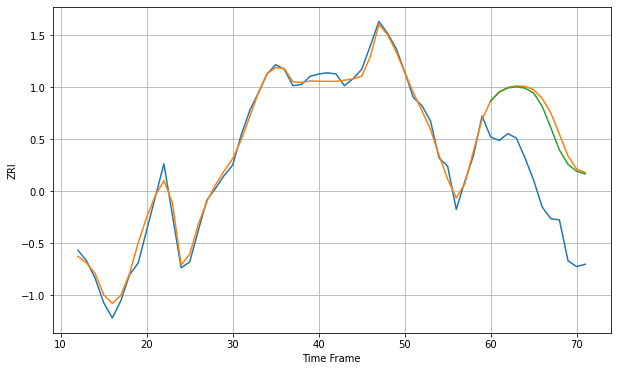

Wall time: 14.1 s
14850 6.23241150591286 70.38480210438624 65.78132817191835 [1575.86913329 1583.52599586 1587.07918877 1588.00912544 1586.87022729
 1582.71679481 1571.2996769  1552.96073777 1533.91156089 1521.61050993
 1515.74961245 1513.43032203]

Got an mse at 0.0025 in round 290 and stopped training

60 60 12


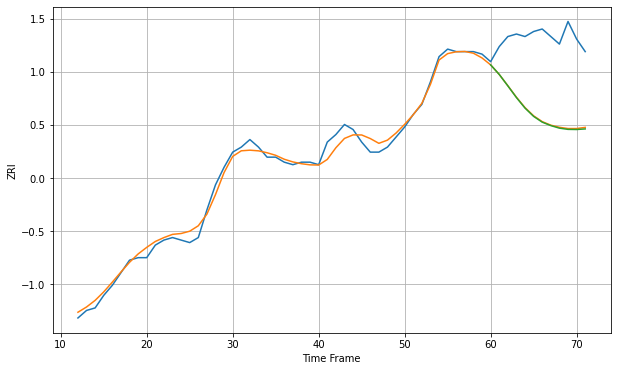

Wall time: 12.4 s
15202 2.618467702878993 29.942410899151056 30.18898231852535 [831.7279998  827.9196361  823.38074633 818.72387092 814.52256611
 811.21989515 808.92571974 807.55652844 806.54254575 806.05669109
 806.00417761 806.23840601]

Got an mse at 0.0025 in round 360 and stopped training

60 60 12


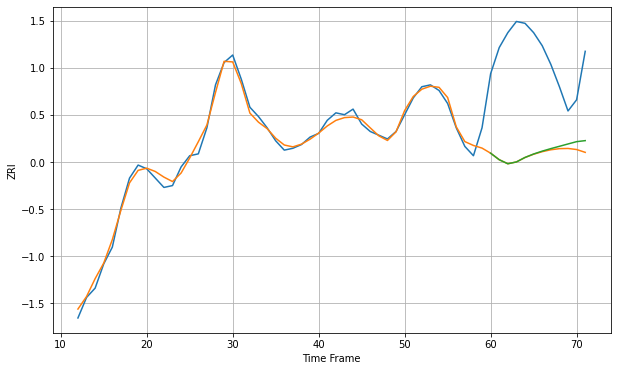

Wall time: 13.3 s
15206 3.180644303425087 54.73891751780684 53.873450865289115 [1051.35740288 1047.85597637 1045.6941287  1046.67528315 1049.08573798
 1050.93168275 1052.46253718 1053.81446487 1055.05461622 1056.30969799
 1057.54962328 1058.09881736]
60 60 12


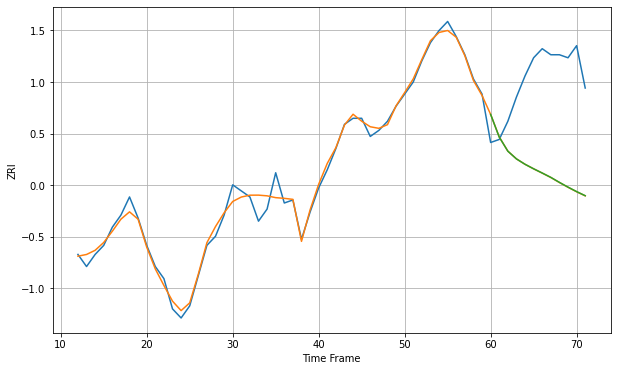

Wall time: 16.6 s
15210 2.5403732631090565 33.3595031261961 33.331784734545145 [871.28899617 863.791897   859.1331753  856.57895328 854.7985869
 853.30588177 851.90797936 850.46681981 848.81421869 847.24755624
 845.76872766 844.41253547]

Got an mse at 0.0025 in round 243 and stopped training

60 60 12


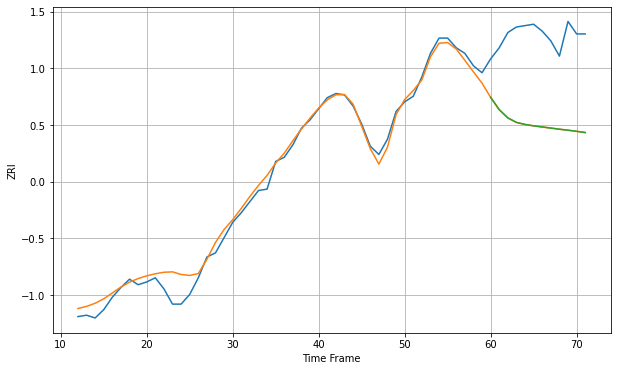

Wall time: 10.5 s
15212 6.709359424509202 64.18738487592199 64.207581714829 [935.23297034 926.32831365 920.39502086 917.14570468 915.6780925
 914.66308397 913.84892421 913.05452934 912.24683262 911.50301346
 910.7151379  909.76131001]

Got an mse at 0.0025 in round 245 and stopped training

60 60 12


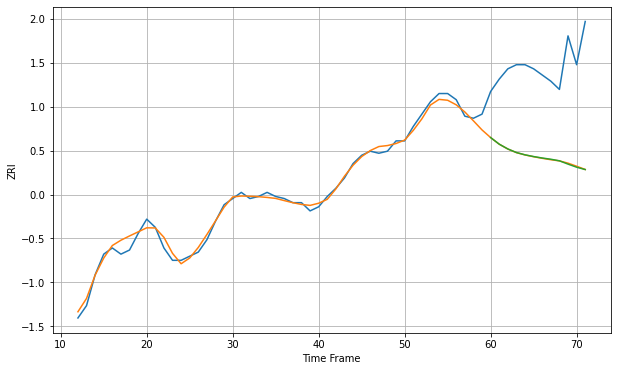

Wall time: 10.7 s
15216 2.664301726210161 44.99765304512696 45.05312364981137 [889.60989143 886.41196785 884.08135527 882.34895229 881.229032
 880.39168442 879.68947764 879.08980197 878.32713246 876.72039965
 875.22911818 874.07692076]
60 60 12


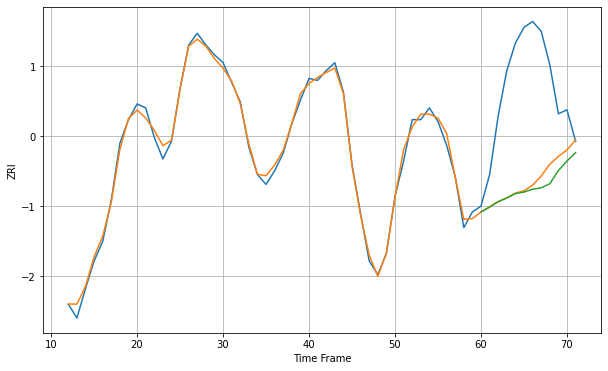

Wall time: 16.8 s
15217 2.873921110968125 54.00623909048554 56.41943190878238 [1180.97525638 1183.52938459 1186.23834247 1188.11575707 1190.35053901
 1191.13682103 1192.54872045 1193.29608883 1195.34984618 1202.06098869
 1206.93522236 1211.14660702]

Got an mse at 0.0023 in round 371 and stopped training

60 60 12


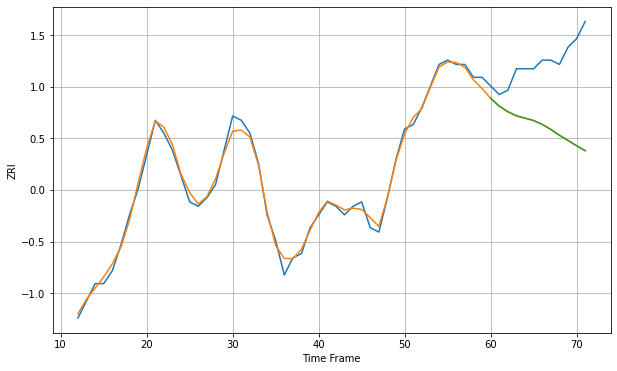

Wall time: 13.6 s
15221 1.333610802394685 16.30419922428065 16.306093723237808 [895.12302311 893.30156802 892.00391332 891.04069849 890.49885353
 889.94349897 889.0469606  887.88392919 886.51757855 885.30200654
 884.06719949 882.91737684]
60 60 12


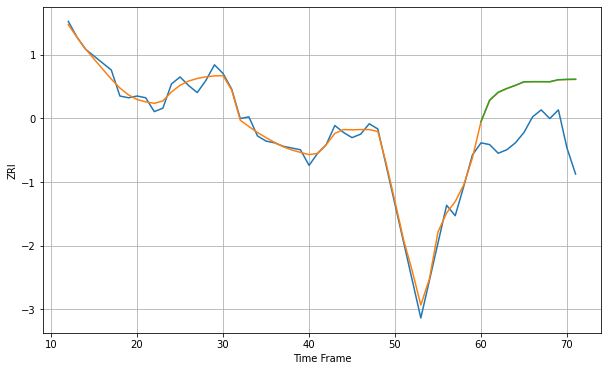

Wall time: 16.3 s
16365 3.6892649963051274 30.51641620342615 30.607022079286605 [868.23393956 880.60699719 885.20393423 887.36956202 889.16248109
 891.19830669 891.2799974  891.28748768 891.25587113 892.41105132
 892.61672309 892.70350805]

Got an mse at 0.0025 in round 397 and stopped training

60 60 12


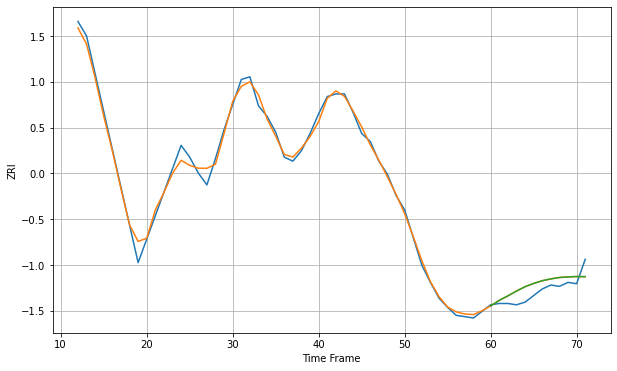

Wall time: 13.9 s
16502 4.60620205872475 7.615421843522854 7.613364675751668 [646.13626353 650.33959254 653.74035124 657.41655341 660.71231851
 663.19134501 665.26868333 666.65266142 667.71844583 668.13754276
 668.45854204 668.33836726]

Got an mse at 0.0025 in round 298 and stopped training

60 60 12


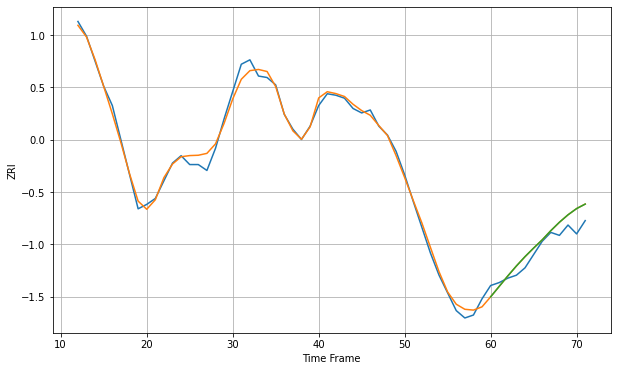

Wall time: 12 s
16503 3.9020368983251323 7.817075848168337 7.816017377678119 [598.33375553 605.430846   612.50990877 619.27574367 625.58065711
 631.39707008 636.96444451 643.18554164 648.88957342 653.93113445
 658.15812247 661.20010425]

Got an mse at 0.0025 in round 405 and stopped training

60 60 12


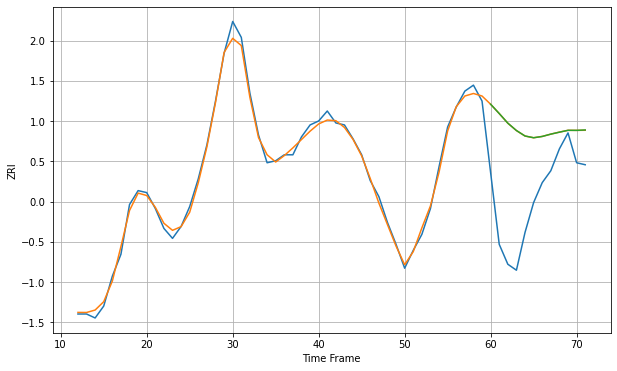

Wall time: 14.5 s
17013 2.6045207715079814 41.20197619617282 41.21751038969302 [1023.4024199  1018.73723477 1013.8981869  1010.1957479  1007.45070184
 1006.57231959 1007.22090846 1008.38095932 1009.36477161 1010.30009952
 1010.27859088 1010.47977526]

Got an mse at 0.0025 in round 205 and stopped training

60 60 12


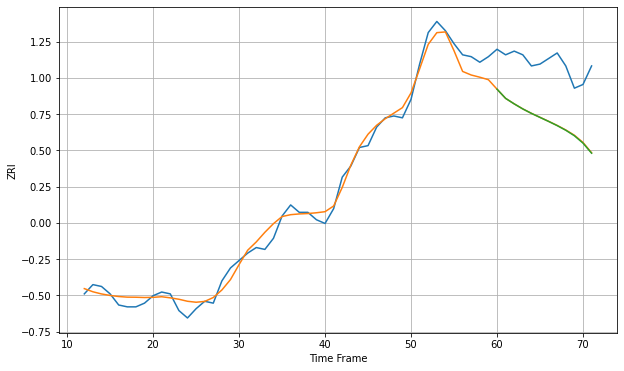

Wall time: 10.1 s
17022 5.00140231909279 31.421230323670084 31.532826607271073 [867.47144532 862.49533053 859.52511639 856.7957431  854.40537771
 852.23176184 850.06528702 847.80222559 845.29236138 842.32730169
 838.3567296  832.92088132]
60 60 12


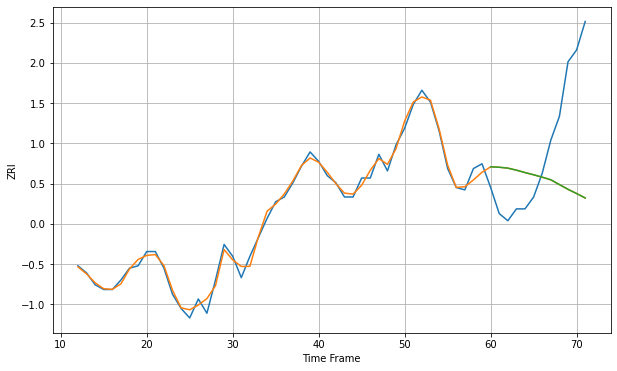

Wall time: 16.3 s
17401 2.262454448238487 35.05712244881974 35.04398100519372 [818.71459251 818.54199567 818.16957445 817.31275207 816.29957896
 815.36814199 814.36901028 813.26529095 811.24446444 809.2450603
 807.46321975 805.59696457]

Got an mse at 0.0025 in round 313 and stopped training

60 60 12


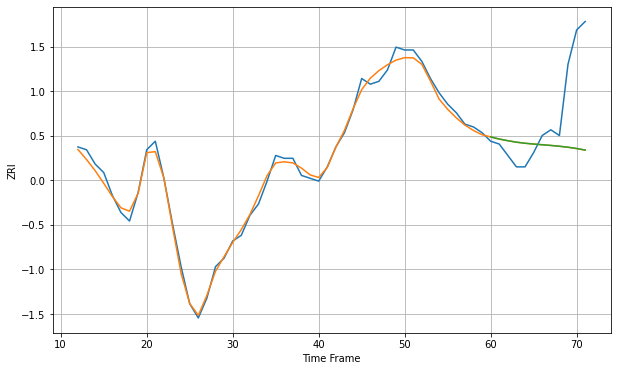

Wall time: 12.3 s
17404 2.032359161853309 20.107530758770714 20.100843198124416 [858.50940569 857.75803358 857.17369784 856.65952555 856.28152935
 856.00419651 855.76066781 855.5148805  855.23114126 854.89373783
 854.4410569  853.89246218]
60 60 12


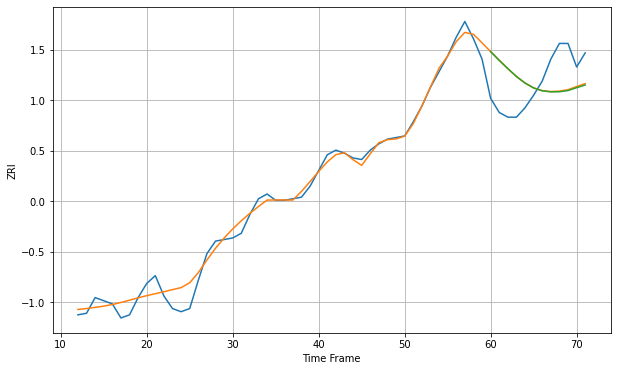

Wall time: 16.8 s
17512 5.7023780275683835 23.60231794486223 23.821183811777253 [1041.77502905 1036.21207709 1030.94524406 1025.92055704 1021.75517599
 1018.62737615 1016.79990632 1016.09545251 1016.19843438 1016.96355434
 1018.78978262 1020.51112623]

Got an mse at 0.0025 in round 432 and stopped training

60 60 12


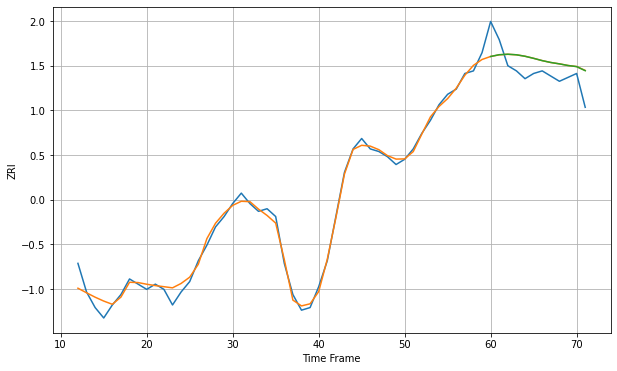

Wall time: 15.2 s
17522 2.4925392383629865 7.626199914162778 7.605895274753529 [856.53702383 857.22190591 857.40484859 857.18964369 856.62096193
 855.8227302  854.94125883 854.22420625 853.69615536 853.06688645
 852.64699358 851.07446941]

Got an mse at 0.0025 in round 351 and stopped training

60 60 12


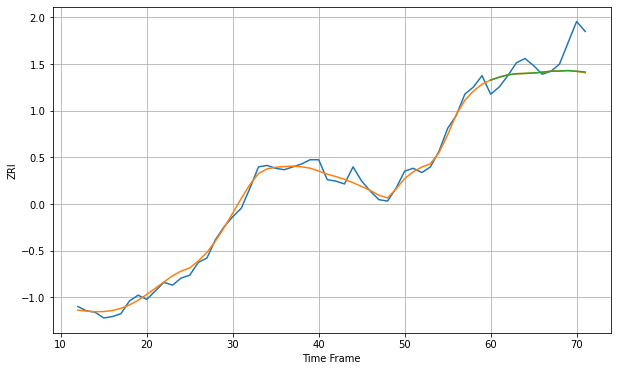

Wall time: 13.3 s
17543 3.8955023868991527 15.30759217004381 15.191175452833821 [1114.87844221 1116.9060892  1118.51132262 1119.31303252 1119.53680492
 1119.87014837 1120.42697397 1121.1053771  1121.23533281 1121.56606978
 1121.10549253 1120.56084399]

Got an mse at 0.0025 in round 269 and stopped training

60 60 12


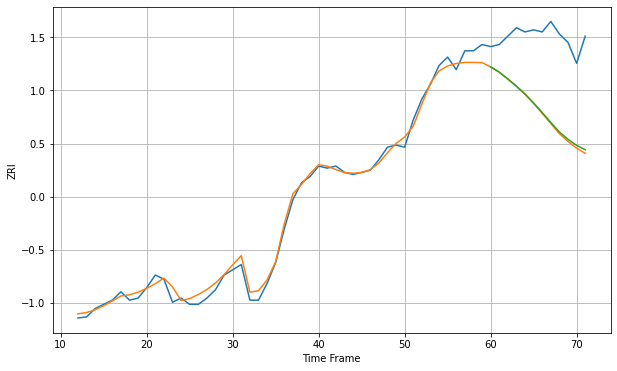

Wall time: 11.4 s
17552 3.0841809137785052 37.35140513327766 36.69023364851833 [970.3297808  967.83124099 964.55269482 961.12937452 957.4013176
 953.11233076 948.52535986 943.82179338 939.23598886 935.75639115
 932.86527262 930.7713585 ]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


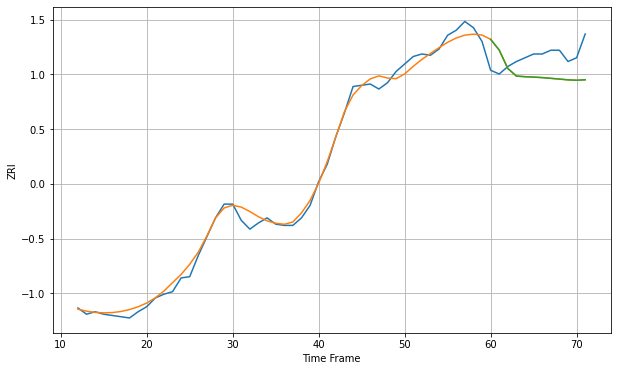

Wall time: 11 s
17602 5.1633588878230645 20.314127946193295 20.319636784766804 [1093.71354059 1085.1318383  1070.45977746 1064.35126152 1063.85078916
 1063.54154589 1063.12791524 1062.55512591 1061.95123433 1061.32117217
 1061.0140864  1061.40147266]

Got an mse at 0.0025 in round 131 and stopped training

60 60 12


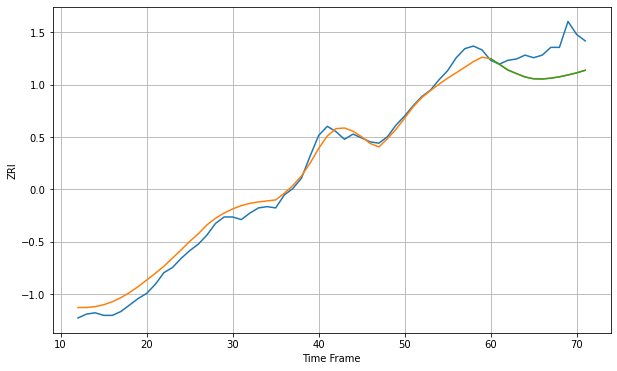

Wall time: 8.04 s
17603 6.844758093512226 20.917258521872352 20.948476784348614 [1137.22587968 1133.0080641  1128.53562043 1125.77804277 1123.12472149
 1121.72615716 1121.55363439 1122.23198135 1123.21978792 1124.66370618
 1126.26859615 1128.27274108]

Got an mse at 0.0025 in round 429 and stopped training

60 60 12


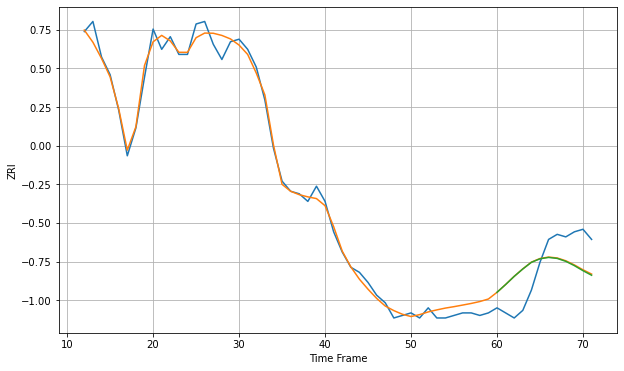

Wall time: 15.2 s
17701 3.3106046728425453 11.772166062145281 11.900435266985825 [773.12492076 776.18949609 779.41398642 782.32889975 784.96399917
 786.35671547 786.89433052 786.50525898 785.35140378 783.65075436
 781.66284616 779.8655755 ]

Got an mse at 0.0025 in round 188 and stopped training

60 60 12


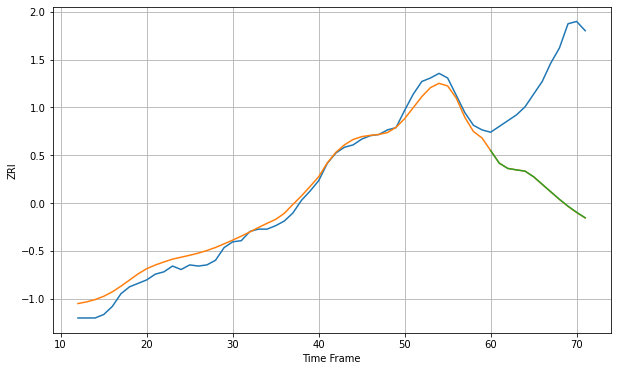

Wall time: 9.3 s
18018 7.816175995733193 104.0572320018706 103.97765706219165 [1071.10324038 1060.22778636 1055.60581162 1054.36139008 1053.27861927
 1048.39584637 1041.8669854  1035.34986237 1028.88067104 1022.91210189
 1017.58865565 1012.81586977]

Got an mse at 0.0025 in round 203 and stopped training

60 60 12


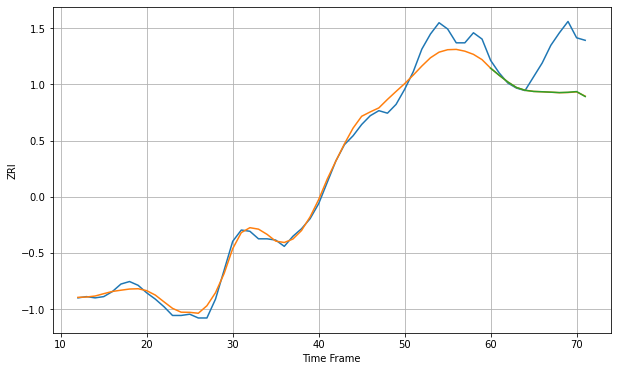

Wall time: 9.52 s
18042 7.6167905166376455 30.817416974857657 30.788746341412853 [1123.79526058 1118.14266684 1112.84506251 1108.44741734 1106.24232639
 1105.31114673 1105.04781392 1104.71825761 1104.38722356 1104.62434651
 1105.20592353 1101.25006053]

Got an mse at 0.0025 in round 384 and stopped training

60 60 12


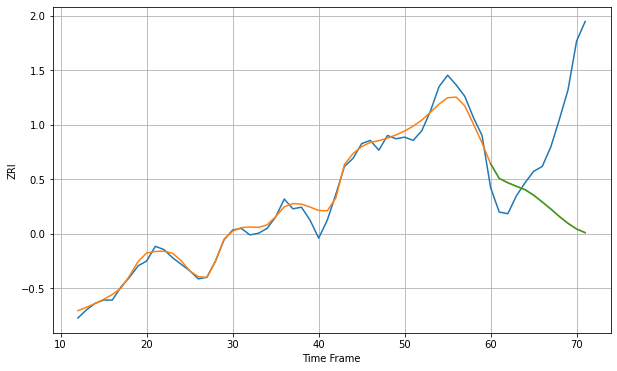

Wall time: 14.4 s
18102 4.971501848744098 60.25410151725332 60.29482732996755 [1071.63694262 1062.66262604 1060.01286037 1057.82541727 1055.76734865
 1052.38786805 1048.21656113 1043.88601168 1039.23152367 1035.04707108
 1031.58398733 1029.30438509]
60 60 12


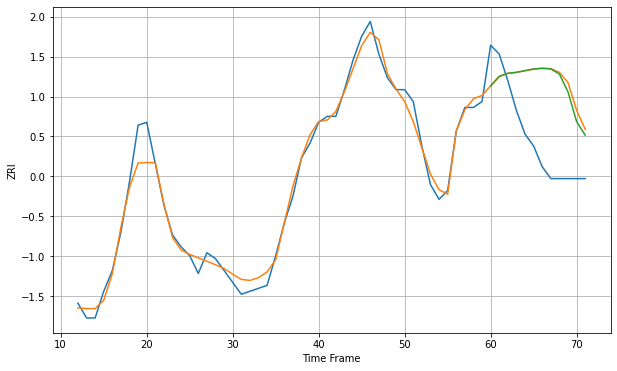

Wall time: 16.5 s
18232 3.794720998618439 24.436757899520835 23.632945950926317 [789.26553282 792.46708171 793.50950355 793.86136861 794.40500123
 794.94944118 795.19788289 794.9933052  793.25170197 787.26175946
 777.22145532 772.64758406]

Got an mse at 0.0025 in round 369 and stopped training

60 60 12


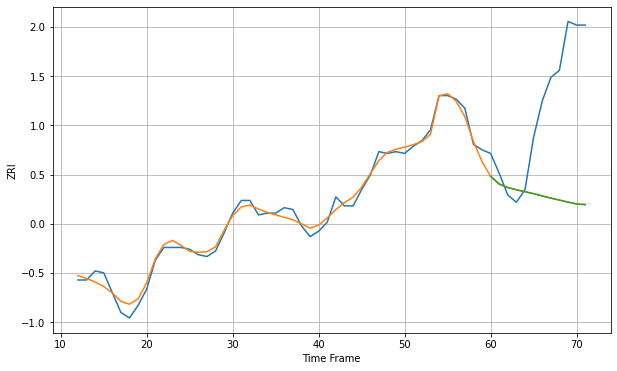

Wall time: 13.8 s
18951 3.502460142518976 60.00741256043077 60.03430522214609 [1342.33562887 1338.06002752 1336.1322683  1334.89262208 1333.82724962
 1332.75199633 1331.50410956 1330.27958124 1329.19840599 1328.08561845
 1327.0284389  1326.65116068]

Got an mse at 0.0025 in round 323 and stopped training

60 60 12


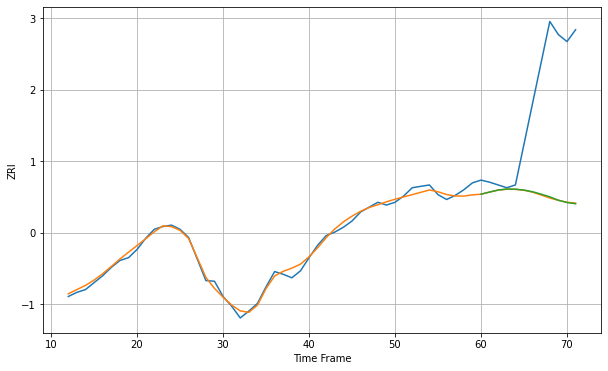

Wall time: 12.5 s
19007 5.954945806229271 157.28549023043078 157.02940168567906 [1229.64509449 1232.7916178  1235.69710019 1237.1046352  1236.91388323
 1235.64093998 1233.18137744 1229.75579436 1225.87844712 1220.95931836
 1217.61615583 1215.91947882]
60 60 12


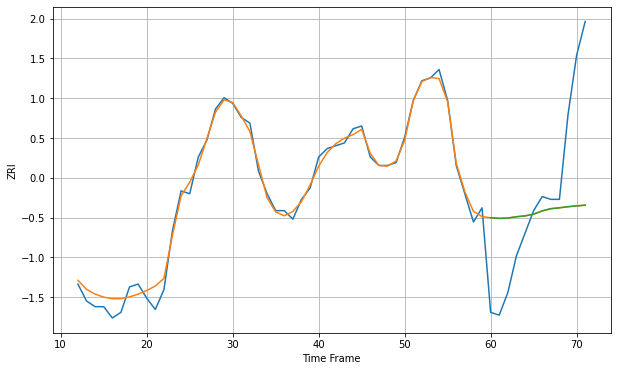

Wall time: 16.7 s
19103 2.736500833937077 30.82486358924123 30.833323992945992 [1679.49711962 1679.26745679 1679.38191199 1679.85188224 1680.14677628
 1680.76678407 1681.91930492 1682.70999906 1683.01922384 1683.40546045
 1683.69689409 1683.91790186]
60 60 12


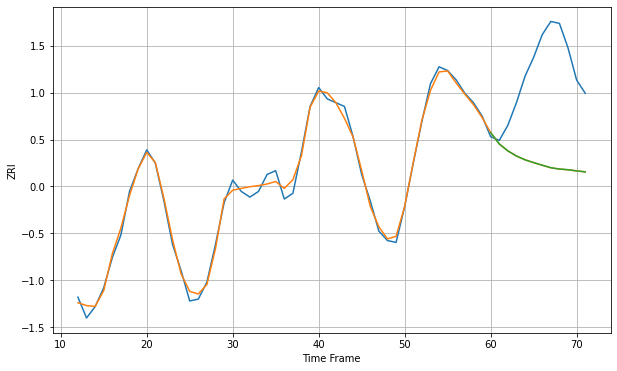

Wall time: 16.8 s
19104 3.085262833826181 50.82385291712998 50.81288493135629 [1272.16881517 1266.16433705 1262.47536885 1259.77541888 1257.74788236
 1256.25878291 1254.89398938 1253.56982288 1252.85298169 1252.50163606
 1251.88191528 1251.37888082]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


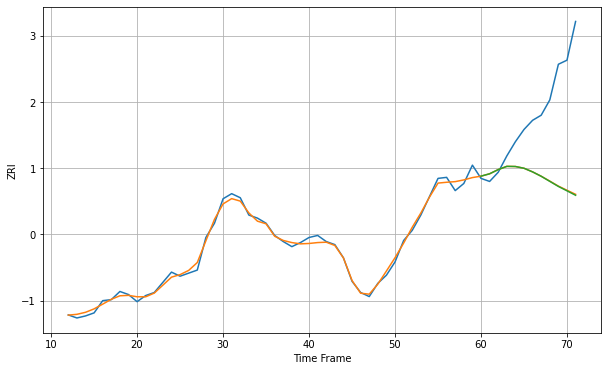

Wall time: 12.6 s
19106 3.927687557475112 78.56970870456617 78.8838982614892 [1768.18576343 1770.50630438 1774.61983164 1777.78469    1777.65364476
 1775.93455853 1772.3632127  1768.05787656 1763.07400031 1758.09029607
 1753.78537803 1749.4264453 ]
60 60 12


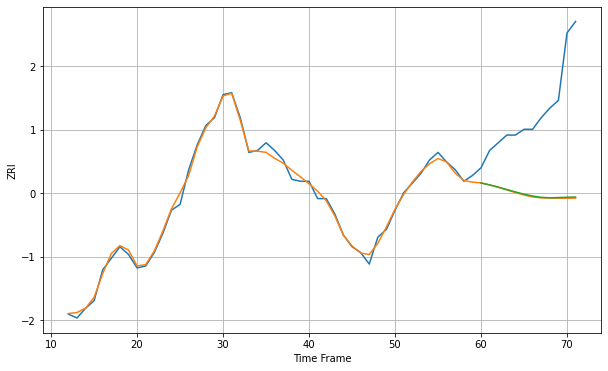

Wall time: 16.9 s
19107 2.235131459038523 47.690882414246566 47.38181803195933 [1563.11729416 1562.12244949 1560.97005855 1559.71505466 1558.46143106
 1557.30338511 1556.34785476 1555.65431229 1555.39695808 1555.54122079
 1555.69001388 1555.81706113]
60 60 12


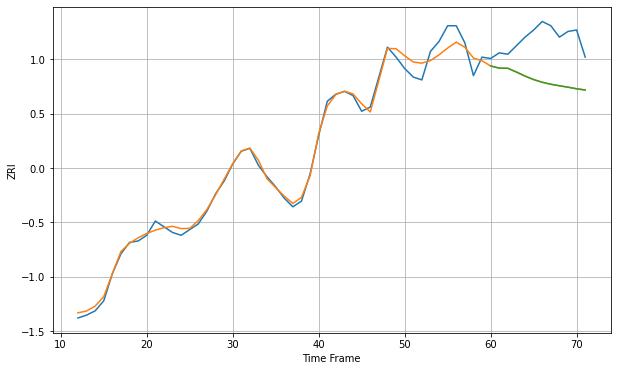

Wall time: 17.2 s
19120 5.148741323518907 30.211186208967803 30.232212292583952 [982.79226987 981.26969398 981.1557492  978.5264618  975.6879871
 973.24275842 971.35741283 969.96125379 968.88573948 967.89472187
 966.74248425 965.8563154 ]
60 60 12


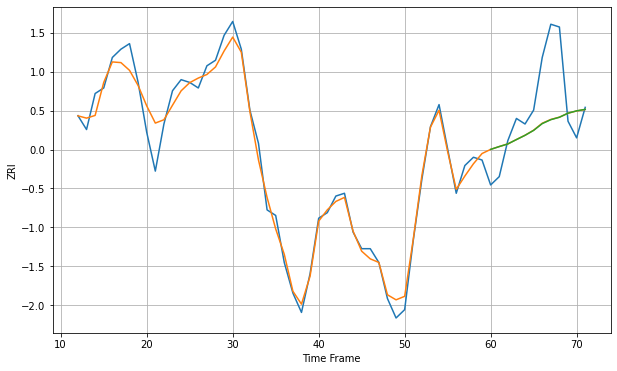

Wall time: 16.8 s
19121 4.467778677444547 16.624021734712198 16.663303797377875 [1348.83424496 1349.85186653 1350.79766536 1352.37477501 1353.91092891
 1355.69260015 1358.13602162 1359.55905046 1360.43873592 1361.89972889
 1362.74548552 1363.28452315]

Got an mse at 0.0024 in round 185 and stopped training

60 60 12


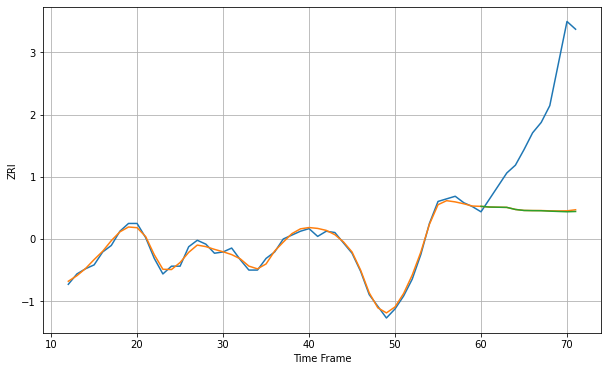

Wall time: 9.19 s
19123 2.5596127467258936 78.01199337470521 78.40959362356013 [1544.20550347 1543.66448952 1543.53342788 1543.41105685 1541.80807485
 1541.03195357 1540.90177261 1540.83815096 1540.50806304 1540.26385083
 1540.02295518 1540.23486718]
60 60 12


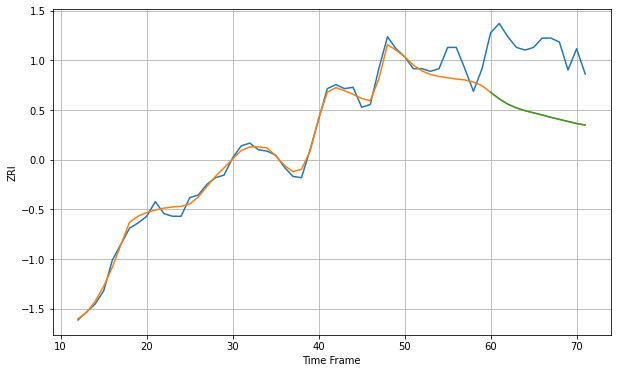

Wall time: 17.1 s
19124 6.4855597721692035 50.656624163304706 50.62296943854757 [949.21720284 944.32917172 940.33175336 937.50661576 935.40819648
 933.78068062 932.18466728 930.42790699 928.85899164 927.34068439
 925.78064179 924.65834116]

Got an mse at 0.0025 in round 260 and stopped training

60 60 12


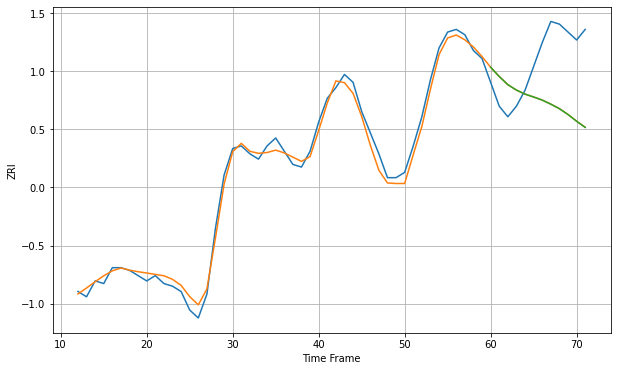

Wall time: 11.8 s
19128 2.816970187875187 22.76225729415116 22.784557764347433 [1253.70646595 1250.21485296 1247.12355418 1245.07549438 1243.54998764
 1242.46831467 1241.29533259 1239.75973947 1238.04190145 1235.84686351
 1233.30497762 1230.96956861]
60 60 12


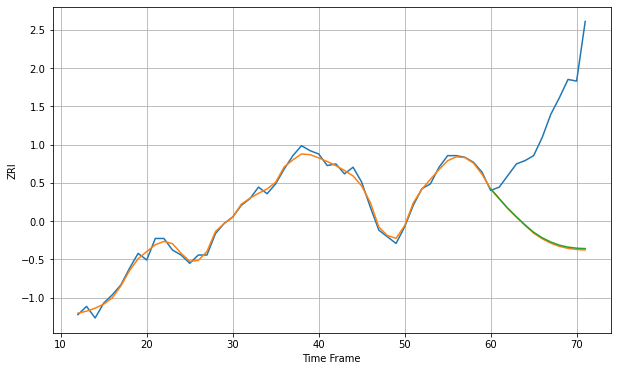

Wall time: 16.6 s
19130 2.484446411715266 72.35068435091513 71.81087305123974 [1516.94782241 1511.02047352 1505.16713978 1500.05844027 1495.22052287
 1490.74797916 1487.4101041  1484.84569575 1482.94789802 1481.76535155
 1481.13173163 1480.89331812]

Got an mse at 0.0025 in round 306 and stopped training

60 60 12


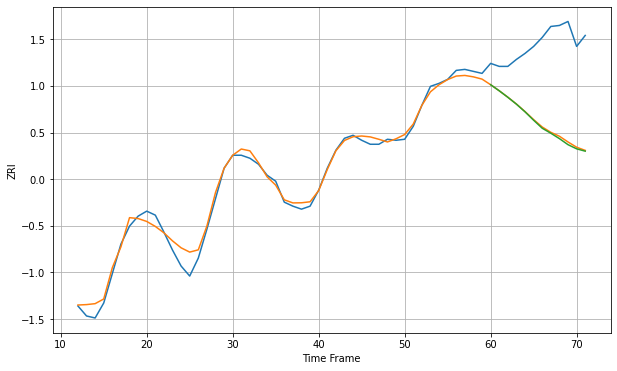

Wall time: 12.3 s
19131 6.943650141595174 82.8552991720625 83.99241690151877 [1147.6407975  1141.55857267 1135.06571542 1128.16461012 1120.49283861
 1112.07374041 1104.05208431 1099.04675075 1093.65189754 1087.58320683
 1083.42137643 1081.08882604]

Got an mse at 0.0025 in round 214 and stopped training

60 60 12


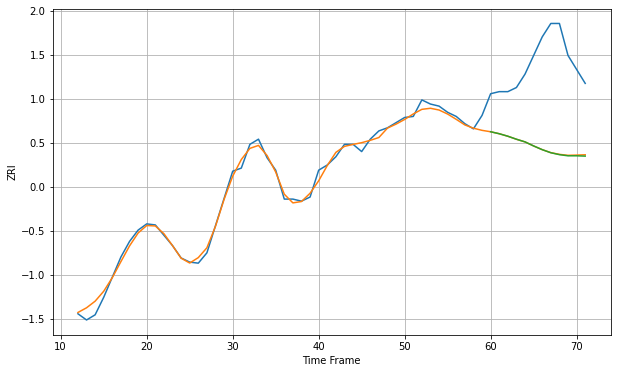

Wall time: 9.63 s
19139 5.098354179139262 83.63310298010904 83.87442883197255 [1107.18273251 1105.27955231 1102.85829887 1099.94932582 1097.38452089
 1093.4483163  1089.84685121 1086.85998503 1085.01839563 1083.90566128
 1083.90960462 1083.60837393]

Got an mse at 0.0025 in round 331 and stopped training

60 60 12


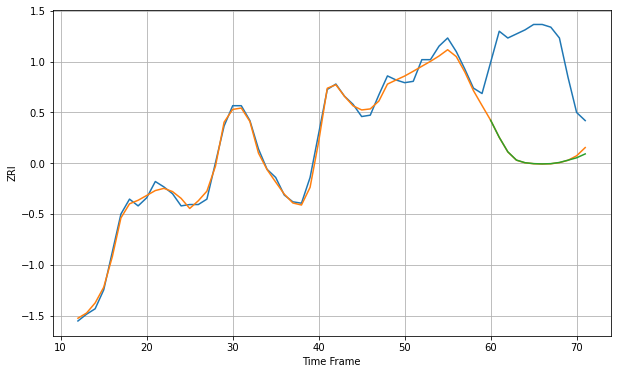

Wall time: 12.8 s
19140 4.048010900243892 80.83298879946994 80.93117594976685 [976.268102   963.65649822 952.92864284 946.83817984 944.88941046
 944.21020162 944.01136633 944.19382991 945.06943633 946.76223
 948.52156221 951.39606038]
60 60 12


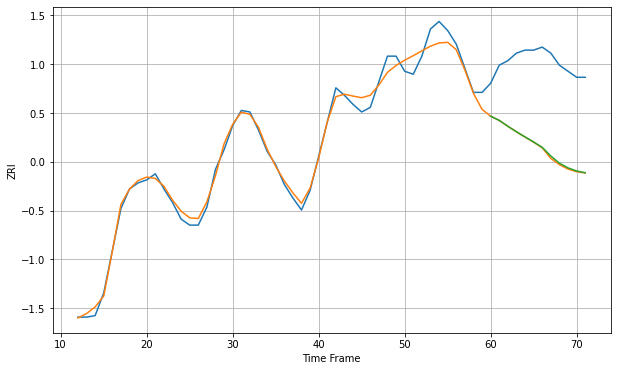

Wall time: 16.8 s
19141 5.347001729013722 57.227169151270246 56.77838486481481 [953.20370407 950.42442479 946.53133543 942.91852942 939.45406608
 936.12619171 932.55659508 926.7964618  922.06058661 918.93666749
 916.89241955 915.68830284]

Got an mse at 0.0025 in round 452 and stopped training

60 60 12


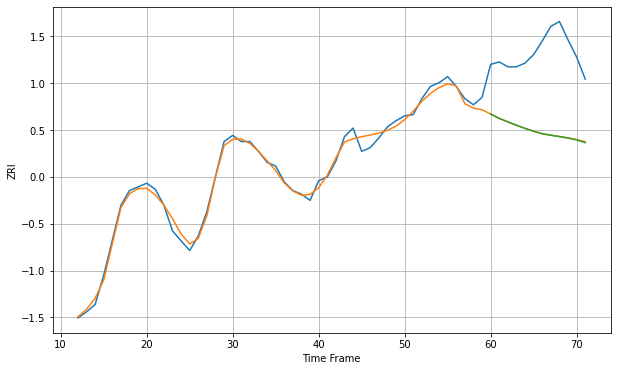

Wall time: 15.9 s
19143 4.592753181776176 65.07285084519111 65.15391658713902 [1107.4712092  1103.87937708 1101.07356368 1098.2956909  1095.75720826
 1093.43316834 1091.40030287 1090.17356502 1089.06703466 1087.84925079
 1086.31377197 1084.10789526]
60 60 12


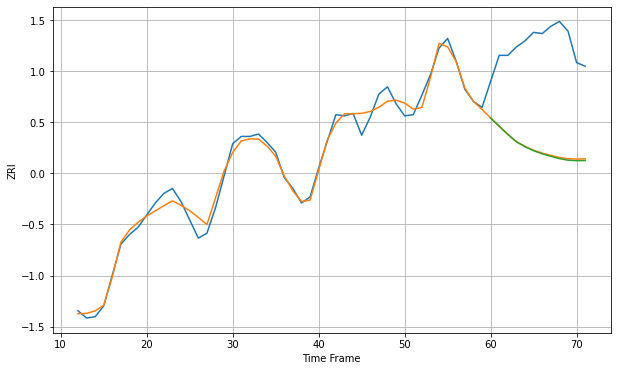

Wall time: 16.5 s
19144 6.335225786732418 86.08268698555372 86.71595895510829 [1051.24011062 1044.39381358 1037.69850679 1031.57971898 1027.53732325
 1024.2044429  1021.66672843 1019.59137919 1017.67807186 1016.35100548
 1015.93529966 1016.11056286]
60 60 12


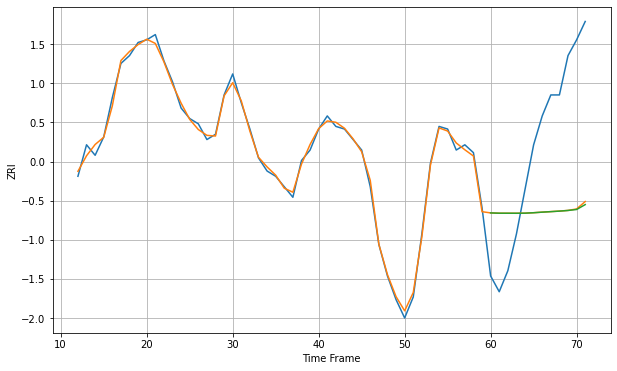

Wall time: 16.7 s
19146 1.730491233969328 41.224461078765195 41.42101788862917 [1477.04025489 1476.9254714  1476.91873439 1476.90557139 1476.93979501
 1477.10867091 1477.32717064 1477.5240783  1477.72157796 1477.97130986
 1478.34123507 1480.20860409]
60 60 12


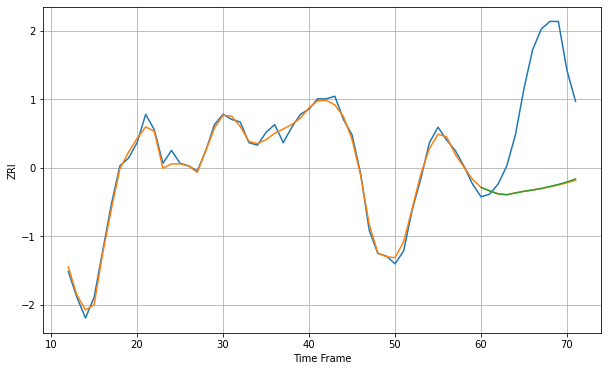

Wall time: 16.7 s
19147 2.107059911843164 40.81438280499649 40.7097594120838 [1424.6318357  1423.31548752 1422.13441438 1421.79815094 1422.49550094
 1423.12963081 1423.64404238 1424.23286814 1424.98546402 1425.79371866
 1426.76699706 1427.92951048]
60 60 12


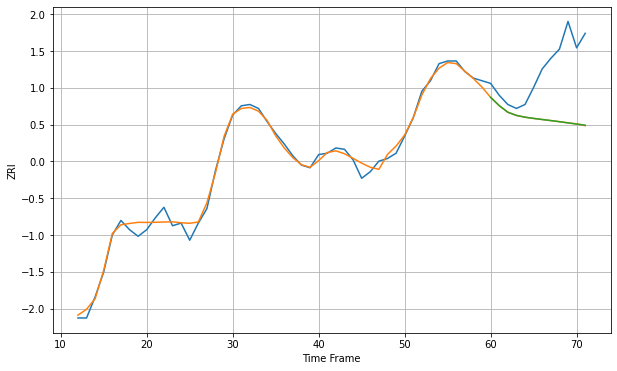

Wall time: 16.9 s
19148 4.343633479178718 42.601568124356 42.57185335641107 [1246.41712885 1240.13753311 1235.13733615 1232.7211226  1231.36340138
 1230.43408332 1229.6053285  1228.79187006 1227.94762481 1227.0315498
 1226.13954554 1225.29644102]

Got an mse at 0.0024 in round 219 and stopped training

60 60 12


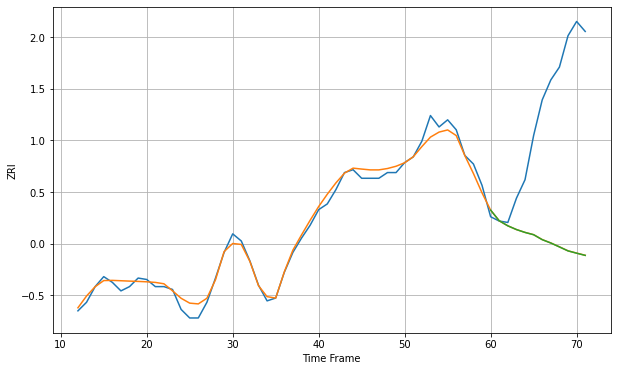

Wall time: 10.4 s
19401 4.756400283396409 99.6391395018174 99.67915594908523 [1195.64927696 1188.17208514 1184.64124022 1182.02863531 1180.0100471
 1178.40273153 1174.93644709 1172.58113623 1169.84358339 1167.05768616
 1165.45450422 1163.89804388]
60 60 12


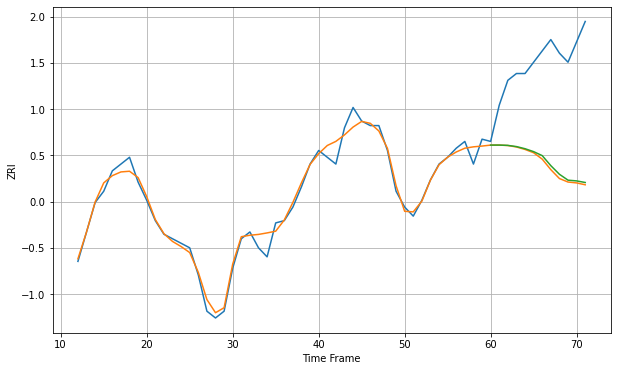

Wall time: 16.8 s
19464 3.5574674051212836 46.07397632704315 45.189933368371314 [1099.3755985  1099.38757847 1099.25359775 1098.72286955 1097.78020139
 1096.49232819 1094.72416494 1090.29402376 1086.48991455 1083.8844491
 1083.56094008 1082.85635486]

Got an mse at 0.0024 in round 341 and stopped training

60 60 12


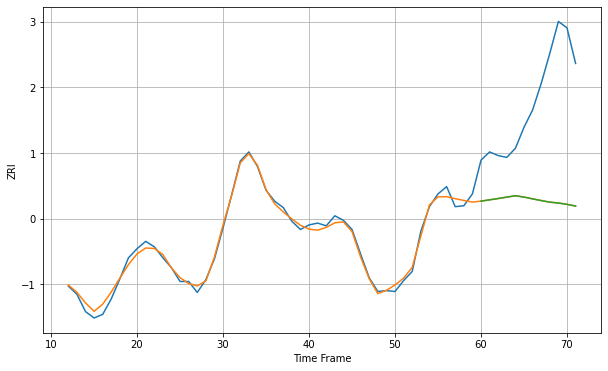

Wall time: 13.3 s
20001 5.094886892848859 119.52364836219853 119.53361597048051 [2303.08247861 2304.47964328 2305.93348004 2307.49115956 2308.95995342
 2307.52801747 2305.55531018 2303.69089865 2301.94193794 2301.01473336
 2299.50818961 2297.67276688]

Got an mse at 0.0025 in round 239 and stopped training

60 60 12


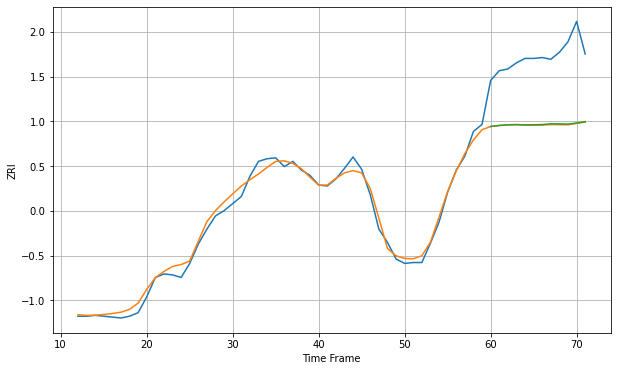

Wall time: 11.4 s
20002 6.996445156569435 78.3347021307271 77.85433021108115 [2148.63591336 2149.81033598 2150.54605149 2150.82138147 2150.47662926
 2150.63995127 2150.82587636 2151.61990205 2151.60715951 2151.40806319
 2152.58606037 2154.18924625]

Got an mse at 0.0025 in round 455 and stopped training

60 60 12


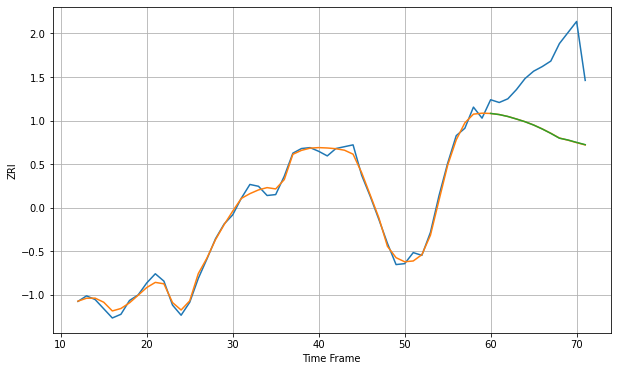

Wall time: 15.4 s
20003 4.942623727040665 73.34206046087257 73.29166500788783 [2306.1114763  2304.8983526  2302.81835867 2300.06643663 2297.11813784
 2293.52882938 2289.2534435  2284.46331184 2279.21717531 2277.28451207
 2274.66774207 2272.21720458]

Got an mse at 0.0025 in round 466 and stopped training

60 60 12


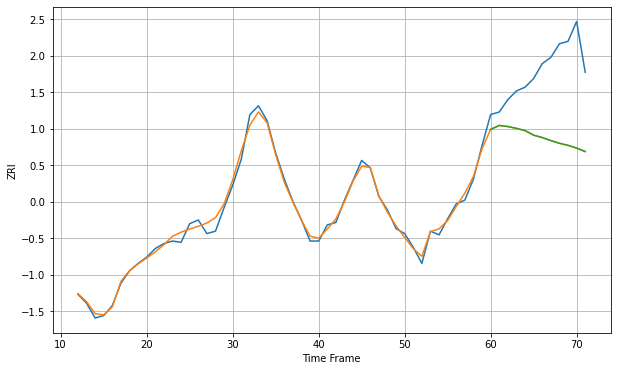

Wall time: 16.3 s
20005 3.856482431936467 58.45680039833244 58.38463095833207 [2282.99965799 2286.20281149 2285.32360751 2283.83726455 2282.06785833
 2278.36093673 2276.43621341 2274.00200462 2271.81650274 2270.18616501
 2267.99981627 2265.22701847]
60 60 12


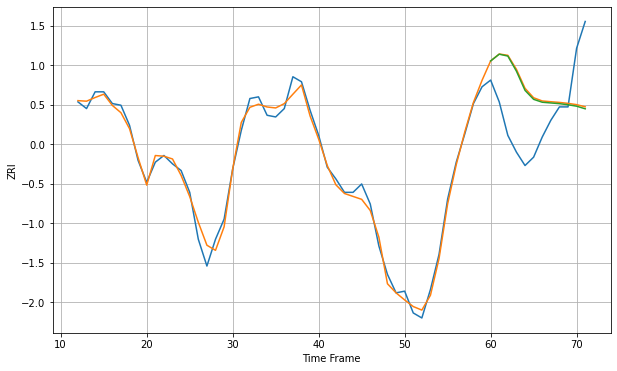

Wall time: 17.7 s
20007 4.501172407989677 33.39890184712725 33.1409120943333 [2180.42247383 2184.46650318 2183.34376342 2174.33223852 2162.85748791
 2157.5155157  2155.78360294 2155.35686568 2154.9264109  2154.28293987
 2153.42323384 2151.86612319]

Got an mse at 0.0025 in round 464 and stopped training

60 60 12


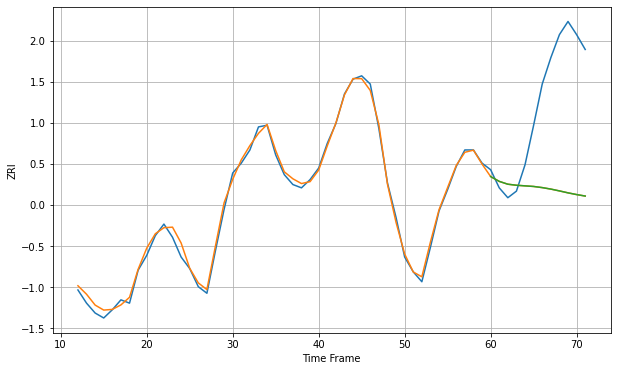

Wall time: 16.2 s
20008 2.9222118985289876 63.990971505621594 63.9909710734423 [2040.8487578  2037.92870102 2036.20615537 2035.57109153 2035.20171811
 2034.83496848 2034.1445116  2033.24183487 2032.13693383 2030.95688604
 2029.9138351  2029.01424751]
60 60 12


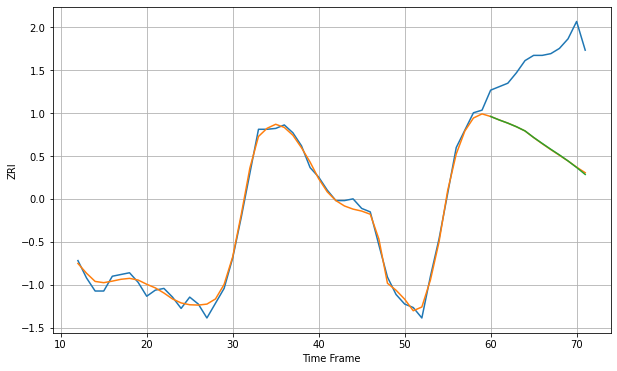

Wall time: 17.1 s
20009 6.28103057715323 103.7266478972901 103.86886282534357 [2316.72713617 2312.73555981 2309.09121597 2304.93985401 2300.12824289
 2292.63195998 2285.73359709 2278.997713   2272.52111029 2265.6187681
 2258.10193817 2250.07864856]
60 60 12


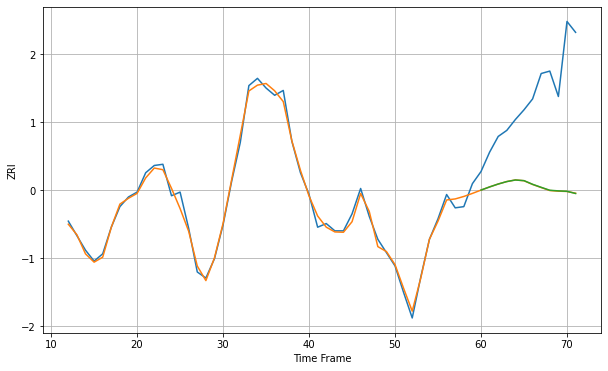

Wall time: 17.8 s
20010 4.579979824959322 80.34013881281123 80.28383239819084 [2122.6592267  2125.28557038 2127.67790381 2129.70839854 2131.01849614
 2130.47314926 2127.44118436 2124.94653922 2122.53008703 2122.01932023
 2121.65528065 2119.84908196]

Got an mse at 0.0025 in round 424 and stopped training

60 60 12


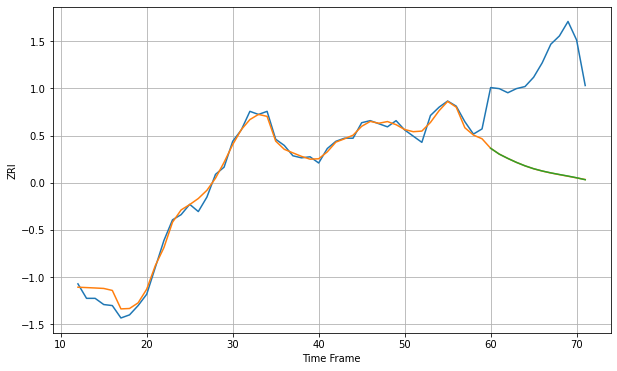

Wall time: 15.8 s
20011 5.917350615545796 101.41571150710128 101.3549431403719 [1878.25417893 1872.60698779 1868.42650351 1864.6142652  1861.26886079
 1858.47941175 1856.28007164 1854.44529483 1852.86686255 1851.35448166
 1849.71967492 1847.81989859]

Got an mse at 0.0025 in round 231 and stopped training

60 60 12


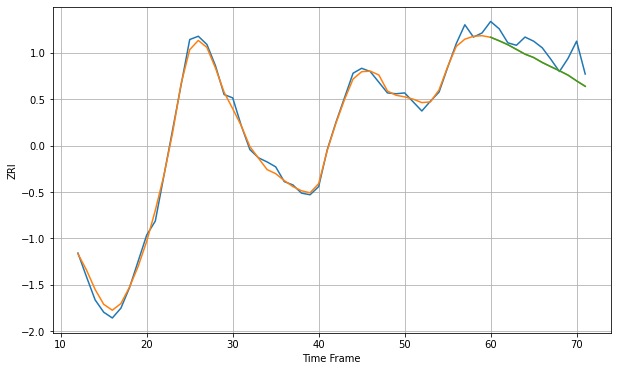

Wall time: 11.5 s
20019 6.381739050792613 20.033485206500096 20.038303815497784 [1691.74542235 1687.43892239 1682.72193517 1676.97820912 1671.19503675
 1667.11160894 1661.07206324 1655.97552595 1650.99370377 1645.67052595
 1638.66310742 1632.05828179]
60 60 12


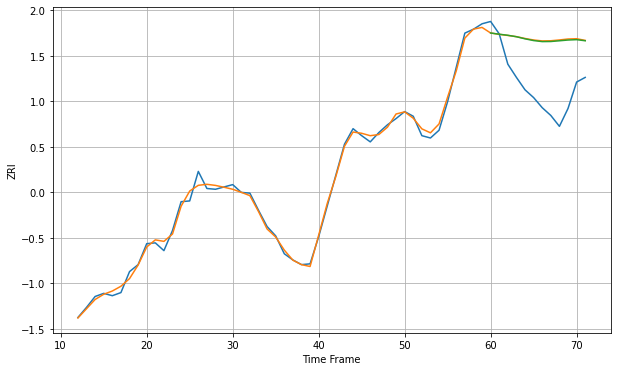

Wall time: 17.6 s
20020 5.671717513730468 68.67459632545098 67.9747530049684 [1663.14842522 1661.58817143 1660.23173626 1658.35767551 1655.65955309
 1653.4063072  1652.08566375 1652.20511501 1653.13387924 1654.10260103
 1654.57652062 1653.17153901]

Got an mse at 0.0025 in round 381 and stopped training

60 60 12


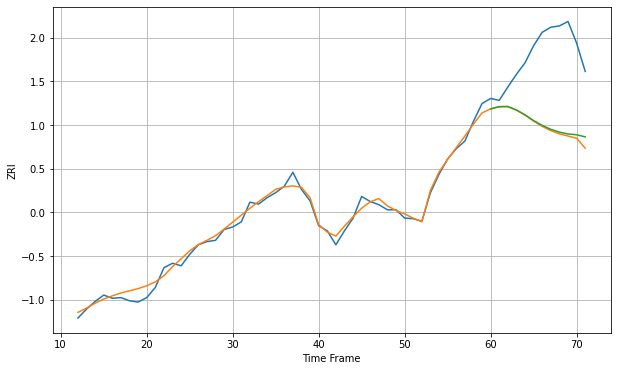

Wall time: 14.6 s
20024 8.672333329186344 119.62075636964308 116.42140435230729 [2331.60942536 2335.11171743 2335.30298604 2329.86745572 2322.23983767
 2313.26198954 2305.59788083 2299.50064551 2295.08400604 2292.19007383
 2290.94854417 2287.67191564]
60 60 12


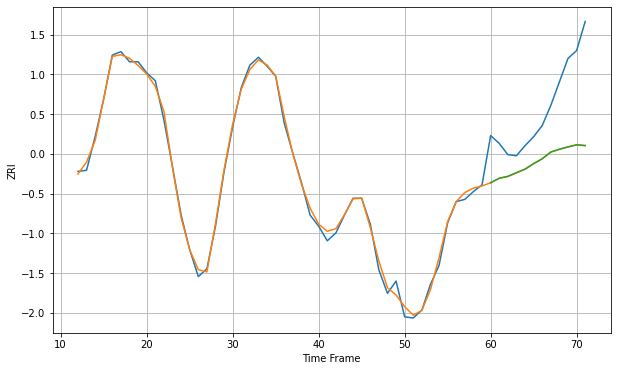

Wall time: 18 s
20037 4.324504557389768 54.98057007192753 54.98945064297357 [2377.85215619 2381.89058486 2383.53328578 2386.81336457 2390.02262732
 2394.91318521 2399.31151608 2405.29949419 2407.79206829 2409.90332742
 2411.77589473 2411.01932041]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


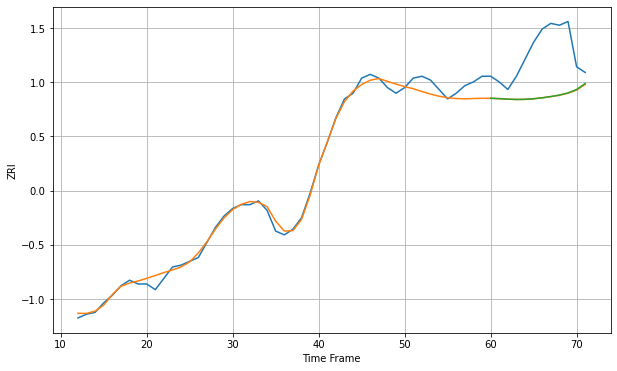

Wall time: 13.6 s
20109 3.636259627042106 25.1367892721743 25.070305383256823 [1448.32963288 1448.14131947 1447.86594758 1447.69378355 1447.76871647
 1448.07608201 1448.58991486 1449.25462369 1450.02431246 1451.16849208
 1452.99862318 1456.15165517]
60 60 12


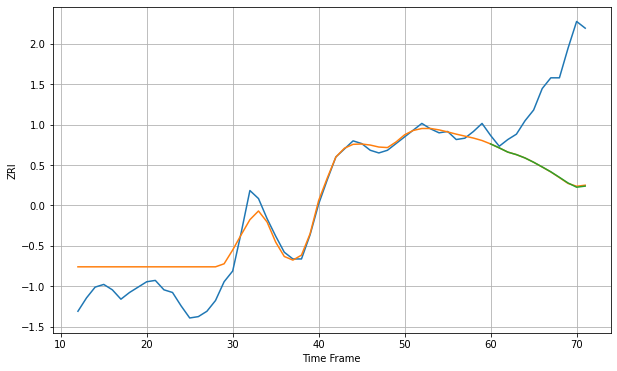

Wall time: 17.7 s
20110 15.21484430084792 67.97392779199336 68.10568529364913 [1397.70955908 1394.77884858 1391.62958879 1389.74680788 1387.2557938
 1384.07843521 1380.5648431  1376.94476206 1372.83912491 1368.63547357
 1365.45936286 1366.28470191]

Got an mse at 0.0025 in round 366 and stopped training

60 60 12


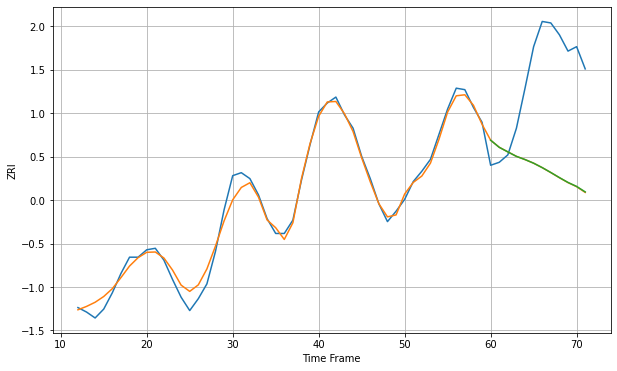

Wall time: 14.3 s
20147 5.284172781051427 71.98431352942966 71.90116022390083 [1609.90801349 1605.10547597 1602.02531636 1598.99722717 1596.84921127
 1594.40232302 1591.42170948 1588.12058912 1584.68136011 1581.41234892
 1578.72777464 1575.04591463]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


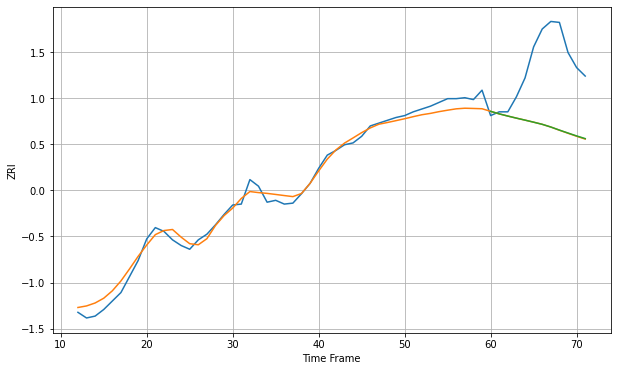

Wall time: 8.75 s
20175 7.869703972086393 71.93092732000234 71.81001144224825 [1625.51794345 1622.82791404 1620.50626079 1618.29567658 1616.18174336
 1614.00443574 1611.73379898 1608.86968334 1605.60454402 1602.4787439
 1599.40623732 1596.56773851]

Got an mse at 0.0024 in round 150 and stopped training

60 60 12


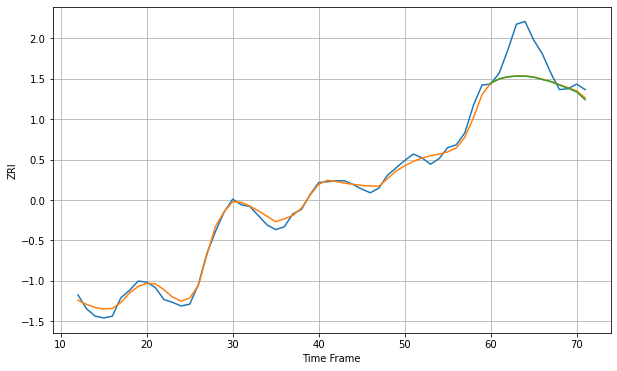

Wall time: 9.19 s
20176 5.769156575949135 29.133789618345332 29.322715782736108 [1624.95146558 1629.65246019 1631.89594265 1632.6876057  1632.61154811
 1631.49060205 1629.01043357 1626.60298258 1622.9610124  1619.5309098
 1615.47894012 1606.98590906]
60 60 12


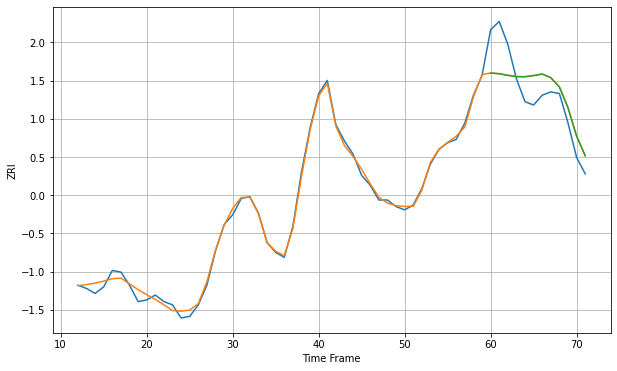

Wall time: 17.9 s
20740 2.518017985936932 16.49806156250704 16.505781079343887 [1644.50198173 1644.0983057  1643.11566756 1642.34491928 1642.27011085
 1642.97881607 1643.91980534 1641.73577746 1635.99066918 1623.20280356
 1605.92485497 1594.12122373]
60 60 12


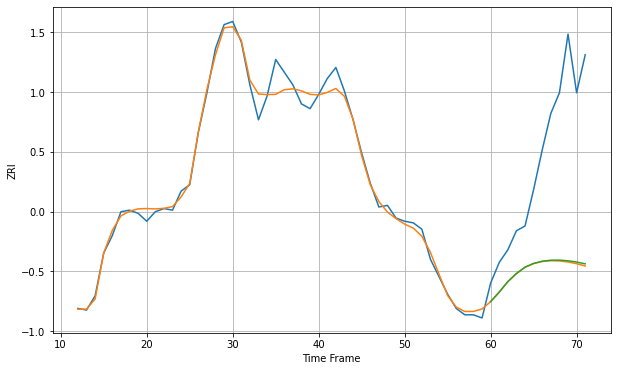

Wall time: 17.8 s
20814 5.7399424326883794 81.30061810470613 80.77375495852753 [1959.31141848 1965.31969965 1971.91570959 1977.04960157 1981.05145214
 1983.42320762 1984.81275116 1985.43575484 1985.48214583 1985.06572479
 1984.27600545 1983.14339255]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


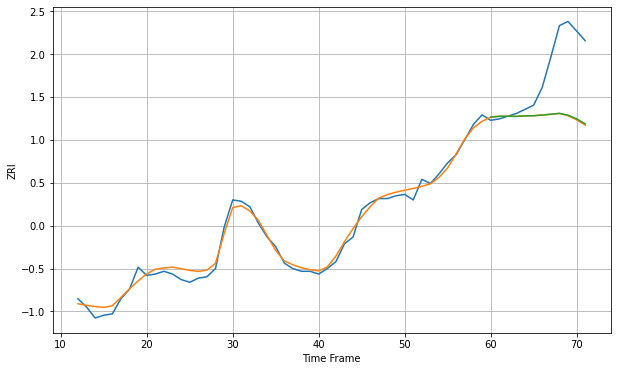

Wall time: 9.05 s
20850 4.253887922687264 39.78198616096789 39.50848571365416 [1854.30127331 1854.9133463  1854.95976584 1854.86081817 1855.22303525
 1855.34986191 1855.80850894 1856.42410437 1857.03046467 1855.77930312
 1853.09750305 1849.41764789]

Got an mse at 0.0025 in round 483 and stopped training

60 60 12


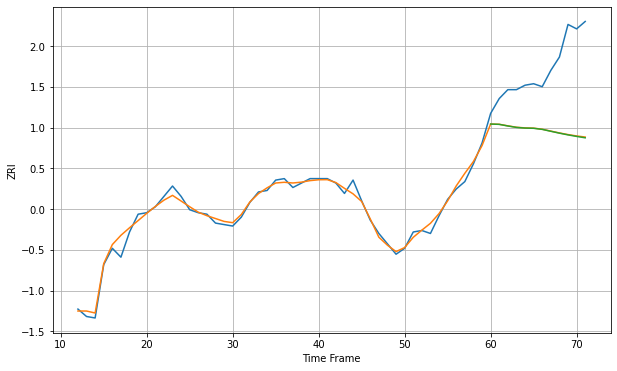

Wall time: 16.8 s
20852 3.54172407800246 45.87041333804848 46.065628720288174 [1783.80594848 1783.59181705 1782.50082579 1781.53634254 1781.08910481
 1780.93919249 1780.20887356 1778.92730627 1777.6591494  1776.49701326
 1775.46523031 1774.52808613]

Got an mse at 0.0024 in round 378 and stopped training

60 60 12


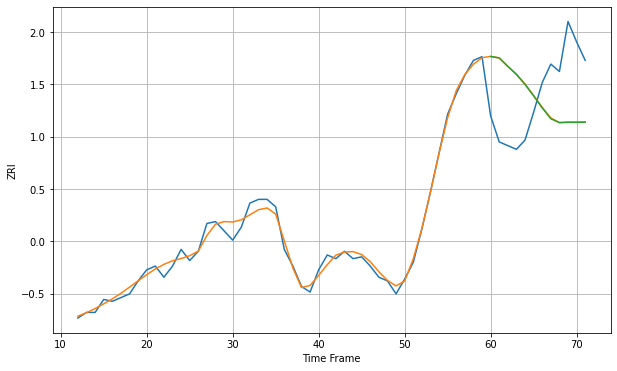

Wall time: 13.9 s
20878 3.4094165449373697 35.65915225348946 35.72027910574895 [1703.13142851 1702.32521012 1697.75834795 1693.44421048 1688.05632813
 1681.85735173 1675.37360958 1669.5156703  1667.39020622 1667.5865881
 1667.55261955 1667.64117069]
60 60 12


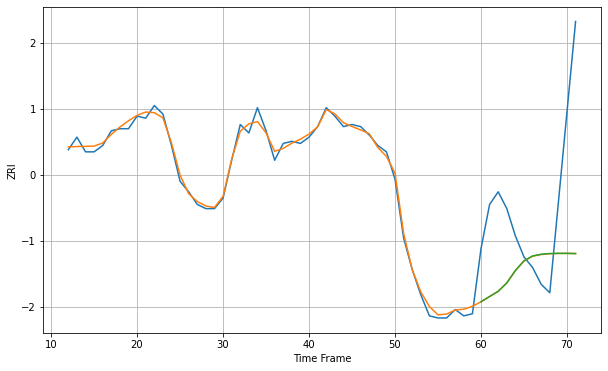

Wall time: 17.3 s
20902 2.3996773984079565 44.89140224344749 44.90639530857745 [1724.71285029 1727.2106015  1729.68406609 1733.6773125  1739.58658375
 1744.16081265 1746.48568626 1747.29981725 1747.63687789 1747.73773413
 1747.73507741 1747.60231019]
60 60 12


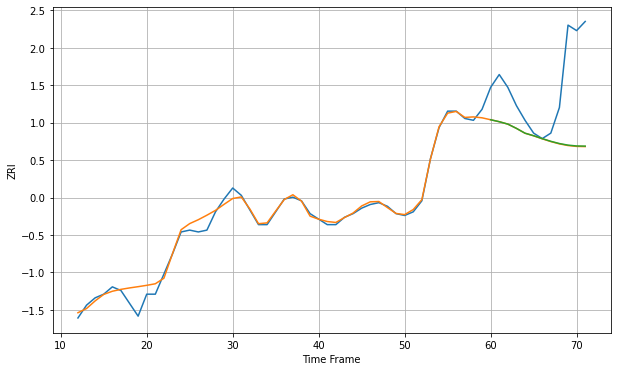

Wall time: 16.7 s
20906 3.602129594368962 35.364596273939235 35.24121717781587 [1569.3030238  1568.23421932 1566.91956374 1564.58515198 1561.95477212
 1560.57973402 1558.99275913 1557.51762157 1556.30038105 1555.43294853
 1554.97849449 1554.89462338]

Got an mse at 0.0025 in round 114 and stopped training

60 60 12


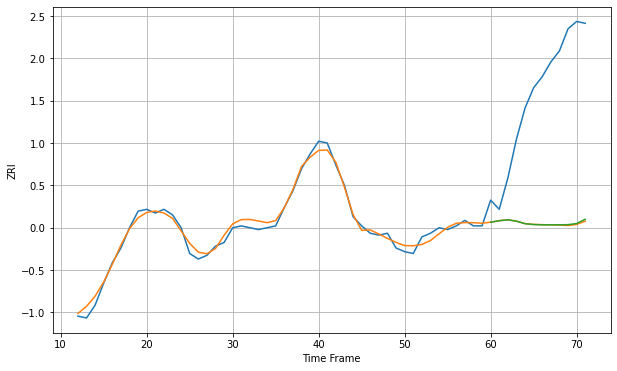

Wall time: 7.55 s
20910 2.851297912135164 76.60263943514663 76.37315747938509 [1712.00557331 1712.80817254 1713.28772348 1712.54993675 1711.19027779
 1710.73167077 1710.58053867 1710.59919724 1710.59472901 1710.67715332
 1711.28083169 1713.59317153]
60 60 12


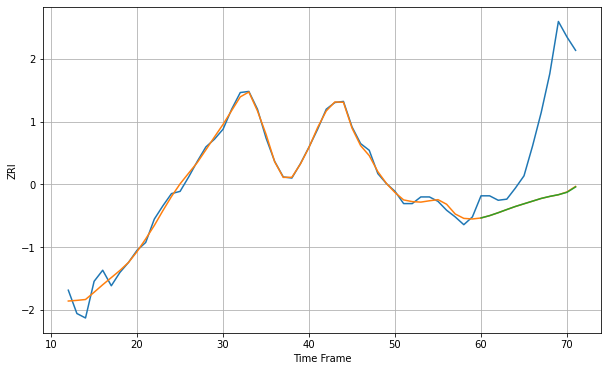

Wall time: 17.5 s
21043 4.972337062298404 82.33375033262823 82.4306248940117 [1546.04914731 1548.15435665 1550.79095062 1553.64544406 1556.41087847
 1558.8237111  1561.22521923 1563.64416897 1565.47974115 1566.99617412
 1569.16348341 1573.99036427]

Got an mse at 0.0025 in round 385 and stopped training

60 60 12


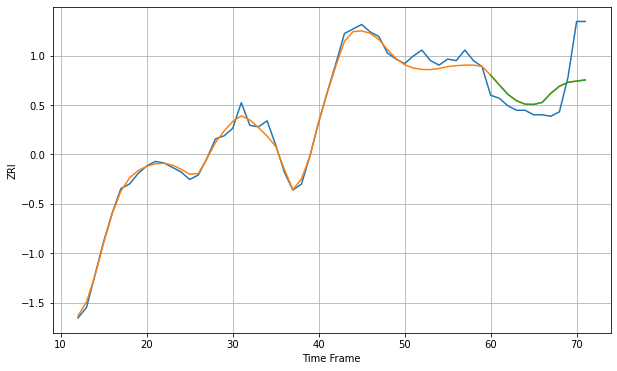

Wall time: 14.3 s
21044 4.039526840430538 18.467711098532387 18.494075327148217 [1644.35448325 1637.90366633 1631.61361633 1627.38445874 1625.06204688
 1624.86707511 1626.25125952 1632.25198436 1636.96608072 1639.56177155
 1640.35997893 1641.10706919]

Got an mse at 0.0025 in round 398 and stopped training

60 60 12


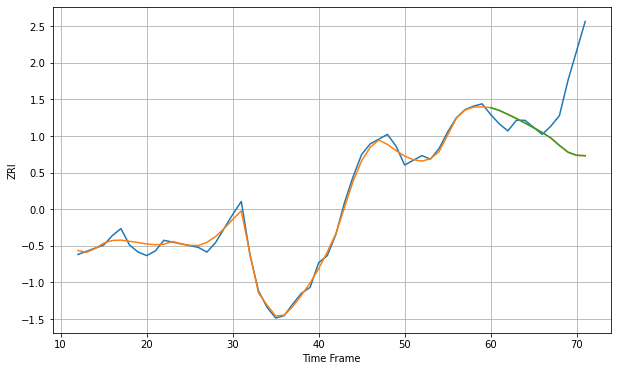

Wall time: 14.6 s
21046 4.195642448600591 46.33308914159253 46.299808544326396 [1650.76227066 1648.41145134 1645.04812603 1641.50587717 1637.65543425
 1633.64761987 1629.6727211  1624.97540272 1618.71331265 1612.93516168
 1610.26978053 1609.93541229]

Got an mse at 0.0025 in round 223 and stopped training

60 60 12


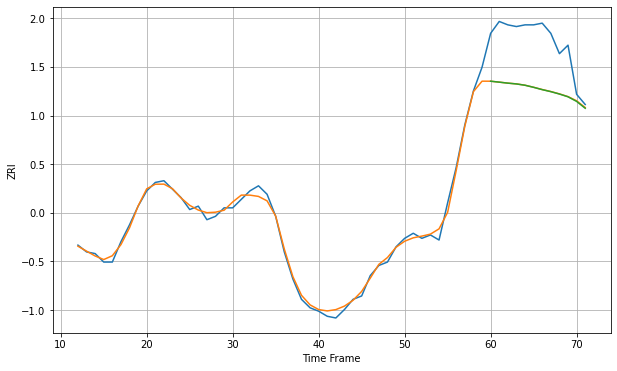

Wall time: 11.1 s
21061 2.7999989845405837 30.620046569332608 30.668185911217126 [1434.73791175 1434.1870092  1433.59478839 1433.12248702 1432.35110639
 1431.12427312 1429.76325971 1428.57337656 1427.16838924 1425.53878379
 1422.81127951 1418.76900723]

Got an mse at 0.0025 in round 161 and stopped training

60 60 12


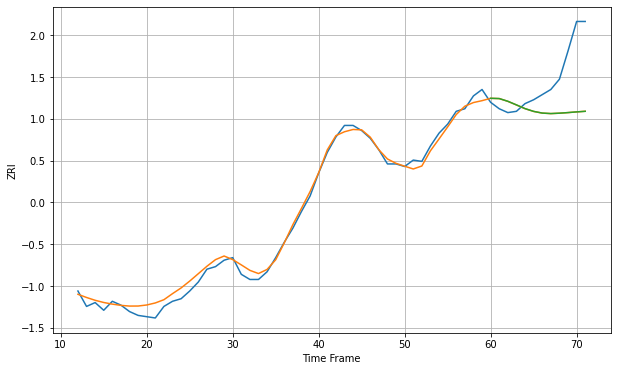

Wall time: 9.22 s
21117 4.787208223022201 33.77968008032173 33.784300288532116 [1349.14285024 1348.9359365  1346.81500532 1344.00823274 1341.11256848
 1338.95332715 1337.63701105 1337.24535151 1337.54530242 1338.01166603
 1338.54927776 1339.00084392]

Got an mse at 0.0024 in round 433 and stopped training

60 60 12


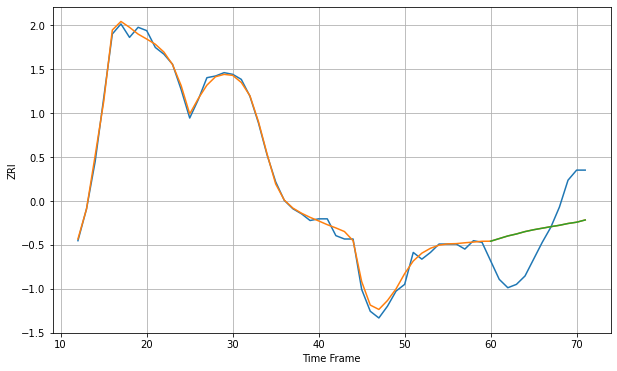

Wall time: 15.5 s
21202 2.8246446685682445 22.861916276095243 22.863267844109053 [1243.6845242  1245.24599175 1246.81559364 1247.99047553 1249.41328163
 1250.50730006 1251.42231658 1252.33244388 1253.15628136 1254.22369221
 1254.98774579 1256.32938463]

Got an mse at 0.0025 in round 435 and stopped training

60 60 12


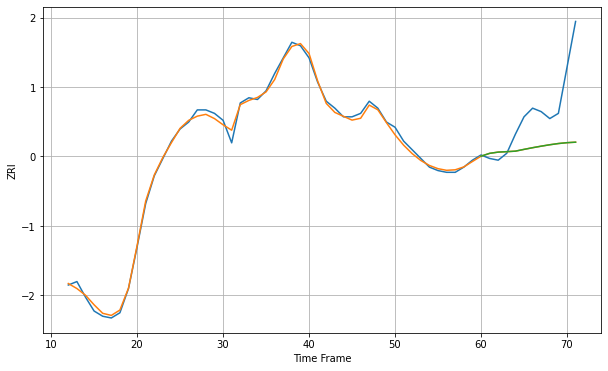

Wall time: 15.7 s
21204 2.1721184263527222 26.86114814951199 26.862471274638118 [1300.28783451 1301.942107   1302.65832286 1302.91076182 1303.20890537
 1304.22983981 1305.19465336 1306.08128224 1306.89824325 1307.60467088
 1308.09438445 1308.37468757]
60 60 12


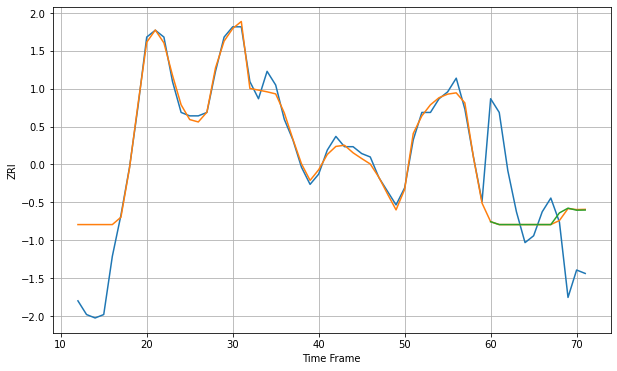

Wall time: 17.3 s
21217 7.6959697341754465 18.41307040501082 18.411499838061378 [1033.10201225 1032.26398286 1032.26398286 1032.26398286 1032.26398286
 1032.26398286 1032.26398286 1032.26398286 1035.67718854 1037.05376205
 1036.46291749 1036.51543372]

Got an mse at 0.0025 in round 352 and stopped training

60 60 12


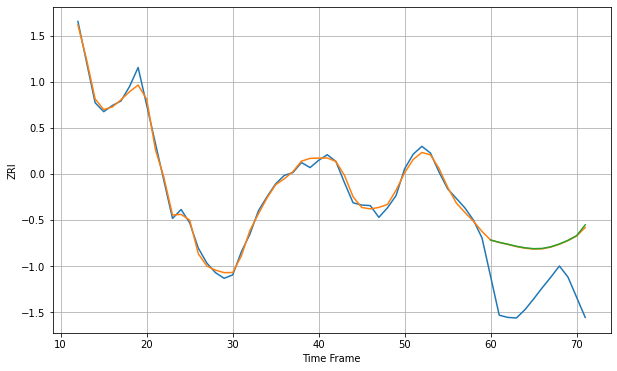

Wall time: 13.8 s
21231 8.856392512457964 102.4353670407044 103.48551588727025 [1768.39548875 1764.25170936 1760.95262388 1757.28816005 1754.52121532
 1752.93787366 1753.35217602 1756.35138295 1761.41092267 1767.9158105
 1776.21898763 1795.55634312]
60 60 12


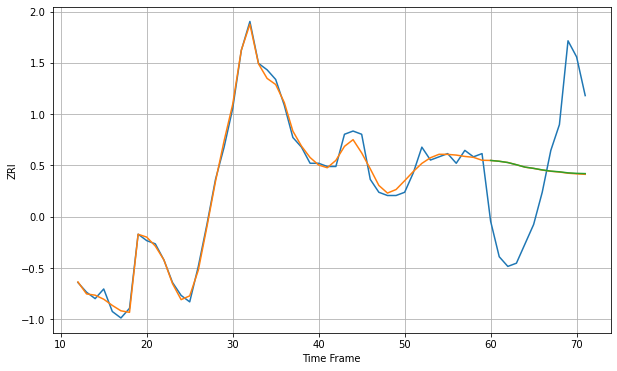

Wall time: 18.3 s
22030 1.9708245245635225 25.789358082798675 25.739507102277116 [1728.87696665 1728.62270348 1728.23203259 1727.5466839  1726.81233617
 1726.42142052 1725.93994051 1725.5634956  1725.3523962  1725.02604348
 1724.87511814 1724.79526188]
60 60 12


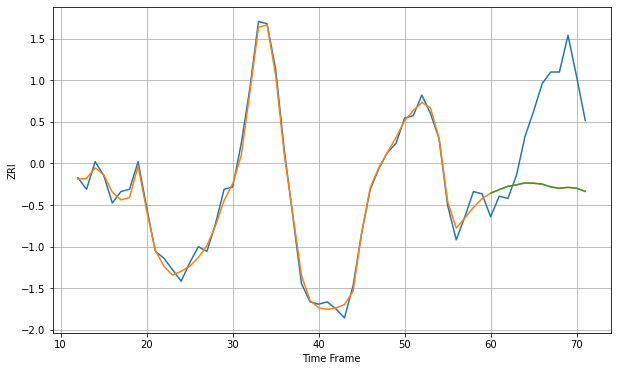

Wall time: 17.3 s
22031 2.890148292165196 36.765698822491636 36.7603453759055 [1799.2825486  1800.83028072 1802.26324126 1802.92461333 1803.74074633
 1803.62071591 1803.23035582 1802.0008093  1801.46236633 1801.80983317
 1801.46183904 1800.08264561]

Got an mse at 0.0025 in round 167 and stopped training

60 60 12


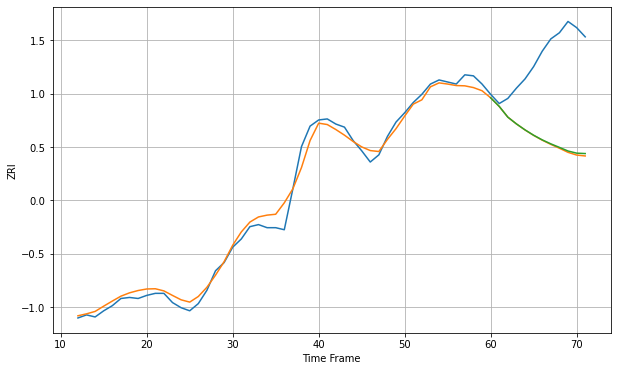

Wall time: 9.31 s
22033 7.788334327506604 83.9042116318366 83.04677291779389 [1803.62088309 1795.20240647 1784.74371517 1778.15485933 1772.32383173
 1767.11959777 1762.59914248 1758.71920626 1755.27419178 1751.74577304
 1749.65870132 1749.25854351]
60 60 12


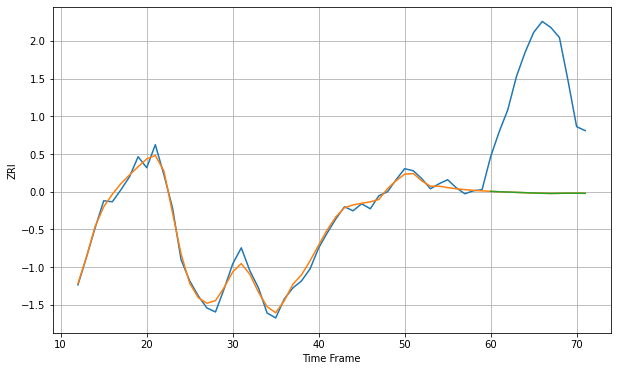

Wall time: 17.3 s
22102 5.4956936267903505 119.7941416165556 119.79869498215064 [2039.41509137 2039.01704251 2038.68939319 2038.38257964 2038.08334844
 2037.78676556 2037.51928134 2037.29127538 2037.44439165 2037.55759042
 2037.53935728 2037.41881349]
60 60 12


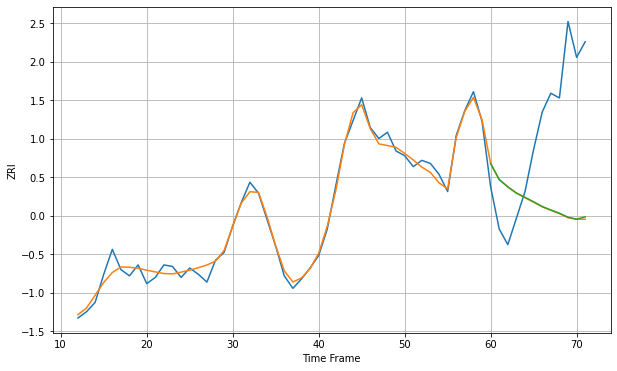

Wall time: 16.8 s
22180 4.441376281224339 69.72497746541603 69.39683993745898 [1843.96980174 1833.64764998 1828.98111081 1825.03174017 1822.24745932
 1819.41539523 1816.42364344 1814.18084284 1812.12805667 1809.56966702
 1808.26373309 1809.83799775]
60 60 12


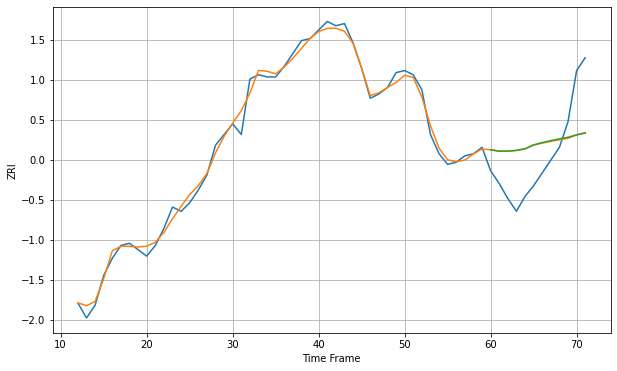

Wall time: 18 s
22191 3.060802995926906 20.376008230825658 20.442880325517528 [1476.88222868 1476.15573723 1476.23388613 1476.56361872 1477.34961972
 1479.16551984 1480.21776856 1481.15017726 1481.96510623 1482.72730535
 1483.85128375 1484.68565638]

Got an mse at 0.0025 in round 120 and stopped training

60 60 12


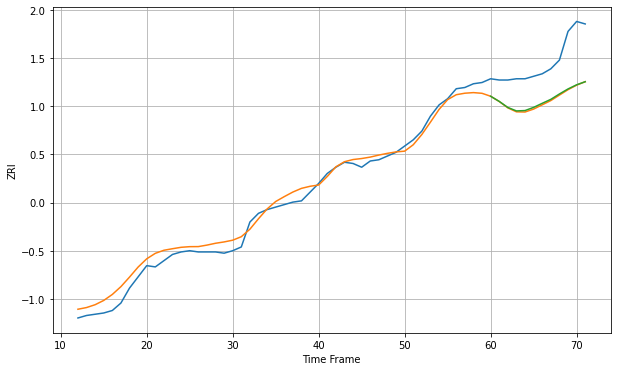

Wall time: 8.38 s
22192 6.379812211958238 31.771370182562432 31.204537754554636 [1442.97083311 1438.83918754 1433.97841955 1431.19823469 1431.49175191
 1434.02814623 1437.31386221 1440.47781233 1444.79179573 1448.82177299
 1452.16497612 1454.6412218 ]

Got an mse at 0.0025 in round 429 and stopped training

60 60 12


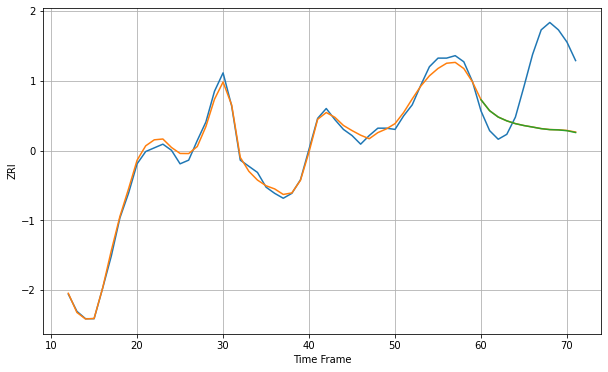

Wall time: 15.5 s
22201 4.151595759740006 53.63428648168472 53.72254545821724 [2123.1121353  2114.22078942 2109.06653321 2105.96451851 2103.69554298
 2102.1293606  2100.90145425 2099.61697246 2098.82760644 2098.59417436
 2097.94765924 2096.47514393]

Got an mse at 0.0025 in round 156 and stopped training

60 60 12


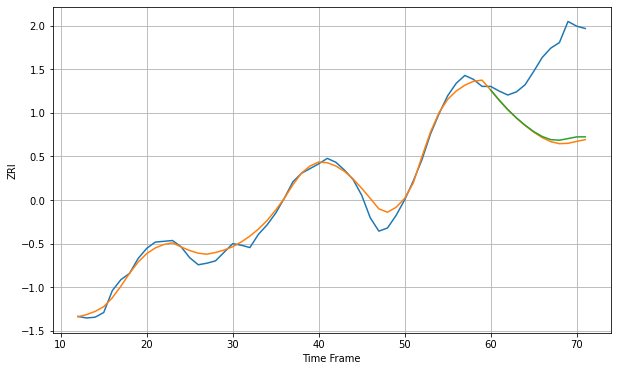

Wall time: 8.9 s
22202 8.907288804917778 99.13840212754867 96.28193939889212 [2154.40859569 2141.33257762 2129.3308571  2118.74368054 2109.47772817
 2101.33502329 2094.93347295 2090.94411337 2090.22756619 2092.31006865
 2094.44637592 2094.5458129 ]

Got an mse at 0.0025 in round 267 and stopped training

60 60 12


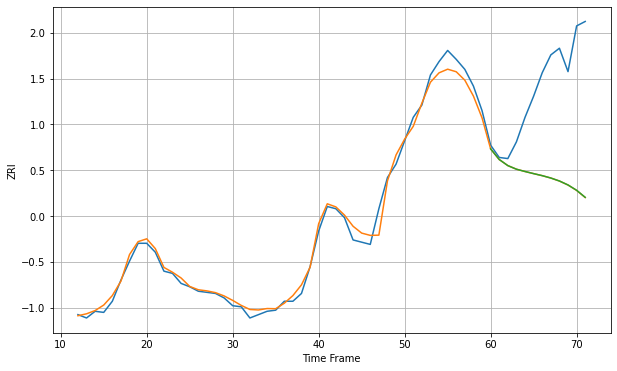

Wall time: 11.3 s
22203 6.778737959569849 91.21601285308098 91.16186539730361 [2065.68752967 2056.15423932 2050.69290446 2047.45604599 2045.39598142
 2043.49321439 2041.67974973 2039.55729532 2036.88670959 2033.33410297
 2028.55390803 2022.23175254]
60 60 12


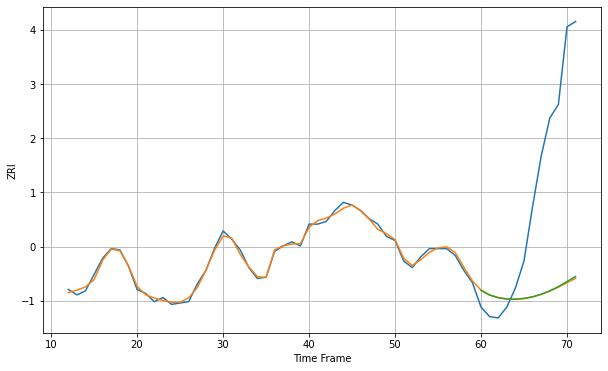

Wall time: 17.1 s
22204 2.0771257530989606 100.63015089081786 100.21516110922971 [1769.41386952 1765.85543708 1763.89840894 1762.90806527 1762.80387103
 1763.35247989 1764.53855727 1766.41758    1768.92341834 1772.07872709
 1775.76525769 1779.52549952]
60 60 12


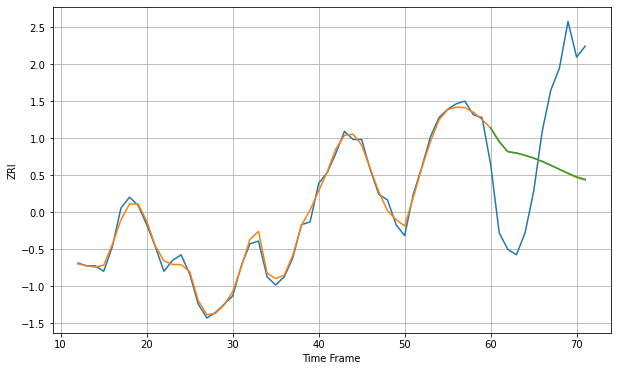

Wall time: 17.3 s
22206 1.910553584614866 34.715397762705685 34.64351519919804 [1889.19845702 1884.22956861 1880.57505688 1880.09475136 1879.2456967
 1878.26300779 1877.02786568 1875.62376279 1874.18113153 1872.74211656
 1871.39060175 1870.49041553]
60 60 12


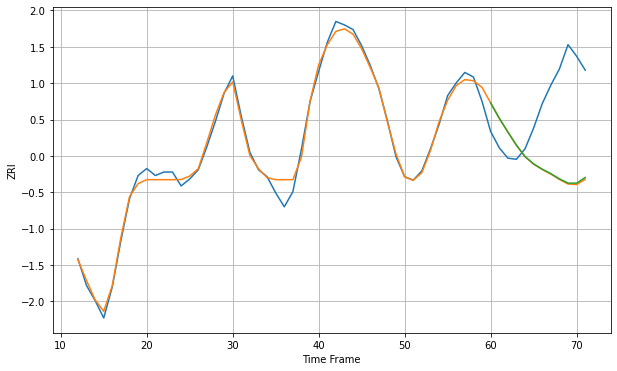

Wall time: 17 s
22209 5.85736858332367 68.80900450953733 68.21713884353184 [2253.67017328 2240.4855301  2228.59427994 2217.18170222 2207.40733051
 2200.99282964 2196.4853916  2192.64455946 2188.1259512  2184.44369377
 2184.40277751 2189.31449685]
60 60 12


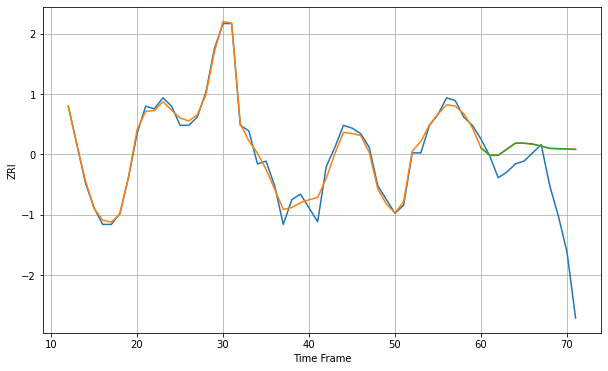

Wall time: 17.1 s
22303 2.3808883835990544 22.71302928403096 22.72607817370212 [1719.81816764 1717.21678259 1717.132445   1719.34040207 1721.5218159
 1721.50965053 1721.20449901 1720.47296283 1719.62596184 1719.51081789
 1719.42468736 1719.28026949]

Got an mse at 0.0024 in round 427 and stopped training

60 60 12


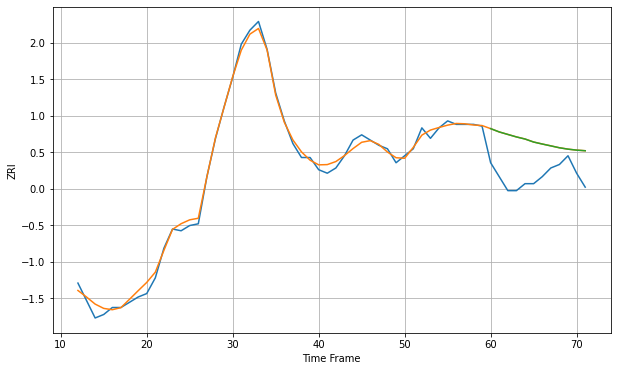

Wall time: 15.5 s
22304 2.910198211893814 21.38365240015399 21.373794845977798 [1597.559956   1595.65902056 1594.2260288  1592.79942526 1591.60100894
 1589.86993886 1588.73396852 1587.67005781 1586.58116276 1585.7892249
 1585.22791368 1584.8844043 ]
60 60 12


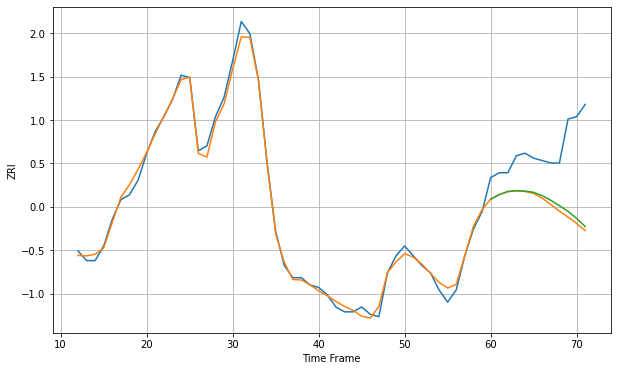

Wall time: 17.2 s
22305 2.3442778345640356 25.807518897448347 24.625998286451424 [1759.16272873 1761.07078369 1762.30767389 1762.66467992 1762.49108821
 1761.99142716 1760.62006254 1758.70557891 1756.50119083 1754.16595217
 1751.29566819 1747.99567234]
60 60 12


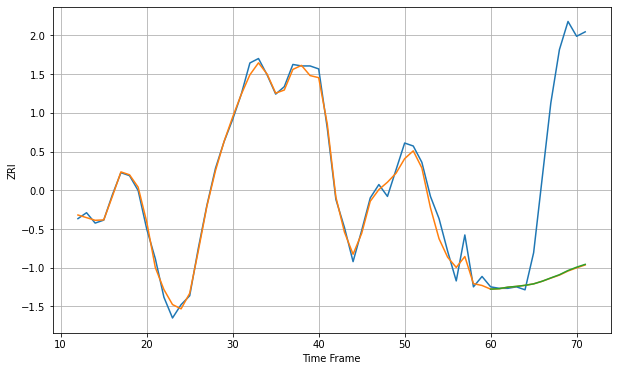

Wall time: 17.3 s
22312 5.152397712111052 99.93290105576163 99.73122504011874 [1689.4526578  1689.79470516 1690.77427356 1691.29593848 1692.01608375
 1693.00748372 1694.79505636 1697.01530397 1699.17197454 1702.00810563
 1704.26073682 1706.16891466]

Got an mse at 0.0025 in round 234 and stopped training

60 60 12


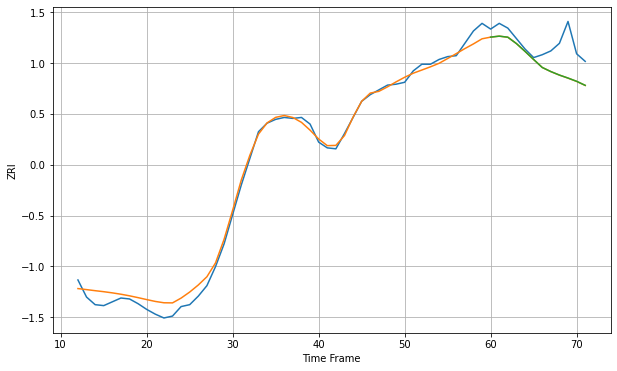

Wall time: 10.9 s
22901 7.583137758758701 24.48269766375734 24.441844790555834 [1270.5191496  1271.56056628 1270.42902564 1263.73153596 1255.5387702
 1246.98898127 1238.60869002 1234.2823063  1230.60148057 1227.45253525
 1224.03803506 1219.78695709]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


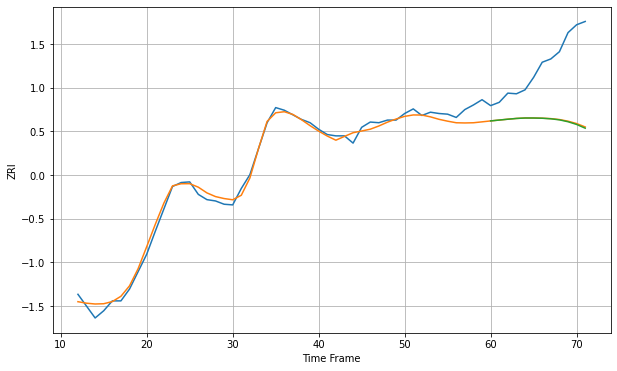

Wall time: 9.72 s
22903 10.160366224582543 92.41322373598193 93.06191073565978 [1404.73263801 1406.03722038 1407.31578807 1408.47299778 1409.1374411
 1409.11356916 1408.78977531 1407.95637056 1406.34884763 1403.48181992
 1399.35644624 1393.66270757]

Got an mse at 0.0024 in round 306 and stopped training

60 60 12


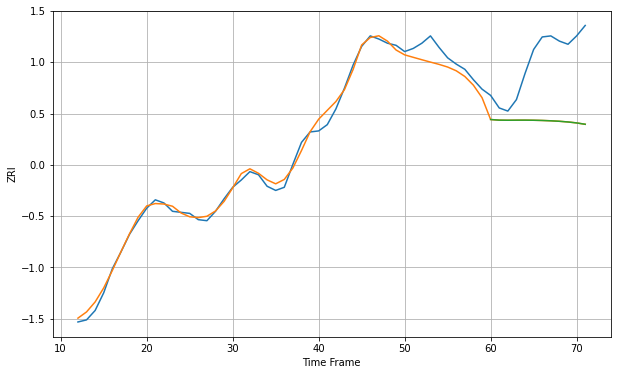

Wall time: 13.4 s
23220 7.100805637444852 63.295512668311204 63.29741793358471 [1131.91104668 1131.31415888 1131.2156804  1131.28707905 1131.30761939
 1131.2073976  1131.00766139 1130.68376758 1130.21571453 1129.56265636
 1128.65119687 1127.36798686]

Got an mse at 0.0025 in round 258 and stopped training

60 60 12


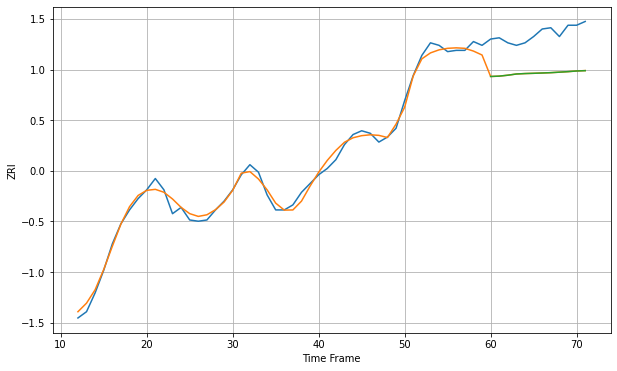

Wall time: 11.2 s
23223 4.452738352461792 31.605651268651094 31.604778608959027 [1113.20149873 1113.49590601 1114.22415476 1115.1979459  1115.54233967
 1115.74730427 1115.98448394 1116.25813022 1116.64682666 1117.07266304
 1117.59002534 1117.84793504]

Got an mse at 0.0025 in round 330 and stopped training

60 60 12


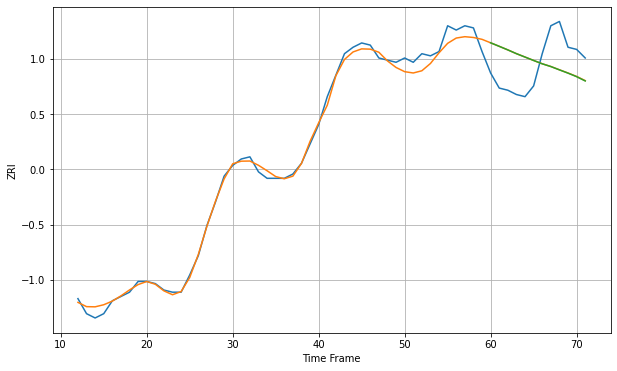

Wall time: 13.3 s
23294 3.061125921429265 15.993879304011093 16.019551738032995 [1087.06545281 1085.42769571 1083.76636807 1082.01042308 1080.43599046
 1078.84753553 1077.2958425  1076.01921963 1074.4693382  1072.95313074
 1071.31282128 1069.3090633 ]
60 60 12


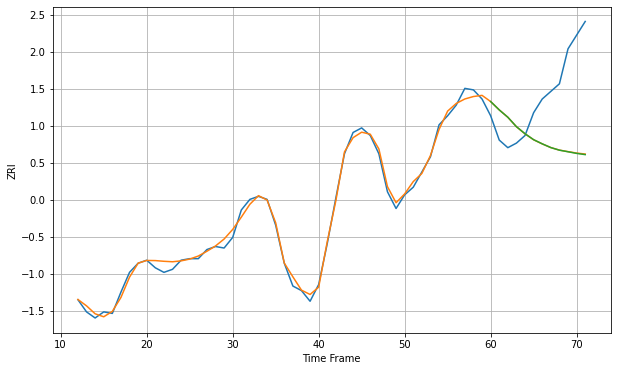

Wall time: 17.7 s
23451 3.1988187298712543 44.3820689208132 44.488184980228496 [1196.33519872 1190.84862963 1186.01747187 1179.81464095 1175.16027386
 1171.2559372  1168.52925357 1166.06670243 1164.35789792 1163.30357417
 1162.23398708 1161.43385193]

Got an mse at 0.0025 in round 457 and stopped training

60 60 12


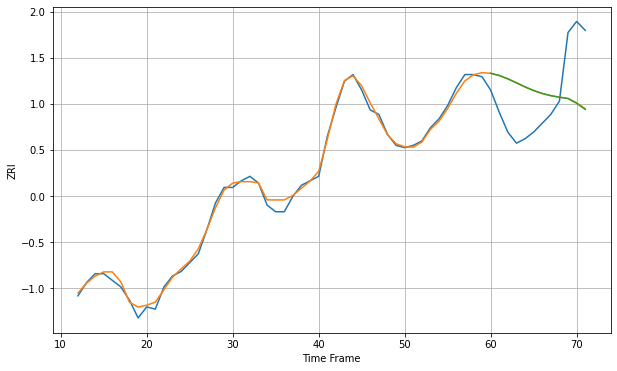

Wall time: 15.9 s
23452 2.0356681296721155 22.9261610936417 22.997436797639033 [1204.58562251 1203.58224207 1202.07387361 1200.27352383 1198.43770036
 1196.77353741 1195.45364362 1194.47259398 1193.77709198 1193.19601241
 1191.04459261 1188.23714875]

Got an mse at 0.0025 in round 343 and stopped training

60 60 12


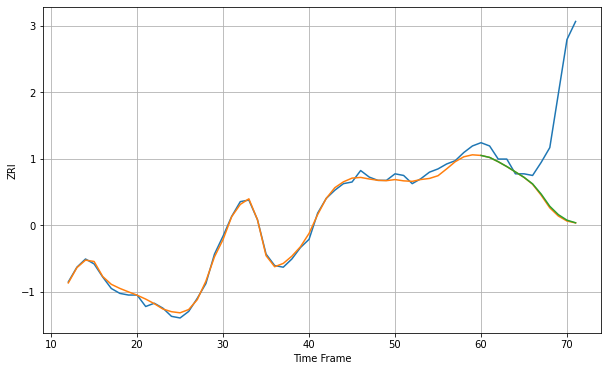

Wall time: 14.1 s
23454 2.192842105738413 53.94604898273431 53.663384726228145 [1154.21821896 1153.007081   1150.39556829 1147.43269054 1144.18259758
 1140.88021073 1136.85915696 1130.62785069 1123.1788768  1118.0629355
 1114.70317574 1113.11231763]

Got an mse at 0.0025 in round 226 and stopped training

60 60 12


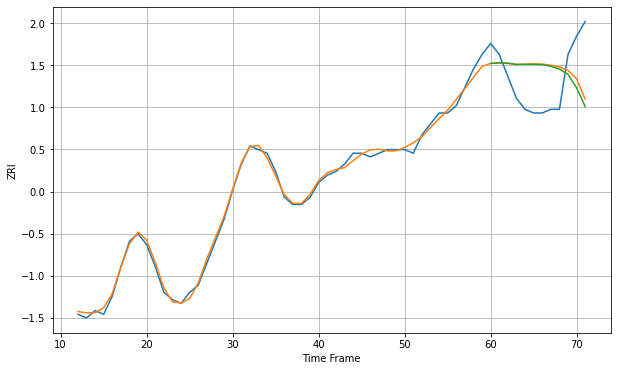

Wall time: 10.5 s
23503 1.1741985277050793 11.281581711078355 11.780860792250719 [827.53363276 827.73130281 827.59657491 827.27542856 827.29990349
 827.29341284 827.21505147 826.7424332  825.98112124 824.55945269
 820.83972213 815.75684474]

Got an mse at 0.0025 in round 406 and stopped training

60 60 12


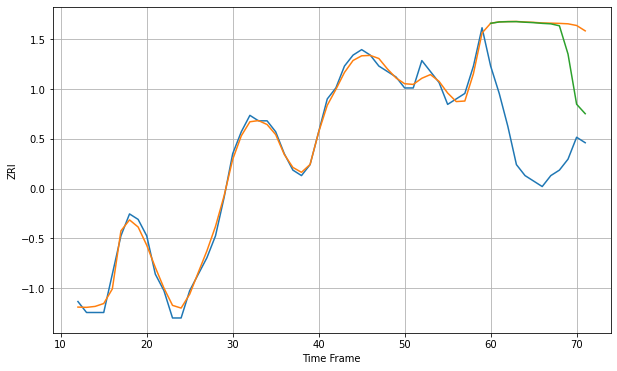

Wall time: 15.4 s
23518 1.1911850547621603 23.69429430367644 21.76057686210309 [831.80553477 832.05197599 832.10309985 832.11543182 832.00609282
 831.9287439  831.79700215 831.71004928 831.3515249  826.18980638
 817.02957474 815.30272377]

Got an mse at 0.0024 in round 273 and stopped training

60 60 12


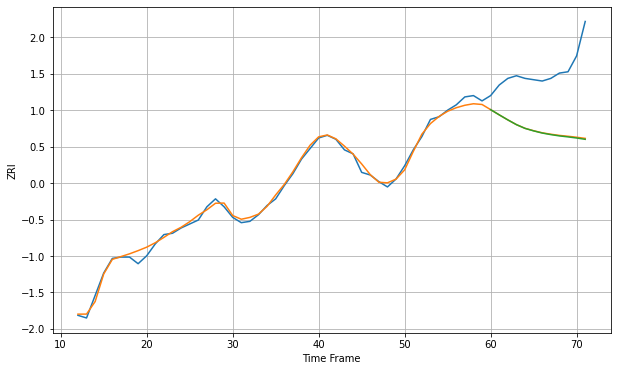

Wall time: 11.8 s
23602 3.0133818616440755 45.96472712095714 46.26820944473437 [992.38035964 988.44263734 984.63668879 981.05525318 978.22865098
 976.3358104  974.70015658 973.5245334  972.54670849 971.79555488
 970.95576828 969.97097564]

Got an mse at 0.0025 in round 129 and stopped training

60 60 12


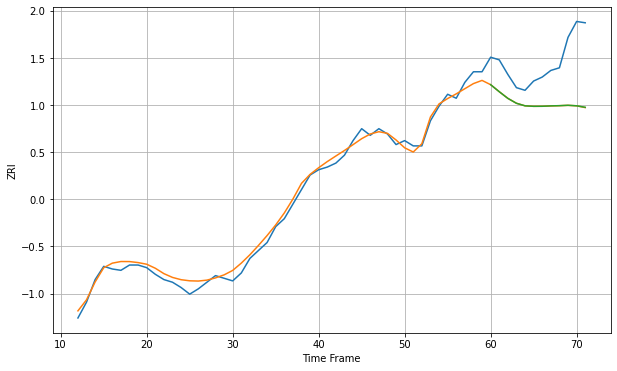

Wall time: 8.38 s
23666 4.464354969553079 35.12849672621325 35.08022715029656 [1051.24556871 1045.9405094  1040.89998675 1037.19058094 1035.26889337
 1034.9018068  1034.9434952  1035.2230549  1035.39340467 1035.67692403
 1035.29781504 1034.16762696]
60 60 12


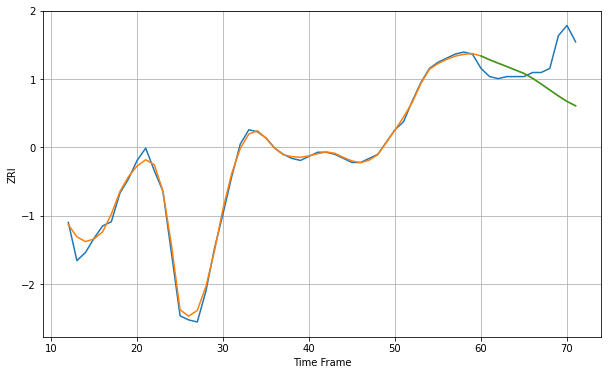

Wall time: 17 s
23803 2.6485931216675174 17.262030837071606 17.268055421916387 [928.09457837 926.21767469 924.54895802 922.91507129 921.22973365
 919.52889733 917.16679226 914.3620986  911.43944035 908.53558705
 905.84513373 903.7003633 ]

Got an mse at 0.0025 in round 209 and stopped training

60 60 12


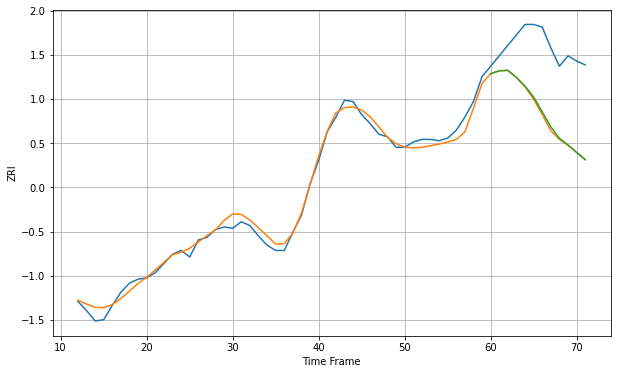

Wall time: 10.1 s
23831 4.916310505985302 52.89639379761859 52.13511596545354 [1098.34662373 1100.50342158 1100.91847215 1095.44703613 1088.82884047
 1080.48695408 1069.17342737 1057.57142189 1048.90528743 1043.73821286
 1037.97334836 1032.4109743 ]
60 60 12


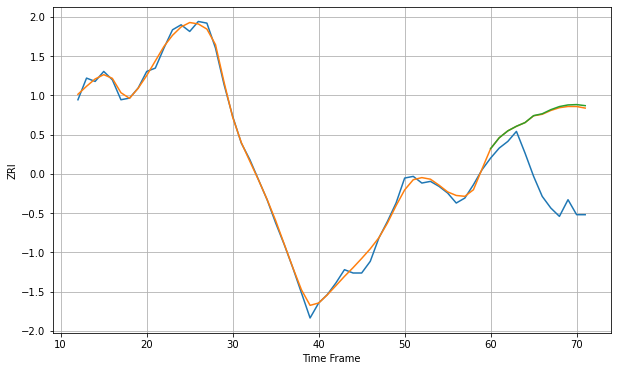

Wall time: 17.2 s
26003 3.1507789360579004 44.09702741946405 44.69235521010917 [837.66096304 844.19058969 848.32380541 851.09016114 853.30505068
 857.4775288  858.58264579 861.05731969 862.92206497 863.90005471
 864.10005699 863.45629601]
60 60 12


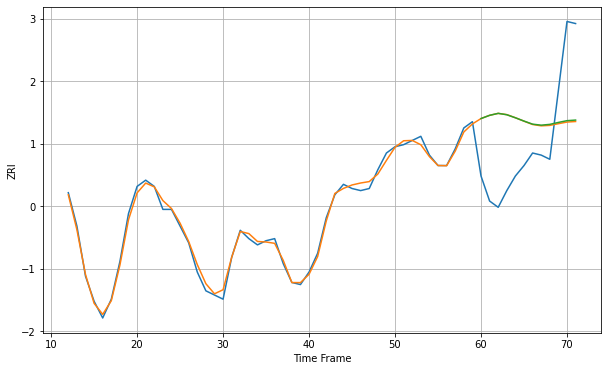

Wall time: 17.1 s
26505 2.022174146199756 32.19963548764787 32.04322877565008 [965.50315081 967.04675584 967.99379819 967.3265711  965.86950174
 964.29223578 962.82204398 962.33701488 962.71532161 963.64883134
 964.48852942 964.77410367]

Got an mse at 0.0024 in round 157 and stopped training

60 60 12


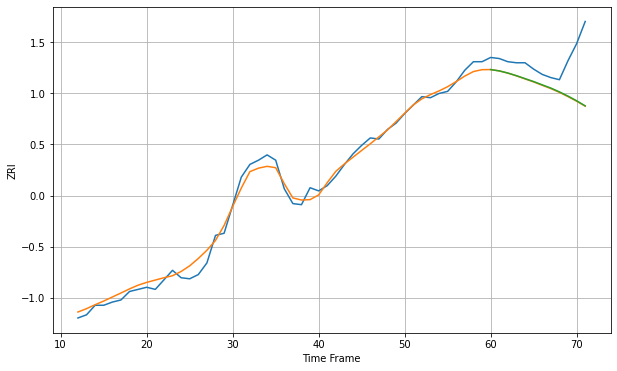

Wall time: 9.33 s
27513 6.182384199354769 31.32025322944043 31.08812277824886 [1189.57566212 1188.33305439 1186.30416399 1183.7983938  1181.02304777
 1178.26808026 1175.16061456 1172.11552385 1168.52354743 1164.51038914
 1160.12731044 1155.2770408 ]

Got an mse at 0.0025 in round 308 and stopped training

60 60 12


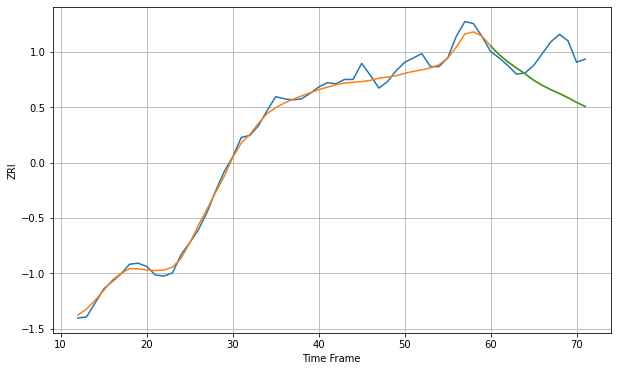

Wall time: 12.7 s
27560 5.9445329582578035 32.01272618487951 32.007387967351235 [1313.2180337  1305.04362965 1298.40419622 1292.74578062 1287.2900936
 1281.36305258 1276.6090261  1272.54100512 1268.84792981 1265.03576434
 1260.68990989 1256.87886328]

Got an mse at 0.0025 in round 159 and stopped training

60 60 12


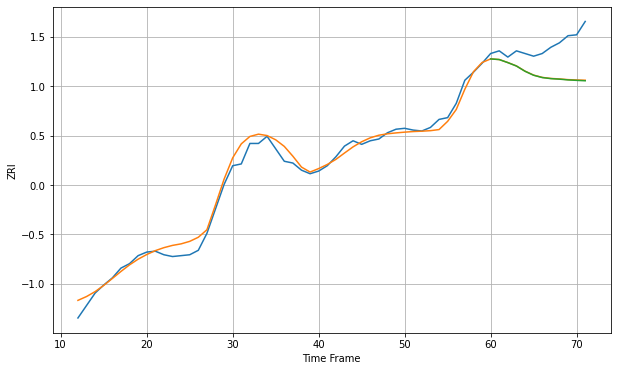

Wall time: 9 s
27606 8.127847043661154 34.451996894034366 34.71836286308252 [1190.93702789 1190.21193648 1186.78247469 1182.95873014 1177.07192928
 1172.59286159 1170.0065309  1168.8041206  1168.20872261 1167.36883612
 1166.84910862 1166.39397164]

Got an mse at 0.0025 in round 140 and stopped training

60 60 12


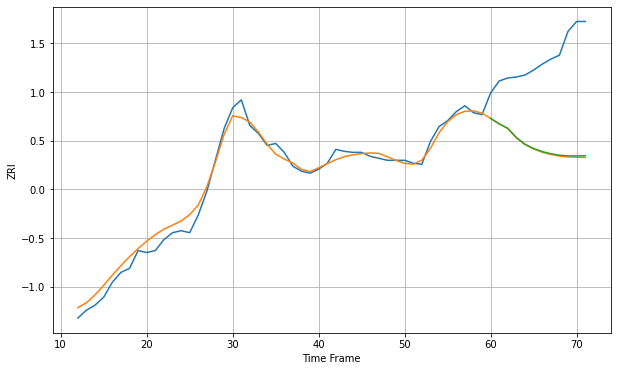

Wall time: 8.99 s
27609 7.554428852390738 91.83184362625884 91.05598250072572 [1108.24458576 1102.75219942 1098.16473603 1088.90504862 1082.2134361
 1077.93632439 1074.7996215  1072.63708895 1071.18554512 1070.42381403
 1070.37840878 1070.63751275]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


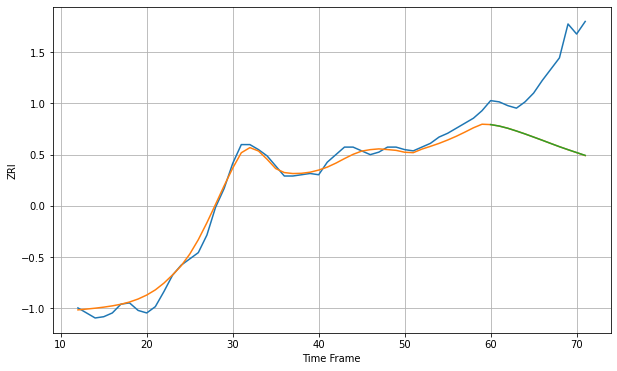

Wall time: 9.41 s
27612 5.678196841567995 60.776835436083786 60.747557153157 [1080.91705023 1079.74507179 1077.9893343  1075.81182215 1073.47946162
 1070.98556818 1068.47535417 1065.8882553  1063.33835858 1060.96478224
 1058.67357038 1056.39138425]

Got an mse at 0.0025 in round 116 and stopped training

60 60 12


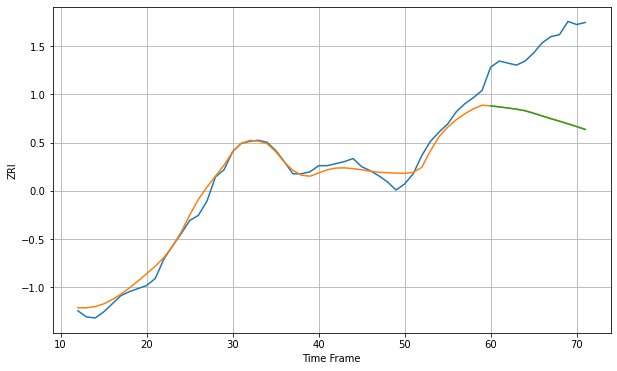

Wall time: 8.1 s
27613 7.407719738903204 72.67498129904709 72.83263169555318 [1109.92365831 1108.8485017  1107.77505646 1106.63928816 1105.03716587
 1102.54448794 1099.8646941  1097.19466208 1094.71168747 1092.13919558
 1089.43342225 1086.62121844]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


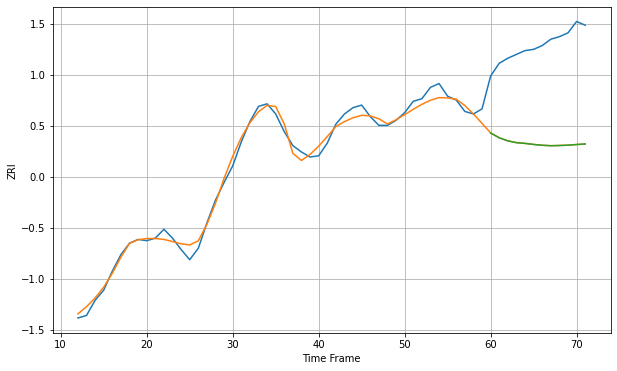

Wall time: 8.85 s
27615 5.260778343169127 77.59158573243747 77.62247118861065 [1084.99703121 1081.20921635 1078.76108009 1077.34305853 1076.74095381
 1075.92636724 1075.28827676 1074.9145802  1075.08635154 1075.34343868
 1075.85798218 1076.36986101]

Got an mse at 0.0025 in round 235 and stopped training

60 60 12


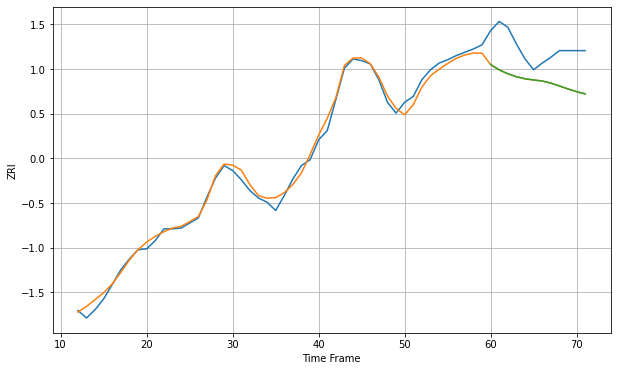

Wall time: 10.7 s
27703 6.8738266226693225 41.760252779951216 41.71128195991716 [1079.23363697 1072.8283113  1068.19817625 1064.67047965 1062.21318905
 1060.81547962 1059.53621428 1057.03649072 1053.59034804 1050.00036426
 1046.76798932 1044.04393945]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


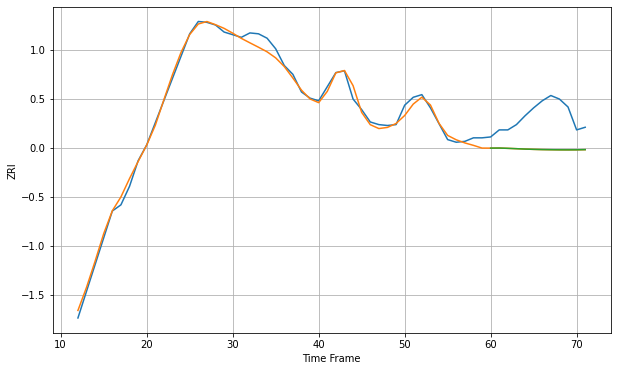

Wall time: 9.93 s
27705 6.219649031637067 39.893452350629474 39.8754401714637 [1200.33284415 1200.4116973  1200.0798035  1199.69908978 1199.24661396
 1198.92563608 1198.67535659 1198.53260124 1198.41448812 1198.38228239
 1198.42864224 1198.62937981]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


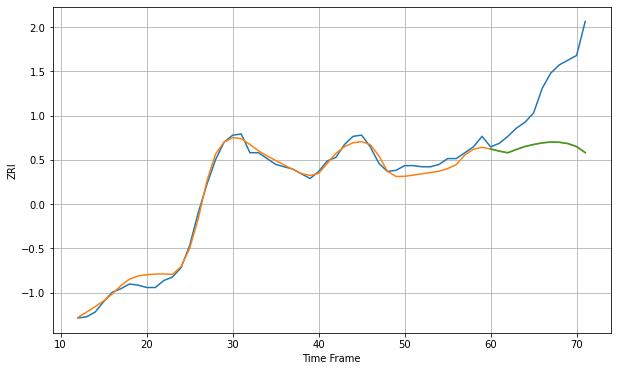

Wall time: 8.77 s
27707 4.934670444919517 54.34684055512824 54.263204295570276 [1038.24415066 1036.38007161 1034.97692565 1037.80452873 1040.31826052
 1042.01174418 1043.38232541 1044.13583835 1043.91237928 1042.82359341
 1040.29170278 1035.22887447]

Got an mse at 0.0025 in round 275 and stopped training

60 60 12


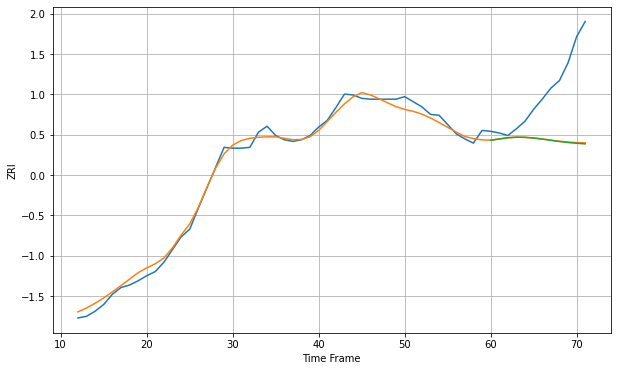

Wall time: 11.5 s
27713 6.806549812570691 69.55972071284447 70.03356742104512 [1049.40527303 1050.89295698 1052.37704096 1052.97255827 1052.81335106
 1052.01616272 1050.76728387 1049.30107747 1047.89979009 1046.67786624
 1045.81071527 1045.06324479]

Got an mse at 0.0025 in round 187 and stopped training

60 60 12


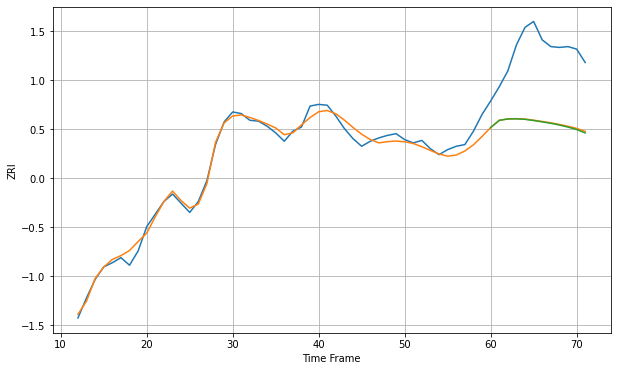

Wall time: 9.6 s
28202 7.924840299114202 86.85264027817162 87.48562621165235 [1502.27992828 1510.93155831 1512.55497091 1512.7300136  1512.14768636
 1510.73017207 1509.11275981 1507.42425751 1505.34436818 1502.87377731
 1499.9814324  1495.89614069]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


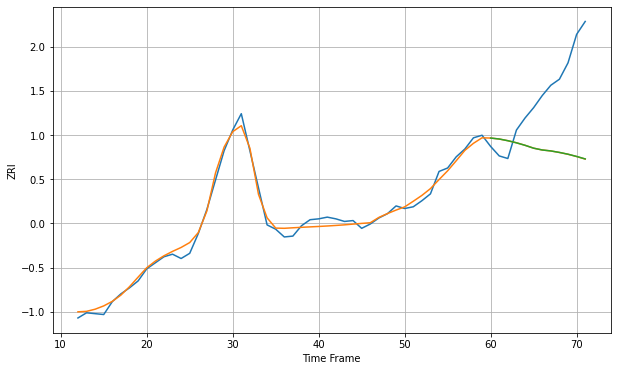

Wall time: 10.5 s
28210 6.216412871816655 80.71031107294884 80.6534553703156 [1278.72981234 1277.62754645 1275.65139219 1273.22705252 1270.32575225
 1266.99043182 1264.90499744 1263.80367033 1262.05712473 1259.99397304
 1257.40129856 1254.52476989]

Got an mse at 0.0025 in round 272 and stopped training

60 60 12


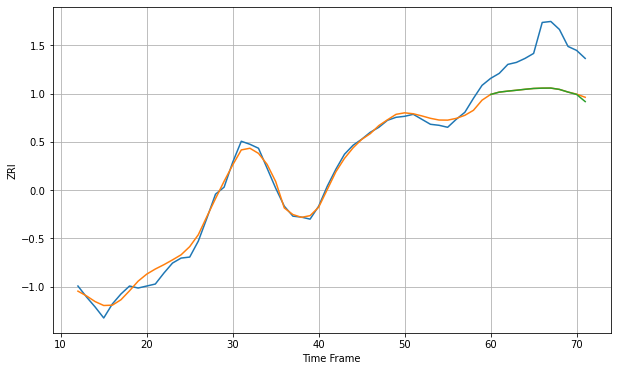

Wall time: 11.7 s
28216 6.049403035016661 43.02254883237586 43.38705425492895 [1261.90193356 1264.21425327 1265.22920446 1266.10072181 1267.05144256
 1267.88425044 1268.21199646 1268.28762616 1266.94725384 1264.28649809
 1261.88688266 1254.7497344 ]

Got an mse at 0.0025 in round 70 and stopped training

60 60 12


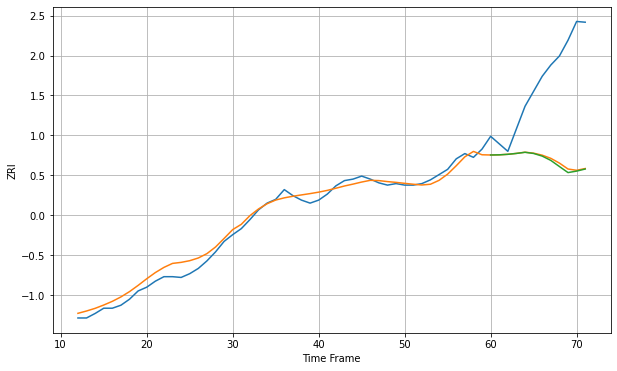

Wall time: 7.02 s
28262 8.507456500409111 117.63980591718824 119.2945873754966 [1058.11603682 1058.33044812 1059.01854245 1060.2102074  1061.70671944
 1060.15002746 1056.62623282 1050.89800434 1042.74551185 1034.68336608
 1036.64904937 1039.43560647]

Got an mse at 0.0025 in round 328 and stopped training

60 60 12


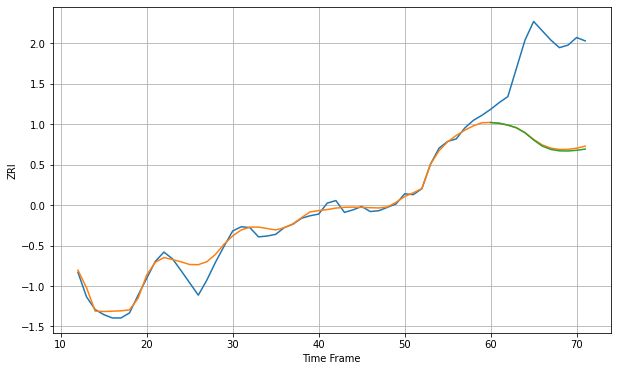

Wall time: 12.9 s
28269 8.568507970000711 106.26213697927388 107.59672815884743 [1140.4041509  1139.46558488 1137.36644142 1134.11095719 1128.17284005
 1119.73418325 1112.456348   1108.55747032 1106.84614073 1106.64584428
 1107.4775948  1108.96029875]

Got an mse at 0.0025 in round 181 and stopped training

60 60 12


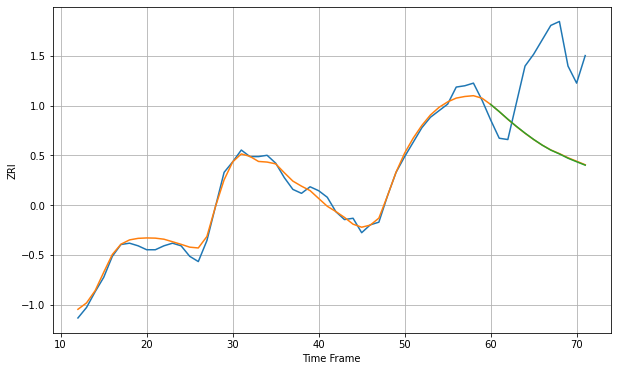

Wall time: 9.51 s
28273 4.644899377168601 63.85023703340411 63.972823480089225 [1205.77932342 1200.3243911  1194.51967615 1189.04321748 1183.89903549
 1179.10263352 1174.73682245 1170.94698031 1168.03149361 1164.76708465
 1162.08419597 1159.46743281]

Got an mse at 0.0025 in round 136 and stopped training

60 60 12


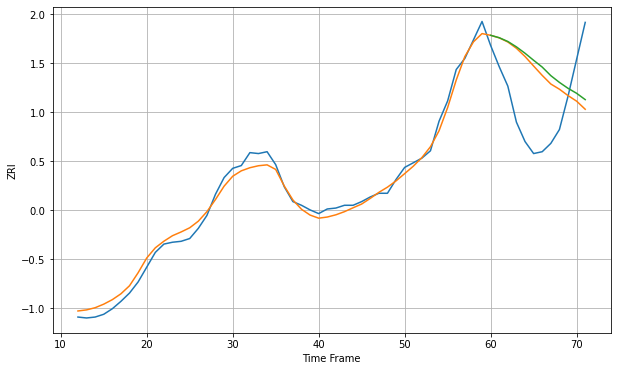

Wall time: 8.24 s
28277 7.809761280977844 65.18077272639378 67.21263366047299 [1421.01897213 1418.39179555 1414.34176552 1408.49848947 1401.58801059
 1393.96312922 1386.61378105 1377.34702886 1370.03878942 1363.63522005
 1358.23533485 1351.39374172]
60 60 12


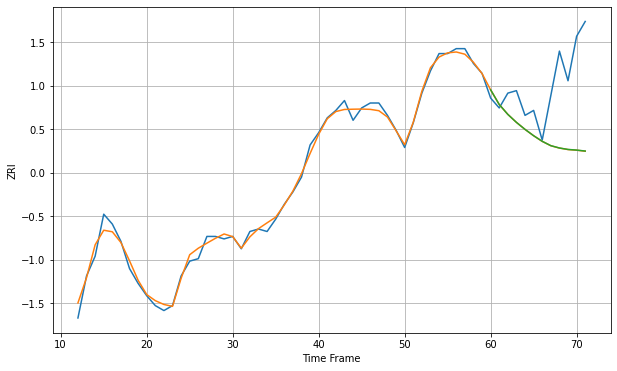

Wall time: 17.4 s
29205 2.3526327589423155 25.820058026642403 25.787419406635898 [823.32722869 817.3949228  813.39604041 810.16015718 807.32297012
 804.76632726 802.49258731 800.73743189 799.79567718 799.20384611
 798.9481115  798.56128665]

Got an mse at 0.0025 in round 139 and stopped training

60 60 12


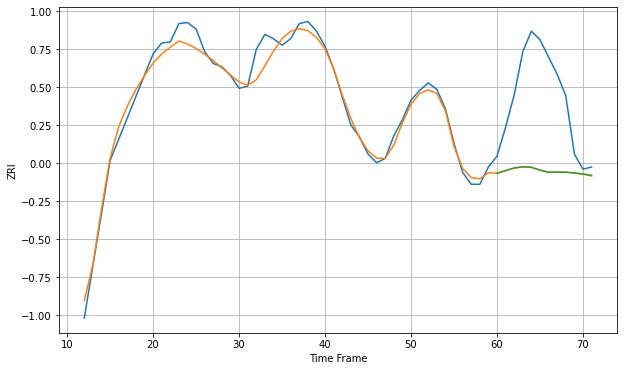

Wall time: 8.22 s
29403 9.284496717561334 78.30662311011973 78.24820994007622 [1807.19787365 1809.72059527 1812.06960886 1813.22888724 1812.72161503
 1810.21568781 1808.09584423 1808.30062526 1808.20329874 1807.53522977
 1806.63714695 1805.2243441 ]

Got an mse at 0.0025 in round 481 and stopped training

60 60 12


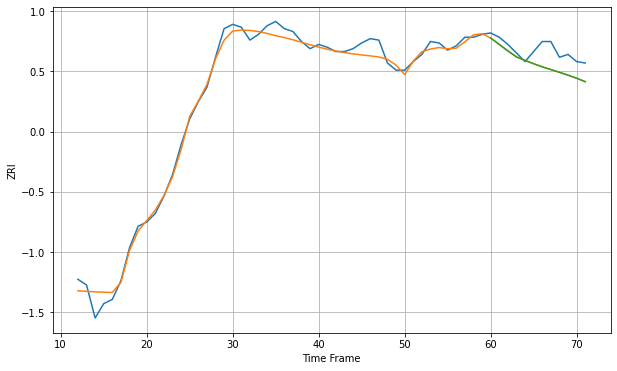

Wall time: 16.8 s
29414 5.312801148616401 11.018044743274226 11.02872735944779 [1328.46308994 1323.99033055 1319.45793419 1315.27012481 1312.79844889
 1310.49396675 1308.35140329 1306.40590814 1304.50853839 1302.51344349
 1300.36897767 1297.950037  ]

Got an mse at 0.0025 in round 461 and stopped training

60 60 12


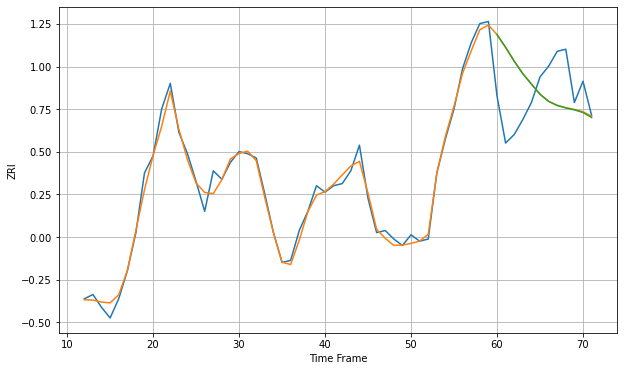

Wall time: 16.2 s
29464 3.626759849926039 23.291157992961974 23.33420437862603 [1567.83511628 1561.85820907 1555.41097505 1549.50195123 1544.6572872
 1539.85870287 1536.53442151 1534.6032716  1533.46664162 1532.55624269
 1531.32584937 1528.98277232]

Got an mse at 0.0025 in round 81 and stopped training

60 60 12


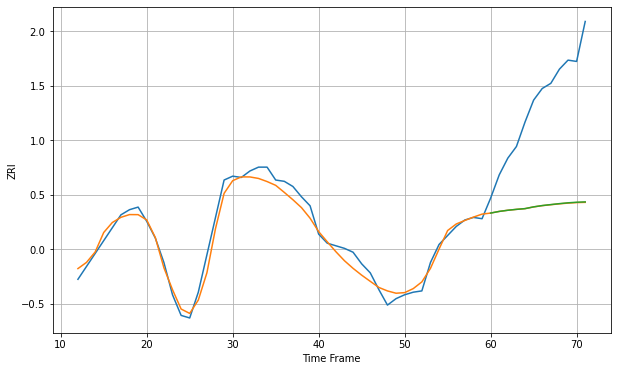

Wall time: 7.07 s
29607 6.33675098693151 85.80194081816944 85.66230013597918 [1002.3795989  1003.6556561  1004.56004127 1005.25109726 1005.82575316
 1007.18844771 1008.20106837 1008.95790034 1009.69426225 1010.32268851
 1010.77634486 1011.04065423]

Got an mse at 0.0025 in round 176 and stopped training

60 60 12


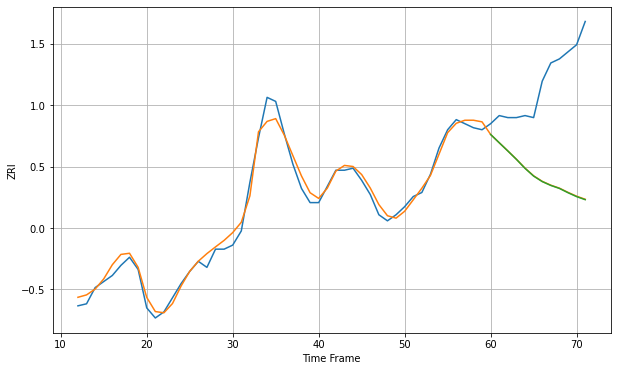

Wall time: 9.36 s
29615 3.929069700668432 50.59738713041294 50.71731309081117 [998.66844633 994.57103172 990.5163074  986.36379115 981.93275563
 978.11034033 975.38984171 973.48168686 972.01207051 969.88764574
 967.96187168 966.45558569]

Got an mse at 0.0025 in round 218 and stopped training

60 60 12


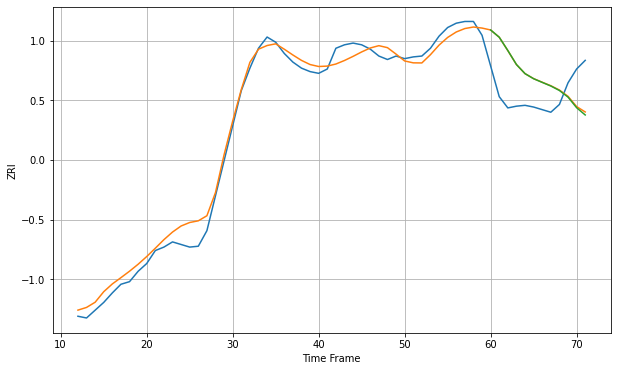

Wall time: 10.2 s
30024 11.246485376701177 44.26216683065811 44.773052811459166 [1486.13891608 1477.78704724 1462.38036464 1446.23906802 1435.65542675
 1429.76884721 1425.52042111 1421.34326644 1416.15253093 1408.50706041
 1396.24229708 1387.84261171]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


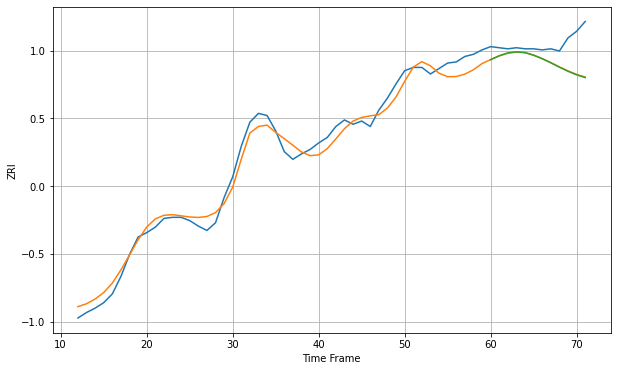

Wall time: 8.09 s
30043 8.813327357478864 21.887782731936593 22.101309490412554 [1289.12275159 1292.64131804 1295.19941966 1296.18077109 1295.5379552
 1293.19837283 1289.93867454 1286.24027252 1282.20931435 1278.49865926
 1275.20392556 1272.70574624]

Got an mse at 0.0025 in round 115 and stopped training

60 60 12


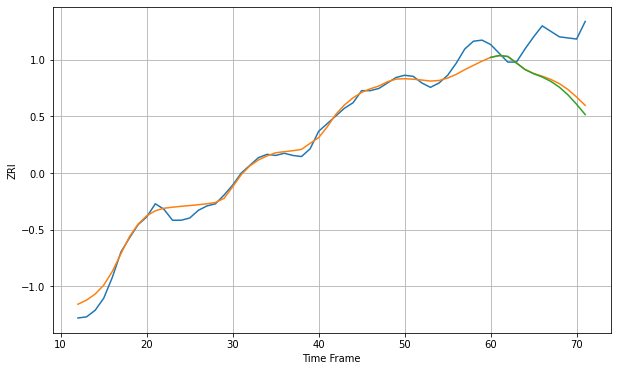

Wall time: 7.79 s
30044 7.7217399127006825 39.05204751700496 42.236287871365484 [1132.30168208 1133.93123581 1133.09227048 1127.18830215 1121.23101338
 1117.42310264 1114.41020429 1110.46575282 1105.13166702 1098.13902244
 1089.55710473 1080.21471076]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


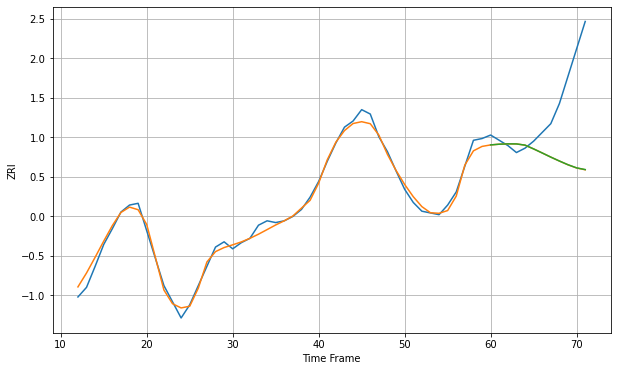

Wall time: 9.55 s
30046 6.319026523583439 73.1268135196446 73.05237801808916 [1043.71814206 1044.52691081 1044.91141623 1044.84768963 1043.46288394
 1039.14303494 1034.50298443 1029.77824029 1025.29898738 1021.0552518
 1017.49109425 1015.53709493]

Got an mse at 0.0024 in round 83 and stopped training

60 60 12


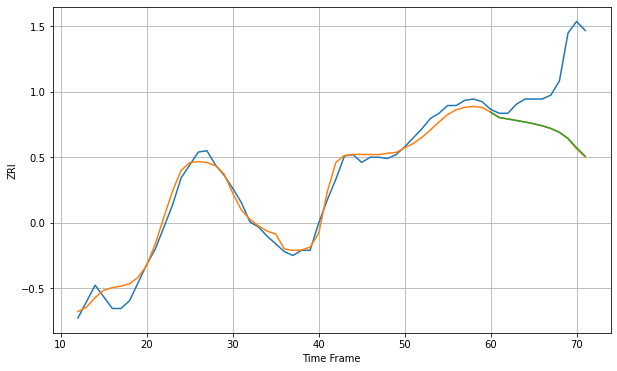

Wall time: 7.06 s
30080 6.599864387827776 49.57652970323759 49.291952757365515 [1248.83792525 1244.69594956 1243.57496766 1242.4364329  1241.22965859
 1239.89458012 1238.30514443 1236.24510906 1233.29661382 1228.62368981
 1221.32563812 1214.77754079]

Got an mse at 0.0025 in round 118 and stopped training

60 60 12


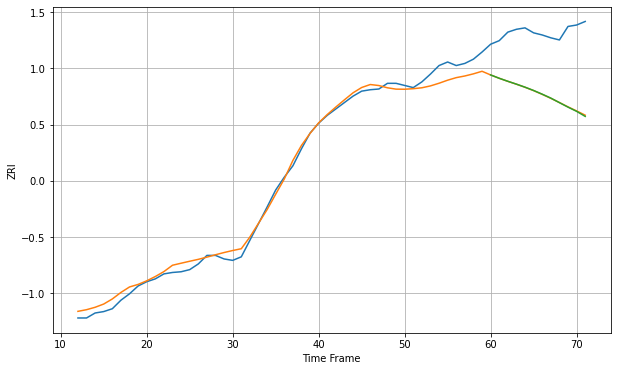

Wall time: 8.3 s
30093 10.69107116624086 89.32248136177499 89.56684548111866 [1121.78543074 1117.10974825 1112.85685805 1108.8396894  1104.58274436
 1099.9206637  1094.73254671 1089.2267729  1082.83240243 1076.52739175
 1070.58281758 1063.49600762]

Got an mse at 0.0025 in round 189 and stopped training

60 60 12


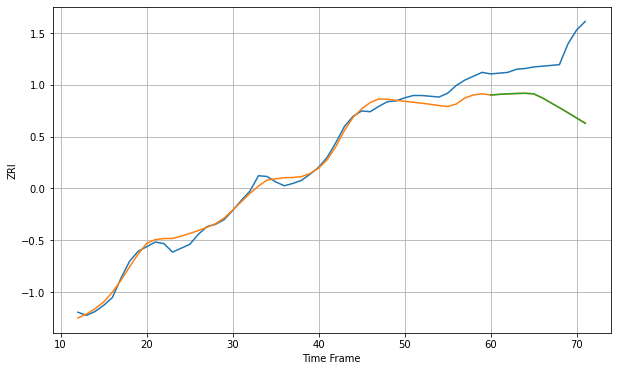

Wall time: 9.42 s
30096 10.22025195470392 65.11699593058599 65.28580473590732 [1249.67050425 1250.49237097 1251.15210548 1251.63960812 1251.90629751
 1251.26979534 1245.99086503 1239.58698172 1233.22901126 1226.55404724
 1219.71475138 1212.89995022]

Got an mse at 0.0025 in round 78 and stopped training

60 60 12


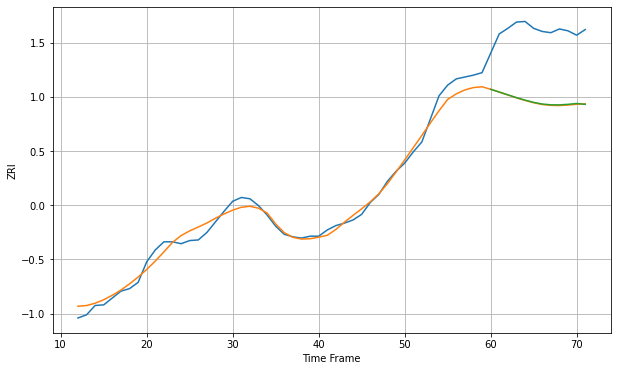

Wall time: 6.67 s
30097 11.917337775022434 112.21226932124861 111.70865703307626 [1450.35133745 1445.94742556 1441.44508458 1437.02256835 1432.985935
 1429.41086098 1426.74070403 1425.4730011  1425.37652898 1426.25169752
 1427.62729818 1426.21147545]

Got an mse at 0.0025 in round 125 and stopped training

60 60 12


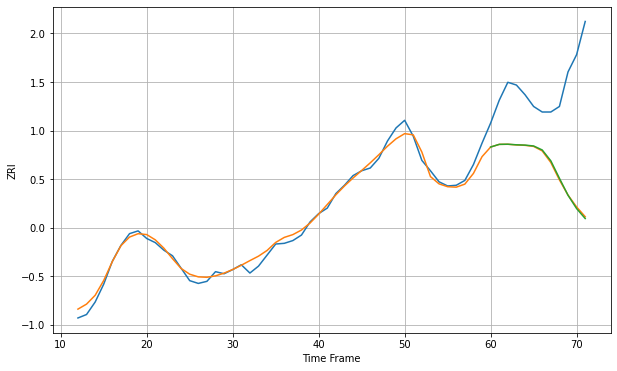

Wall time: 7.86 s
30305 8.270535664062738 132.11066973439662 132.5667124036087 [1695.31351019 1699.18280462 1699.40089787 1698.56326825 1698.11981303
 1696.86059653 1691.0843718  1675.36462473 1650.12338425 1625.584346
 1606.27650964 1591.8643506 ]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


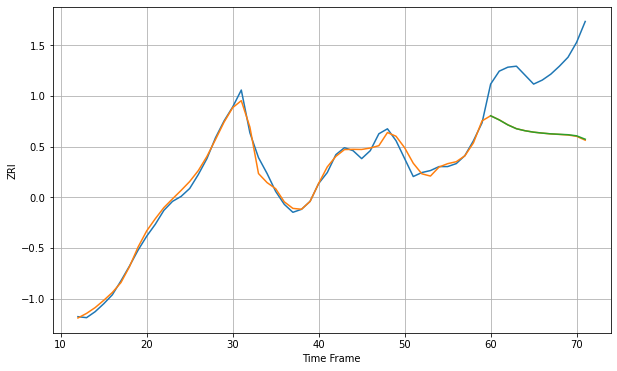

Wall time: 9.76 s
30306 5.4576352181807675 68.73096565043437 68.50950151397112 [1460.12675565 1455.93367683 1450.94248925 1447.0829109  1445.05631576
 1443.62012946 1442.69831713 1441.93724527 1441.47935959 1441.056827
 1439.94846535 1436.52991934]

Got an mse at 0.0025 in round 131 and stopped training

60 60 12


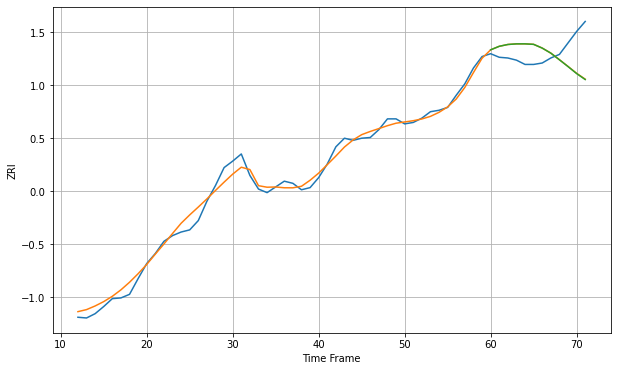

Wall time: 8.01 s
30308 9.232259043171384 34.472708951138905 34.62909172920467 [1656.4037459  1661.31240108 1663.84857912 1664.71262675 1664.73078664
 1664.04035419 1658.811735   1651.75456428 1642.49852187 1633.03206929
 1623.28052465 1614.92176587]

Got an mse at 0.0024 in round 127 and stopped training

60 60 12


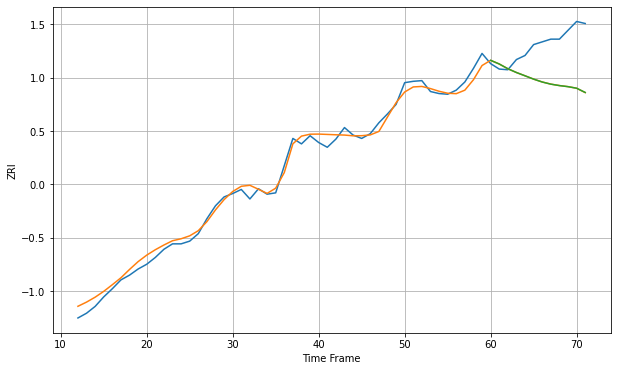

Wall time: 8.21 s
30309 9.592236712455536 60.03133137030139 60.02047913467129 [1660.85627585 1655.46426095 1648.49356354 1642.93598534 1638.10741806
 1633.20349736 1628.97867912 1625.81737926 1623.70650423 1622.1257754
 1619.83385725 1613.6180884 ]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


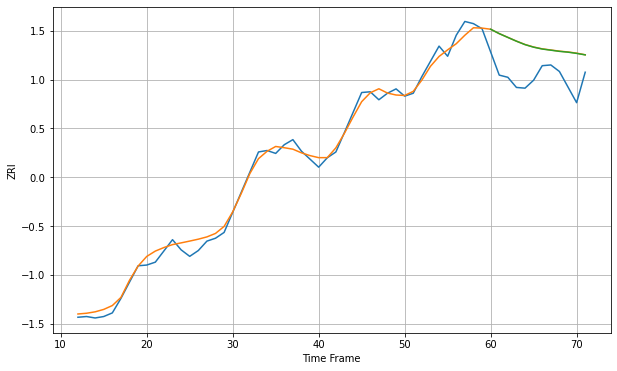

Wall time: 13.1 s
30310 8.77492862153752 46.930635310877285 46.771463475632736 [1193.28661082 1187.2285126  1181.99474722 1176.78736052 1172.05923915
 1168.53333392 1165.98488013 1164.38716572 1162.769512   1161.64093622
 1159.96127365 1157.913701  ]

Got an mse at 0.0025 in round 97 and stopped training

60 60 12


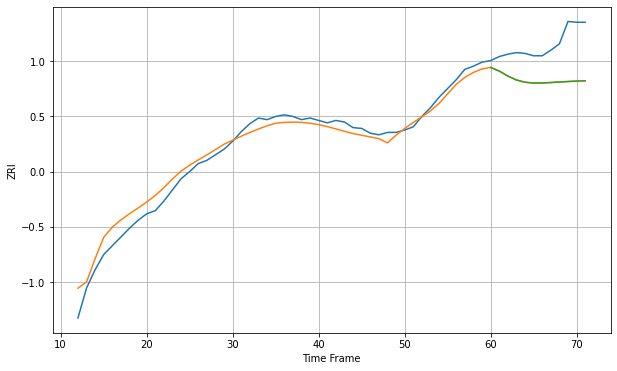

Wall time: 7.43 s
30318 11.882111796276202 46.810533403933206 46.908506402949044 [1436.40980369 1431.84142612 1425.57191957 1420.65526479 1417.80671435
 1416.77638015 1416.86617034 1417.44266649 1418.1399069  1418.70100424
 1419.27428809 1419.63600076]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


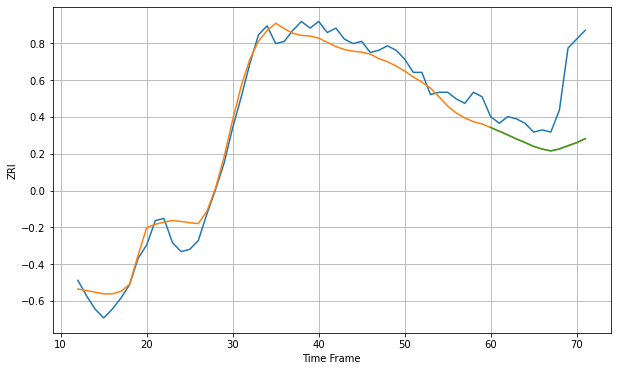

Wall time: 10.2 s
30319 6.2749173158924 24.700790651200258 24.642341793810214 [1563.09128848 1561.42581848 1559.70218814 1557.90532835 1556.28655801
 1554.55156515 1553.32611506 1552.52340214 1553.43649014 1554.88893697
 1556.25814926 1558.06285248]

Got an mse at 0.0025 in round 193 and stopped training

60 60 12


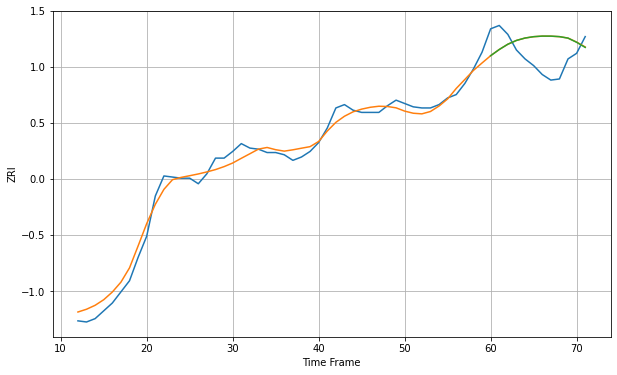

Wall time: 9.6 s
30324 7.358143011653926 24.036409842662405 24.065291383391692 [1505.87253292 1511.41999335 1516.15484876 1519.56158923 1521.72418799
 1522.94536426 1523.46546365 1523.44018103 1522.98733484 1521.65321062
 1517.91465808 1513.31203837]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


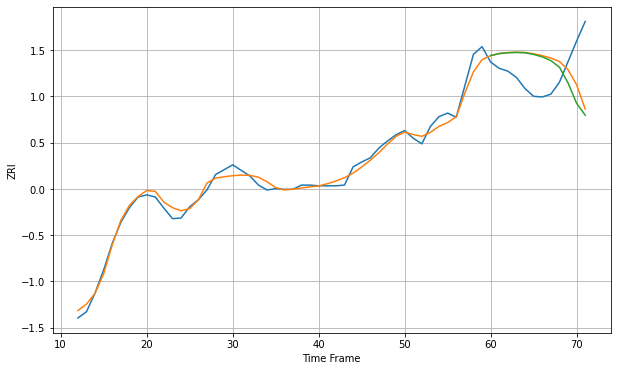

Wall time: 10.1 s
30326 8.765261197096066 54.506870391058364 58.86361361090106 [1666.1549352  1669.08470517 1670.27877494 1670.71026734 1670.18336957
 1667.86898183 1664.43799213 1659.04211994 1649.64098494 1627.12881971
 1597.95608909 1581.00684411]

Got an mse at 0.0025 in round 106 and stopped training

60 60 12


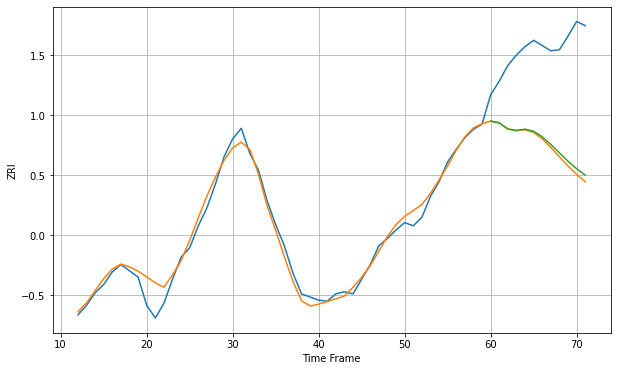

Wall time: 7.51 s
30328 8.80958242404573 96.13186553960524 93.28329997228177 [1512.92614239 1511.21232011 1505.38449171 1503.98073916 1505.21761542
 1503.20860894 1498.00412714 1490.58071    1482.52413593 1474.5812983
 1467.45469965 1461.40367294]

Got an mse at 0.0025 in round 80 and stopped training

60 60 12


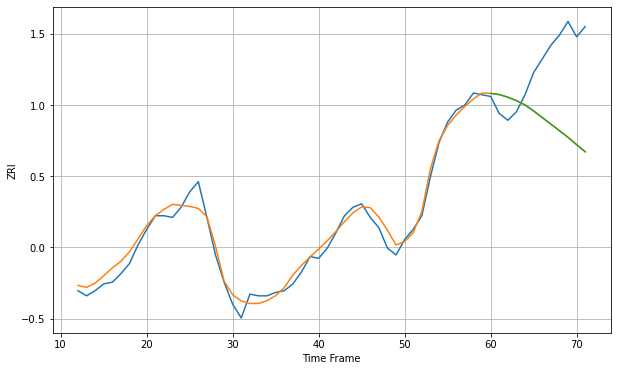

Wall time: 7.3 s
30329 5.149370006231271 42.21684688320625 42.21342107576326 [1484.80327504 1484.10244813 1482.5641874  1480.56407068 1478.00181561
 1474.4963237  1470.63969497 1466.79204499 1462.9284212  1459.01041399
 1454.69195576 1450.53319719]

Got an mse at 0.0025 in round 360 and stopped training

60 60 12


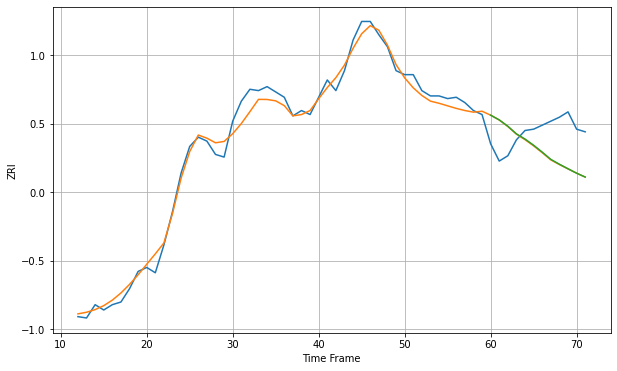

Wall time: 13.3 s
30338 6.618031741801085 27.02617495820632 26.916519671673477 [1448.51858083 1444.96971275 1440.20566718 1434.45750242 1430.56882674
 1425.91206432 1420.74165855 1415.27049053 1411.62726138 1408.22435093
 1404.88267252 1401.9728417 ]

Got an mse at 0.0025 in round 193 and stopped training

60 60 12


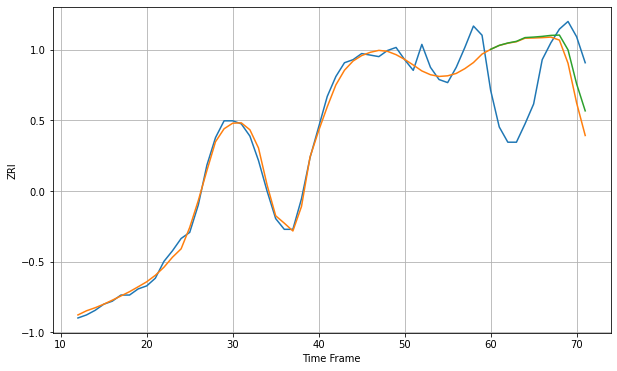

Wall time: 9.94 s
30339 6.0725002826696075 43.054299670530206 40.609409192264984 [1403.75165431 1406.35575619 1407.90318603 1408.98729176 1411.44917145
 1411.77739375 1412.2391004  1412.88118183 1413.09913183 1403.42698289
 1381.18118292 1363.51576711]

Got an mse at 0.0025 in round 185 and stopped training

60 60 12


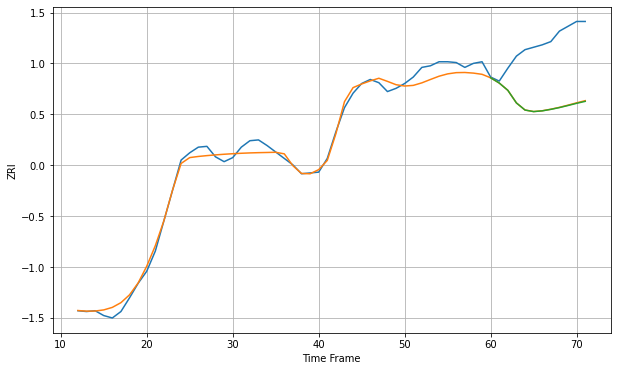

Wall time: 9.5 s
30341 8.857651795925971 75.41028888756466 75.68375405811976 [1358.10085338 1351.58854851 1342.54522246 1326.87892426 1318.07115367
 1316.14447115 1317.04531081 1318.91031151 1321.11487662 1323.70502981
 1326.40029515 1328.84634347]

Got an mse at 0.0024 in round 349 and stopped training

60 60 12


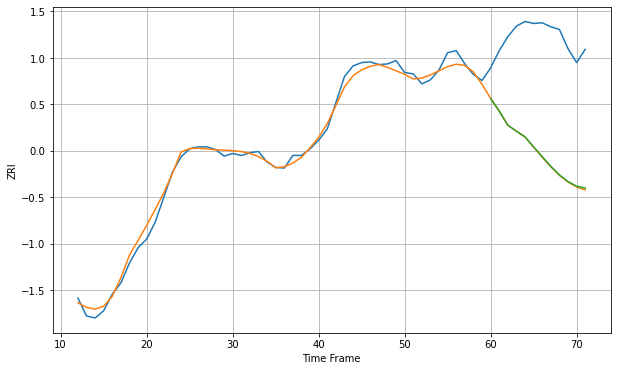

Wall time: 13.2 s
30345 9.263852684622098 176.28470993459473 175.56643341106383 [1444.03494743 1424.80323834 1403.57017042 1394.60957183 1386.0429228
 1370.97986293 1356.12755566 1341.70245809 1328.749036   1318.57870588
 1311.67256064 1308.80512219]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


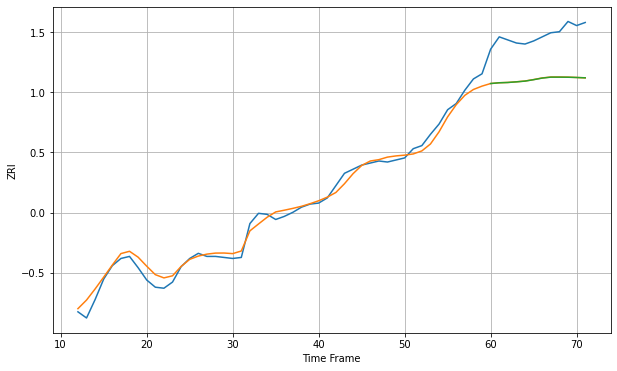

Wall time: 9.1 s
30350 6.725542669691488 43.600526406247525 43.664104455198604 [1318.50630264 1319.24921462 1319.52081568 1320.14193217 1320.86364682
 1322.25434676 1323.810799   1324.72313006 1324.72446274 1324.64232256
 1324.39317306 1324.09572662]

Got an mse at 0.0025 in round 143 and stopped training

60 60 12


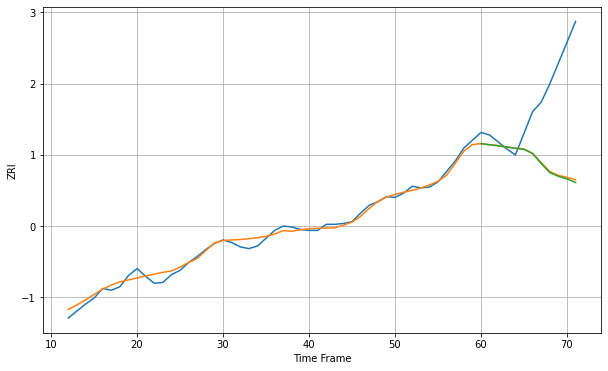

Wall time: 8.56 s
30605 5.094715192469224 87.81945820631626 88.9395934535798 [889.10954442 887.75720109 886.69704619 885.15648364 883.74007132
 882.65285276 877.67254025 866.16386504 855.67824171 851.39980746
 848.40403553 844.2721971 ]

Got an mse at 0.0025 in round 84 and stopped training

60 60 12


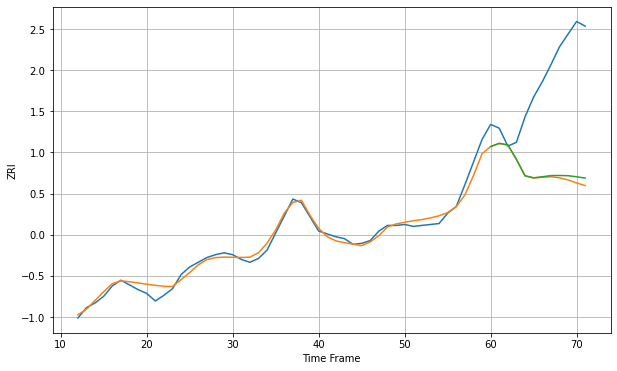

Wall time: 7.01 s
30606 5.936886352549425 107.00783369217308 104.12207379785907 [947.51059993 950.92807289 949.30839475 933.96726929 916.58573993
 914.45702487 915.52004125 916.77300692 916.87919976 916.65574434
 915.54433088 914.12565711]

Got an mse at 0.0025 in round 263 and stopped training

60 60 12


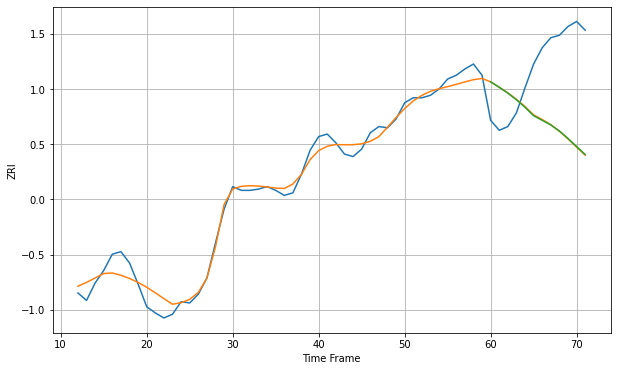

Wall time: 11.2 s
31401 7.784749752616781 62.59208417878884 62.494282631627065 [1380.73305836 1376.39077061 1371.73277165 1366.38730402 1360.38597949
 1353.66438552 1349.96547454 1346.27916065 1341.41457083 1335.48194346
 1329.06127051 1322.65892647]
60 60 12


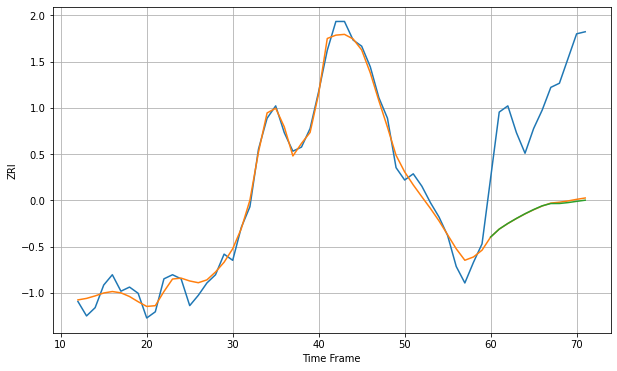

Wall time: 16.9 s
32204 4.703052561475389 56.209851753554695 56.58596527923542 [ 996.30680314 1000.17227012 1002.90344093 1005.34738225 1007.61617535
 1009.65656356 1011.48249748 1012.58197015 1012.59580586 1013.03681216
 1013.63602982 1014.19639933]

Got an mse at 0.0025 in round 176 and stopped training

60 60 12


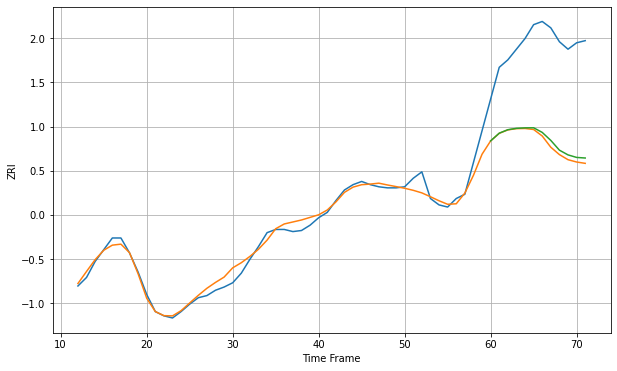

Wall time: 9.15 s
32205 6.765501246780463 92.97086197721633 90.03658161139528 [946.01791491 953.26465192 956.52098938 957.80292195 958.24477092
 958.31699321 953.98018006 946.45299364 937.32931293 932.90237155
 930.52824683 929.97439655]

Got an mse at 0.0024 in round 219 and stopped training

60 60 12


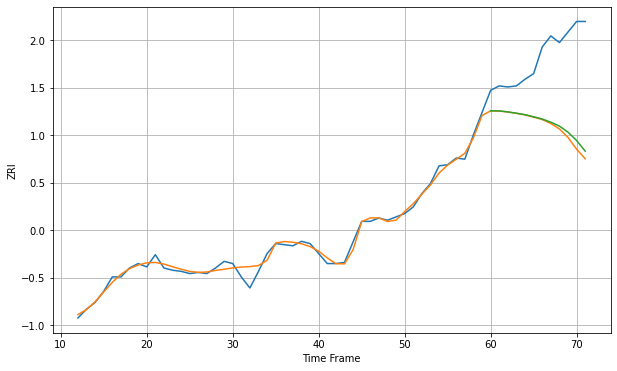

Wall time: 10.6 s
32207 4.45307289582265 69.88839965579224 66.8624836333919 [1003.53055016 1003.45645293 1002.57974844 1001.40387122 1000.04263506
  998.18919528  996.18218203  993.31230076  989.78457839  984.29675953
  976.78330502  967.22479934]
60 60 12


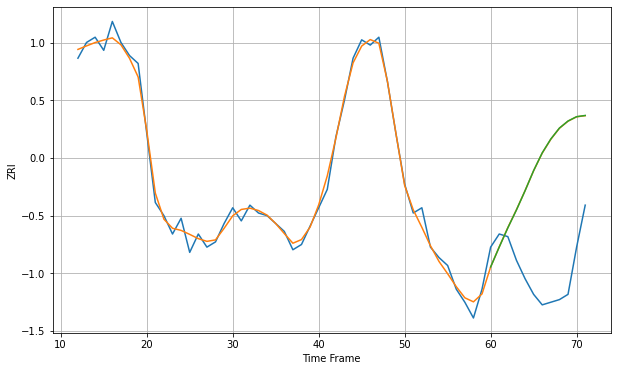

Wall time: 17 s
32209 2.904689922793304 44.02002002053592 44.07043634593139 [811.43831646 819.0235887  826.34966144 833.15390937 840.45566451
 848.16604143 854.92317589 860.21222103 864.37628719 867.05655568
 868.71307173 869.17770378]

Got an mse at 0.0025 in round 207 and stopped training

60 60 12


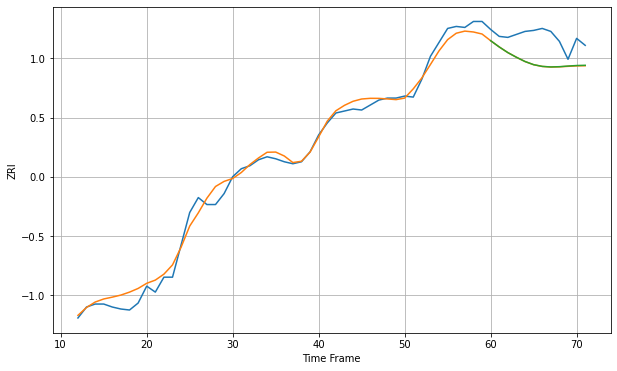

Wall time: 9.97 s
32224 8.177890212099754 25.397264178400103 25.28624598659902 [1315.6788401  1309.38104873 1303.72036942 1299.01199502 1294.75234012
 1291.58160617 1289.85165489 1289.2919224  1289.54930821 1290.19694777
 1290.72247581 1290.95275078]

Got an mse at 0.0025 in round 138 and stopped training

60 60 12


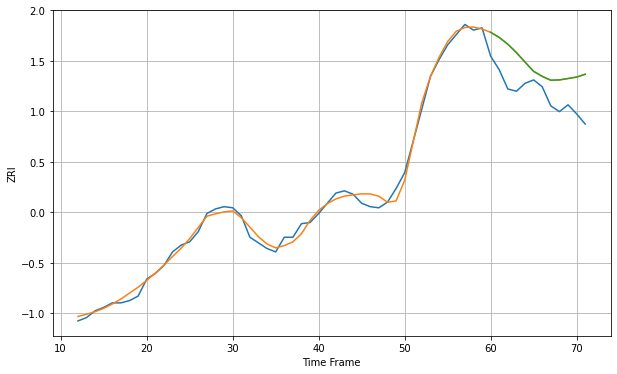

Wall time: 9.03 s
32225 4.8475806314223 27.848698183083094 27.862011410288538 [1173.02996722 1168.56186597 1162.56110498 1155.18751998 1146.75037762
 1138.60664505 1134.17840737 1130.76368905 1131.01761742 1132.230716
 1133.48579466 1135.95163913]

Got an mse at 0.0025 in round 109 and stopped training

60 60 12


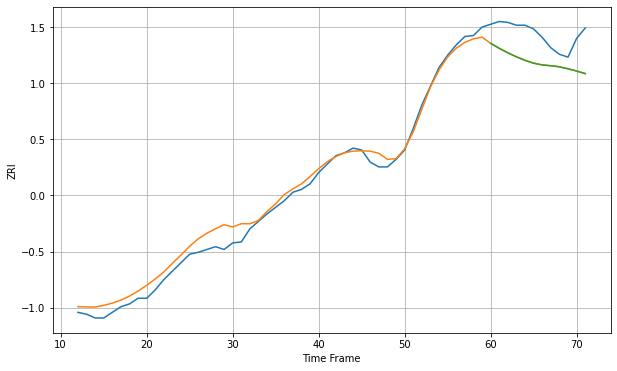

Wall time: 7.79 s
32246 9.576959063916526 30.654135583083914 30.646851590518075 [1313.68849514 1308.37252485 1303.63779412 1299.27505075 1295.60466749
 1292.54163611 1290.66765089 1289.81281504 1288.66079373 1286.56860185
 1284.18975291 1281.48613943]

Got an mse at 0.0025 in round 151 and stopped training

60 60 12


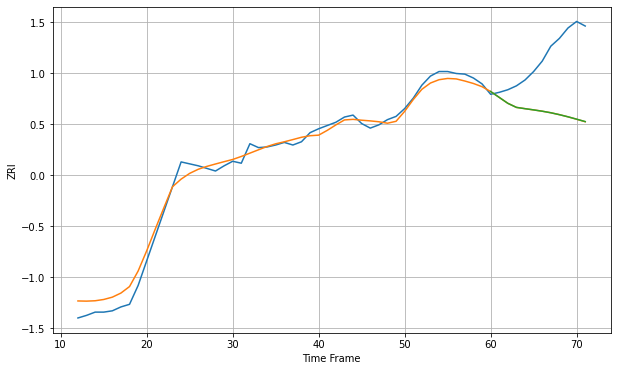

Wall time: 8.42 s
32250 12.221113533301573 91.36454769488876 91.32025940355543 [1374.28103426 1365.22387677 1356.1272407  1349.85390962 1347.87630001
 1345.99171859 1343.98289824 1341.59046501 1338.65994694 1335.37026621
 1331.7421461  1328.0390299 ]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


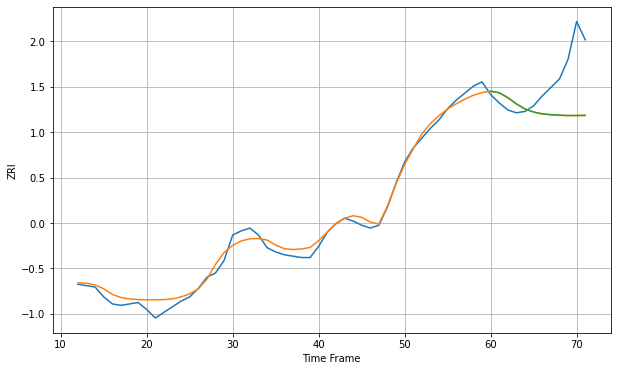

Wall time: 8.71 s
32256 4.869494223968317 29.35867877917965 29.43119928151364 [1224.40424202 1223.27085143 1219.77794182 1215.3410693  1211.75375682
 1209.55906816 1208.23547755 1207.65886613 1207.26601509 1207.04086351
 1207.00678016 1207.04106462]

Got an mse at 0.0025 in round 101 and stopped training

60 60 12


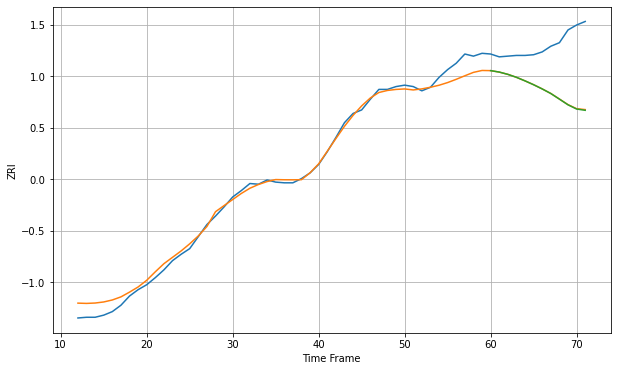

Wall time: 7.4 s
32701 10.887923481541105 70.63592284447331 70.91540032732878 [1154.5134048  1152.49161898 1149.25807802 1145.07662216 1140.03343979
 1134.58533198 1128.63869235 1122.1662702  1114.2434937  1106.20348009
 1100.25308297 1098.46550327]

Got an mse at 0.0025 in round 180 and stopped training

60 60 12


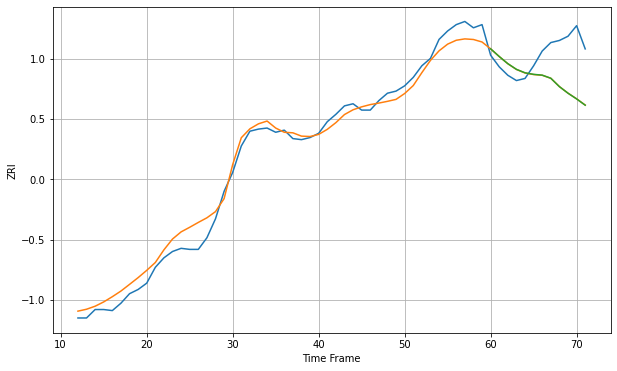

Wall time: 9.19 s
32703 9.983669603664605 34.87463679700759 34.90441165337767 [1299.05795195 1291.78664827 1284.99761148 1279.63139539 1276.35799158
 1274.88736456 1274.13587401 1271.18244068 1263.23243504 1257.00627305
 1251.60163759 1245.65779681]

Got an mse at 0.0025 in round 100 and stopped training

60 60 12


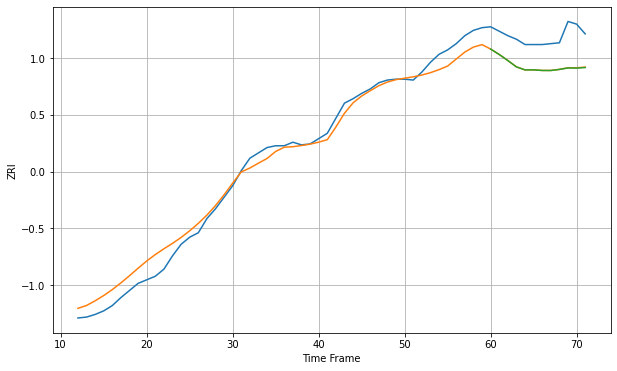

Wall time: 7.2 s
32714 12.080478797782492 34.0244150454078 34.156395661971736 [1221.91304595 1215.80663282 1208.99256943 1201.83469344 1198.42891867
 1198.48940711 1197.80239382 1197.76495848 1198.96728658 1200.65445394
 1200.4588086  1201.09744236]

Got an mse at 0.0025 in round 169 and stopped training

60 60 12


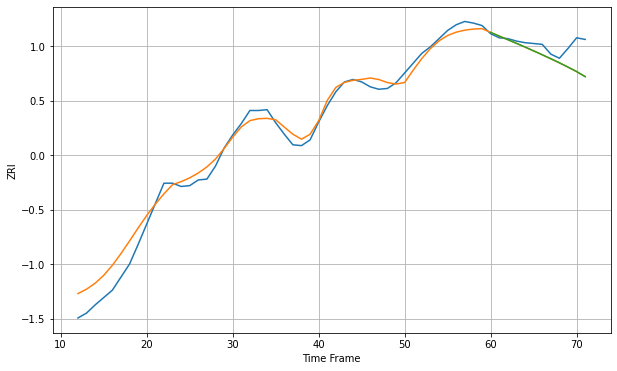

Wall time: 9.2 s
32771 13.414654343218775 19.707832098943502 19.70805619083869 [1212.57488647 1208.09062138 1203.688322   1199.22968601 1194.67382259
 1189.99009702 1185.24058045 1180.37055441 1175.35129847 1170.13453876
 1164.64739679 1158.4387364 ]

Got an mse at 0.0025 in round 143 and stopped training

60 60 12


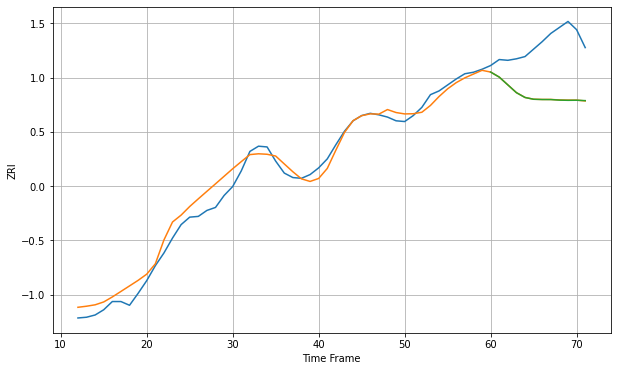

Wall time: 8.2 s
32792 13.244809401012517 70.45988562641821 70.53884367438751 [1286.25426731 1279.52301972 1269.08755483 1258.6679061  1252.23127901
 1249.83407927 1249.47876213 1249.4313446  1248.69777184 1248.41750357
 1248.53195286 1248.01806186]

Got an mse at 0.0024 in round 365 and stopped training

60 60 12


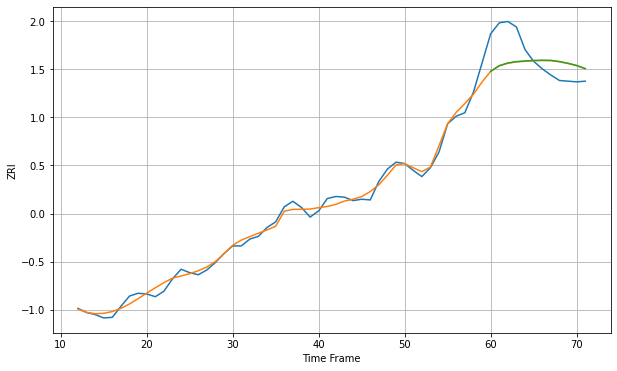

Wall time: 13.4 s
32801 7.949317295528611 36.946799778267966 36.89416592394917 [1605.31275084 1613.58474399 1617.50865391 1619.5537581  1620.48273915
 1621.23501828 1621.49965606 1621.32745902 1619.6617607  1617.10096234
 1613.93526048 1609.41170964]

Got an mse at 0.0024 in round 182 and stopped training

60 60 12


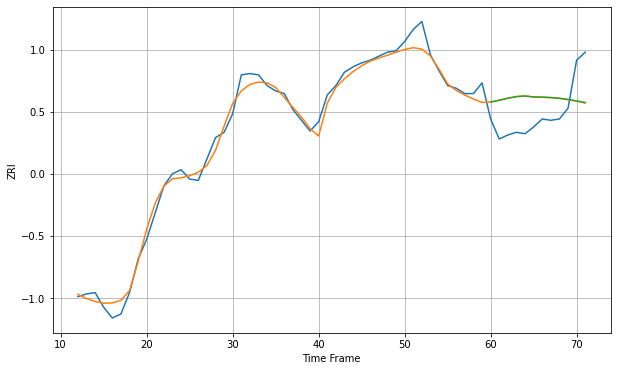

Wall time: 9.51 s
32803 6.560032201350436 24.143659777908248 24.101091494188406 [1483.7476433  1484.99476694 1486.52840013 1487.7629675  1488.19460214
 1487.49051698 1487.36083336 1487.06702661 1486.49481879 1485.59761366
 1484.55521131 1483.27917168]

Got an mse at 0.0025 in round 112 and stopped training

60 60 12


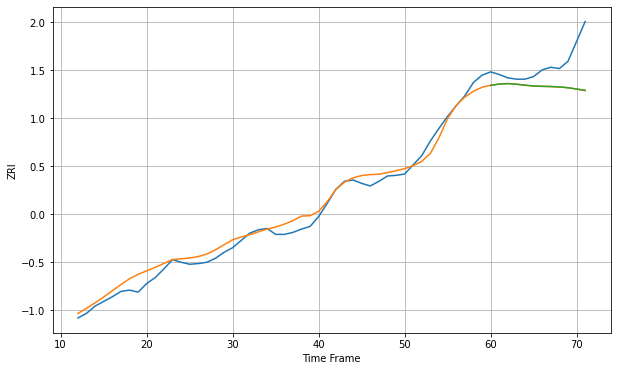

Wall time: 7.48 s
32810 11.31476794967489 41.69995610083655 41.63850371021683 [1395.72626156 1397.66152339 1398.37846421 1397.41284728 1395.92183845
 1394.70633144 1394.23511261 1393.89896729 1393.26564834 1392.11362621
 1390.18258816 1388.11584194]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


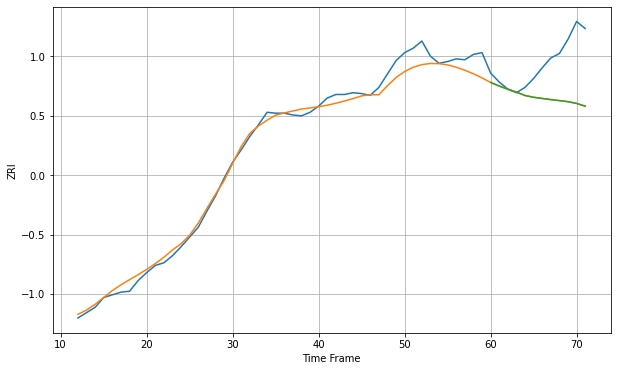

Wall time: 9.36 s
32811 9.971327239682356 48.11474701038916 48.15522740164686 [1314.52674612 1310.46720662 1306.93070833 1303.57203292 1299.85979218
 1297.851708   1296.53006465 1295.24270057 1294.12280021 1292.90899406
 1290.90336292 1287.817486  ]

Got an mse at 0.0025 in round 178 and stopped training

60 60 12


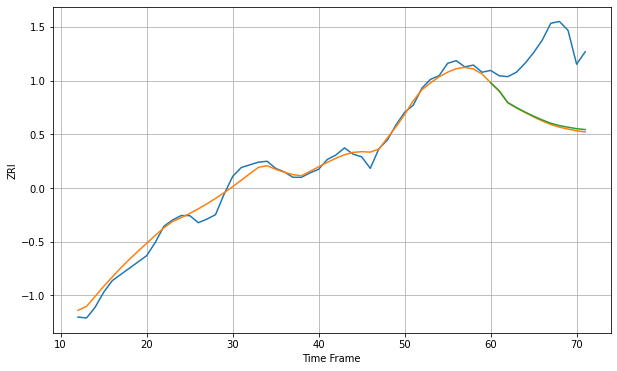

Wall time: 9.16 s
32812 8.062676352872227 77.69967386506441 76.37839411838384 [1386.21062414 1376.93826232 1363.88545175 1358.30201829 1353.31581367
 1348.65478919 1344.42287453 1340.71114645 1338.07693723 1336.23056619
 1334.62245632 1333.56188441]

Got an mse at 0.0025 in round 82 and stopped training

60 60 12


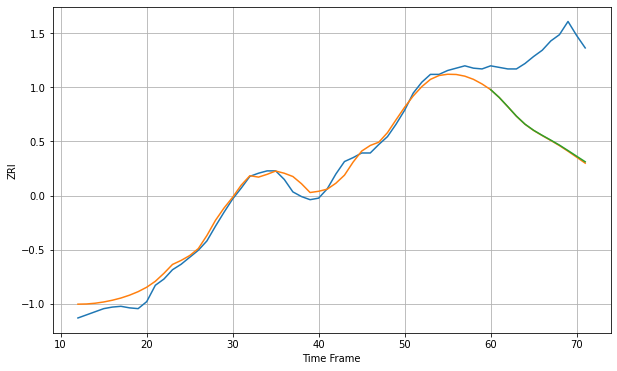

Wall time: 6.86 s
32822 10.021797696272353 110.50349079669061 109.86141161726427 [1293.39609348 1283.3560444  1271.5149071  1259.35222246 1249.02684993
 1241.16844964 1234.66817641 1228.52503518 1222.13656091 1215.12156149
 1207.88306493 1200.72238396]

Got an mse at 0.0025 in round 185 and stopped training

60 60 12


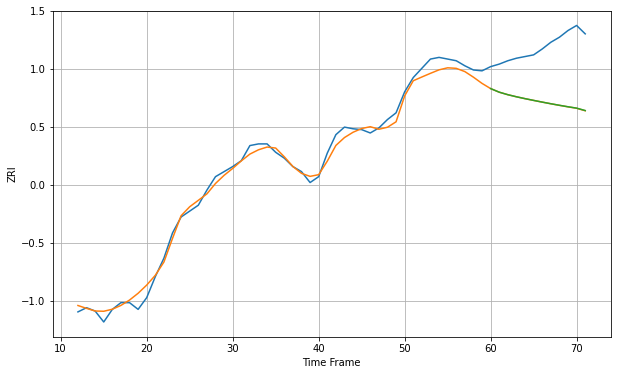

Wall time: 9.66 s
32825 8.172079405773061 66.64384037673827 66.56482949069873 [1263.84643107 1259.57190026 1256.57634596 1254.10578875 1251.87494016
 1249.79368461 1247.76880888 1245.82079514 1243.97217839 1242.20893651
 1240.58772287 1237.72572285]

Got an mse at 0.0025 in round 174 and stopped training

60 60 12


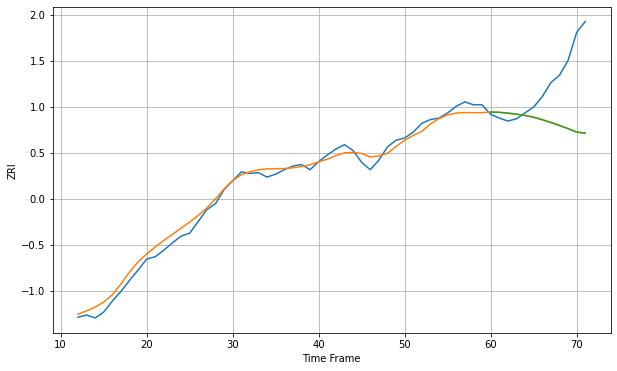

Wall time: 9.08 s
32835 8.805322398260433 69.85517294320198 69.86748878433139 [1285.18379414 1284.83423376 1283.68191298 1282.29959462 1280.61581694
 1278.160509   1274.82016446 1271.0665308  1267.06174501 1262.7442972
 1258.02277827 1256.59744085]

Got an mse at 0.0025 in round 104 and stopped training

60 60 12


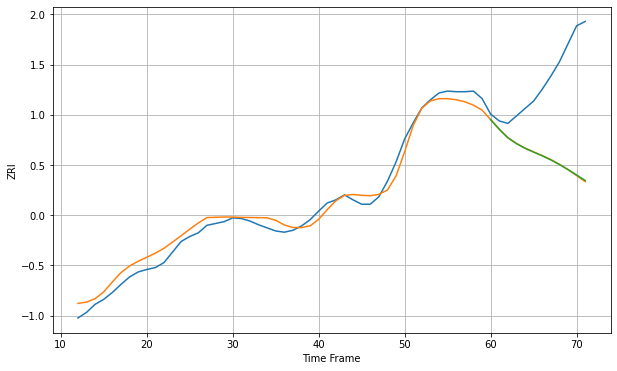

Wall time: 7.36 s
32837 13.856906762081595 140.06476869746632 139.78150495532847 [1542.14118693 1526.62467267 1512.95627086 1503.4987501  1496.05768699
 1489.80257524 1483.88445248 1477.27136405 1469.86415929 1461.75322855
 1452.97093712 1444.18846484]

Got an mse at 0.0025 in round 149 and stopped training

60 60 12


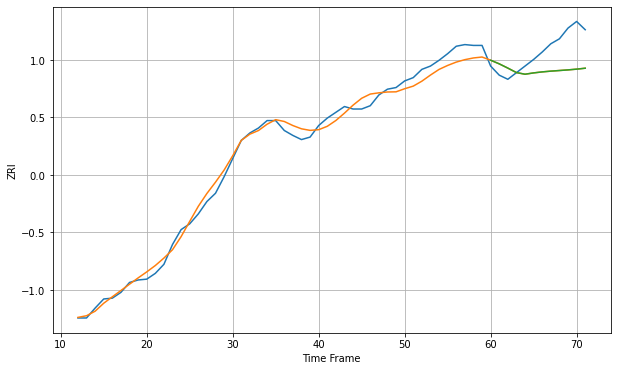

Wall time: 8.39 s
32839 9.212413579646201 31.613688198977947 31.63204489777668 [1334.07534388 1329.68078874 1324.53651753 1319.12955006 1317.12303278
 1318.72313936 1319.93873097 1320.85782899 1321.59738183 1322.35511717
 1323.25811313 1324.38533458]

Got an mse at 0.0025 in round 153 and stopped training

60 60 12


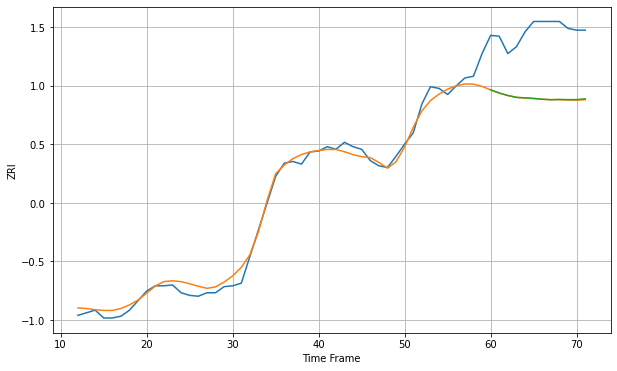

Wall time: 8.82 s
32935 9.07979700776436 77.14779537893222 76.8849609230726 [1157.27254134 1153.71153838 1150.85987979 1148.73181724 1148.08377852
 1147.48317991 1146.59994348 1146.0596495  1146.35200872 1146.07565802
 1146.16852111 1147.10744673]

Got an mse at 0.0025 in round 191 and stopped training

60 60 12


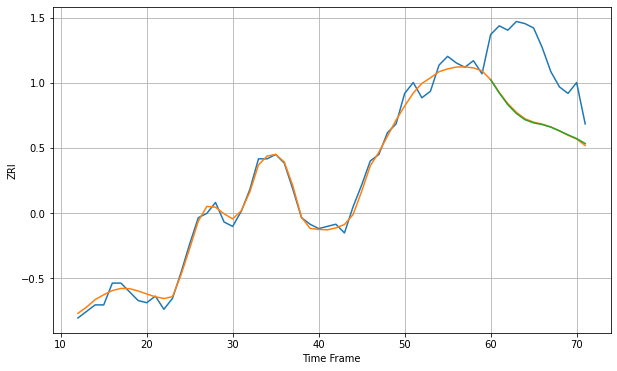

Wall time: 9.42 s
33009 3.0023750041930883 30.850822784692095 31.0419666208414 [1633.29164991 1627.23334478 1621.81284426 1617.77696425 1614.93484885
 1613.48721131 1612.71680722 1611.53753682 1609.86038582 1607.99754355
 1606.29092877 1604.04007283]
60 60 12


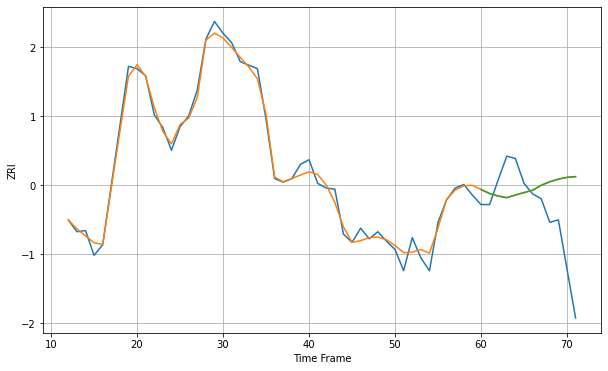

Wall time: 16.5 s
33010 6.324667111222897 46.10309538588281 46.135821884682535 [1777.75370342 1774.34118953 1772.20934878 1770.80908388 1773.15347479
 1775.10225361 1777.13967397 1781.32370998 1784.30932286 1786.52916413
 1788.05715078 1788.69628398]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


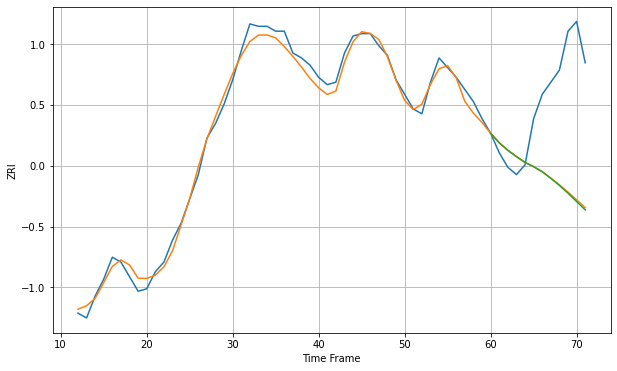

Wall time: 12.9 s
33020 3.3056760600208004 39.39942171714295 39.72819325119547 [1342.99569086 1339.08952285 1335.97841963 1333.40494539 1330.99703113
 1329.25878836 1327.15549296 1324.43831732 1321.52373943 1318.33364224
 1314.91309937 1311.48124257]

Got an mse at 0.0024 in round 168 and stopped training

60 60 12


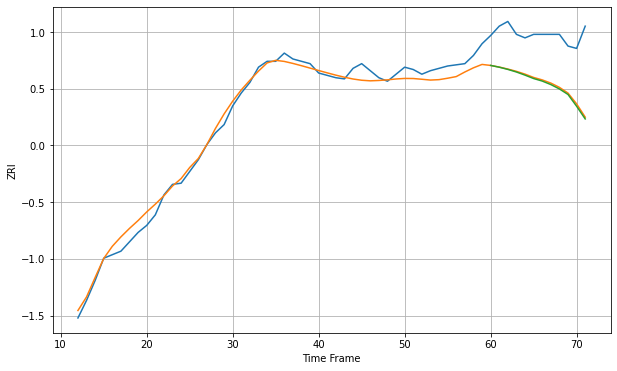

Wall time: 8.86 s
33024 7.032936933690682 42.798246742905874 43.78739881823997 [1510.48833312 1508.97432225 1507.09493672 1504.88128855 1502.21220114
 1499.31327124 1497.15248934 1494.17295637 1490.4355359  1485.71549905
 1475.66924211 1464.83788782]
60 60 12


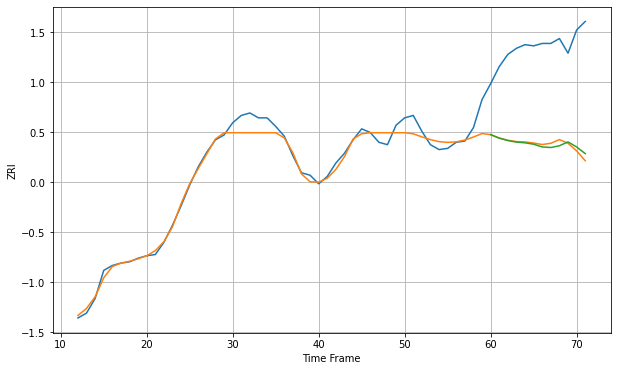

Wall time: 17.5 s
33025 7.277180183177757 80.29390103382067 80.33039892637903 [1543.24997889 1540.36427837 1538.40145107 1537.1079604  1536.54891495
 1535.41265794 1533.16711691 1532.69819198 1534.14908037 1537.29045613
 1533.1620858  1527.70022169]
60 60 12


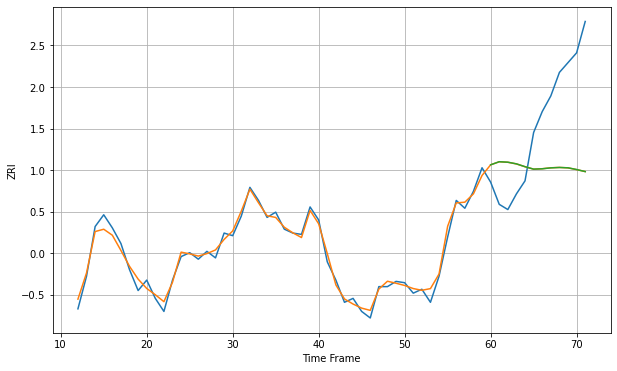

Wall time: 16.4 s
33062 4.5809604396327055 59.09678558882977 59.10051610969439 [1621.25658002 1623.62805256 1623.26398063 1621.98931769 1619.82309001
 1617.94641515 1618.21050335 1618.92067901 1619.22684163 1618.96453076
 1617.64379108 1616.07080732]

Got an mse at 0.0025 in round 116 and stopped training

60 60 12


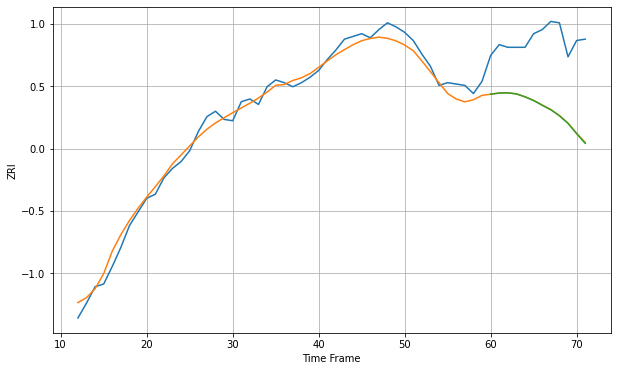

Wall time: 7.58 s
33065 6.308529029835892 52.29533424006671 52.463545964058554 [1505.529644   1506.36498181 1506.529648   1505.73519824 1503.59427825
 1500.85626196 1497.41805268 1494.09499002 1489.69253785 1484.10264552
 1476.53451731 1469.40073542]

Got an mse at 0.0025 in round 261 and stopped training

60 60 12


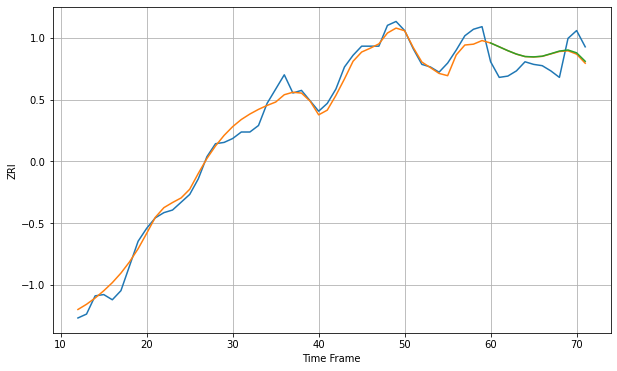

Wall time: 11.1 s
33066 6.727956896804173 14.586138734498164 14.41542860002427 [1458.43115569 1455.50179329 1452.55647986 1449.91950328 1448.05073117
 1447.77075635 1448.2842437  1450.21885061 1452.23652646 1453.07312176
 1450.87669386 1444.37476168]
60 60 12


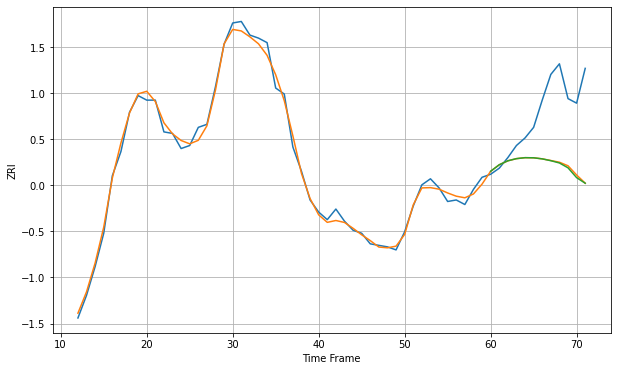

Wall time: 16.6 s
33125 3.9781367513730785 40.44210639633715 40.82652500034139 [1694.96818862 1699.27815456 1701.89909819 1703.323434   1703.96219579
 1703.88076334 1703.17463958 1701.96812618 1700.46084411 1697.25714966
 1690.76538485 1687.06414894]

Got an mse at 0.0025 in round 121 and stopped training

60 60 12


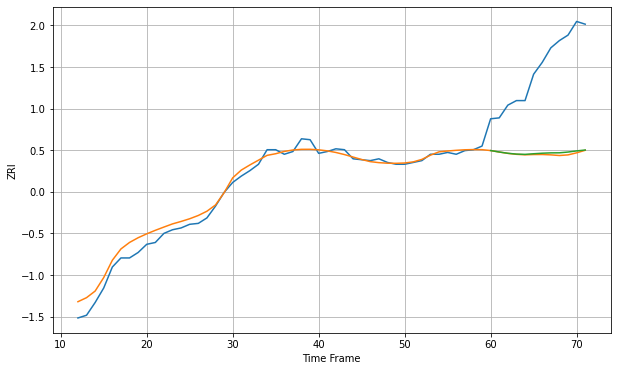

Wall time: 7.72 s
33126 7.7605657424869445 99.07415061411432 97.67347929016125 [1642.06778204 1640.48414117 1639.0781099  1638.17835965 1637.89419322
 1638.55738502 1639.14705341 1639.52403742 1639.58972618 1640.43993284
 1641.6780465  1642.67230879]
60 60 12


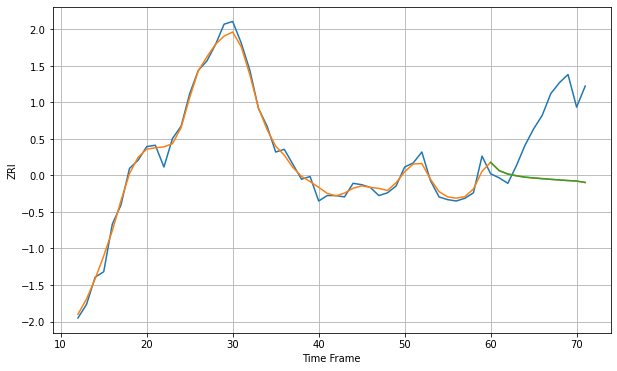

Wall time: 16.6 s
33127 4.780980081304397 47.761030283480984 47.752857843490006 [1744.43238965 1738.28770206 1735.81869016 1734.54558661 1733.53353282
 1732.94657227 1732.43980031 1731.92730918 1731.47271056 1731.02900073
 1730.65185008 1729.66918138]

Got an mse at 0.0024 in round 439 and stopped training

60 60 12


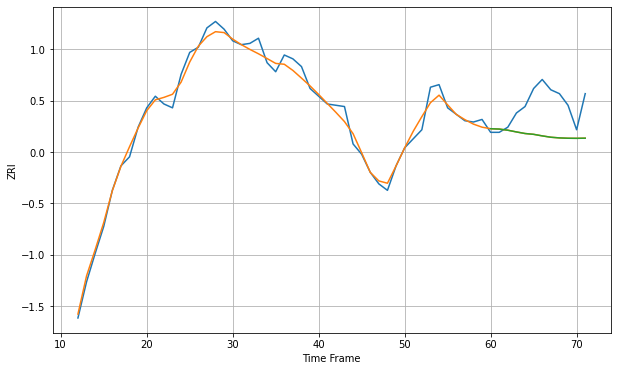

Wall time: 16 s
33130 5.716720124302027 26.25738901058427 26.259849968757596 [1752.8030483  1752.53133243 1751.63622825 1750.31294482 1749.08405784
 1748.44872058 1747.25006179 1746.20342361 1745.67673947 1745.4114274
 1745.34976895 1745.4617191 ]

Got an mse at 0.0025 in round 468 and stopped training

60 60 12


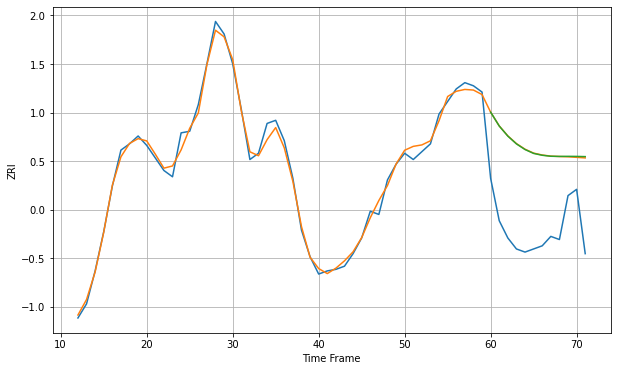

Wall time: 16.3 s
33131 3.9971160485392416 54.56266410456692 54.576624061619874 [2277.19570614 2268.3587486  2261.92556609 2256.97055044 2253.36881059
 2250.88323265 2249.71143593 2249.08189983 2248.97655047 2249.03115378
 2248.98559838 2248.85439498]
60 60 12


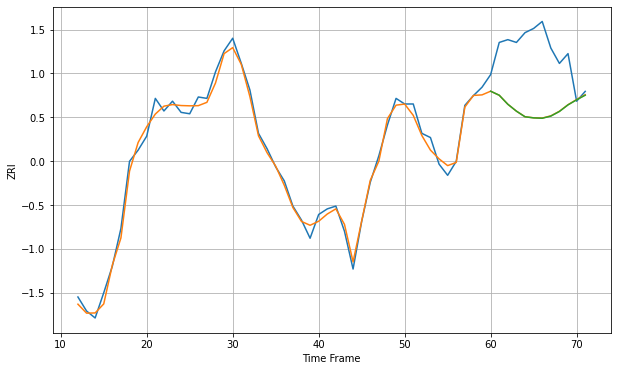

Wall time: 16.4 s
33132 4.921797159456831 44.19911769327405 44.26123240174995 [2035.13185916 2032.25659036 2025.80670927 2020.85498738 2016.85113147
 2016.05812371 2015.80342347 2017.33412597 2020.64287884 2025.36113209
 2028.96781503 2032.26655825]
60 60 12


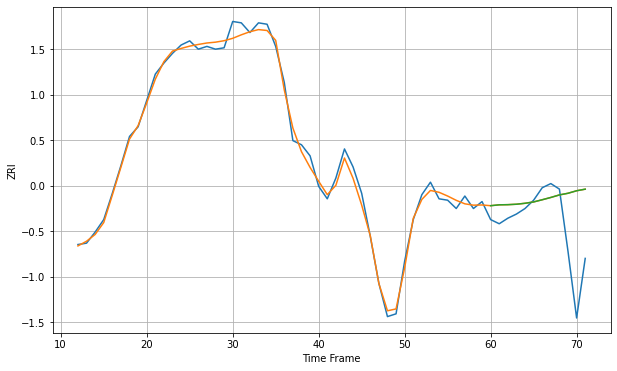

Wall time: 17.3 s
33133 4.705792550315884 33.332934432604304 33.33434694030525 [1986.03259434 1986.66391514 1986.77772673 1987.09076574 1987.78144151
 1988.74926184 1990.32399388 1991.98073065 1993.80958918 1995.00738271
 1996.81680371 1997.96877157]
60 60 12


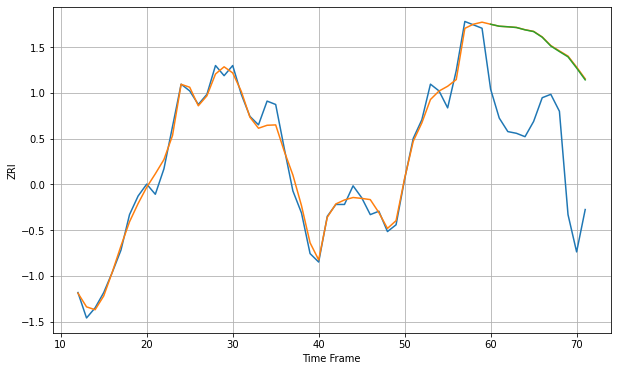

Wall time: 17.4 s
33134 5.278843915684501 63.85671012825252 63.61117484699399 [2108.36014191 2107.18809872 2106.8614815  2106.42748485 2105.05848298
 2104.03362208 2100.69183435 2095.50963649 2092.24671203 2089.11931801
 2082.52669652 2075.53410212]
60 60 12


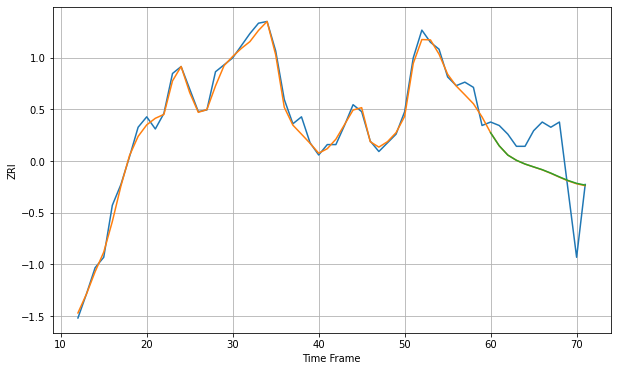

Wall time: 16.8 s
33135 3.8763778855203372 20.875534309687858 20.87604173322437 [1720.79358359 1713.27839927 1707.94506551 1704.92580254 1702.78467514
 1701.13010277 1699.5240123  1697.54514968 1695.35377682 1693.29298275
 1691.64904136 1690.61859744]
60 60 12


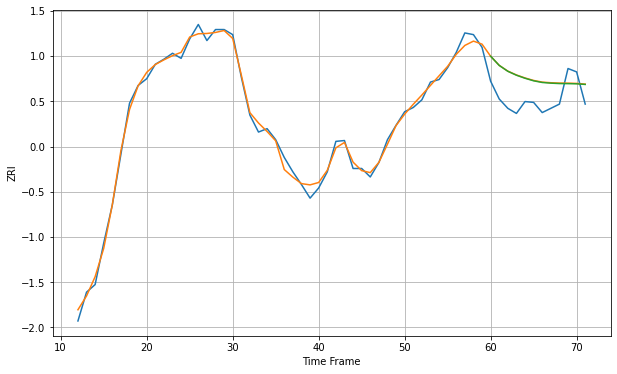

Wall time: 17 s
33137 6.424668845407713 31.285907471368866 31.066122018494017 [2253.48802745 2242.64306551 2235.72068934 2231.10283393 2227.49915421
 2224.48789944 2222.52872421 2221.7180124  2221.24744812 2221.14770025
 2220.94492497 2220.21402702]
60 60 12


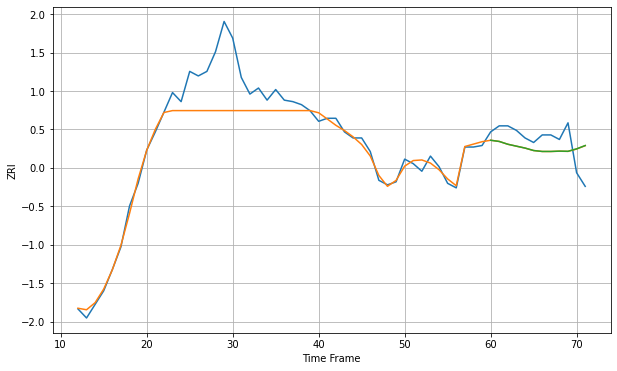

Wall time: 17.3 s
33138 14.987062280954655 13.208076904050236 13.219168319245666 [1698.47885376 1697.68848705 1695.83382429 1694.56924162 1693.31515643
 1691.69144753 1691.07583227 1691.07510881 1691.28981521 1691.18072967
 1692.79176696 1694.99591979]
60 60 12


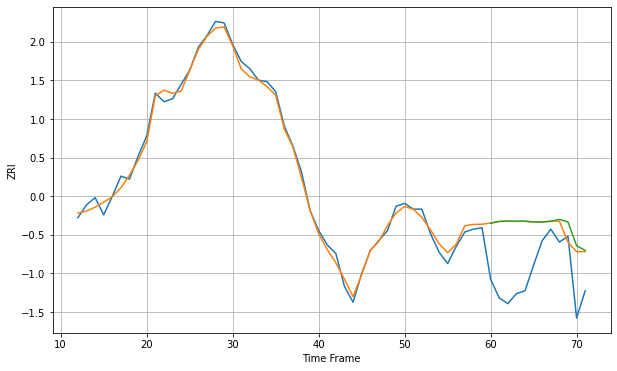

Wall time: 17.2 s
33139 4.060437190895951 37.47029937992014 38.07494185311345 [2005.1804851  2006.40758213 2006.62854276 2006.47698104 2006.53920206
 2005.99446991 2005.96678086 2006.48405685 2007.81744493 2005.99216679
 1989.4144992  1986.18453884]
60 60 12


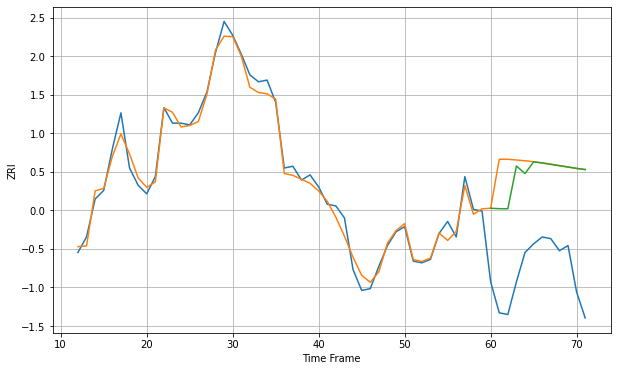

Wall time: 17.1 s
33140 4.995946229298738 63.72941937475929 56.907052849168856 [2307.63756025 2307.39893719 2307.35448073 2332.14363299 2327.77748578
 2334.54125076 2333.90308056 2333.12468547 2332.31458217 2331.54905903
 2330.75222337 2330.08792689]
60 60 12


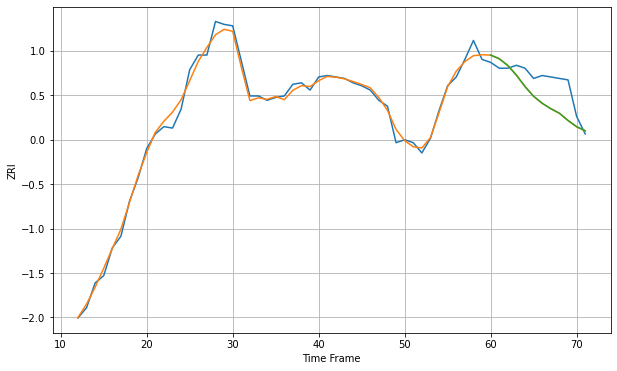

Wall time: 17.2 s
33141 4.053723971237333 14.883316179819701 14.865688749890063 [1858.97328385 1856.48073966 1851.84520441 1845.2344464  1837.41644766
 1830.75789316 1825.96677741 1822.27725646 1819.16767742 1814.22580713
 1809.97797025 1807.21426768]
60 60 12


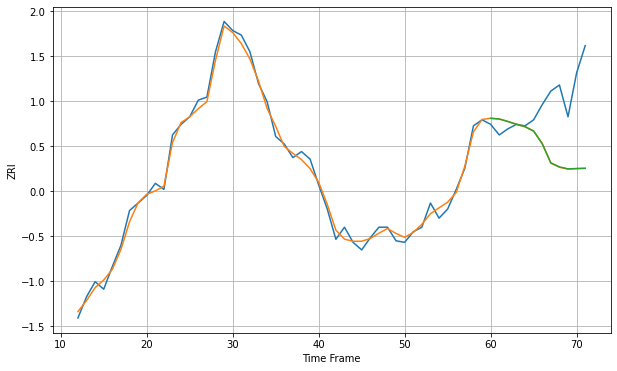

Wall time: 17 s
33142 4.135294607736539 38.56857057361353 38.53616977481134 [1678.99324147 1678.53862007 1676.88678956 1675.02785604 1673.44099242
 1670.5419153  1662.17656185 1649.53971386 1646.85284565 1645.53728363
 1645.75388676 1645.91597955]
60 60 12


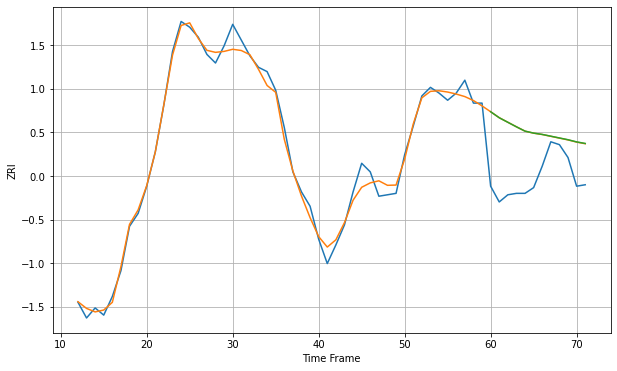

Wall time: 17 s
33145 5.965012257658612 37.2569259979984 37.28499681796975 [2069.98044052 2065.78453884 2062.60801849 2059.44815878 2056.43715315
 2055.06047887 2054.14522095 2052.90741362 2051.66546603 2050.44051849
 2048.92366557 2047.84422778]
60 60 12


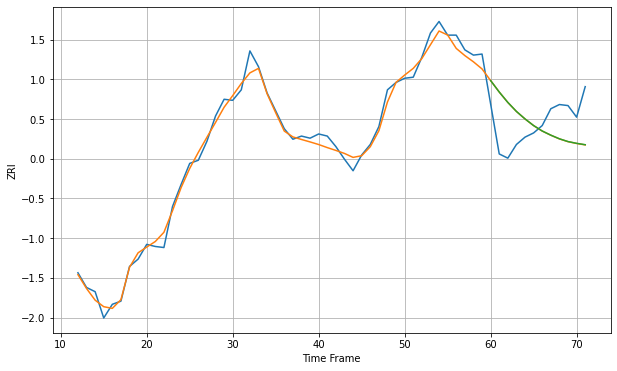

Wall time: 17.1 s
33147 7.246463826576785 35.01186099456118 34.96647596478826 [1954.77566999 1943.89839815 1934.00493872 1925.43185685 1918.31463542
 1911.98086037 1906.82532013 1902.86800612 1899.40161838 1896.77054905
 1895.10855622 1893.78836939]
60 60 12


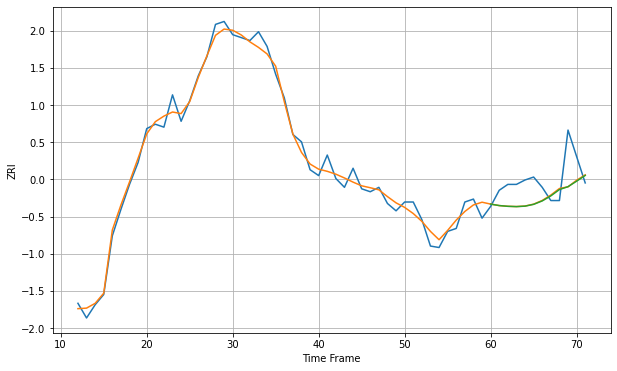

Wall time: 17.5 s
33150 5.463703157331277 16.238973815427318 16.261091281827422 [1609.58405378 1608.57807843 1608.06876194 1607.86220224 1608.17645798
 1609.39972248 1611.73783027 1615.16311571 1619.47987021 1621.45479299
 1625.18348081 1629.09291533]
60 60 12


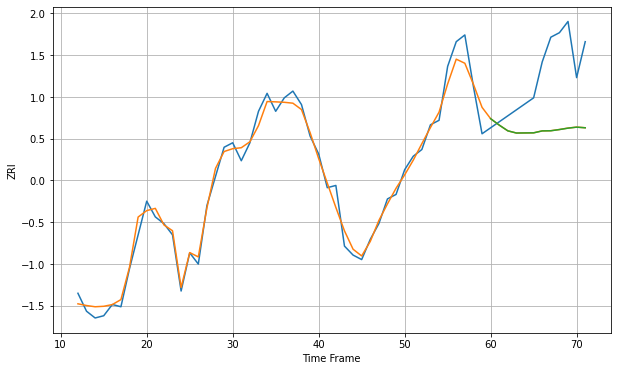

Wall time: 17.2 s
33157 4.537887466697416 27.86691084593073 27.88530288722148 [1779.71285118 1776.86244233 1774.31056308 1773.33333484 1773.37575849
 1773.41530977 1774.27963401 1774.34085543 1774.87688508 1775.50408984
 1775.94941554 1775.66828158]
60 60 12


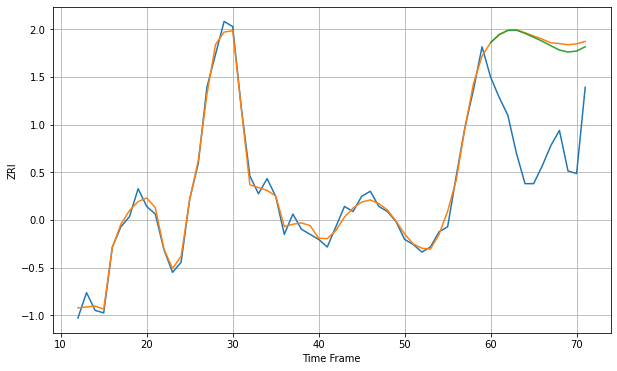

Wall time: 17.1 s
33160 2.7319527239517547 42.80434285298056 41.74859408326 [2071.67047427 2074.82705274 2076.48332144 2076.57170382 2075.30086607
 2073.77547517 2072.194647   2070.4369735  2068.71896759 2067.93358574
 2068.33465702 2070.02041787]
60 60 12


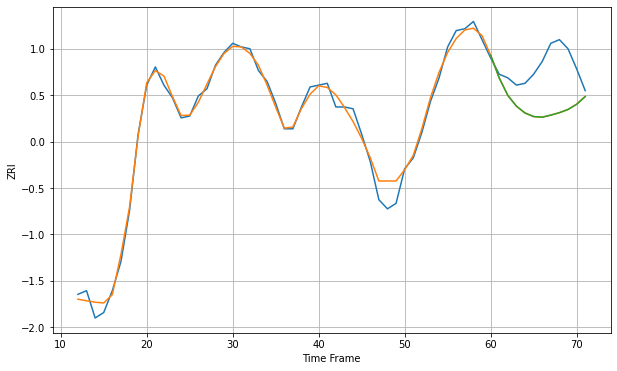

Wall time: 16.7 s
33161 4.395485594323454 23.555506845193676 23.55044990061817 [1523.47086684 1510.93770181 1501.32384656 1495.4591085  1491.68926808
 1489.73245668 1489.37439947 1490.5267616  1491.85780076 1493.61757315
 1496.45633063 1500.67922578]

Got an mse at 0.0025 in round 212 and stopped training

60 60 12


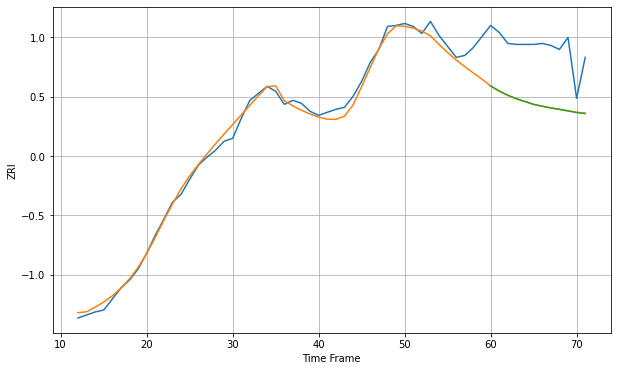

Wall time: 10.5 s
33178 9.173860777939082 57.58936392212096 57.70980178588195 [2001.36306253 1996.31972721 1992.07090339 1988.59901836 1985.79043805
 1982.91553712 1981.02220826 1979.33227278 1977.8916333  1976.31916897
 1974.77414192 1973.71531651]
60 60 12


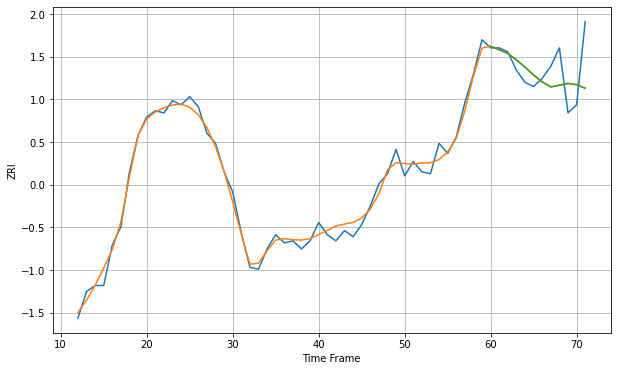

Wall time: 17 s
33180 3.721816790690998 12.733776773463331 12.748207947086437 [2031.82217155 2030.07659084 2028.21371255 2025.07629704 2021.49919056
 2017.60464668 2014.22696333 2011.73734454 2012.64823269 2013.50697365
 2012.83860417 2011.10421728]

Got an mse at 0.0025 in round 208 and stopped training

60 60 12


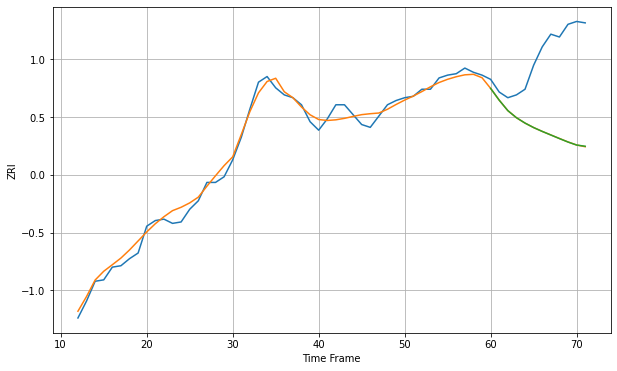

Wall time: 9.88 s
33186 4.995792848382848 57.067210255712496 57.04181632603564 [1577.59373054 1569.22981596 1561.85490452 1556.83986284 1553.02832003
 1549.85539076 1547.13566446 1544.60553013 1542.06990678 1539.60379846
 1537.48994385 1536.62187935]

Got an mse at 0.0025 in round 362 and stopped training

60 60 12


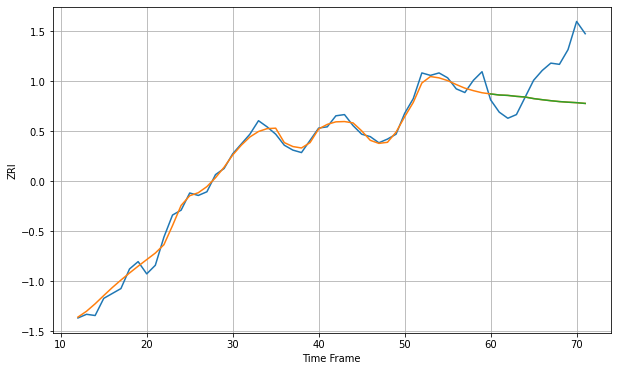

Wall time: 14.4 s
33196 5.267124704814602 32.80843883984814 32.80640521849822 [1593.85746187 1592.98845486 1592.65743343 1591.87206621 1591.34805759
 1590.05343693 1589.14369816 1588.32163645 1587.61046415 1587.11752395
 1586.71919618 1586.10368128]

Got an mse at 0.0025 in round 268 and stopped training

60 60 12


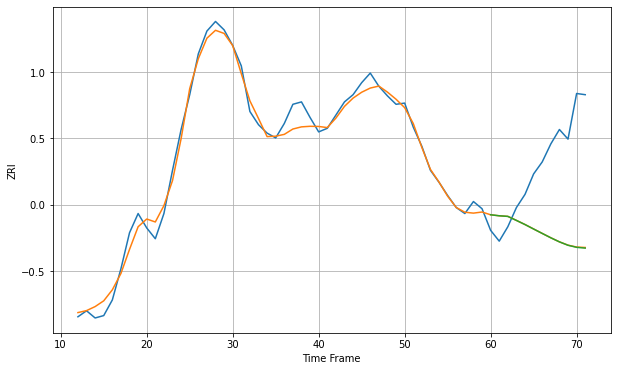

Wall time: 11 s
33301 7.628496566889834 72.06743268501924 72.19608803173666 [1744.96905651 1744.12370834 1743.62629443 1740.25970977 1736.8137076
 1733.1009186  1729.42511758 1725.78607985 1722.39706303 1719.56751345
 1717.84746574 1717.20883516]

Got an mse at 0.0025 in round 361 and stopped training

60 60 12


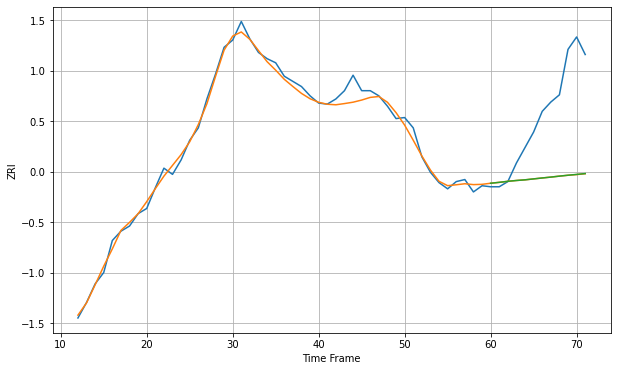

Wall time: 13.8 s
33304 6.4233691707656115 73.53510111488585 73.4872312436863 [1559.41541895 1560.27462518 1561.28503187 1562.07209447 1562.71143585
 1563.62090462 1564.51474683 1565.35502871 1566.29227549 1567.17256545
 1567.96136753 1568.77013658]

Got an mse at 0.0025 in round 373 and stopped training

60 60 12


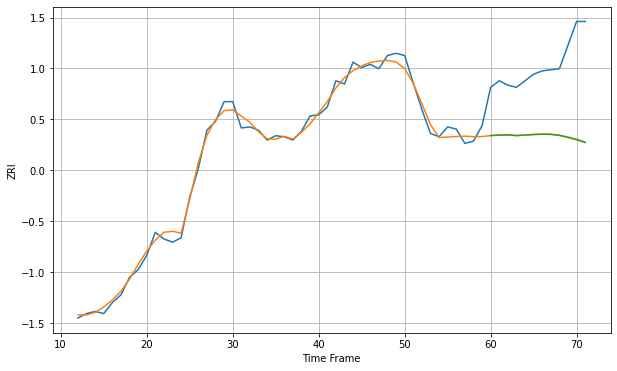

Wall time: 13.7 s
33305 5.623674908523458 67.57958773462916 67.77698783719858 [1503.08252472 1503.55363066 1503.72896977 1503.06377687 1503.54858731
 1504.06701178 1504.28233088 1504.16787323 1503.22218002 1501.41110777
 1499.31132444 1496.75602019]

Got an mse at 0.0025 in round 315 and stopped training

60 60 12


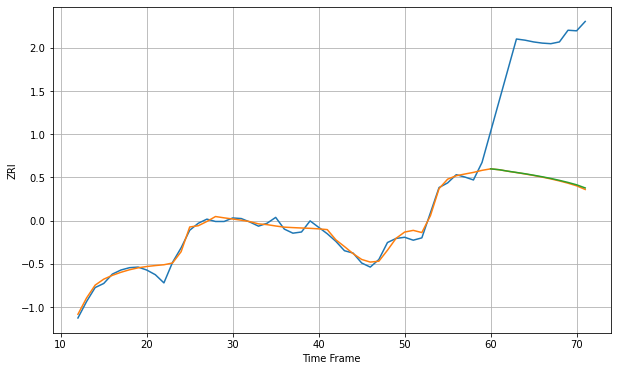

Wall time: 12.7 s
33308 8.545568147607124 221.42391835395208 220.522412309486 [1604.98799999 1603.49735671 1601.02408534 1598.83176687 1596.60734777
 1594.11447599 1591.44299986 1588.575301   1585.33184745 1581.765166
 1577.7074838  1572.36401638]

Got an mse at 0.0024 in round 117 and stopped training

60 60 12


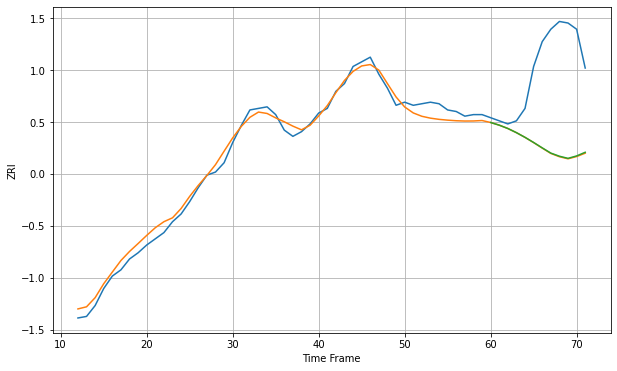

Wall time: 7.83 s
33311 4.818205427515429 56.949998534385664 56.72693031911846 [1383.91775306 1382.2057023  1380.05675324 1377.3768169  1374.35775545
 1371.04774793 1367.58025159 1364.21057645 1362.19753322 1360.82474328
 1362.38312461 1364.73884268]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


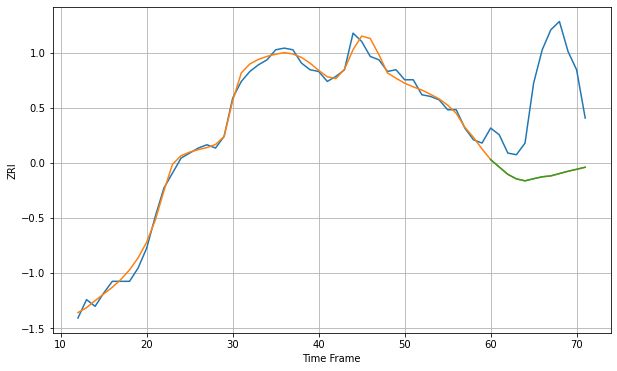

Wall time: 10.5 s
33312 3.671073956738231 55.089963169147936 55.031952354916484 [1411.08364771 1406.63048102 1402.22703725 1399.49194422 1398.32061297
 1399.61158913 1400.77036357 1401.3199529  1402.72969416 1404.11906577
 1405.30178968 1406.53808776]

Got an mse at 0.0025 in round 74 and stopped training

60 60 12


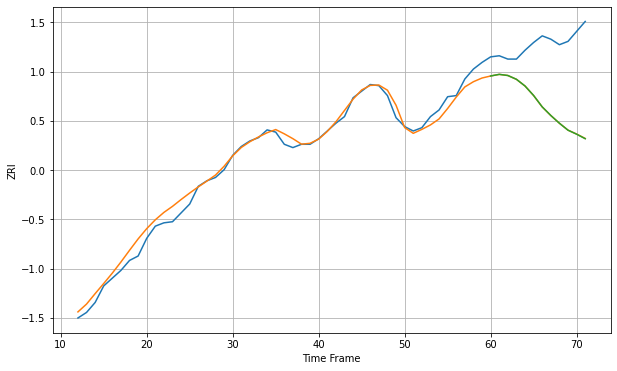

Wall time: 7.14 s
33313 6.753786030134345 60.99227210711425 61.03215956530644 [1427.72000044 1429.18763408 1428.17128798 1424.72565082 1418.67754643
 1410.08275282 1399.78722069 1392.01732351 1384.98366446 1378.7367136
 1375.12567403 1371.02760879]

Got an mse at 0.0024 in round 466 and stopped training

60 60 12


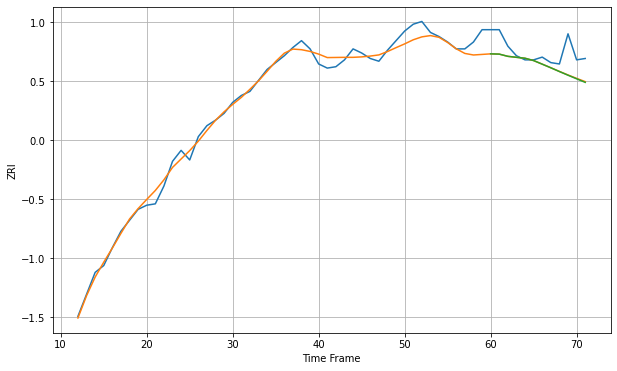

Wall time: 16.7 s
33324 5.357401114077325 13.305221697676716 13.42421865883054 [1555.38441387 1555.19098949 1553.58050174 1552.86394486 1552.18310292
 1550.48949316 1547.8686404  1545.22114457 1542.47970372 1539.8029972
 1537.18411603 1534.58666589]

Got an mse at 0.0024 in round 128 and stopped training

60 60 12


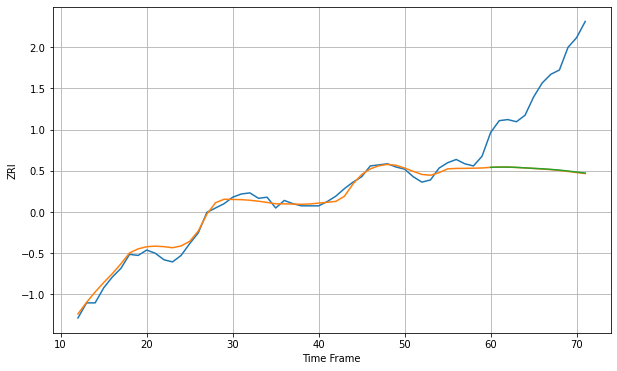

Wall time: 8.21 s
33334 5.210176946737519 84.21811102849071 83.95806722079843 [1316.70189174 1316.94520147 1316.94979826 1316.66166113 1316.22750947
 1315.76358611 1315.36488533 1314.8214217  1314.16609493 1313.30010399
 1312.35687346 1311.41441985]

Got an mse at 0.0025 in round 376 and stopped training

60 60 12


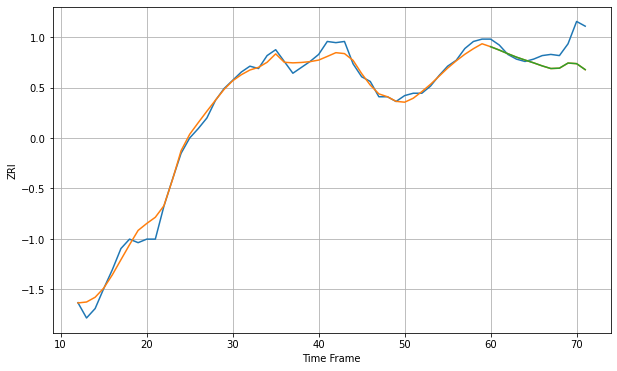

Wall time: 14.3 s
33401 6.124078207536536 16.661123114607204 16.650536683176696 [1511.54693347 1508.69527113 1505.60516463 1502.69093645 1500.20376978
 1497.83645367 1495.23817252 1493.00865018 1493.30778777 1497.66195655
 1497.15160883 1492.05267506]
60 60 12


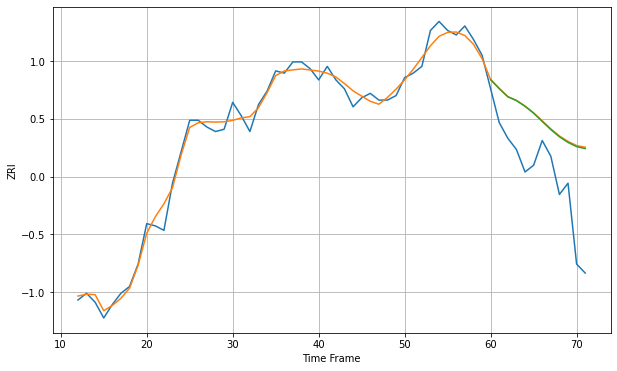

Wall time: 18 s
33404 3.660328137786115 28.34075337749726 28.07586580222448 [1482.10461924 1478.13896362 1474.47616038 1472.80047097 1470.24937266
 1467.17178643 1463.49940722 1459.86711762 1456.66809961 1454.16276114
 1452.26547328 1451.41157743]
60 60 12


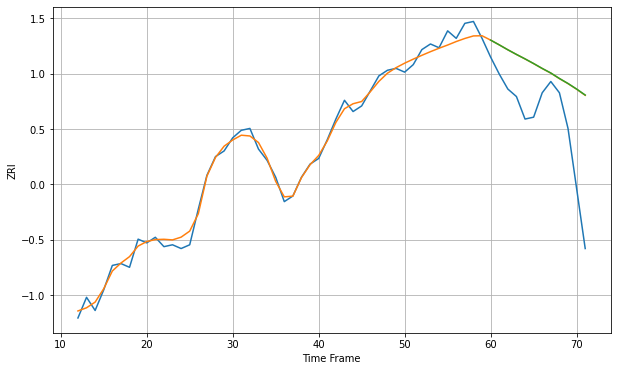

Wall time: 17.3 s
33407 3.537842344971497 33.39546972315505 33.44988302797298 [1509.05827864 1506.5338793  1503.91328777 1501.43789113 1499.06410293
 1496.5787448  1493.96879339 1491.53223774 1488.61661994 1485.94946963
 1482.98928091 1479.78949624]

Got an mse at 0.0024 in round 392 and stopped training

60 60 12


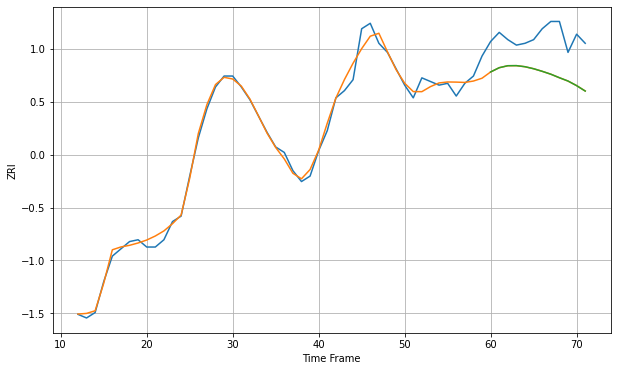

Wall time: 14.6 s
33413 4.0475906080459625 21.39686759191448 21.39436753385164 [1451.24658829 1453.58704638 1454.67870384 1454.72018042 1454.12044739
 1453.01907138 1451.59691062 1450.0106756  1448.07060003 1446.25624966
 1443.72587482 1440.74212438]
60 60 12


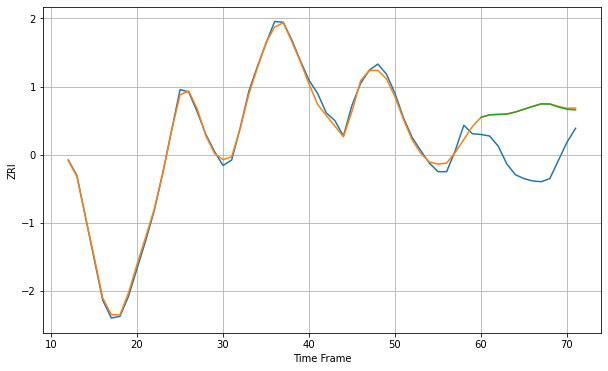

Wall time: 17.5 s
33414 5.5757553297402005 69.4809018869672 69.16964642885966 [1758.14987624 1761.43541613 1761.92508157 1762.39003504 1764.99855258
 1768.59750674 1772.20301636 1775.48909121 1775.22704315 1771.54879297
 1768.61040049 1767.75793425]
60 60 12


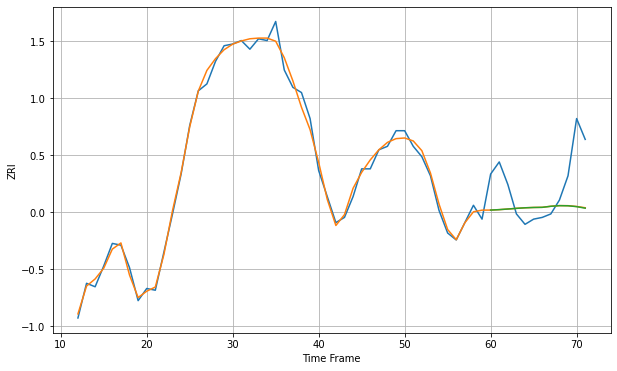

Wall time: 17 s
33418 3.818943106211571 22.401194874888116 22.458961986432318 [1683.22809179 1683.4778193  1683.83360531 1684.2145163  1684.53795858
 1684.72400887 1684.80281127 1685.405106   1685.77273266 1685.70609253
 1685.21049954 1684.31918784]

Got an mse at 0.0025 in round 375 and stopped training

60 60 12


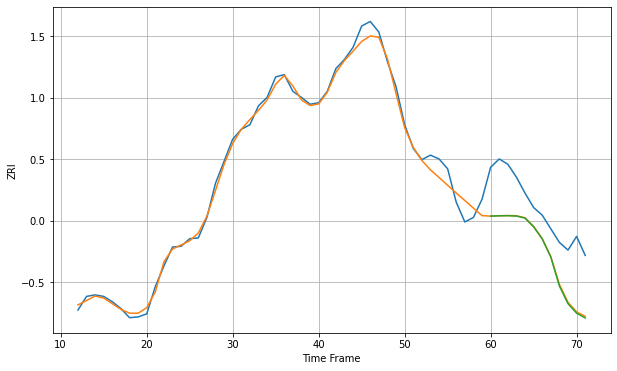

Wall time: 14.4 s
33432 9.943059497238139 61.18262998087855 62.13536391482385 [1922.74575383 1923.10458784 1923.26326237 1922.81478665 1920.11636749
 1908.63628591 1892.70322271 1868.75229327 1830.60721048 1807.37765809
 1794.89565094 1788.60794508]

Got an mse at 0.0025 in round 470 and stopped training

60 60 12


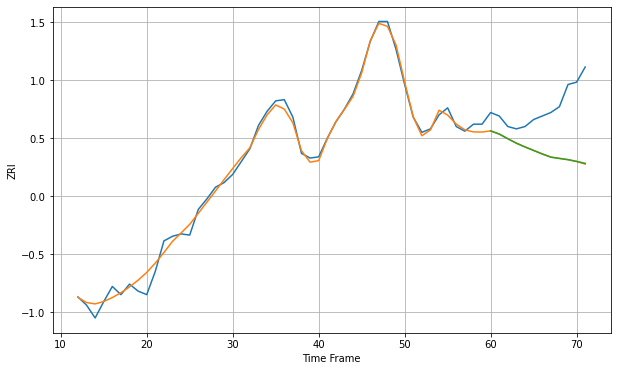

Wall time: 16.8 s
33433 5.360903830689576 42.726491420812984 42.624637946905374 [1752.27207582 1749.55047533 1745.53775191 1741.69745968 1738.47626313
 1735.48056617 1732.49745983 1729.76426479 1728.66063579 1727.61153748
 1726.16285338 1724.45927975]
60 60 12


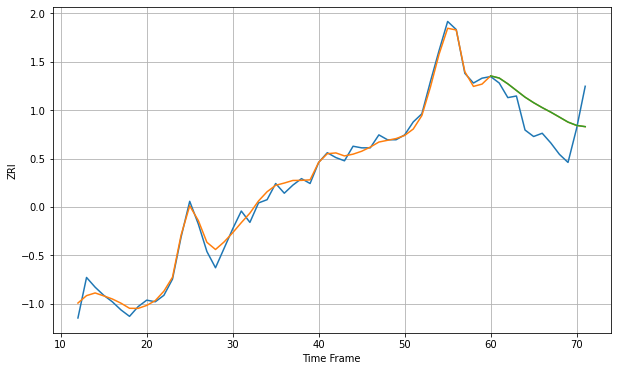

Wall time: 17.3 s
33435 4.051460477435646 16.637078897575886 16.64936033104688 [1726.40968659 1725.07654792 1721.50814809 1717.40108185 1713.29114795
 1709.87769564 1706.83453073 1704.02540693 1700.98704653 1697.90630377
 1695.85839312 1695.0934501 ]

Got an mse at 0.0025 in round 187 and stopped training

60 60 12


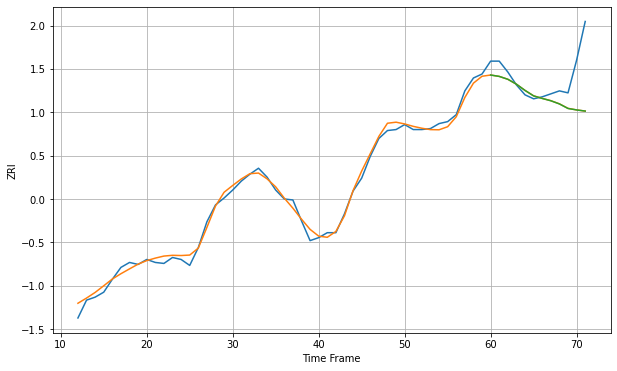

Wall time: 9.42 s
33436 5.143934521920949 31.17987648964251 31.193635239097322 [1552.98819401 1551.59971376 1548.70876286 1543.73942081 1537.46180533
 1531.94781054 1529.37233146 1527.04601469 1523.8231182  1519.25404106
 1517.78876181 1516.62872271]

Got an mse at 0.0024 in round 332 and stopped training

60 60 12


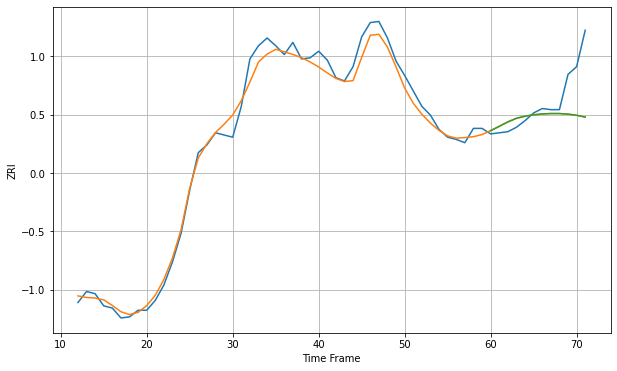

Wall time: 12.9 s
33444 8.545362308235326 28.43253088146452 28.436080551738897 [1677.95187483 1681.84875595 1685.85989217 1689.12977184 1691.07383301
 1692.30466357 1693.07401341 1693.46783618 1693.45023095 1692.9234826
 1691.88140403 1690.26603369]
60 60 12


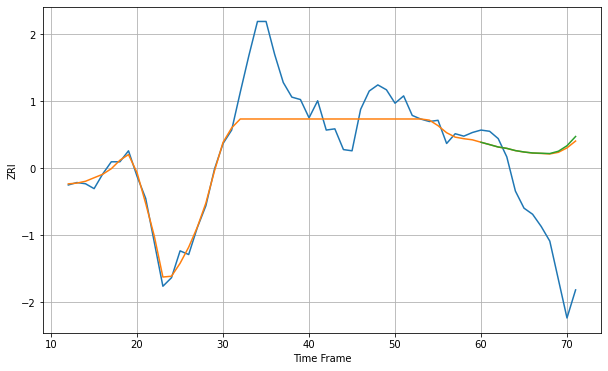

Wall time: 17 s
33460 22.782915568210946 70.66086068905517 71.64648631995387 [1495.00232999 1493.08744546 1491.1156713  1489.99684019 1488.17973071
 1487.04058429 1486.2446507  1485.99745465 1485.75504941 1487.65504617
 1492.15545373 1499.72652317]

Got an mse at 0.0025 in round 348 and stopped training

60 60 12


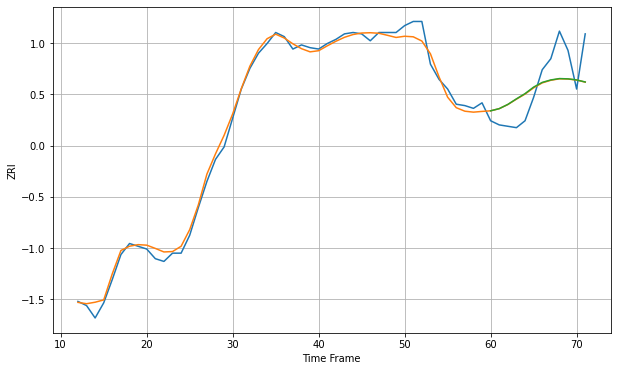

Wall time: 13.5 s
33461 4.830227261284871 19.399624449780035 19.388760777662423 [1431.20455494 1432.78983796 1435.84973732 1439.8894303  1443.68356966
 1448.41082525 1451.81733931 1453.60463174 1454.59416764 1454.38625395
 1453.6199001  1452.12325416]

Got an mse at 0.0025 in round 190 and stopped training

60 60 12


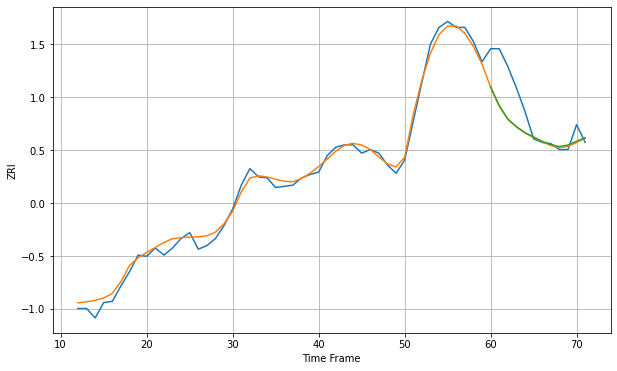

Wall time: 9.78 s
33510 5.192800983898534 24.17005906168936 24.0575980714227 [1244.64554192 1228.92401694 1217.64638807 1211.29603678 1206.26944096
 1202.57796979 1198.96555933 1196.1225296  1194.53077111 1195.8179154
 1199.02510788 1201.93309439]

Got an mse at 0.0025 in round 153 and stopped training

60 60 12


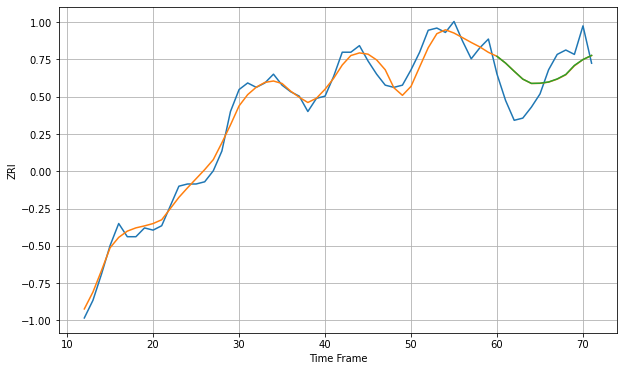

Wall time: 8.62 s
33511 4.198197962484342 12.480369338716292 12.457050531659867 [1278.12495358 1275.03377033 1271.32062702 1267.75206132 1265.80499529
 1265.88287817 1266.44959854 1267.82878945 1269.8679145  1273.99476079
 1276.67233149 1278.53843586]

Got an mse at 0.0025 in round 143 and stopped training

60 60 12


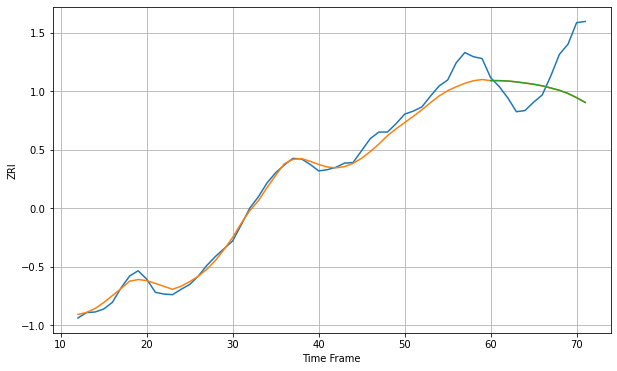

Wall time: 8.58 s
33602 15.042305723957162 65.49074754758973 65.59540073572104 [1837.07427384 1836.99366551 1836.40096408 1834.9103481  1833.04205322
 1831.06924806 1828.41604032 1824.7682081  1820.89106158 1815.57147666
 1808.47521721 1800.44094145]

Got an mse at 0.0025 in round 166 and stopped training

60 60 12


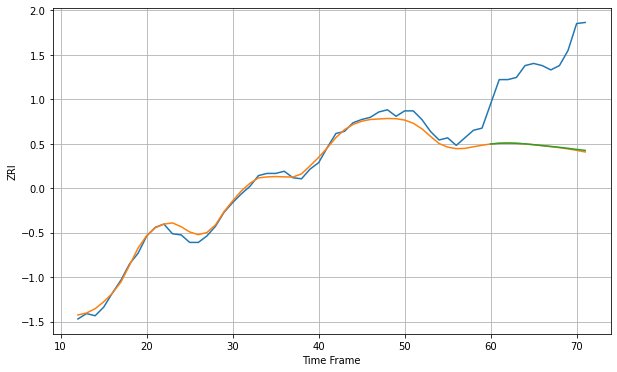

Wall time: 9.29 s
33604 5.890488938091638 79.58912358767151 79.16521640533647 [997.31630862 997.95637138 998.1647827  997.94920961 997.41296113
 996.67911795 995.86071851 995.05179472 994.22273298 993.27182233
 992.27759165 991.35048392]

Got an mse at 0.0025 in round 80 and stopped training

60 60 12


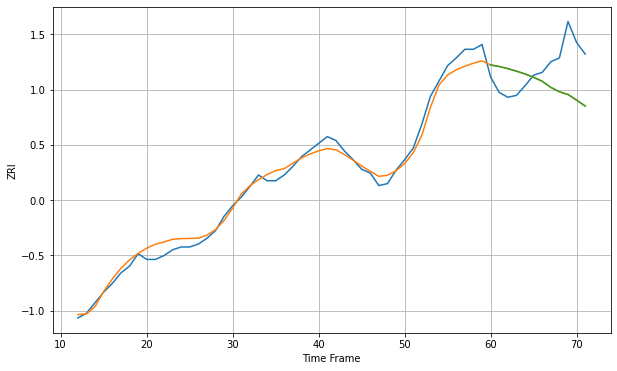

Wall time: 6.67 s
33606 8.175979361617909 37.598016693538604 37.55256000376092 [1537.65513983 1536.10129888 1533.86784848 1531.24039715 1528.31068553
 1524.80856706 1520.71812951 1514.31691002 1509.73145303 1506.92633372
 1501.02515343 1495.00011969]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


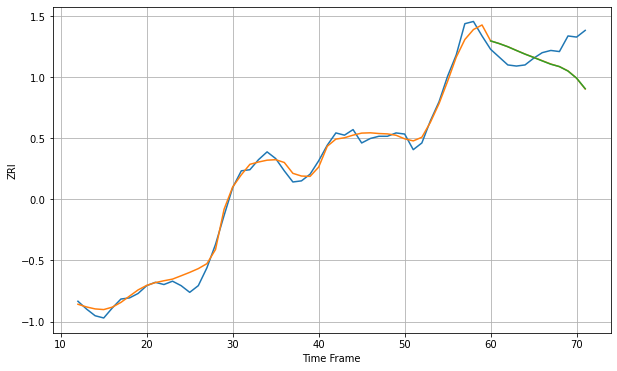

Wall time: 9.76 s
33607 6.087188767148099 22.8302210520896 22.803020133107545 [1460.554088   1458.16193226 1455.32710231 1451.97073409 1448.69431017
 1445.73091918 1442.64067797 1439.64225757 1437.52527692 1433.50413335
 1427.1214725  1417.67381799]

Got an mse at 0.0025 in round 246 and stopped training

60 60 12


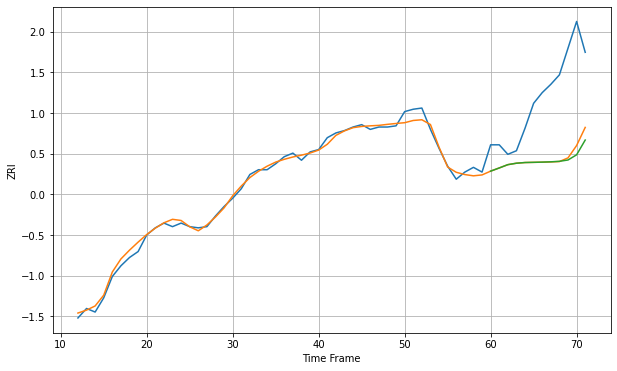

Wall time: 10.9 s
33612 3.9856477003674606 58.416273661800716 60.82511068699417 [ 979.80023417  982.48384362  985.26622414  986.49010611  987.06619899
  987.22792587  987.4040655   987.66251998  988.08632558  989.20707146
  993.58470653 1006.01196129]

Got an mse at 0.0025 in round 130 and stopped training

60 60 12


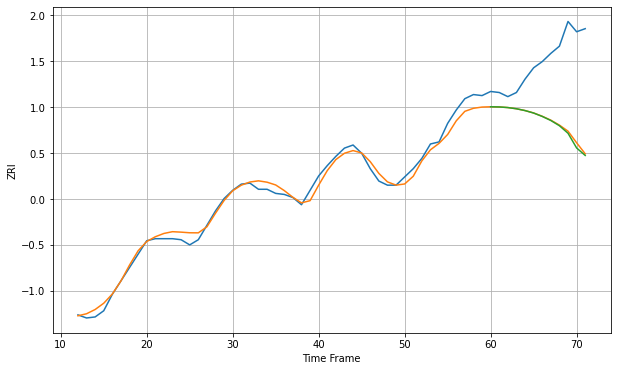

Wall time: 8.16 s
33613 6.23474626095826 67.25781733904066 68.54682695842216 [1184.14617369 1183.96537765 1183.37544139 1182.20793843 1180.44271758
 1178.05908814 1174.76725407 1170.81233168 1165.73304843 1158.42110464
 1144.14752832 1136.86923485]

Got an mse at 0.0025 in round 62 and stopped training

60 60 12


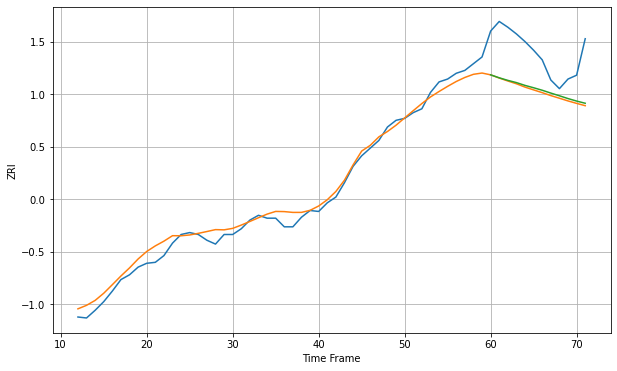

Wall time: 6.39 s
33615 8.220743899082505 43.91121954037204 42.512135530150495 [1273.37270274 1270.28075623 1267.60908763 1265.28552846 1262.36606465
 1259.90963415 1257.31936398 1254.36687777 1251.55948143 1248.64415284
 1246.05032868 1243.75845574]

Got an mse at 0.0025 in round 227 and stopped training

60 60 12


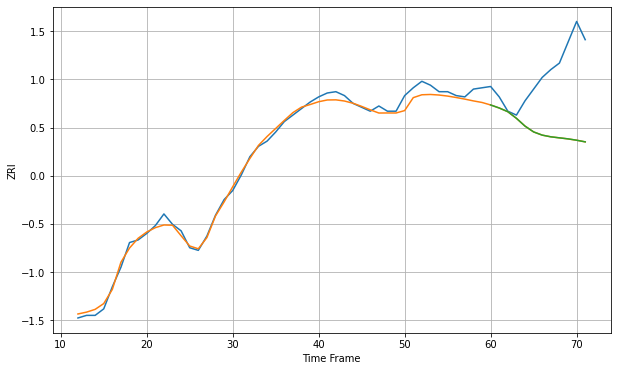

Wall time: 10.5 s
33617 4.451032526252222 49.779030226420005 49.76575535243479 [1062.78959384 1060.46000881 1057.60967644 1052.5178327  1046.53130027
 1042.06721825 1039.60618917 1038.30904284 1037.51398148 1036.72794366
 1035.68966988 1034.42860998]

Got an mse at 0.0025 in round 172 and stopped training

60 60 12


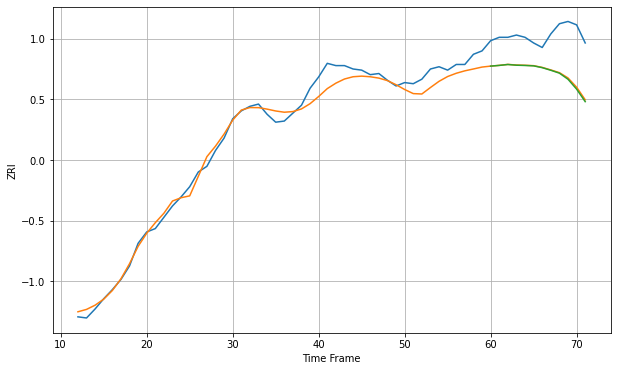

Wall time: 9.05 s
33626 8.195261265207177 34.93281608815838 35.60807040599384 [1433.55597085 1434.16327484 1434.97632655 1434.3514317  1434.11454017
 1433.77292054 1432.18442238 1429.87089685 1427.32100551 1421.93806474
 1413.19969034 1402.15610165]

Got an mse at 0.0025 in round 363 and stopped training

60 60 12


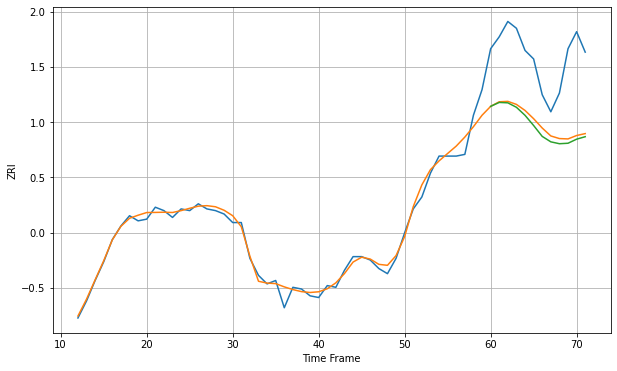

Wall time: 13.8 s
33634 4.121833662451666 40.16276041053136 42.17370148336055 [1218.1715026  1220.48451556 1220.24986383 1217.63471946 1212.92851186
 1206.94166089 1200.55190084 1197.36152622 1196.25643495 1196.53763473
 1198.9244513  1200.37407129]

Got an mse at 0.0025 in round 187 and stopped training

60 60 12


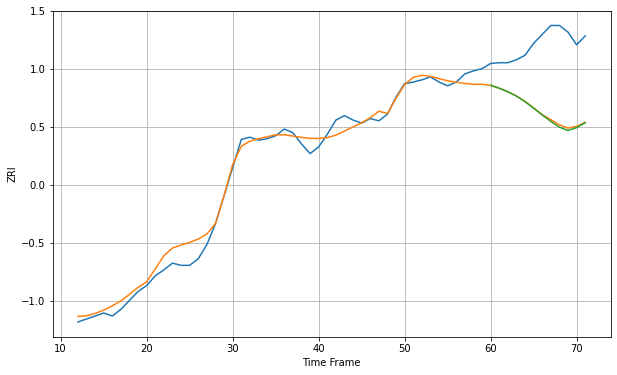

Wall time: 9.38 s
33701 12.094788485262495 93.37328098784862 94.72765688377523 [1334.57562323 1330.77996869 1325.99144008 1320.12019864 1312.72967136
 1303.92426239 1294.89594194 1286.13970022 1278.56423701 1274.02198346
 1277.85044454 1284.40728824]

Got an mse at 0.0025 in round 239 and stopped training

60 60 12


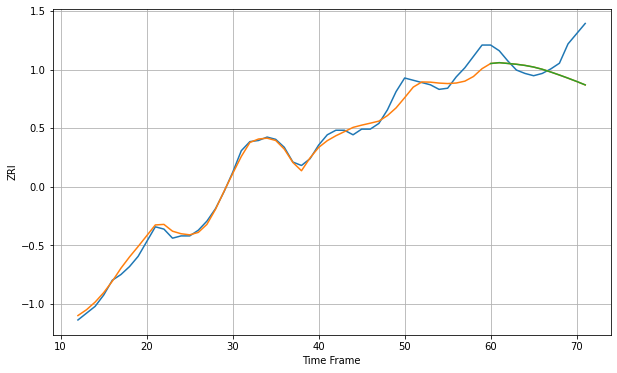

Wall time: 10.4 s
33702 6.546280242695175 22.816030411599904 22.80363699768135 [1165.74966073 1166.48640825 1165.78978684 1165.0738886  1164.05665175
 1162.6334886  1160.67698907 1158.24253607 1155.61331976 1152.8549197
 1149.97841826 1146.93319748]

Got an mse at 0.0025 in round 218 and stopped training

60 60 12


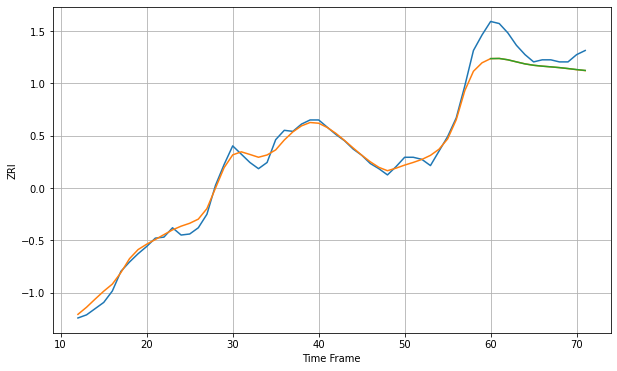

Wall time: 10.3 s
33705 7.261817376155528 18.665433461436578 18.63972903630993 [1313.17125181 1313.32077331 1312.04052769 1310.02773127 1308.0742238
 1306.74105185 1305.887448   1305.21926432 1304.49802135 1303.59280637
 1302.59477953 1301.76953623]

Got an mse at 0.0025 in round 234 and stopped training

60 60 12


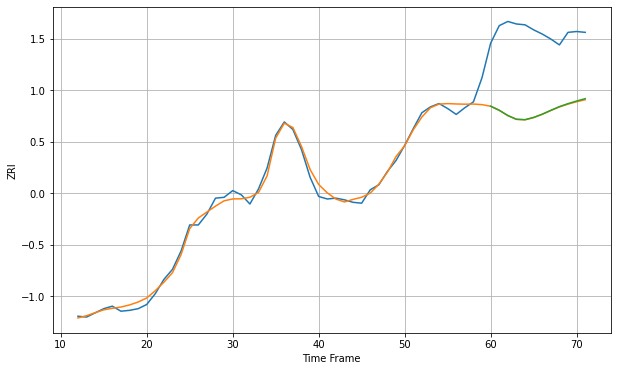

Wall time: 10.6 s
33706 7.269474355650849 94.92806457900234 94.6415796787343 [1470.78642063 1465.94164436 1459.63955993 1455.18276868 1454.68562113
 1457.36903963 1461.2830035  1465.90307975 1470.29871767 1473.86446745
 1476.98360822 1479.80047955]

Got an mse at 0.0025 in round 103 and stopped training

60 60 12


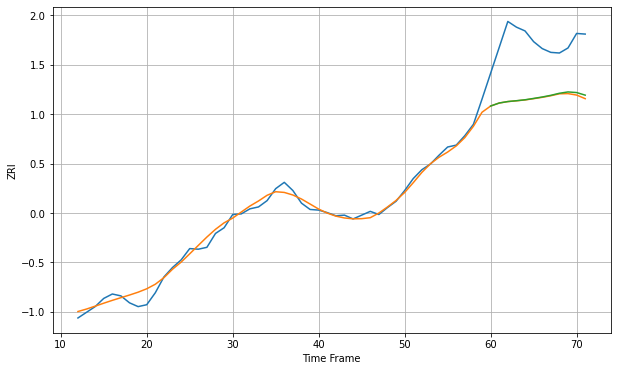

Wall time: 7.49 s
33708 8.81022058000013 91.53479011630577 90.28759141027906 [1568.95074783 1573.74619581 1576.06591409 1577.37724689 1578.86328267
 1580.9916892  1583.26222231 1585.91705093 1589.18877686 1591.31070107
 1590.32387202 1586.19493021]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


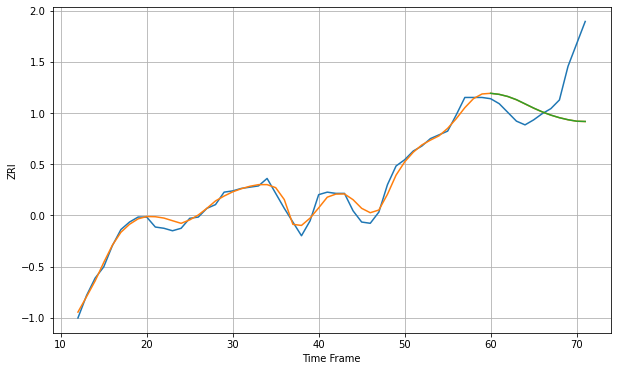

Wall time: 9.07 s
33712 4.743559716287766 33.26583306705165 33.253957877137665 [1151.33179992 1150.48648804 1148.78278606 1146.21903105 1142.88372679
 1139.51417912 1136.44846518 1133.85446737 1131.7591111  1130.12933969
 1128.9581881  1128.74313311]

Got an mse at 0.0024 in round 121 and stopped training

60 60 12


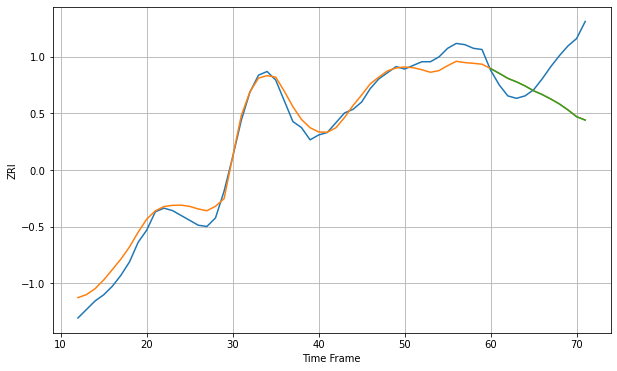

Wall time: 8.16 s
33716 8.78378203146204 36.9180225826248 36.962740714557256 [1179.38939028 1175.47943138 1171.37219362 1168.54181559 1165.18300488
 1161.19275293 1158.07665366 1154.43449858 1150.35859792 1145.46258147
 1139.92687242 1137.15532842]

Got an mse at 0.0025 in round 132 and stopped training

60 60 12


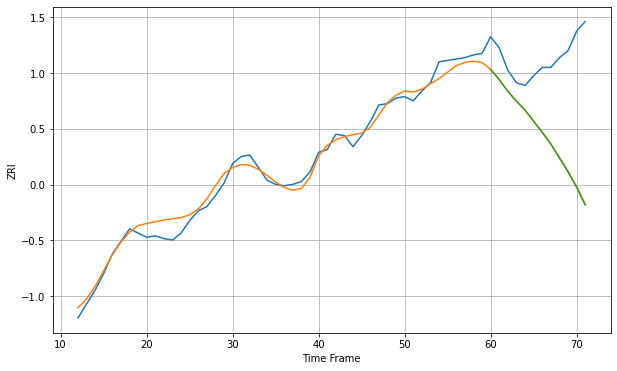

Wall time: 8.15 s
33755 5.991890423660019 64.74277513136734 65.07136380628714 [1077.56609494 1070.21216677 1061.85518036 1054.74660092 1048.30745458
 1040.32255643 1032.40036533 1023.91451844 1013.9665272  1003.87726266
  992.85680642  980.10659187]

Got an mse at 0.0025 in round 236 and stopped training

60 60 12


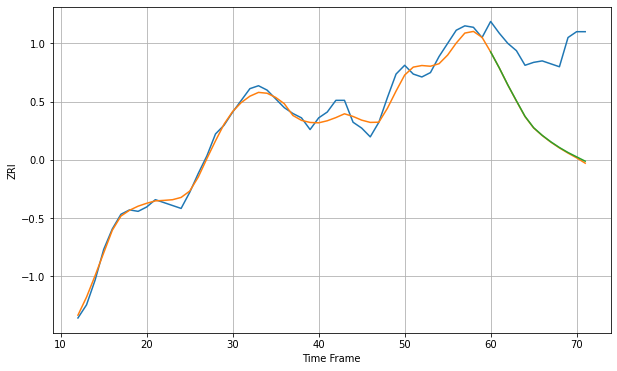

Wall time: 11.1 s
33756 5.037579984247049 55.26903064887802 54.85746397975546 [1122.15368676 1111.26309572 1099.53604366 1088.66156599 1078.02999167
 1070.27892937 1065.04726942 1060.61101353 1056.69883434 1053.28531291
 1050.31662443 1047.34640457]

Got an mse at 0.0025 in round 150 and stopped training

60 60 12


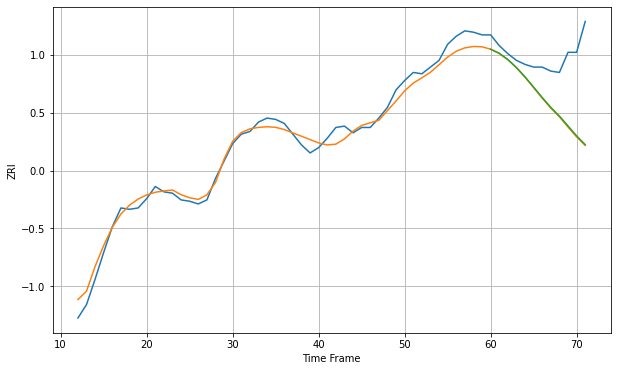

Wall time: 8.79 s
33771 6.345733293111474 39.28345353012485 38.87616635140245 [1162.32954063 1159.24464081 1154.64969238 1148.68032    1141.71643489
 1134.03804672 1126.29988632 1118.96537568 1112.47877144 1105.11455037
 1097.70284885 1091.15839691]

Got an mse at 0.0025 in round 260 and stopped training

60 60 12


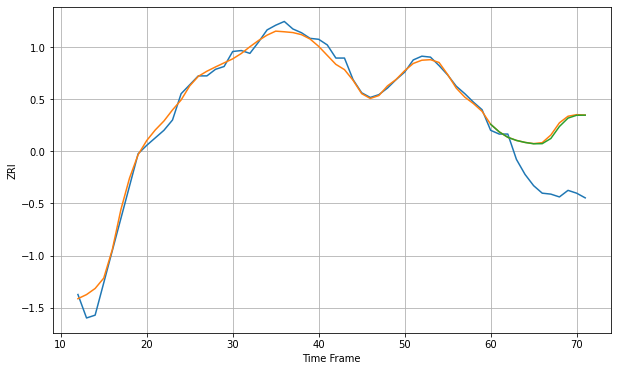

Wall time: 11.4 s
33907 7.6934816002435396 56.10093931695217 54.88096132352731 [1226.4485066  1218.3332382  1212.55069422 1209.22303263 1207.0761202
 1205.64329199 1205.75458711 1211.26278108 1224.06277325 1233.00411285
 1236.01871038 1236.14564212]

Got an mse at 0.0024 in round 125 and stopped training

60 60 12


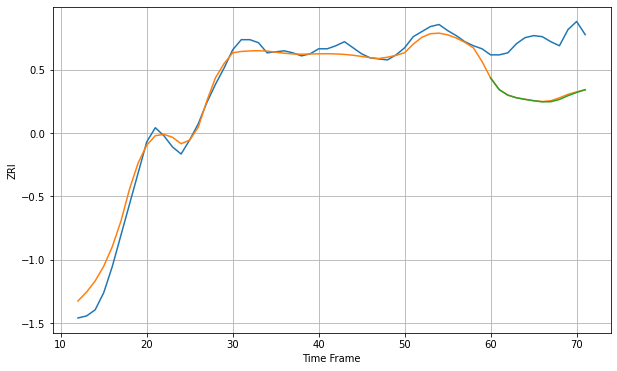

Wall time: 8.22 s
33916 9.869595608342093 54.93326793112709 55.39004159725409 [1121.12628072 1109.61322715 1104.22808095 1101.57985637 1100.04546387
 1098.66433931 1097.5870844  1097.6838948  1099.89255092 1103.63316616
 1106.7949347  1109.51618314]

Got an mse at 0.0024 in round 215 and stopped training

60 60 12


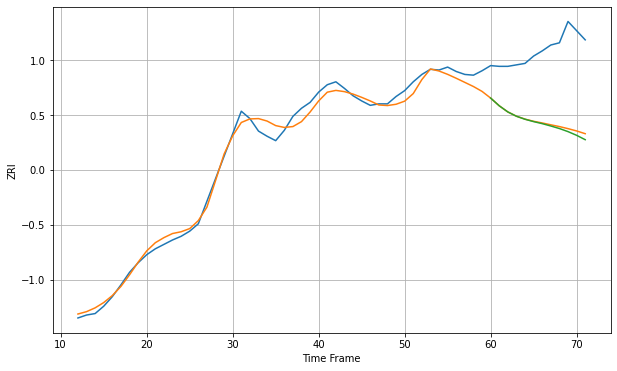

Wall time: 10.4 s
33973 10.271416874281647 98.9566230592871 101.55852555395293 [1065.87992299 1055.3733657  1047.02576507 1041.18085153 1037.08587605
 1033.8802036  1031.12837125 1027.93303039 1024.47552906 1020.27994217
 1015.25474578 1009.32279679]
60 60 12


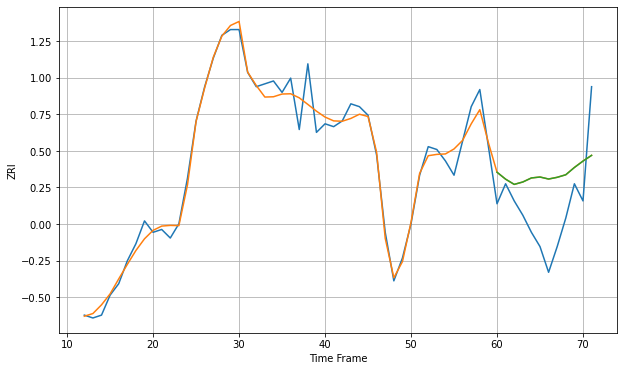

Wall time: 17.2 s
34203 4.105936189223513 18.121856787811705 18.117633144043456 [1487.04247266 1484.61026522 1482.78408744 1483.62404732 1485.03563804
 1485.36498266 1484.65750419 1485.2578348  1486.15686277 1488.69017949
 1490.93151805 1492.94337062]
60 60 12


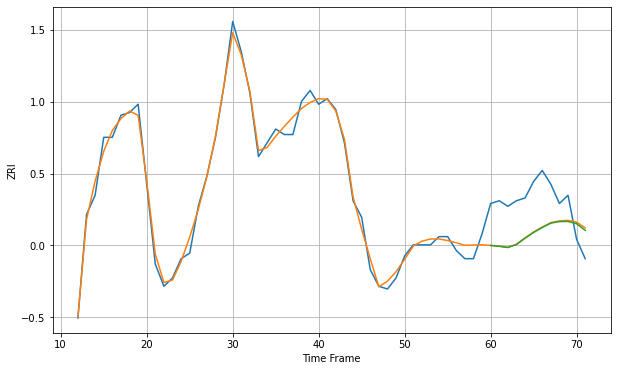

Wall time: 17.2 s
34207 2.808844375249129 14.206315427833951 14.235486114741772 [1176.80389989 1176.50151887 1176.06976642 1177.12772914 1179.39769103
 1181.51595593 1183.29697779 1184.88343739 1185.44891752 1185.49892761
 1184.67896752 1182.27662748]

Got an mse at 0.0025 in round 337 and stopped training

60 60 12


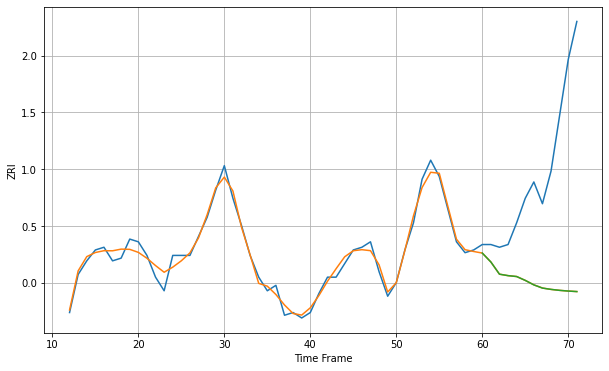

Wall time: 13.2 s
34208 2.480222962407773 47.52774478855575 47.53029909819338 [1196.86104645 1193.58755688 1189.10041252 1188.56183126 1188.23091327
 1186.81605118 1185.16463762 1183.98927143 1183.50863437 1183.15303932
 1182.89752606 1182.70137362]
60 60 12


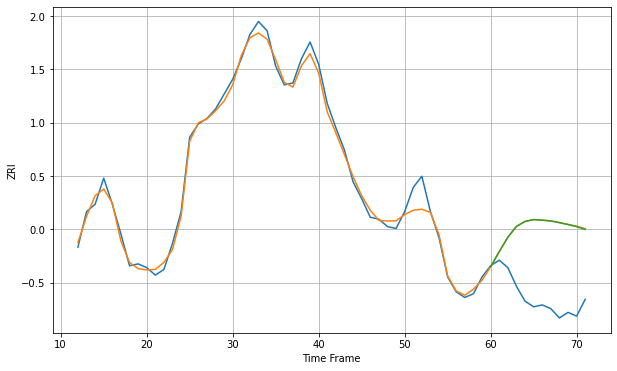

Wall time: 17.4 s
34210 4.286893617549092 38.96075052545542 38.876997075064594 [1285.4742733  1293.57033147 1301.27994573 1307.11396463 1309.77434356
 1310.74385298 1310.42120655 1310.01514986 1309.08792371 1308.07796531
 1306.97947379 1305.4574411 ]

Got an mse at 0.0025 in round 195 and stopped training

60 60 12


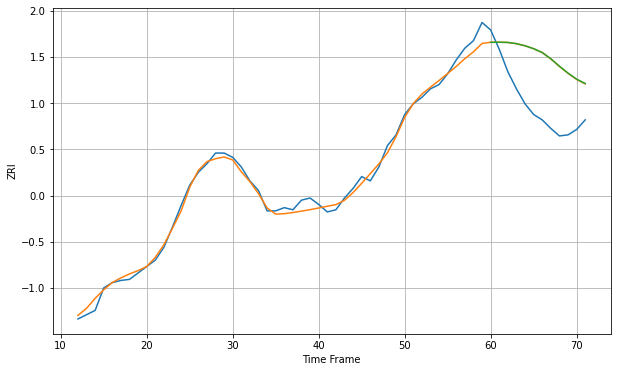

Wall time: 9.93 s
34232 5.592596583079196 48.673893513837434 48.78633805907359 [1502.47445432 1502.51101779 1502.33167359 1501.20658072 1499.23674515
 1496.50373161 1492.91240886 1487.10964346 1480.12501749 1473.69014148
 1468.03266765 1463.97898528]

Got an mse at 0.0025 in round 115 and stopped training

60 60 12


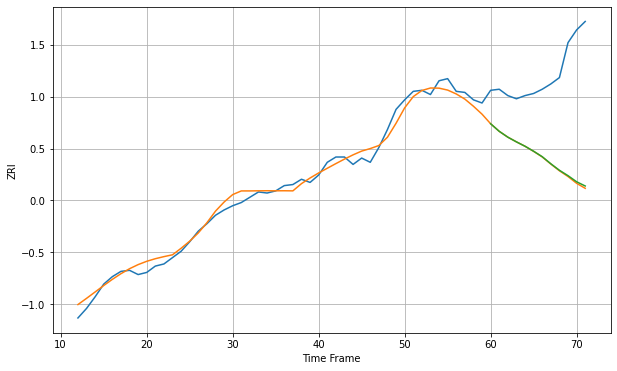

Wall time: 7.85 s
34683 6.646091704300324 86.79252117174687 86.07890380379804 [1099.39817136 1092.26045612 1086.73328549 1082.29110722 1078.17155247
 1073.44790674 1068.30259642 1061.62959211 1055.47695433 1050.38265647
 1044.61534169 1040.63839991]

Got an mse at 0.0025 in round 102 and stopped training

60 60 12


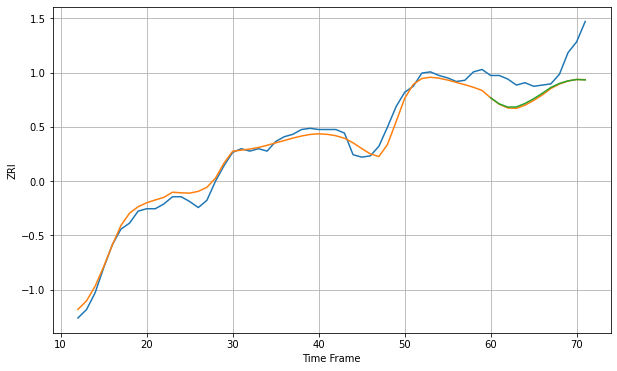

Wall time: 7.94 s
34698 6.544584476216331 23.0914752319588 22.73562308559237 [1229.38873807 1224.35998941 1221.66771364 1221.81379831 1224.69895725
 1228.59651584 1233.09577022 1238.00898142 1241.37314359 1243.5447745
 1244.65462379 1244.34285562]
60 60 12


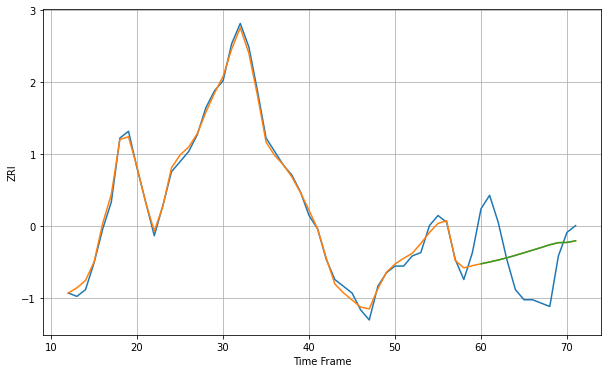

Wall time: 17 s
37040 1.6175676199690454 12.753793459810927 12.752761424772261 [736.66829719 737.20585546 737.79684386 738.43997664 739.18182063
 739.9410952  740.72319184 741.50161048 742.32029902 742.94231611
 743.02520348 743.50173748]
60 60 12


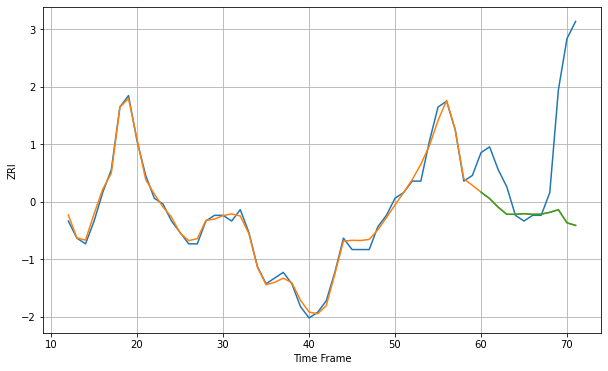

Wall time: 17 s
37042 0.9568584454491179 15.754060908627082 15.742082145820861 [715.07348297 713.94045852 712.42435771 711.18503313 711.18314062
 711.28664615 711.17583806 711.20985992 711.53001335 711.97985998
 709.69507264 709.2505453 ]

Got an mse at 0.0024 in round 167 and stopped training

60 60 12


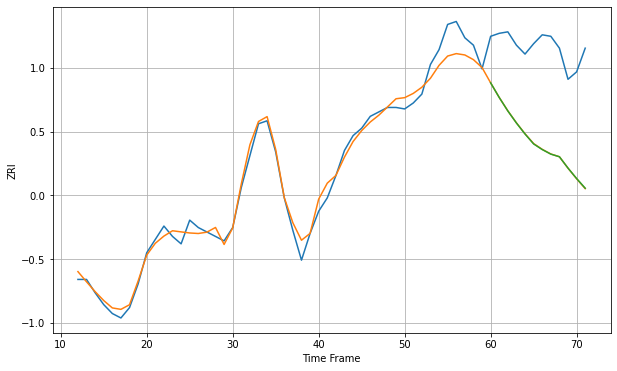

Wall time: 8.97 s
37075 7.034990518504553 65.37052309912869 65.38245931339861 [1111.59346996 1101.71234348 1092.64928231 1084.51369603 1077.09797978
 1070.39147592 1066.6095543  1063.52159255 1061.73939028 1054.08792449
 1047.06557968 1040.53563578]

Got an mse at 0.0025 in round 319 and stopped training

60 60 12


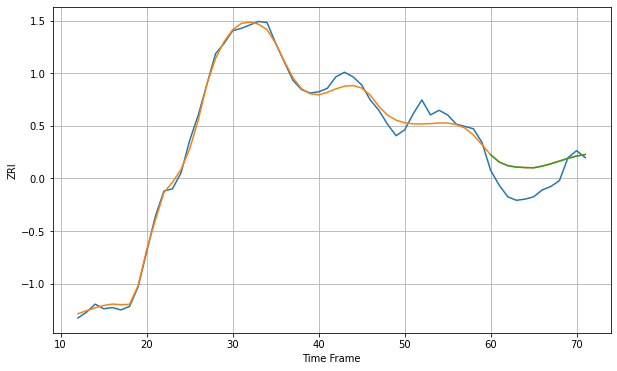

Wall time: 12.8 s
37076 5.973431877924599 19.732270351407386 19.679748756298267 [1103.50589229 1097.171801   1093.98580325 1092.77523176 1092.34878543
 1092.15586378 1093.58847114 1095.54035858 1097.9017985  1100.26559013
 1102.2671425  1103.61868602]

Got an mse at 0.0025 in round 282 and stopped training

60 60 12


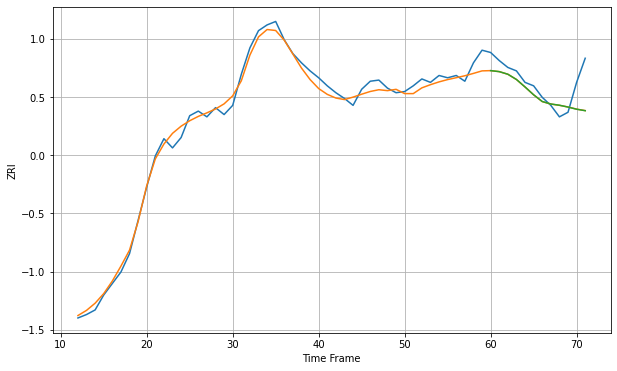

Wall time: 11.6 s
37115 6.172518119289082 16.494615233403138 16.520695836269084 [1144.22180102 1143.35513488 1141.09269741 1136.53110326 1130.02545075
 1123.2092397  1117.35552565 1115.20175589 1114.11784193 1112.52406332
 1110.64461415 1109.35995463]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


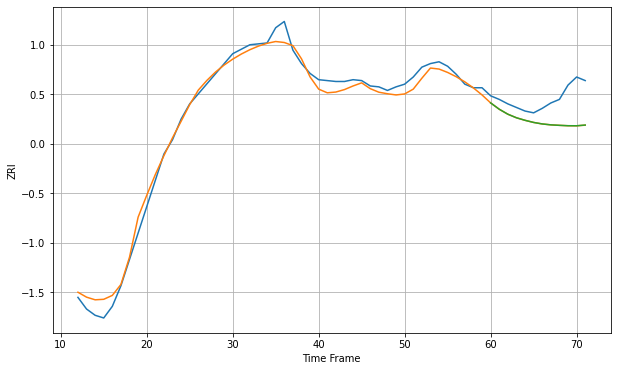

Wall time: 10.1 s
37211 9.145229583486534 28.745151465689222 28.71194966007007 [1187.08665271 1180.02649864 1174.47341767 1170.4982334  1167.65550105
 1165.28387567 1163.60568444 1162.59070325 1162.04806496 1161.62043765
 1161.56457444 1162.36768826]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


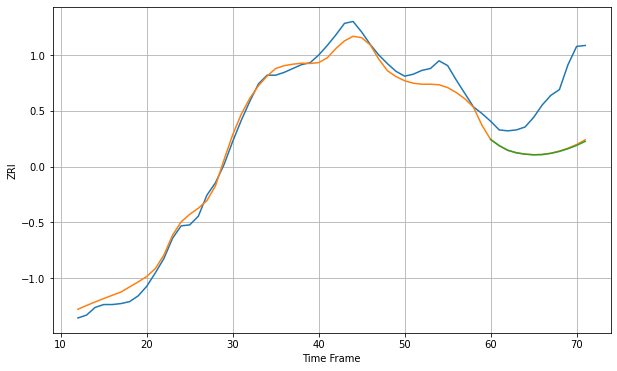

Wall time: 9.07 s
37214 10.015905160702278 59.18364162077413 59.66937190302707 [1125.98702821 1119.5778336  1114.72143196 1112.12756833 1110.70982575
 1110.05261428 1110.28197429 1111.52279958 1113.58056501 1116.37865284
 1119.82632675 1124.04369126]

Got an mse at 0.0025 in round 139 and stopped training

60 60 12


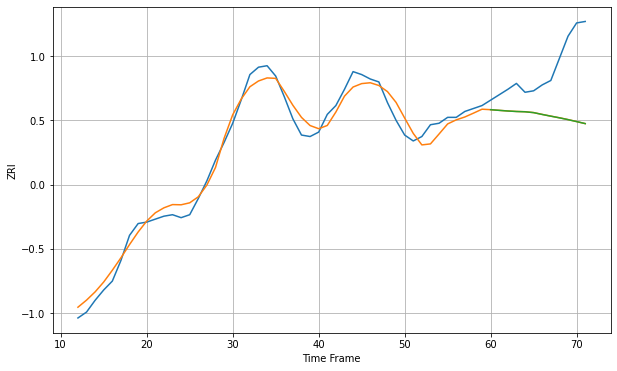

Wall time: 8.69 s
37221 6.579284298973056 36.72583251387857 36.745809481287814 [1341.19526993 1340.73858446 1340.30712873 1339.96686217 1339.77334009
 1339.20104953 1337.95864503 1336.79893687 1335.67572347 1334.45273791
 1333.12094074 1331.7682431 ]

Got an mse at 0.0025 in round 490 and stopped training

60 60 12


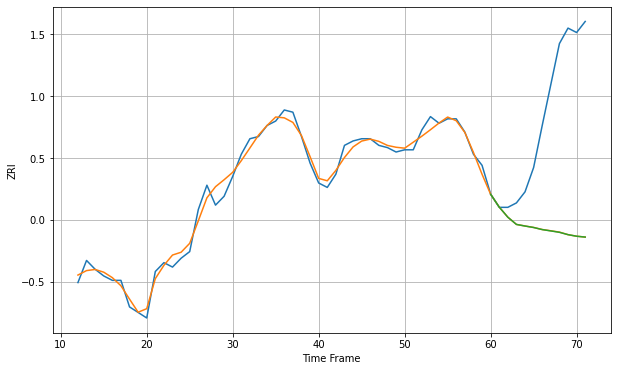

Wall time: 16.6 s
38104 3.330332313898813 58.88304658698005 58.90396178728237 [784.90961003 779.11326094 774.54834094 771.2735472  770.5502125
 769.88786267 768.94224568 768.34184037 767.70760996 766.65868147
 765.9452218  765.55717351]
60 60 12


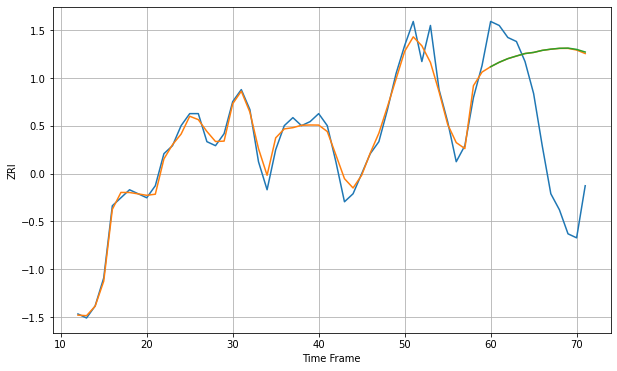

Wall time: 17.1 s
40391 2.4078222502933246 27.807523754412305 27.88184272002134 [821.70608886 822.81922646 823.72424214 824.37743532 824.99986883
 825.27411836 825.78475174 826.08729345 826.30206779 826.35132963
 826.02827456 825.37731315]

Got an mse at 0.0025 in round 454 and stopped training

60 60 12


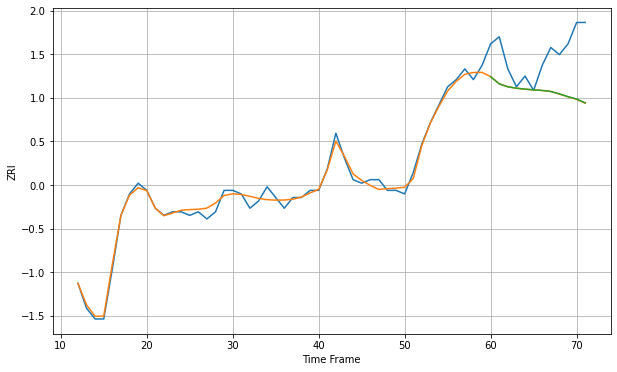

Wall time: 15.7 s
40502 1.4141809894969695 12.297151149640287 12.255834959762469 [810.81483141 808.82302581 807.99368001 807.60382043 807.33260212
 807.13761363 806.97036125 806.69049557 806.00512535 805.23579737
 804.5584582  803.50047577]
60 60 12


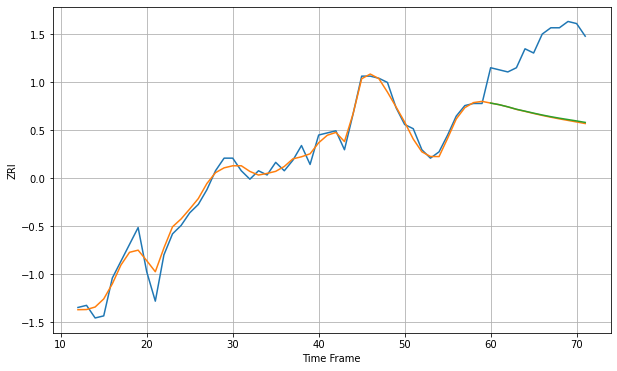

Wall time: 16.6 s
40515 3.9318267365667063 34.46080407978901 34.19983610626754 [888.19249319 887.42725108 886.41412291 885.25812358 884.34712221
 883.40883569 882.52600331 881.72850471 881.00615339 880.35352657
 879.69845522 878.99400985]

Got an mse at 0.0025 in round 453 and stopped training

60 60 12


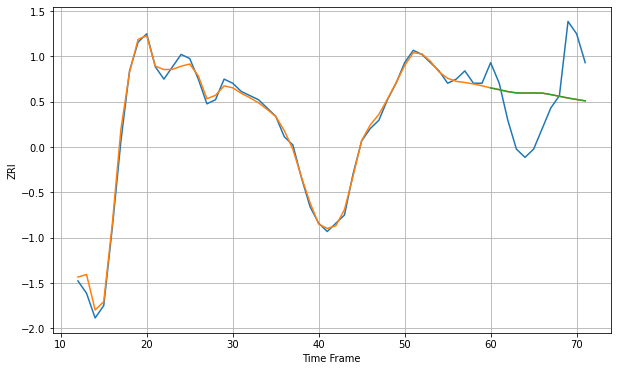

Wall time: 16.1 s
40517 1.3022939929614858 11.088777722201396 11.087186545657694 [874.86538712 874.43984938 873.96708395 873.64909745 873.61195719
 873.65013031 873.60655943 873.24441456 872.83164459 872.41292594
 872.05992863 871.72902896]
60 60 12


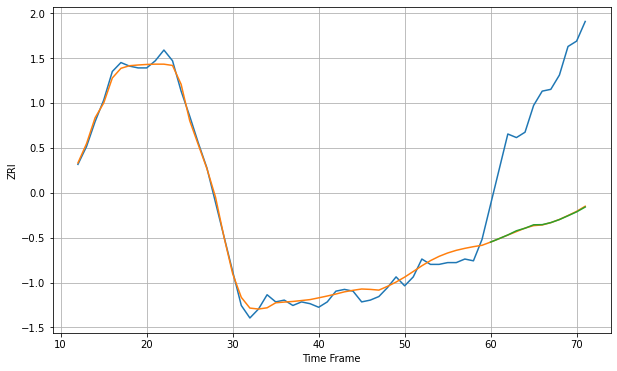

Wall time: 16.9 s
43055 3.748777913224064 71.76703782228974 71.79142011110443 [639.48650752 641.44348126 643.47242765 645.82293197 647.24501352
 649.16936498 649.24697275 650.39390101 652.09353015 654.22549331
 656.40754971 659.10935823]

Got an mse at 0.0025 in round 372 and stopped training

60 60 12


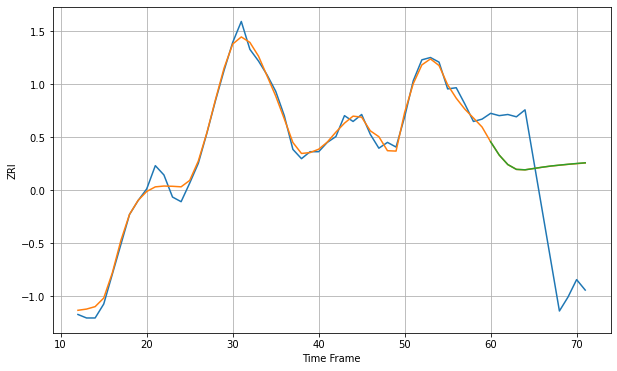

Wall time: 13.8 s
43201 5.9244086275333245 74.7204765293871 74.77967722891553 [1086.51104071 1075.09865347 1066.93008016 1062.78881593 1062.42130103
 1063.54824141 1064.67190623 1065.68402007 1066.45774399 1067.19508951
 1067.85480111 1068.44998348]

Got an mse at 0.0025 in round 272 and stopped training

60 60 12


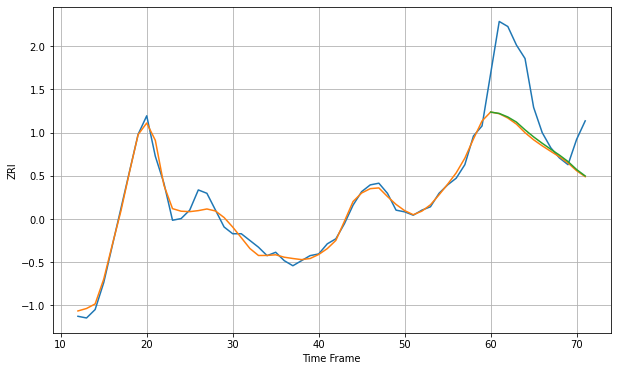

Wall time: 11.6 s
43202 3.7811800194729455 32.255020834011646 31.634766887874154 [948.22440784 947.39806184 945.30099307 942.28204904 937.67607895
 933.4829458  929.6999698  926.13869767 922.68351251 918.84649841
 914.09749229 910.28989725]

Got an mse at 0.0024 in round 265 and stopped training

60 60 12


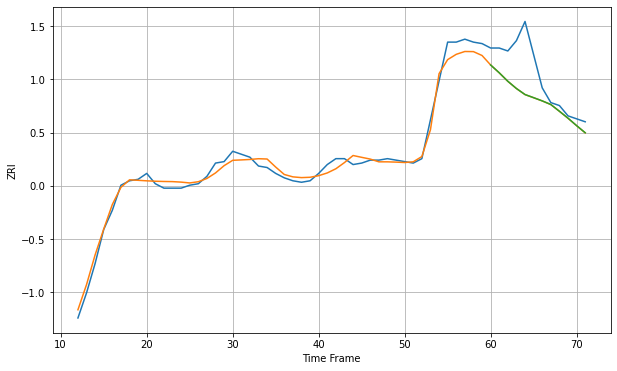

Wall time: 11.3 s
43204 4.622915232763058 21.17412725059247 21.1474097836763 [957.50388677 952.20345388 946.45980008 941.55424658 937.46435317
 935.3398902  933.1646656  930.70505152 926.13340256 921.43580881
 916.39724222 911.56837886]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


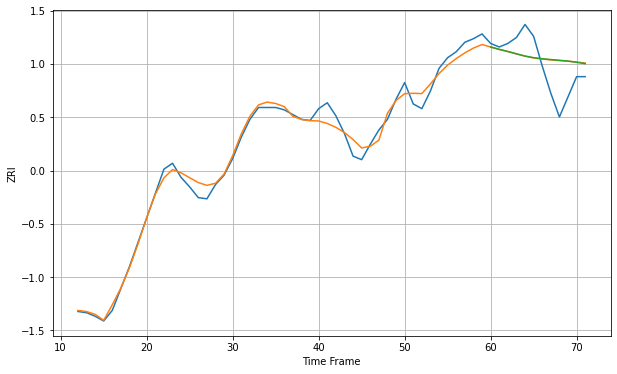

Wall time: 10.8 s
43205 6.657300781481385 21.534578415892753 21.57106652842989 [891.01631538 888.974799   887.21497948 885.22843531 883.36666019
 881.98895845 881.10213554 880.41030831 879.79051643 879.10928409
 878.09230609 876.96331269]

Got an mse at 0.0025 in round 437 and stopped training

60 60 12


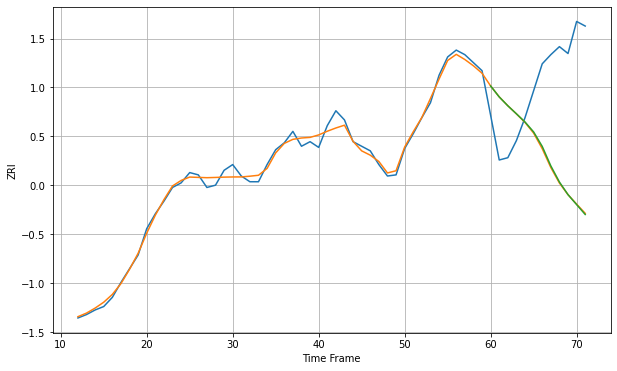

Wall time: 15.5 s
43206 4.715827425546948 93.32477679769467 93.13933990756586 [975.66689499 966.06567087 958.33839643 951.34264419 944.16855138
 935.51369356 922.87197825 905.849571   891.76705739 880.71933694
 872.04251991 863.3978276 ]

Got an mse at 0.0025 in round 283 and stopped training

60 60 12


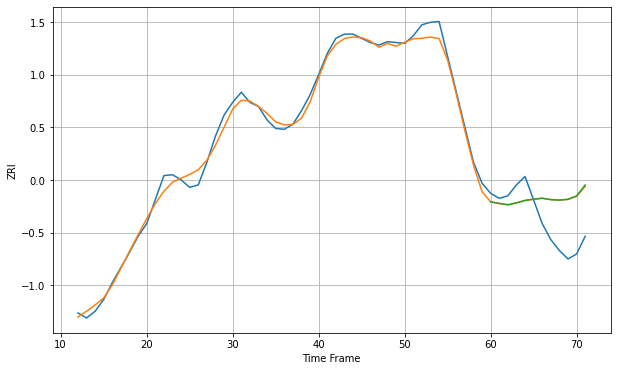

Wall time: 12.1 s
43212 8.273219075475978 42.316261643743644 42.578773491838746 [1069.8303594  1068.00362271 1066.39316098 1068.69205025 1071.5874401
 1073.10378082 1074.15570148 1072.49122005 1071.88364105 1072.9003024
 1076.95335444 1089.89966253]
60 60 12


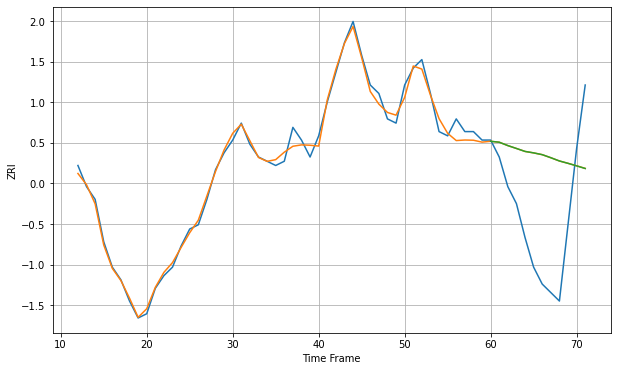

Wall time: 17.1 s
44035 1.660260279811946 20.55478811610597 20.56034574635267 [671.71272883 671.49229524 670.69847796 670.01690881 669.31825271
 668.9761438  668.55530744 667.83609031 667.06648673 666.51067312
 665.91452636 665.28695088]
60 60 12


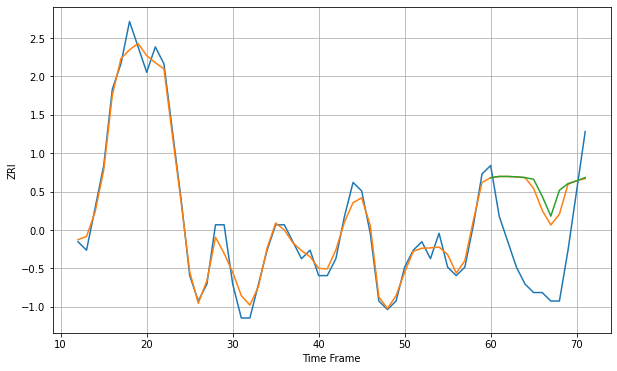

Wall time: 17.1 s
44052 1.2163742052281763 8.559108133363047 9.2522659652029 [617.55822581 617.70332186 617.70409445 617.65627942 617.57465386
 617.36854451 615.37294474 613.02139389 616.07560287 616.86254961
 617.17938128 617.58246667]

Got an mse at 0.0025 in round 279 and stopped training

60 60 12


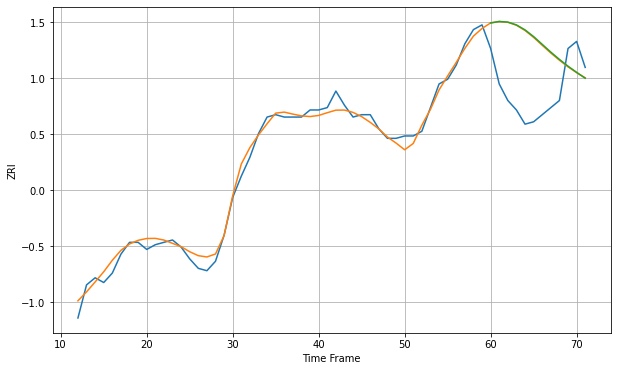

Wall time: 11.6 s
44102 3.1329194963212883 25.785953249642453 25.962172870444533 [864.81649069 865.4420618  865.17257628 863.98815326 861.87978211
 859.04086851 855.76307552 852.47511285 849.39052277 846.52641714
 843.91270051 841.43469563]
60 60 12


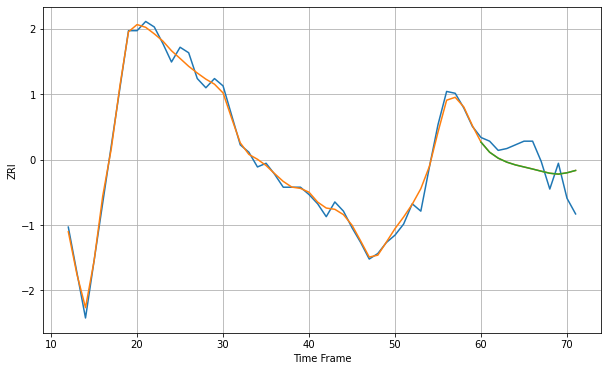

Wall time: 17.4 s
44103 3.476220895650883 11.33347943398886 11.339607746362063 [860.46714523 855.00875914 851.76765244 849.61523636 848.1177709
 846.99717253 845.87771078 844.6945079  843.57918386 843.10075379
 843.83498351 845.10377916]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


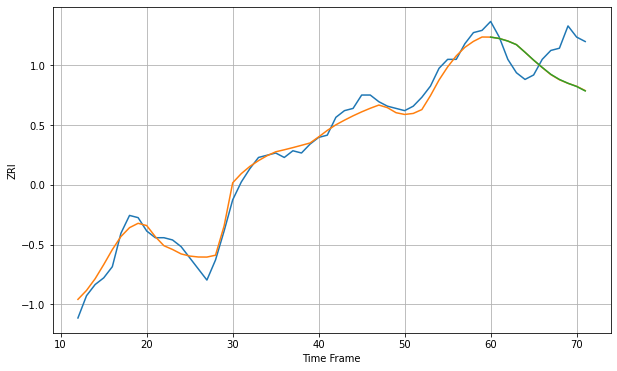

Wall time: 9.85 s
44107 4.0425207277370045 14.244066437337185 14.248352708545616 [870.98224719 870.36443582 869.21454947 867.59593759 864.18628289
 860.66802195 857.40126515 854.29025045 851.98927693 850.27780908
 848.84385124 846.84253251]
60 60 12


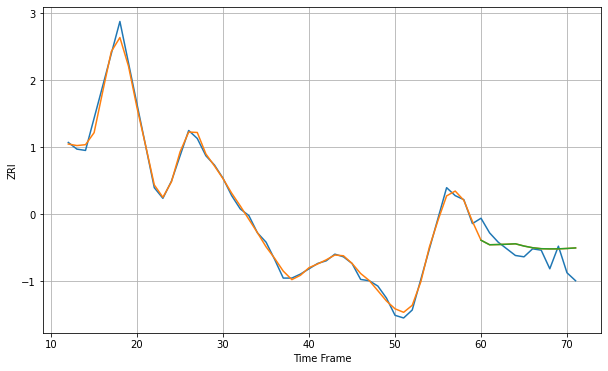

Wall time: 17.4 s
44108 3.4631753234807734 11.836363554030047 11.848512477816536 [775.47583043 772.07370523 772.23256786 772.45218112 772.79249589
 771.09669582 769.83084133 769.09864788 768.95690046 768.99093041
 769.28227202 769.70081359]
60 60 12


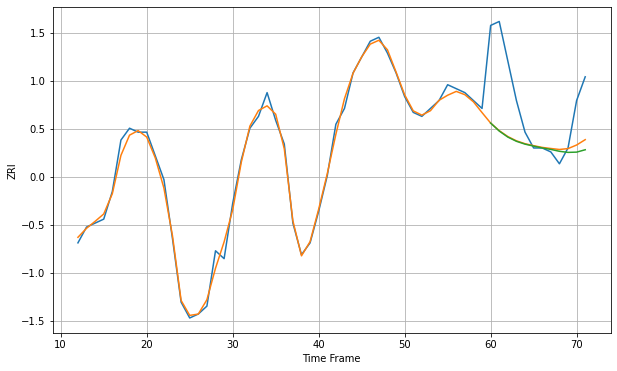

Wall time: 16.8 s
44109 1.554406966752579 13.675258600707467 14.102391686428506 [713.30084621 711.28580597 709.75752806 708.68784828 707.96912945
 707.47403367 707.00793119 706.63737991 706.15940937 705.88373104
 705.9499888  706.54888753]

Got an mse at 0.0025 in round 410 and stopped training

60 60 12


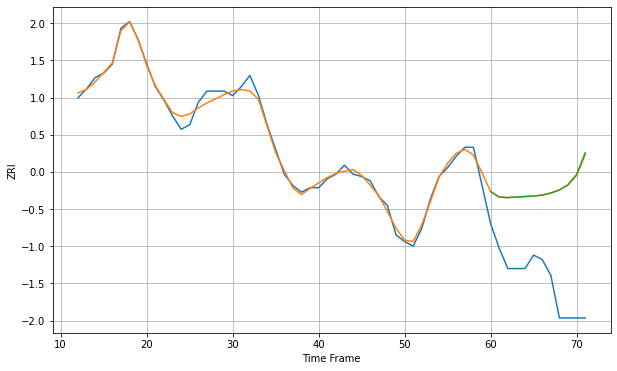

Wall time: 15 s
44110 2.3982733072620435 43.497078734615805 43.64726601279108 [724.28385017 721.81898488 721.58525472 721.85118631 722.04270282
 722.23118487 722.69686835 723.58660347 724.96750657 727.24478753
 731.91710383 741.52963788]

Got an mse at 0.0025 in round 243 and stopped training

60 60 12


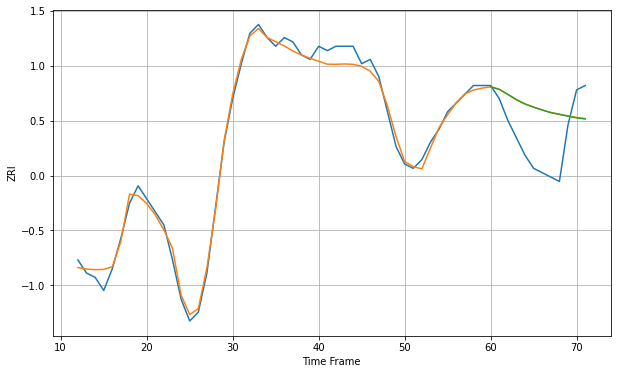

Wall time: 10.9 s
44111 1.8529809646875286 10.075460349944537 10.070349023840022 [760.7125733  760.11353188 758.9651361  757.75078891 756.75902239
 756.0344595  755.37502993 754.77564949 754.37008403 753.96804124
 753.58590437 753.33324641]
60 60 12


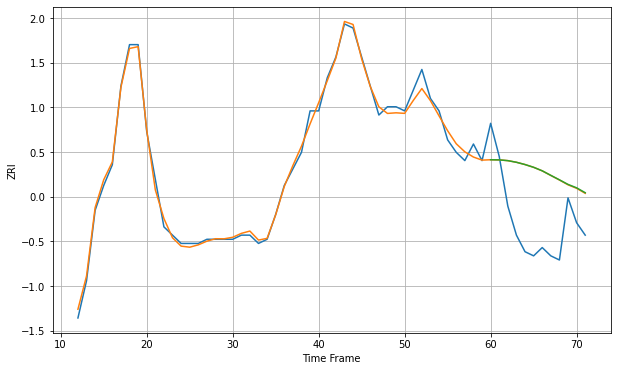

Wall time: 16.9 s
44112 1.476931977909415 14.948352906330497 14.97515192861913 [683.20533852 683.17067929 682.98676393 682.59362442 682.04579179
 681.38263375 680.53350501 679.43578904 678.35992041 677.25136843
 676.42602167 675.2481618 ]
60 60 12


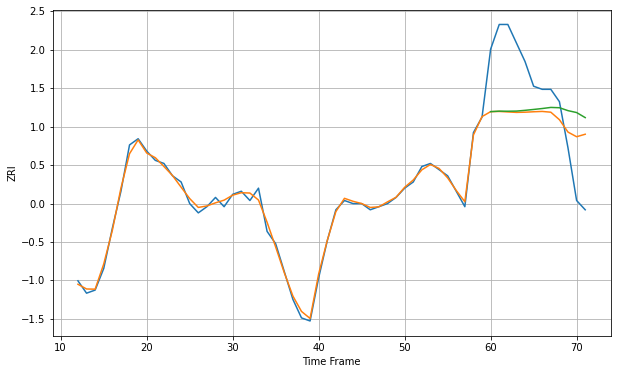

Wall time: 16.9 s
44118 1.2895951550023728 18.344144342037083 19.796187031119793 [962.77474736 962.93830835 962.90946579 962.95538936 963.19737008
 963.4836492  963.78404    964.1397333  964.04112522 963.09818086
 962.48036307 960.84245502]

Got an mse at 0.0025 in round 198 and stopped training

60 60 12


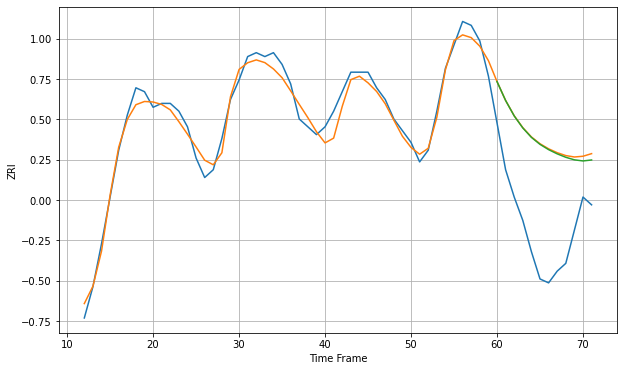

Wall time: 9.47 s
44120 2.561504725221507 24.138766838753032 23.84276049892343 [851.59343898 846.74239086 842.78764942 839.70480566 837.28922161
 835.50155138 834.14825475 833.0702792  832.18950758 831.53299676
 831.24946777 831.49424568]
60 60 12


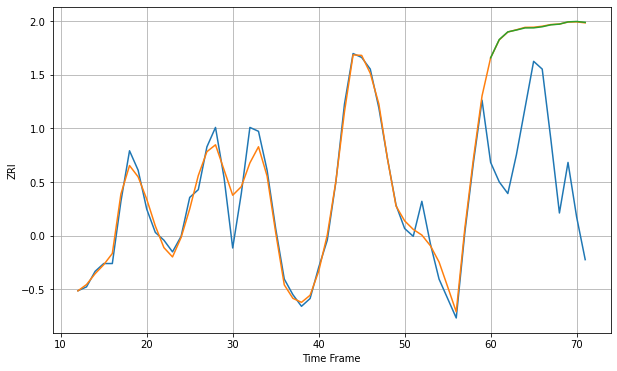

Wall time: 17.2 s
44133 3.264037422619716 36.734433610082526 36.754103762244235 [1038.90008458 1043.5908357  1045.56990809 1046.049583   1046.59121549
 1046.60091921 1046.88638658 1047.38319288 1047.56385625 1048.14017415
 1048.24802943 1048.01924857]
60 60 12


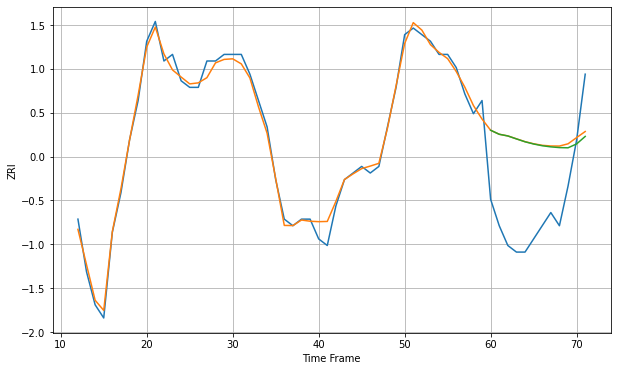

Wall time: 17.5 s
44646 1.165192130508224 12.512375117104458 12.49236490624728 [644.48898332 643.87970588 643.62418012 643.17702098 642.73957471
 642.40358039 642.14157029 641.96822158 641.85973109 641.82559754
 642.41444054 643.55339202]

Got an mse at 0.0025 in round 478 and stopped training

60 60 12


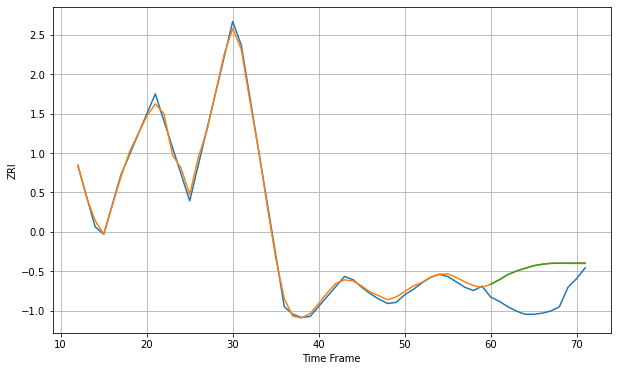

Wall time: 17 s
44720 3.7279831764168327 32.84170959426528 32.87611427670486 [688.7636643  692.97520544 697.65556822 701.03238996 703.52427567
 705.94796173 707.31136895 708.14554643 708.32824837 708.32289857
 708.37341895 708.46834612]

Got an mse at 0.0025 in round 202 and stopped training

60 60 12


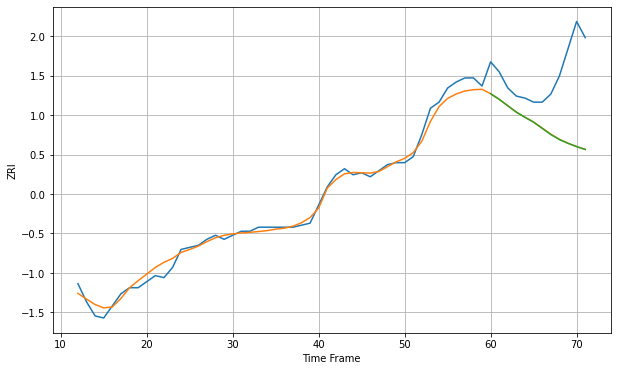

Wall time: 10 s
45205 3.1160817818541826 30.857805046975333 30.9041975001073 [674.16676036 671.3959704  668.17179138 665.01927359 662.47642353
 660.04483736 656.98158531 653.92198307 651.4543344  649.58154585
 647.96181903 646.53986292]

Got an mse at 0.0025 in round 142 and stopped training

60 60 12


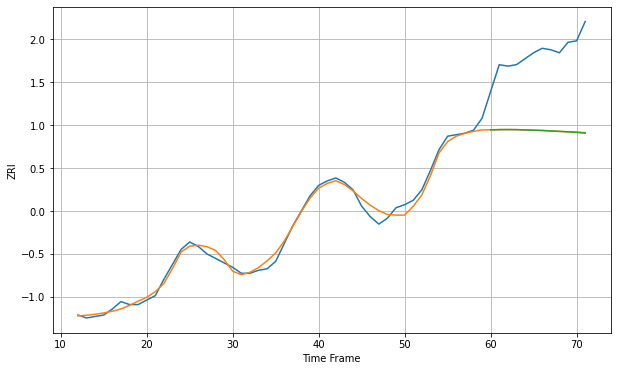

Wall time: 8.5 s
45211 3.507631175336686 52.39987096633283 52.49268197653631 [762.2469139  762.41922253 762.44972583 762.41098472 762.20718566
 762.03171829 761.81229381 761.51911556 761.18602209 760.90100806
 760.56008944 760.04685835]

Got an mse at 0.0025 in round 158 and stopped training

60 60 12


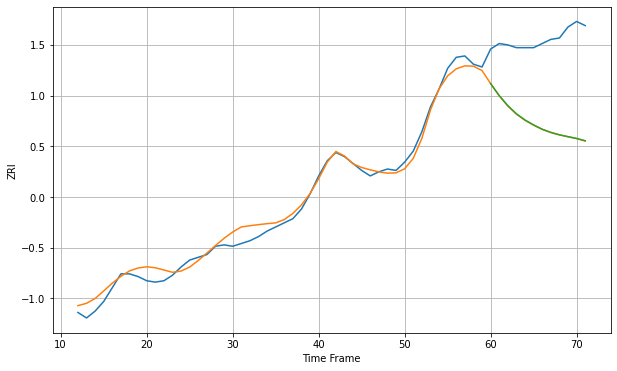

Wall time: 9.34 s
45212 5.530733062627731 62.04371928584977 61.932201925238765 [835.91678997 827.21579577 819.92987306 814.03852698 809.53589999
 805.96301133 802.86027325 800.55207158 798.7878377  797.44112617
 796.15623286 794.53229615]

Got an mse at 0.0025 in round 282 and stopped training

60 60 12


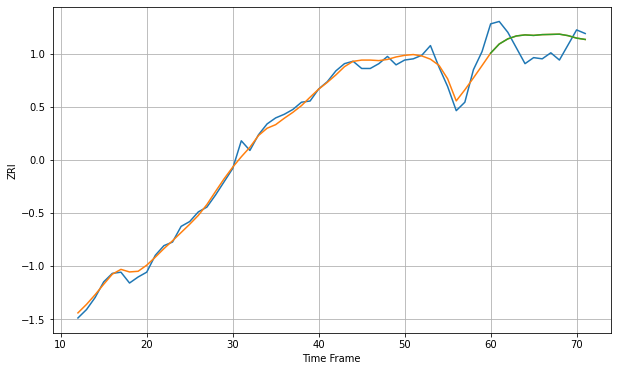

Wall time: 12.1 s
45219 5.0935049622359205 16.342137481910324 16.34184632704732 [1008.73208352 1016.28660351 1020.55336794 1022.97535738 1023.84726785
 1023.43769682 1024.08368834 1024.25695818 1024.46826866 1023.25000175
 1021.19752292 1020.06220458]
60 60 12


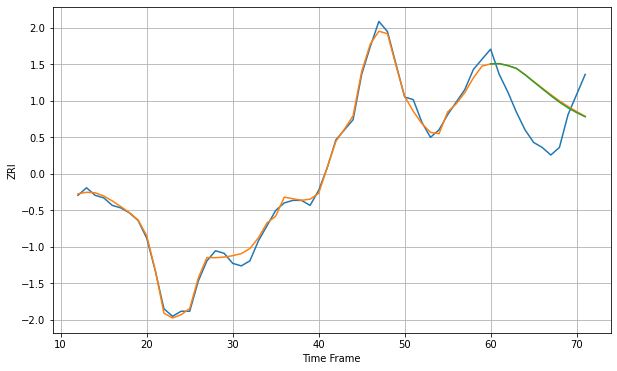

Wall time: 17.3 s
45405 1.9250536277691093 16.67145506854634 16.542188533642427 [618.16468808 618.26708888 617.49807636 616.36480427 613.85337904
 611.06622315 608.30430044 605.56122355 602.98758528 600.73547785
 598.82440837 597.20050757]

Got an mse at 0.0025 in round 293 and stopped training

60 60 12


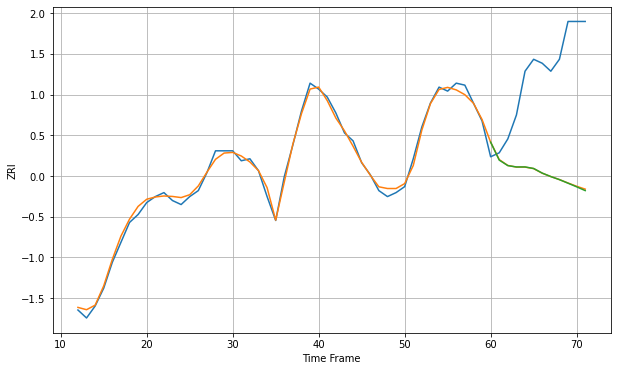

Wall time: 12.1 s
45840 2.2669110971088466 55.019866700233365 55.14695083394966 [797.3567422  788.3415978  785.56578615 784.88088227 784.90069792
 784.12267388 781.80129368 780.05222532 778.52046892 776.73523014
 774.91794416 773.00441216]

Got an mse at 0.0025 in round 461 and stopped training

60 60 12


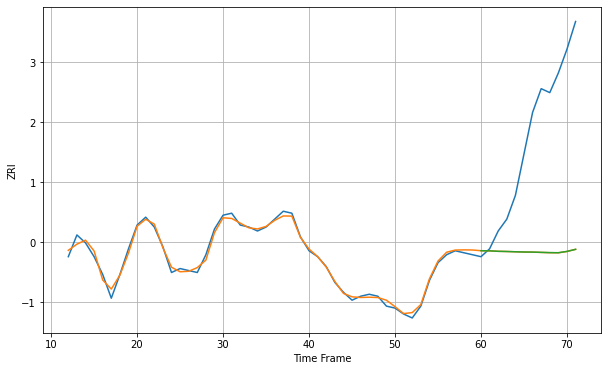

Wall time: 16.6 s
46143 1.8336715578916167 67.16069729728939 67.14448419694862 [880.02506876 879.96343906 879.72449189 879.63331194 879.48789804
 879.36889113 879.3284941  879.18925215 879.06072124 879.01235481
 879.68933473 880.71235206]
60 60 12


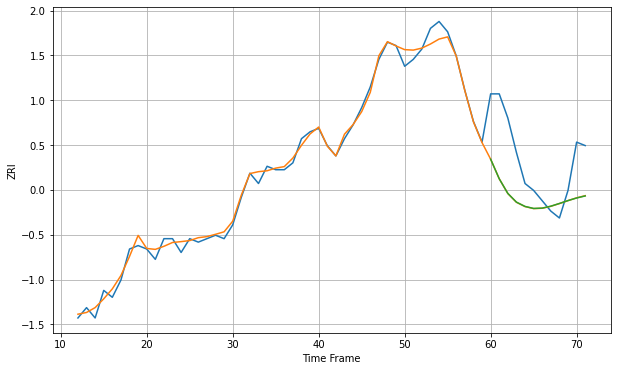

Wall time: 17.1 s
46201 1.9279786496627265 13.63568295434599 13.637505238257482 [659.05901784 653.37142687 649.11840058 646.59894651 645.35481037
 644.76833295 644.86444984 645.42434614 646.21031731 647.04569713
 647.80314609 648.39365003]
60 60 12


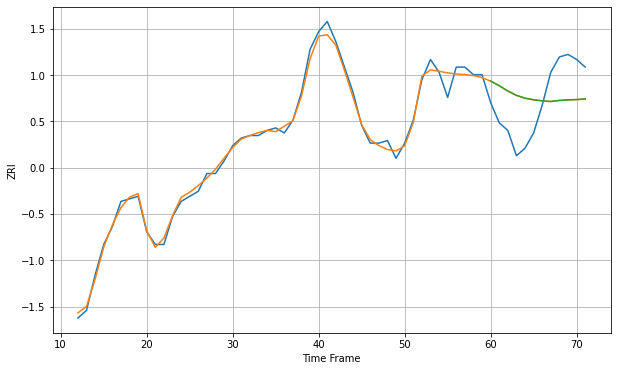

Wall time: 16.6 s
46203 2.3518378423624178 15.33614348327487 15.31937246718568 [774.46176144 772.64041869 770.55358305 768.84346769 767.71442108
 767.09301287 766.68427345 766.41683948 766.85248123 767.05807146
 767.20408556 767.45898615]
60 60 12


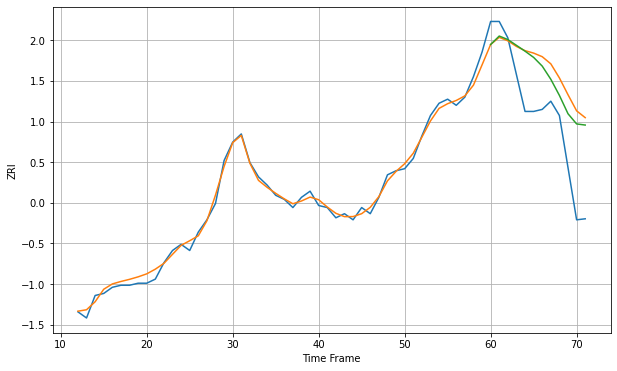

Wall time: 17.4 s
46208 2.5551460689965366 28.82749570810965 25.1769752464608 [862.73743049 866.86536082 865.15194996 862.32806677 859.47396213
 856.42557364 852.17062734 845.72093182 837.83058441 828.86764283
 823.89269459 823.34564041]

Got an mse at 0.0024 in round 377 and stopped training

60 60 12


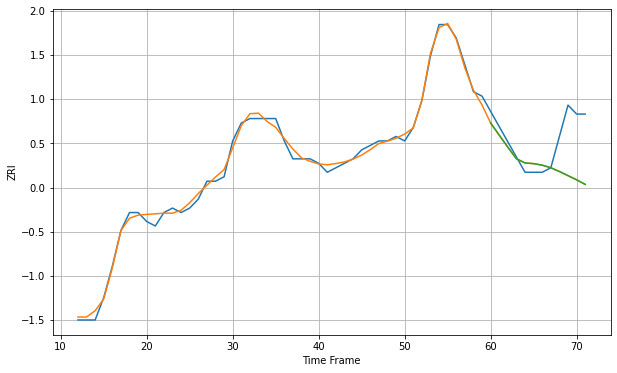

Wall time: 14.2 s
46219 1.0738977244622956 8.137097118025897 8.135913516729879 [657.00320281 654.29482755 651.60866263 649.0223328  648.08734464
 647.92931126 647.58952313 647.01093536 646.17021104 645.24773394
 644.31515067 643.29357214]
60 60 12


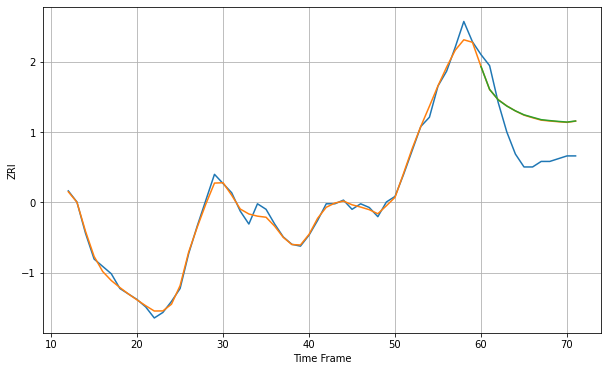

Wall time: 16.8 s
46312 2.6562102244116894 19.4513197613459 19.580456537889834 [899.51540761 887.10815537 881.44556482 878.07777389 875.45492901
 873.31223872 871.974641   870.67986677 870.17139212 869.74253179
 869.3675374  869.96805329]
60 60 12


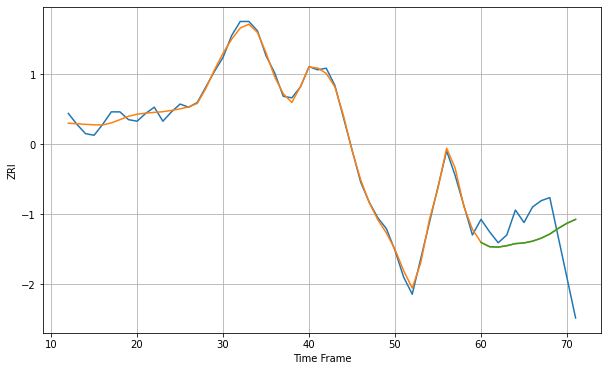

Wall time: 17 s
47374 3.053080457395628 25.610650175294527 25.612407401122184 [656.20885232 653.4729535  653.22720749 654.12561113 655.45569382
 655.92234065 657.04134375 658.95161386 661.59733588 665.30240315
 668.52874614 670.99901262]

Got an mse at 0.0025 in round 281 and stopped training

60 60 12


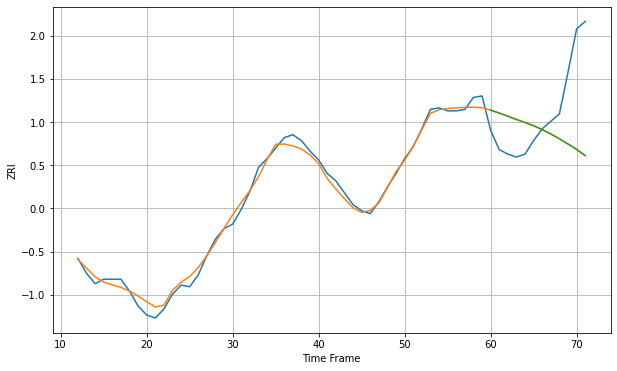

Wall time: 12.2 s
47401 4.00769224487319 40.79140922486677 40.75107817292115 [1327.49329073 1325.51521696 1323.4198052  1321.23937358 1319.15915158
 1317.07085132 1314.47284909 1311.52333914 1308.31675889 1304.79104379
 1301.18379049 1296.96339571]

Got an mse at 0.0024 in round 247 and stopped training

60 60 12


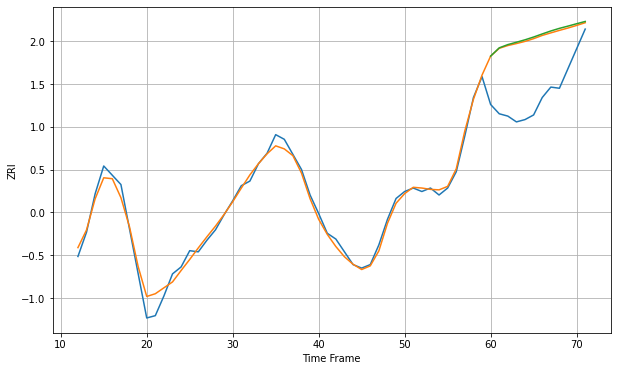

Wall time: 10.9 s
47408 5.915923759689522 51.01794349673651 52.10421356371853 [1435.69993089 1442.83447409 1445.62584733 1447.65692387 1449.76744255
 1452.1607788  1454.81268963 1457.37807556 1459.6308052  1461.57226318
 1463.60686981 1465.56514372]
60 60 12


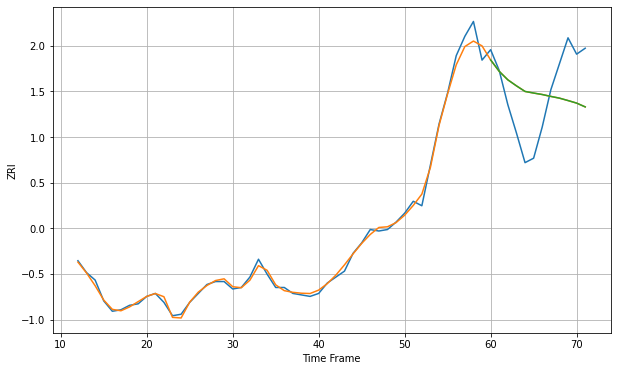

Wall time: 17.2 s
48186 3.425940579781596 30.28244752356607 30.283517486711993 [990.10603446 982.42969    976.72653618 972.6809175  968.91775371
 967.83547545 966.84923177 965.56731903 964.40979345 962.78193389
 961.07201365 958.51183762]
60 60 12


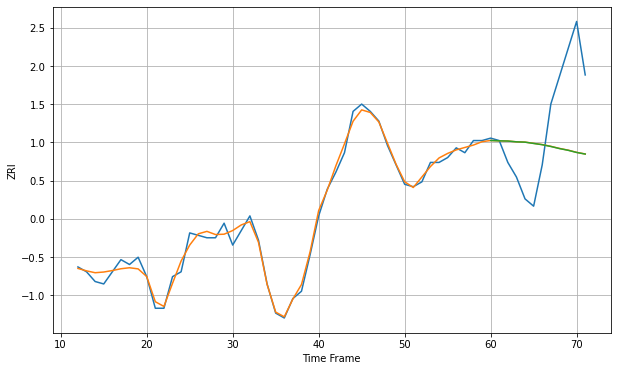

Wall time: 18 s
48195 2.479996984130917 26.513512329599163 26.53669718756908 [859.02689624 858.87962418 858.80397301 858.47413709 858.34183525
 857.80936213 857.29102464 856.56236252 855.70782908 855.0051103
 854.10151698 853.43921722]

Got an mse at 0.0025 in round 253 and stopped training

60 60 12


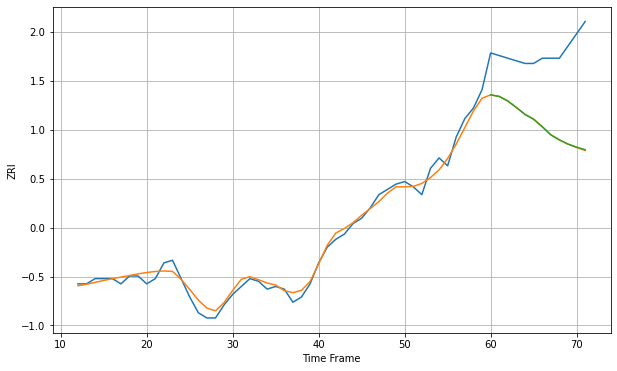

Wall time: 11.5 s
48235 2.3811631487673033 29.023064485318343 28.97111420269846 [742.025548   741.43084818 739.6886616  737.23938919 734.60470338
 732.72683126 729.86187583 726.77220716 724.84985241 723.27325142
 722.10813042 721.11629287]

Got an mse at 0.0024 in round 308 and stopped training

60 60 12


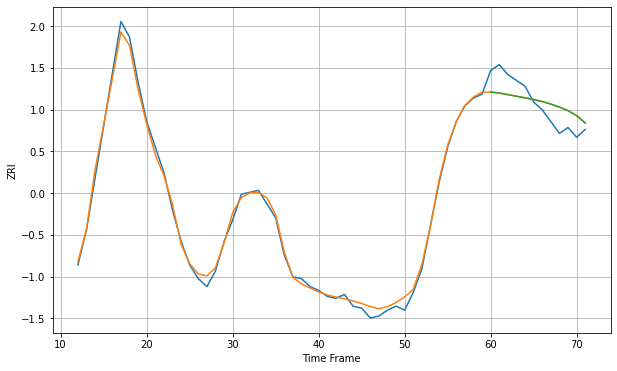

Wall time: 12.7 s
52001 2.591934458153304 9.220658363007786 9.20939932615815 [761.01270251 760.57103761 759.74358566 758.93843372 758.11526184
 757.24578527 756.20192289 754.92380768 753.38688059 751.56594903
 749.02837935 745.31301283]

Got an mse at 0.0025 in round 434 and stopped training

60 60 12


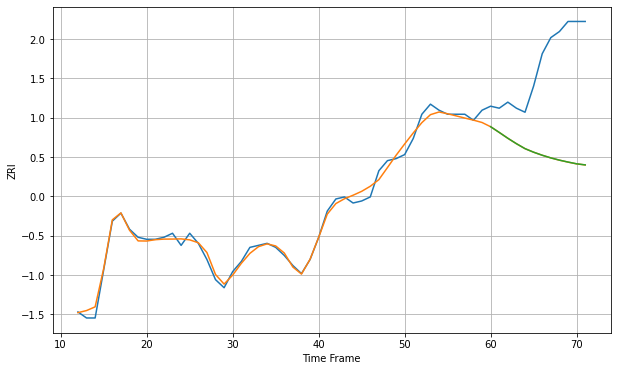

Wall time: 15.6 s
53140 2.68741325347618 47.73826280245074 47.72071323591167 [843.81380146 840.99076934 838.09254926 835.39920659 832.94627086
 831.18464601 829.68152504 828.36244387 827.25126962 826.30255906
 825.43567891 824.89146499]

Got an mse at 0.0025 in round 367 and stopped training

60 60 12


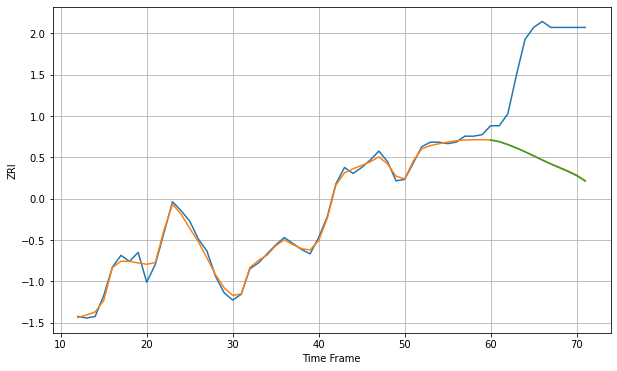

Wall time: 13.7 s
53143 2.9862841737248935 77.23110007466727 77.44811291956697 [862.46176988 861.33408424 859.38938113 857.08539803 854.50989586
 851.76804596 848.96471115 846.29033661 843.79869699 841.30091152
 838.51471274 834.88117429]
60 60 12


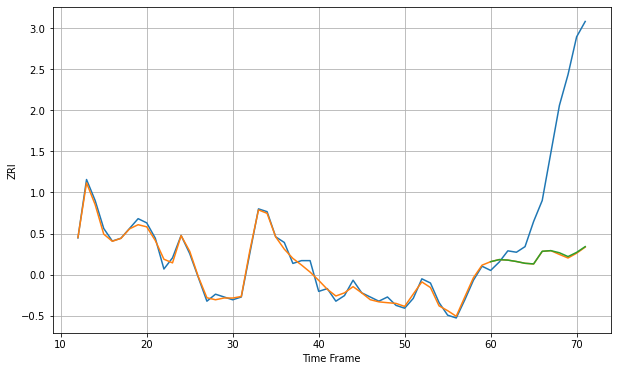

Wall time: 17.4 s
53202 3.041292749163793 84.61362018109298 84.20201321664213 [1127.24930129 1128.7426516  1128.3745253  1127.3750898  1126.08965621
 1125.66264173 1134.68738628 1135.15013326 1133.63218159 1130.90268631
 1133.89649678 1138.02027419]
60 60 12


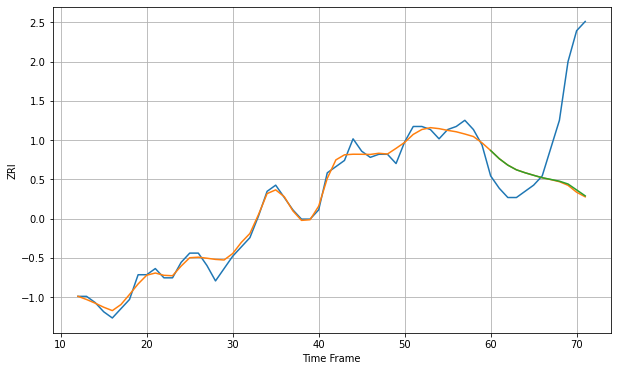

Wall time: 17.3 s
53204 2.1002896603220202 26.54596510748898 26.302310939225723 [706.22247786 703.57525967 701.4818121  699.96795585 699.02200745
 698.19932939 697.41141243 696.8562928  696.28932927 695.37749132
 693.45746643 691.54361545]

Got an mse at 0.0024 in round 391 and stopped training

60 60 12


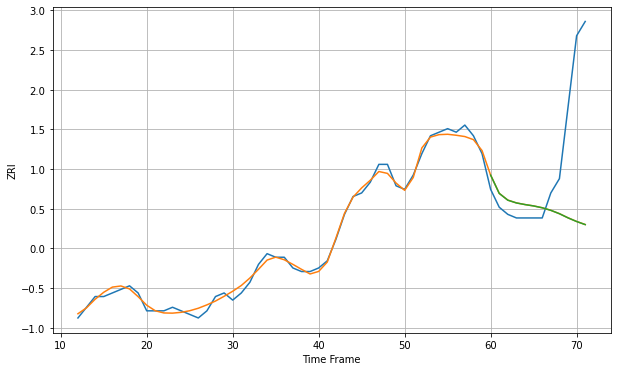

Wall time: 14.4 s
53206 1.3012997556896242 24.34009957380564 24.34881060530833 [705.98902667 700.86621275 698.97138405 698.19994062 697.74149289
 697.36158142 696.84731003 696.13191874 695.18721152 694.02641034
 692.99966803 692.13779269]

Got an mse at 0.0025 in round 126 and stopped training

60 60 12


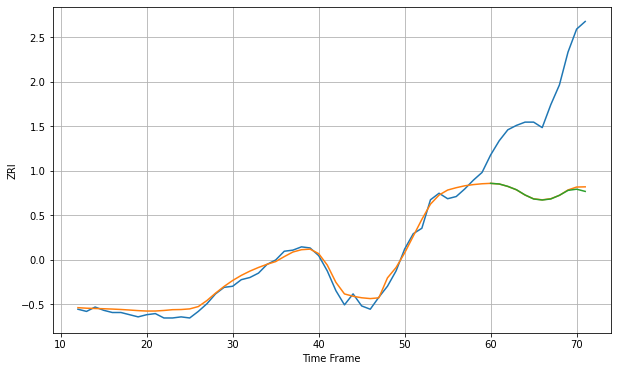

Wall time: 8.12 s
53207 5.126519767304838 90.93984019629865 91.84248491682276 [953.04007432 952.47157305 950.26723713 947.20233595 942.4485575
 938.76182646 937.81254589 938.79081012 942.12207175 946.61088335
 947.71193551 945.67909333]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


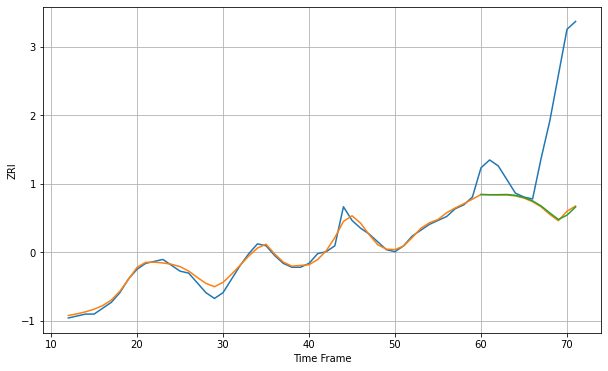

Wall time: 8.94 s
53208 2.251641633268648 47.38760124074931 47.62133464493278 [747.28352475 747.19254652 747.20076693 747.30024837 746.86522186
 745.77985594 744.02358957 741.41120653 737.87060315 734.49098268
 736.70391074 740.90431164]

Got an mse at 0.0025 in round 309 and stopped training

60 60 12


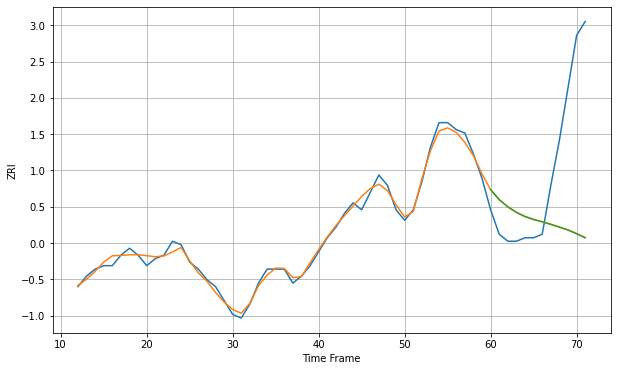

Wall time: 12.4 s
53209 1.4222491394709702 28.660597507391806 28.65920402976391 [704.77764636 701.91997046 699.85702867 698.26738926 697.0775351
 696.23049454 695.56524773 694.84135592 694.04328369 693.2210803
 692.16673584 691.01933184]

Got an mse at 0.0025 in round 211 and stopped training

60 60 12


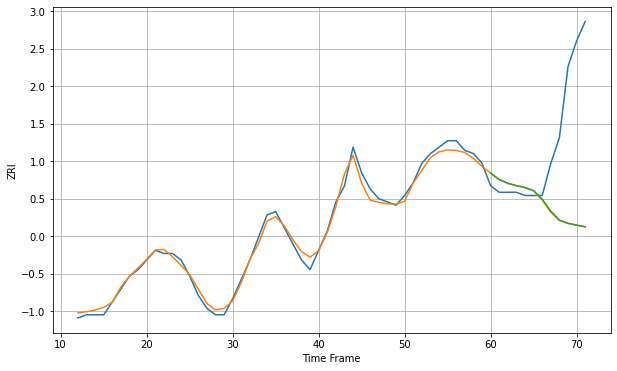

Wall time: 9.94 s
53210 1.723731921484028 29.780829607839834 29.757683522018212 [749.93276686 747.95052285 746.78860407 746.05903193 745.47496245
 744.5274463  741.89627955 738.1483701  735.35116547 734.36972557
 733.80166672 733.29376595]
60 60 12


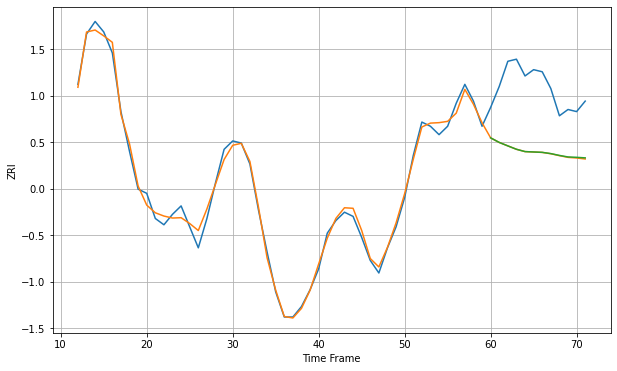

Wall time: 17 s
53211 2.9919212828249844 31.401832439160117 31.310784344601547 [1167.4657689  1165.28772939 1163.63769602 1162.02424271 1160.92267132
 1160.73782794 1160.55962666 1159.96003761 1159.08972201 1158.35750224
 1158.18759954 1157.92110558]

Got an mse at 0.0024 in round 207 and stopped training

60 60 12


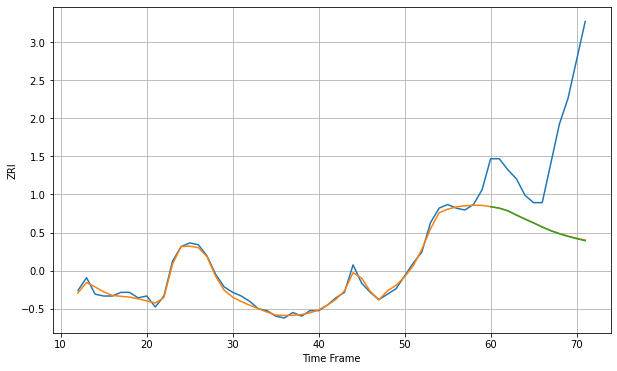

Wall time: 9.98 s
53212 2.2143766872944854 55.6063067508651 55.767360217649134 [839.80444246 839.0068947  837.56727109 835.22181035 833.00701416
 830.91348068 828.65067212 826.63523286 824.97661755 823.55867933
 822.31860587 821.22544411]

Got an mse at 0.0025 in round 321 and stopped training

60 60 12


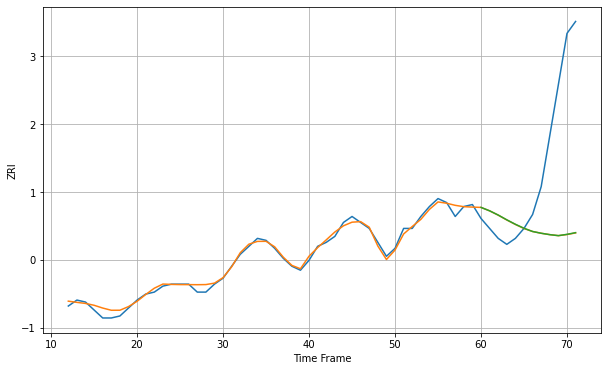

Wall time: 12.5 s
53215 1.9389036752949353 50.68142842037964 50.64320951995161 [758.56531976 756.84759808 754.72052714 752.31735263 750.08320593
 748.07499451 746.46296478 745.56830076 744.87315864 744.37279417
 745.02799007 745.87917892]

Got an mse at 0.0025 in round 337 and stopped training

60 60 12


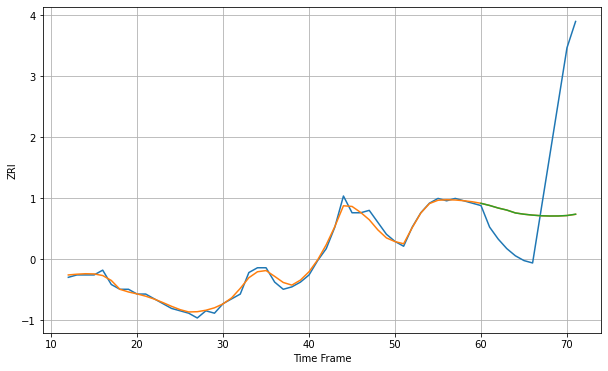

Wall time: 13.1 s
53216 1.53639102026332 36.48935565380596 36.4769300843031 [724.94710702 724.0523155  722.98108131 722.12561642 720.92359069
 720.38951378 720.01436797 719.74821748 719.63993335 719.65876219
 719.84584386 720.3989236 ]

Got an mse at 0.0025 in round 281 and stopped training

60 60 12


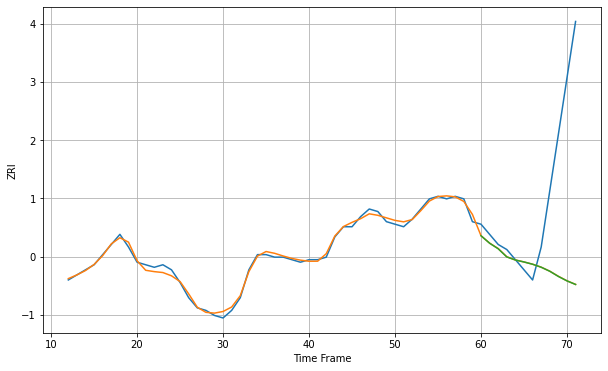

Wall time: 11.6 s
53218 1.2911508502633176 42.31282552843133 42.33488422222519 [720.44982808 717.49895001 715.30093777 712.08640507 710.86771908
 710.09889078 709.20515684 708.02554814 706.43350973 704.38198673
 702.63394523 701.21776343]
60 60 12


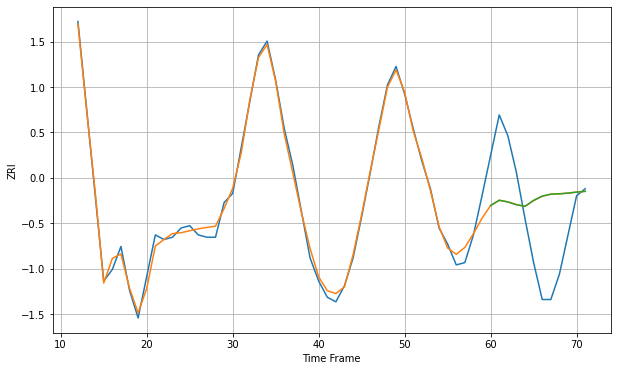

Wall time: 16.9 s
53403 2.9133280782093443 27.743049663084317 27.767228756566315 [830.75680218 833.00706572 832.29194794 831.09441239 830.37226528
 832.9847419  834.81092521 835.6678457  835.80690836 836.10205558
 836.53608317 836.86292482]

Got an mse at 0.0025 in round 94 and stopped training

60 60 12


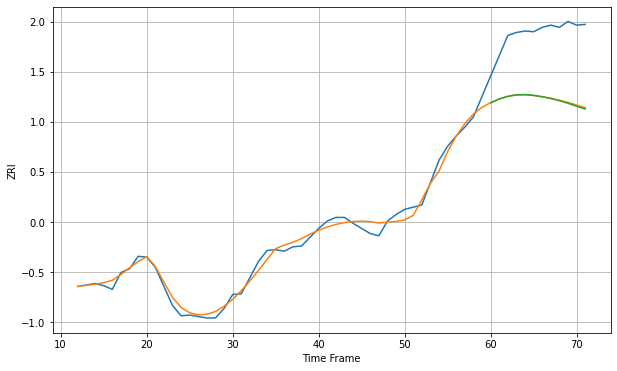

Wall time: 7.34 s
53590 8.086930963467395 91.17874923010396 91.635603612802 [1108.29695685 1113.40228033 1117.08252729 1119.064969   1119.38412758
 1118.33351184 1116.44490915 1114.03722511 1111.05578653 1107.4964134
 1103.49553133 1099.67276861]
60 60 12


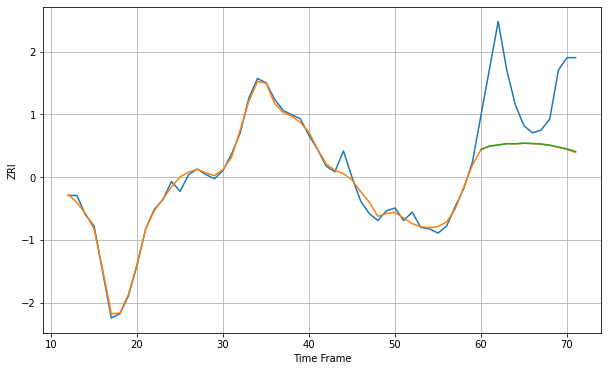

Wall time: 16.6 s
53703 3.9417919556327763 48.2249463512939 48.04789679376842 [1305.090661   1307.49294138 1308.32002661 1309.17307592 1309.14330092
 1309.54641283 1309.32651363 1308.97766516 1308.14888943 1306.83296536
 1305.4215701  1303.6461585 ]

Got an mse at 0.0025 in round 310 and stopped training

60 60 12


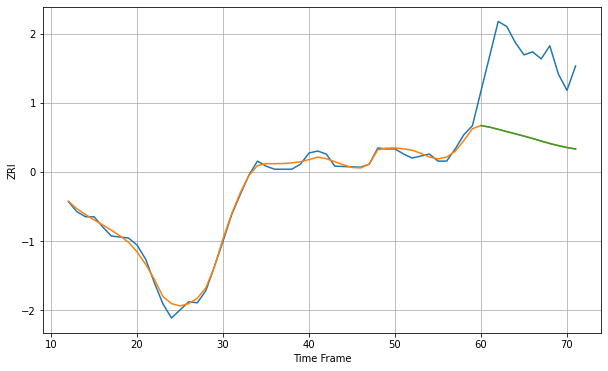

Wall time: 12.5 s
53704 4.3363934626461615 82.13347103906062 82.14389294439154 [1098.18265403 1096.58081421 1094.42682925 1092.15592112 1089.925569
 1087.69725377 1085.32530017 1082.78053489 1080.38913726 1078.29362837
 1076.47454712 1074.99491335]
60 60 12


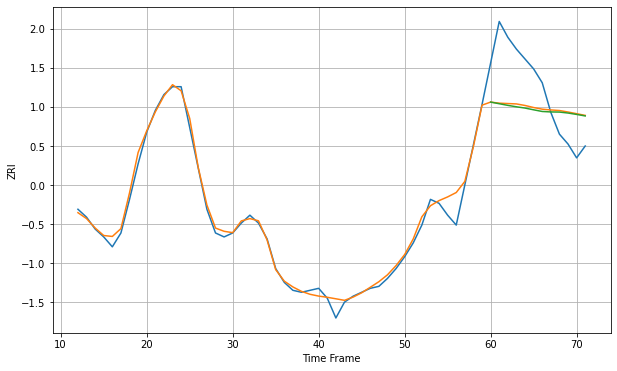

Wall time: 16.7 s
54220 3.7048325002803417 22.821219772765136 23.274361487510273 [669.21690432 668.3845649  667.55091047 666.83123654 666.19050899
 665.30862805 664.46609253 664.23059596 664.16537405 663.6776385
 662.97644647 662.2062324 ]
60 60 12


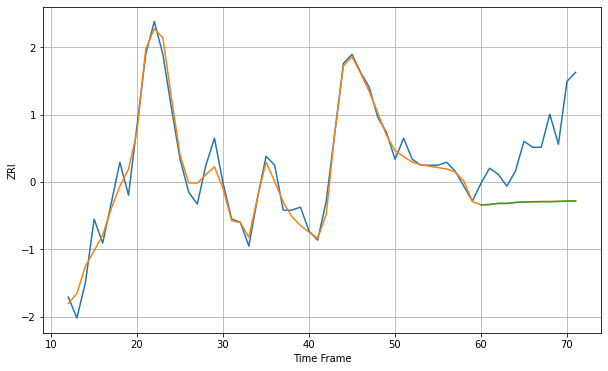

Wall time: 16.7 s
54601 3.9625753304036047 22.663869592592498 22.65036862308835 [825.75113573 825.88757733 826.25471564 826.24149047 826.57092958
 826.73068392 826.80447415 826.85013965 826.84948623 826.93373708
 827.03655326 827.12080476]
60 60 12


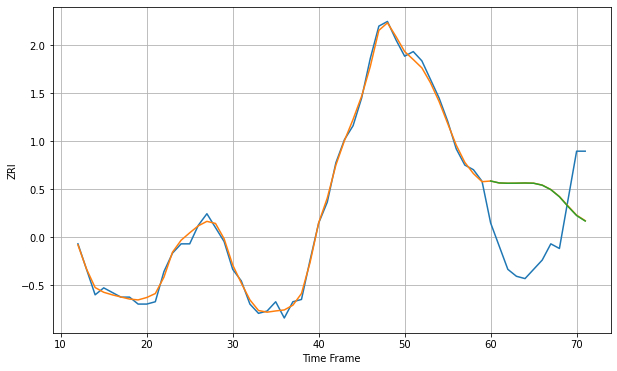

Wall time: 16.3 s
54901 2.0427754832009946 30.175861112403787 30.18510144486193 [729.13155835 728.2894242  728.15898085 728.19123192 728.26047378
 728.1642154  727.32561254 725.4028184  722.33155132 718.12878905
 714.22125774 711.84623021]

Got an mse at 0.0025 in round 223 and stopped training

60 60 12


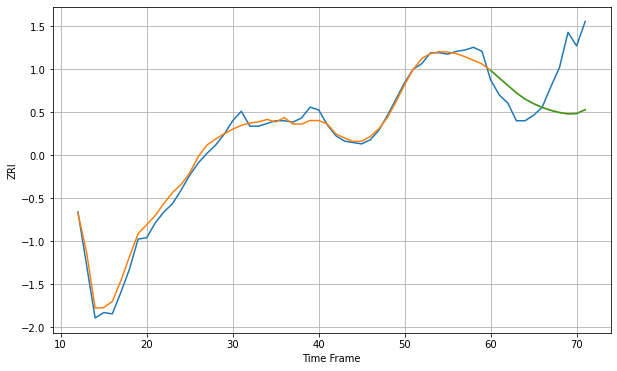

Wall time: 10.3 s
55101 5.291994278012832 32.57937183147983 32.6546410549299 [1323.08182767 1317.42774578 1311.98943504 1306.48583421 1301.91577055
 1298.53825193 1295.77914719 1293.6148132  1291.96318657 1290.94840251
 1291.26073509 1294.17111644]

Got an mse at 0.0025 in round 393 and stopped training

60 60 12


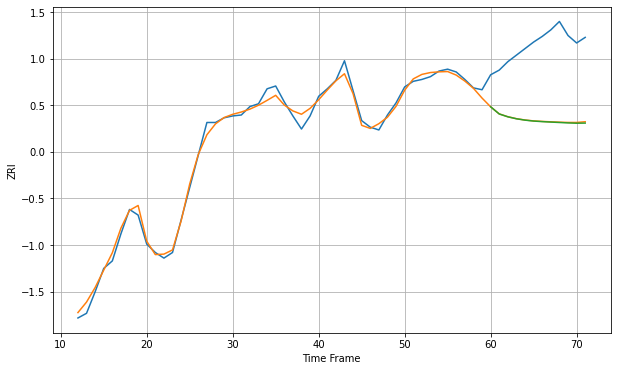

Wall time: 14.6 s
55104 6.053215230119215 80.56280144747099 80.94654096404932 [1283.76679502 1276.11049257 1273.07430258 1270.95906074 1269.50567751
 1268.51423051 1267.92655286 1267.44273428 1266.99026083 1266.53786295
 1266.21422724 1266.35854202]

Got an mse at 0.0025 in round 196 and stopped training

60 60 12


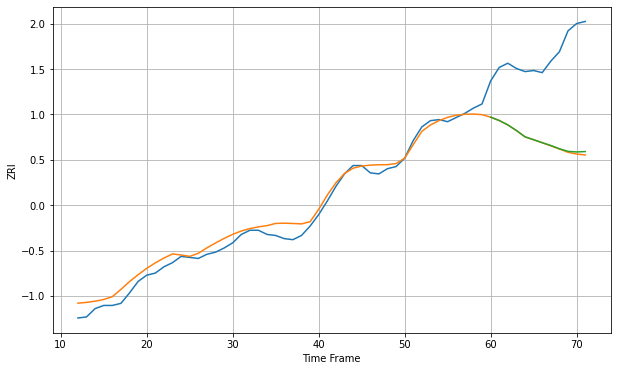

Wall time: 9.48 s
55106 7.542494756676731 83.86857641235498 83.03180594344371 [1078.33521772 1075.12739713 1070.91602133 1065.56464636 1059.53253246
 1056.7604312  1053.90600197 1051.21272254 1048.08696693 1045.6096608
 1045.01764888 1045.38961361]

Got an mse at 0.0025 in round 387 and stopped training

60 60 12


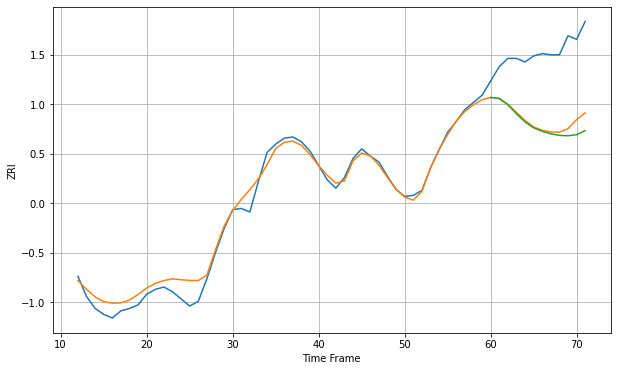

Wall time: 13.9 s
55306 7.233924791310647 57.35855739740909 61.81691085373199 [1298.17395511 1297.32044431 1292.03847916 1284.54169668 1277.56883336
 1272.64055865 1269.77751119 1267.65424196 1266.36068934 1266.01713024
 1266.91771536 1270.38687382]

Got an mse at 0.0025 in round 261 and stopped training

60 60 12


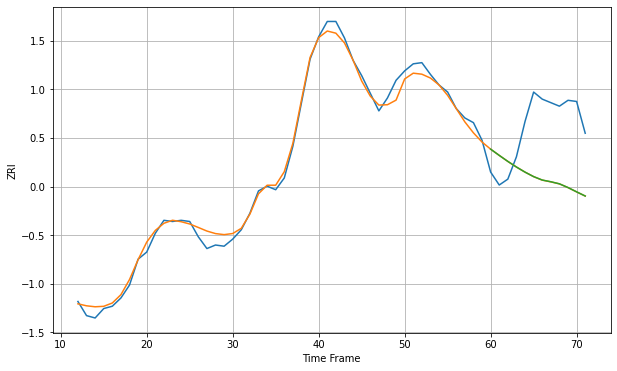

Wall time: 11.1 s
55401 5.9949042612228665 54.94361769530365 54.90670527265319 [1648.47452972 1643.17887089 1638.05998929 1633.28246199 1628.95415196
 1625.14379839 1622.23073908 1620.78614289 1619.01052473 1615.84876194
 1612.19736811 1608.65124164]

Got an mse at 0.0024 in round 335 and stopped training

60 60 12


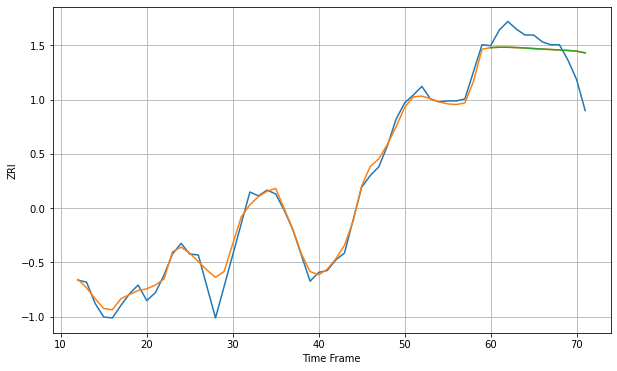

Wall time: 12.6 s
55403 9.056023802392335 23.04717040813587 23.042497537699948 [1337.98015022 1338.43203459 1338.38520626 1338.07330518 1337.65060866
 1337.06326592 1336.53672255 1336.06532492 1335.59275992 1335.04393854
 1334.38591355 1332.54879422]

Got an mse at 0.0025 in round 316 and stopped training

60 60 12


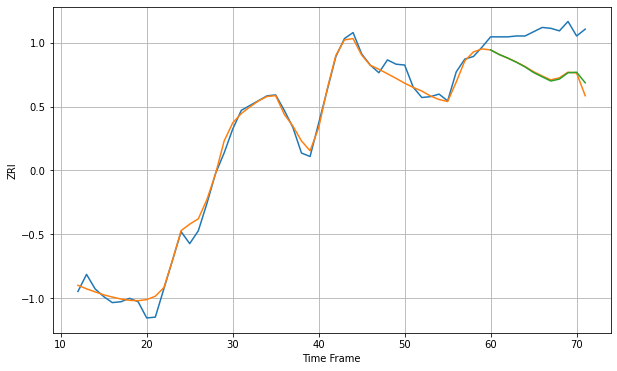

Wall time: 12.5 s
55404 9.265657134191427 47.46231441467351 46.08775052828236 [1345.65280543 1340.34270794 1336.07731421 1331.2847924  1325.82698039
 1319.20204613 1314.21648232 1309.30984878 1311.58235005 1318.93084345
 1319.60038566 1307.26706497]

Got an mse at 0.0025 in round 246 and stopped training

60 60 12


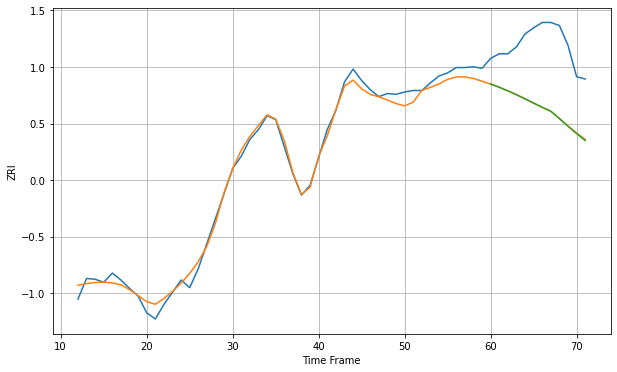

Wall time: 10.3 s
55407 9.35013080321242 86.44954948902553 86.63965101268286 [1349.41870944 1345.20057984 1340.52552188 1335.47947403 1330.10746787
 1324.49417562 1319.00429962 1313.80668688 1304.27248904 1294.15397973
 1284.60126757 1275.46890807]
60 60 12


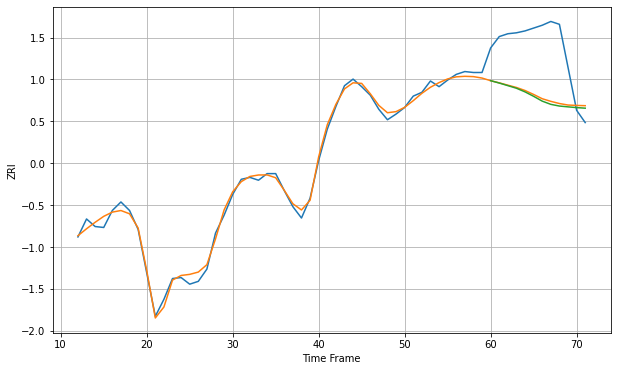

Wall time: 16.6 s
55408 5.069146129355097 58.430835536641226 59.90566089274538 [1511.33343601 1508.84872591 1506.10657555 1503.33846575 1499.48643961
 1494.79906513 1489.70013431 1486.2916454  1484.49627886 1483.63321871
 1482.86384087 1482.246486  ]
60 60 12


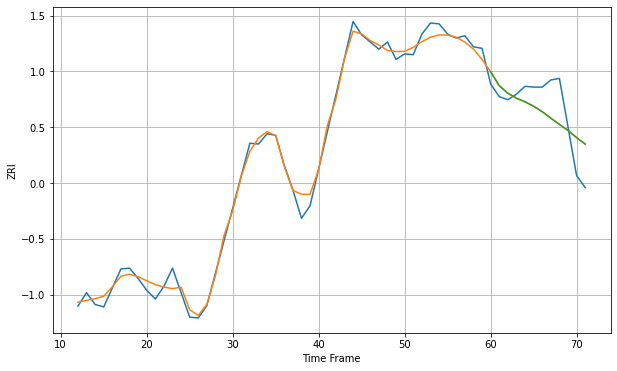

Wall time: 16.6 s
55411 9.826184298715907 33.54514971753514 33.57621936330615 [1557.39492134 1539.76649396 1530.29717254 1524.00203889 1519.40648743
 1513.80840731 1506.88017084 1498.71917963 1490.80396936 1483.21860048
 1474.09360748 1465.96620522]

Got an mse at 0.0024 in round 177 and stopped training

60 60 12


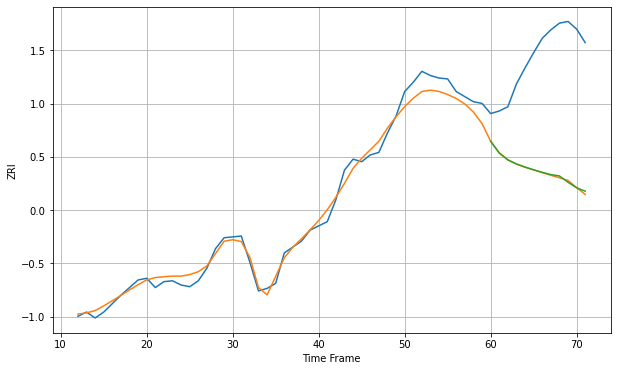

Wall time: 9.14 s
55413 10.238900707979692 141.68458933848004 141.1468640641487 [1476.27053161 1462.35934676 1454.18669607 1449.33612259 1445.60805834
 1442.42931491 1439.40696533 1436.7524143  1435.12069007 1427.72503341
 1421.10890878 1417.09680329]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


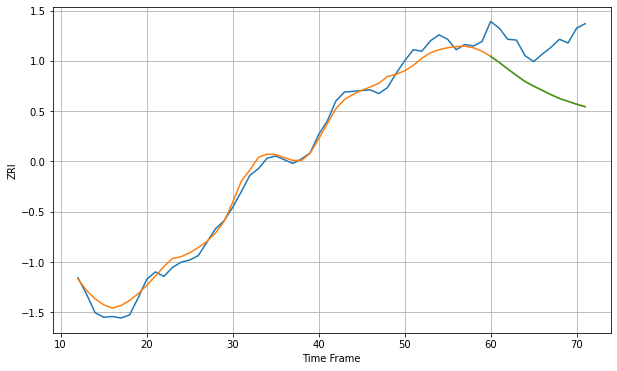

Wall time: 9.22 s
55414 10.401913093686504 65.93894364542784 66.09325898263212 [1552.06795101 1543.87288421 1534.99050783 1526.40500179 1518.2488066
 1511.98790403 1506.26730172 1500.60310388 1495.39740019 1491.48094721
 1487.55676147 1484.03779061]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


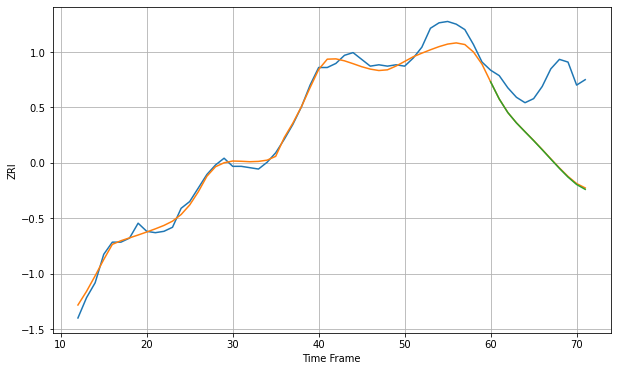

Wall time: 9.06 s
55416 6.195821146592015 53.46182206676098 53.824440003549554 [1516.39013583 1503.73899024 1493.71887416 1486.08697516 1479.50366697
 1473.00328687 1466.24958675 1459.32977918 1452.48766214 1446.06122554
 1440.58317662 1437.00247005]

Got an mse at 0.0025 in round 205 and stopped training

60 60 12


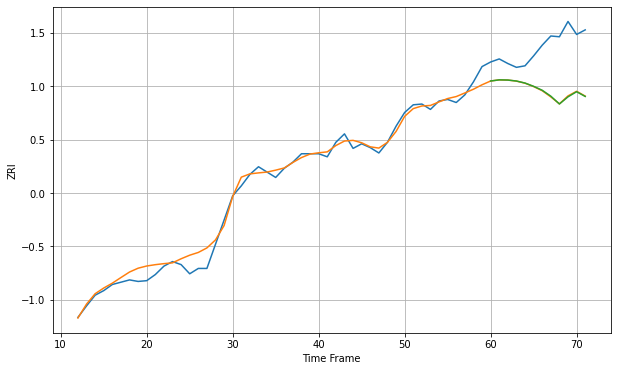

Wall time: 9.88 s
55418 9.555995023977246 60.815552970172 60.933802373439335 [1318.13209067 1319.63743582 1319.39173601 1318.10645157 1315.45139276
 1311.16755589 1306.0120054  1298.2986431  1288.06935414 1297.43611609
 1304.13442883 1297.93175975]
60 60 12


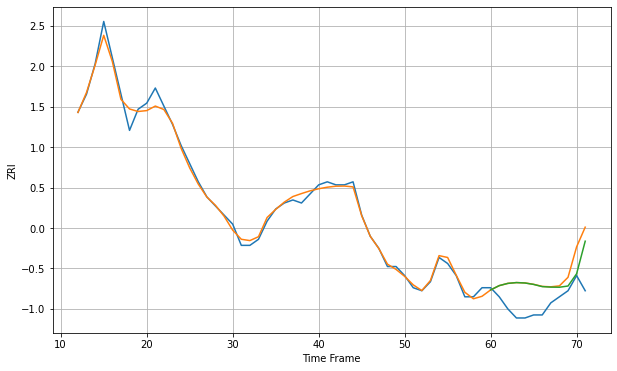

Wall time: 16.8 s
58103 1.9020391408526025 9.750061712839099 8.433817476249008 [714.27139798 715.69187305 716.43134611 716.69625285 716.56259151
 716.0903     715.36960588 715.20172535 715.15828812 715.56425416
 719.61144831 730.38138973]
60 60 12


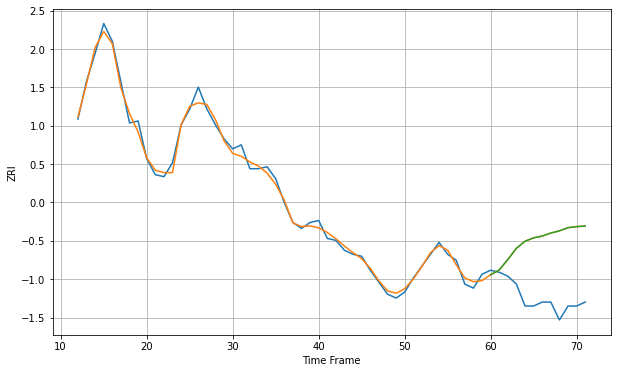

Wall time: 17.1 s
58104 2.7489210128061563 31.02115242746473 31.02298060906589 [777.70640679 780.12114631 785.38833335 791.04805543 794.57030063
 796.26281613 797.18834031 798.67540162 799.78341452 801.36203118
 801.93001316 802.19091257]

Got an mse at 0.0025 in round 439 and stopped training

60 60 12


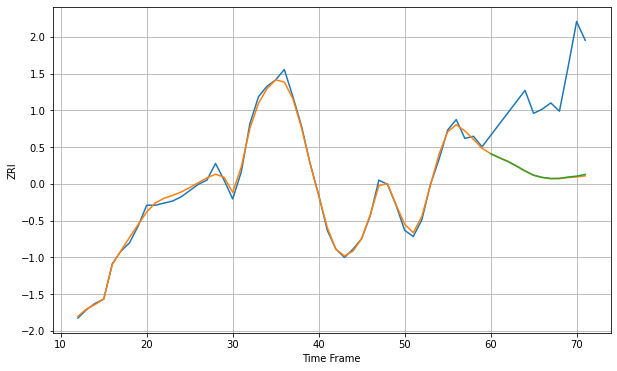

Wall time: 16.1 s
59601 2.008802025402976 41.00046136497243 40.79366537831634 [836.6916604  834.7726801  832.99272875 830.77754659 828.42310952
 826.38132592 825.32659425 824.79755434 824.86958527 825.48088897
 825.94074919 826.74144156]

Got an mse at 0.0024 in round 127 and stopped training

60 60 12


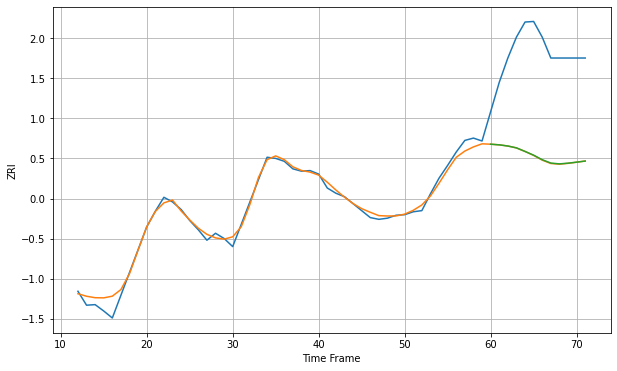

Wall time: 8.51 s
59718 9.485384270056553 179.2064108058746 178.93427139811106 [1458.46902975 1457.37444386 1455.34892232 1452.14251367 1446.04094105
 1439.56681006 1431.77447026 1425.95921123 1424.57463628 1425.7810523
 1427.5460082  1429.41318111]

Got an mse at 0.0025 in round 383 and stopped training

60 60 12


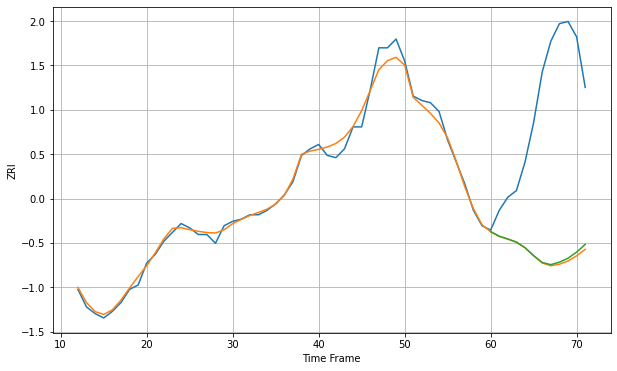

Wall time: 14.6 s
59801 3.155031197503825 72.765640054433 72.02916238217226 [822.290282   820.20622035 818.94188789 817.54140996 814.98560672
 811.38630368 808.24553676 807.28234388 808.39578376 810.18930367
 812.97599133 816.51854119]

Got an mse at 0.0025 in round 246 and stopped training

60 60 12


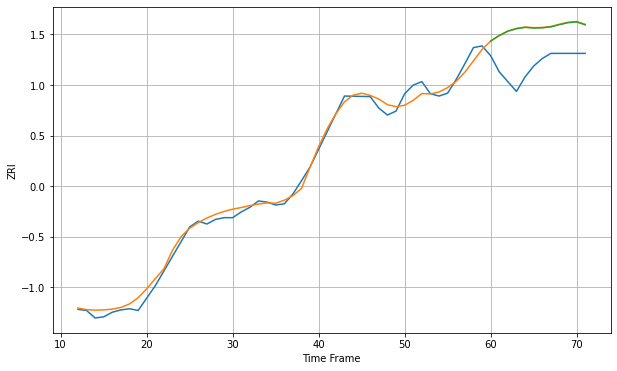

Wall time: 10.6 s
59901 10.88643594276683 66.04977174948337 65.56118456181744 [1209.41551408 1218.89007233 1226.46283623 1230.83893967 1233.13902767
 1232.00313519 1232.36512816 1233.98606484 1237.84680803 1241.24147127
 1242.54229737 1237.49073902]
60 60 12


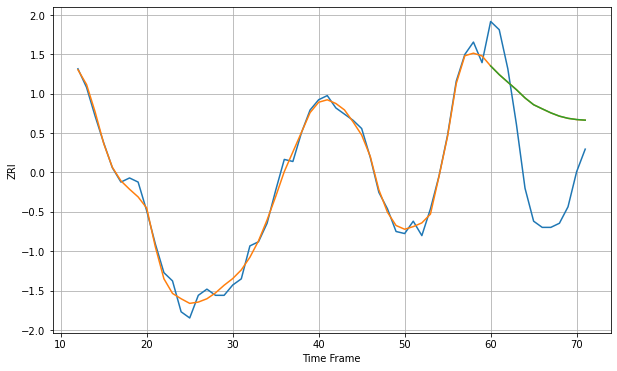

Wall time: 16.9 s
60085 3.3915640603495842 38.92725808197601 38.94082965005435 [1185.39729665 1181.18967104 1177.50613932 1173.87187118 1169.8743622
 1166.57057763 1164.57181359 1162.62166038 1161.02029289 1159.96639294
 1159.37024922 1159.07540355]
60 60 12


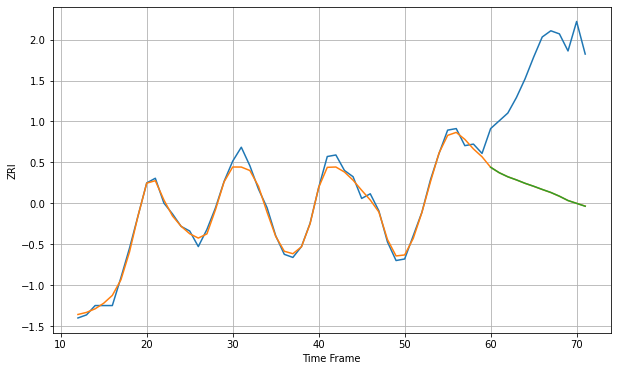

Wall time: 16.4 s
60201 3.395595159072207 82.52462373896716 82.5201383429099 [1528.07742022 1524.56762624 1521.95319198 1519.94958264 1517.75923102
 1515.85494944 1513.80308743 1511.85460401 1509.44341164 1506.65276084
 1504.82317874 1502.97838369]
60 60 12


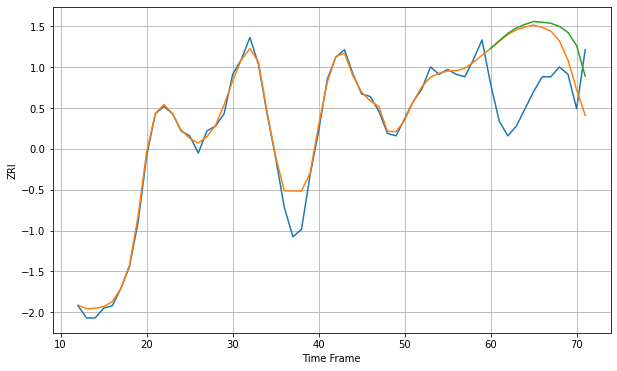

Wall time: 16.6 s
60202 4.1779828311305245 25.809435646175377 27.217014631454344 [1596.54737684 1599.6233072  1602.62393139 1604.89985425 1606.30591564
 1607.48703385 1607.15602858 1606.77770709 1605.48756114 1603.02619206
 1597.66330692 1585.2839857 ]
60 60 12


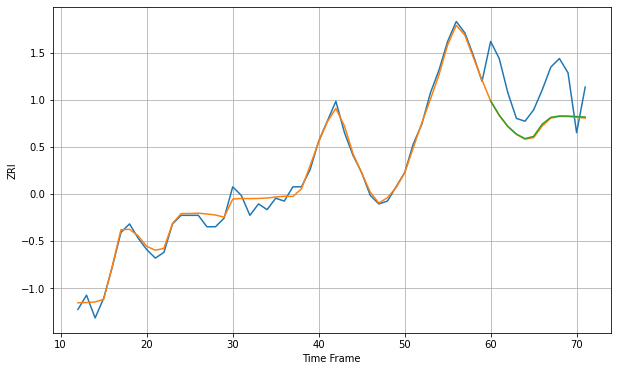

Wall time: 16.5 s
60402 2.137310315228279 14.190357123180277 14.020564984895111 [1286.12480462 1281.11949341 1277.20789188 1274.49197926 1272.89635501
 1273.69763217 1278.00365209 1280.35606167 1280.84339897 1280.80980374
 1280.64895033 1280.48506966]

Got an mse at 0.0025 in round 108 and stopped training

60 60 12


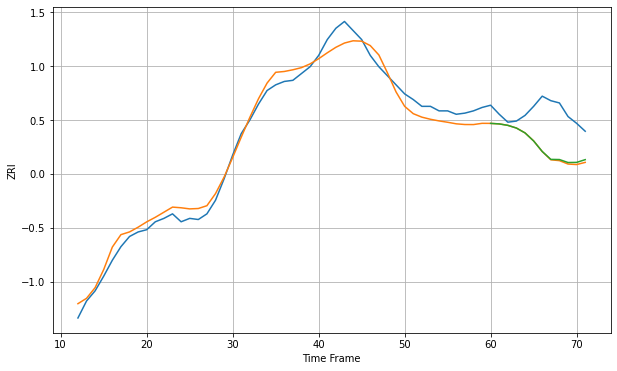

Wall time: 7.33 s
60540 8.817521296922765 33.060095171122505 32.40549107710007 [1627.93946163 1627.48120125 1626.1959699  1623.81517433 1619.5218555
 1612.41930005 1603.1350096  1596.143447   1595.99729535 1593.36347181
 1593.48450442 1595.89609847]

Got an mse at 0.0025 in round 376 and stopped training

60 60 12


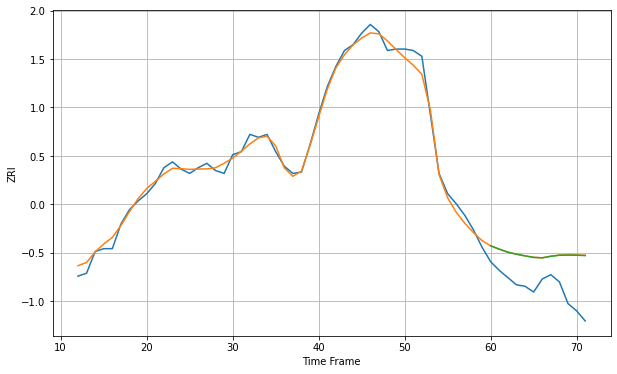

Wall time: 13.8 s
60563 4.321347652518419 25.038632949577607 24.95096384880031 [1373.98636657 1371.64469732 1369.56319127 1368.15810321 1367.00897533
 1365.95633025 1365.62686255 1366.70994312 1367.43559424 1367.55230069
 1367.46067641 1367.20715124]
60 60 12


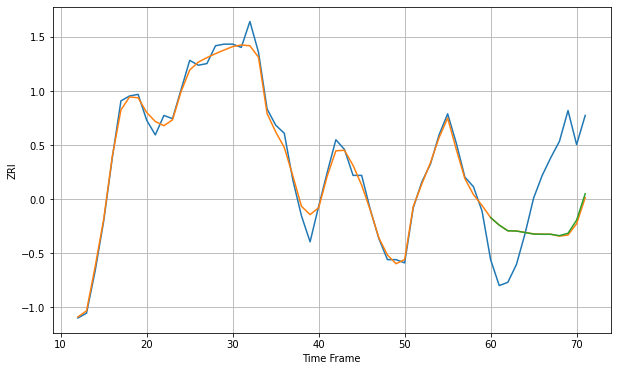

Wall time: 16.3 s
60601 4.886333928027419 42.65087528170375 42.02312111487083 [2083.96199832 2079.32294734 2075.80154921 2075.65081064 2074.72925586
 2073.79426572 2073.64927296 2073.65193896 2072.79417794 2074.26426913
 2082.40764314 2098.67833641]
60 60 12


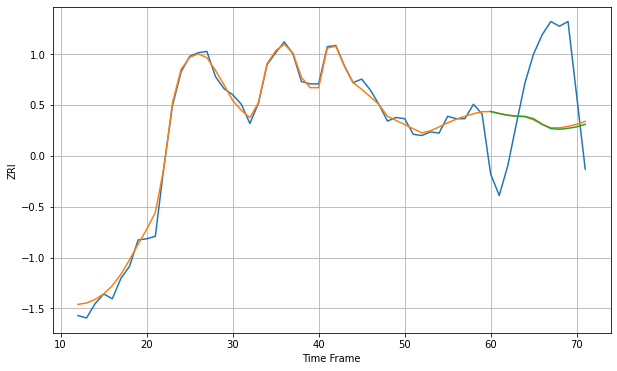

Wall time: 16.9 s
60605 5.358028528476203 60.14248908335069 60.39323104529437 [2040.00003434 2038.29594828 2036.85326709 2036.15060624 2035.92463886
 2033.91330807 2029.41163218 2025.78901161 2025.17521894 2025.98034072
 2027.19961283 2029.31645574]
60 60 12


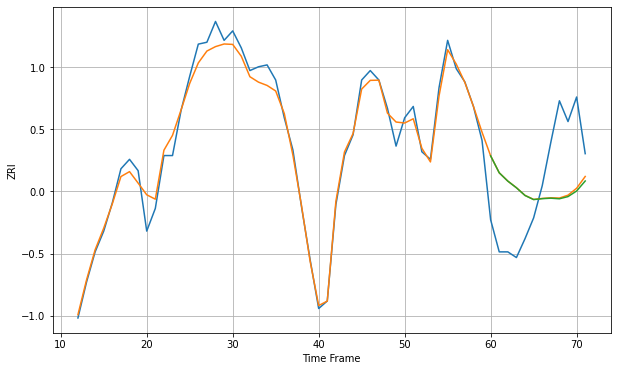

Wall time: 17.2 s
60606 5.78999208195282 33.974014570145506 34.35118951722359 [2198.83643812 2189.86629572 2185.4553536  2181.93938608 2177.85786834
 2175.69139478 2176.17789096 2176.42903914 2176.11168058 2177.27445189
 2180.22283317 2185.53396192]

Got an mse at 0.0025 in round 193 and stopped training

60 60 12


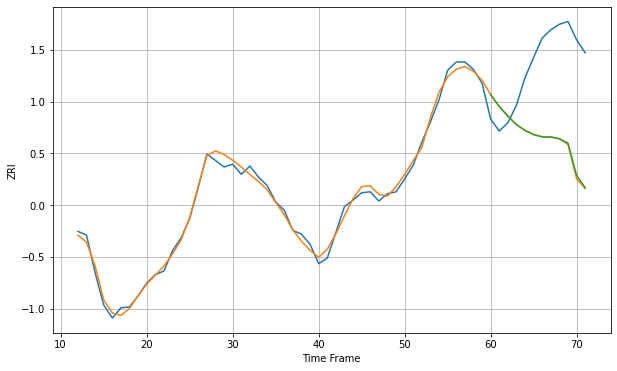

Wall time: 9.51 s
60607 5.918670721984172 97.93157439221508 97.2198790664356 [2000.48037245 1987.69583357 1977.32666663 1967.97978174 1961.65313793
 1957.11867221 1954.6564324  1954.46098428 1952.53577911 1947.89119844
 1912.83529383 1899.43670497]
60 60 12


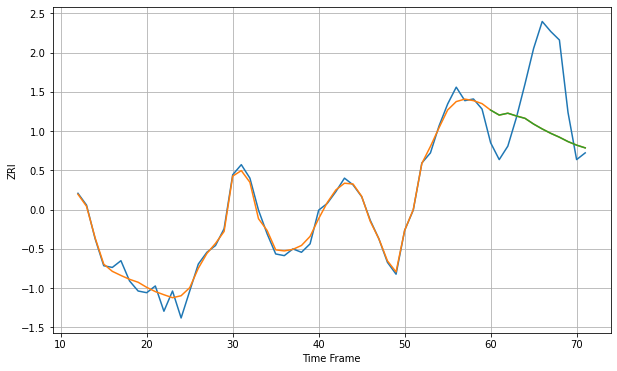

Wall time: 16.4 s
60608 3.7799115331107482 35.73699281728423 35.73767560240511 [1527.37379506 1524.43596293 1525.54358819 1523.89372873 1522.50027867
 1519.09644313 1516.19949017 1513.5826793  1511.29640413 1508.69122219
 1506.5962993  1504.949917  ]
60 60 12


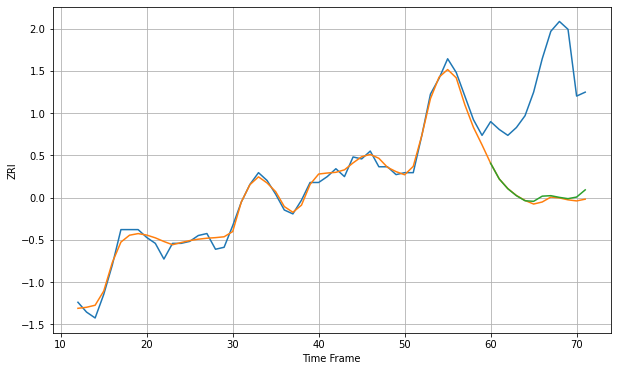

Wall time: 16.5 s
60609 3.1949424803762034 59.16708291003837 58.08231325649339 [1271.77472765 1263.7964616  1258.81654648 1255.27161177 1252.6976046
 1252.40789597 1255.03686057 1255.28203184 1254.41616081 1253.76128718
 1254.57870276 1258.23774986]
60 60 12


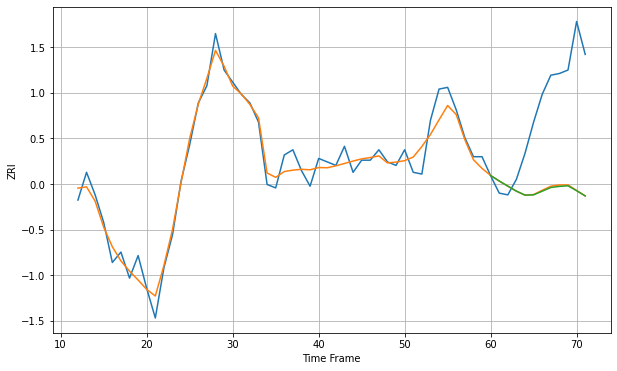

Wall time: 16.3 s
60610 6.90971205332904 53.46417311973741 53.753568488296416 [1919.16867507 1915.98466115 1913.03554382 1910.14467973 1907.86021092
 1907.99947446 1910.11008274 1912.24915073 1912.88523403 1913.21789335
 1910.40508872 1907.36355393]
60 60 12


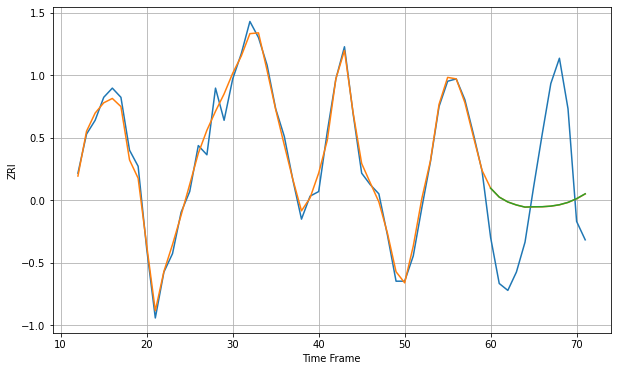

Wall time: 16.8 s
60611 3.9304112242016216 34.85606184474759 34.846115851449014 [2160.46378291 2156.58297713 2154.46783809 2153.16145818 2152.23784074
 2152.375019   2152.41097034 2152.66874031 2153.26222445 2154.29529374
 2155.92270048 2158.02929981]

Got an mse at 0.0024 in round 386 and stopped training

60 60 12


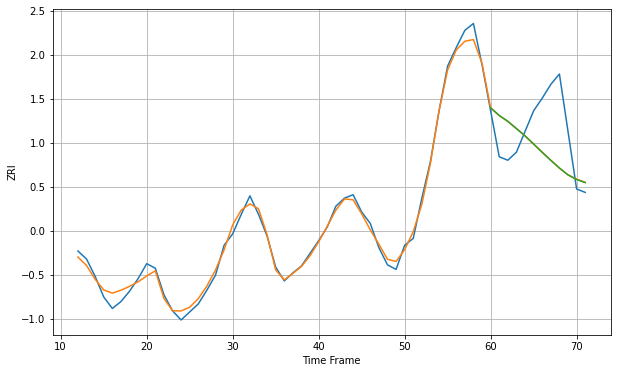

Wall time: 13.8 s
60612 5.342203654050174 39.3210539164629 39.335464876297365 [1657.63784755 1650.89725934 1645.83187158 1639.55517251 1633.19400909
 1626.06477187 1618.89723475 1611.89260175 1605.16881601 1599.20830476
 1595.20293659 1592.4987519 ]

Got an mse at 0.0025 in round 235 and stopped training

60 60 12


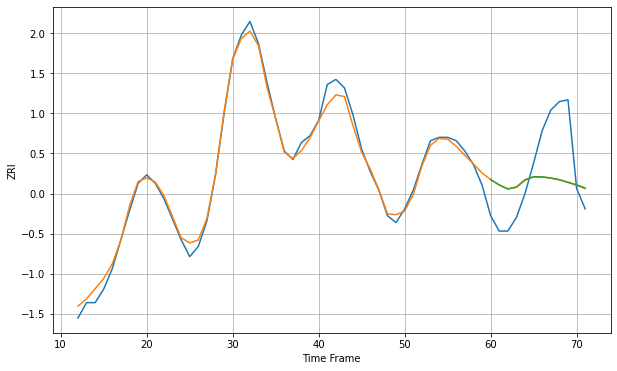

Wall time: 10.5 s
60613 3.9241837181099504 27.683169193366613 27.630680544500315 [1709.22398264 1706.05323261 1703.68779775 1704.90730311 1709.09480413
 1710.92345375 1710.7957087  1710.17495828 1709.15042855 1707.66505096
 1706.12954699 1704.21110378]
60 60 12


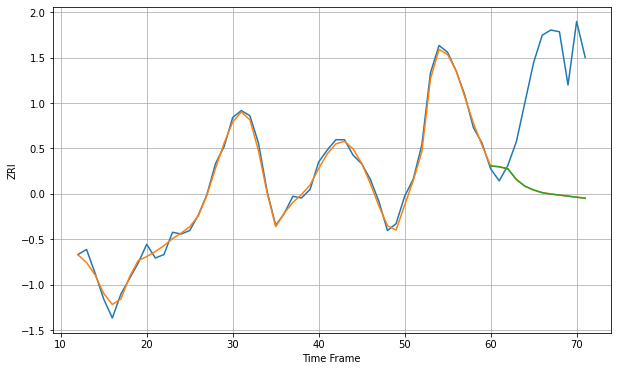

Wall time: 16.8 s
60614 3.128998993120804 68.69082689029104 68.71846212654472 [1873.73629582 1873.17372057 1872.02345268 1865.75750986 1861.85228808
 1859.68230626 1858.1150241  1857.30366477 1856.70328621 1856.0842613
 1855.42314597 1854.89346817]

Got an mse at 0.0025 in round 388 and stopped training

60 60 12


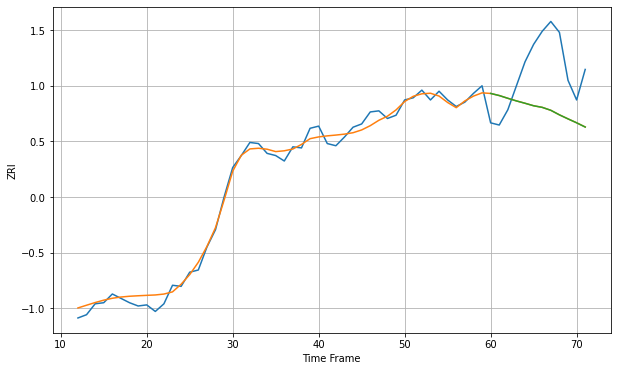

Wall time: 14.3 s
60615 6.093522215839965 48.38354756320917 48.39325016630268 [1530.97209968 1529.05347056 1526.51642853 1524.11306127 1521.96270436
 1519.67354028 1518.2032151  1515.50593764 1511.34179316 1507.63347614
 1504.04708426 1500.14459426]
60 60 12


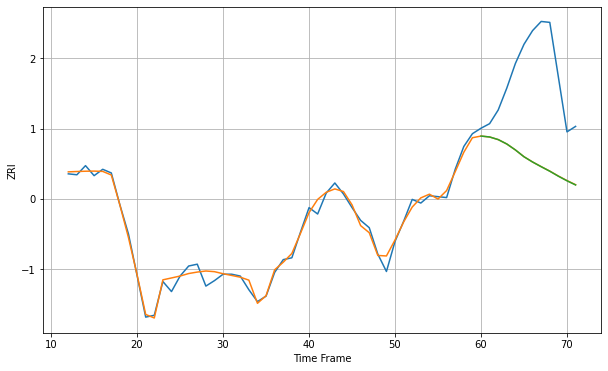

Wall time: 16.8 s
60616 6.393917619725855 100.24492281253973 100.31030298230152 [1654.40992926 1653.41473309 1650.5491526  1645.72939256 1639.20554668
 1631.72770678 1625.96075956 1620.83595725 1615.87991445 1610.41958864
 1605.396302   1600.82483325]
60 60 12


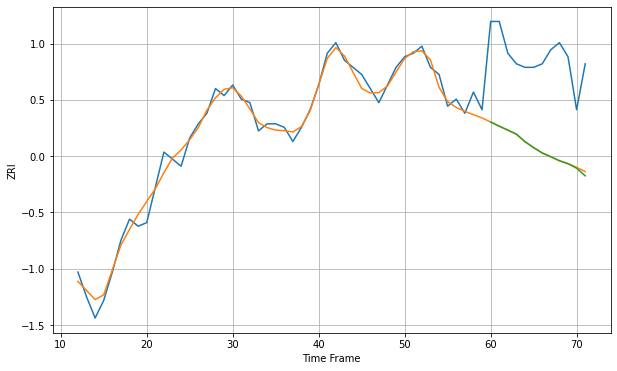

Wall time: 17.7 s
60617 2.4821265362873204 26.330835194525445 26.455257203129605 [1136.51878795 1135.33867901 1134.21663285 1133.0669403  1130.93942294
 1129.27143873 1127.75862352 1126.68921406 1125.54530068 1124.6901099
 1123.4252966  1121.26486369]

Got an mse at 0.0025 in round 333 and stopped training

60 60 12


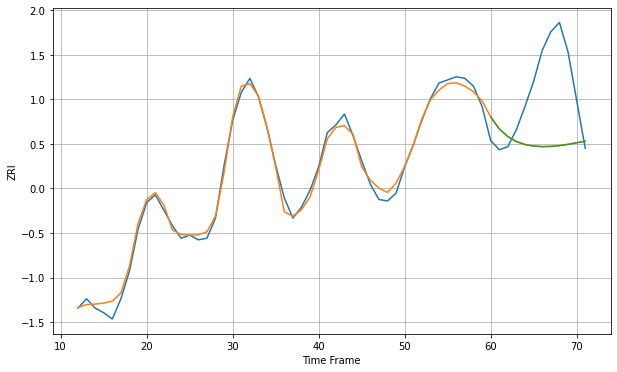

Wall time: 13.3 s
60618 3.983449968685975 43.53445788972959 43.550026019236626 [1630.21145555 1622.44815101 1617.49748    1614.26750025 1612.38250561
 1611.3884754  1611.03661185 1611.16008605 1611.66594346 1612.46043209
 1613.48792597 1614.46161247]
60 60 12


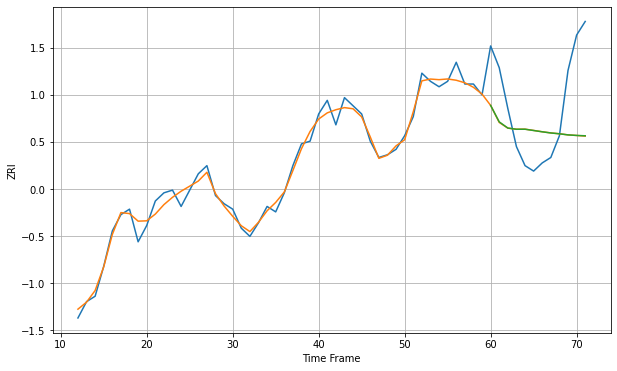

Wall time: 17.1 s
60619 2.7547719688068772 20.999401962542343 20.955823442901536 [1119.14013095 1113.08455215 1110.81931362 1110.36937772 1110.38658899
 1109.9157236  1109.43634327 1109.00998406 1108.7068698  1108.30497393
 1108.10337695 1107.97400551]

Got an mse at 0.0025 in round 317 and stopped training

60 60 12


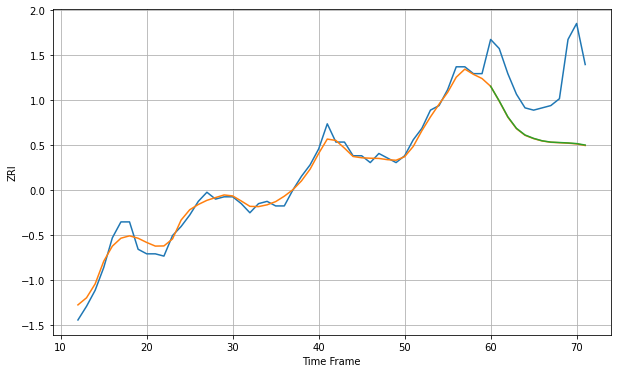

Wall time: 12.4 s
60620 3.034776073695643 27.090025306005558 26.98895590318401 [1155.45278402 1149.03650168 1142.08149538 1137.02631376 1134.10425758
 1132.61299274 1131.55458264 1130.98009133 1130.79865488 1130.61741657
 1130.33418757 1129.68709971]
60 60 12


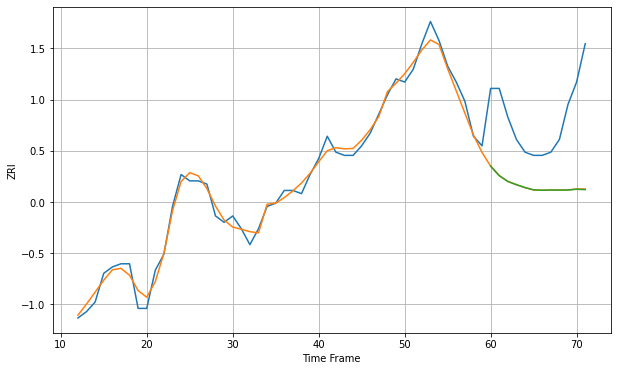

Wall time: 17.2 s
60621 2.4359428183711707 23.492065411642546 23.541411639956998 [1158.61705036 1155.64273498 1153.81368992 1152.80297297 1151.90138897
 1151.17300139 1151.07395841 1151.1387135  1151.10905348 1151.12678867
 1151.37736409 1151.25351392]
60 60 12


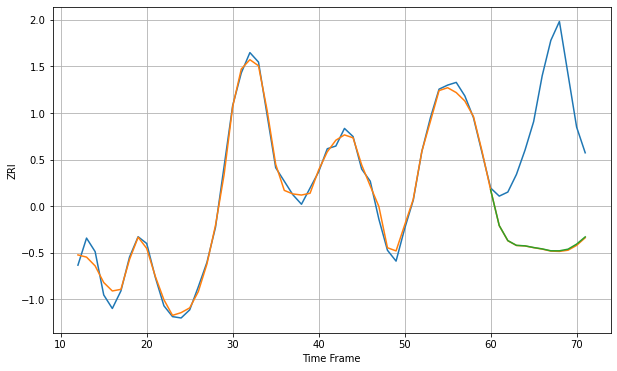

Wall time: 17.2 s
60622 5.019188324437662 98.37395683984562 98.05569855782396 [1773.62116026 1747.26482037 1736.1529723  1732.63976596 1732.27101843
 1731.03875022 1730.02070911 1728.62637018 1728.6043387  1729.8172756
 1733.54484661 1738.89918628]
60 60 12


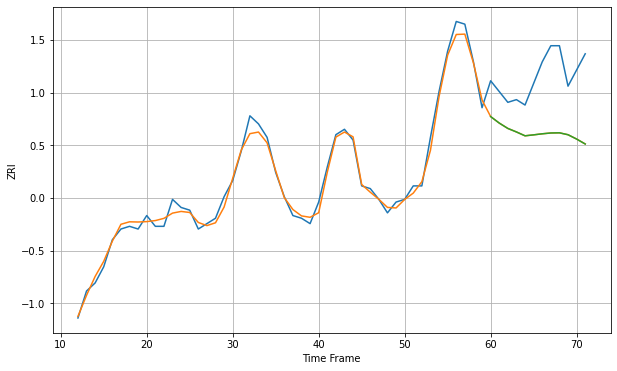

Wall time: 17.6 s
60623 2.4334438158519283 22.262331061303307 22.265675800796732 [1290.71810887 1288.30903408 1286.31578743 1285.01367763 1283.57983285
 1283.93385987 1284.32410228 1284.62755925 1284.68950668 1283.98344082
 1282.37553326 1280.53529354]

Got an mse at 0.0024 in round 437 and stopped training

60 60 12


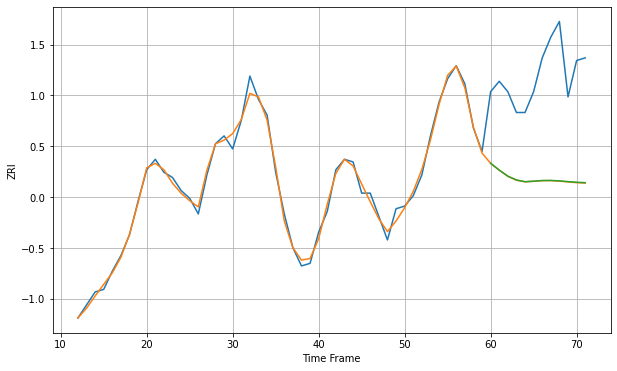

Wall time: 15.5 s
60624 2.173236874250806 41.02268086441871 40.94697497461146 [1338.44413965 1335.86122532 1333.52499472 1332.05737414 1331.38714038
 1331.5851577  1331.84138784 1331.88205352 1331.70794102 1331.42340157
 1331.17395787 1331.01821116]

Got an mse at 0.0025 in round 247 and stopped training

60 60 12


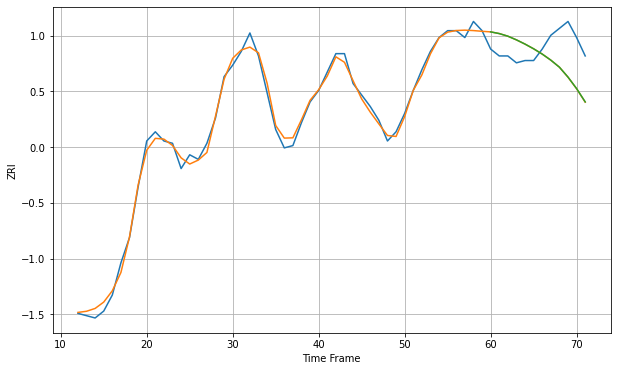

Wall time: 11.1 s
60625 2.5720951588387195 13.837308439017319 13.806944362941666 [1553.46850409 1552.73535366 1551.59910466 1549.99600425 1548.15770104
 1546.11225509 1543.81118784 1541.17066791 1538.10746573 1533.79960543
 1528.79353123 1523.01042896]

Got an mse at 0.0025 in round 351 and stopped training

60 60 12


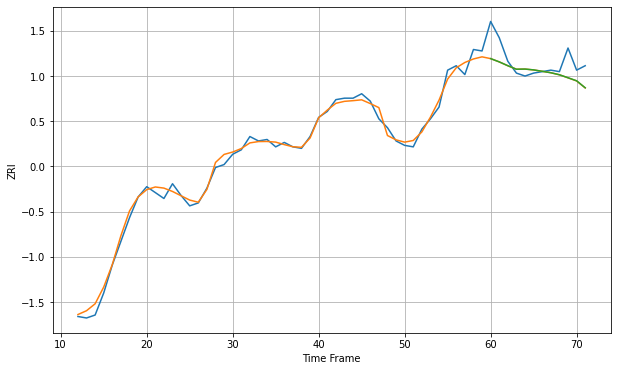

Wall time: 13.7 s
60626 3.757666896621611 11.70026670705825 11.677295887050393 [1365.81451198 1363.60149816 1361.00212218 1358.62626344 1358.73769879
 1358.166827   1357.21906867 1356.24870758 1354.86752004 1352.8388074
 1350.78729421 1346.03649632]

Got an mse at 0.0025 in round 402 and stopped training

60 60 12


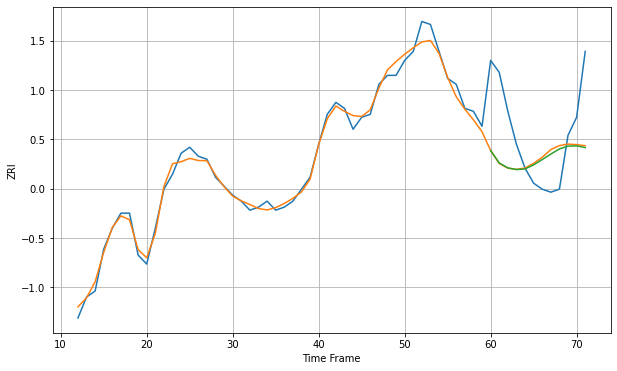

Wall time: 14.4 s
60628 2.3249991687935343 18.061650830736003 17.933569574930836 [1171.91490888 1167.76468083 1166.11937305 1165.56891152 1165.76754319
 1167.11698084 1168.88488871 1170.71839926 1172.44316145 1173.37375906
 1173.47626556 1172.89086538]
60 60 12


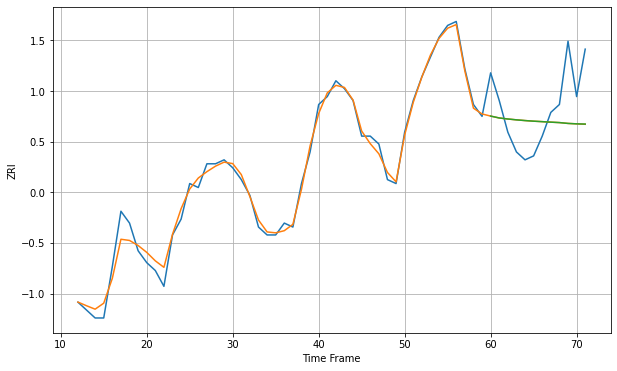

Wall time: 17.3 s
60629 2.026170656917532 10.299838159318996 10.291514752917823 [1219.06789164 1218.58942555 1218.33064124 1218.11569125 1217.93317538
 1217.77762807 1217.65905985 1217.53100416 1217.42061487 1217.20928538
 1217.10228881 1217.05114393]

Got an mse at 0.0025 in round 435 and stopped training

60 60 12


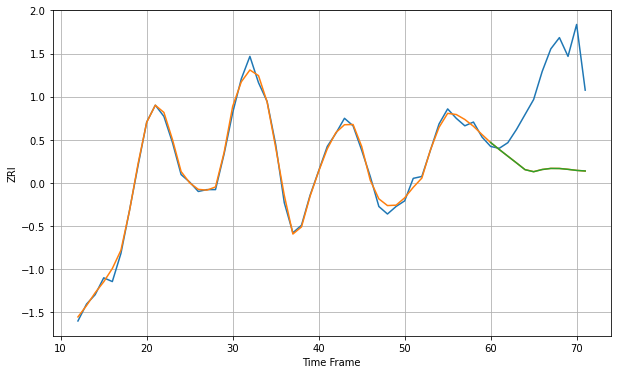

Wall time: 16.3 s
60630 2.475518525162835 46.44536177160174 46.45899928082351 [1513.09237267 1509.39048762 1505.81267113 1502.25600611 1498.62487264
 1497.53377513 1498.70133464 1499.27750422 1499.24151447 1498.79305289
 1498.24323287 1497.93593402]
60 60 12


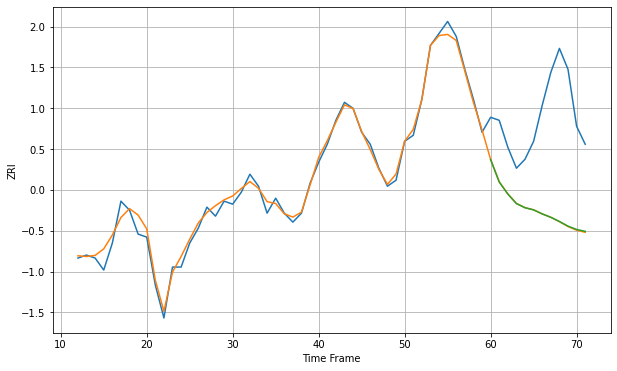

Wall time: 17.8 s
60632 2.313439161300718 33.6761781967009 33.615456820850206 [1309.89323647 1302.40101964 1298.37443985 1295.19137601 1293.80237891
 1293.08937909 1291.73721496 1290.62001894 1289.21433033 1287.66165241
 1286.55174354 1285.93066045]
60 60 12


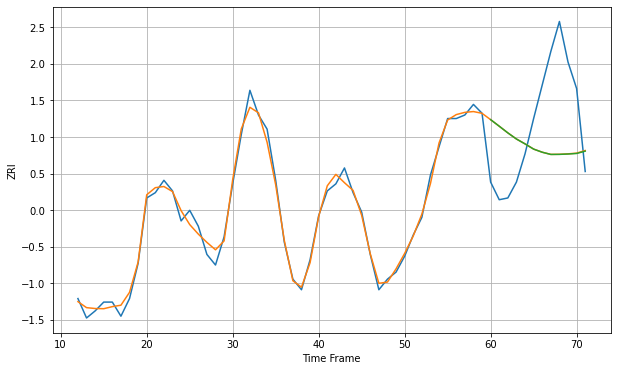

Wall time: 17.5 s
60634 3.9512309556519347 40.795850538499266 40.823293713427695 [1582.36238743 1578.64689822 1574.87618547 1571.40418259 1568.6378829
 1565.68157064 1563.90707357 1562.65979102 1562.69529252 1562.89777698
 1563.20489986 1564.50787568]

Got an mse at 0.0025 in round 489 and stopped training

60 60 12


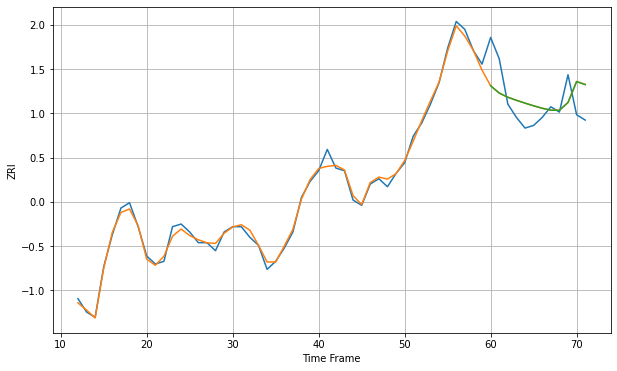

Wall time: 16.8 s
60636 1.6935657882321715 9.750039383838265 9.737874323709415 [1191.86331045 1189.1313213  1187.56676496 1186.41966553 1185.358803
 1184.35230382 1183.43504182 1182.70800995 1182.66269705 1185.59531228
 1193.43063126 1192.31322522]

Got an mse at 0.0024 in round 441 and stopped training

60 60 12


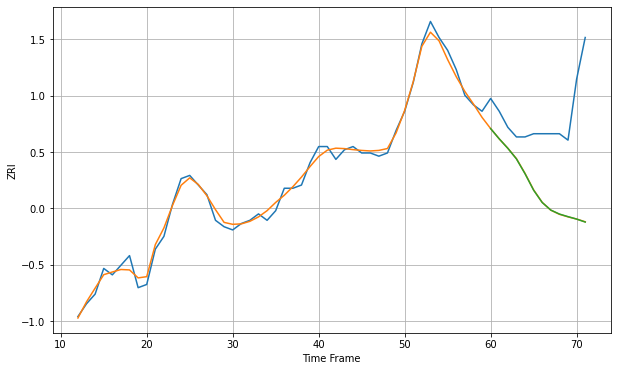

Wall time: 16.5 s
60637 1.866553584878438 26.012005650686596 26.029096578677027 [1204.59813802 1201.39736419 1198.45490795 1195.15057525 1190.52800675
 1185.3933977  1181.55039917 1179.18899681 1177.95291561 1177.13880246
 1176.39075281 1175.45970737]
60 60 12


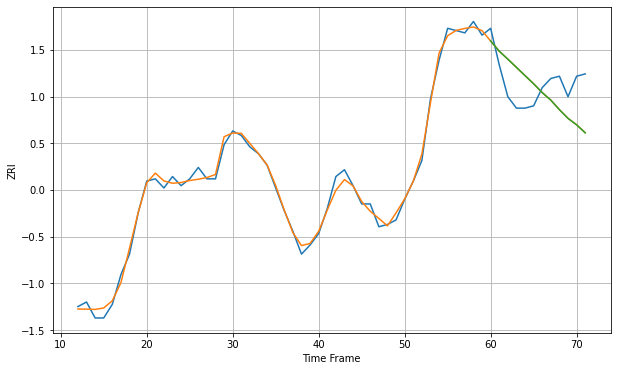

Wall time: 16.4 s
60639 2.4617521750245612 14.349949818201976 14.36765618399667 [1380.4506917  1375.97566977 1372.47345784 1368.87954371 1365.26957159
 1361.66918669 1357.8140065  1354.49999367 1350.31679915 1346.50690926
 1343.6690156  1340.17889244]

Got an mse at 0.0025 in round 300 and stopped training

60 60 12


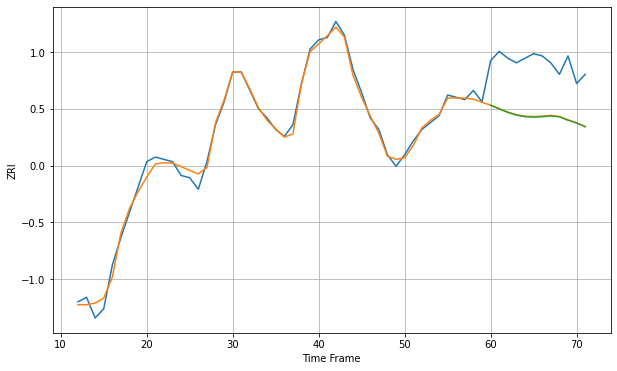

Wall time: 12 s
60640 2.5966547804469404 23.410467744485672 23.54739376024234 [1484.55629761 1482.98146822 1481.45036797 1480.2702834  1479.57807492
 1479.38604687 1479.56235768 1479.88934276 1479.5436514  1478.03679454
 1476.82454401 1475.21585397]
60 60 12


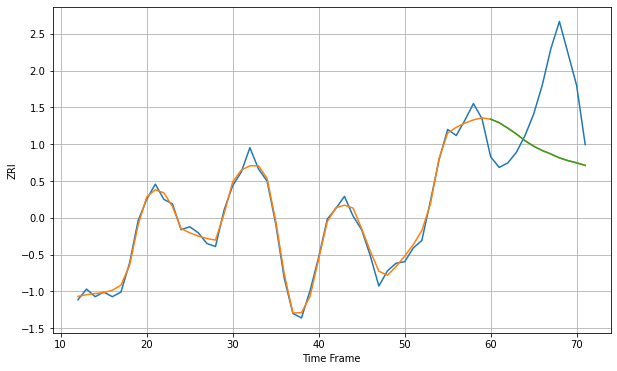

Wall time: 17 s
60641 3.9789817771576814 45.66462767003405 45.66137293319592 [1557.7443937  1555.41311517 1551.83872199 1547.98852074 1543.57783014
 1539.97454829 1537.1294051  1534.86227288 1532.30352596 1530.46634043
 1529.04465266 1527.28185778]
60 60 12


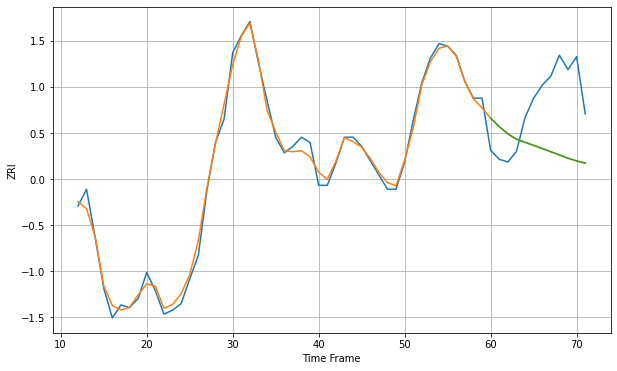

Wall time: 17.2 s
60642 5.619201468183275 47.972471287318555 47.97741575355956 [1968.6623959  1962.1068535  1956.61619073 1952.48249258 1950.10198428
 1947.72268579 1945.31402204 1942.83751169 1940.32407774 1937.83539054
 1935.7729442  1934.08095072]
60 60 12


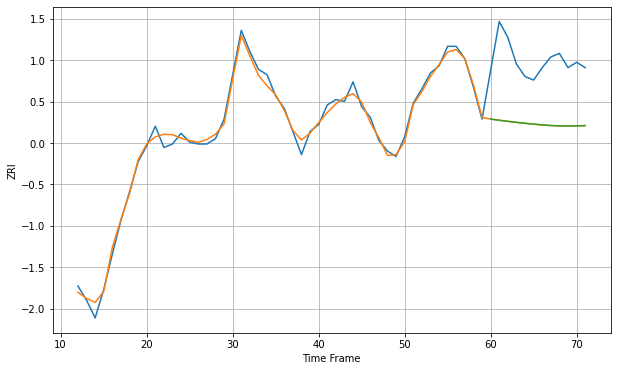

Wall time: 16.8 s
60644 3.324418193644871 36.62284544054759 36.62641915335931 [1235.02975223 1234.36890469 1233.74818836 1233.1748125  1232.65799473
 1232.17787281 1231.73081838 1231.3837066  1231.19622962 1231.11167449
 1231.17622176 1231.353639  ]

Got an mse at 0.0025 in round 296 and stopped training

60 60 12


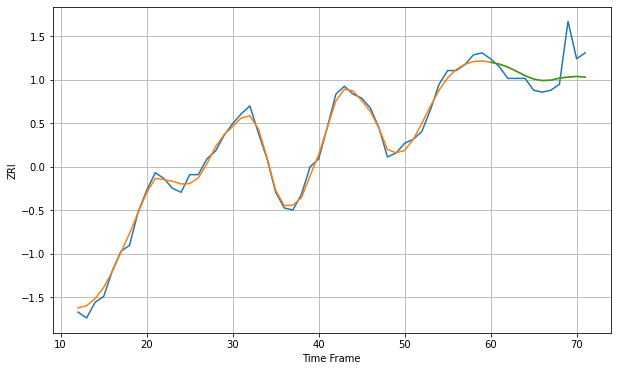

Wall time: 11.9 s
60645 2.7954315991082703 9.969362110378238 9.967849160071854 [1497.25279362 1496.28423993 1494.76668733 1492.64784135 1490.40162136
 1488.70058303 1487.89141118 1488.08765512 1489.15358124 1489.67183851
 1490.01822728 1489.6356734 ]

Got an mse at 0.0025 in round 446 and stopped training

60 60 12


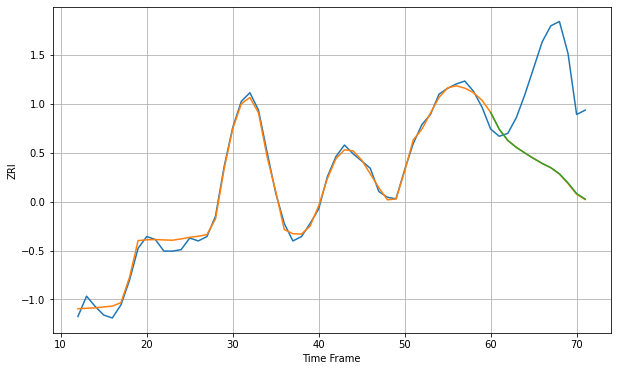

Wall time: 15.4 s
60647 3.597520326984091 63.57618314215823 63.42608913693554 [1622.45083364 1610.88414101 1603.13670006 1598.33899593 1594.4681033
 1590.74966334 1587.3253209  1584.39329962 1580.20264863 1573.92829236
 1566.62500561 1562.76628967]
60 60 12


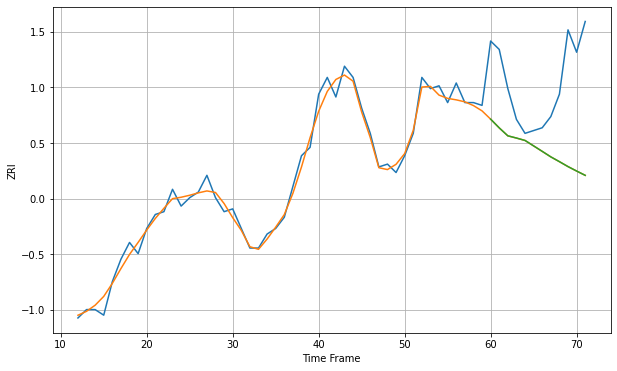

Wall time: 17 s
60649 2.9291189764996317 28.88811494886115 28.88487443356635 [1093.07403178 1089.96098202 1087.11892219 1086.32795292 1085.46462758
 1083.51752896 1081.56525714 1079.59311347 1077.88172722 1076.11724814
 1074.52955067 1072.98767432]

Got an mse at 0.0024 in round 449 and stopped training

60 60 12


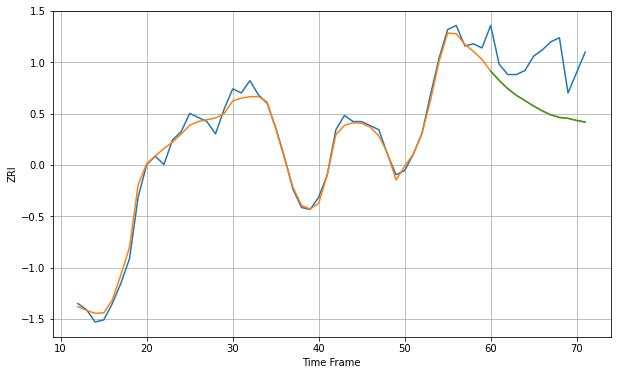

Wall time: 16 s
60651 3.3182193215850337 24.30028115278419 24.298649472939445 [1352.67865816 1348.10228459 1344.05115066 1340.80828141 1338.25046676
 1335.58270038 1333.23824877 1331.26250885 1330.02418138 1329.56722856
 1328.54899071 1327.7655567 ]
60 60 12


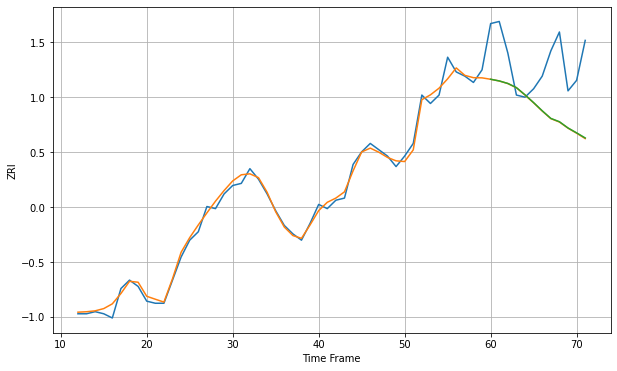

Wall time: 17.1 s
60653 2.7919677057744425 25.89311883212971 25.782948014589305 [1424.51547747 1423.72088427 1422.52432944 1420.54491893 1417.10984964
 1413.41209547 1409.52269098 1405.90453342 1404.32776595 1401.34865746
 1399.03210971 1396.61317909]
60 60 12


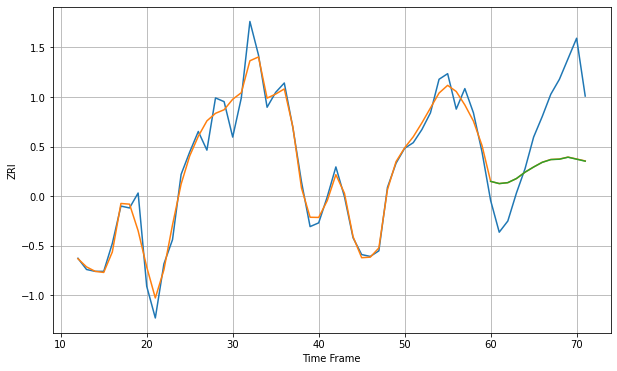

Wall time: 16.9 s
60654 7.074489609820551 33.379973159529285 33.427543843925065 [2139.25467933 2138.06974961 2138.56489814 2140.77966986 2144.18132683
 2146.94304289 2149.4551169  2150.93335814 2151.14506314 2152.21215995
 2151.15138407 2150.08752521]

Got an mse at 0.0024 in round 357 and stopped training

60 60 12


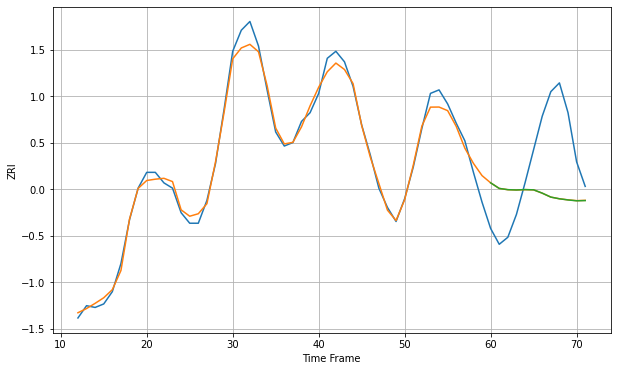

Wall time: 13.5 s
60657 4.782847182350342 36.61388307731882 36.62212854227378 [1749.02588289 1745.840633   1745.12977857 1744.96360914 1745.17396695
 1745.04020867 1743.15559683 1740.9004329  1739.93321902 1739.27966008
 1738.78336209 1738.91341368]

Got an mse at 0.0024 in round 379 and stopped training

60 60 12


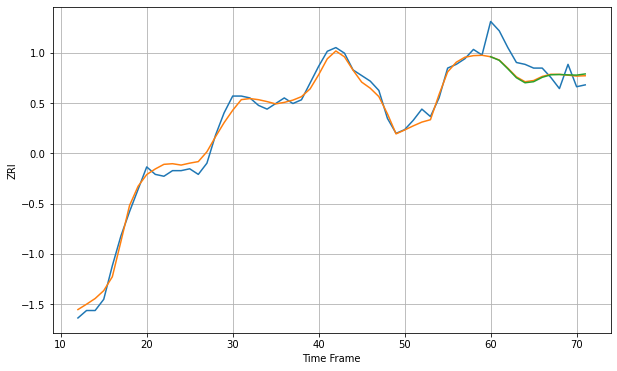

Wall time: 14.3 s
60660 3.653412739449677 9.521470841162264 9.762494667460372 [1393.08554899 1391.17679439 1386.63367046 1381.82059833 1379.11867063
 1379.70369826 1382.04759506 1383.40304704 1383.55276814 1383.3550276
 1383.22703101 1383.86445172]
60 60 12


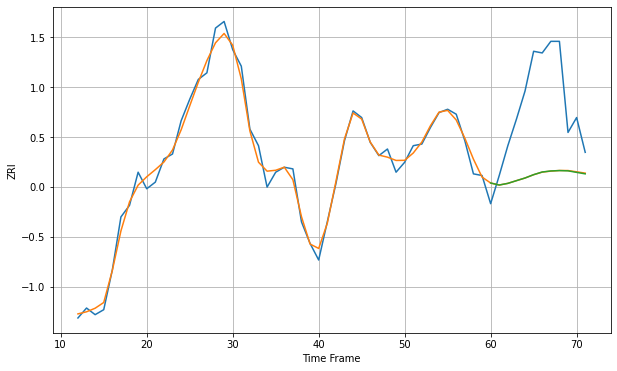

Wall time: 17 s
60661 4.777785190612804 49.62061385435751 49.63406922391433 [2063.48122004 2062.26397408 2063.25832102 2064.89490523 2066.49975116
 2068.51797935 2070.12751168 2070.75961136 2070.98253644 2070.82125655
 2069.8970981  2069.00024379]
60 60 12


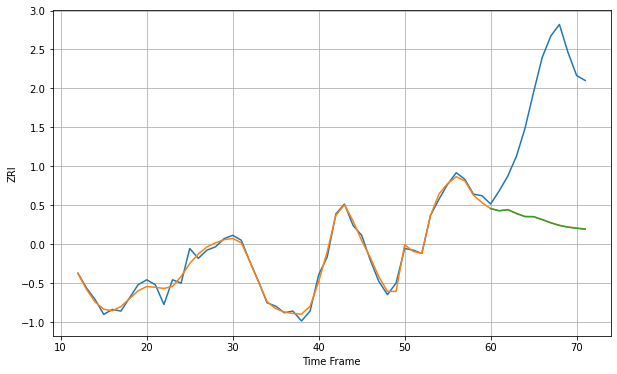

Wall time: 17.3 s
60804 3.0395491064178173 79.43312628144228 79.49255831290692 [1358.22025468 1356.9056538  1357.57961163 1355.27549317 1353.38844849
 1353.3203183  1351.5139358  1349.60066621 1347.99640094 1346.9380246
 1346.28091874 1345.66372361]

Got an mse at 0.0025 in round 186 and stopped training

60 60 12


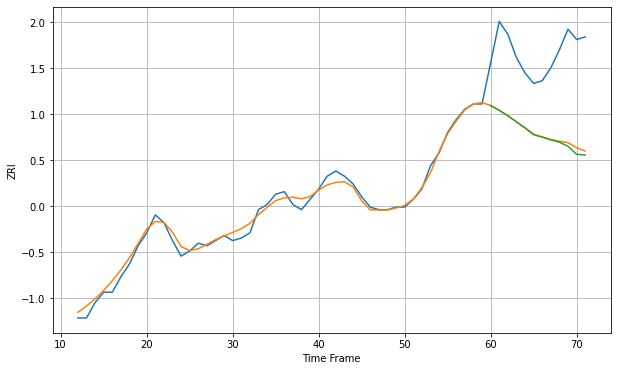

Wall time: 9.54 s
61104 2.1892738911594134 31.72441741087342 32.42232571662031 [633.38748456 631.52831953 629.43550338 627.06006497 624.68309707
 622.08668758 621.17450106 620.07041668 619.16976712 617.59180454
 614.46701566 614.22189016]

Got an mse at 0.0025 in round 258 and stopped training

60 60 12


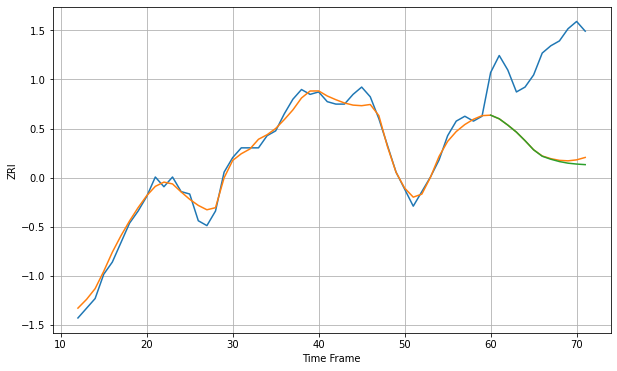

Wall time: 11.3 s
63104 2.916391778113143 39.227465782415734 39.9705006603823 [830.44757115 828.9440883  826.34968739 823.4672692  819.95312828
 816.18052811 813.54751182 812.31283129 811.35672761 810.69416575
 810.32680515 810.09297432]

Got an mse at 0.0025 in round 195 and stopped training

60 60 12


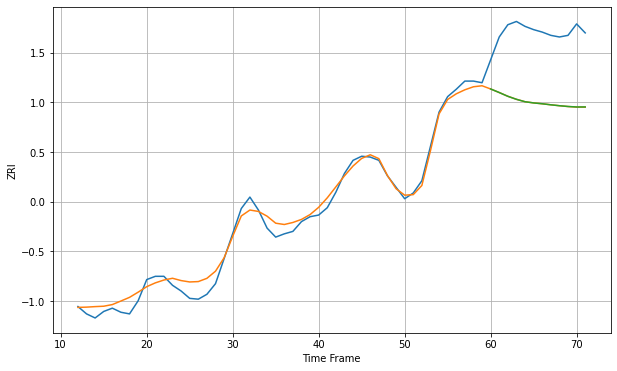

Wall time: 9.87 s
63105 9.892435200781302 85.35824959886824 85.32757314957733 [1194.36021728 1189.98800423 1185.38663551 1181.68593829 1178.72423556
 1177.26991869 1176.23766739 1174.97557644 1173.85987241 1172.92213046
 1172.32333932 1172.36393867]
60 60 12


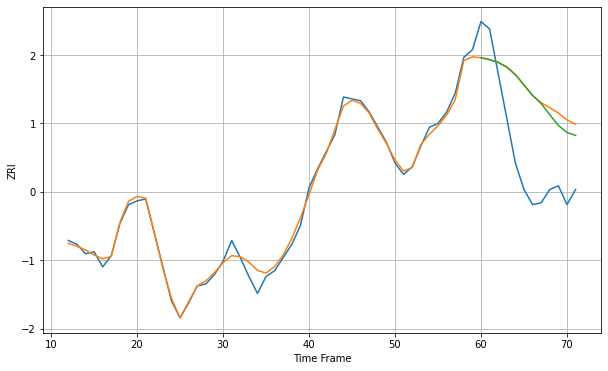

Wall time: 17.1 s
63107 3.0699898381303954 40.182598958958124 38.3413665682596 [774.81582366 773.76385293 772.28260551 769.79211505 765.83085916
 760.40963979 754.85686648 750.53157138 744.59914865 738.94363051
 735.18132819 733.65751791]

Got an mse at 0.0025 in round 407 and stopped training

60 60 12


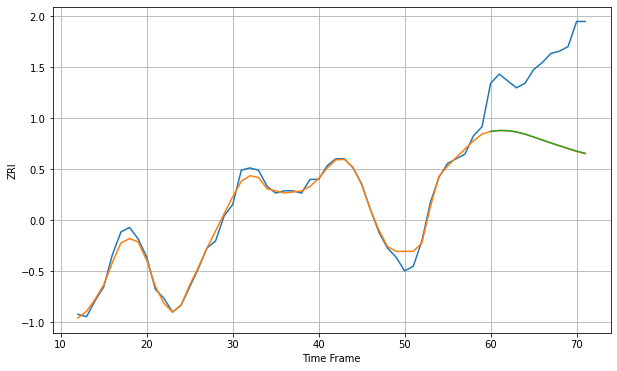

Wall time: 15.4 s
63108 2.5808631923858023 36.753267966809695 36.662975976257606 [935.95353865 936.35702486 936.27709613 935.73430294 934.77211315
 933.50133949 932.21251289 930.9491717  929.73005702 928.52875898
 927.34811745 926.41825268]
60 60 12


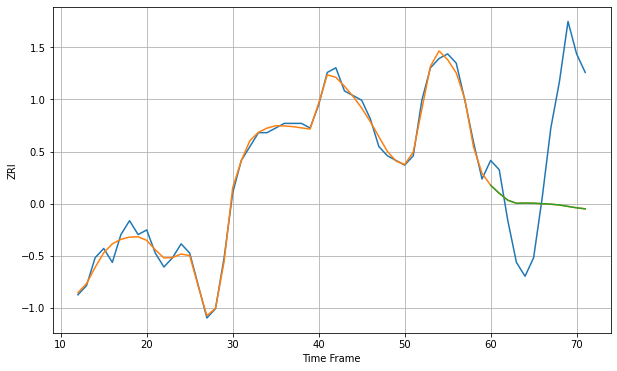

Wall time: 17 s
63109 1.3456904909425402 20.75482034217435 20.753868622813357 [740.6527856  738.90448457 737.40870852 736.7527323  736.80506698
 736.77200999 736.66810124 736.56191249 736.39340935 736.08212096
 735.78050475 735.55847748]

Got an mse at 0.0024 in round 217 and stopped training

60 60 12


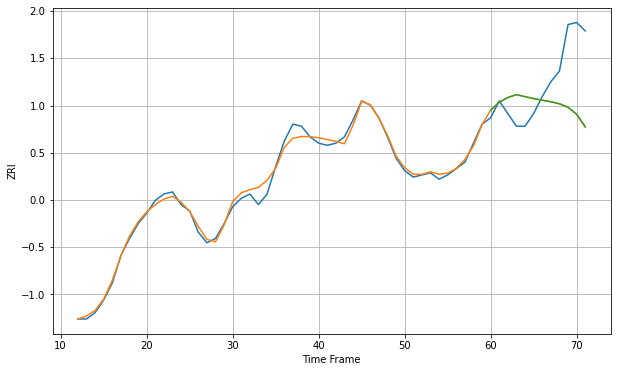

Wall time: 10.6 s
63110 2.43284744623005 23.008008452839004 22.921029763927987 [890.55929953 894.32728734 896.55958774 897.93152087 896.94462942
 896.05016886 895.27393802 894.54319953 893.6085029  891.95783604
 888.69903833 882.84986755]

Got an mse at 0.0025 in round 322 and stopped training

60 60 12


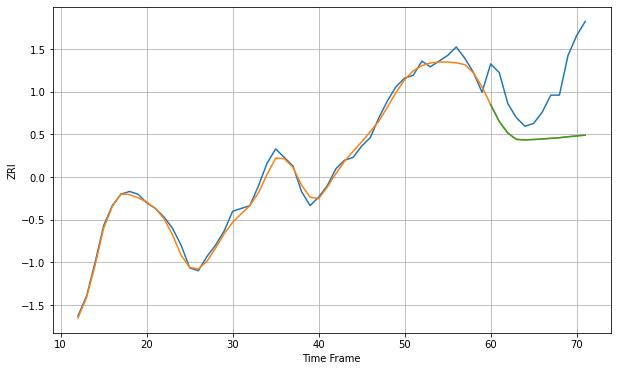

Wall time: 12.5 s
63111 1.8959121537959915 20.33284182723178 20.337541885856844 [676.66626729 670.72294678 666.60656689 664.38261228 664.18436062
 664.33184722 664.50967252 664.7360793  664.95842987 665.29316942
 665.58981118 665.86519647]
60 60 12


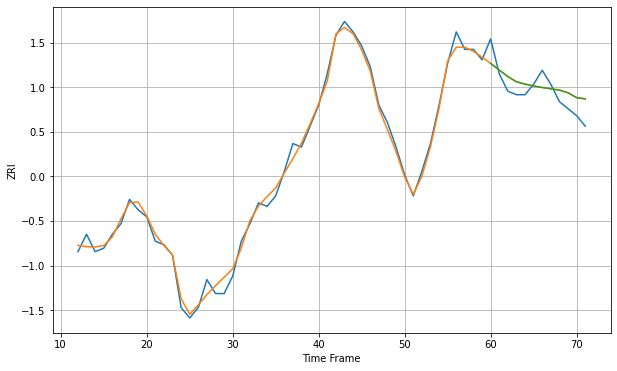

Wall time: 16.7 s
63112 1.8807221064374282 4.443362168975512 4.444773289950191 [773.97701423 772.06735825 770.22450674 768.70956595 768.04792767
 767.47998274 767.07285533 766.71214712 766.31171858 765.56219517
 764.15819896 763.81789446]

Got an mse at 0.0025 in round 439 and stopped training

60 60 12


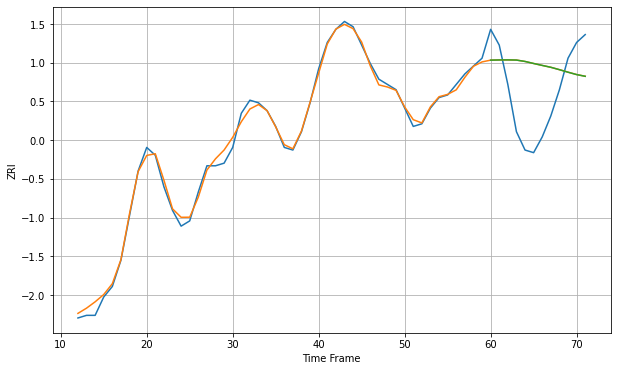

Wall time: 15.2 s
63113 1.9068089698832802 20.147101089845126 20.150514362260097 [749.26550565 749.32935695 749.35729274 749.28958487 748.76093366
 747.98597332 747.25247638 746.53525412 745.62489841 744.66549347
 743.75468816 743.10220165]

Got an mse at 0.0025 in round 416 and stopped training

60 60 12


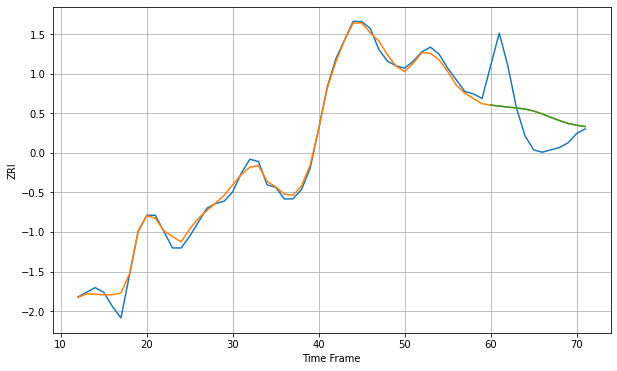

Wall time: 14.8 s
63115 2.4939331782964467 14.893998122710816 14.881991548633765 [664.17702266 663.77875684 663.31114053 662.96291447 662.47279462
 661.65410433 660.38896528 658.90597615 657.54108181 656.32210428
 655.55535675 654.97736377]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


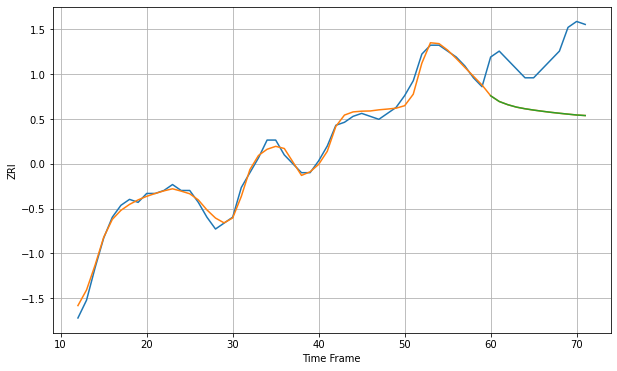

Wall time: 9.09 s
63116 1.8579750229783965 20.062473282509046 20.059744983384178 [688.946017   687.01070318 685.92841696 685.11482064 684.56100507
 684.11659033 683.72794264 683.36253315 683.04527949 682.74433939
 682.4583202  682.26837701]

Got an mse at 0.0025 in round 160 and stopped training

60 60 12


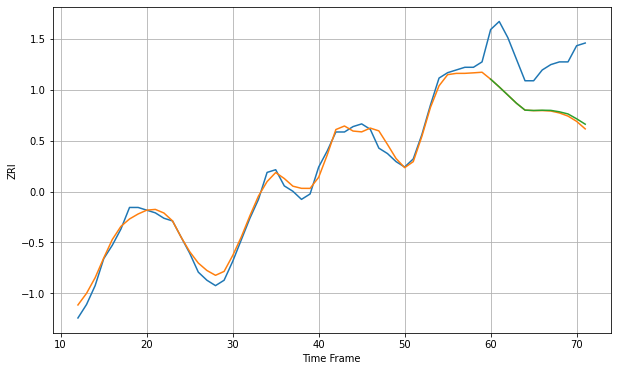

Wall time: 9.24 s
63118 2.5490497870617093 20.370120703316076 19.91215401323571 [726.58709919 723.7095623  720.69832286 717.67739756 715.11322749
 714.97649049 715.06841167 715.01350425 714.48545176 713.69087257
 711.88998982 709.89084933]
60 60 12


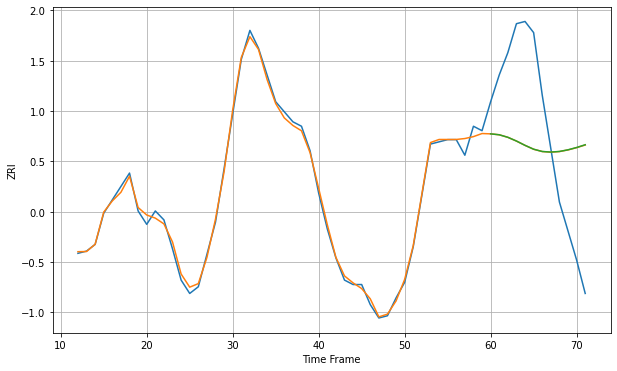

Wall time: 16.6 s
63130 2.122898145421974 41.2514752967483 41.27441454295223 [1030.58513959 1030.17570218 1029.04079026 1027.36870971 1025.4333392
 1023.70462709 1022.6828909  1022.41726657 1022.69154808 1023.43180012
 1024.4649609  1025.70701989]

Got an mse at 0.0025 in round 319 and stopped training

60 60 12


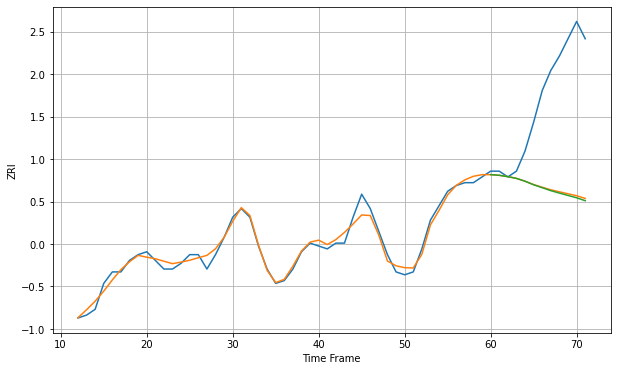

Wall time: 12.5 s
63139 2.036381430350472 35.71149806008614 36.08222138751212 [804.79181321 804.55548029 804.09486237 803.48612808 802.50094251
 801.2711732  800.25549916 799.22810954 798.3825713  797.56210064
 796.75673548 795.73589637]

Got an mse at 0.0025 in round 427 and stopped training

60 60 12


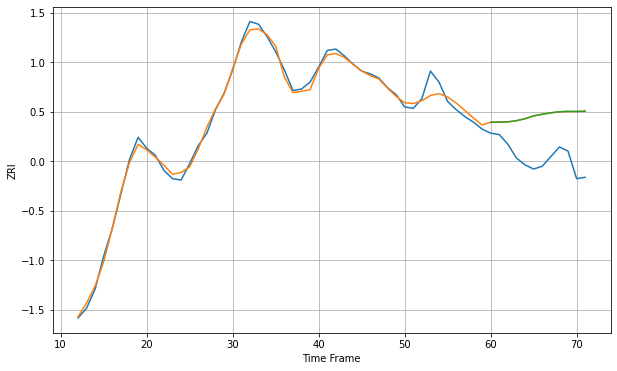

Wall time: 14.7 s
64111 4.069707108059799 32.035258899839256 32.05877881331933 [1018.90092501 1019.03821306 1019.20273878 1020.05337933 1021.46233052
 1023.54262427 1024.73470427 1025.73991145 1026.54667077 1026.81032125
 1026.75803299 1026.93799626]
60 60 12


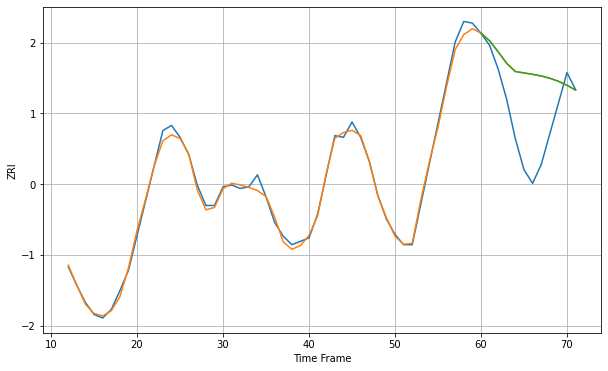

Wall time: 16.5 s
64801 2.84358252743808 33.47019808339178 33.48312960964098 [821.13603247 816.66661837 810.18031727 803.34124915 798.60665229
 797.81218476 796.98772965 796.0098086  794.69668843 792.92968207
 790.57261244 787.78713813]
60 60 12


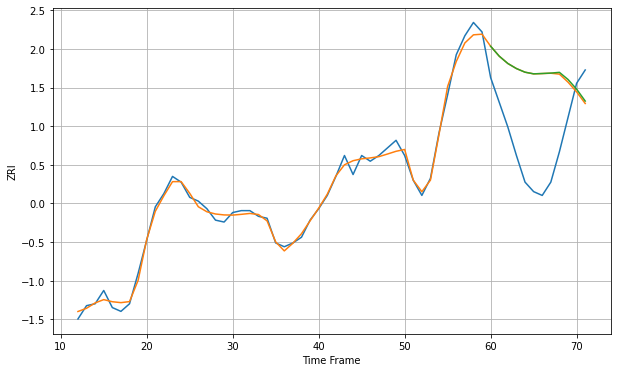

Wall time: 16.7 s
64804 2.861032276207356 41.82211020859504 41.91332123352244 [856.49215007 851.26096964 847.41716234 844.74620673 842.83868853
 841.96733472 842.14706856 842.36272696 842.75124998 839.0038887
 833.90520012 827.65323901]
60 60 12


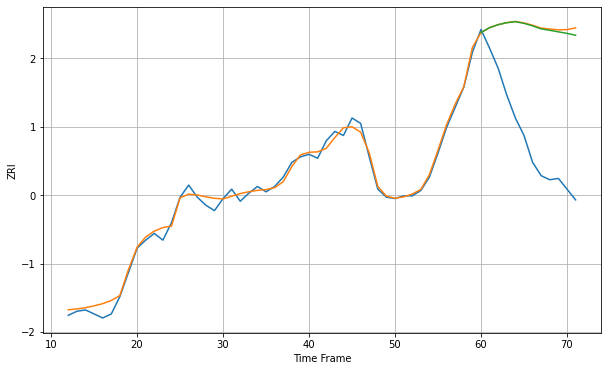

Wall time: 16.5 s
64834 4.317763277243214 88.6888359377933 87.31950828057556 [917.72418575 921.35014373 923.55587047 925.01360554 925.76847269
 924.5515456  922.65103878 920.40949995 919.35299754 918.20854786
 917.07098908 915.65716239]

Got an mse at 0.0025 in round 463 and stopped training

60 60 12


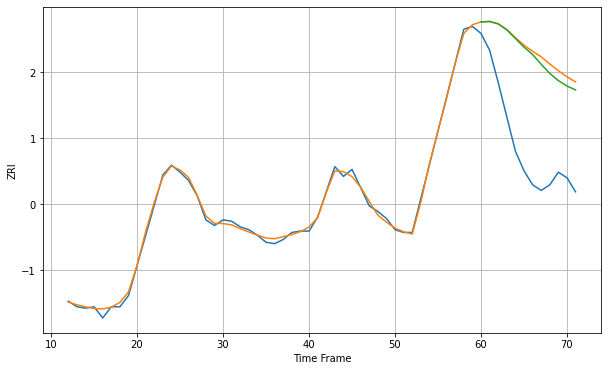

Wall time: 15.9 s
64836 2.246459056187174 72.37833743862618 69.06090613784933 [873.19998481 873.52600335 871.81010376 867.56877534 861.40519302
 855.23859868 849.96339453 842.96684715 836.45742867 831.35983371
 827.44411215 824.71957472]

Got an mse at 0.0025 in round 432 and stopped training

60 60 12


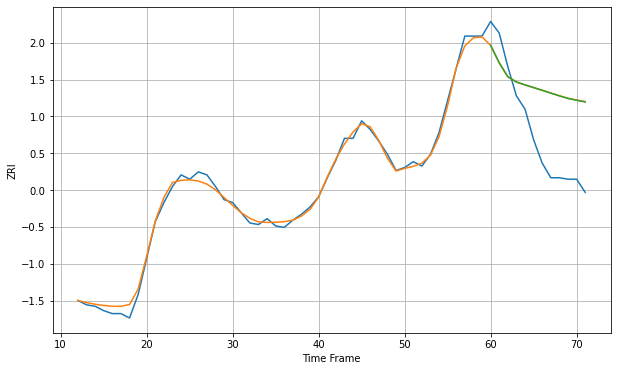

Wall time: 15 s
64870 3.135755097118213 42.089849131212794 41.99023124155532 [876.62922671 864.69143993 855.18076723 851.57569494 849.59604711
 847.74830633 845.86773356 843.93534884 842.02407629 840.26154423
 839.01554863 837.90830289]
60 60 12


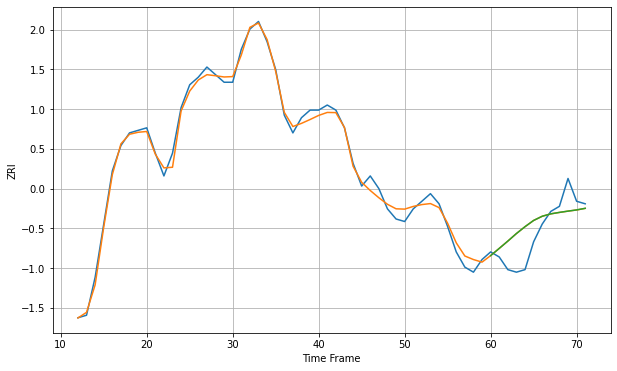

Wall time: 16.7 s
65201 2.52947732650666 8.803011752248539 8.800339641331075 [784.53763621 787.38809415 790.27133599 793.25607218 795.96689575
 798.42539372 800.08330411 801.03400549 801.60420479 802.11372163
 802.58237279 803.22112691]
60 60 12


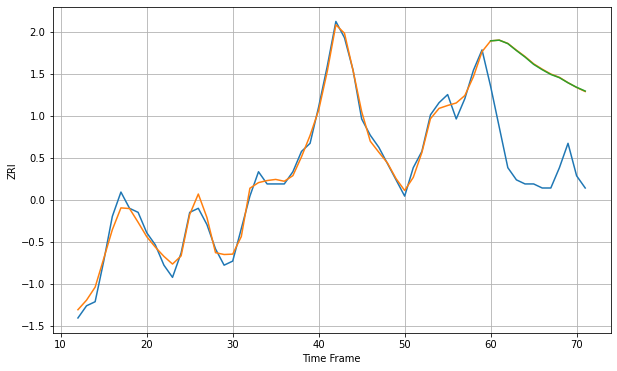

Wall time: 16.5 s
65202 1.8608491721802654 25.49131651007377 25.430691566364953 [801.22645028 801.39929851 800.54711637 798.83740758 797.23886245
 795.44294798 794.12316395 792.95238951 792.15995916 790.8988769
 789.79354992 788.86803865]
60 60 12


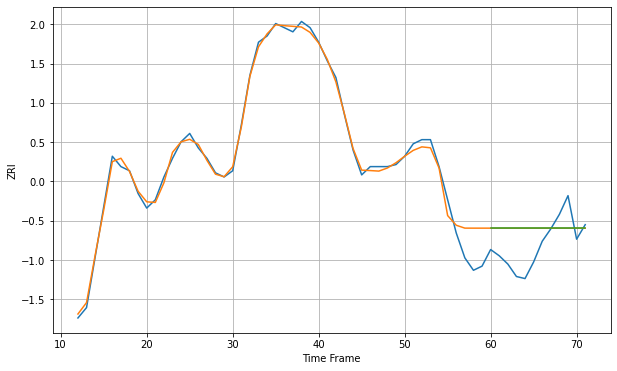

Wall time: 16.2 s
65203 4.983969471690043 13.986690221375921 13.986690221375921 [823.32183757 823.32183757 823.32183757 823.32183757 823.32183757
 823.32183757 823.32183757 823.32183757 823.32183757 823.32183757
 823.32183757 823.32183757]
60 60 12


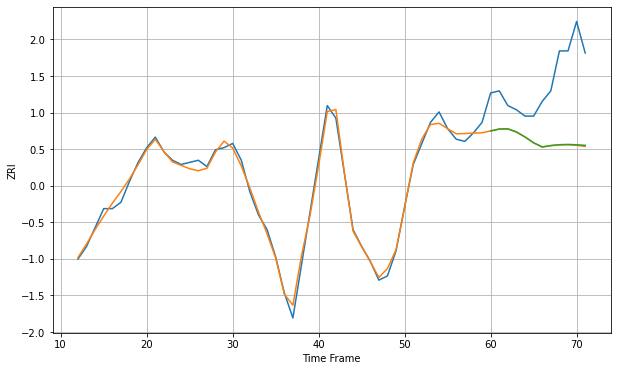

Wall time: 16.2 s
66061 2.5358363814255798 31.272006077450797 31.13022614385093 [1007.93360795 1008.83735555 1008.93564443 1007.45129453 1005.07018036
 1002.31243417 1000.32518827 1000.99360667 1001.39583945 1001.52668084
 1001.36540051 1001.0911021 ]
60 60 12


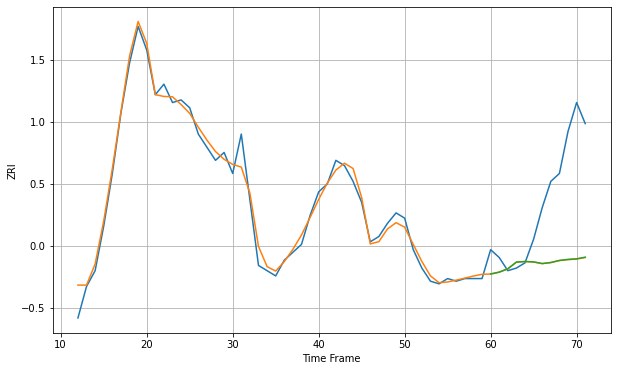

Wall time: 16.5 s
66213 3.560060100221119 30.60260686037095 30.54855757276367 [1022.72404014 1023.44674931 1024.71038707 1027.27532033 1027.49372981
 1027.32891336 1026.70791851 1027.1102164  1027.89561024 1028.30688389
 1028.51112767 1029.13547805]

Got an mse at 0.0025 in round 84 and stopped training

60 60 12


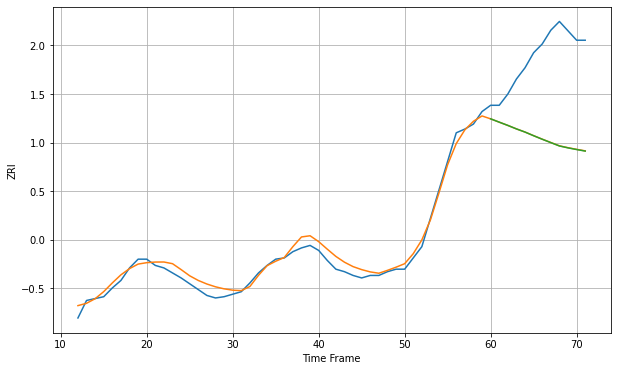

Wall time: 7.05 s
66214 5.301858262275908 69.17660654513965 69.26270677892767 [837.16356732 834.51333156 831.90756757 829.12159141 826.58755742
 823.67349683 820.86128477 818.16033142 815.48588743 813.95632122
 812.62779937 811.39672522]

Got an mse at 0.0025 in round 459 and stopped training

60 60 12


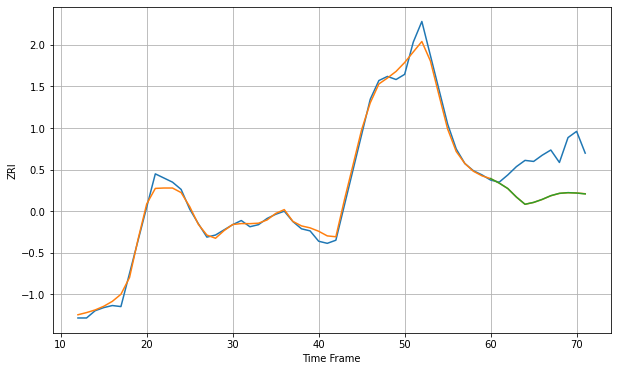

Wall time: 15.9 s
66215 5.780648474364764 37.579226864898 37.572563618660105 [1033.39125989 1029.09186655 1023.8231528  1015.61635516 1008.67396452
 1010.48376265 1013.39094418 1016.97091188 1019.23862768 1019.88211783
 1019.51540006 1018.65794368]

Got an mse at 0.0025 in round 408 and stopped training

60 60 12


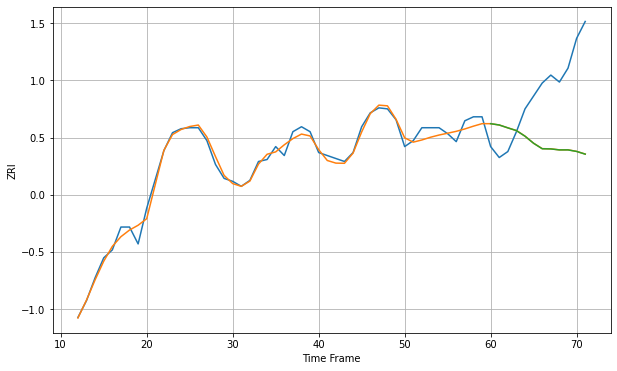

Wall time: 15 s
66223 6.162333038341393 69.097663612796 69.15021650805407 [1429.07079563 1427.75978039 1424.86392391 1422.10917099 1416.45685545
 1409.32151833 1403.82732672 1403.64937321 1402.65551813 1402.68504495
 1401.11360676 1398.39866782]

Got an mse at 0.0025 in round 226 and stopped training

60 60 12


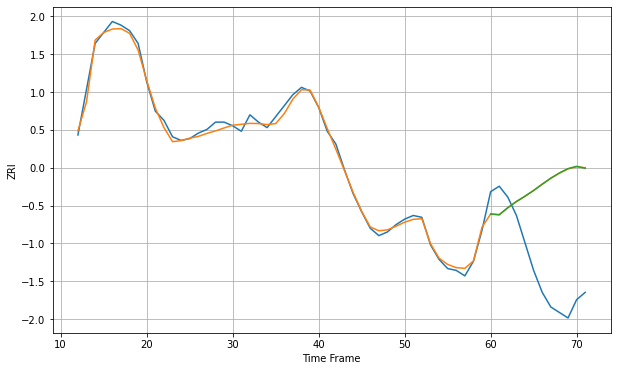

Wall time: 11 s
66502 2.4838017672412467 53.08873166624867 53.117715061784885 [828.80209135 828.40048084 832.25169612 835.61467533 838.52883132
 841.65283182 845.10582388 848.37851661 851.21545316 853.59708968
 854.85431047 853.79516001]
60 60 12


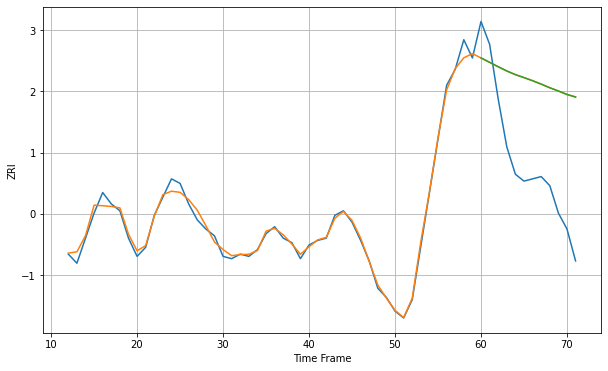

Wall time: 17.2 s
66614 2.339625720262948 43.23705503571762 43.25268829959321 [929.01668643 927.07677461 925.14236614 923.29195232 921.68788467
 920.38597675 919.01886932 917.53548836 915.94268401 914.52050895
 912.99875054 911.91173394]
60 60 12


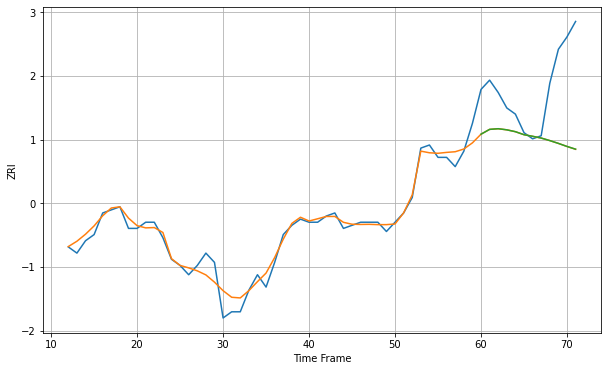

Wall time: 16.8 s
67218 2.846446398857409 20.27184649809243 20.261612855308396 [647.50251897 649.06371139 649.27459279 648.91786941 648.31326512
 647.34122103 646.82360654 646.25249932 645.43289165 644.52370482
 643.53579188 642.65572227]
60 60 12


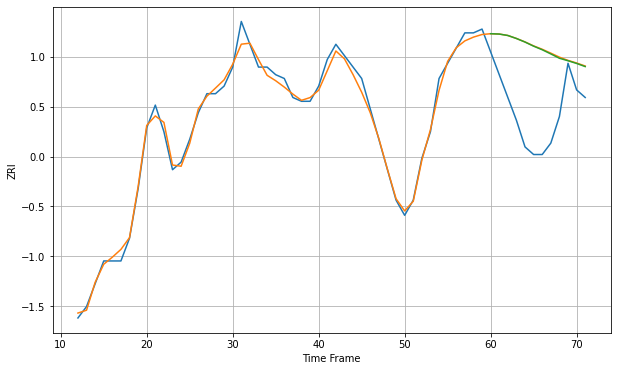

Wall time: 16.8 s
72205 1.7352112114200682 18.564888546454426 18.480039717586674 [742.77855611 742.68913708 742.31144981 741.51709502 740.5812293
 739.4995853  738.55611199 737.45588583 736.31724996 735.66311258
 734.95505232 734.13033303]

Got an mse at 0.0025 in round 491 and stopped training

60 60 12


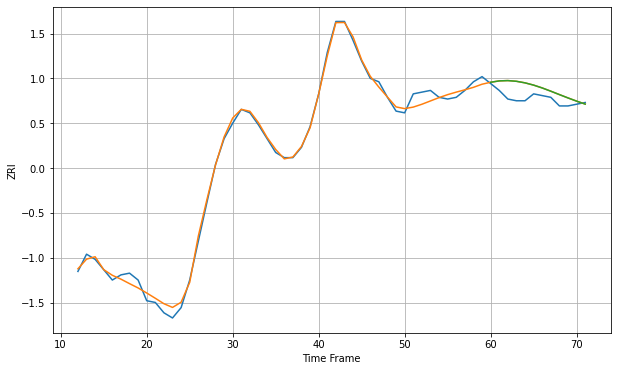

Wall time: 16.3 s
72712 3.026584263299103 6.510169284588422 6.5048027433140785 [927.73133223 928.52607598 928.70745153 928.28991632 927.38766161
 926.07414219 924.42818431 922.54713289 920.57262901 918.63335654
 916.78003654 915.0576424 ]
60 60 12


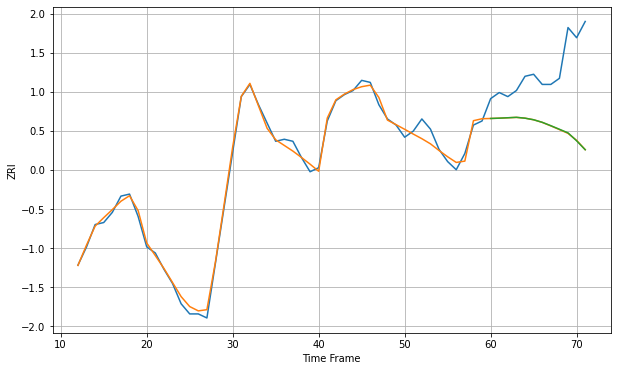

Wall time: 16.5 s
72764 2.7782130716852036 31.78041945913816 31.765928779383827 [914.23186414 914.38288029 914.59103868 914.80482771 914.37506483
 913.59912324 912.34884497 910.67702464 908.92518131 907.14598062
 903.24212057 898.83514257]
60 60 12


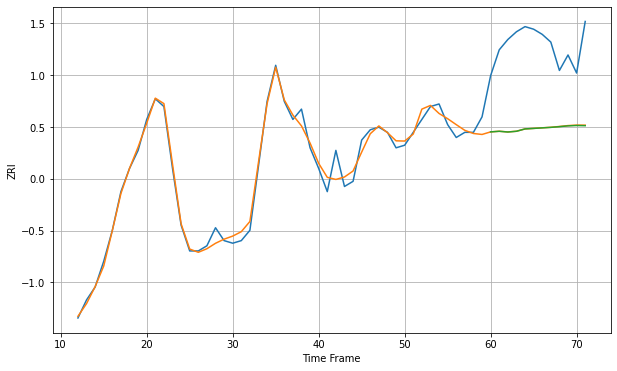

Wall time: 17 s
73071 3.1294691321694574 32.8532823910255 32.907254029562324 [849.17817435 849.40600202 849.12326844 849.41378732 850.32007673
 850.51629941 850.73340955 850.92195184 851.2039407  851.5107811
 851.64139066 851.5756602 ]

Got an mse at 0.0025 in round 471 and stopped training

60 60 12


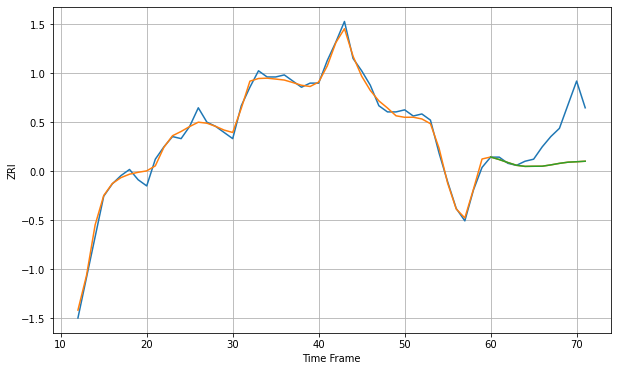

Wall time: 16.6 s
73159 2.6394080157692064 17.286917606809048 17.28478673320991 [704.05779776 702.81974569 701.37519427 700.03532058 699.49877048
 699.55713064 699.58386806 700.21915667 700.9677837  701.54328777
 701.75881129 702.0115767 ]

Got an mse at 0.0024 in round 149 and stopped training

60 60 12


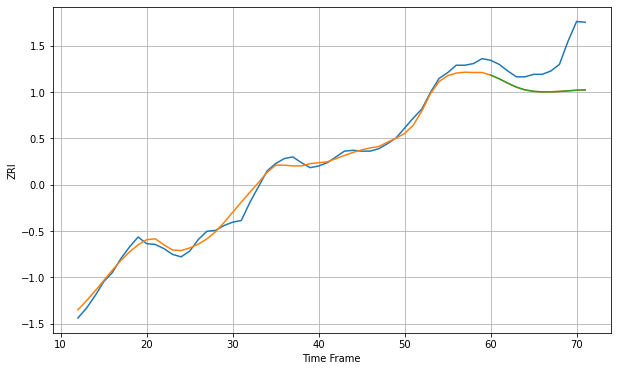

Wall time: 8.85 s
75001 7.23105141516291 41.945891822059146 41.87278118464798 [1278.07139685 1273.56629867 1268.26752763 1263.46425122 1260.1170025
 1258.3921508  1257.74605281 1257.81835493 1258.30316069 1259.04161153
 1259.81150518 1260.18812885]

Got an mse at 0.0025 in round 265 and stopped training

60 60 12


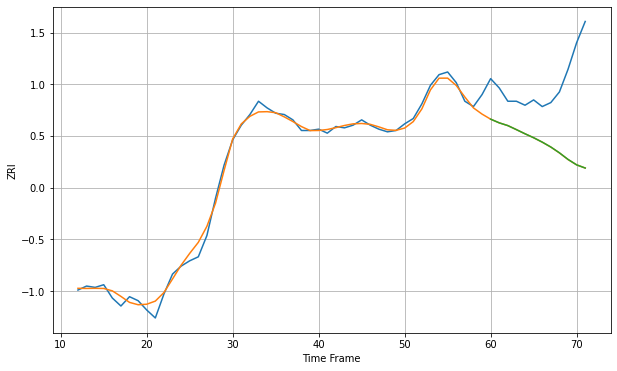

Wall time: 11.4 s
75010 4.47440178554426 52.28424424677013 52.26632875287491 [1238.519966   1235.7519224  1233.68072101 1230.64864998 1227.52729312
 1224.57385144 1221.26180465 1217.57826466 1213.20873205 1208.26474471
 1204.16114222 1201.76655725]

Got an mse at 0.0025 in round 172 and stopped training

60 60 12


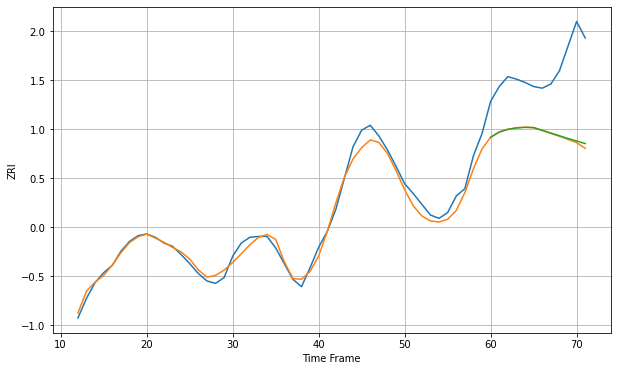

Wall time: 9.44 s
75013 8.826402508963582 83.11846078075325 81.88497471353051 [1418.40648249 1424.67774276 1428.00884807 1429.67680446 1430.41164102
 1430.19860568 1426.89484419 1423.52672725 1420.24537368 1416.89181221
 1413.87234979 1410.76082381]

Got an mse at 0.0025 in round 145 and stopped training

60 60 12


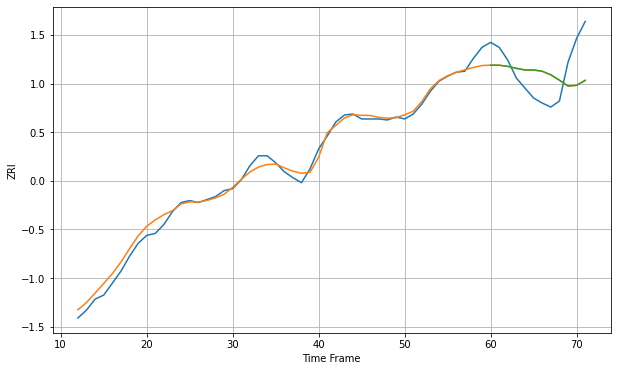

Wall time: 8.23 s
75024 6.410568627950821 30.13328920247836 30.198446406801978 [1353.08891403 1353.0162581  1351.87644535 1349.86730533 1348.24333784
 1348.26829305 1346.9817738  1343.39983436 1338.0216925  1332.1593644
 1332.7529726  1337.72866151]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


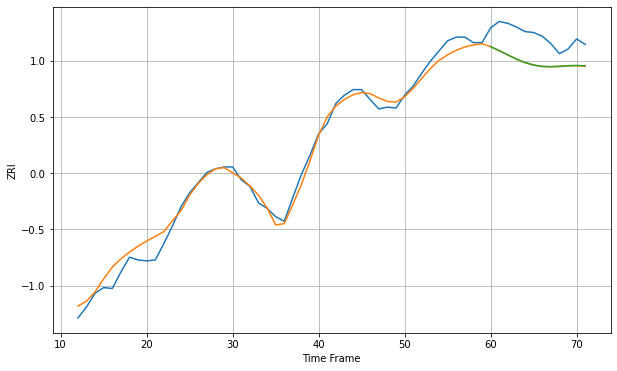

Wall time: 8.83 s
75039 9.38764010635385 28.638615013057084 28.5497660441677 [1517.63859559 1513.24375684 1508.70027341 1504.13558217 1500.36411844
 1497.66402891 1496.15342952 1495.90874809 1496.267442   1496.96821131
 1497.22201155 1496.85583479]

Got an mse at 0.0025 in round 274 and stopped training

60 60 12


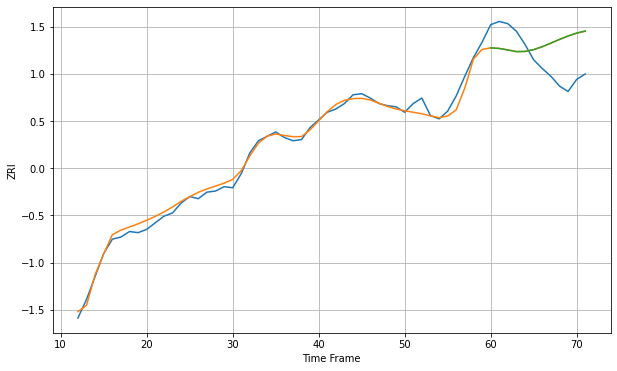

Wall time: 12 s
75050 5.038650234495977 30.40492125229825 30.456711127972675 [1183.88424518 1183.33741375 1181.9817433  1180.42708921 1180.59391719
 1182.22925247 1184.90750163 1188.17013023 1191.53080359 1194.68342959
 1197.38124556 1199.35448461]

Got an mse at 0.0024 in round 147 and stopped training

60 60 12


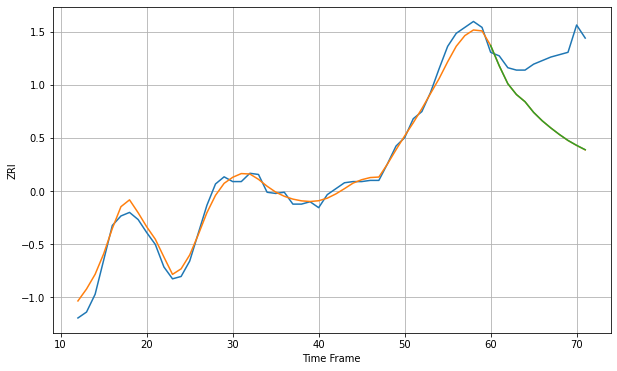

Wall time: 8.69 s
75052 6.78112372286643 56.62092429132039 56.591921718613776 [1125.72389037 1108.62947664 1093.49758932 1084.39377096 1078.3430732
 1069.35653317 1062.25684926 1056.22091727 1050.69593072 1045.67439796
 1041.5431116  1037.854025  ]

Got an mse at 0.0024 in round 348 and stopped training

60 60 12


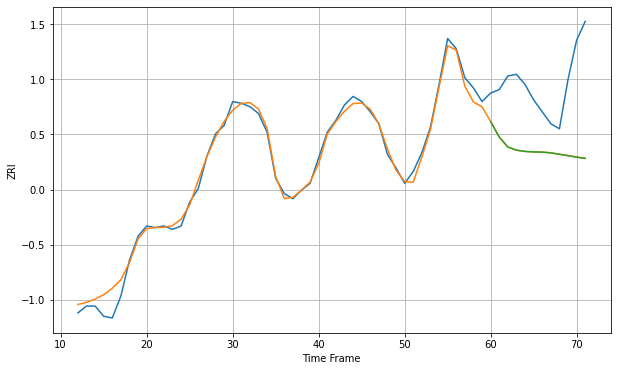

Wall time: 13.4 s
75056 4.436798944230694 42.293829059654286 42.32605544796788 [1346.26993846 1337.15373769 1331.35546789 1329.47929152 1328.73314891
 1328.43575043 1328.33642246 1327.89090561 1327.0620899  1326.26042865
 1325.38449943 1324.59684375]

Got an mse at 0.0025 in round 138 and stopped training

60 60 12


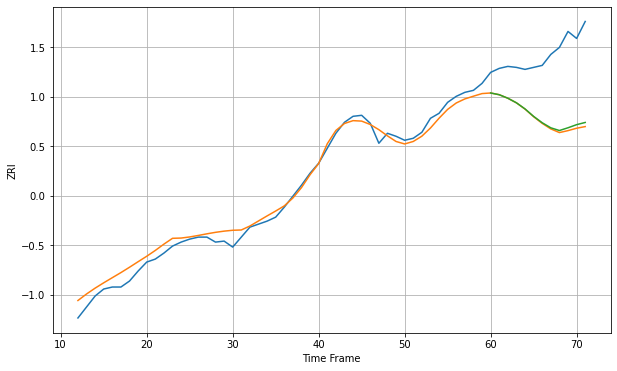

Wall time: 8.61 s
75063 7.629956831677668 66.26409694198261 64.55446221596364 [1220.36648113 1218.6248033  1215.11423048 1210.52927291 1204.39396657
 1196.93416897 1190.55170116 1185.47087439 1182.76401101 1185.52464565
 1188.63517382 1190.83906312]

Got an mse at 0.0025 in round 88 and stopped training

60 60 12


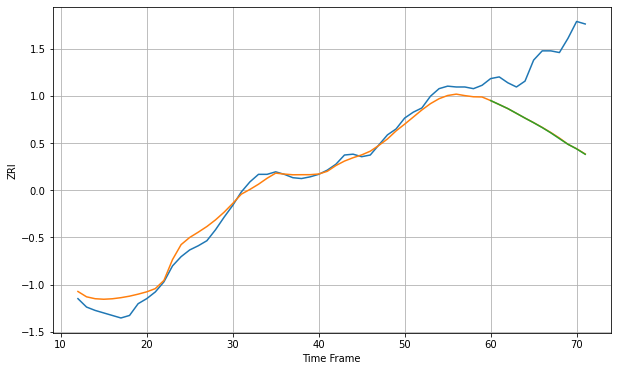

Wall time: 7.26 s
75067 10.136660612132074 92.26139214471617 92.45728534468505 [1186.82275688 1182.09625319 1177.27534128 1171.62947289 1165.94029247
 1160.46579893 1154.6687805  1148.37859277 1141.49480599 1134.75819645
 1129.31243457 1122.87806379]

Got an mse at 0.0025 in round 322 and stopped training

60 60 12


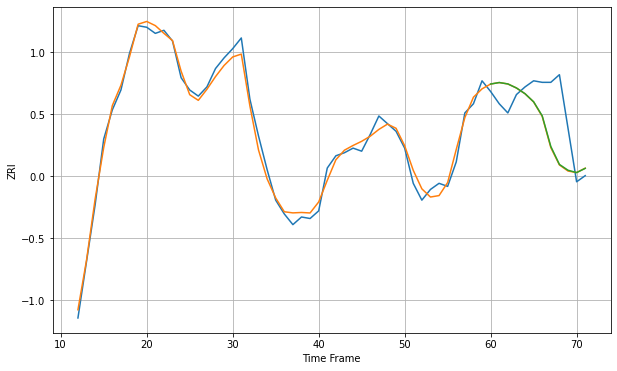

Wall time: 13.7 s
75070 4.954086423579459 24.910117175058094 24.650953684451387 [1565.8903503  1566.86417515 1565.95886157 1563.32621124 1559.57898708
 1554.29432408 1545.09887209 1525.08017041 1513.34153513 1509.55064178
 1508.0242913  1510.78032628]

Got an mse at 0.0025 in round 196 and stopped training

60 60 12


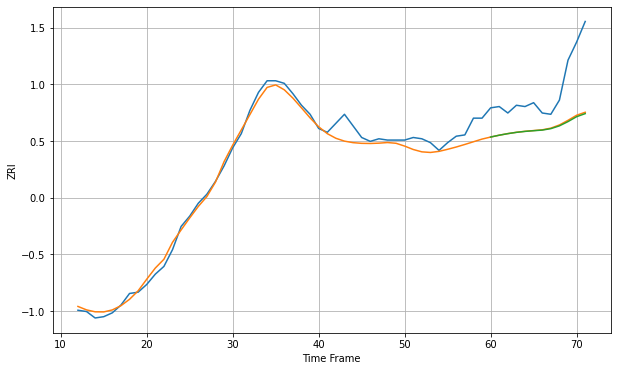

Wall time: 9.71 s
75074 6.689022844318627 33.60933852709053 34.131547973926786 [1235.35004052 1236.77085719 1237.98176312 1238.98624957 1239.72596041
 1240.26198334 1240.73713316 1241.85891041 1244.03128229 1247.32907108
 1251.13682564 1253.51040532]

Got an mse at 0.0025 in round 304 and stopped training

60 60 12


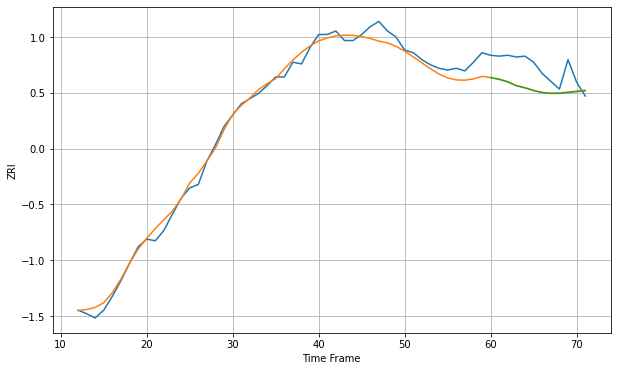

Wall time: 12.8 s
75081 9.089460207852992 25.897635643660635 26.032204493608322 [1271.25158819 1269.26389395 1266.29562933 1261.90735646 1259.39950549
 1256.24832654 1253.95631427 1252.97472811 1253.05525416 1254.0337243
 1255.08822749 1256.04735568]

Got an mse at 0.0024 in round 88 and stopped training

60 60 12


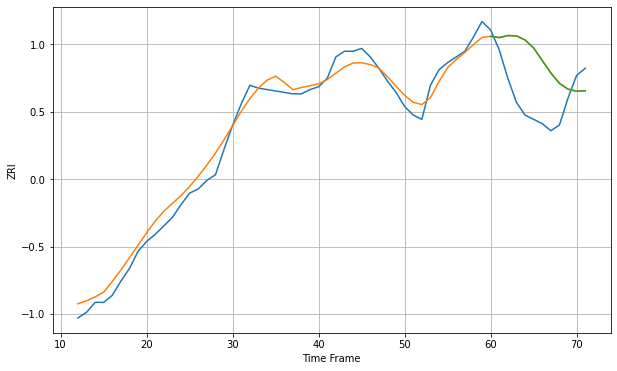

Wall time: 7.29 s
75093 7.5578009519751115 33.52877344192407 33.45047361439689 [1405.49265752 1404.64460825 1406.08197063 1405.86794523 1402.93388451
 1397.32654482 1388.39129834 1379.64190776 1372.30309526 1368.23523361
 1366.83227769 1367.14885632]
60 60 12


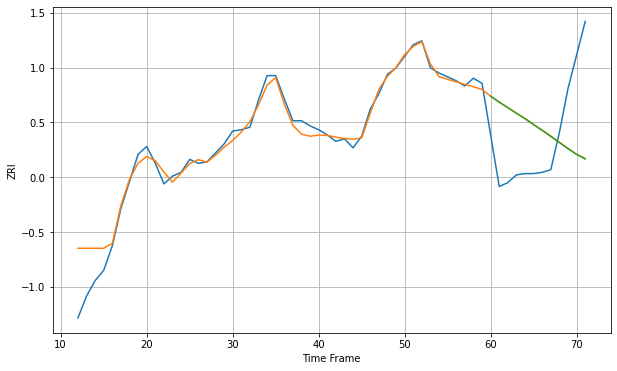

Wall time: 17.4 s
75201 11.197069272895943 54.28009620307755 54.29978947604951 [1668.02777643 1663.40952253 1659.13480959 1654.76873259 1650.59216758
 1645.94877229 1641.46931082 1636.84495738 1632.09167144 1627.3229295
 1622.92834008 1619.31226222]

Got an mse at 0.0025 in round 446 and stopped training

60 60 12


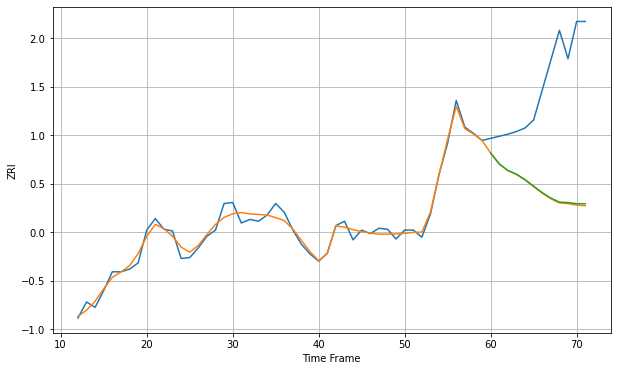

Wall time: 15.9 s
75202 6.6405713945089895 129.8667138899668 128.9606497234519 [1590.77308948 1578.64184253 1571.23576327 1567.03370244 1560.83371183
 1553.43525131 1546.12115766 1540.08614502 1535.47556233 1535.03005128
 1533.74309537 1533.67372813]

Got an mse at 0.0025 in round 105 and stopped training

60 60 12


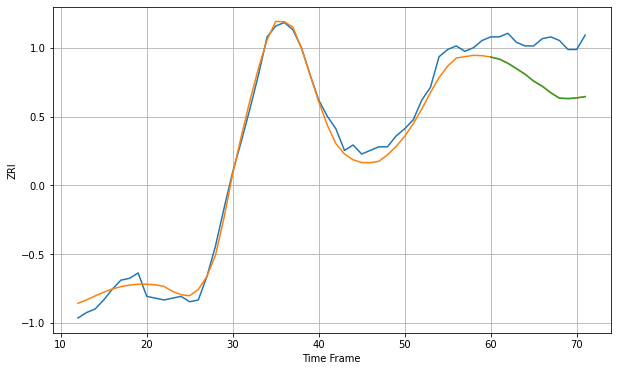

Wall time: 7.68 s
75204 5.298682552803694 23.596886097572042 23.651102895420248 [1498.84064757 1497.68921255 1495.38080083 1492.35685545 1489.29067275
 1485.4359672  1482.6155991  1478.9542379  1476.00025131 1475.7460865
 1476.12636758 1476.83382101]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


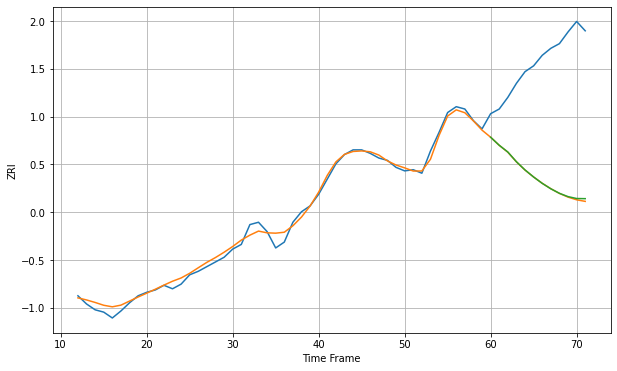

Wall time: 10.3 s
75206 4.293406670233479 104.85239811661539 104.38450998225103 [1361.82963412 1354.94211929 1349.15145596 1340.85154317 1333.79121356
 1327.75379377 1322.32372929 1317.66409586 1313.79362127 1310.9624221
 1309.33432931 1309.21248018]
60 60 12


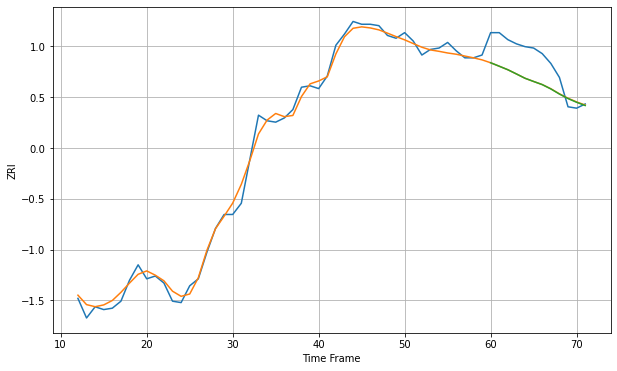

Wall time: 17 s
75214 4.932165391297672 18.394530555830965 18.40778494201307 [1213.47656763 1210.99873939 1208.48976994 1205.47015023 1202.38389073
 1200.09214092 1197.8655927  1194.76575179 1191.10171285 1187.8823223
 1185.21077518 1182.89547377]

Got an mse at 0.0025 in round 276 and stopped training

60 60 12


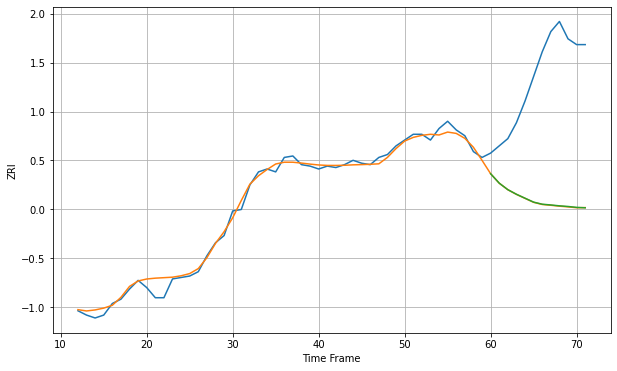

Wall time: 11.9 s
75219 4.075671709539613 90.12218911526126 89.98760304377174 [1430.71848788 1424.19814222 1419.71401319 1416.53023251 1413.80152832
 1411.0962129  1409.65541714 1409.13255646 1408.53196016 1408.08352436
 1407.46879996 1407.17456514]

Got an mse at 0.0025 in round 92 and stopped training

60 60 12


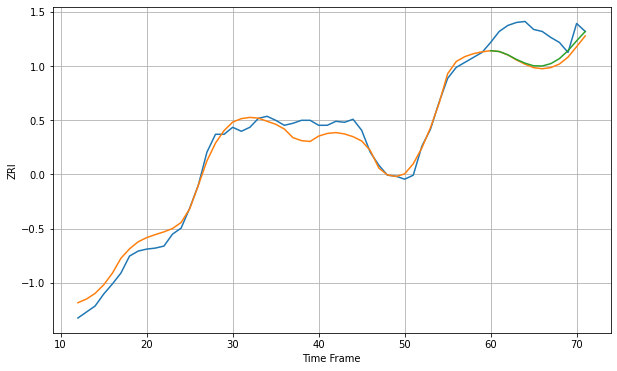

Wall time: 7.4 s
75235 9.601768911698219 28.000069251174875 26.18550815344655 [1450.71791724 1449.9112716  1446.62551646 1441.98823884 1438.2512895
 1435.57197753 1435.40757716 1437.76758978 1442.78560723 1450.75186766
 1460.60512746 1469.96102794]

Got an mse at 0.0025 in round 167 and stopped training

60 60 12


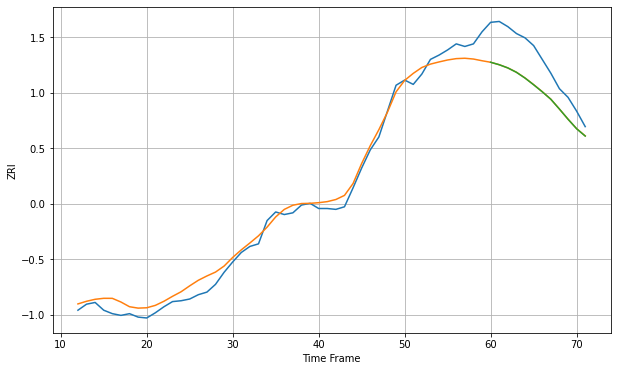

Wall time: 9.29 s
75243 11.046134214360519 37.88894003496741 37.9614465218362 [1123.67387606 1120.80580733 1117.08573901 1112.01373223 1105.317888
 1097.57320679 1089.44260397 1080.75321671 1069.38473131 1057.63544369
 1046.53673686 1038.05816087]

Got an mse at 0.0025 in round 133 and stopped training

60 60 12


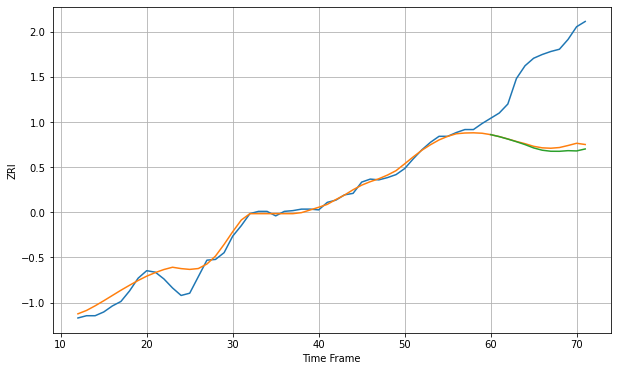

Wall time: 9.13 s
75244 10.281537642680512 113.77448037258263 117.82484391055304 [1362.24397739 1359.59534659 1356.34591222 1352.81581172 1348.96536988
 1344.55212226 1341.49310202 1340.09307522 1340.03872628 1340.8886812
 1340.52958753 1343.16492985]

Got an mse at 0.0025 in round 388 and stopped training

60 60 12


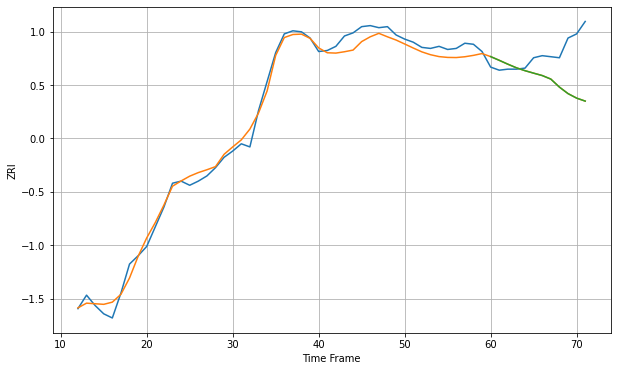

Wall time: 15.2 s
75248 7.867270683293771 34.977706025820275 34.9853473873897 [1273.10921552 1269.52821807 1265.79651544 1262.30674789 1259.52212244
 1257.14052982 1254.83412168 1251.42038334 1243.68193269 1237.41139075
 1233.05998845 1230.18967799]

Got an mse at 0.0025 in round 210 and stopped training

60 60 12


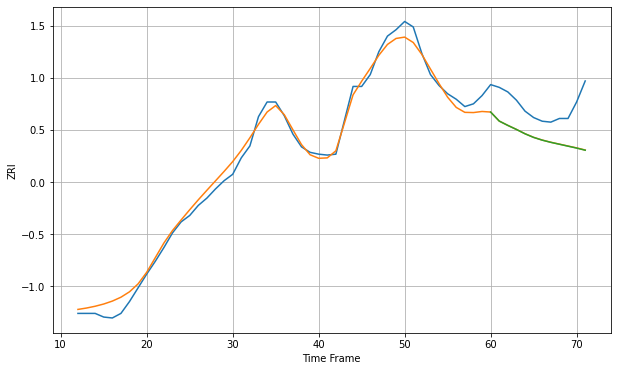

Wall time: 10.3 s
75287 8.685472733812306 37.08434114965528 37.185621698229504 [1138.02239402 1128.14954885 1123.41539976 1118.99273405 1114.25212023
 1110.29909915 1107.31222734 1104.90552556 1102.82344473 1100.73055599
 1098.64312886 1096.31495189]

Got an mse at 0.0025 in round 418 and stopped training

60 60 12


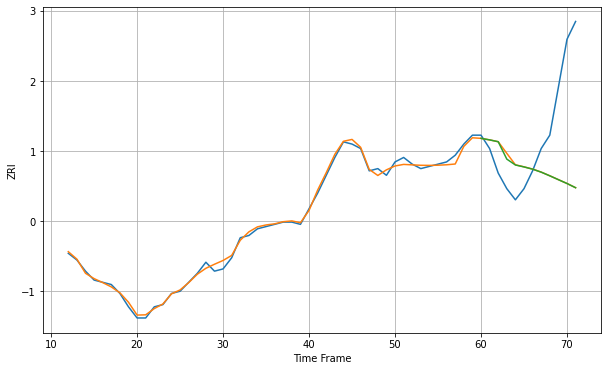

Wall time: 15.1 s
75703 1.5326769454769513 32.54746248637223 32.45440190250152 [907.56825987 906.88289164 906.05795357 898.25584906 895.62746507
 894.75174139 893.75144665 892.40900896 890.76470408 889.03493964
 887.31640354 885.42724809]

Got an mse at 0.0025 in round 98 and stopped training

60 60 12


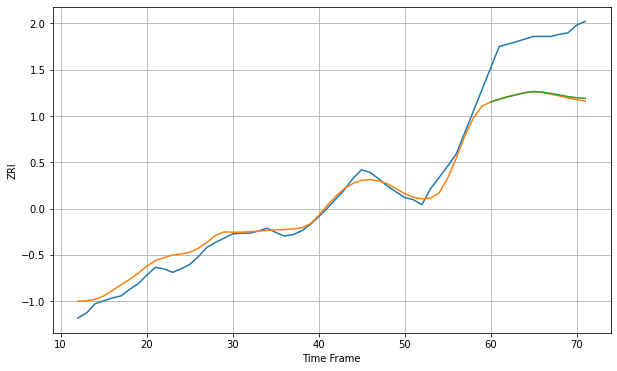

Wall time: 7.3 s
76006 11.395076419343484 82.82958100761864 81.7122325950629 [1005.92067455 1009.96550633 1013.3682824  1016.29903781 1019.14192932
 1020.63211291 1019.95484772 1017.97561269 1015.95826961 1013.65975288
 1011.92521025 1011.16014913]

Got an mse at 0.0024 in round 224 and stopped training

60 60 12


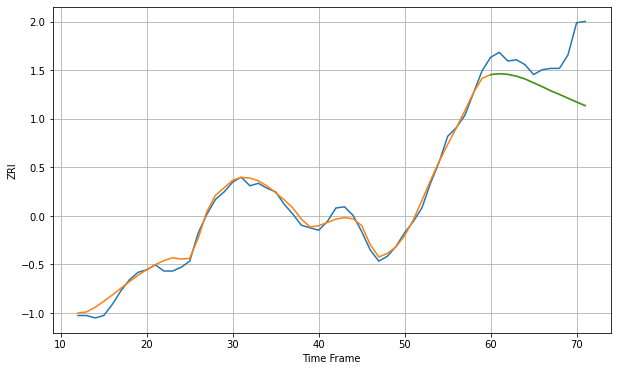

Wall time: 10.7 s
76010 4.706975581463667 31.473364574729615 31.557450223679908 [1077.94919018 1078.75472922 1078.19117299 1076.75857296 1074.46110252
 1071.37955756 1068.21788131 1064.85762798 1061.94375882 1058.81307697
 1055.69944674 1052.79907364]
60 60 12


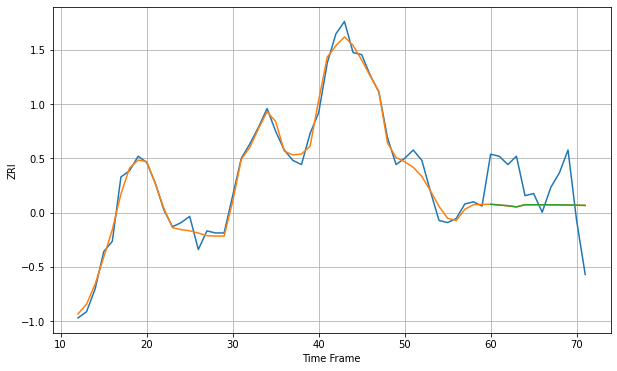

Wall time: 17 s
76012 3.9152961893538816 19.06923367977749 19.07027328032788 [1203.81876888 1203.48574597 1203.13061237 1202.57792318 1203.61267557
 1203.61444552 1203.60103309 1203.59037285 1203.56132791 1203.51456254
 1203.43348582 1203.28951199]

Got an mse at 0.0025 in round 299 and stopped training

60 60 12


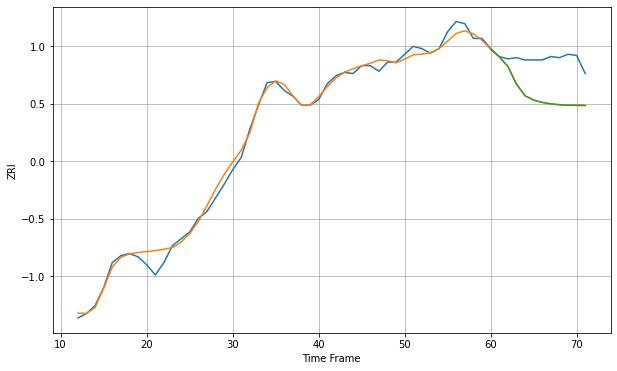

Wall time: 12.3 s
76015 5.767892827412689 32.160006520979984 32.309176189656206 [1279.58301221 1272.80151152 1264.3541712  1248.68912494 1238.33997988
 1234.52842651 1232.49094183 1231.10729473 1230.33939717 1229.9567025
 1229.83453186 1229.69440823]

Got an mse at 0.0025 in round 131 and stopped training

60 60 12


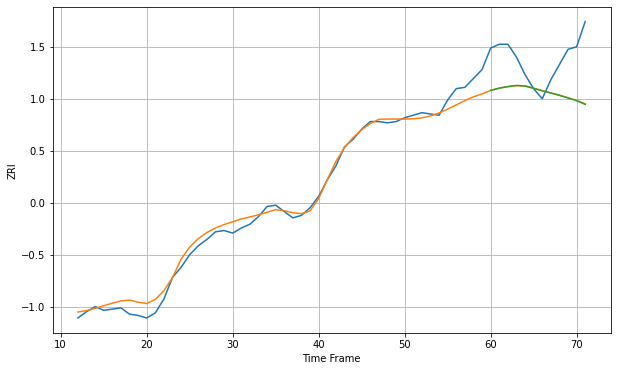

Wall time: 8.45 s
76017 6.41277654247857 31.922032547762555 32.042944410313396 [1040.59287064 1042.38956945 1043.59019033 1044.46765856 1044.06274943
 1042.23491938 1040.28230807 1038.51745421 1036.6968142  1034.62127422
 1032.47366216 1029.56436894]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


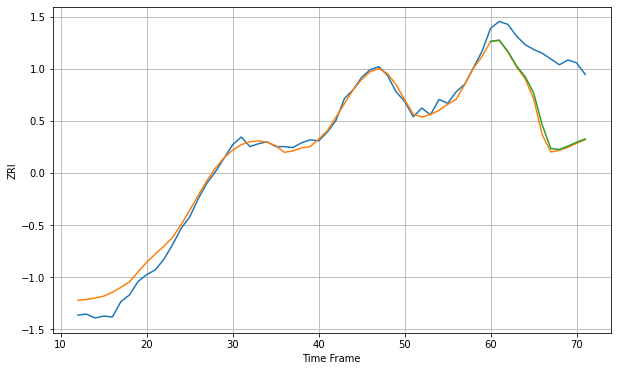

Wall time: 9.89 s
76039 9.076981976732055 64.82504431023332 62.36460815570892 [1286.27498114 1287.5965437  1275.91114186 1261.01928809 1249.9064283
 1232.69605451 1199.64405176 1174.96421727 1174.05079816 1177.59801491
 1181.51775077 1184.95315719]

Got an mse at 0.0025 in round 192 and stopped training

60 60 12


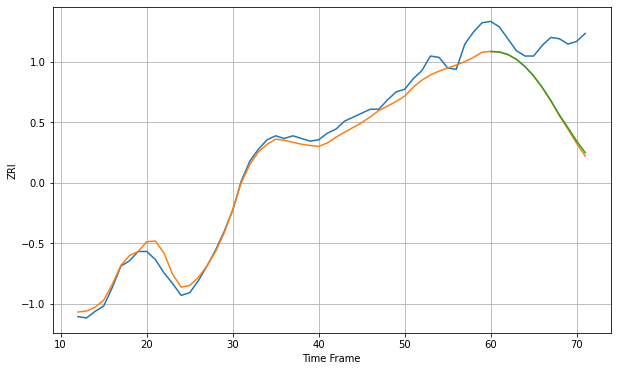

Wall time: 9.47 s
76051 7.4059698500020215 46.97628977336203 46.070060989545475 [1384.44564186 1384.08746495 1382.17494129 1378.57269788 1373.10870653
 1366.11344485 1357.48509589 1347.6373427  1336.71845663 1327.00276488
 1317.12279532 1308.30515172]

Got an mse at 0.0025 in round 188 and stopped training

60 60 12


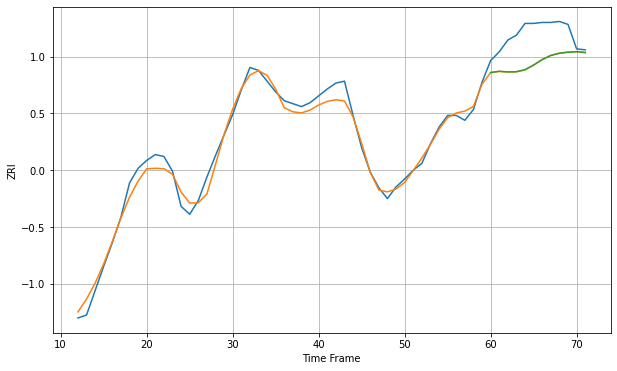

Wall time: 9.58 s
76107 8.49574500351216 30.92997671548951 30.99135924496924 [1320.81229858 1322.01944181 1321.44526556 1321.63127657 1323.64803347
 1328.43133992 1333.99702733 1338.21624745 1340.47948363 1341.55773673
 1342.14938659 1341.34718414]

Got an mse at 0.0025 in round 176 and stopped training

60 60 12


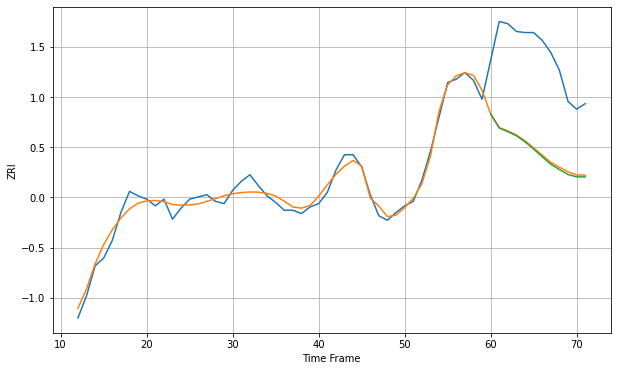

Wall time: 9.38 s
76108 6.562869440948065 86.37721214263554 87.53172128409707 [1106.75397105 1094.05345406 1090.74282984 1087.10111034 1081.62054228
 1075.14612993 1068.23320805 1061.40534599 1056.70206015 1052.221583
 1050.06044435 1050.04940765]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


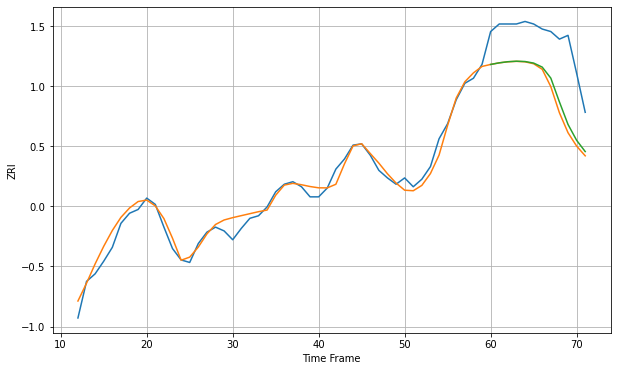

Wall time: 8.28 s
76116 6.443490325419147 43.04744896530051 39.674300955618136 [1178.94060403 1180.21104508 1181.10224478 1181.50384095 1181.24638012
 1180.01627366 1176.82974709 1168.08038935 1149.25393292 1131.38816104
 1118.82794388 1109.88577785]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


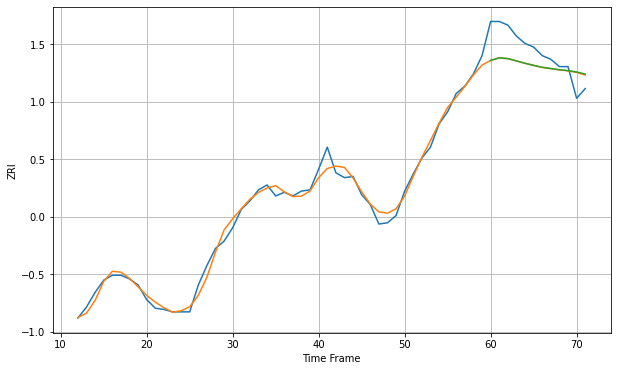

Wall time: 9.24 s
76132 5.292379860674502 18.955998692798303 19.01191278838016 [1293.05623594 1295.18382197 1294.56430327 1292.71067991 1290.72424594
 1289.04557086 1287.44862265 1286.42335301 1285.44102922 1284.72740378
 1283.61474595 1281.91748568]

Got an mse at 0.0025 in round 153 and stopped training

60 60 12


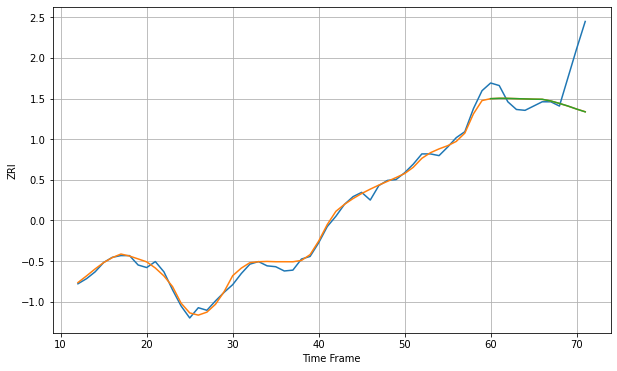

Wall time: 8.71 s
76133 5.233310269755726 39.00348059757512 39.03185520235932 [1048.65634045 1049.03901894 1048.9623492  1048.67947436 1048.36317263
 1048.06875972 1047.91462502 1045.9556249  1043.12274237 1040.02524939
 1036.49084892 1033.21673002]

Got an mse at 0.0025 in round 120 and stopped training

60 60 12


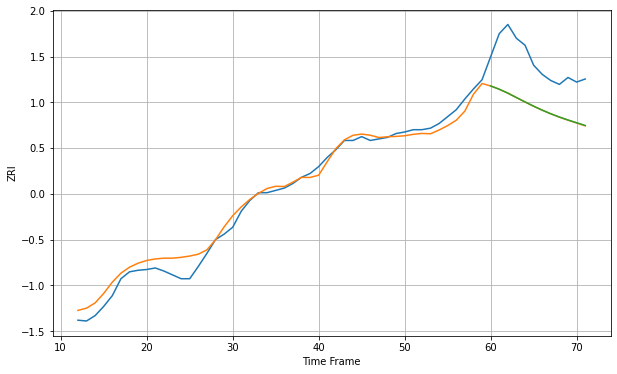

Wall time: 7.79 s
76137 11.189853247461013 60.86590416015771 60.75255669093776 [1267.97016348 1263.67781984 1258.62034906 1252.81821039 1247.18797685
 1241.62233963 1236.47288257 1231.75418655 1227.47395419 1223.63583785
 1220.09906046 1216.47369149]
60 60 12


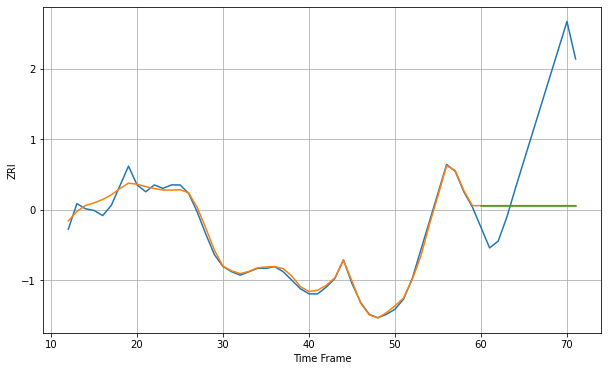

Wall time: 17 s
76522 2.9047682463173294 58.211850370965244 58.211850370965244 [607.83104623 607.83104623 607.83104623 607.83104623 607.83104623
 607.83104623 607.83104623 607.83104623 607.83104623 607.83104623
 607.83104623 607.83104623]
60 60 12


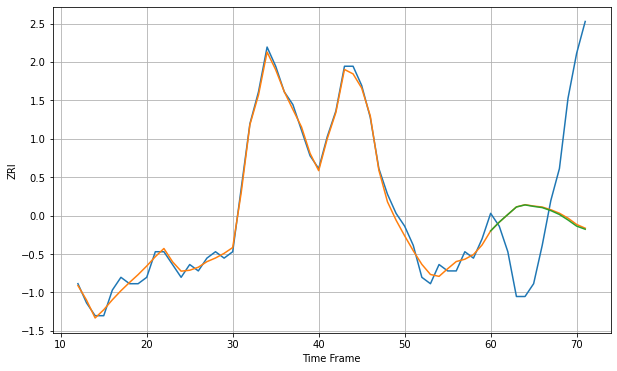

Wall time: 17.1 s
76543 0.9506152454701243 15.245282287859672 15.340680067874207 [591.25300619 592.62564016 593.82374242 594.99929444 595.32117756
 595.09039178 594.90020649 594.43159001 593.82420427 592.96387171
 592.00610348 591.51737022]

Got an mse at 0.0025 in round 437 and stopped training

60 60 12


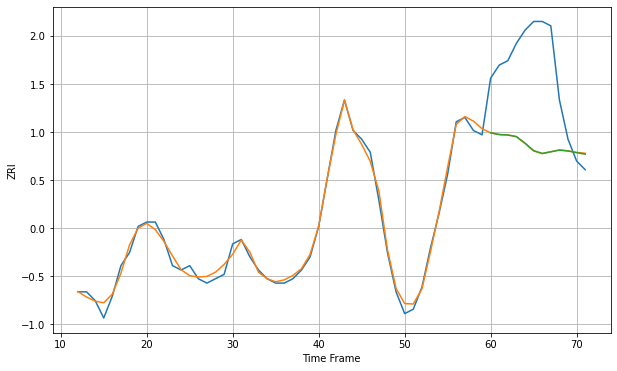

Wall time: 16.1 s
76549 1.30513357701651 19.63127207181854 19.61163283904976 [676.46369833 676.0654183  675.97114507 675.59323978 674.09409369
 672.37425579 671.71829166 672.11062535 672.51141635 672.29648744
 671.90698308 671.57505614]
60 60 12


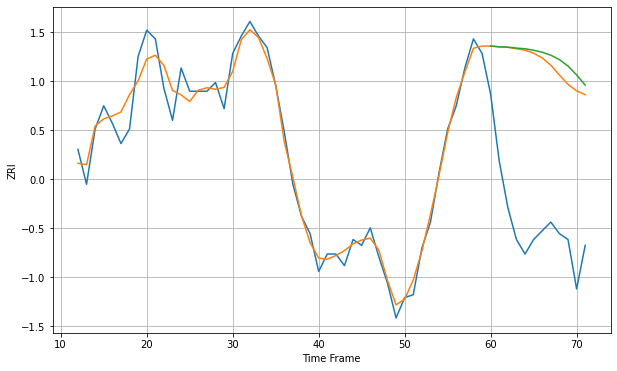

Wall time: 17.4 s
77004 4.852670690159621 56.1080654828644 58.51506961267902 [1414.55326551 1414.28057178 1414.16934502 1413.83950349 1413.61652221
 1413.09435617 1412.42139046 1411.40342799 1409.87658616 1407.66102047
 1404.6141278  1401.11168462]
60 60 12


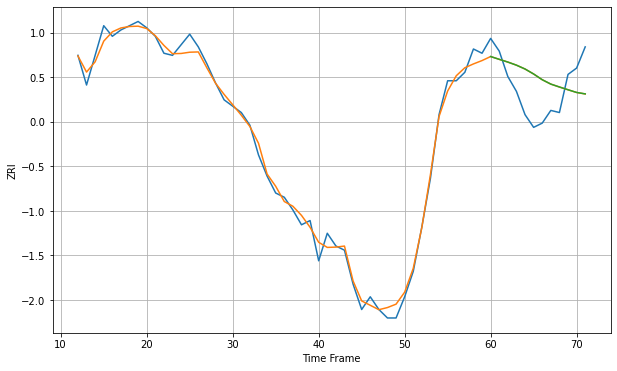

Wall time: 17.3 s
77006 3.6599629049405635 15.236549411939434 15.234370572610894 [1420.44233904 1419.11964909 1417.82851334 1416.36797587 1414.55365325
 1412.19968108 1409.4963344  1407.42942035 1406.06204949 1404.76036747
 1403.48813103 1402.8066699 ]
60 60 12


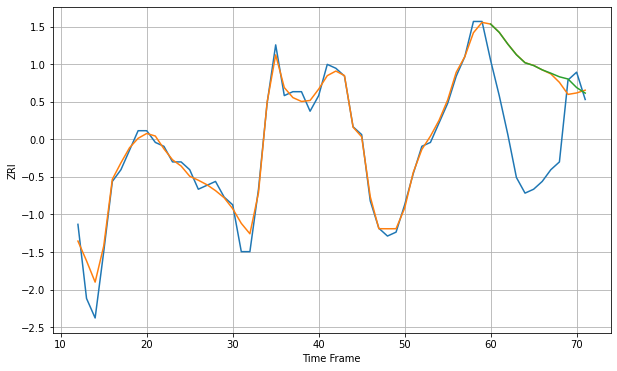

Wall time: 17.3 s
77007 2.732939263198823 22.15650667407137 22.218300748063577 [1494.33125019 1492.20818807 1489.19250003 1486.46875051 1484.40890997
 1483.7054649  1482.60016526 1481.74572655 1480.81526885 1480.25257477
 1478.05979276 1476.63571529]
60 60 12


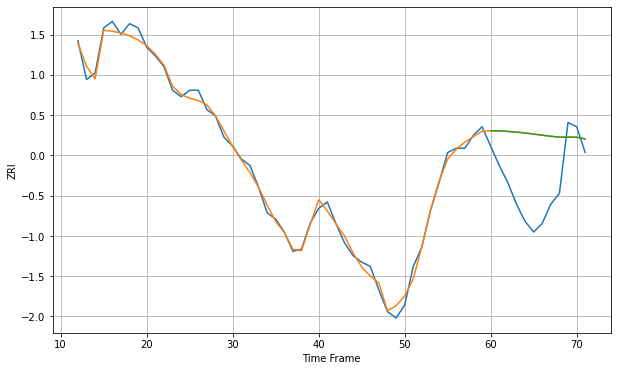

Wall time: 17.3 s
77019 2.8949084561408136 27.756934239512944 27.760765186576705 [1412.14900321 1412.05312409 1411.82901437 1411.51836264 1411.0825514
 1410.59925966 1410.09363019 1409.5839219  1409.1430242  1409.14380039
 1409.0819881  1408.31318462]
60 60 12


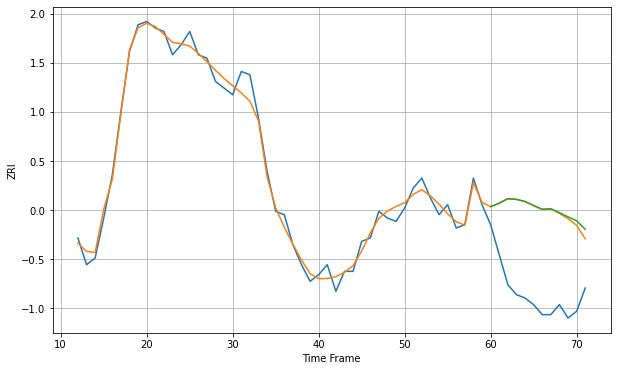

Wall time: 17.4 s
77027 2.683407764532436 25.827282075768267 26.169281675114856 [1437.41500308 1438.45622067 1439.79123931 1439.59466835 1438.96155458
 1437.75611768 1436.6207494  1436.78305142 1435.62464377 1434.36000582
 1433.16256567 1430.60759321]

Got an mse at 0.0025 in round 438 and stopped training

60 60 12


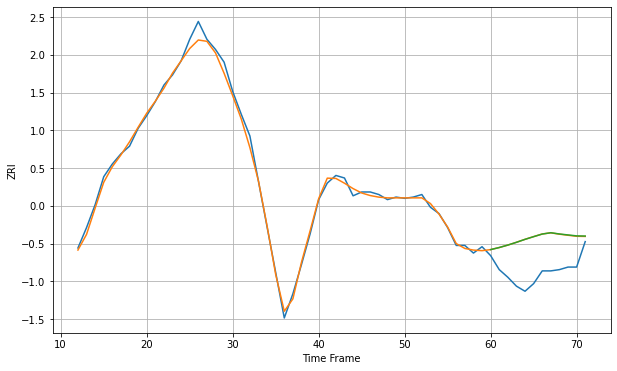

Wall time: 16 s
77042 3.888734932013992 27.258803661539815 27.31636756324964 [1168.7259139  1170.35979905 1172.28148545 1174.45688728 1176.78318725
 1178.89996212 1180.94926557 1181.98717563 1181.00831574 1180.25003477
 1179.51011614 1179.37466831]
60 60 12


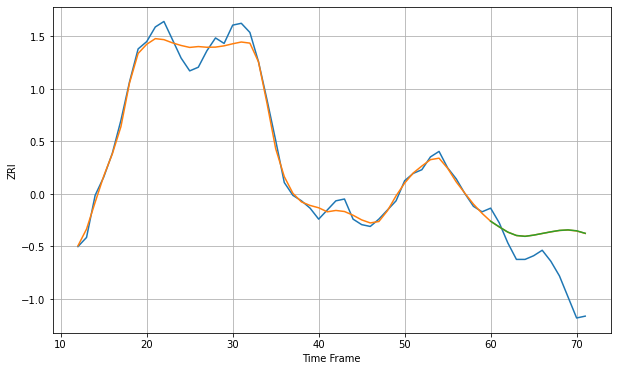

Wall time: 17.3 s
77054 4.596937396813331 24.397699255970025 24.43696487197274 [1246.84565787 1243.77367119 1240.91438337 1239.06363944 1238.6028847
 1239.25937326 1240.16929212 1241.06907662 1241.8448864  1242.12456193
 1241.6341754  1240.26217356]
60 60 12


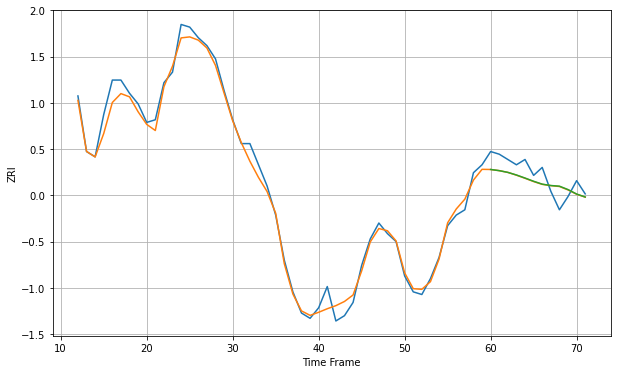

Wall time: 17.1 s
77056 3.2547438385858785 5.296541804014769 5.2853760535332395 [1449.22207799 1448.78424586 1448.12739741 1447.14385018 1445.98818748
 1444.77103836 1443.68573065 1443.16359578 1442.91860029 1441.63466537
 1439.9523878  1438.82177421]

Got an mse at 0.0025 in round 481 and stopped training

60 60 12


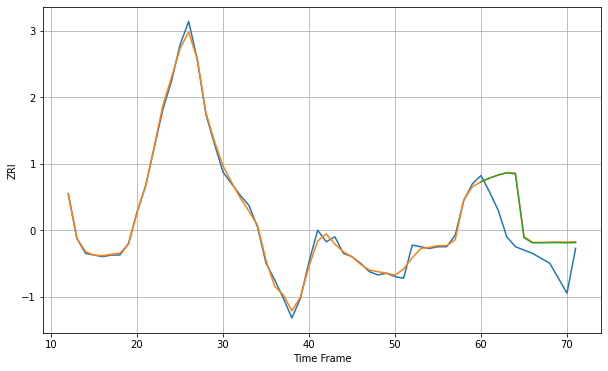

Wall time: 16.1 s
77057 2.6341002649798937 22.03853564245004 21.79896208674995 [1436.20418284 1438.48259746 1440.28697973 1441.6408411  1440.94534608
 1402.4113806  1399.40664053 1399.40471063 1399.48759797 1399.51020003
 1399.38793644 1399.47175221]
60 60 12


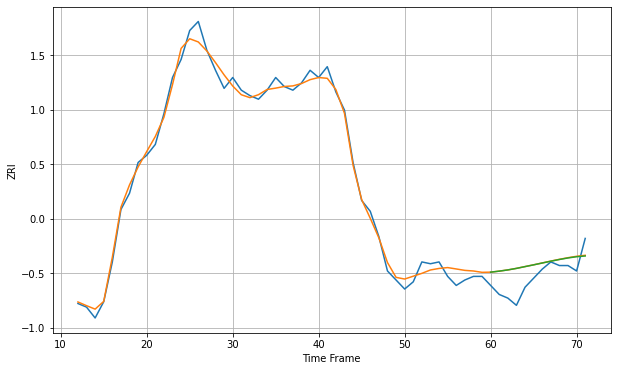

Wall time: 16.5 s
77063 4.108758528691946 10.255330943795768 10.255530966269788 [1269.34404181 1269.90252707 1270.58047422 1271.42585484 1272.4123572
 1273.38076912 1274.39730936 1275.40075872 1276.35104283 1277.19889684
 1277.87792134 1278.28443148]

Got an mse at 0.0025 in round 205 and stopped training

60 60 12


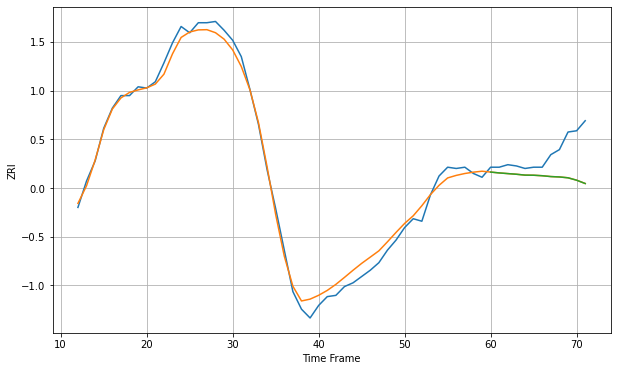

Wall time: 9.95 s
77077 6.481262022902298 23.07270236560167 23.090724475853317 [1186.1271524  1185.44788446 1184.91343075 1184.38598399 1183.70944763
 1183.60975003 1183.2158668  1182.55010795 1182.24161155 1181.56163482
 1179.65089626 1177.00389034]
60 60 12


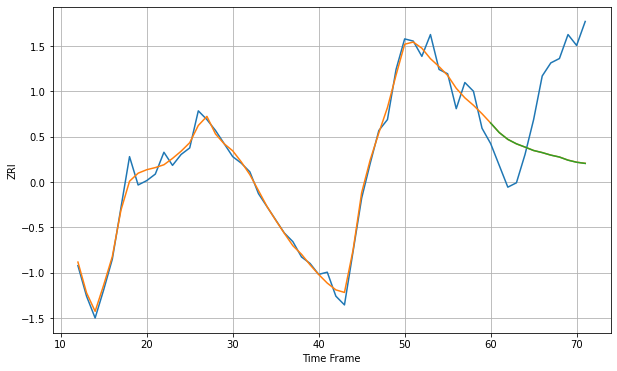

Wall time: 16.6 s
77090 4.109284960101935 37.427283758932646 37.442457040479724 [966.42752187 962.04839224 958.92090956 956.8806041  955.38354299
 953.81366779 952.85792191 951.69522564 950.81884155 949.38455123
 948.42893834 947.88793599]
60 60 12


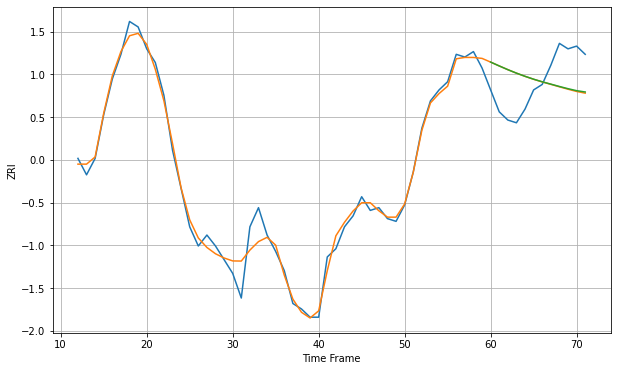

Wall time: 16.5 s
77098 3.708600557863317 13.54848326396795 13.453563104206973 [1502.16070763 1500.75669792 1499.39913484 1498.13282825 1496.9750436
 1495.91739996 1494.96979239 1494.11648508 1493.25898347 1492.44699364
 1491.7269046  1491.24603334]

Got an mse at 0.0025 in round 222 and stopped training

60 60 12


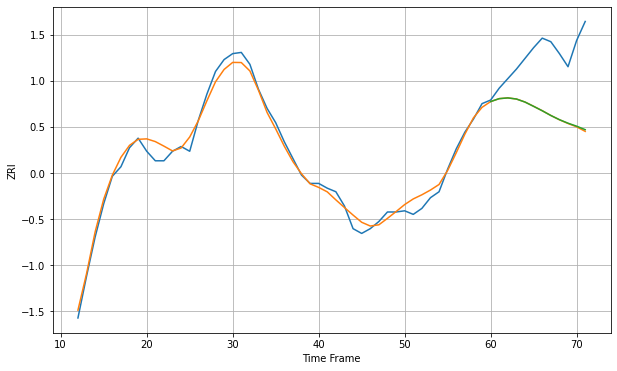

Wall time: 10.4 s
77380 6.403223987437518 51.17098850615067 50.87619104563272 [1415.73395436 1418.18536238 1418.8027642  1417.86701686 1415.3042902
 1411.71073029 1408.01885337 1404.0520429  1400.53794866 1397.57539098
 1395.07424356 1392.13405584]

Got an mse at 0.0025 in round 226 and stopped training

60 60 12


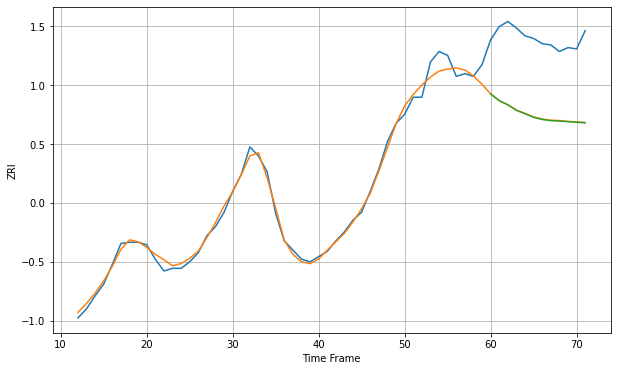

Wall time: 10.6 s
77429 5.098187442576829 58.294950926344384 58.51398936246353 [1189.56389702 1184.36719643 1181.20783405 1176.97327936 1174.34520992
 1171.60460146 1169.96924264 1169.03187619 1168.81435392 1168.2141255
 1167.87972528 1167.40533772]
60 60 12


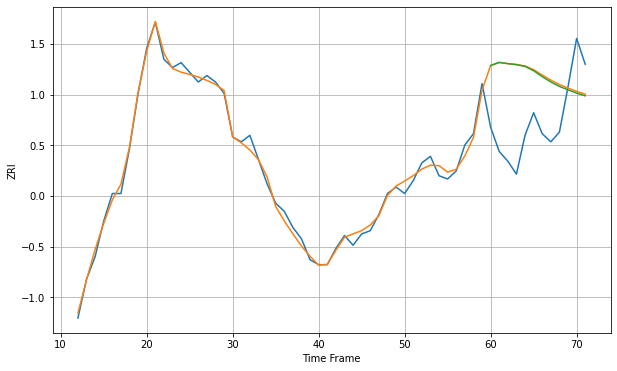

Wall time: 17.2 s
77494 3.681151922905268 41.1826667206902 41.016636556355685 [1293.22089964 1295.16008957 1294.38189935 1293.76795734 1292.64460713
 1289.99272834 1286.34962507 1283.03925207 1280.26705587 1278.16606594
 1276.13978041 1274.45926386]

Got an mse at 0.0024 in round 135 and stopped training

60 60 12


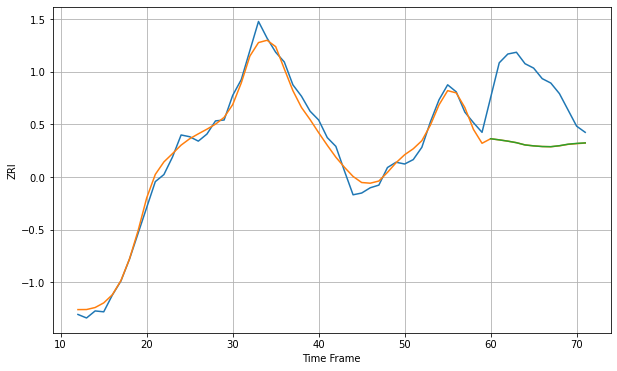

Wall time: 8.6 s
77550 8.925752800755443 72.65742546506694 72.62910811855627 [1132.71752085 1131.4286893  1129.96881137 1128.22284989 1125.6838358
 1124.59725979 1123.86667021 1123.67880464 1124.79115008 1126.50202198
 1127.39953432 1127.98911043]

Got an mse at 0.0025 in round 195 and stopped training

60 60 12


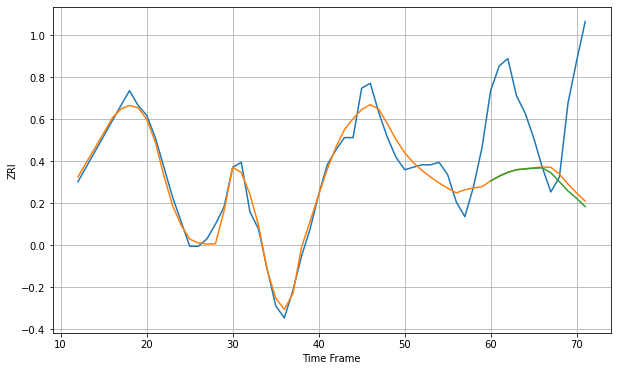

Wall time: 9.88 s
77584 4.8983042921589375 36.879312796037304 37.70374323435694 [1404.46599036 1406.35650592 1407.91241889 1408.99571192 1409.32337644
 1409.61027156 1409.75196084 1407.81387207 1404.16919274 1400.38013306
 1397.41541085 1394.05906917]

Got an mse at 0.0025 in round 411 and stopped training

60 60 12


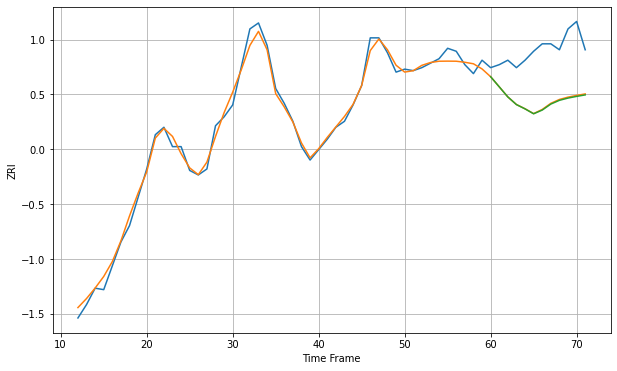

Wall time: 15 s
77598 4.450795816506854 34.61057089377406 34.96726913666672 [1114.91788467 1108.14375862 1101.35525018 1096.21391762 1093.33128053
 1090.03900046 1092.52753812 1096.55492882 1099.07566992 1100.58513423
 1101.7083772  1102.71661016]
60 60 12


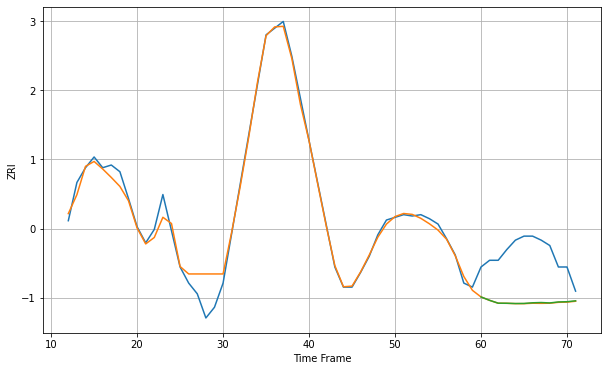

Wall time: 16.4 s
77840 7.675958229107675 37.41127299420605 37.21924429819414 [846.67063038 844.15435711 842.02096477 841.96714125 841.76789447
 841.83027897 842.32206178 842.50805539 842.21219929 842.94660583
 843.12023691 843.78850933]

Got an mse at 0.0024 in round 341 and stopped training

60 60 12


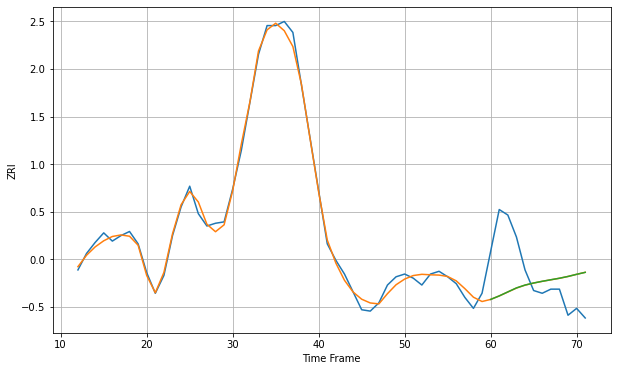

Wall time: 12.9 s
77845 4.2003553162882685 32.37023817105443 32.34209878825637 [958.50920348 961.07743225 963.99673409 966.89593927 968.97437321
 970.48332042 971.7265844  972.84282348 973.94429285 975.25516884
 976.79509667 978.23524979]

Got an mse at 0.0024 in round 259 and stopped training

60 60 12


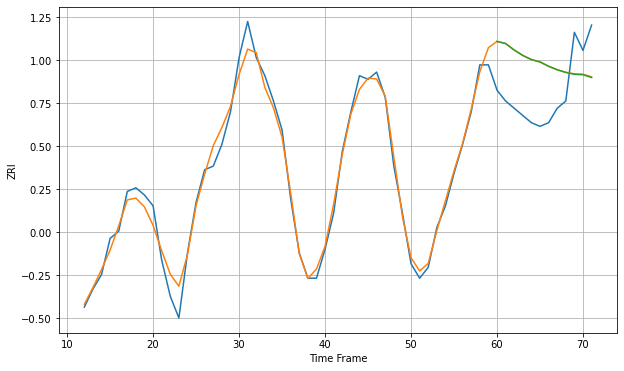

Wall time: 10.6 s
78130 2.9876389997101165 14.120476158049604 14.14455032430415 [1159.49291553 1158.89146999 1157.08786906 1155.5903832  1154.44537396
 1153.80326014 1152.62087347 1151.64992933 1150.90636244 1150.37964454
 1150.25919038 1149.49310014]
60 60 12


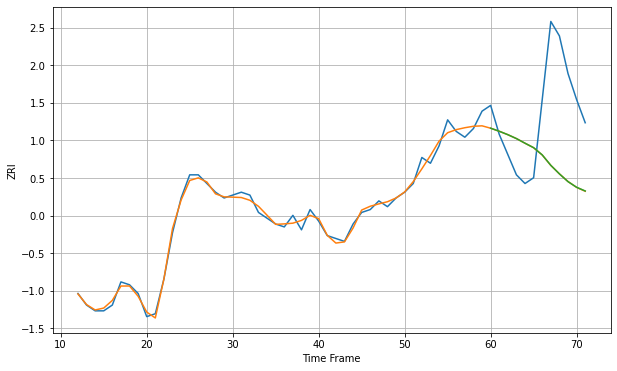

Wall time: 16.9 s
78201 1.7642998242421126 26.698705766305356 26.69072762943105 [884.11310955 883.05613378 881.87565007 880.52748699 878.9237642
 877.38328286 874.88510211 871.27861579 868.32743102 865.6431048
 863.70303933 862.42433619]
60 60 12


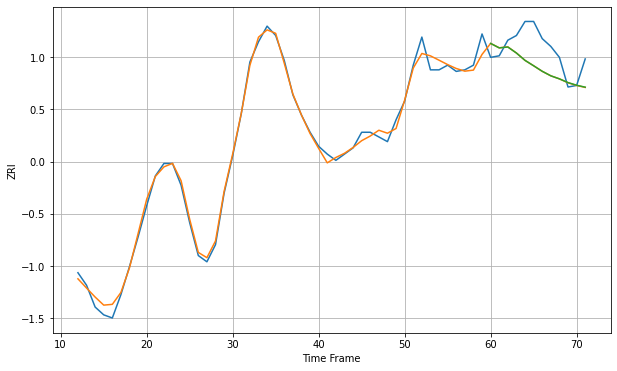

Wall time: 17.3 s
78209 4.158962898685213 15.817998872740409 15.80081827555413 [1260.93336608 1258.05410718 1258.64501932 1254.7749805  1250.0641075
 1246.61594312 1243.07205899 1240.17612125 1238.21607214 1235.84785882
 1234.14751706 1232.89544048]
60 60 12


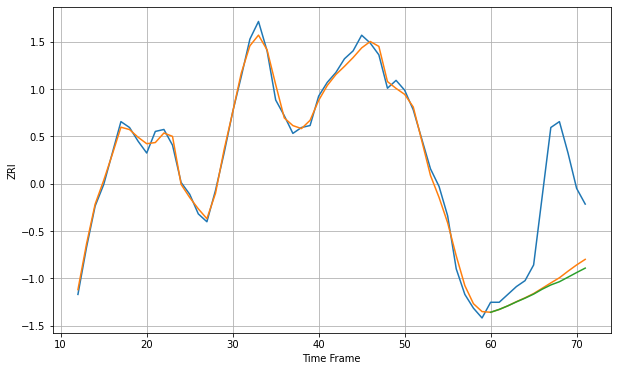

Wall time: 17.1 s
78210 3.3510936280856103 41.97259153753942 43.44564659097924 [932.90592172 934.34639614 936.16422978 938.20343299 940.08909021
 942.15177282 944.66072553 946.81964397 948.4635534  950.78028253
 953.12641822 955.39156572]
60 60 12


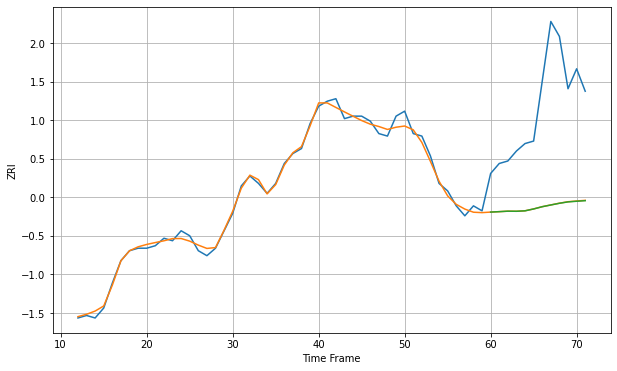

Wall time: 16.4 s
78212 1.9331322177314116 43.10462037646281 43.14442050792524 [893.4972247  893.67171759 893.858671   893.81996486 894.00472895
 894.75127413 895.65305624 896.34711676 897.02809597 897.59032079
 897.84316121 898.0761751 ]
60 60 12


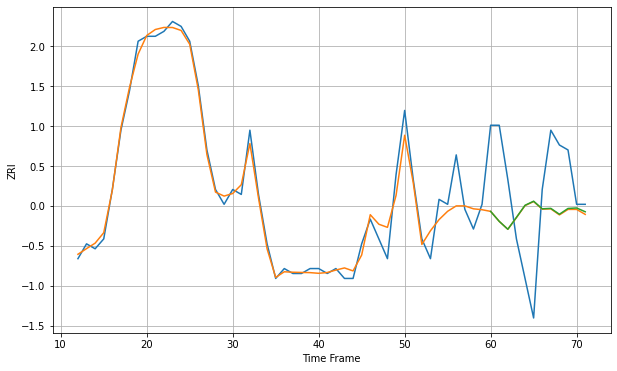

Wall time: 16.6 s
78213 2.5789829906350294 13.519707373921921 13.491527876708837 [921.56995433 919.5498365  917.95253426 920.35541545 922.79903882
 923.62977316 922.09396631 922.17761383 920.99081077 922.16056924
 922.26196726 921.49587221]
60 60 12


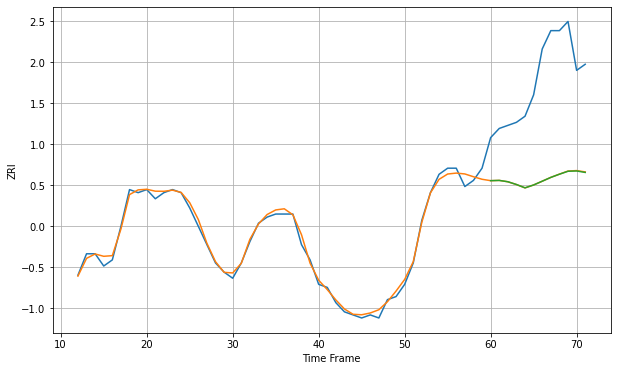

Wall time: 16.9 s
78216 1.5431290362423211 33.84960614989004 33.88355490106324 [970.91843792 971.00454126 970.56692703 969.66341687 968.5773477
 969.51343192 970.74348888 971.98766894 973.0298992  973.99828107
 974.09380689 973.61514006]

Got an mse at 0.0024 in round 399 and stopped training

60 60 12


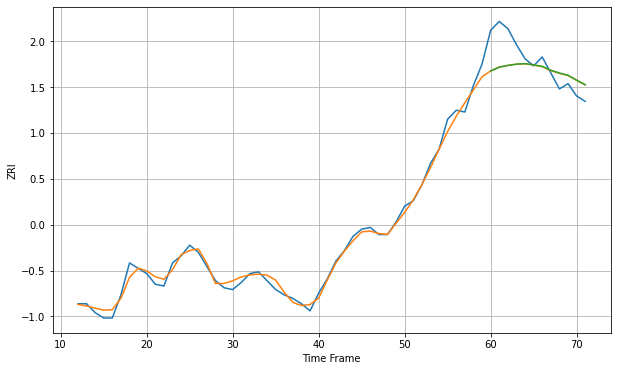

Wall time: 14.7 s
78229 3.1376620300560387 13.038196451728767 13.062423611194225 [1040.11689623 1042.24025889 1043.25750735 1043.94417562 1044.2350065
 1043.58801822 1042.71608565 1040.53517393 1038.95652239 1037.71696724
 1034.9426707  1032.33445638]
60 60 12


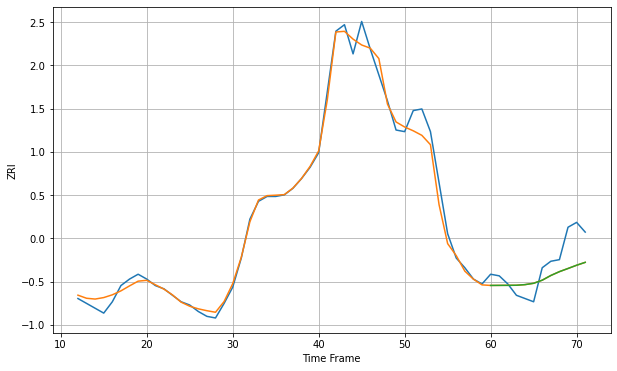

Wall time: 17.2 s
78233 5.461774041708113 13.584180675291 13.575879468936998 [950.08471225 950.1184472  950.14982951 950.19807389 950.5840472
 951.4078061  953.32071034 956.22423877 958.5892071  960.54609159
 962.55376294 964.34344292]

Got an mse at 0.0025 in round 363 and stopped training

60 60 12


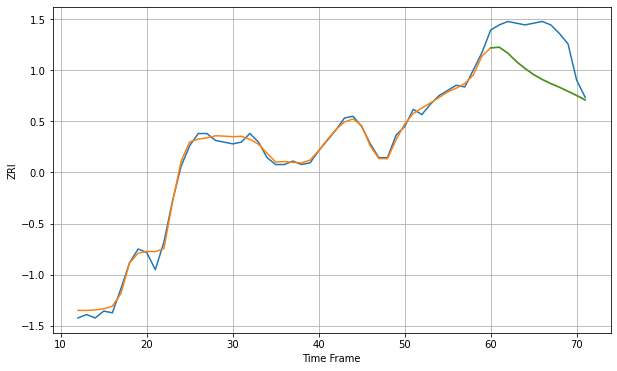

Wall time: 13.7 s
78240 2.77741842914056 23.692529572302522 23.68520238287701 [1102.69248929 1103.04419033 1099.643404   1094.71201573 1090.6984281
 1087.196825   1084.33653602 1081.96958297 1079.86539238 1077.52957185
 1075.14696562 1072.59010686]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


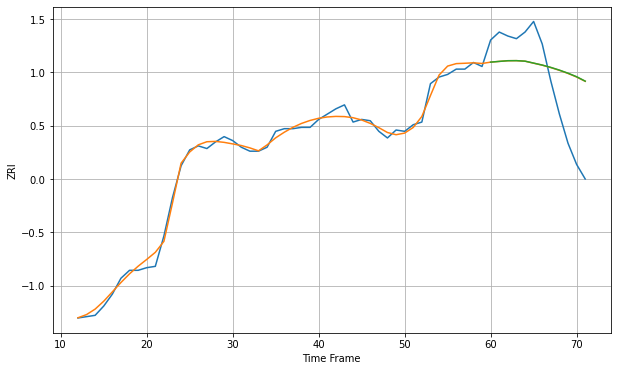

Wall time: 10.8 s
78249 3.9460747739847997 37.54660014884405 37.62312402272561 [1136.27330036 1136.83283699 1137.34671844 1137.40273258 1137.01455465
 1135.54494837 1134.07214765 1132.2885927  1130.24162598 1127.9164806
 1125.26200849 1121.91392732]

Got an mse at 0.0024 in round 427 and stopped training

60 60 12


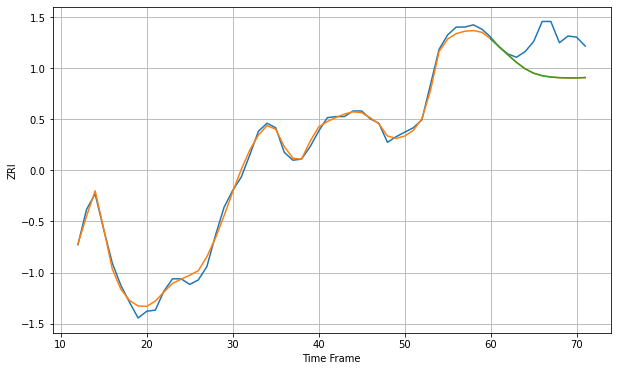

Wall time: 15.5 s
78256 4.404855330205363 29.416595275736803 29.38529076868387 [1232.39335423 1225.47629733 1218.25838656 1211.47375704 1205.7499626
 1201.77646845 1199.50990666 1198.34402117 1197.77192151 1197.57005096
 1197.56660792 1197.92196697]

Got an mse at 0.0025 in round 357 and stopped training

60 60 12


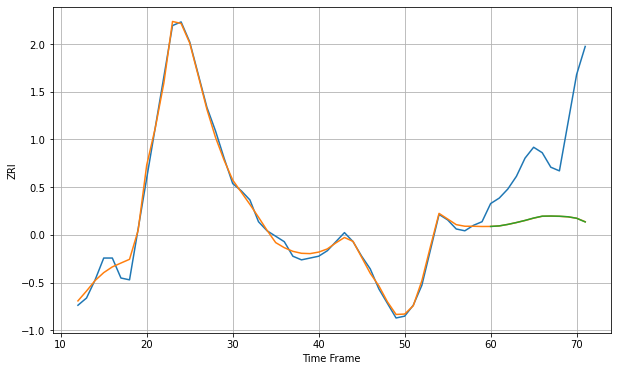

Wall time: 13.4 s
78521 3.2790805690200293 45.603572147100294 45.60044060355178 [749.39741453 749.69770487 750.51996766 751.55738261 752.7119689
 754.01912649 755.06200089 755.13178409 755.02346812 754.72156014
 753.90537395 751.88487628]

Got an mse at 0.0025 in round 82 and stopped training

60 60 12


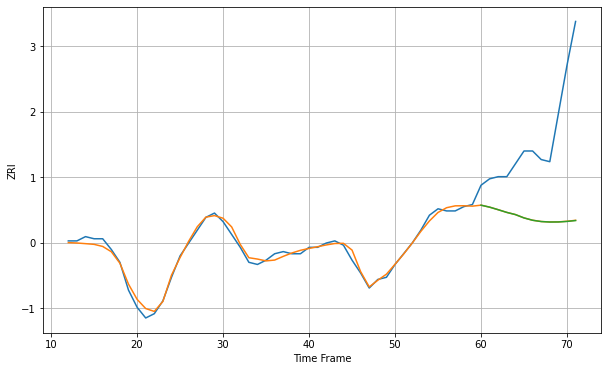

Wall time: 6.83 s
78550 1.9015404891979188 42.31329511864144 42.35311056889063 [767.69104693 766.76874331 765.56962107 764.31011017 763.29504255
 761.73723003 760.64180653 760.03899718 759.81963795 759.84605161
 760.09623976 760.51038655]

Got an mse at 0.0025 in round 280 and stopped training

60 60 12


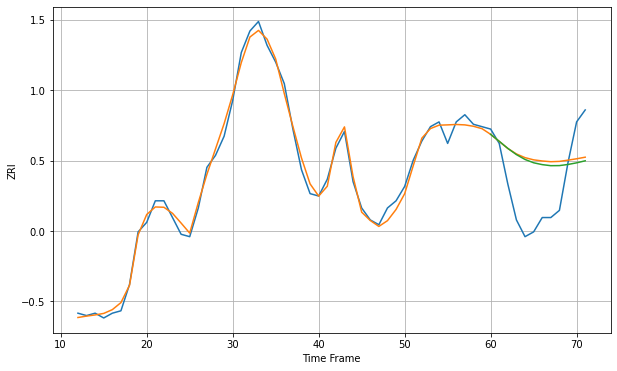

Wall time: 11.2 s
78613 2.8902417541871026 20.702247463155693 20.22630536509383 [1295.80032438 1292.87987313 1289.91498115 1287.31908878 1285.28834032
 1283.9028618  1283.13229696 1282.68701081 1282.72553652 1283.19907969
 1283.87690795 1284.73325834]

Got an mse at 0.0024 in round 286 and stopped training

60 60 12


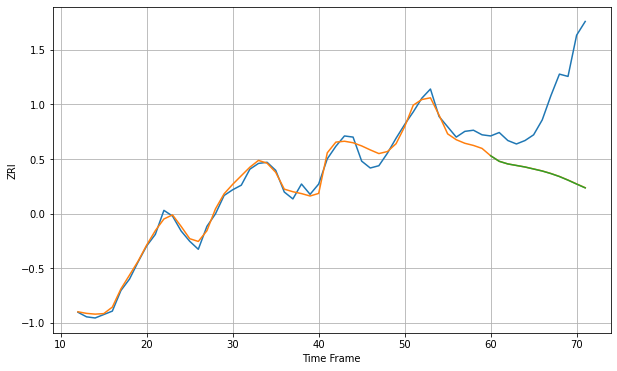

Wall time: 11.9 s
78660 6.002295092264492 72.94834700397229 73.01410753944566 [1269.7047404  1264.84660067 1262.55518186 1261.21140031 1259.86165877
 1258.12287082 1256.37190166 1254.15922392 1251.54557293 1248.39427693
 1244.98981141 1241.6256805 ]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


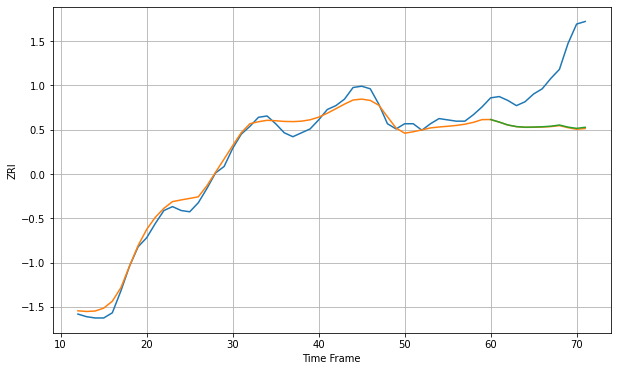

Wall time: 9.73 s
78664 5.673832365869775 44.86299302811189 44.475103143555984 [1157.26108785 1155.30409605 1153.06795713 1151.82258902 1151.33430673
 1151.4395624  1151.67499395 1152.10460283 1153.02758367 1151.40554054
 1150.44709606 1151.274716  ]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


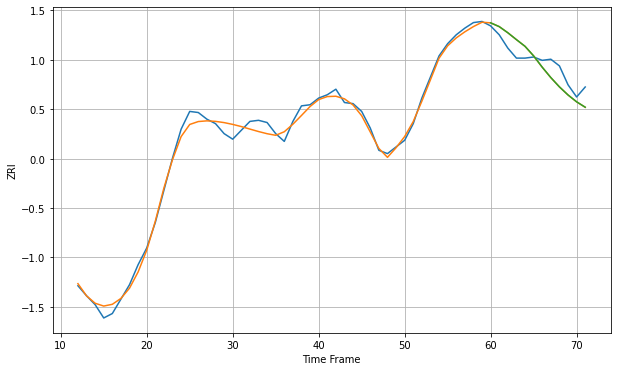

Wall time: 9.53 s
78666 5.3567894726156435 12.080084960586479 12.061813682875908 [1148.7618519  1145.35046449 1139.83827145 1133.64541876 1127.62465347
 1119.01870317 1108.82840892 1099.4829292  1091.11947114 1083.83729383
 1077.6605375  1072.79176988]
60 60 12


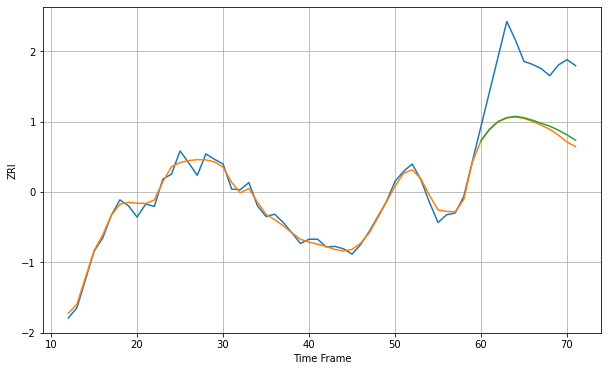

Wall time: 16.3 s
78701 8.912855436889787 110.28919222983482 106.28699836857913 [2200.14107265 2219.44250693 2232.28582743 2238.71340638 2240.89726947
 2238.67712399 2234.42159558 2229.27591228 2224.54421334 2217.74420601
 2209.9700669  2201.01861174]

Got an mse at 0.0025 in round 82 and stopped training

60 60 12


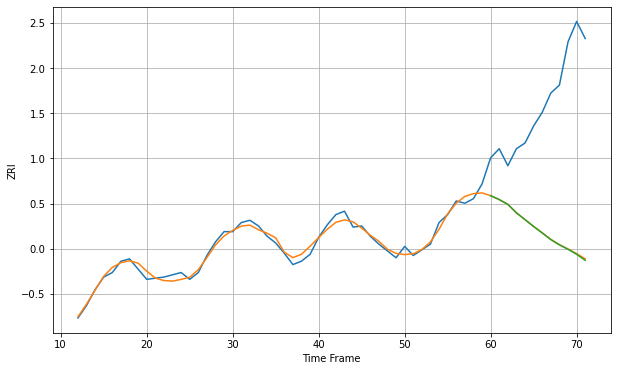

Wall time: 6.85 s
78702 4.079118527264075 122.46417869265689 122.81000277442152 [1596.6555107  1593.20031928 1589.02624242 1581.55513607 1575.5697084
 1569.48769568 1563.83575658 1557.97311202 1553.37924131 1549.45598417
 1545.01915089 1539.77004452]

Got an mse at 0.0025 in round 318 and stopped training

60 60 12


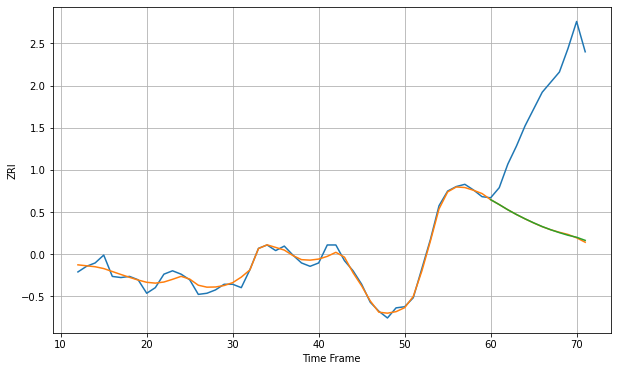

Wall time: 12.6 s
78703 4.417731950369563 118.32139111627424 118.15293467881278 [1811.34573558 1806.96532615 1802.33789368 1798.14033915 1794.29087552
 1790.71652654 1787.3896572  1784.52286308 1781.96238678 1779.64820603
 1777.86103002 1775.09159158]

Got an mse at 0.0024 in round 414 and stopped training

60 60 12


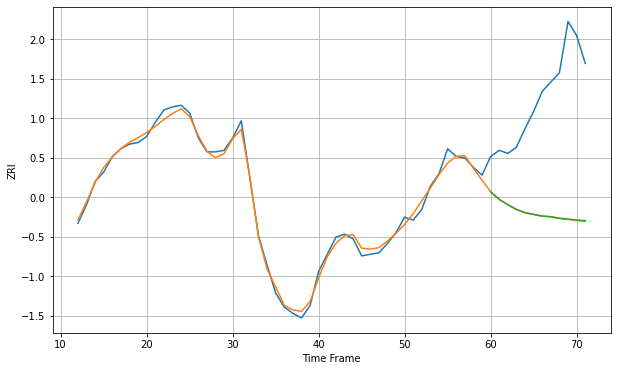

Wall time: 14.8 s
78704 3.1436218761553456 79.1707251161305 79.01884787123478 [1509.27509715 1504.35838922 1500.98799581 1497.92027877 1495.87216432
 1494.71865397 1493.65906956 1493.27611481 1492.24769566 1491.68483813
 1491.05542638 1490.66512343]

Got an mse at 0.0025 in round 351 and stopped training

60 60 12


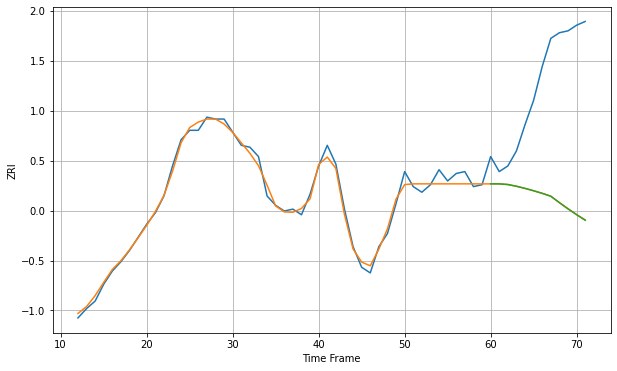

Wall time: 13.6 s
78705 3.0385353167677662 67.31753325613826 67.35356266159432 [1526.4701783  1526.4701783  1526.11409082 1525.18017346 1524.05453431
 1522.78225551 1521.4253969  1519.87124331 1516.45061868 1513.15978204
 1510.0346887  1507.05998971]

Got an mse at 0.0025 in round 213 and stopped training

60 60 12


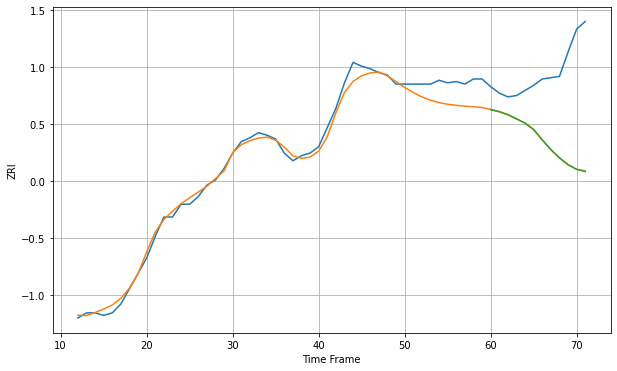

Wall time: 10.1 s
78728 8.183796510170698 61.808102603290564 61.89428367090792 [1206.08559815 1204.4292543  1202.06086594 1198.83550674 1195.48210283
 1190.45508105 1182.33553643 1174.71480716 1168.26049528 1162.94680296
 1159.29588346 1157.62101621]

Got an mse at 0.0025 in round 262 and stopped training

60 60 12


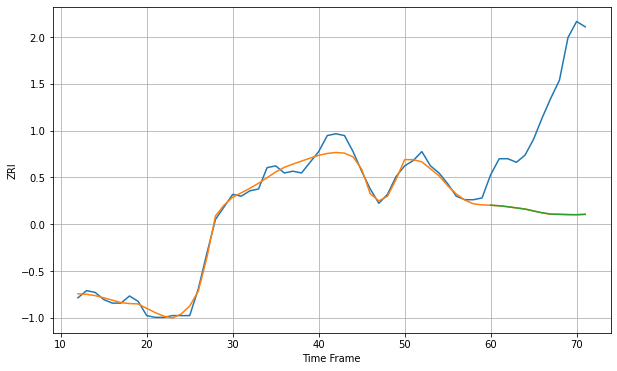

Wall time: 11.1 s
78729 3.6823782842484385 64.7843364704742 64.74945231071862 [1202.93110593 1202.60811328 1202.07391987 1201.41708347 1200.77405866
 1199.70473552 1198.67750851 1197.93591356 1197.82219982 1197.67267402
 1197.61413408 1197.81698766]

Got an mse at 0.0025 in round 438 and stopped training

60 60 12


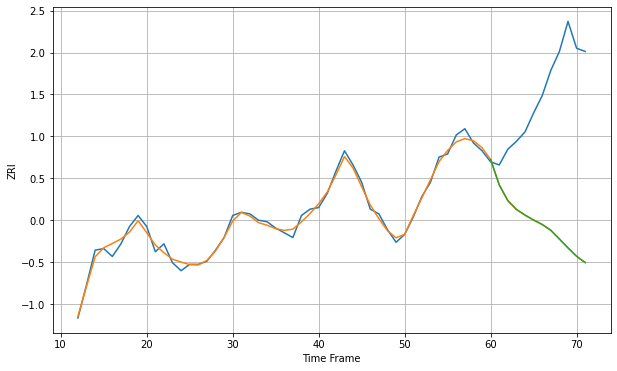

Wall time: 15.7 s
78735 3.030613579905986 90.14563768775551 90.15255901396613 [1529.4587849  1513.38170207 1503.41383291 1497.82585081 1494.21639684
 1491.06816596 1488.27318338 1484.57702551 1479.06400349 1473.4274715
 1468.1127483  1464.12406001]

Got an mse at 0.0025 in round 289 and stopped training

60 60 12


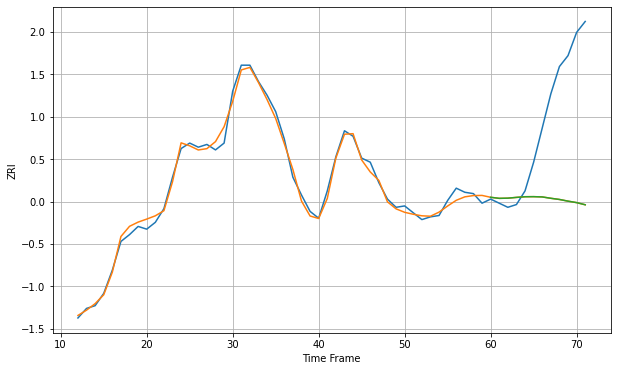

Wall time: 11.9 s
78741 4.173769955253749 72.71099088105727 72.70786922088396 [1280.32826987 1279.54499008 1279.68531619 1280.24869291 1280.72896485
 1280.78379879 1280.58758647 1279.59551498 1278.73453272 1277.49899495
 1276.42977773 1274.84819538]

Got an mse at 0.0025 in round 379 and stopped training

60 60 12


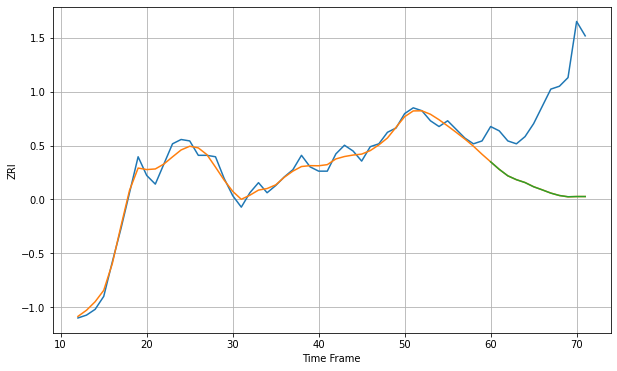

Wall time: 14.2 s
78744 4.434518164931382 67.03071036050218 67.03208000715978 [1258.48383646 1253.26720625 1248.76777117 1246.08364807 1244.0828428
 1241.16550505 1239.00905532 1236.74614992 1235.08656415 1234.2133389
 1234.36880869 1234.36880869]

Got an mse at 0.0025 in round 361 and stopped training

60 60 12


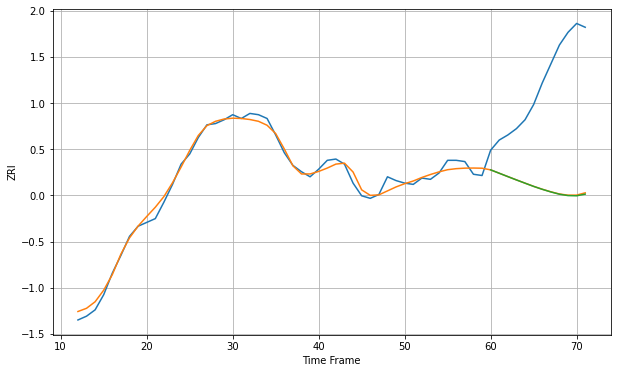

Wall time: 13.8 s
78745 4.339234427838669 88.15461397608131 88.43436253410283 [1268.46950642 1265.80887747 1263.14878321 1260.5234293  1257.96479881
 1255.41814883 1253.12198285 1251.0493355  1249.24689883 1248.16921906
 1247.99494708 1249.31295161]
60 60 12


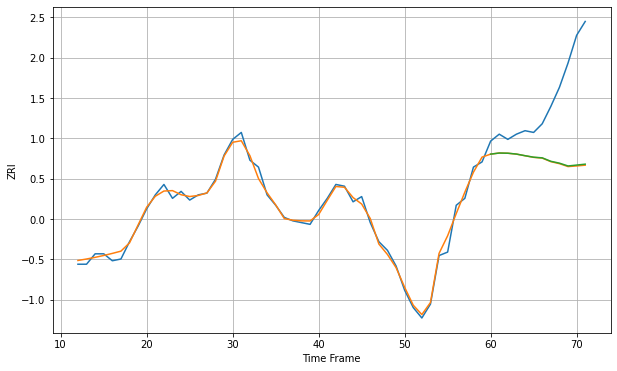

Wall time: 17.3 s
78746 2.8297190437834336 41.063194909247706 40.79369188647176 [1547.49319238 1548.12178166 1548.01466183 1547.5247395  1546.59404066
 1545.72047271 1545.35151609 1543.36156325 1542.28488337 1540.67093325
 1541.18063786 1541.70788708]

Got an mse at 0.0025 in round 298 and stopped training

60 60 12


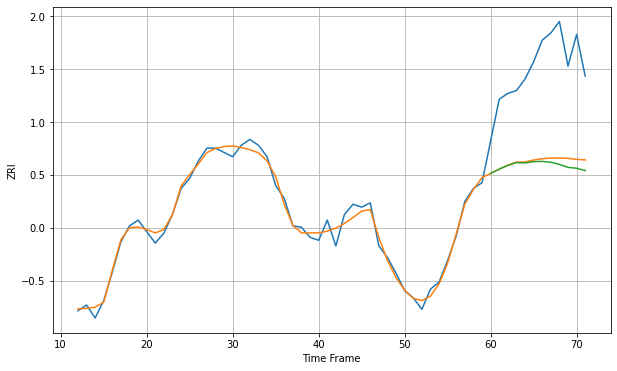

Wall time: 11.8 s
78748 4.431708744680908 67.17735147424473 70.1205325103759 [1319.44510696 1322.39696019 1324.99202771 1326.95568165 1326.73537694
 1327.63060039 1327.77506009 1327.17472383 1325.73088088 1323.63031123
 1323.00488111 1321.40415186]

Got an mse at 0.0025 in round 154 and stopped training

60 60 12


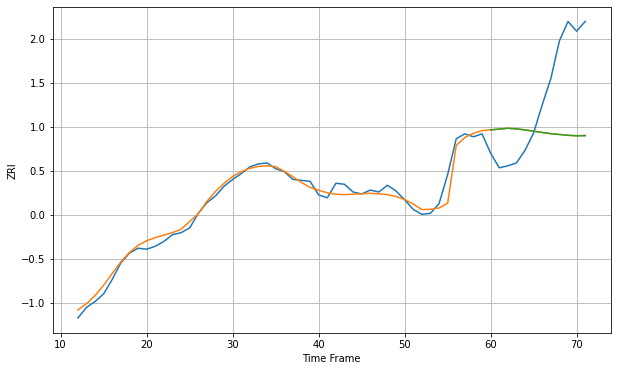

Wall time: 8.09 s
78749 6.636419293332435 69.50111395630145 69.60485346439364 [1297.16527963 1297.91489225 1298.79219266 1298.1754651  1297.07040054
 1295.80460182 1294.42757085 1293.21507253 1292.36097458 1291.48713033
 1290.94717229 1291.07289888]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


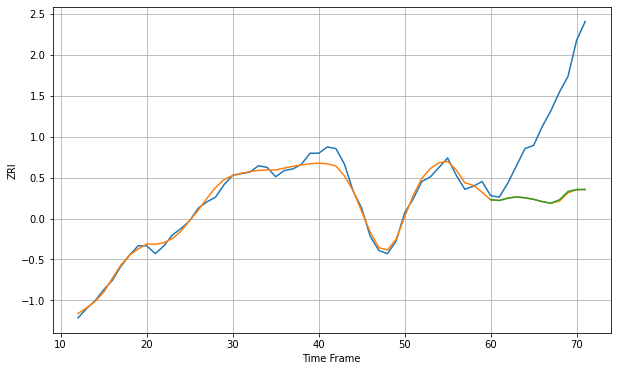

Wall time: 8.32 s
78750 3.7921270111648746 57.231183943350764 57.02046787864059 [1273.34221207 1272.89609193 1274.38116521 1275.17642298 1274.59994825
 1273.63176989 1272.17649384 1271.16958674 1273.34058022 1278.6325461
 1279.90059744 1279.93469614]
60 60 12


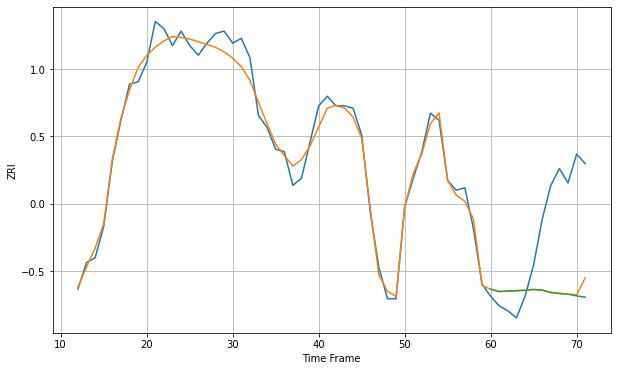

Wall time: 16.3 s
78751 4.635678851762452 33.73741681411814 34.80196092321127 [1366.91544812 1365.96223798 1366.1609369  1366.31627068 1366.48569363
 1366.82360578 1366.54037783 1365.57056364 1365.17140127 1364.86088616
 1364.16639136 1363.61576025]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


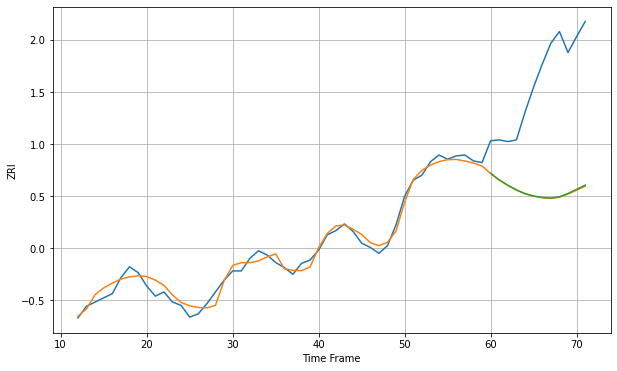

Wall time: 8.74 s
78752 7.765920650060149 139.877680150451 139.434713722498 [1308.08856031 1300.30855404 1293.91455956 1288.44752207 1283.97435529
 1281.15485982 1279.46376608 1278.71224429 1280.25284555 1284.18316128
 1289.17098689 1294.18384789]

Got an mse at 0.0025 in round 303 and stopped training

60 60 12


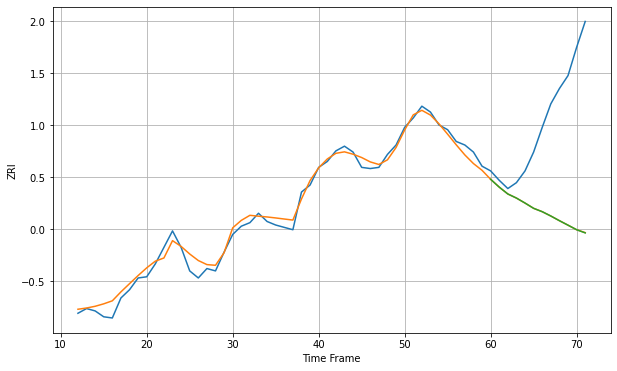

Wall time: 11.3 s
78753 6.148282151219874 92.44303017366768 92.47843292562452 [1138.85569257 1132.21234766 1126.39310301 1122.90755714 1118.6729341
 1114.18323143 1111.33034811 1107.65655544 1103.67830662 1099.87313149
 1096.02336629 1093.29282357]

Got an mse at 0.0025 in round 208 and stopped training

60 60 12


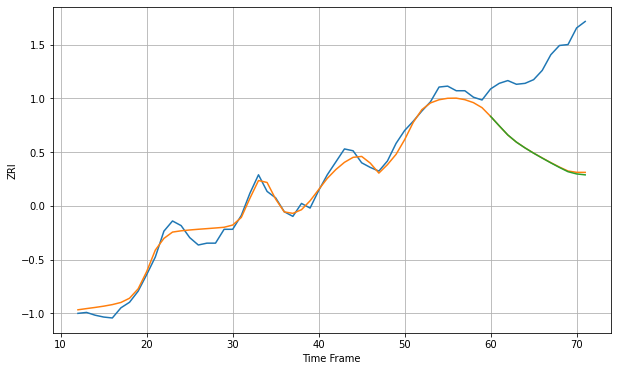

Wall time: 9.24 s
78754 8.300605436156987 104.64950111764536 105.38477076242643 [1207.20816815 1197.03076957 1187.1246392  1179.34834763 1173.09608285
 1167.3999108  1162.09418076 1156.91871455 1151.96186397 1147.3508592
 1144.94032198 1143.93661767]

Got an mse at 0.0025 in round 297 and stopped training

60 60 12


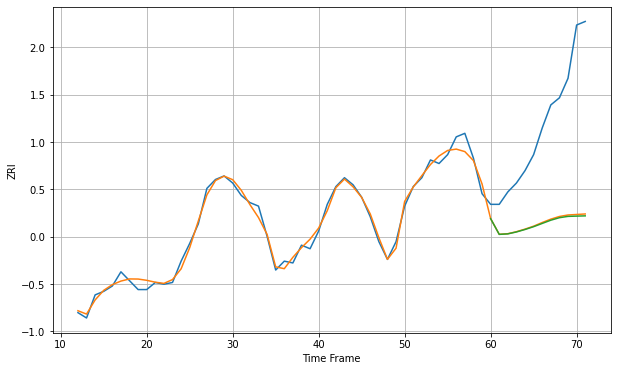

Wall time: 11.3 s
78757 3.3210286943037644 61.15158817288445 61.71357045232731 [1251.9415947  1243.08352316 1243.36606832 1244.44073948 1245.83549305
 1247.41884381 1249.25020665 1251.06683142 1252.47622855 1253.21748283
 1253.37511079 1253.50648974]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


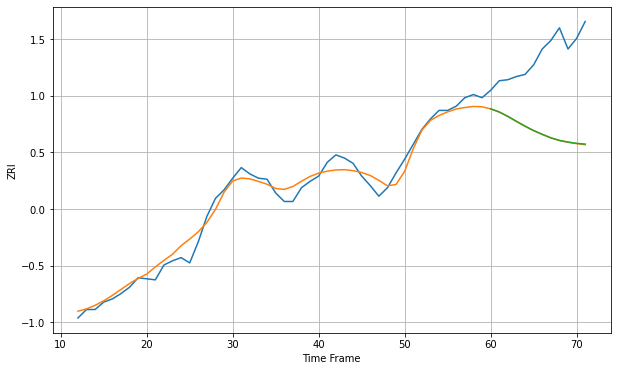

Wall time: 7.79 s
78758 8.072870332905524 75.21858700244117 75.04505495319 [1315.47249743 1312.50489144 1308.36577914 1303.69417992 1299.14382473
 1294.97447823 1291.4228419  1288.16335569 1285.72364207 1284.11853528
 1282.93557747 1282.14525445]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


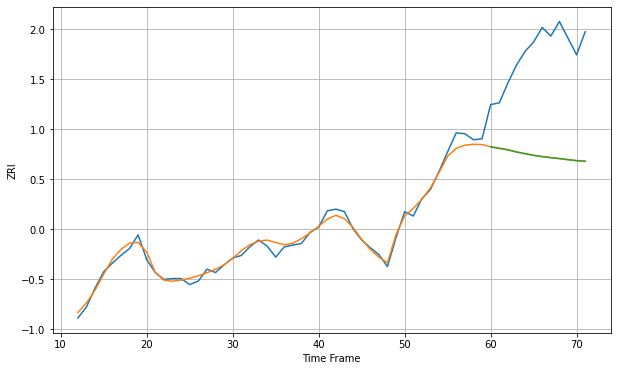

Wall time: 8.03 s
78759 6.23666474704503 122.45131695474598 122.40824754564053 [1478.69310174 1476.99108989 1475.25455125 1472.70284188 1470.76858972
 1468.82731124 1467.30090548 1466.1037377  1464.98961132 1463.75582086
 1462.62416301 1461.96385915]

Got an mse at 0.0025 in round 325 and stopped training

60 60 12


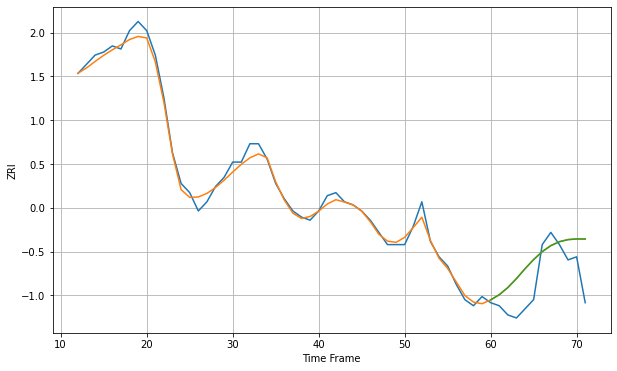

Wall time: 12.1 s
79912 2.014855576046013 9.769315409140347 9.736615006586524 [968.91249459 970.5994868  972.94929084 975.86939579 979.09178197
 982.08630539 984.67438184 986.64506348 987.93244733 988.60789931
 988.82388742 988.80020152]

Got an mse at 0.0024 in round 454 and stopped training

60 60 12


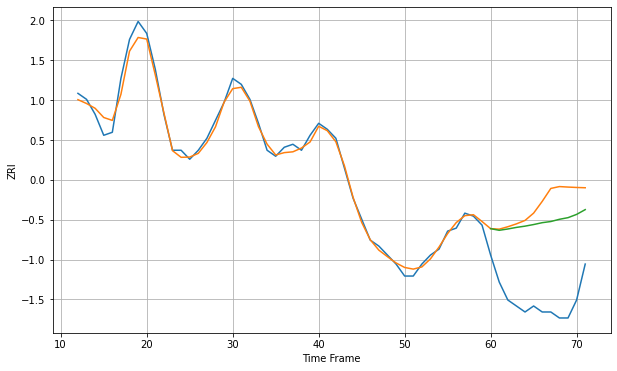

Wall time: 15.3 s
79936 2.132890984532479 32.400718270287435 26.369396281157847 [906.82263866 906.27527422 906.71366274 907.24087618 907.65961559
 908.19610419 908.81740034 909.20351356 909.94595388 910.49385655
 911.5837981  913.17432877]
60 60 12


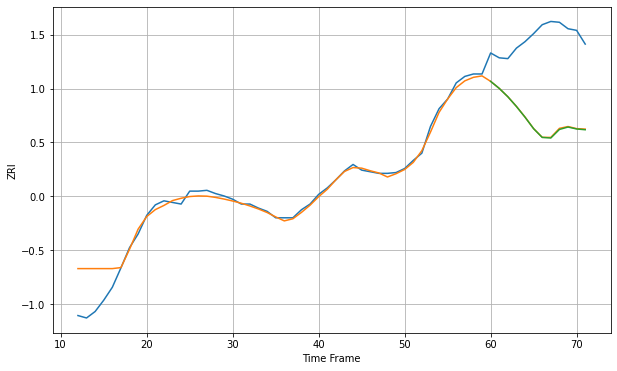

Wall time: 15.7 s
80021 16.203501261840007 104.24648243311889 104.68239515913211 [1581.8681519  1573.16347682 1562.83366395 1550.78735208 1537.53246318
 1523.27413337 1512.4974179  1511.76806066 1522.34363481 1525.3417745
 1522.93938664 1521.98558579]

Got an mse at 0.0025 in round 149 and stopped training

60 60 12


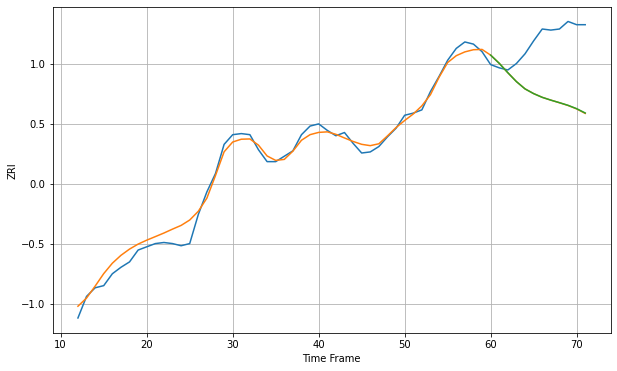

Wall time: 7.95 s
80027 7.288052094958098 54.525427175704465 54.42889801712469 [1622.79370183 1615.18984541 1606.45415317 1598.21784805 1591.4597177
 1587.08651258 1583.63874131 1581.0504044  1578.68863183 1576.22184977
 1573.13682612 1569.1220573 ]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


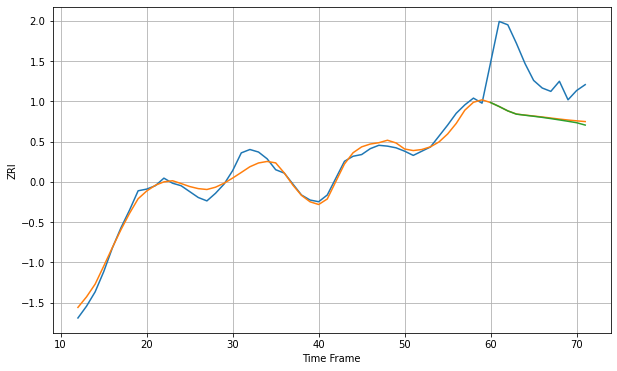

Wall time: 7.96 s
80033 7.82490751052426 60.198955020507235 60.77811444068679 [1282.72532569 1277.98707769 1272.83295431 1268.97604282 1267.69383532
 1266.46959692 1265.16092181 1263.68219507 1262.11997995 1260.49624305
 1258.80467154 1256.00202211]

Got an mse at 0.0025 in round 87 and stopped training

60 60 12


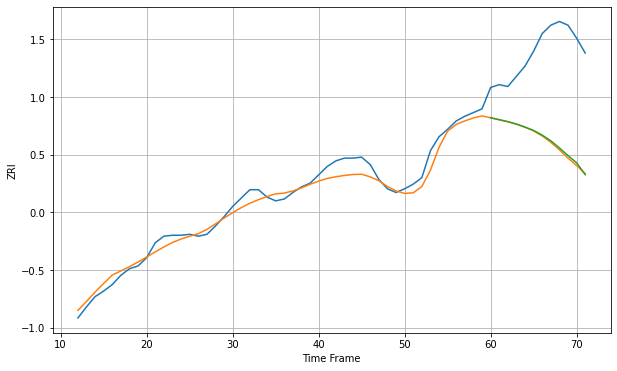

Wall time: 6.6 s
80111 8.975066915425518 100.56499650081912 99.50370839939436 [1586.40125441 1584.31084178 1582.1873481  1579.63175337 1576.38458701
 1572.7439072  1567.74738182 1561.61201748 1553.95690813 1545.66532657
 1538.00339248 1525.15242165]

Got an mse at 0.0025 in round 86 and stopped training

60 60 12


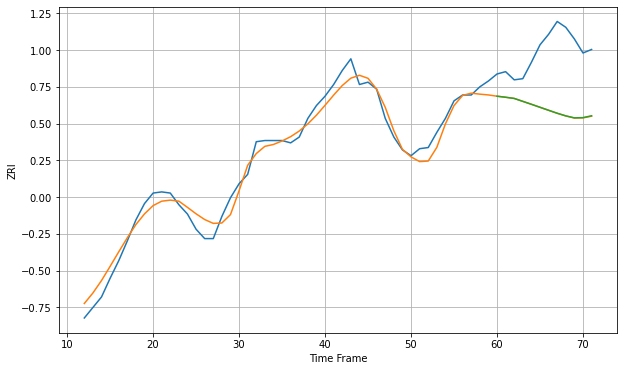

Wall time: 6.5 s
80112 8.760424969349144 52.256703131838904 52.16954917668361 [1765.97474195 1765.0799293  1764.06205681 1761.54653452 1759.05063474
 1756.48725431 1753.91950014 1751.38884326 1749.13590986 1747.42825169
 1747.62529755 1749.20016033]

Got an mse at 0.0025 in round 102 and stopped training

60 60 12


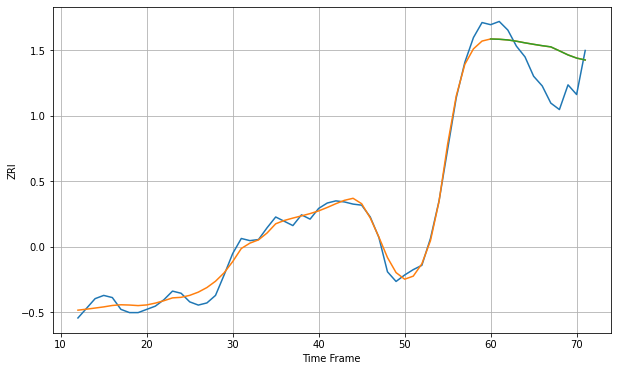

Wall time: 6.85 s
80120 6.68995428899902 29.918342637436215 29.930682437813864 [1655.70665616 1655.43426757 1654.79591155 1653.61878888 1652.09221448
 1650.73832472 1649.46421622 1648.37622391 1644.64146579 1640.85347822
 1637.91825819 1636.14565411]

Got an mse at 0.0025 in round 387 and stopped training

60 60 12


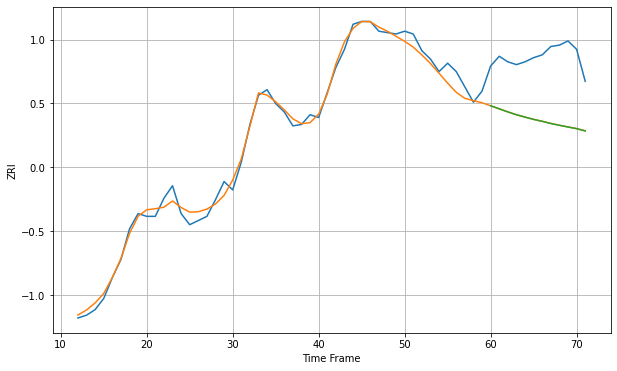

Wall time: 13.6 s
80124 5.5672683601686 45.94789159232128 45.97976825743368 [1592.44436373 1590.24410064 1588.03194437 1585.99340904 1584.29333327
 1582.66209087 1581.26443548 1579.7091277  1578.402983   1577.19030385
 1575.99219584 1574.32672904]

Got an mse at 0.0025 in round 417 and stopped training

60 60 12


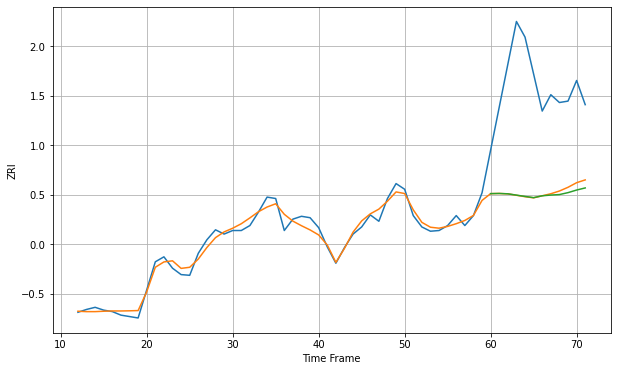

Wall time: 14.1 s
80129 8.650153950506283 154.85670583695048 157.2161951763935 [1880.86914463 1881.10022995 1880.62623522 1878.78969355 1876.95177138
 1875.25523673 1877.81829009 1878.86349285 1879.56241944 1882.27136925
 1885.9265476  1888.87822683]
60 60 12


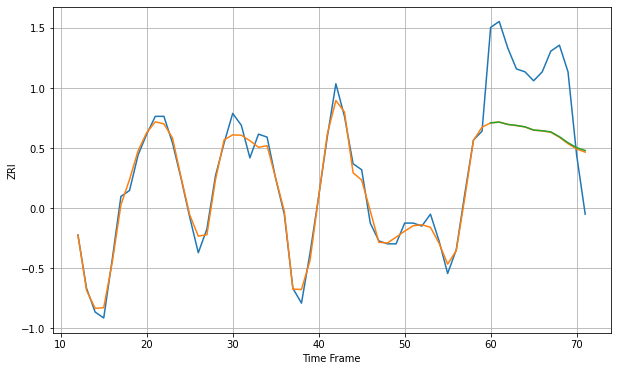

Wall time: 16.1 s
80202 2.7615318615428093 24.109693236159913 24.084199728565988 [2002.80163951 2003.06238621 2002.28055486 2001.92096344 2001.46095826
 2000.38460607 2000.15734671 1999.75383583 1998.13421123 1996.10976295
 1994.46368472 1993.47619043]

Got an mse at 0.0025 in round 108 and stopped training

60 60 12


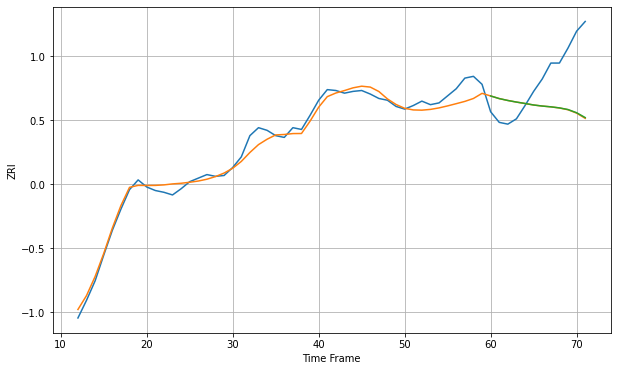

Wall time: 6.93 s
80203 8.986827985218259 53.01500918043558 52.75875462378644 [1583.84452613 1580.86611645 1578.73648622 1576.93502717 1575.34186011
 1573.63458218 1572.44269165 1571.55189666 1570.35839062 1568.48910115
 1564.90111136 1559.42165659]

Got an mse at 0.0025 in round 295 and stopped training

60 60 12


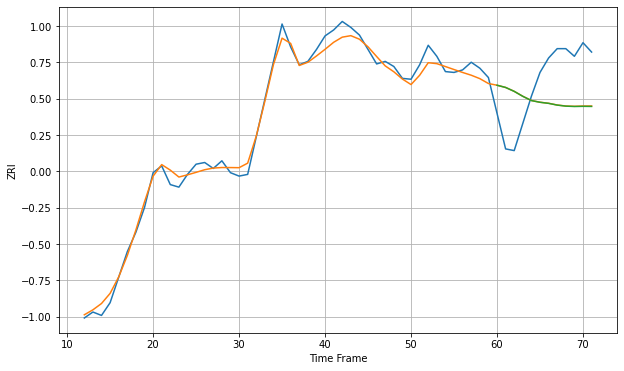

Wall time: 11.4 s
80204 9.15106022919334 56.49710930603688 56.63513835015445 [1836.95413753 1834.3207998  1829.71779466 1823.8878552  1818.90236325
 1816.87114373 1815.61365423 1813.5689474  1812.33659322 1811.92237376
 1812.11458413 1811.99023411]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


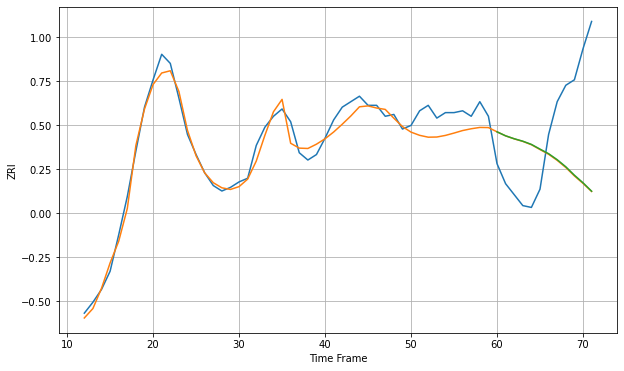

Wall time: 8.58 s
80205 6.699222351646642 45.58014184567983 45.44681524980399 [1662.4648101  1660.27499804 1658.67038049 1657.32916322 1655.57052198
 1652.99052621 1650.48158213 1647.18439732 1643.30526785 1638.68295533
 1634.53223663 1629.90348745]

Got an mse at 0.0025 in round 133 and stopped training

60 60 12


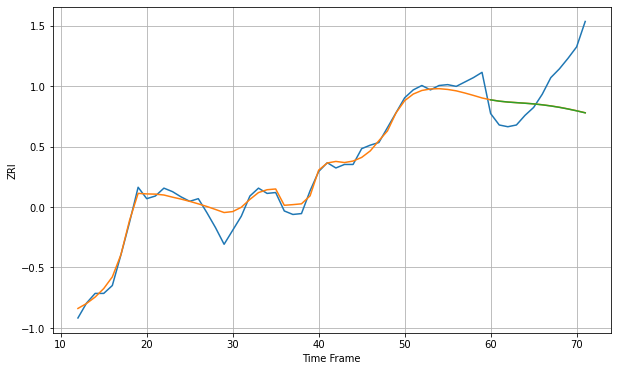

Wall time: 7.74 s
80210 10.237859456543852 45.80901667480474 45.86005547385729 [1615.66385586 1614.15358565 1613.1459499  1612.44536591 1611.77507842
 1611.02775384 1609.9781688  1608.68115057 1607.10725026 1605.23637948
 1603.13523272 1600.84670032]

Got an mse at 0.0024 in round 82 and stopped training

60 60 12


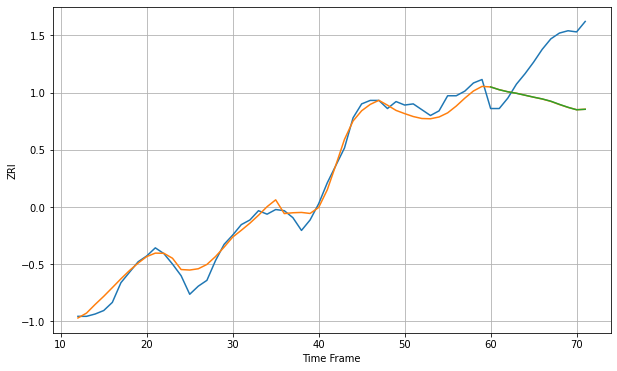

Wall time: 6.32 s
80211 7.507533744733251 45.68154750677535 45.64579384254303 [1712.59849498 1710.20796982 1708.4248013  1707.13462299 1705.46198633
 1703.79803342 1702.28052277 1700.316631   1697.59610914 1695.07016926
 1692.92792908 1693.34255257]

Got an mse at 0.0025 in round 85 and stopped training

60 60 12


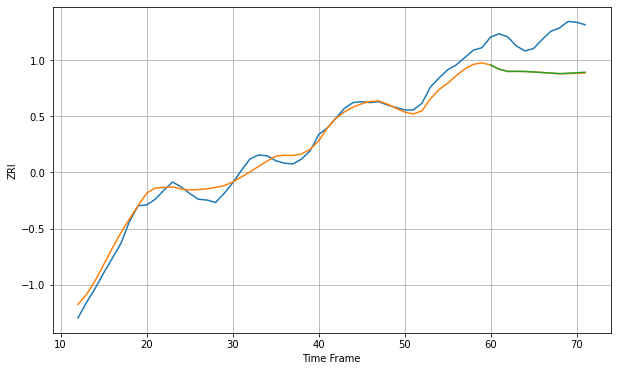

Wall time: 6.21 s
80214 10.071180576943831 46.498225303625546 46.27553050313473 [1287.88344029 1282.6327591  1279.97404535 1280.10317473 1279.91989082
 1279.36058057 1278.65667801 1277.93161556 1277.33447853 1277.7852411
 1278.38684743 1279.06972778]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


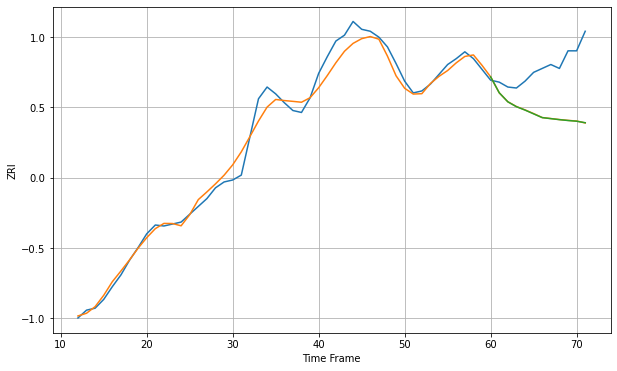

Wall time: 7.38 s
80218 9.856141698401773 50.52773844348121 50.57889603554425 [1430.40959008 1414.13593985 1404.89235531 1399.91168873 1396.44802952
 1392.57963439 1388.7470898  1387.70480537 1386.66745711 1385.7887823
 1385.07292665 1383.52549725]

Got an mse at 0.0025 in round 65 and stopped training

60 60 12


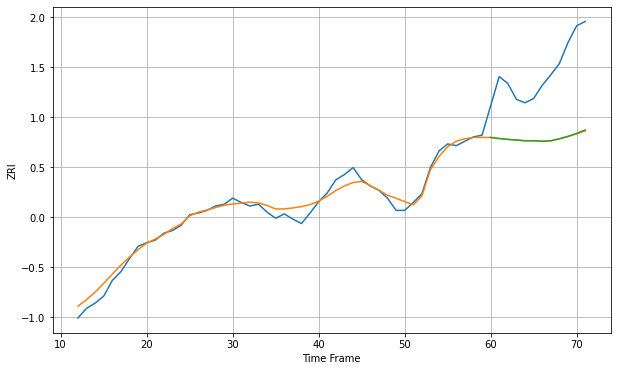

Wall time: 5.77 s
80226 7.56518566531534 79.83915607144559 79.56636668153209 [1450.41250513 1449.18316116 1448.18697098 1447.43302841 1446.63036905
 1446.6417297  1446.0419893  1446.65624616 1448.92042033 1451.73521904
 1454.99658765 1458.98491734]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


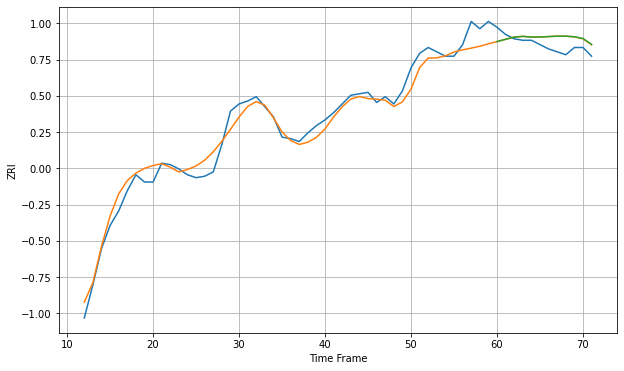

Wall time: 8.92 s
80229 7.44516604808411 7.396514340647985 7.4524805395277784 [1399.09376456 1400.66290266 1402.17506674 1402.68521069 1402.19686903
 1402.259909   1402.56544586 1402.83072164 1402.84986533 1402.41934903
 1401.2359621  1397.14834117]

Got an mse at 0.0025 in round 106 and stopped training

60 60 12


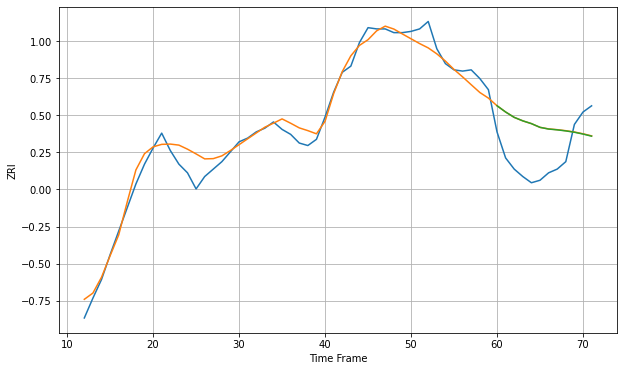

Wall time: 6.77 s
80231 9.063147781008606 33.50896585010329 33.508689030159175 [1345.07745715 1340.02614485 1335.70908268 1332.88723038 1330.66626303
 1327.65929987 1326.27981073 1325.63848021 1324.77977531 1323.69957281
 1322.24997973 1320.54722066]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


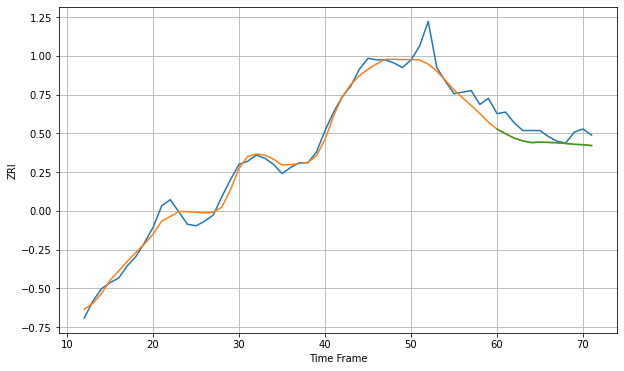

Wall time: 8.02 s
80233 6.5449033050030625 8.100367780020697 8.136445420257514 [1410.91970233 1407.90271308 1405.05512139 1403.26640322 1402.125213
 1402.46236535 1402.25828363 1402.03115296 1401.5407069  1401.01091782
 1400.74844099 1400.14909244]

Got an mse at 0.0024 in round 127 and stopped training

60 60 12


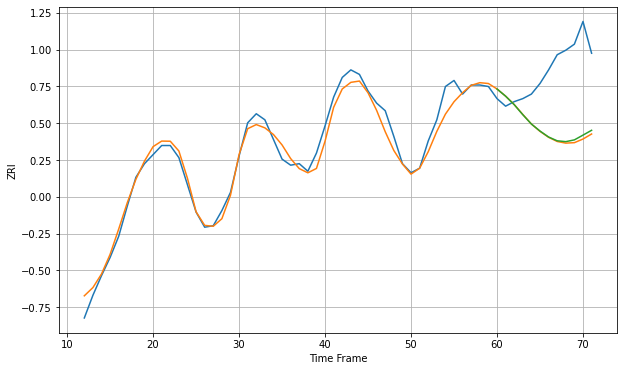

Wall time: 7.58 s
80237 6.4028407426926695 44.50605485995846 43.477060952536725 [1454.37085836 1449.61075423 1444.00616946 1437.37455299 1431.20108728
 1426.56595815 1422.62040898 1420.11392346 1419.56118697 1420.72249125
 1423.8704721  1427.05999975]

Got an mse at 0.0025 in round 185 and stopped training

60 60 12


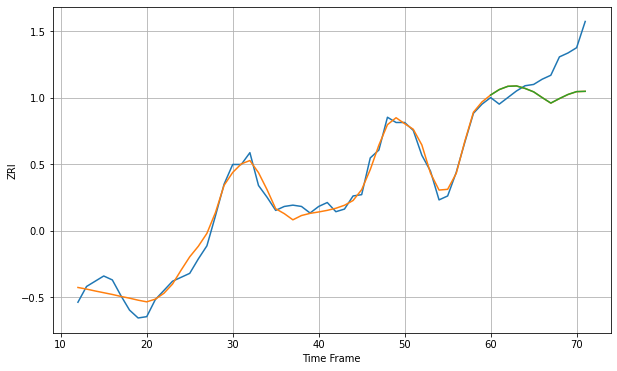

Wall time: 8.49 s
80301 6.526371623391919 23.93028509274359 23.907791695919265 [1764.94549004 1769.08131387 1771.57021497 1771.86098957 1769.97270009
 1767.36234199 1762.9716366  1758.81431973 1762.24150138 1765.37491499
 1767.54019998 1767.7625493 ]

Got an mse at 0.0025 in round 178 and stopped training

60 60 12


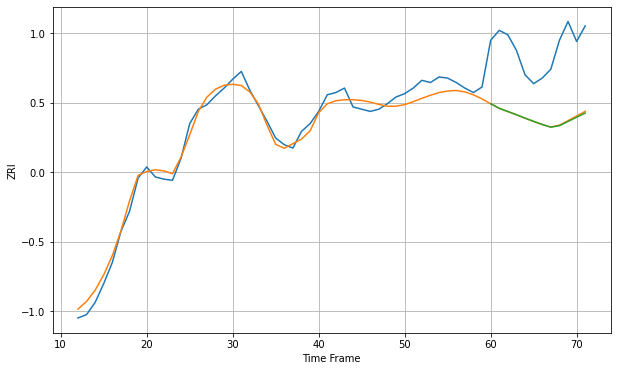

Wall time: 8.32 s
80401 7.728664728078177 63.06331787943235 63.44020938756197 [1539.92143763 1535.79588101 1532.91423226 1530.04407813 1526.97524754
 1524.05831386 1521.23864467 1518.84485305 1520.13458907 1523.92948955
 1527.80162095 1531.47317309]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


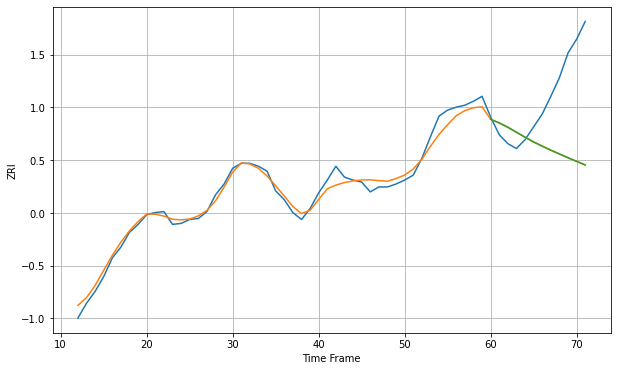

Wall time: 7.52 s
80503 7.019136272779012 70.05369445694988 70.06717394236821 [1392.63109688 1389.03651402 1384.60174764 1379.56839607 1374.47032929
 1369.69060953 1365.40833096 1361.3427951  1357.47438936 1353.69100381
 1349.9819604  1346.29521901]

Got an mse at 0.0025 in round 130 and stopped training

60 60 12


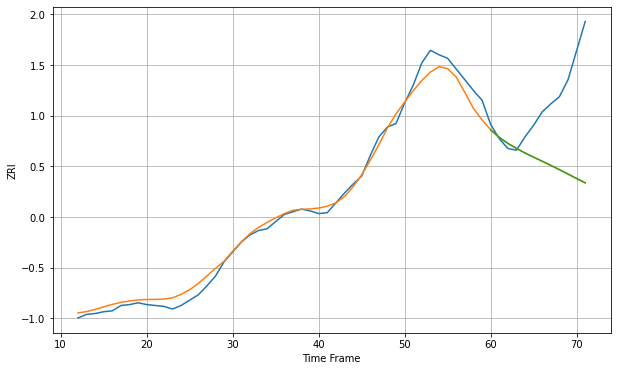

Wall time: 7.57 s
80904 9.210275314746912 81.98285508449422 81.95364789323965 [968.97646992 960.36764178 953.70113664 948.05653868 942.94959702
 938.23976136 933.6679809  929.02184902 924.21935724 919.29260858
 914.31939533 909.53752733]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


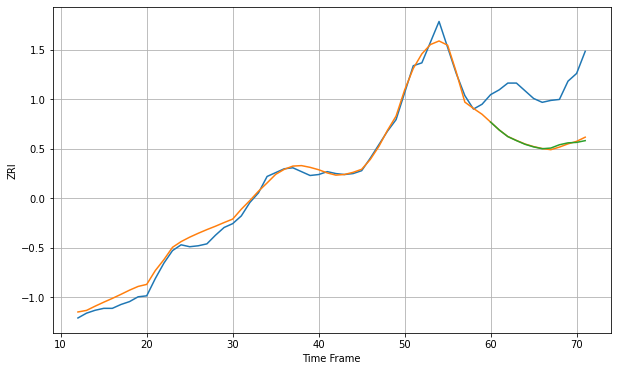

Wall time: 10.2 s
80915 7.07382797432054 57.22118749337369 57.49929777919968 [919.44847829 911.26661068 904.40147406 900.25099169 896.41930692
 893.6863906  891.82438869 892.50117373 895.92116676 897.9148901
 898.3740858  900.2059259 ]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


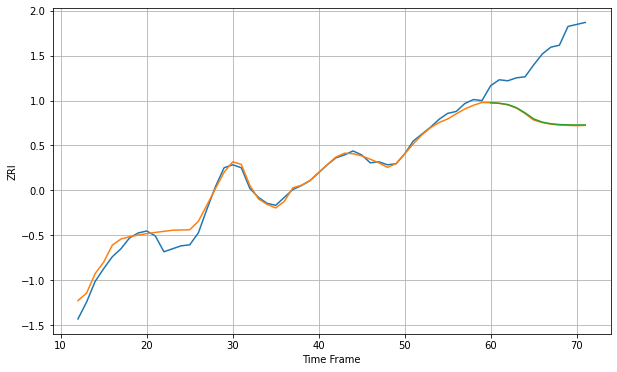

Wall time: 10.4 s
84047 7.164907488388125 68.06652690980434 67.62313715572989 [1101.78778912 1101.2227448  1099.91598685 1096.80275037 1091.57559731
 1085.43318133 1082.17868931 1080.47845763 1079.70957008 1079.39940971
 1079.27715494 1079.28631997]

Got an mse at 0.0025 in round 299 and stopped training

60 60 12


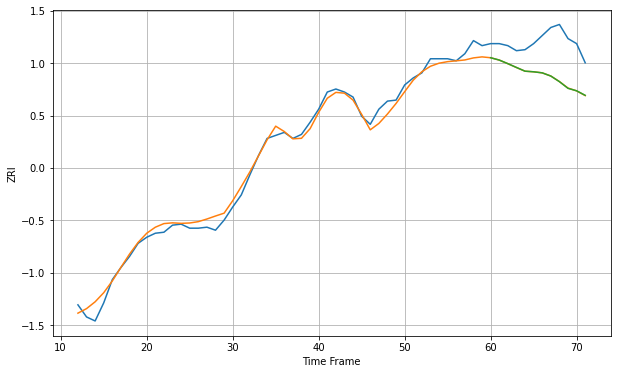

Wall time: 11.5 s
84095 7.131281418481575 35.1717164047569 35.183822435526466 [1323.00630513 1320.7136635  1317.15131166 1313.36840659 1309.69250668
 1309.06679228 1308.01780643 1304.86058009 1299.29032734 1292.66355879
 1290.22124294 1285.73733993]

Got an mse at 0.0025 in round 114 and stopped training

60 60 12


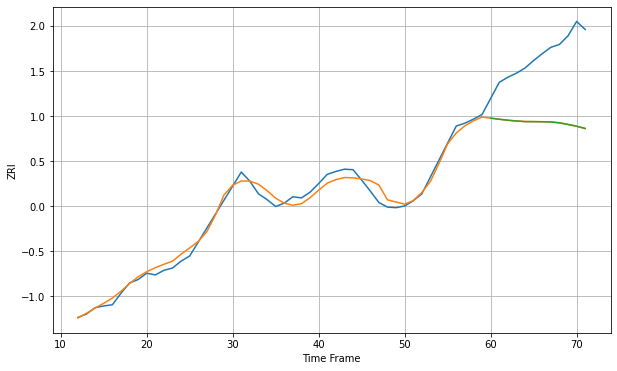

Wall time: 6.88 s
84102 10.48274712848577 120.35268666928255 120.42220131373762 [1084.7689492  1082.88396336 1081.14127338 1079.81664137 1078.79697714
 1078.69212562 1078.49304259 1078.12326267 1076.51367182 1073.61982952
 1070.69571653 1066.90843233]

Got an mse at 0.0025 in round 138 and stopped training

60 60 12


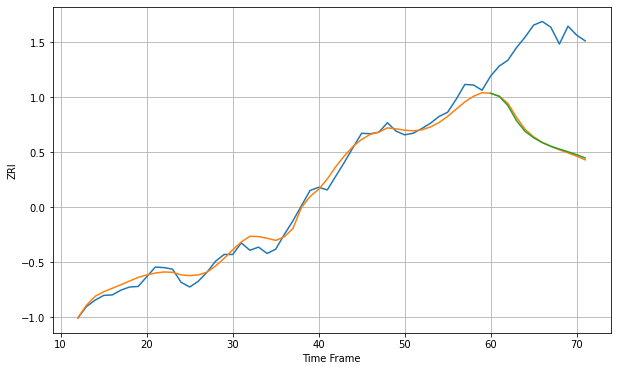

Wall time: 7.43 s
84103 13.057858703250027 185.49667630746245 185.51022149276474 [1362.17758959 1356.27085044 1338.82493915 1310.24229986 1289.55693023
 1277.43241563 1268.24962069 1261.41668831 1255.8180701  1250.67372461
 1245.20024223 1238.8155415 ]

Got an mse at 0.0025 in round 257 and stopped training

60 60 12


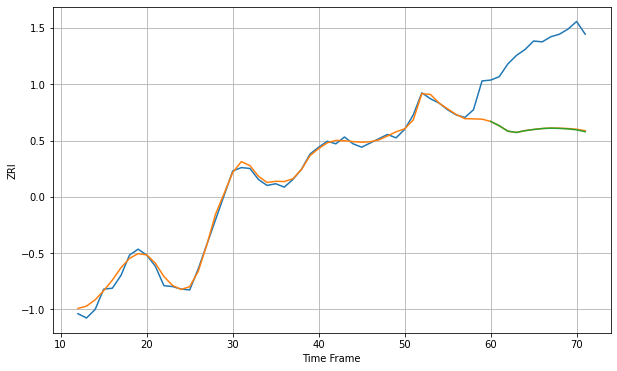

Wall time: 10.2 s
84106 8.258296630614863 98.72992221521586 99.02782279261639 [1214.36141986 1209.26313401 1202.88780224 1201.34292738 1203.47996964
 1204.85490904 1205.94470965 1206.39128982 1206.12088007 1205.54962563
 1204.42628727 1202.22892524]

Got an mse at 0.0025 in round 331 and stopped training

60 60 12


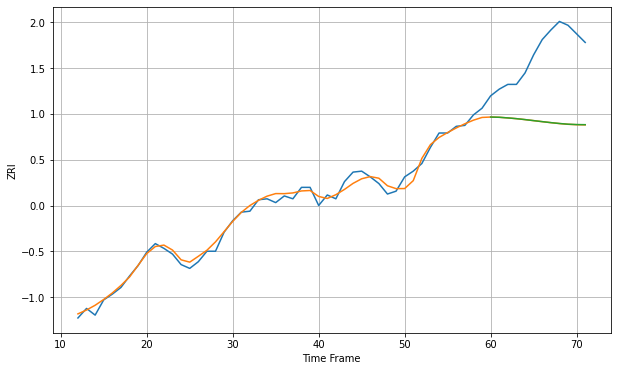

Wall time: 11.8 s
84119 5.628541811124812 74.55859369443782 74.49436392373781 [1012.7514478  1012.50210639 1011.84538685 1011.06066297 1010.07895064
 1008.99542159 1007.93137545 1006.89888878 1005.98516199 1005.237857
 1004.86972668 1004.7419286 ]

Got an mse at 0.0025 in round 246 and stopped training

60 60 12


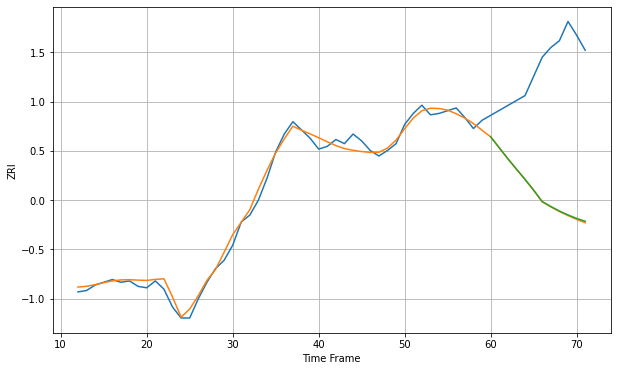

Wall time: 9.94 s
84403 4.491908139392901 95.51727917556022 95.13360146414742 [872.98502344 864.98331589 857.05103411 849.49093045 842.03066093
 834.21278077 825.82843818 822.20751274 818.92050635 816.05238745
 813.52040265 811.46423032]

Got an mse at 0.0025 in round 209 and stopped training

60 60 12


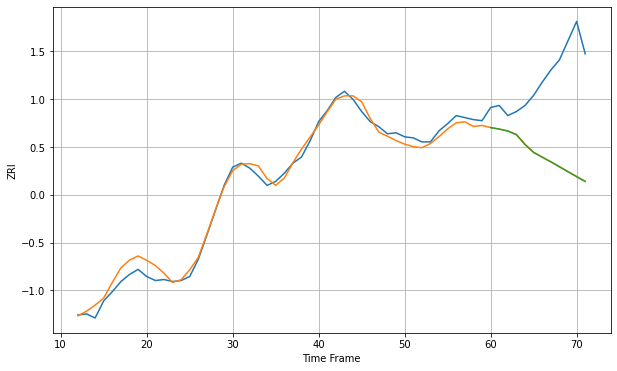

Wall time: 9.07 s
85008 6.901526180532526 85.2474990079269 85.35996965685017 [1034.13835922 1032.65072643 1030.72691825 1027.14863783 1017.42699056
 1009.60166929 1004.88462051 1000.30389947  995.42118667  990.49604841
  985.61312104  980.87485154]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


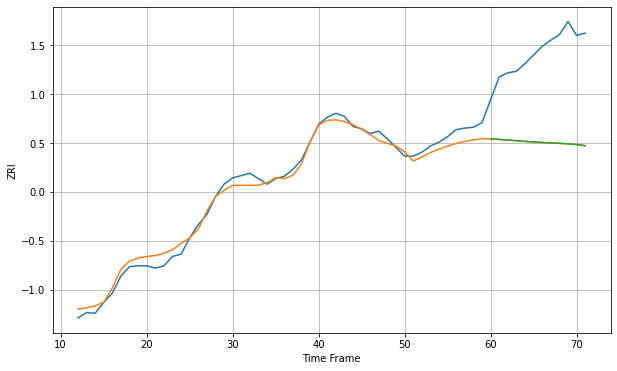

Wall time: 7.96 s
85014 9.415182256630604 117.09609350721448 117.05234134649794 [1144.07657717 1143.45485511 1142.62952656 1141.7681706  1140.91789141
 1140.14281002 1139.44044823 1138.86811599 1138.38297831 1137.75376257
 1136.98122583 1135.48708945]

Got an mse at 0.0025 in round 122 and stopped training

60 60 12


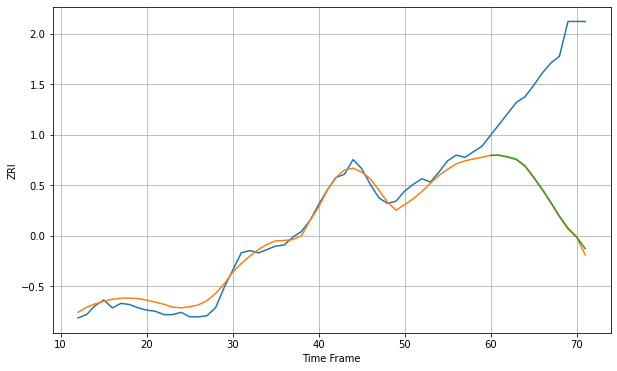

Wall time: 7.06 s
85015 6.820243381036979 121.40073306783823 120.22916124642252 [928.82062856 928.87481719 927.37780618 925.27846163 919.49696704
 909.45958909 898.73043132 887.01427743 874.74718448 864.00741988
 856.20567295 845.64002932]

Got an mse at 0.0025 in round 144 and stopped training

60 60 12


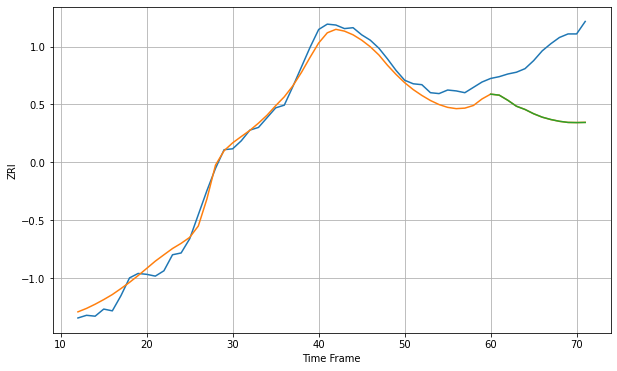

Wall time: 7.59 s
85016 10.397767899917845 72.46614671199839 72.47041177926988 [1300.37662895 1299.24121623 1293.47562403 1286.80953297 1283.18524639
 1278.37634541 1274.53313907 1271.88507274 1269.89310932 1268.62073098
 1268.43509672 1268.58719589]

Got an mse at 0.0025 in round 314 and stopped training

60 60 12


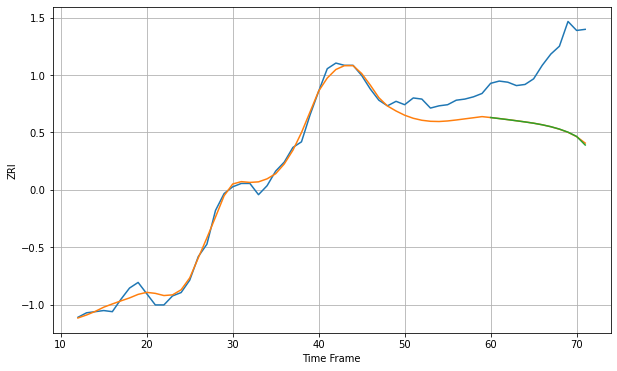

Wall time: 11.5 s
85018 8.74301571166258 63.26287912697591 63.449449402749565 [1184.59571856 1183.6767886  1182.73165172 1181.71726302 1180.68265196
 1179.55265129 1178.14710358 1176.45301358 1174.31446777 1171.57658529
 1167.80550065 1160.16746074]

Got an mse at 0.0025 in round 110 and stopped training

60 60 12


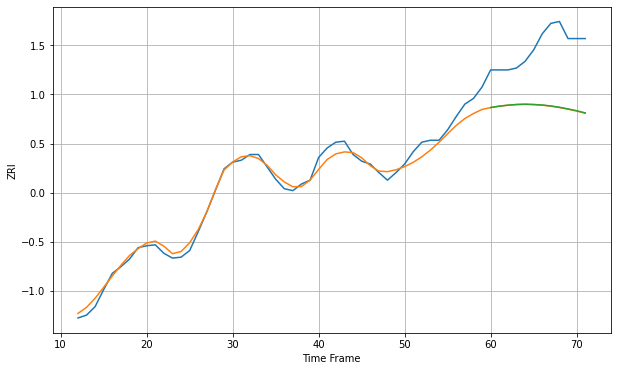

Wall time: 6.76 s
85020 7.7149648118174365 64.63796752456211 64.4708595649909 [1078.41044322 1079.87179551 1080.89447333 1081.61523929 1081.92860926
 1081.64519634 1081.08790573 1080.09394374 1078.69935485 1076.97404597
 1075.06308798 1072.76543854]

Got an mse at 0.0025 in round 364 and stopped training

60 60 12


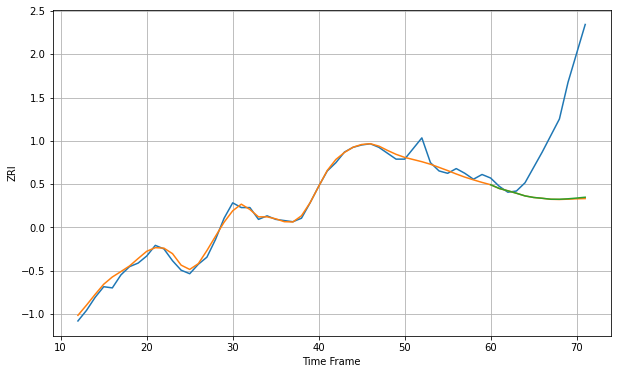

Wall time: 12.6 s
85027 4.535731017658332 68.64888579370185 68.29675020427632 [1018.33186574 1015.16700322 1013.20976536 1011.13669195 1008.87250182
 1007.55577078 1006.86307273 1006.06213498 1006.02053021 1006.42011389
 1007.04914261 1007.75605011]

Got an mse at 0.0025 in round 134 and stopped training

60 60 12


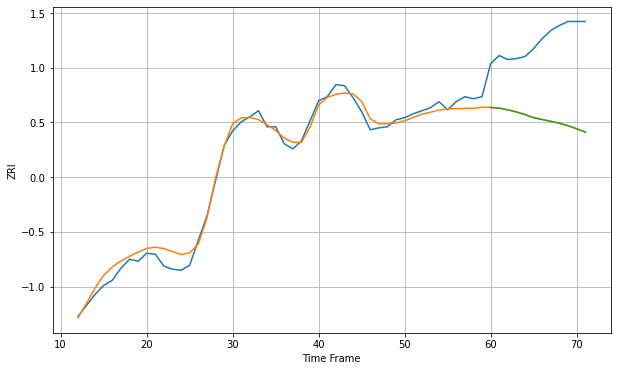

Wall time: 7.53 s
85032 7.669354724453211 79.95605561023024 79.93887434750494 [1149.29042847 1148.54727723 1146.93778135 1144.83395372 1142.18750246
 1139.09059968 1137.25603563 1135.41289249 1133.52068725 1131.05783316
 1128.01831552 1124.90757896]

Got an mse at 0.0025 in round 158 and stopped training

60 60 12


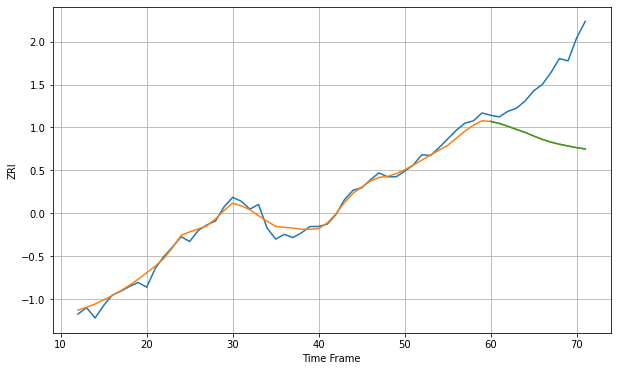

Wall time: 7.92 s
85044 7.047565634790861 85.38205322402675 85.43020986728818 [1342.27827339 1339.71411636 1336.13811118 1332.10364139 1328.36008241
 1323.75960785 1319.52582939 1316.06929496 1313.35005854 1311.10968767
 1308.95525635 1307.17429633]

Got an mse at 0.0025 in round 120 and stopped training

60 60 12


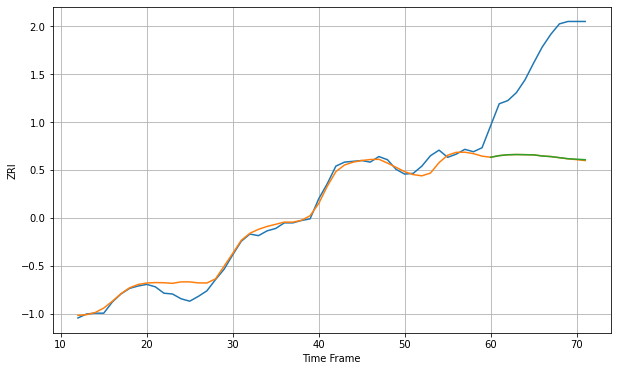

Wall time: 7.11 s
85201 8.132729146093338 128.48855997648616 128.28543878230016 [1035.08259638 1037.12670344 1038.21139617 1038.50186251 1038.30756697
 1038.1030039  1036.6731685  1035.93567171 1034.59858507 1033.28742929
 1032.63235065 1032.05497781]

Got an mse at 0.0025 in round 114 and stopped training

60 60 12


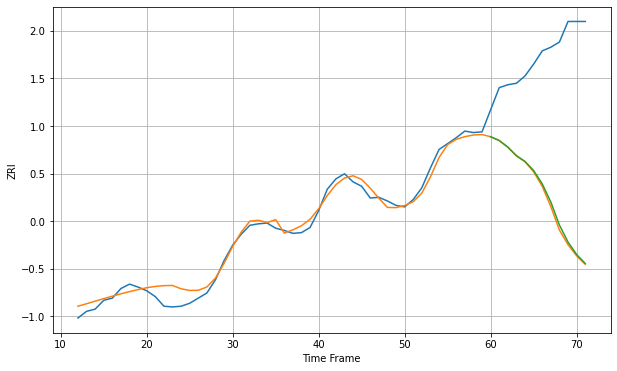

Wall time: 7.15 s
85204 10.233079482594132 205.52113222932755 203.0877855562001 [1110.33080831 1105.17968498 1096.26760991 1084.6463095  1076.69026366
 1064.40030689 1046.39928092 1021.56291963  990.31583828  967.19318186
  950.26434144  938.07274113]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


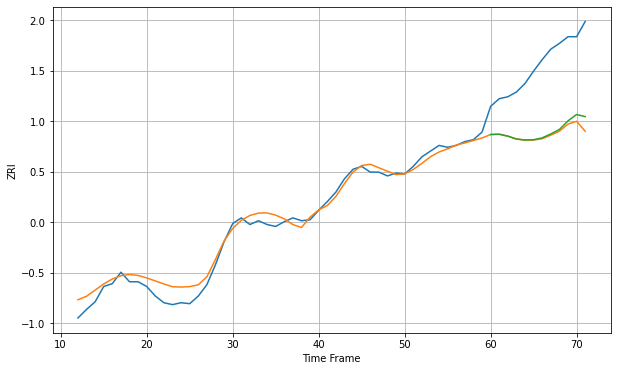

Wall time: 7.92 s
85224 8.797036266991809 75.39342642010601 72.06938566852186 [1151.43197974 1151.70564025 1149.70571048 1146.66961111 1145.63818719
 1145.95201448 1147.93978878 1152.01158431 1156.69356218 1165.74945889
 1172.42160392 1170.20964653]

Got an mse at 0.0025 in round 157 and stopped training

60 60 12


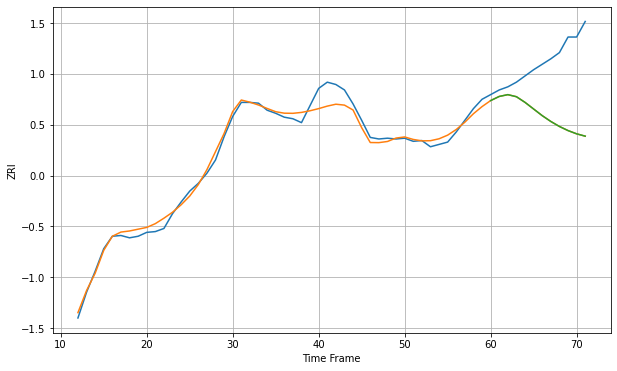

Wall time: 7.91 s
85251 9.525740775580081 79.46424470788833 79.45683825772984 [1386.33317045 1391.65152891 1393.96531766 1391.30260676 1384.04171432
 1375.51015895 1366.98397084 1359.49783038 1353.07857923 1347.80262265
 1343.6343904  1340.63477339]

Got an mse at 0.0025 in round 321 and stopped training

60 60 12


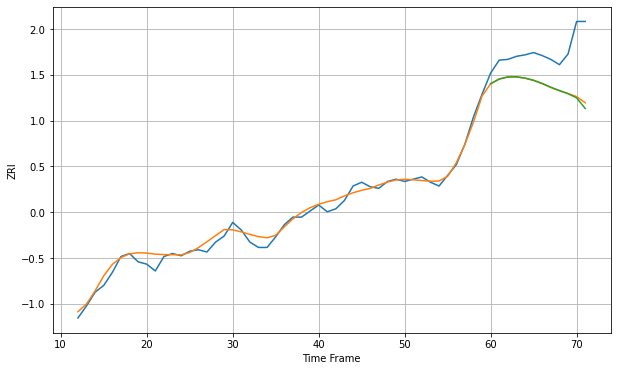

Wall time: 11.6 s
85260 7.77945495987049 51.90590082936932 53.42982070533907 [1518.87500277 1525.0875783  1527.83050892 1528.00181698 1526.31614904
 1523.43188427 1519.25343906 1514.23511952 1509.84951325 1505.77858443
 1500.25477806 1486.33765364]

Got an mse at 0.0025 in round 219 and stopped training

60 60 12


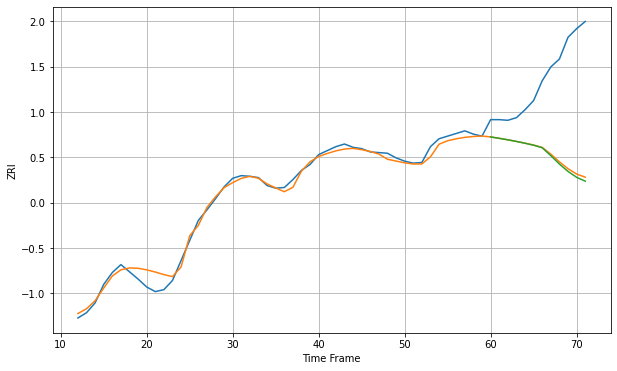

Wall time: 9.58 s
85281 9.023427667529644 131.39892420224186 134.0905497568073 [1200.74847668 1198.66196256 1196.38888343 1193.90972482 1191.18078057
 1188.16125974 1184.3415627  1172.32846707 1159.60195695 1148.4257618
 1139.4939778  1133.65092667]

Got an mse at 0.0025 in round 120 and stopped training

60 60 12


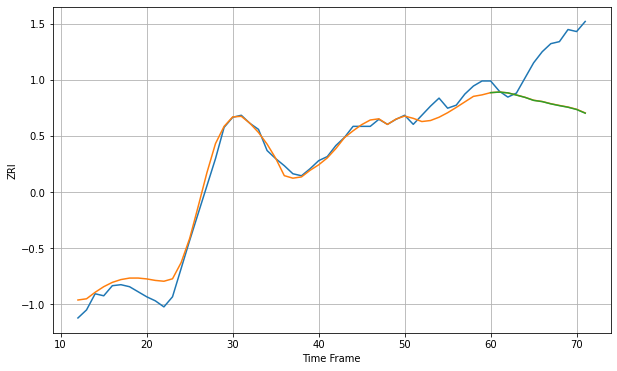

Wall time: 7.32 s
85282 9.427972336632102 51.60215550942835 51.750468676560196 [1195.42098732 1195.96279863 1195.17408309 1193.02055538 1190.72427207
 1187.74177499 1186.519476   1184.30389817 1182.52981472 1180.9486185
 1178.70891059 1175.06115545]

Got an mse at 0.0025 in round 96 and stopped training

60 60 12


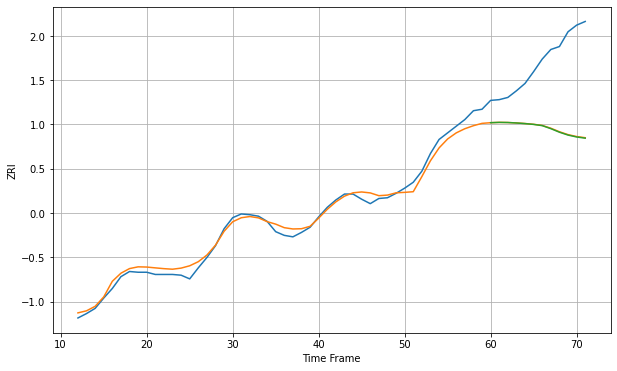

Wall time: 6.5 s
85283 8.352993117603786 96.98675761019202 97.37378061311591 [1176.77174325 1177.15561232 1176.98170617 1176.36738419 1175.52577644
 1174.42368638 1172.78031339 1168.68495903 1163.85724276 1159.98434563
 1157.39850409 1155.78998796]

Got an mse at 0.0024 in round 125 and stopped training

60 60 12


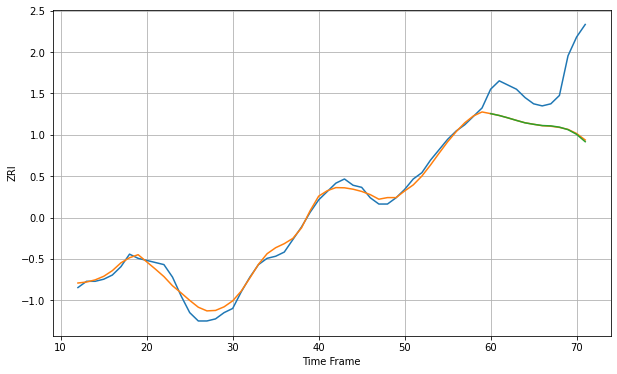

Wall time: 7.2 s
85705 2.6498777866196512 25.82672115447226 26.0327728683119 [707.29506737 706.4131042  705.27952902 704.05491383 702.89662829
 702.18661633 701.59536631 701.4270778  700.82962301 699.63082318
 697.37203932 693.86150928]

Got an mse at 0.0025 in round 232 and stopped training

60 60 12


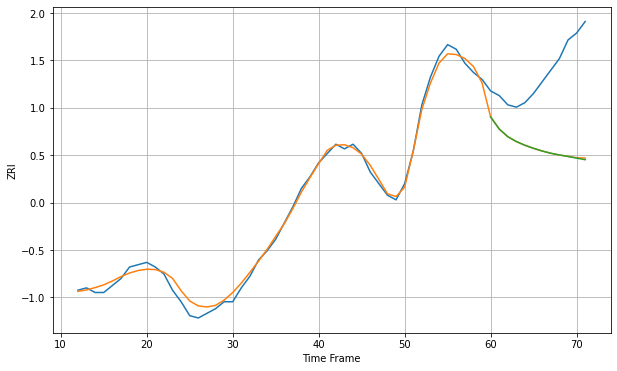

Wall time: 9.57 s
85716 2.3981229002075386 34.721408587775485 34.84841062490438 [736.77043086 731.57314727 728.24304474 726.13971521 724.53221322
 723.2168503  722.07780028 721.10866305 720.36068412 719.71659017
 719.00775646 718.32603805]

Got an mse at 0.0025 in round 230 and stopped training

60 60 12


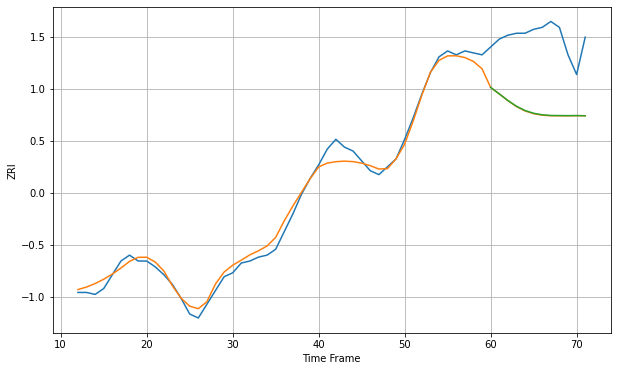

Wall time: 9.66 s
85719 3.7694441079615757 37.03242015168819 36.91145708822541 [786.40928665 783.14546252 779.76431809 776.84057866 774.65586554
 773.25419468 772.4727371  772.13672752 772.08700206 772.04264525
 772.06834839 771.97778026]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


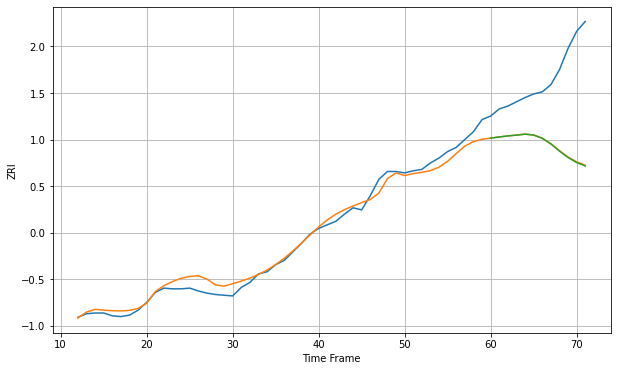

Wall time: 8.32 s
86314 10.104335253042688 105.78217188569708 106.24382910315683 [1038.97019663 1040.56036721 1042.05226788 1043.18336388 1044.48494097
 1043.28441596 1038.72446911 1030.79371235 1020.74065282 1011.713194
 1004.64122433  999.83996695]
60 60 12


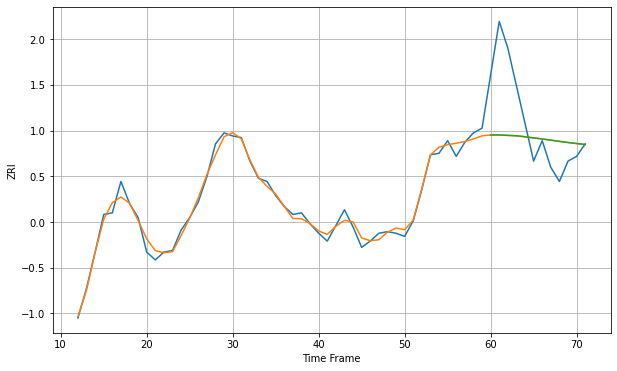

Wall time: 15.9 s
87111 3.725985287542066 31.97128178143442 31.96967081780373 [913.66678856 913.66819604 913.36839502 913.12495143 912.49346351
 911.77778034 911.07985127 910.32254762 909.57110369 908.82021897
 908.17081019 907.6033657 ]

Got an mse at 0.0025 in round 483 and stopped training

60 60 12


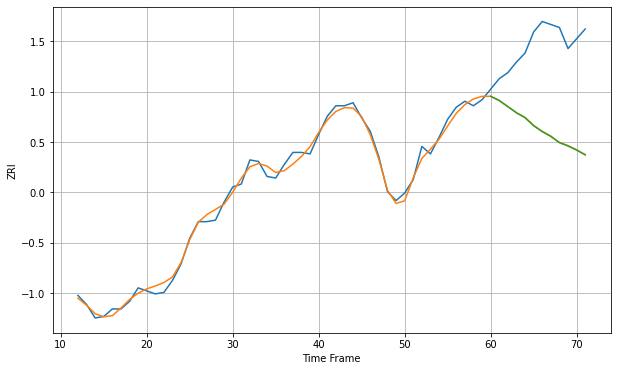

Wall time: 15.4 s
89030 3.6419583104436963 58.31564196035901 58.43756238510693 [868.30176084 865.47753799 861.40998994 857.33563484 854.0855827
 848.74334923 844.80567723 841.61012061 837.48308912 835.30154679
 832.51675254 829.45503152]

Got an mse at 0.0025 in round 177 and stopped training

60 60 12


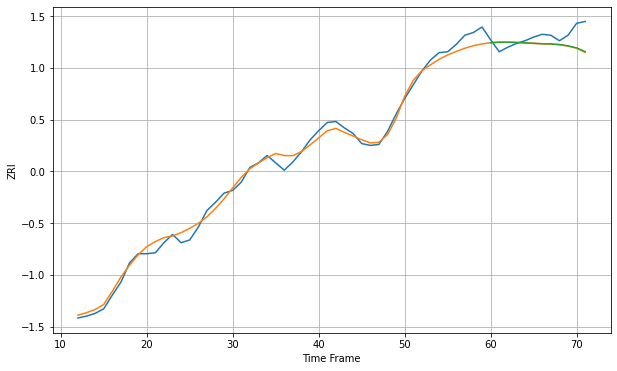

Wall time: 8.27 s
89052 7.203784069264046 14.213813788822447 13.99256434952562 [1460.89606456 1461.39332987 1461.4064099  1461.13185528 1460.66055982
 1460.15802769 1459.72159238 1459.4738686  1458.82087882 1457.39640481
 1455.20443673 1451.0979164 ]

Got an mse at 0.0025 in round 282 and stopped training

60 60 12


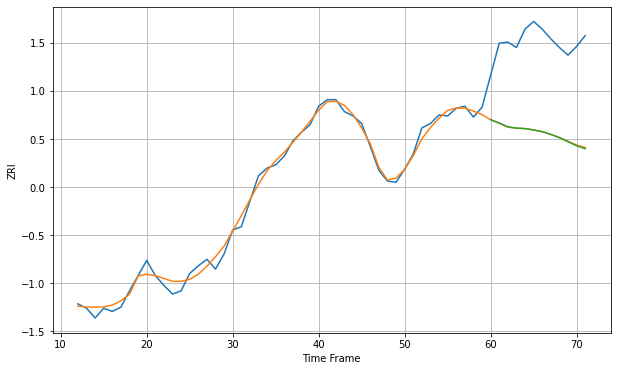

Wall time: 10.7 s
89101 5.509854093870208 84.56951816358067 84.73552130284797 [860.54562885 857.45402116 854.02136771 852.77550656 852.40506812
 851.10037454 849.53231799 847.01795968 843.99148914 840.31999428
 836.53759521 833.85657941]

Got an mse at 0.0025 in round 216 and stopped training

60 60 12


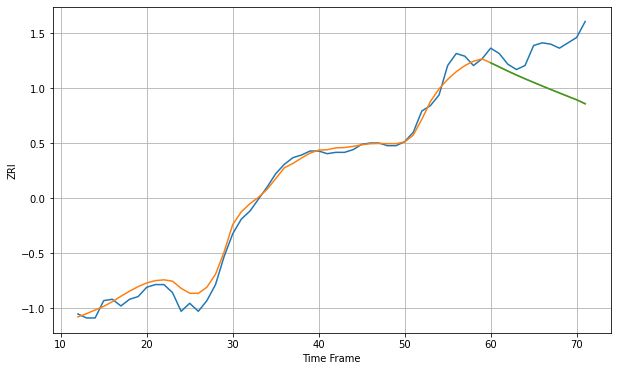

Wall time: 9.19 s
89108 5.878036244003539 31.65743768210369 31.650269816007352 [1076.0737966  1072.94576168 1069.86928223 1066.90177969 1064.07877448
 1061.36986374 1058.70391436 1056.04561194 1053.46402768 1050.8916943
 1048.38298606 1045.41258835]

Got an mse at 0.0024 in round 173 and stopped training

60 60 12


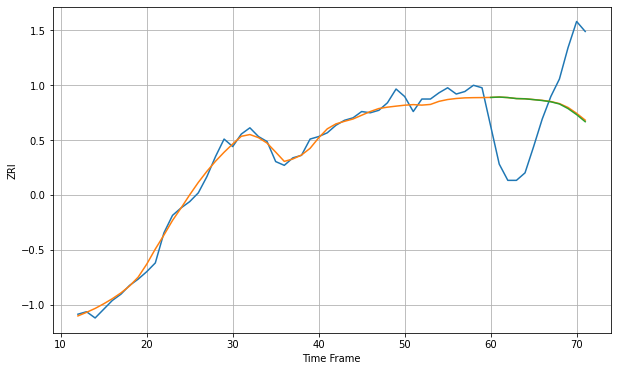

Wall time: 8.19 s
89117 5.296280026156279 50.23471606254137 50.57372970129569 [1279.28473625 1279.56966371 1279.17524312 1278.36587373 1278.18481802
 1277.51563114 1276.81673412 1275.80455125 1274.05796414 1270.37845236
 1265.5482949  1259.89234744]
60 60 12


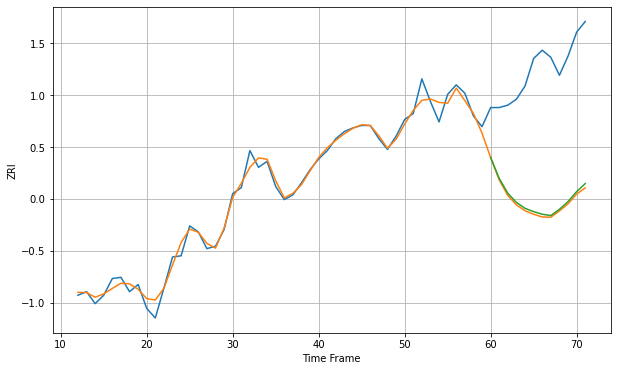

Wall time: 15.9 s
89119 6.069429404785835 111.80818441680668 109.89963148184485 [1090.19415806 1072.66242889 1060.25394868 1052.59670835 1047.70838667
 1044.9441186  1042.7595864  1041.66459658 1046.82738346 1053.34319703
 1061.64590525 1068.40279464]

Got an mse at 0.0025 in round 112 and stopped training

60 60 12


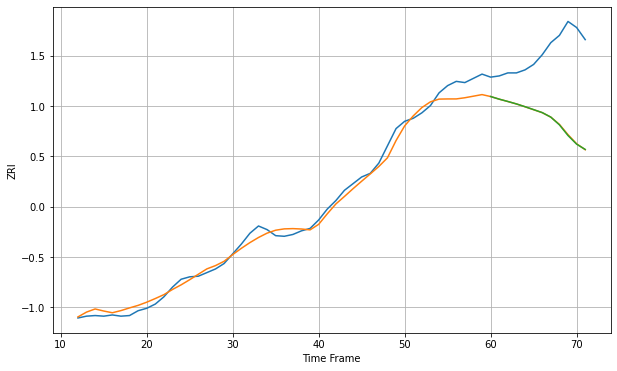

Wall time: 6.85 s
89502 12.463853027859447 118.19535003509965 118.46611913273644 [1031.94211974 1027.59786905 1023.77096875 1019.74239924 1015.12890647
 1010.30255966 1005.40281572  997.91919829  985.14815979  967.48375465
  953.26244278  944.53019034]
60 60 12


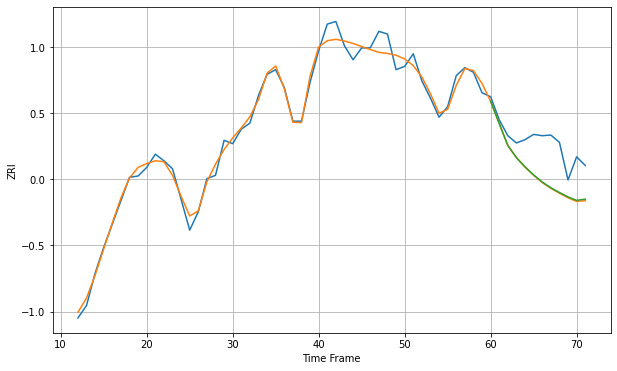

Wall time: 15.6 s
90001 12.404160153442692 51.62260166381937 50.76090518054621 [2328.00061529 2294.47105173 2261.31318368 2242.87536832 2228.820585
 2216.58502637 2205.89426747 2197.18074218 2190.02128473 2183.31895863
 2178.13395567 2179.90025766]
60 60 12


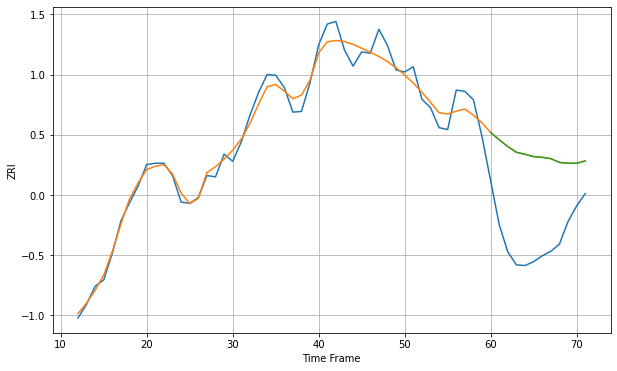

Wall time: 15.8 s
90002 16.83231741859518 132.3027106480493 132.25061574454546 [2317.46783779 2306.24626402 2295.77026546 2286.90746318 2283.80586385
 2280.20653063 2279.12319066 2277.12318609 2271.20326207 2269.99439363
 2269.96094958 2273.42491993]

Got an mse at 0.0025 in round 145 and stopped training

60 60 12


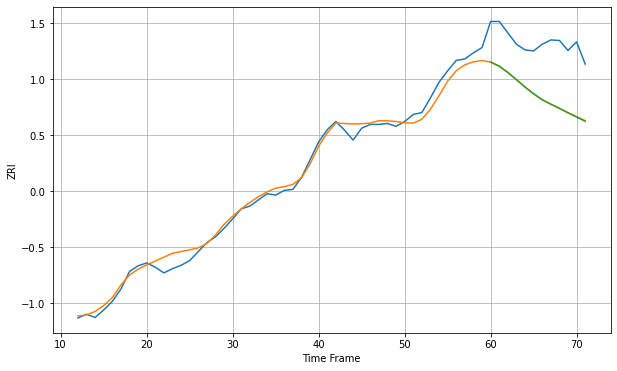

Wall time: 7.56 s
90003 15.057472081459233 112.41026654349396 112.78376356711561 [2054.31348217 2045.74337715 2032.4360803  2017.44237022 2001.60253196
 1987.66347034 1974.94054762 1965.5235736  1956.65281017 1947.3246899
 1938.51439825 1929.56018267]

Got an mse at 0.0025 in round 140 and stopped training

60 60 12


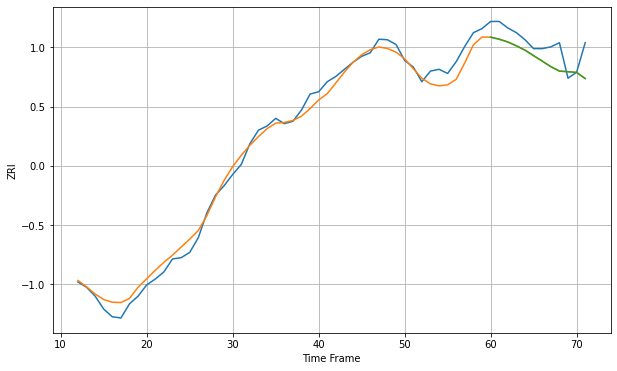

Wall time: 7.67 s
90004 14.606592363844609 30.000146490612597 29.98777137943077 [2257.42409696 2253.9659833  2249.27118432 2242.72052226 2235.37643939
 2226.11044584 2216.84617203 2207.54858334 2199.90608904 2198.91774383
 2197.69710311 2187.39720852]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


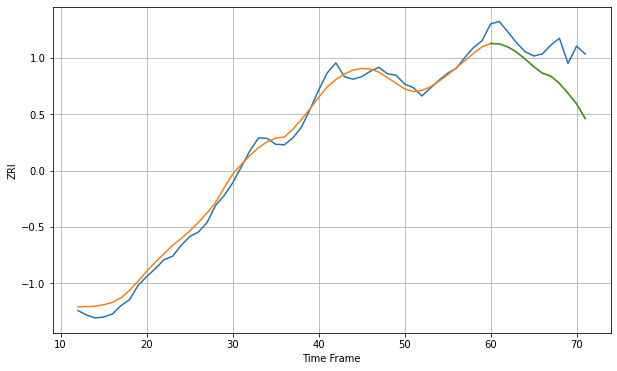

Wall time: 7.81 s
90006 15.008856980737763 66.9412047618034 67.02720038791011 [2164.42333564 2163.63907346 2157.44065436 2147.10736063 2133.17301469
 2117.66010278 2104.42186846 2098.15778891 2083.61747509 2063.78180609
 2041.71120816 2012.03927386]

Got an mse at 0.0025 in round 271 and stopped training

60 60 12


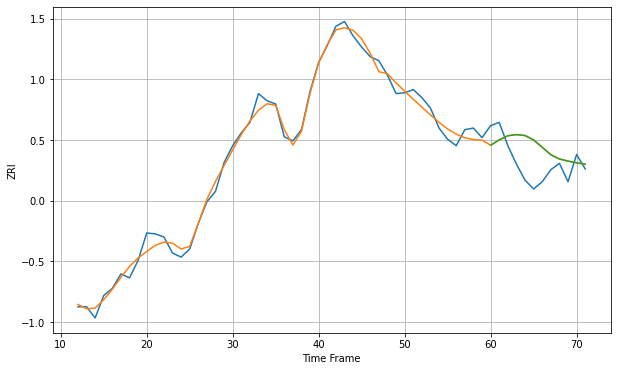

Wall time: 10.4 s
90007 9.101002855273839 32.19534260907786 32.21574172743152 [2226.53757355 2233.19789094 2238.39149905 2239.82501305 2238.63792179
 2233.21516015 2223.96774902 2214.76196726 2209.43828619 2206.74476965
 2204.77313206 2202.72757232]

Got an mse at 0.0025 in round 425 and stopped training

60 60 12


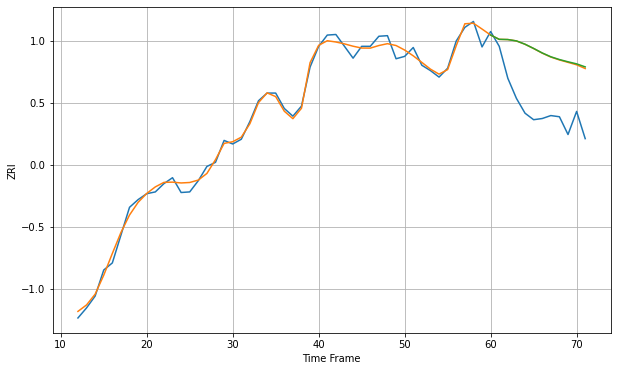

Wall time: 14 s
90011 9.94017828507138 94.95717074478067 95.62584044881673 [2400.02843208 2392.79480928 2392.44964529 2390.14387254 2384.55560419
 2377.43931355 2369.80109901 2363.34238351 2358.65791649 2354.86473107
 2351.35446712 2346.26123032]

Got an mse at 0.0025 in round 392 and stopped training

60 60 12


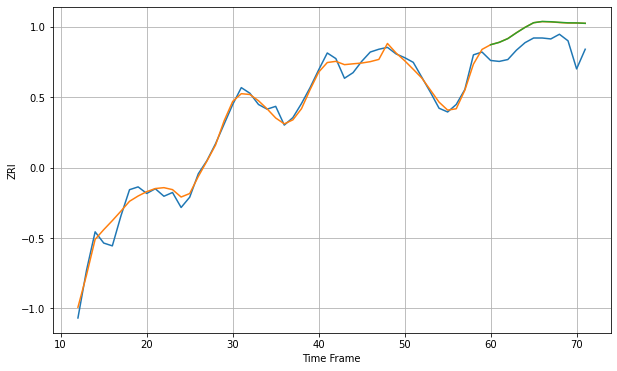

Wall time: 13.3 s
90012 7.725182090233577 23.102655454873105 23.154050689221826 [2430.83274174 2433.35761659 2437.35480525 2443.55760104 2449.32344791
 2454.32710418 2455.65831948 2455.36720162 2454.71965872 2454.19707091
 2454.11466303 2453.68859223]
60 60 12


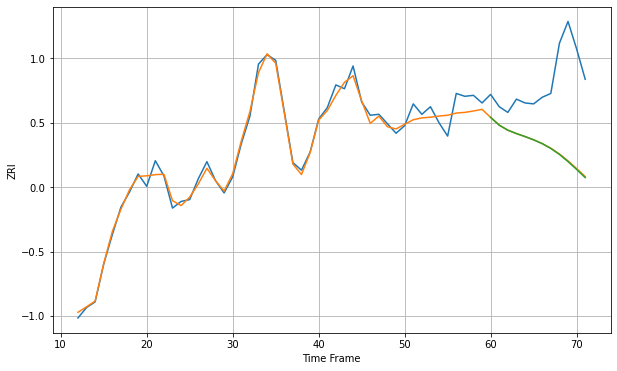

Wall time: 15.7 s
90015 8.057634996268847 77.92950117854407 78.38152174853207 [2498.75163415 2490.51742852 2485.2459945  2481.64882969 2478.49034859
 2475.02593397 2470.98581869 2465.92656617 2459.63955065 2452.07854167
 2443.82474965 2435.18465745]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


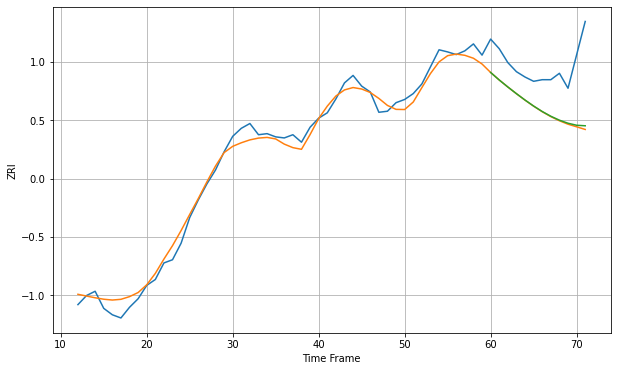

Wall time: 8.79 s
90016 16.057589376074063 88.94990955320036 86.98910591838349 [2296.52342624 2282.4649398  2269.3767507  2256.86913492 2244.89844224
 2233.68578799 2223.46779529 2214.58252538 2207.23558836 2201.50675673
 2197.74782402 2196.74638898]

Got an mse at 0.0025 in round 173 and stopped training

60 60 12


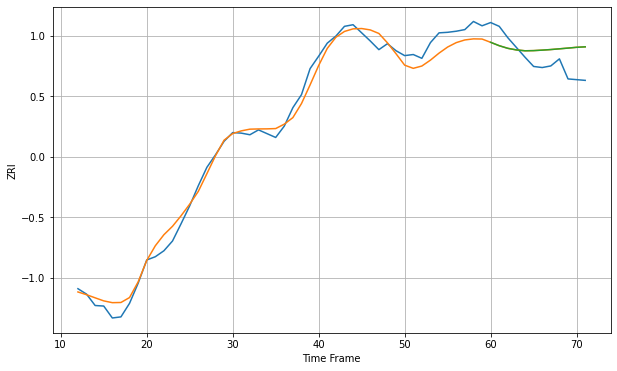

Wall time: 8.23 s
90018 17.780789855566713 37.556993428090266 37.54103020948442 [2217.52851565 2211.28572997 2206.43270842 2203.48747836 2201.90732195
 2202.21462313 2203.10671785 2204.17809696 2205.5092672  2206.86784356
 2208.32297713 2209.22654795]

Got an mse at 0.0025 in round 179 and stopped training

60 60 12


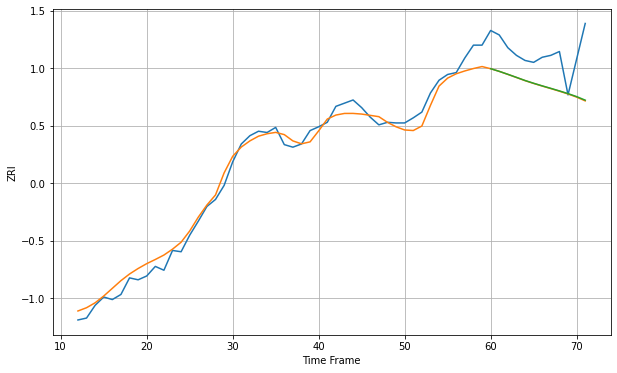

Wall time: 8.31 s
90019 14.445786320375305 56.88170277262959 56.47321194832814 [2269.06945043 2264.92306684 2260.27156809 2255.46663612 2250.57851029
 2246.21414827 2242.13246144 2238.22550708 2234.22088289 2229.99233645
 2225.30269889 2219.72737803]
60 60 12


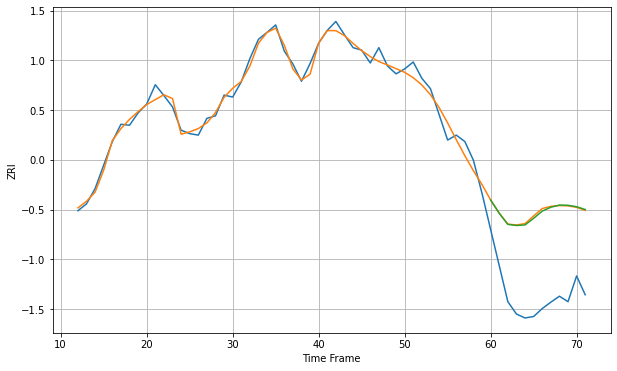

Wall time: 15.5 s
90022 13.973489028207133 170.3087058911122 169.1833072725573 [2220.75460656 2193.94434699 2171.49202126 2169.14652382 2170.22863691
 2183.61025292 2198.21155523 2206.04146576 2210.44524031 2210.05576157
 2207.12581464 2201.4744474 ]
60 60 12


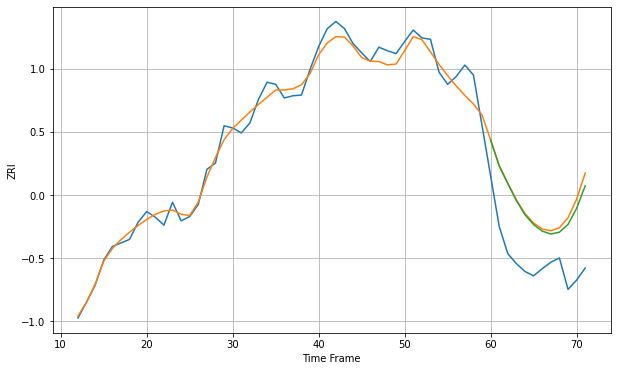

Wall time: 15.7 s
90023 14.350101925366266 85.03747562203677 79.46514121323806 [2216.13313665 2179.71971112 2155.07531871 2131.1931078  2111.43484889
 2097.67277777 2088.5133857  2084.5724016  2087.03199212 2097.92772259
 2120.48098419 2151.98835269]

Got an mse at 0.0025 in round 84 and stopped training

60 60 12


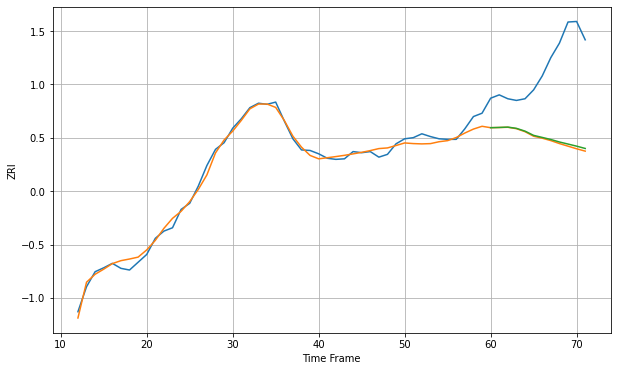

Wall time: 6.16 s
90024 9.483051592100866 138.9588409038527 136.49285241359595 [2905.96172271 2906.39764653 2907.01066983 2904.78299148 2899.78907206
 2892.15797027 2888.46093882 2884.75947642 2880.26898856 2876.54246124
 2872.76125251 2868.61216701]

Got an mse at 0.0025 in round 447 and stopped training

60 60 12


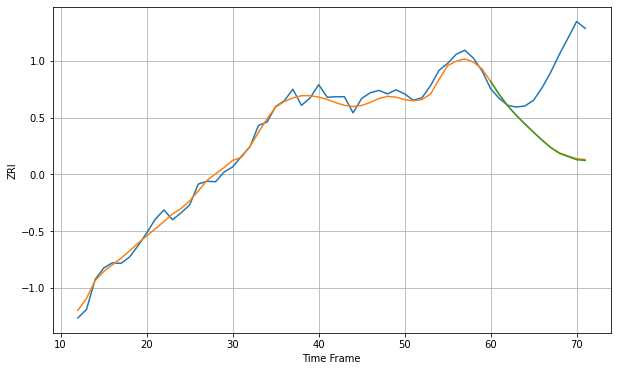

Wall time: 14.5 s
90025 10.934513484786107 132.5447445598506 133.3242577349833 [3014.71853867 2991.83284697 2971.91850428 2955.32479728 2940.40215707
 2926.06746838 2912.16962819 2899.3254348  2889.58406008 2883.84789033
 2878.43034778 2877.0397298 ]

Got an mse at 0.0025 in round 165 and stopped training

60 60 12


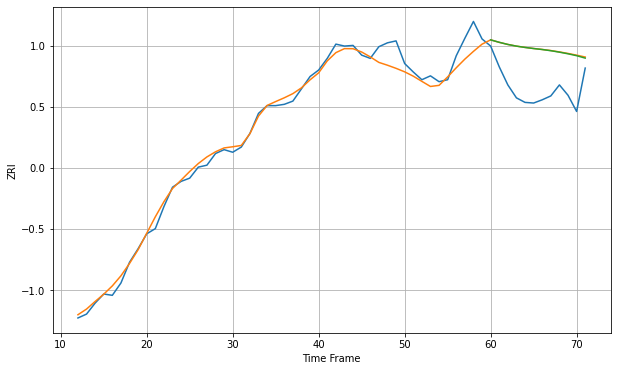

Wall time: 7.97 s
90026 14.080173264729623 65.64302372720567 65.40030569892113 [2482.58694174 2478.78222446 2475.50086874 2472.89672042 2470.8938864
 2469.184615   2467.64277355 2465.83391627 2463.58812088 2461.04573255
 2458.13813549 2454.39998857]

Got an mse at 0.0025 in round 196 and stopped training

60 60 12


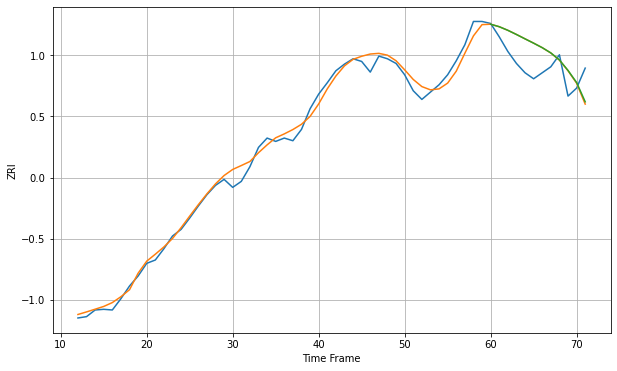

Wall time: 8.63 s
90027 10.75567276650564 35.25647395673401 34.878543684698435 [2358.85206179 2355.12397562 2349.72078047 2343.46121929 2336.89027252
 2330.42856592 2323.68808825 2315.80424412 2305.25784685 2289.54802801
 2271.40931165 2242.41573531]

Got an mse at 0.0025 in round 214 and stopped training

60 60 12


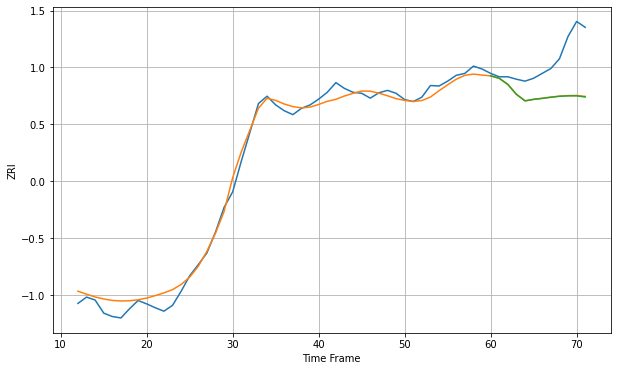

Wall time: 9.25 s
90028 16.648215902859715 79.14770550425418 79.57064061508444 [2416.94753902 2411.90971677 2399.2705882  2378.78278382 2365.40944298
 2368.4844876  2370.50497411 2372.86680412 2374.81426128 2375.71852978
 2375.73085278 2373.3708157 ]

Got an mse at 0.0025 in round 237 and stopped training

60 60 12


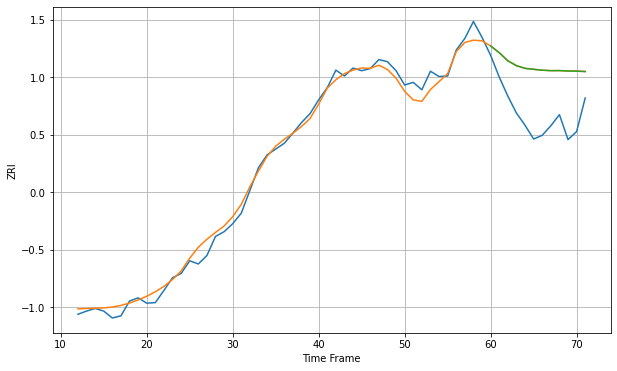

Wall time: 9.6 s
90029 14.405172555115787 95.34002461535697 95.25044944906067 [2448.78344208 2435.955752   2420.68439658 2411.49853599 2406.38958027
 2404.65598637 2402.96138497 2402.10372999 2402.20393979 2401.37433067
 2401.13689031 2400.25988893]
60 60 12


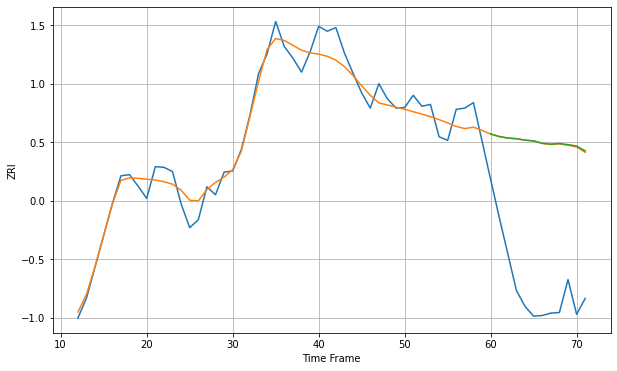

Wall time: 15.4 s
90031 22.90899989072369 239.98603936036992 240.55681709050836 [2436.46796356 2432.39899936 2429.95345136 2428.82826238 2426.53463271
 2425.2400174  2421.37483827 2419.88514052 2420.98351966 2419.11627352
 2416.81508109 2408.80379861]

Got an mse at 0.0025 in round 279 and stopped training

60 60 12


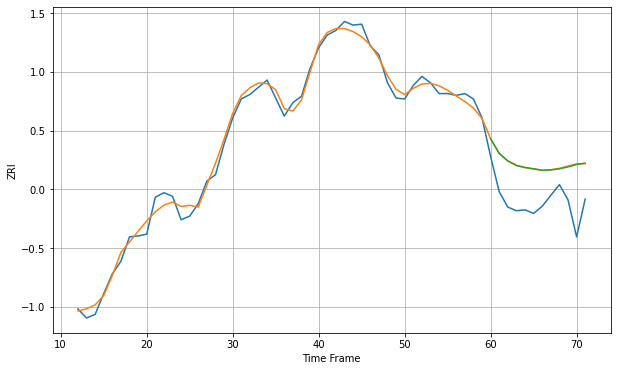

Wall time: 10.7 s
90032 7.8554934922251665 44.91176472236719 44.81305275512564 [2035.83951136 2019.57101945 2011.2706006  2006.30148401 2004.00060952
 2002.54252405 2000.84061701 2001.26282481 2002.46607337 2004.65546429
 2007.30232606 2008.83683362]

Got an mse at 0.0025 in round 432 and stopped training

60 60 12


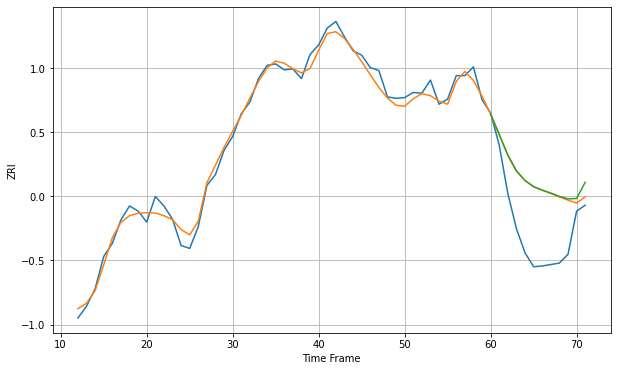

Wall time: 13.9 s
90033 10.652912032928164 73.49842721240421 74.43604415145387 [2260.20861465 2232.69221858 2204.30121716 2182.85900526 2169.76114761
 2161.44737824 2156.68597573 2152.59436363 2148.09437985 2144.69834687
 2145.22279954 2167.34454993]

Got an mse at 0.0025 in round 174 and stopped training

60 60 12


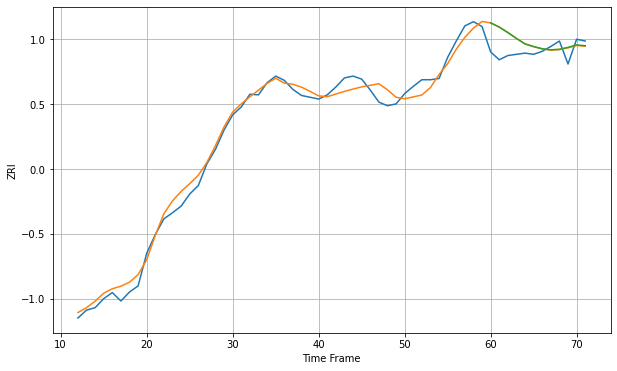

Wall time: 8.17 s
90034 13.724730151931132 27.266953986644396 27.24040352736414 [2666.04030196 2659.03847471 2650.02399336 2640.29910531 2631.26533527
 2626.84443947 2623.26310281 2621.43277276 2622.43168688 2625.56310156
 2629.64916739 2628.21920767]

Got an mse at 0.0025 in round 156 and stopped training

60 60 12


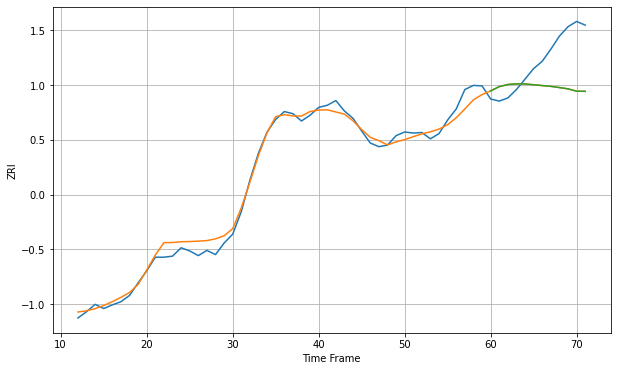

Wall time: 7.85 s
90035 13.872447534809151 74.9164933403729 74.93012440319502 [2946.44792536 2954.61488136 2958.63768223 2959.92694841 2959.75945527
 2958.16791992 2956.69563012 2955.17229697 2952.86488834 2950.35305317
 2945.90580545 2945.59569738]

Got an mse at 0.0025 in round 198 and stopped training

60 60 12


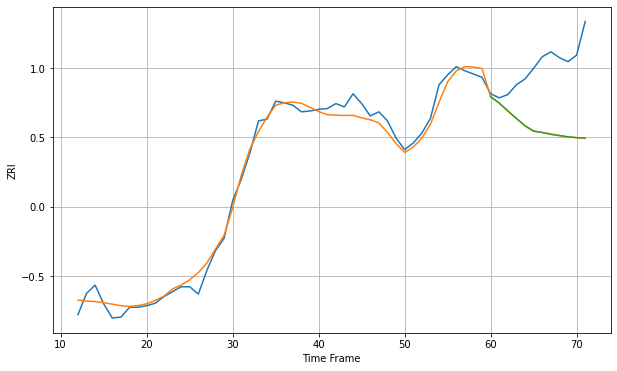

Wall time: 8.93 s
90036 10.553710941407948 80.28298831315423 80.35804957328821 [2557.385091   2549.52796041 2540.10964135 2530.90027626 2521.91651498
 2515.46517034 2513.80669658 2511.63971599 2510.04330217 2508.48866643
 2507.51781897 2506.96633674]

Got an mse at 0.0025 in round 482 and stopped training

60 60 12


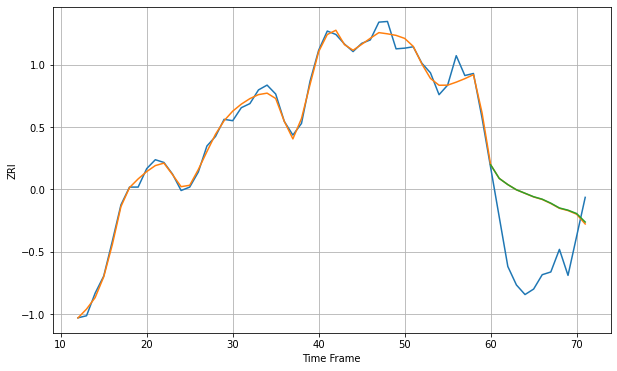

Wall time: 15 s
90037 9.373342680773945 97.47260075563949 97.62561701727876 [2234.65728173 2214.67067753 2205.63484841 2198.06998415 2192.99610482
 2187.90368287 2184.3133664  2178.51473061 2171.50858863 2168.28953612
 2163.36337849 2150.97565012]

Got an mse at 0.0024 in round 329 and stopped training

60 60 12


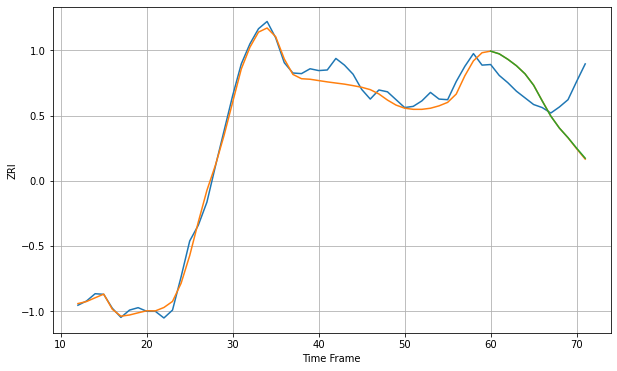

Wall time: 11.8 s
90038 13.782434676717312 64.44802260667812 63.99559562495925 [2459.05574496 2454.5851588  2445.61926307 2435.0024699  2421.62645765
 2402.84430541 2376.92041177 2351.8486786  2332.10560886 2316.38468507
 2299.05073579 2282.50216591]
60 60 12


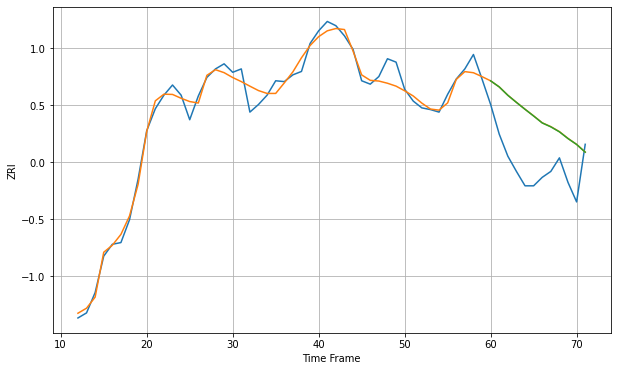

Wall time: 15.5 s
90039 10.94555985955146 61.90181370161615 61.802667366663094 [2476.90649794 2469.72517686 2459.87121598 2451.45551226 2443.31367098
 2435.41552454 2427.21743154 2422.61757459 2416.72008162 2408.76074274
 2401.82674185 2392.74981836]

Got an mse at 0.0025 in round 405 and stopped training

60 60 12


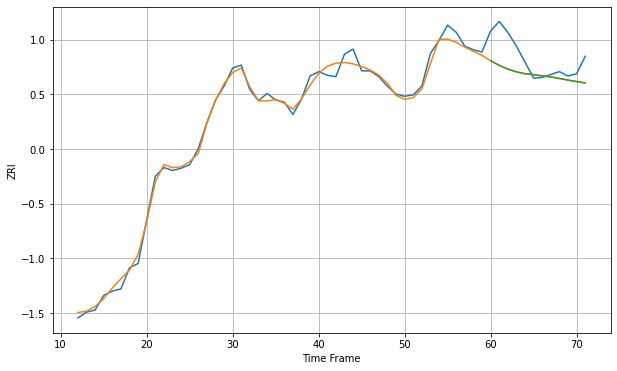

Wall time: 13.6 s
90041 7.87838288144504 30.26768414772542 30.2908868618545 [2161.07077998 2154.5831144  2149.41407185 2145.62799045 2143.01703303
 2141.77853848 2140.12650568 2138.6471731  2136.54293946 2134.26122881
 2132.27141246 2130.34740935]

Got an mse at 0.0025 in round 270 and stopped training

60 60 12


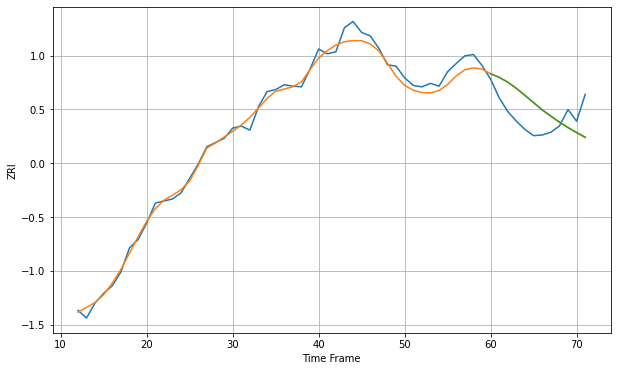

Wall time: 10.3 s
90042 10.216684727712595 37.19622209781237 37.12531817955969 [2176.99011385 2171.81458798 2164.72342203 2155.73887815 2145.52394305
 2135.02779315 2124.59008052 2115.47971236 2106.81884173 2098.91287191
 2091.65066908 2084.94107944]

Got an mse at 0.0025 in round 285 and stopped training

60 60 12


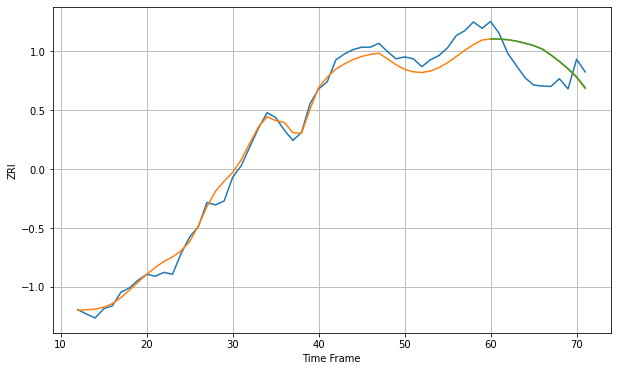

Wall time: 10.7 s
90043 19.903163725902566 51.617178445268024 51.568054855434774 [2252.02237619 2251.90888978 2250.37567602 2247.48158124 2243.25993803
 2238.30419566 2231.3013206  2219.17265172 2205.82628884 2190.91245367
 2173.79281447 2151.88542205]

Got an mse at 0.0025 in round 361 and stopped training

60 60 12


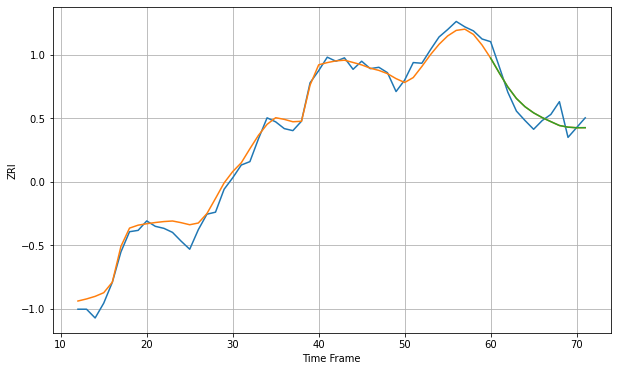

Wall time: 12.4 s
90044 12.64419932744106 18.101209739969597 18.106719249293167 [2188.61482863 2166.70307512 2145.77868613 2128.70574299 2116.47718376
 2107.38546018 2100.35591901 2094.37753597 2088.60684189 2086.16312839
 2085.26825678 2085.35995541]

Got an mse at 0.0025 in round 279 and stopped training

60 60 12


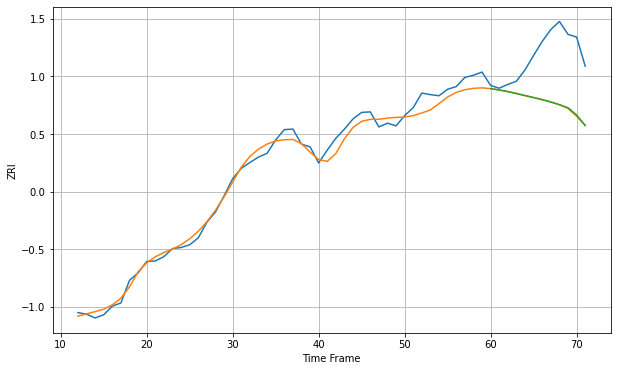

Wall time: 10.5 s
90045 14.602527268507052 98.2447562907318 97.70674795621002 [2588.1337763  2585.70046089 2582.67719806 2579.12724564 2575.30337873
 2571.60752319 2567.77337114 2563.41382761 2558.39950807 2552.63658634
 2539.39511396 2519.72902096]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


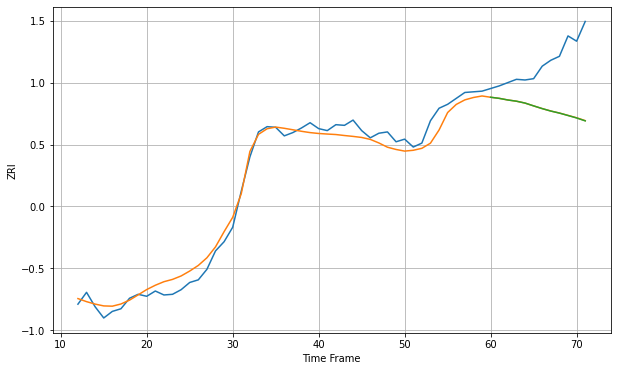

Wall time: 7.27 s
90046 14.243295340666954 78.4232671053308 78.54155770571622 [2486.72201708 2485.04284269 2482.58777832 2480.72781891 2477.88719986
 2473.59752904 2469.4659036  2465.73775772 2462.63396794 2458.97110955
 2455.2397339  2450.79228611]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


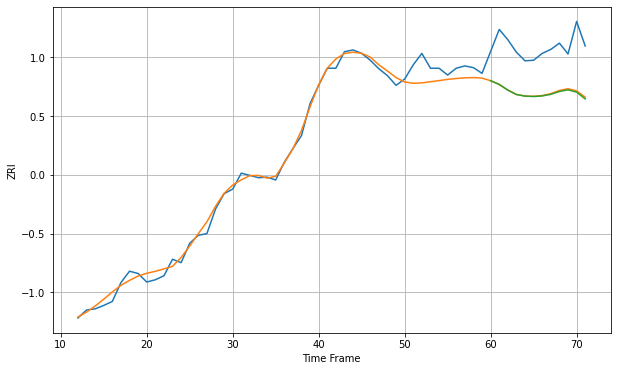

Wall time: 12.2 s
90047 13.708191967203245 80.61115247519038 81.66131663036691 [2070.08105843 2063.58059276 2053.60954507 2045.88282551 2043.04208297
 2042.33102518 2043.36988728 2046.20500558 2051.21585891 2054.0718744
 2050.06847622 2038.27534839]

Got an mse at 0.0025 in round 397 and stopped training

60 60 12


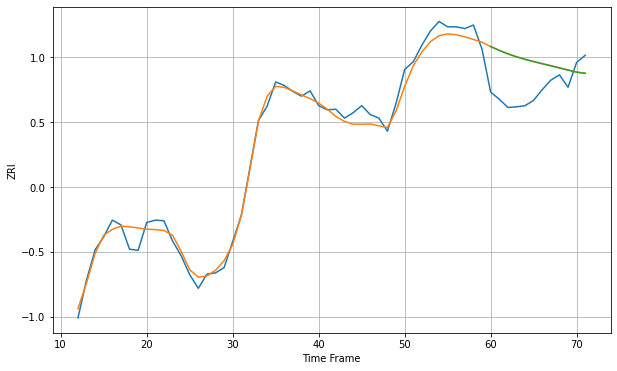

Wall time: 13.1 s
90048 14.898869194143522 59.88745977977332 59.88969085140534 [2904.78530368 2898.24166529 2892.43567065 2887.48004199 2883.14843983
 2879.33791697 2875.74874096 2872.34734282 2868.67269246 2865.03848427
 2861.48443716 2859.48898826]

Got an mse at 0.0025 in round 339 and stopped training

60 60 12


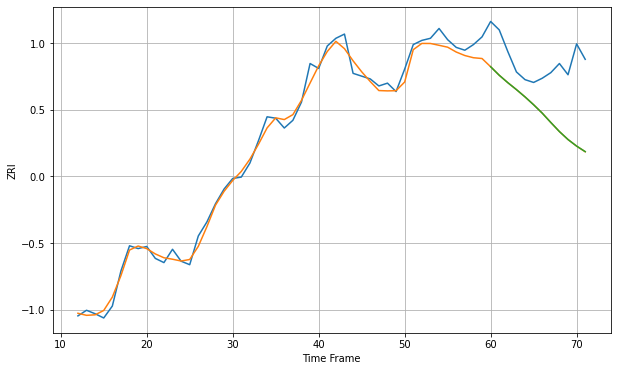

Wall time: 12 s
90061 11.244086642983453 79.96221912396321 79.93700670315903 [2181.41929317 2169.26758864 2158.65320117 2148.79584153 2138.36829283
 2127.18106874 2115.21823217 2101.87569402 2088.93998158 2077.57649868
 2068.20913008 2060.30917145]

Got an mse at 0.0025 in round 243 and stopped training

60 60 12


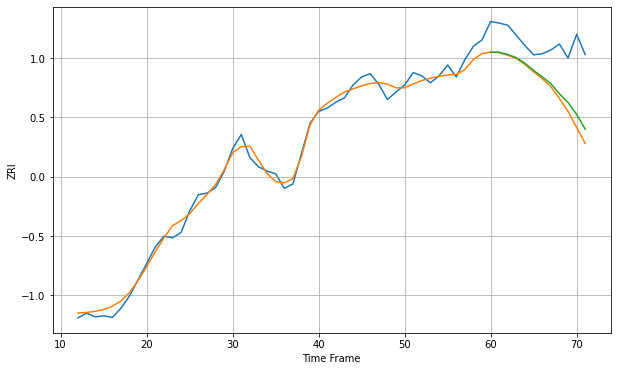

Wall time: 9.69 s
90062 13.308443598317185 90.07269055350667 79.15700983882337 [2069.91083786 2069.76598026 2065.54360123 2059.73889897 2049.09781916
 2036.01752235 2024.19801805 2011.47212749 1992.58107619 1976.46119301
 1954.32952914 1926.93447663]
60 60 12


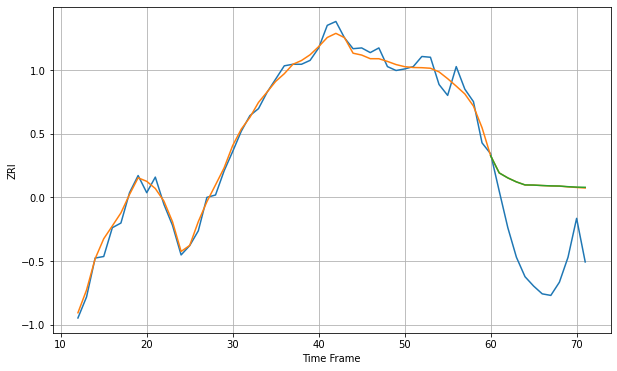

Wall time: 15.5 s
90063 10.378615313436738 99.13486016971382 99.27029266525214 [2268.43282737 2246.37342018 2239.96761885 2234.83412246 2230.95391273
 2230.7849224  2230.19759051 2229.72172567 2229.54798676 2228.69295545
 2228.15729048 2227.89437586]
60 60 12


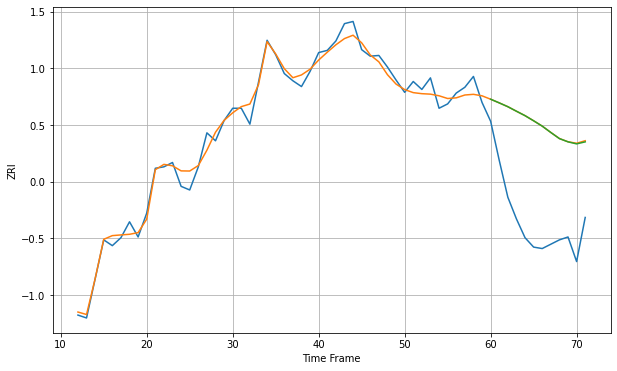

Wall time: 15.6 s
90065 12.045324349354095 138.922289840618 138.70704750625916 [2414.48977137 2409.42171582 2404.14159826 2397.87919628 2391.75712074
 2384.65426634 2377.26609412 2368.48289734 2360.04219807 2355.5302765
 2352.7188901  2355.51960451]

Got an mse at 0.0025 in round 212 and stopped training

60 60 12


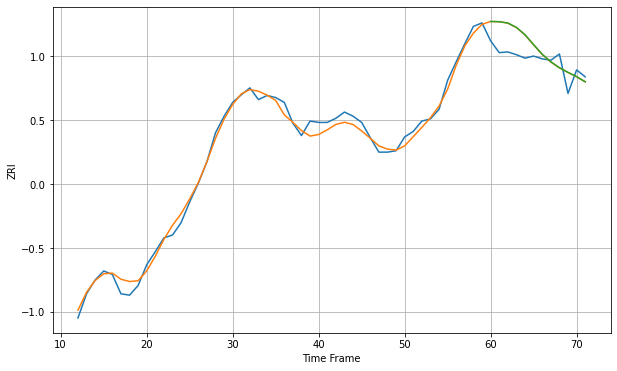

Wall time: 9.04 s
90066 9.584459186105384 27.36559791119075 27.451094794105746 [2735.10246812 2734.754091   2732.83661978 2726.51887024 2715.8869843
 2701.56932405 2687.64988001 2676.7262933  2668.141543   2661.40370021
 2655.25489115 2647.78482631]

Got an mse at 0.0025 in round 433 and stopped training

60 60 12


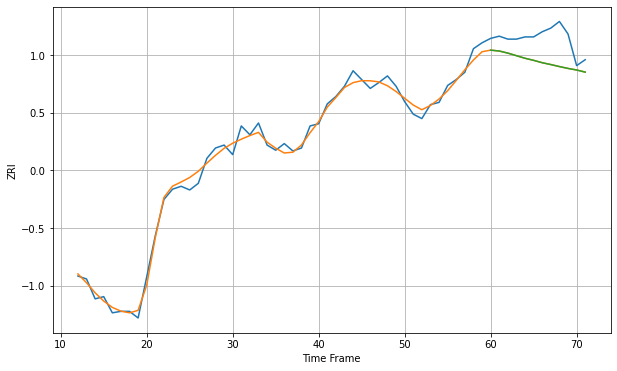

Wall time: 14 s
90068 8.727432834787608 34.011448028082164 34.015317231886335 [2410.03262378 2408.84288131 2405.99051455 2402.49142422 2398.97592948
 2396.15305483 2392.93382902 2390.42282305 2387.70020017 2385.1577091
 2383.05997027 2380.14754651]

Got an mse at 0.0025 in round 228 and stopped training

60 60 12


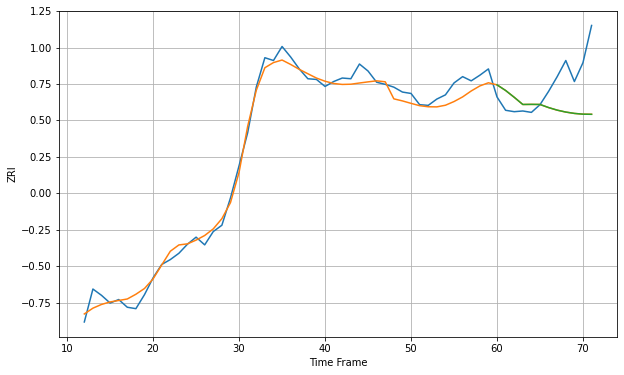

Wall time: 9.4 s
90069 12.766671426722711 52.83577787620431 52.83828668330368 [2727.28746616 2719.24840629 2709.54850368 2699.29179373 2699.42969659
 2699.29481173 2694.90003759 2691.22659518 2688.48249463 2686.53618369
 2685.45209922 2685.234469  ]

Got an mse at 0.0025 in round 498 and stopped training

60 60 12


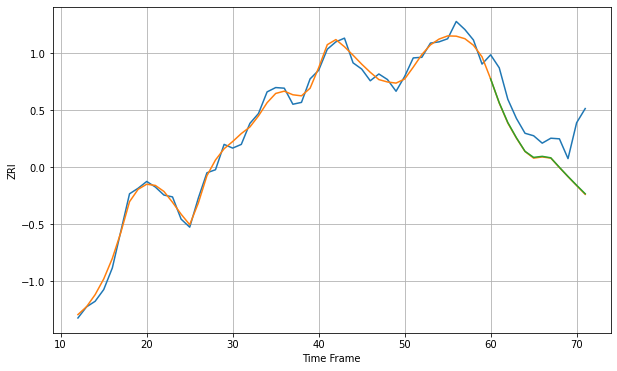

Wall time: 15.4 s
90220 10.387786846519454 60.3115632404273 59.782033691722944 [2147.9784892  2109.43456633 2077.34386763 2052.68020656 2030.77289108
 2020.94690743 2022.66629755 2020.27992122 2004.89750396 1990.08354099
 1975.84760715 1962.05864835]
60 60 12


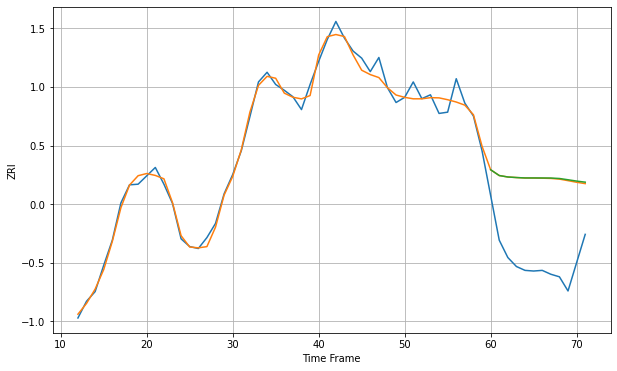

Wall time: 15.7 s
90221 11.861702101319205 130.73125008921076 131.35331892978115 [2189.45934414 2180.46994847 2178.21252816 2177.34897758 2176.70857082
 2176.70966869 2176.66106987 2176.56611271 2175.85960507 2173.89944194
 2171.84626192 2170.13531618]

Got an mse at 0.0025 in round 108 and stopped training

60 60 12


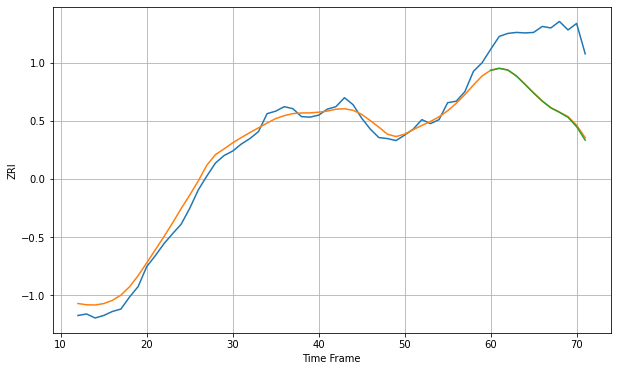

Wall time: 6.71 s
90232 16.778488852863635 137.0754173718685 138.26563310223065 [2755.95954726 2759.97848392 2756.51397193 2744.53547358 2727.67468599
 2710.44756425 2694.27531983 2680.69149958 2671.65348846 2661.67987946
 2642.80076927 2615.77787899]

Got an mse at 0.0025 in round 463 and stopped training

60 60 12


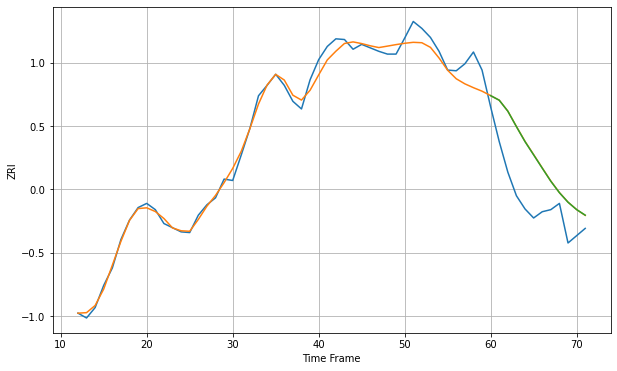

Wall time: 14.8 s
90247 13.832885788757485 64.84139779597346 64.65338686667411 [2317.19503094 2310.60386448 2294.79989588 2272.50136969 2250.94185385
 2231.89812722 2212.78937743 2193.91326393 2177.42399953 2163.698749
 2153.10128179 2145.04175138]

Got an mse at 0.0025 in round 356 and stopped training

60 60 12


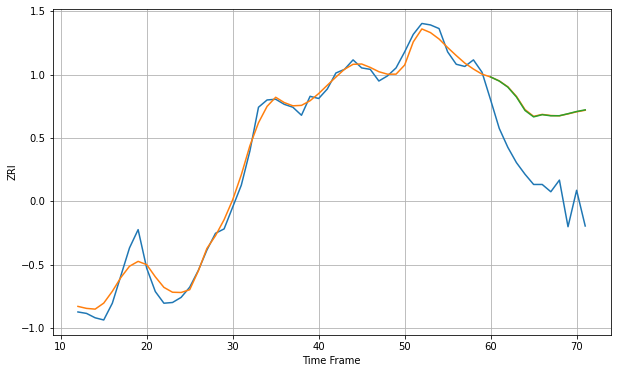

Wall time: 12.3 s
90250 12.61625713375371 102.41456966696435 102.25571443300244 [2306.52230198 2300.98423714 2292.61644825 2279.10405052 2260.55771079
 2251.76664019 2254.80701229 2253.27418539 2253.36078308 2256.13793949
 2259.16273928 2261.42167843]

Got an mse at 0.0025 in round 212 and stopped training

60 60 12


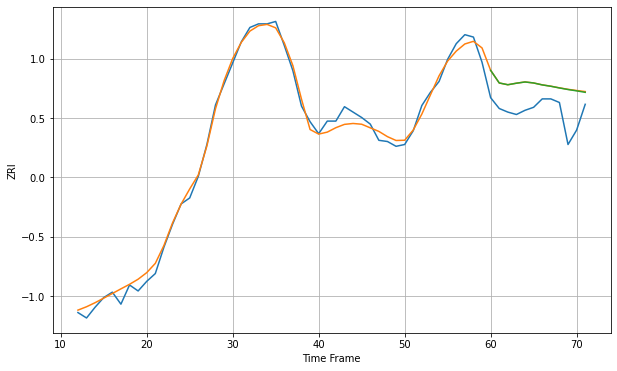

Wall time: 9.03 s
90254 11.641058228691824 47.79611602475455 47.59933695079818 [2734.57855904 2713.57363105 2710.58072176 2713.12353073 2715.18844111
 2713.50895673 2710.31143338 2708.03982557 2705.21668926 2702.6072103
 2700.37376442 2697.95241723]
60 60 12


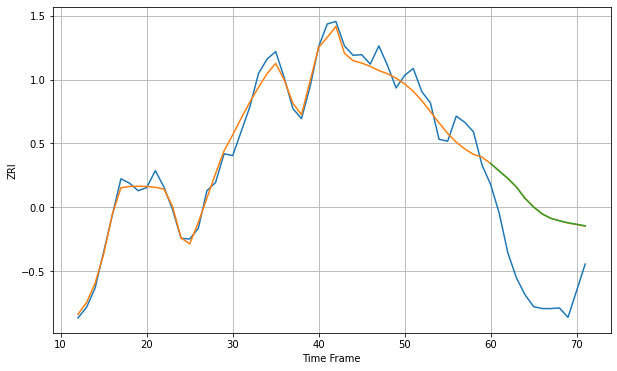

Wall time: 15.7 s
90255 17.971910036309986 125.84115625001702 125.90302761440732 [2292.38847783 2280.37090469 2268.675551   2254.88585915 2236.79170938
 2223.00891068 2211.90617163 2204.96773968 2201.1313886  2197.78981659
 2195.4864228  2193.04179188]

Got an mse at 0.0025 in round 432 and stopped training

60 60 12


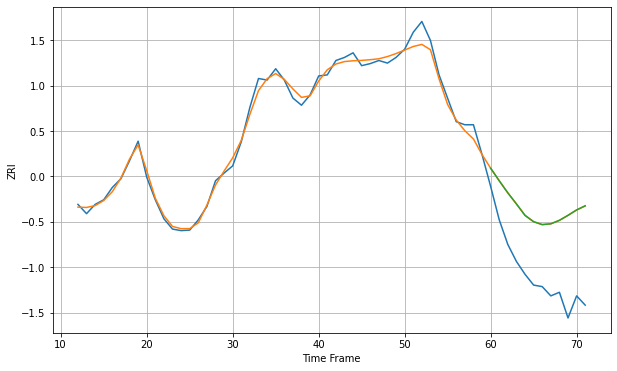

Wall time: 13.9 s
90260 12.482699870025055 134.42097070339256 134.51382206765544 [2436.47005582 2411.97282137 2388.45345468 2366.92455423 2344.63627521
 2332.36105287 2326.69881993 2328.24806264 2335.0171863  2344.7510041
 2355.29154823 2363.36684233]
60 60 12


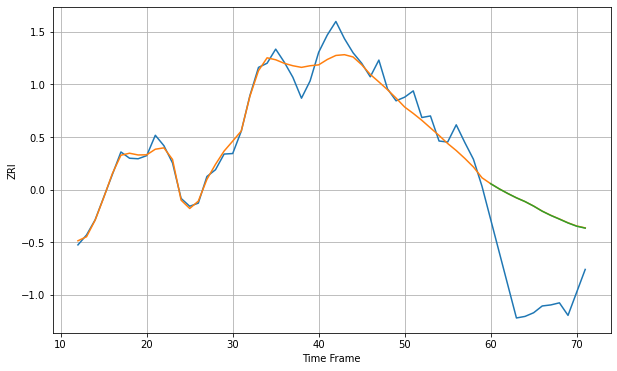

Wall time: 15.6 s
90262 22.256644231000717 167.21136152714988 167.0891698849887 [2237.24768855 2227.3413597  2218.39867493 2210.16960826 2202.95764202
 2194.32519041 2184.55757307 2176.45501097 2169.39066934 2162.03150324
 2155.84263032 2152.09979998]

Got an mse at 0.0025 in round 211 and stopped training

60 60 12


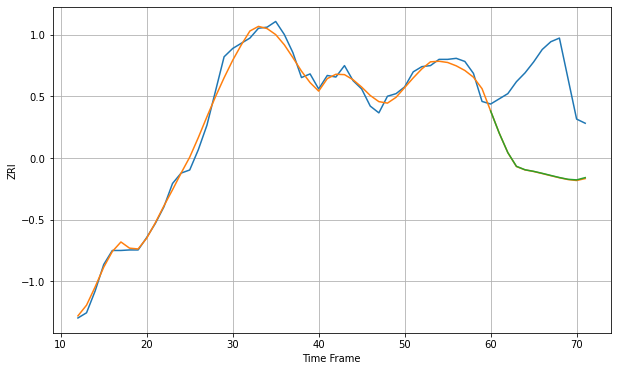

Wall time: 9.02 s
90266 13.809453227254226 178.58987109168103 178.1183620571359 [2857.62641071 2814.98410065 2777.45064079 2751.0688699  2744.40843561
 2741.41129089 2737.55869754 2733.47197992 2729.46429108 2726.06325281
 2724.91857488 2729.27680438]
60 60 12


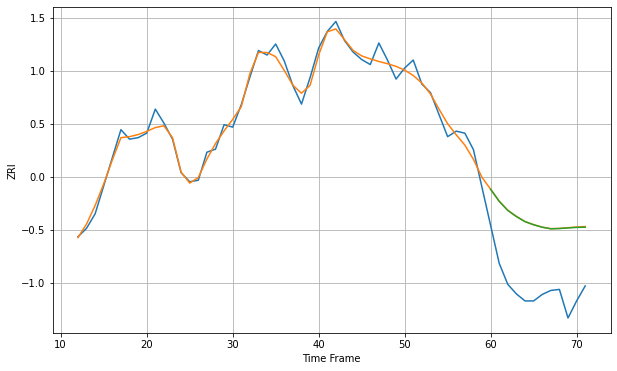

Wall time: 15.7 s
90270 14.790769396113841 138.81141580914547 138.4396002109875 [2219.99762332 2195.89875384 2177.70394449 2165.48113666 2155.29871883
 2149.09012227 2144.15420684 2141.05843381 2141.56117208 2142.76915847
 2143.82923982 2144.21440186]

Got an mse at 0.0024 in round 291 and stopped training

60 60 12


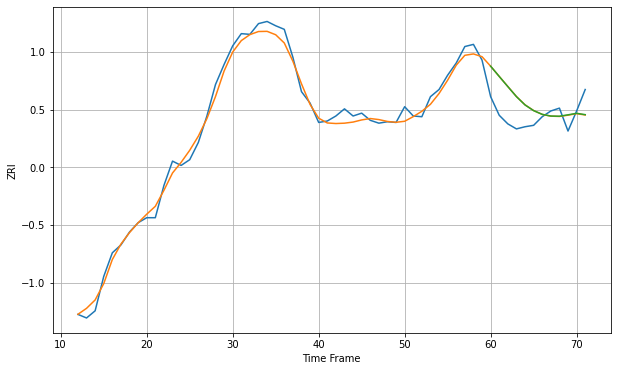

Wall time: 10.8 s
90277 9.972051819309295 32.729549432953384 32.643510069683764 [2684.54642983 2670.22846318 2656.06006456 2642.08068672 2630.45983564
 2622.51410887 2617.29199452 2614.9412173  2614.67281673 2616.6523519
 2618.75671184 2616.8930988 ]

Got an mse at 0.0025 in round 266 and stopped training

60 60 12


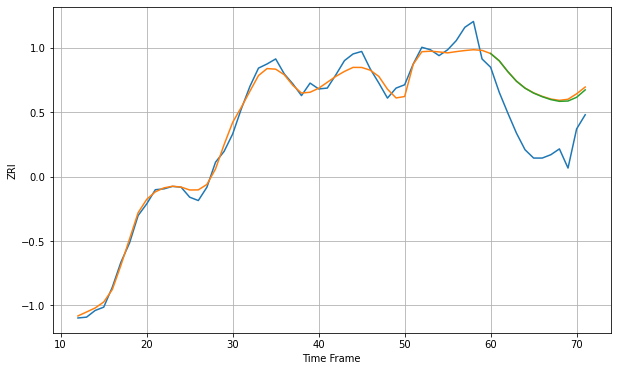

Wall time: 10.2 s
90278 10.04112920423051 59.683721187107054 58.79278547165582 [2514.51371398 2505.77312626 2492.77729324 2481.29974916 2472.88360739
 2467.00233433 2462.66017635 2459.18946308 2457.09797927 2457.48834184
 2461.95822036 2470.852184  ]
60 60 12


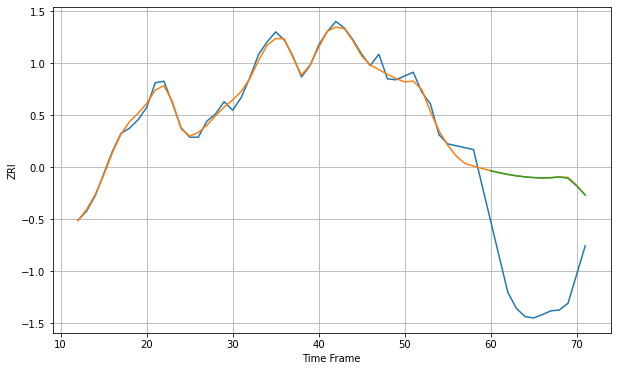

Wall time: 16.6 s
90280 13.27315654426025 244.07654023075884 243.6932775595863 [2314.37355627 2310.14205095 2306.55081727 2303.6143161  2301.39706805
 2299.88903568 2299.08038889 2299.58581668 2301.19074104 2298.3841991
 2282.33254848 2263.01460282]

Got an mse at 0.0025 in round 367 and stopped training

60 60 12


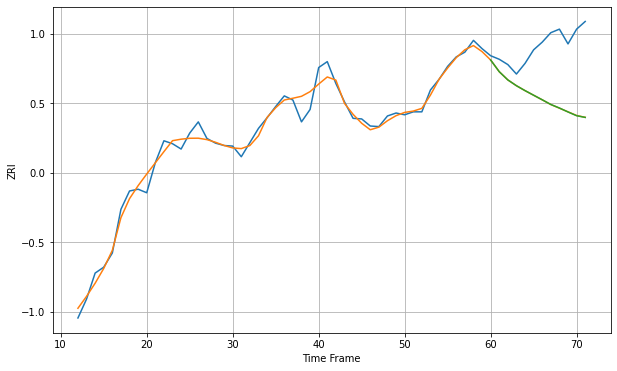

Wall time: 12.5 s
90291 13.47806991576791 96.95031660288777 96.97654308559312 [3177.78225873 3157.99013615 3144.05233972 3134.23511563 3125.91854237
 3118.13138235 3110.40552291 3102.45931318 3096.47396967 3089.78431208
 3083.44298459 3080.56836178]

Got an mse at 0.0025 in round 125 and stopped training

60 60 12


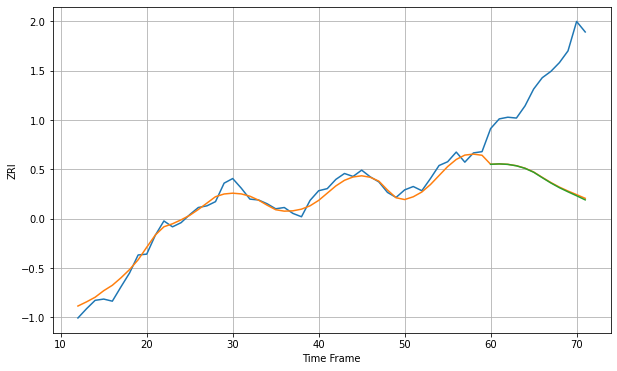

Wall time: 7.18 s
90292 15.283338968957066 251.23820107808808 252.66625349639986 [3106.88773652 3107.8355323  3106.70858911 3103.31765413 3097.28385517
 3088.0475435  3075.07945087 3062.50086938 3051.17673008 3041.35542745
 3031.98684987 3022.21013792]

Got an mse at 0.0025 in round 303 and stopped training

60 60 12


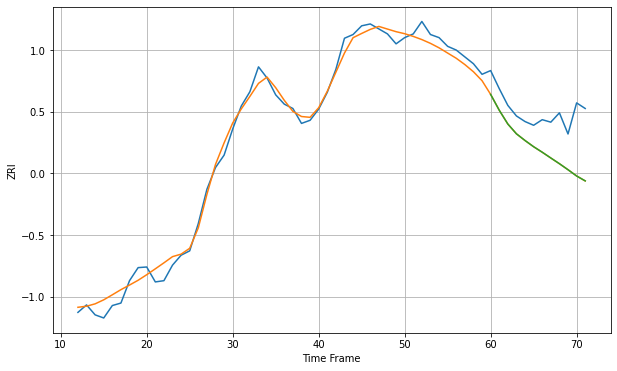

Wall time: 11.2 s
90301 13.876046105000663 64.55507545373383 64.52529341296513 [2138.68428342 2113.24138988 2091.04661504 2075.28848357 2064.50072561
 2054.50886927 2045.66978435 2036.37520729 2027.1982573  2017.4923754
 2007.39917438 1999.56619007]

Got an mse at 0.0025 in round 449 and stopped training

60 60 12


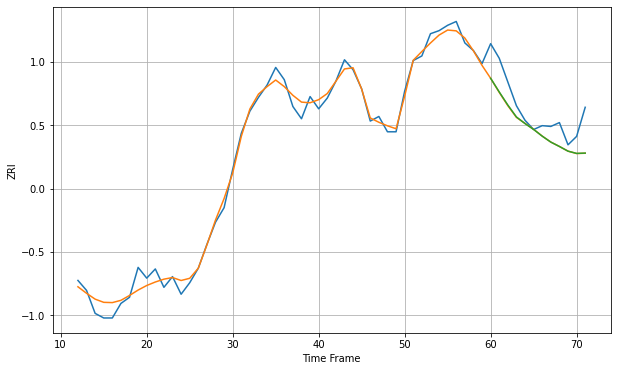

Wall time: 14.4 s
90302 10.493354156793252 30.230646009052595 30.034743244348277 [2279.82437797 2262.03331787 2244.92368669 2229.36639158 2220.70018573
 2213.08027108 2204.29170055 2196.54763282 2190.82875675 2184.73243895
 2181.79354576 2182.21238159]
60 60 12


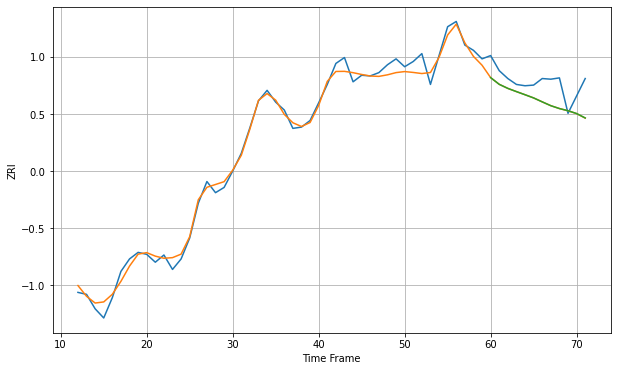

Wall time: 15.6 s
90303 10.879088464116345 31.548179948101705 31.506135065132725 [2018.38610253 2008.1580908  2001.9700931  1997.07264831 1992.3055501
 1987.42898612 1981.43394424 1975.59888966 1971.23636898 1967.93140285
 1963.62680252 1956.91809154]
60 60 12


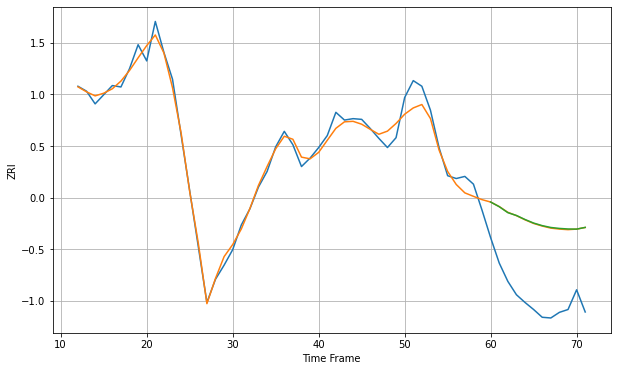

Wall time: 15.6 s
90304 12.840440098339933 108.63847292866001 109.02916258739508 [2505.61330845 2499.00929538 2490.54217634 2486.52252597 2480.80871681
 2475.75301871 2472.11150883 2469.49356965 2468.15170572 2467.35838602
 2467.14532141 2469.61046922]

Got an mse at 0.0025 in round 464 and stopped training

60 60 12


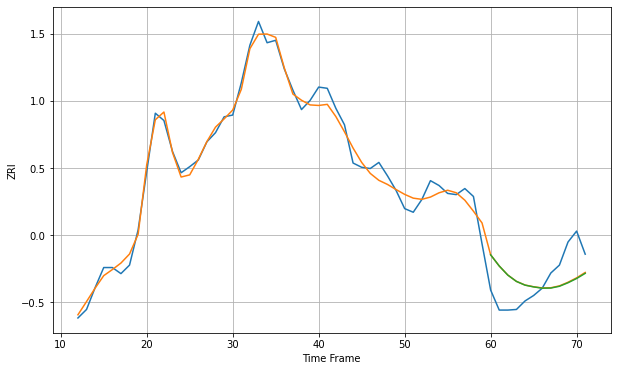

Wall time: 14.9 s
90404 15.092387318571381 48.25220675428664 48.60199371551517 [3091.96047283 3073.53153798 3058.54547037 3048.14538311 3042.04699923
 3039.12390247 3037.04613104 3037.22450329 3040.17602772 3045.95993927
 3052.95620676 3061.45547659]

Got an mse at 0.0024 in round 346 and stopped training

60 60 12


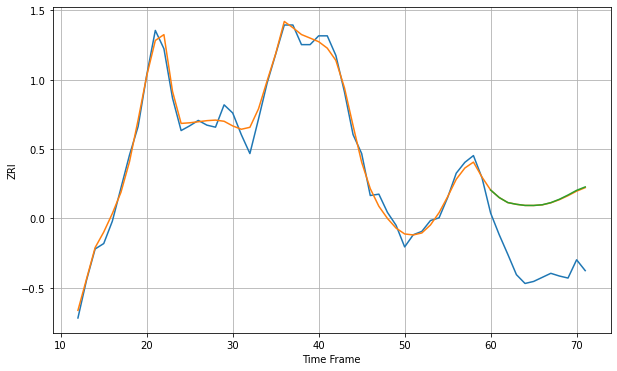

Wall time: 12 s
90405 12.101071289176897 100.8266488759872 101.23247760512666 [3020.07273568 3008.96632127 3001.55390084 2999.00346082 2997.34721514
 2997.2919669  2998.30628508 3001.46107604 3006.46322938 3012.74635711
 3019.63815648 3024.69447042]
60 60 12


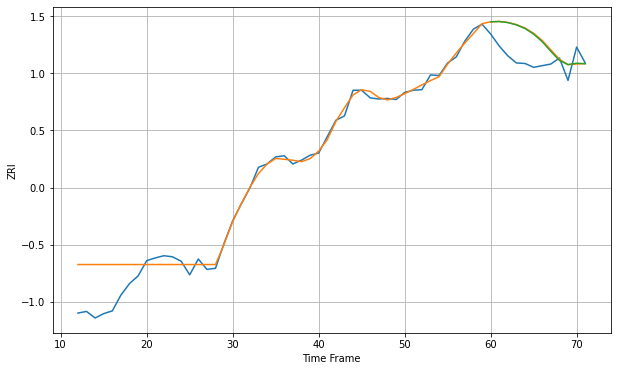

Wall time: 15.5 s
90501 31.390653052273223 44.601181824411256 43.87445775279092 [2173.32542933 2173.88413119 2171.91118645 2167.72669236 2161.07104931
 2150.85719217 2136.92378518 2119.32234811 2102.61592951 2094.99953495
 2097.4956385  2096.58799656]
60 60 12


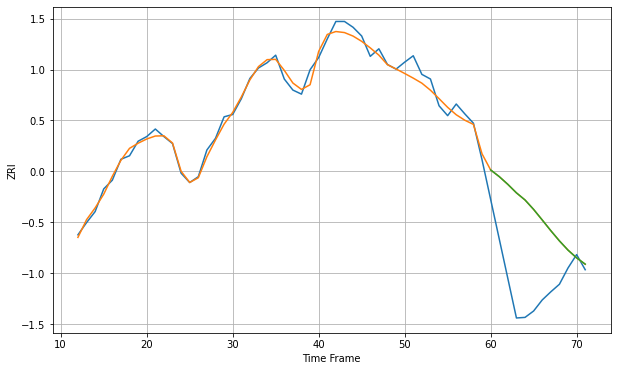

Wall time: 16.2 s
90640 12.030544739857248 127.27917684933635 127.31883773376823 [2195.64414159 2184.18153695 2170.84573789 2156.23345339 2143.98131583
 2127.74427464 2109.58297671 2091.14610807 2073.61641912 2057.66587901
 2044.41564092 2033.63638147]

Got an mse at 0.0024 in round 400 and stopped training

60 60 12


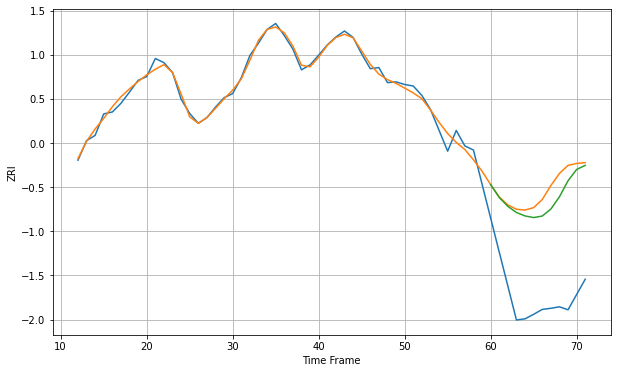

Wall time: 14.7 s
90723 14.154766562554572 289.48553141375885 263.02792659898313 [2329.34611173 2295.15066625 2271.57378423 2255.34258867 2246.11384914
 2241.83757198 2245.8234256  2264.23994281 2296.83459261 2339.36090947
 2369.46752946 2380.36913139]

Got an mse at 0.0025 in round 127 and stopped training

60 60 12


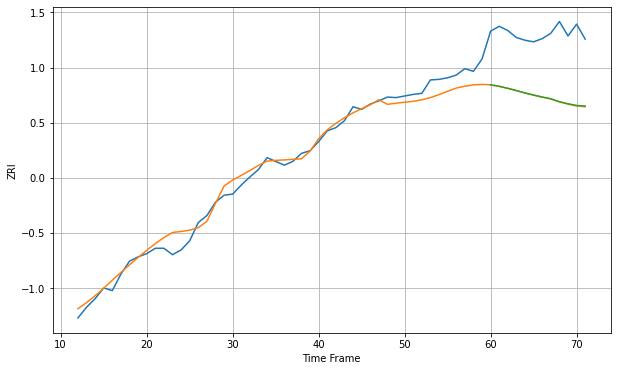

Wall time: 7.49 s
90731 17.500962072032422 118.3995697387709 118.08711182953141 [2011.79260955 2008.98774227 2005.26206144 2000.99163566 1996.58106574
 1992.71078467 1989.04137457 1985.71971936 1980.34661585 1976.46316972
 1973.33297989 1972.27337341]
60 60 12


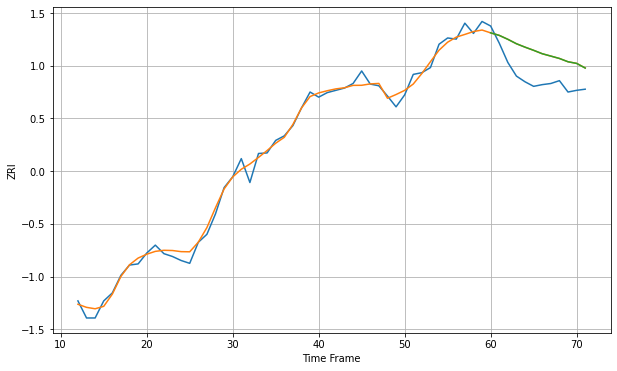

Wall time: 15.7 s
90744 11.256027334517555 46.70695349038712 46.69531310044788 [2210.98697203 2206.55640304 2199.63935596 2191.86319635 2185.8674651
 2180.31492407 2174.32355785 2170.18480137 2165.99512062 2160.19307812
 2157.30912653 2149.11643231]

Got an mse at 0.0025 in round 190 and stopped training

60 60 12


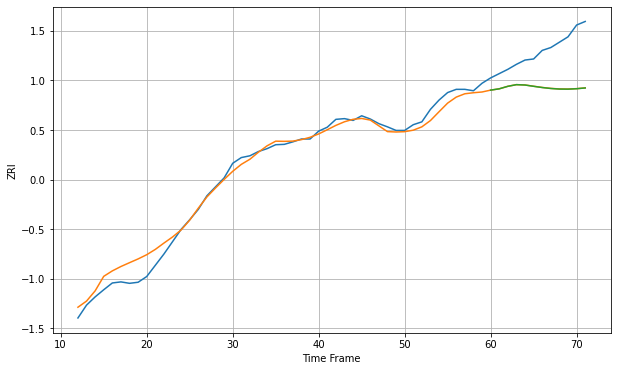

Wall time: 8.64 s
90802 23.64472652537836 110.96616191941891 111.15243303622263 [1983.8180993  1987.44555377 1994.48276993 1999.11235737 1998.09666506
 1994.48133667 1991.05486213 1988.35754487 1986.79206777 1986.52734698
 1987.68853386 1989.90545045]

Got an mse at 0.0025 in round 200 and stopped training

60 60 12


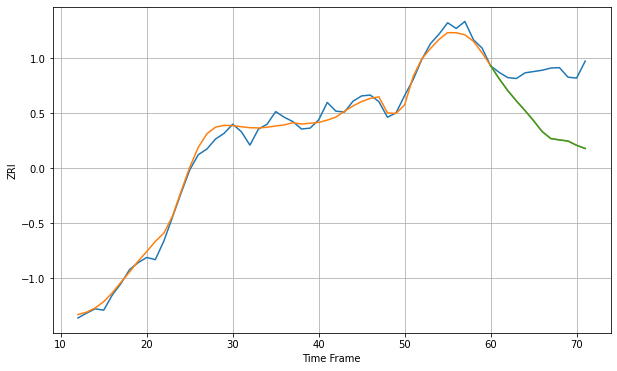

Wall time: 8.81 s
90803 16.95322243547273 123.57612925946108 123.66404920836486 [2101.29153483 2071.21050663 2044.1278167  2020.34265943 1998.32837304
 1974.95740588 1949.94721365 1934.01982734 1930.92440886 1928.32321937
 1918.48509111 1911.15224266]

Got an mse at 0.0025 in round 101 and stopped training

60 60 12


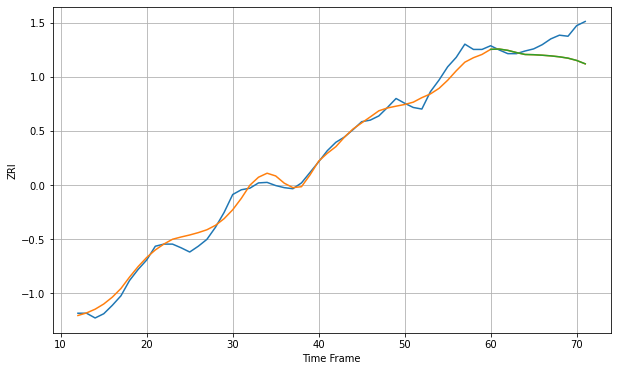

Wall time: 6.78 s
90804 14.454236869360251 36.40427313114501 36.37609231392625 [1950.14310448 1950.70216813 1948.21406764 1944.06021599 1940.42395899
 1940.00293211 1939.02726857 1937.78177154 1935.9885349  1933.46801873
 1929.15672074 1922.73431393]

Got an mse at 0.0025 in round 150 and stopped training

60 60 12


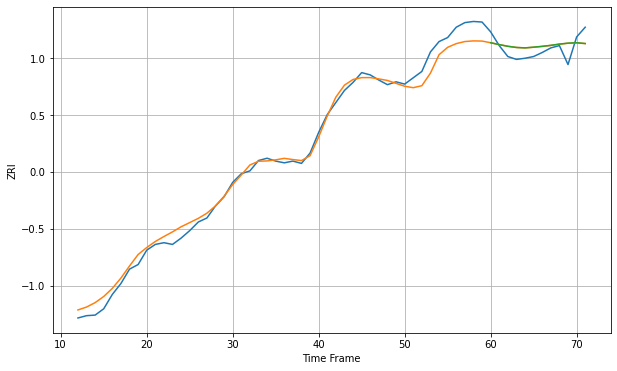

Wall time: 7.71 s
90805 15.240676198912855 18.537129344208495 18.578242005344485 [1948.96768705 1945.7079329  1942.76917024 1940.76416846 1940.0639592
 1941.28803308 1942.76445249 1944.47725494 1946.63286053 1948.25593829
 1948.95514469 1947.60262451]

Got an mse at 0.0025 in round 183 and stopped training

60 60 12


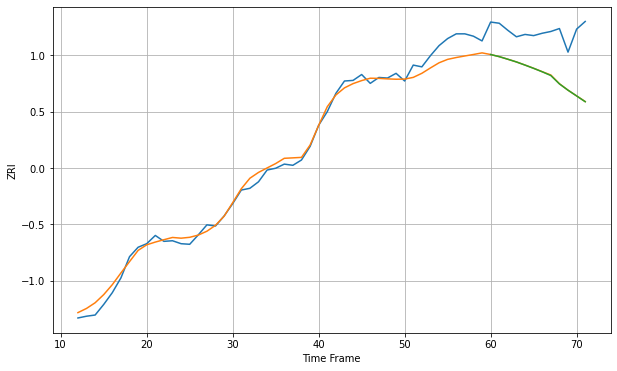

Wall time: 8.47 s
90806 14.973860630442468 76.46526953039199 76.6368304075861 [1886.91636581 1883.327487   1878.91526888 1874.31512804 1869.0048845
 1863.48951541 1857.64865501 1851.25915841 1837.10975621 1826.41181277
 1816.68160098 1806.87069861]

Got an mse at 0.0025 in round 124 and stopped training

60 60 12


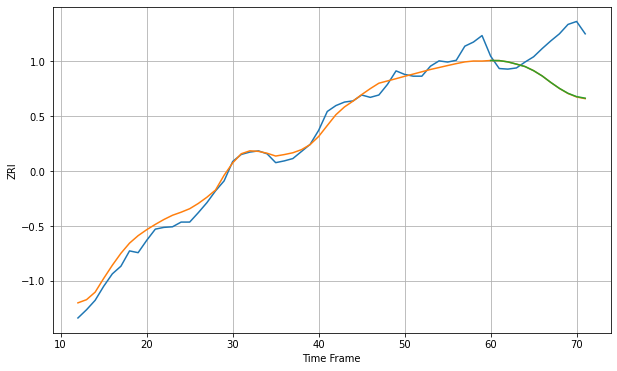

Wall time: 7.09 s
90807 15.362620548011371 70.27489097296693 70.01690879346413 [1896.63567615 1896.48394799 1894.3157797  1890.4921502  1886.36800536
 1879.34689403 1870.33483026 1859.34705569 1849.26242823 1840.88686938
 1835.23433477 1832.58550153]

Got an mse at 0.0025 in round 126 and stopped training

60 60 12


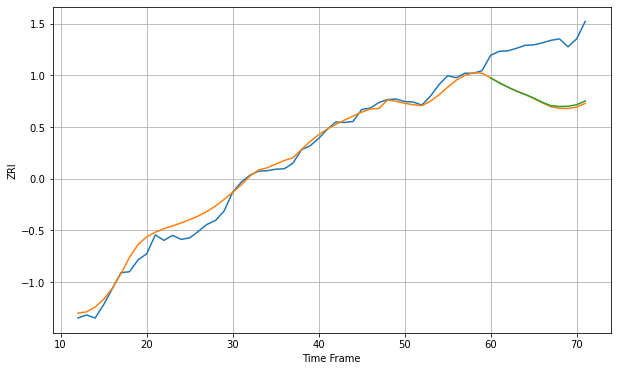

Wall time: 7.35 s
90813 16.006107827524264 112.99863786205 110.71677455593228 [1809.55481058 1799.79112359 1791.04525583 1783.1315082  1776.51005563
 1769.24689686 1760.76235378 1753.90354696 1752.11483282 1752.47246036
 1755.67893263 1763.05887512]

Got an mse at 0.0025 in round 116 and stopped training

60 60 12


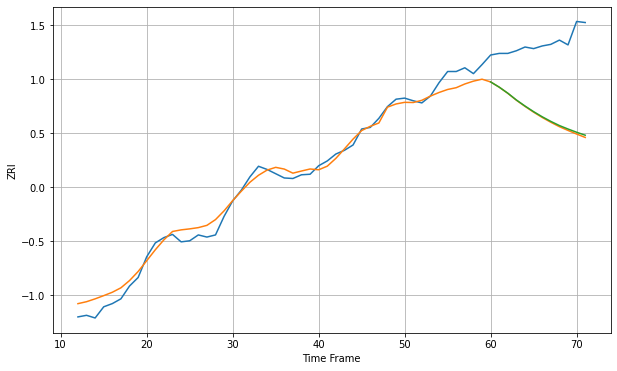

Wall time: 7.08 s
90814 16.433819536352313 138.6485189323619 136.79532256229825 [1920.40576158 1910.59728065 1899.22905414 1886.42357921 1875.11356776
 1864.56451626 1854.94502648 1846.30273497 1838.46292217 1831.96700421
 1825.91356398 1820.32922175]

Got an mse at 0.0025 in round 174 and stopped training

60 60 12


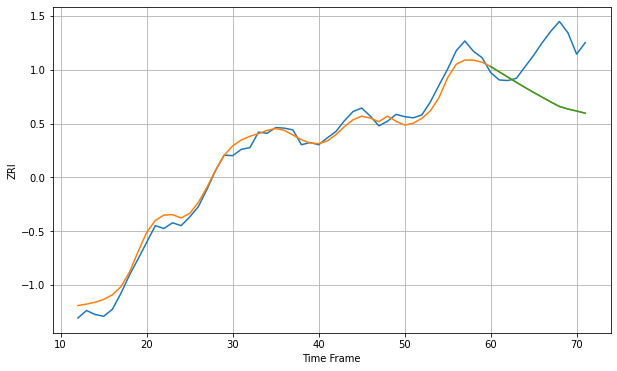

Wall time: 8.43 s
90815 14.119636260358332 88.81442231387975 88.81074760055893 [1917.47508486 1908.14660858 1898.9762929  1889.85599386 1880.9602546
 1872.24300012 1864.00067193 1855.63612483 1847.81009448 1843.28978696
 1839.91931498 1836.01016858]
60 60 12


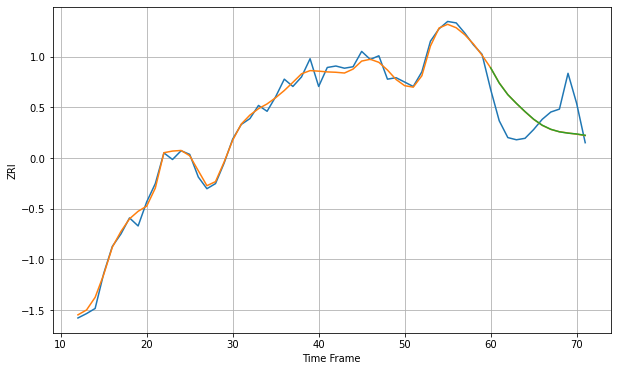

Wall time: 16.1 s
91016 7.771095641054578 42.01406155008845 42.0201545115765 [2269.53624502 2248.69840986 2232.73761295 2220.7664576  2209.60515831
 2199.20546298 2190.94620397 2185.32473417 2181.92313922 2180.06883022
 2178.9499148  2177.12845665]
60 60 12


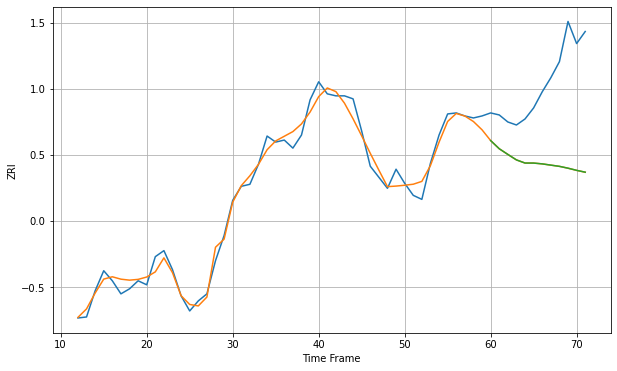

Wall time: 16.2 s
91101 8.992851089594241 86.34050353635016 86.31516288084369 [2124.50787993 2116.37286165 2110.73827849 2105.27074378 2102.14426377
 2102.11734028 2101.31330145 2100.07534803 2098.85293314 2097.02980526
 2094.89124652 2093.06247713]

Got an mse at 0.0025 in round 229 and stopped training

60 60 12


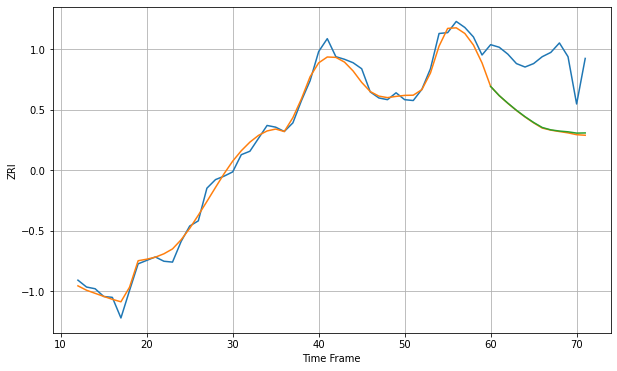

Wall time: 9.68 s
91104 8.162367923277934 72.31434603116921 71.5830819584616 [2015.38755166 2004.74267972 1995.92442741 1987.68362867 1980.20341977
 1973.48530935 1967.64642287 1964.87183727 1963.4791051  1962.6123932
 1961.10339244 1961.29536661]
60 60 12


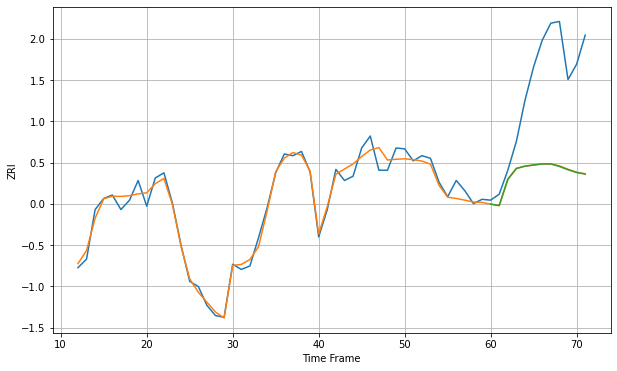

Wall time: 16.2 s
91105 9.212722378643445 111.92262638439018 112.09373801068716 [2639.34939282 2637.6767868  2668.66486905 2681.14469649 2683.81156299
 2685.12124449 2686.39442176 2686.3579893  2683.41237279 2679.58712592
 2676.31465248 2674.62574421]

Got an mse at 0.0025 in round 268 and stopped training

60 60 12


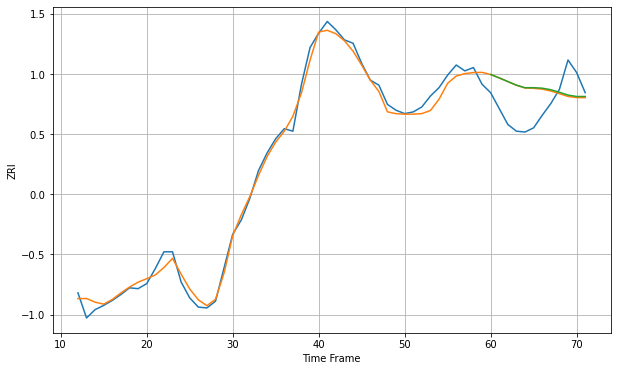

Wall time: 10.8 s
91106 8.892078000069375 37.05793401681076 37.04927362092866 [2218.65237318 2214.62852974 2210.24520653 2205.94082502 2202.88754669
 2202.95249492 2202.3435976  2200.52328403 2197.47221359 2194.13655652
 2192.44646332 2192.44094413]

Got an mse at 0.0025 in round 343 and stopped training

60 60 12


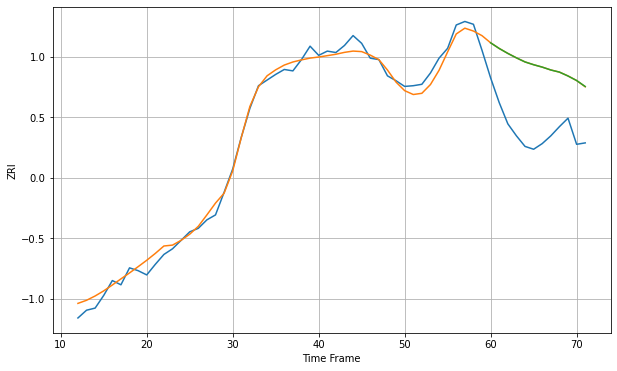

Wall time: 12.3 s
91107 10.703661871107425 92.94266787952542 92.95510142164072 [2220.74965735 2212.72415594 2205.74699753 2199.44844702 2193.67383596
 2189.73246671 2186.34479251 2182.26829877 2179.25152417 2173.74910024
 2167.34155064 2158.89526977]

Got an mse at 0.0025 in round 209 and stopped training

60 60 12


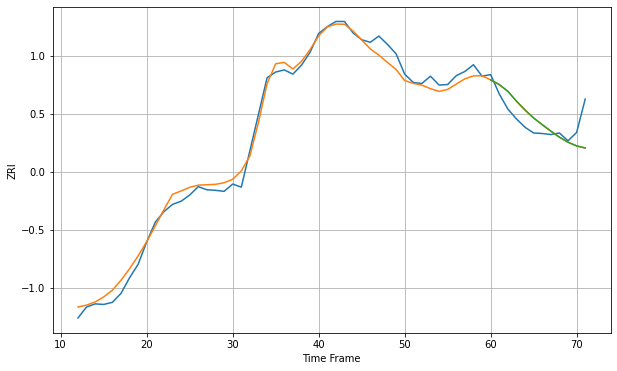

Wall time: 9.08 s
91205 15.618658453707058 34.84228081854066 34.78525402947872 [2344.92471255 2335.96650782 2323.01096752 2304.07803188 2287.04268559
 2271.76255797 2258.9411986  2246.54941111 2234.95151449 2225.31811114
 2218.21246257 2214.23523453]

Got an mse at 0.0025 in round 157 and stopped training

60 60 12


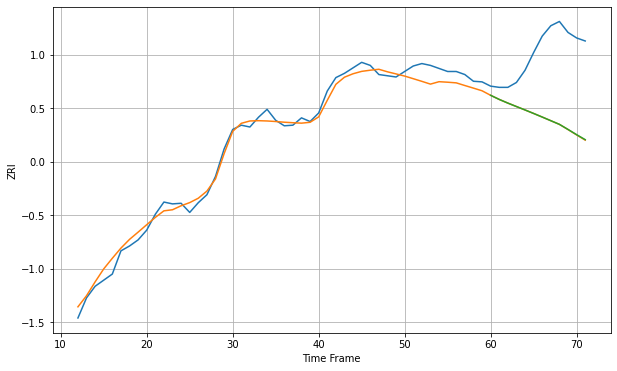

Wall time: 8.19 s
91355 13.086182052621742 117.02739076453516 116.85291021696176 [2208.96033253 2202.21057851 2196.21569362 2190.55205606 2184.95608456
 2179.21260659 2173.33556452 2167.34139364 2161.35691143 2153.0295065
 2144.47361698 2136.27172249]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


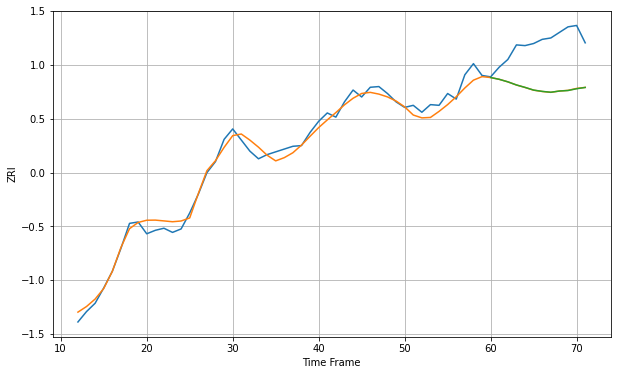

Wall time: 9 s
91367 10.447936025578148 66.10404443654308 66.12827668788466 [2273.0315452  2270.44446832 2266.8308265  2262.32815971 2258.8302355
 2254.94872403 2253.07946864 2251.81728866 2253.58881702 2254.33007117
 2256.86882142 2258.73535704]

Got an mse at 0.0025 in round 355 and stopped training

60 60 12


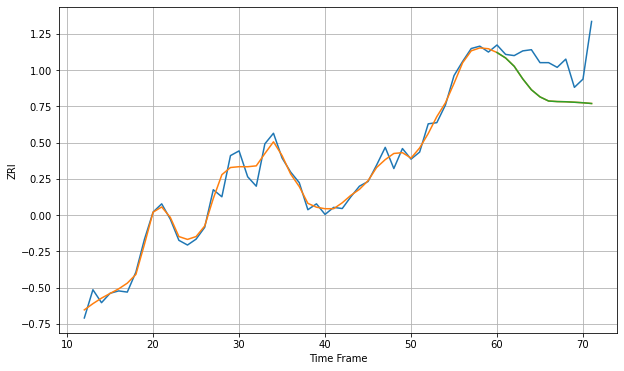

Wall time: 12.5 s
91505 6.6003154023178805 30.758233388202903 30.766675975130887 [2328.58868656 2323.97688581 2316.90597878 2306.14420701 2296.94804065
 2290.89970543 2287.38230728 2286.9171716  2286.74914715 2286.33920818
 2285.89816858 2285.26891302]

Got an mse at 0.0025 in round 254 and stopped training

60 60 12


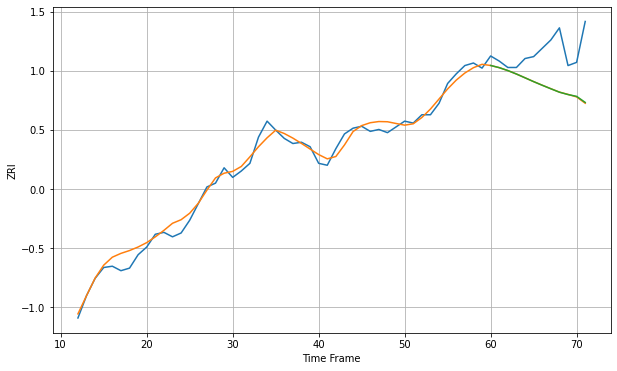

Wall time: 10 s
91601 11.568201739629941 60.19051047839455 59.95654876124655 [2336.11620565 2332.73953576 2328.14187252 2322.75460074 2316.82525913
 2310.8480807  2305.17867705 2299.68242124 2294.30723296 2290.61934424
 2287.80089659 2278.34128154]

Got an mse at 0.0025 in round 221 and stopped training

60 60 12


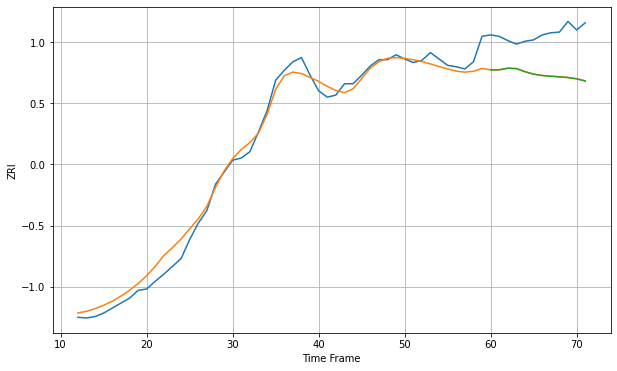

Wall time: 9.53 s
91730 13.553418759171812 57.98844202281978 58.07629289417519 [1655.60805931 1655.65959319 1657.88701437 1657.43985631 1653.05399548
 1649.55600336 1647.65935446 1646.6099444  1645.76524767 1644.71887511
 1642.89682425 1639.76792464]

Got an mse at 0.0025 in round 116 and stopped training

60 60 12


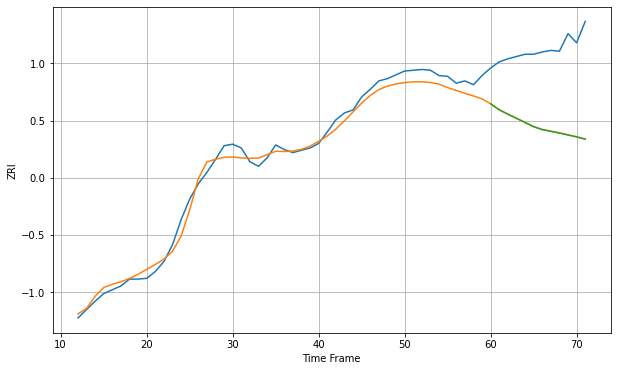

Wall time: 7.2 s
91764 11.188358747374414 102.0025069449086 102.00573659411694 [1613.97596857 1606.12708844 1600.40071262 1595.03766568 1589.60902006
 1584.13908038 1580.1555684  1577.91091268 1575.61097785 1573.06803613
 1570.56935266 1567.67156104]

Got an mse at 0.0025 in round 328 and stopped training

60 60 12


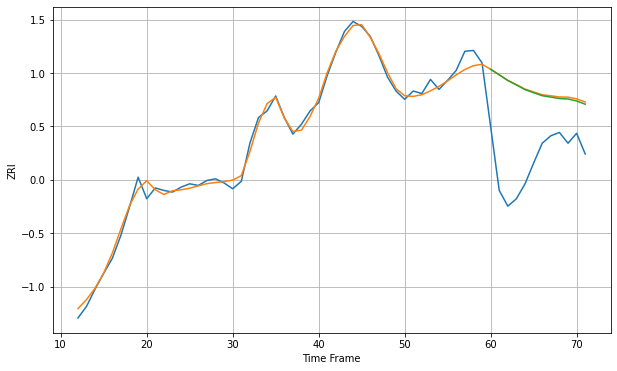

Wall time: 12.1 s
91766 7.6988144258436675 92.72343539686824 91.93704281556761 [2056.28553353 2049.57353342 2042.69036726 2037.34009953 2031.71776771
 2027.93566632 2024.35511188 2022.68454432 2020.95989708 2020.40280889
 2017.98761529 2014.09201526]

Got an mse at 0.0025 in round 257 and stopped training

60 60 12


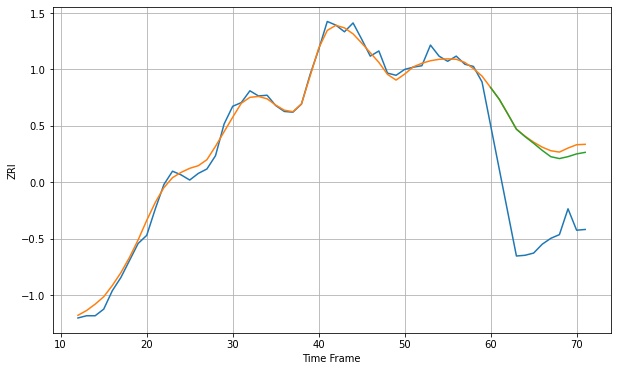

Wall time: 10.1 s
91776 8.90783881080233 124.20006624629232 119.97836856584432 [2197.37665773 2181.61595506 2161.63693096 2140.90108543 2130.90089237
 2121.84648021 2112.22554271 2103.65345088 2101.11119153 2103.72252312
 2107.44559468 2109.53551447]

Got an mse at 0.0025 in round 213 and stopped training

60 60 12


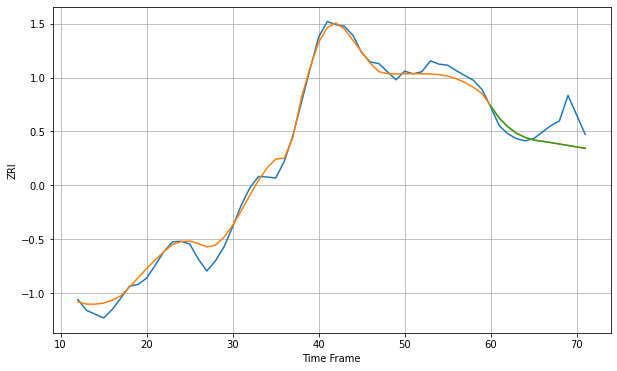

Wall time: 9.43 s
91801 15.045623104501024 36.91661441252779 36.92387804199682 [2162.81186983 2139.84728691 2124.03887149 2112.11546116 2104.47065213
 2099.52472791 2097.22368431 2094.78858196 2092.04025209 2089.4479752
 2086.78271054 2084.08841988]

Got an mse at 0.0025 in round 365 and stopped training

60 60 12


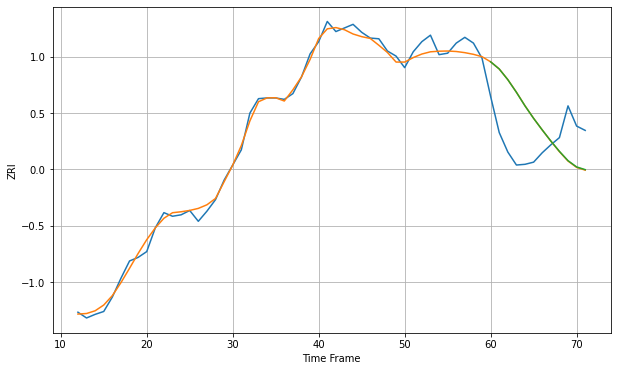

Wall time: 12.8 s
91803 8.788220309743886 67.18055094430672 66.98761153554443 [2093.05144945 2083.12458886 2068.28662545 2050.78849237 2031.93230529
 2014.646575   1998.68152135 1983.34526429 1968.9576724  1956.04698979
 1947.36869149 1943.6073723 ]

Got an mse at 0.0025 in round 105 and stopped training

60 60 12


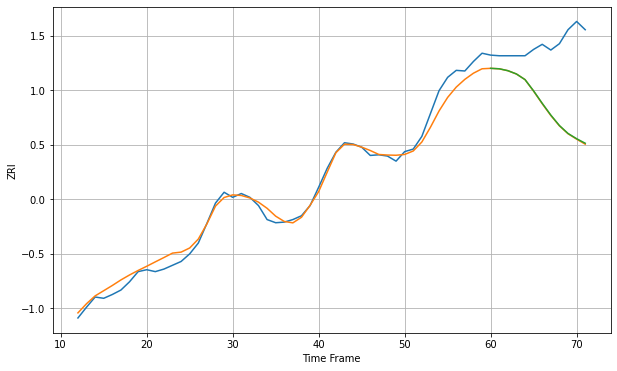

Wall time: 7.04 s
91913 12.391633167320826 107.17340376876196 106.62043542303486 [2222.19269578 2221.46746549 2218.51204303 2213.30744008 2204.41316229
 2186.61803631 2167.10870904 2148.53973635 2132.07552722 2119.61591743
 2111.35297795 2104.22455142]

Got an mse at 0.0025 in round 160 and stopped training

60 60 12


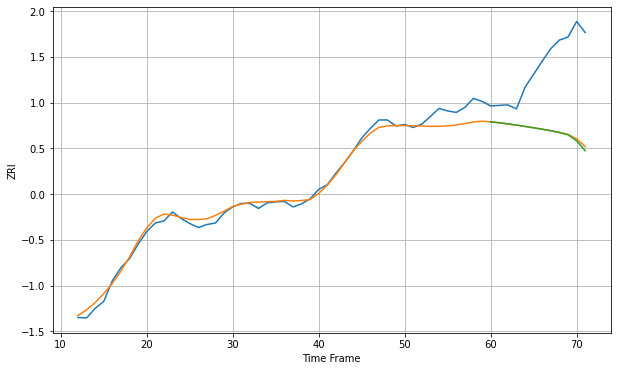

Wall time: 8.52 s
92008 14.96533848902606 142.74374185388504 144.5079763061389 [2013.18020125 2011.386506   2009.20396569 2006.74434788 2004.11738698
 2001.40256738 1998.59397479 1995.49937863 1991.94869455 1987.4756207
 1975.6650446  1955.68607226]

Got an mse at 0.0024 in round 79 and stopped training

60 60 12


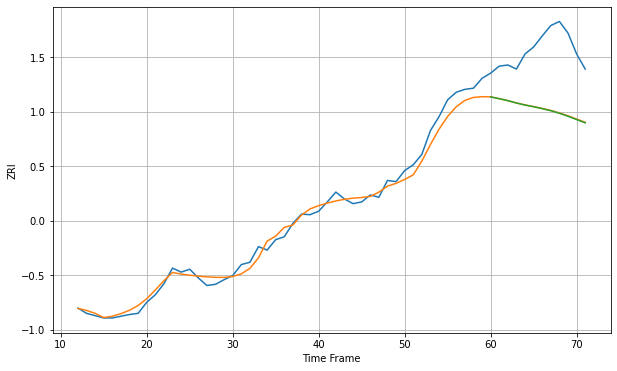

Wall time: 6.2 s
92101 12.781889109271486 105.46173801327413 105.91249709496175 [2299.05456036 2295.90599258 2292.51111856 2288.47930734 2284.95749044
 2282.00724285 2278.74982997 2275.16189138 2270.76166045 2265.63280242
 2259.93519886 2254.28720514]

Got an mse at 0.0025 in round 119 and stopped training

60 60 12


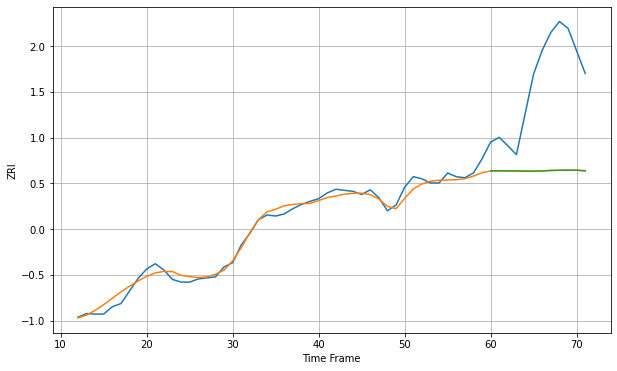

Wall time: 7.18 s
92103 10.746095835780793 186.72636617433693 186.86186403054575 [1991.94781726 1992.18294285 1992.1551432  1991.94634262 1991.58020483
 1991.51951374 1991.93604438 1992.84100378 1993.17331417 1993.4002823
 1993.18127301 1991.91307335]

Got an mse at 0.0025 in round 81 and stopped training

60 60 12


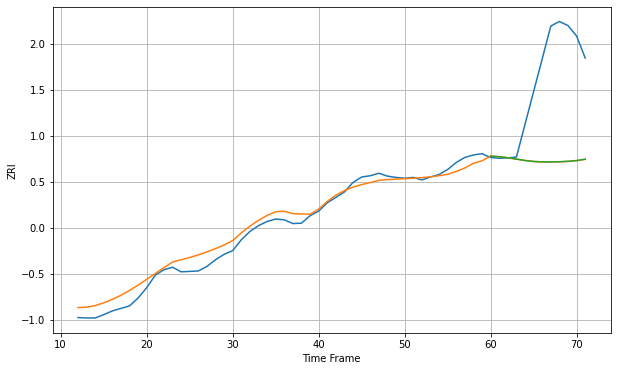

Wall time: 6.23 s
92104 20.36405172239137 218.72700737802205 218.53302152459977 [1815.15761428 1813.77104569 1811.26961197 1808.01804234 1804.68873022
 1802.36005592 1801.32798626 1801.23190441 1801.72360069 1802.73750296
 1804.59937333 1807.90669773]

Got an mse at 0.0025 in round 157 and stopped training

60 60 12


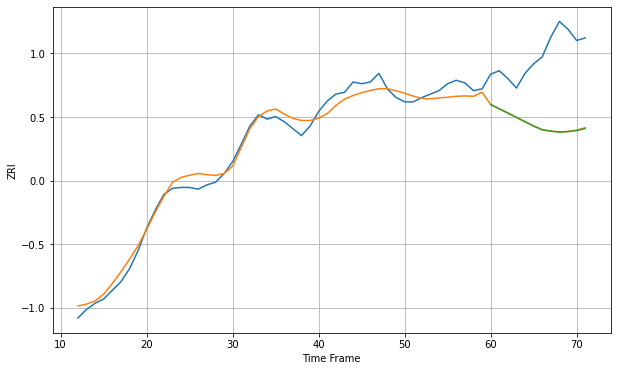

Wall time: 7.89 s
92108 9.98047070049766 84.1903670310702 84.37126068092397 [1965.8915012  1961.03100374 1956.07456392 1951.06048042 1946.07893178
 1941.01674294 1936.74349807 1935.12814164 1934.02753475 1934.5867339
 1935.76350424 1938.18869593]
60 60 12


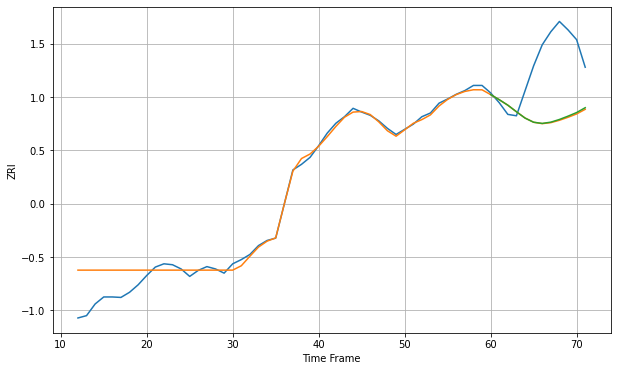

Wall time: 15.9 s
92117 29.005891422716097 128.51826987345186 127.28240080943924 [2168.37655731 2157.46462377 2145.69322552 2131.62938428 2118.12836829
 2109.17981327 2106.65510488 2109.35858473 2115.12970739 2122.23893958
 2129.94301675 2140.31224394]

Got an mse at 0.0024 in round 94 and stopped training

60 60 12


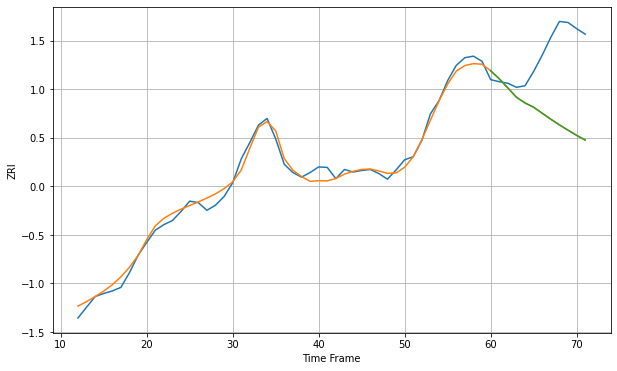

Wall time: 6.81 s
92122 12.343698820168997 134.76865093599415 134.73925449817463 [2429.51636849 2413.70067362 2395.78396208 2377.47557991 2366.32839118
 2357.97827483 2346.19096453 2334.42493841 2323.37588947 2312.90940481
 2302.79314313 2293.89230688]

Got an mse at 0.0025 in round 64 and stopped training

60 60 12


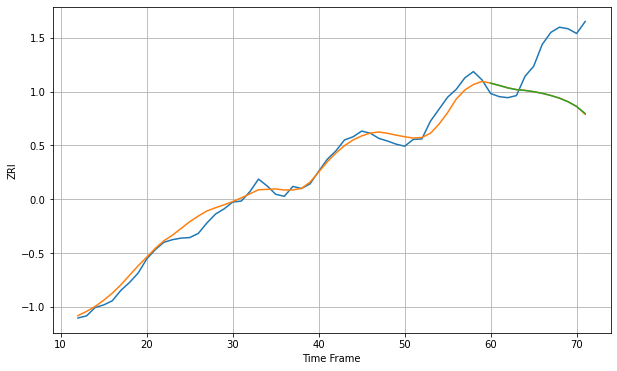

Wall time: 6.05 s
92123 14.398085483924902 98.72885766686593 98.49404274526788 [2279.82240831 2275.42629522 2270.72232948 2267.42808187 2265.91140967
 2263.45070051 2260.37010887 2256.18338358 2251.07267709 2244.22676687
 2235.2950584  2221.66090973]

Got an mse at 0.0025 in round 115 and stopped training

60 60 12


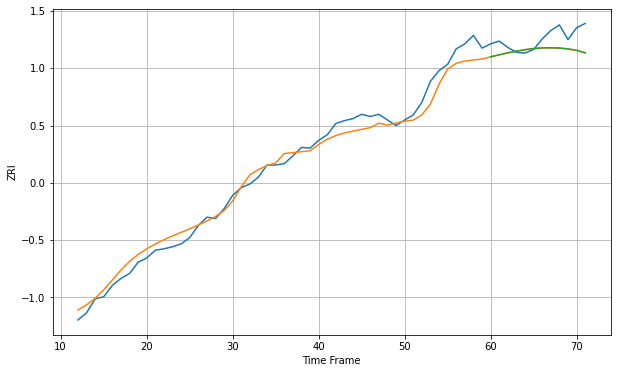

Wall time: 7.14 s
92126 13.716626611062063 21.632302643689997 21.57844359627162 [2067.64159715 2070.52635918 2073.31278219 2075.66934308 2077.74817445
 2079.42280675 2080.28137515 2080.46560567 2080.12616604 2078.90002702
 2076.85009278 2073.34387414]

Got an mse at 0.0025 in round 146 and stopped training

60 60 12


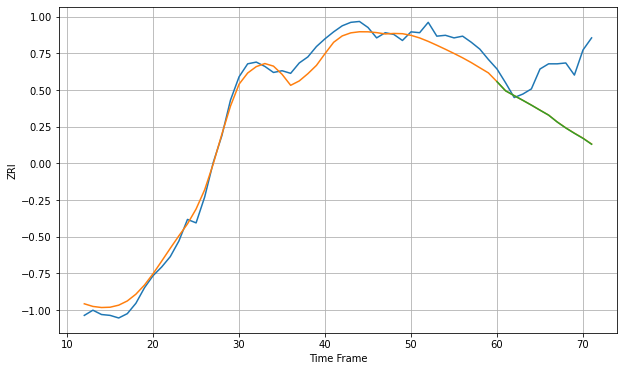

Wall time: 7.65 s
92128 12.401606523337943 62.344748896317405 62.444817462017475 [2145.31307792 2134.76327612 2129.18424132 2123.80033111 2118.2178814
 2112.37742005 2106.6529494  2098.713094   2091.79786467 2085.62082398
 2079.81879047 2073.00389636]

Got an mse at 0.0025 in round 148 and stopped training

60 60 12


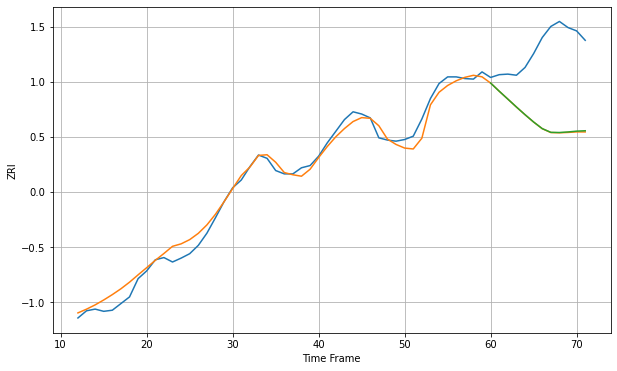

Wall time: 7.68 s
92130 14.736630761722248 138.21841701998758 137.62472501713177 [2566.8531704  2552.13099669 2537.9570408  2523.66097309 2509.83957931
 2496.57792488 2484.67013889 2477.9410741  2477.64491773 2478.62430215
 2480.1107262  2480.80252044]

Got an mse at 0.0025 in round 195 and stopped training

60 60 12


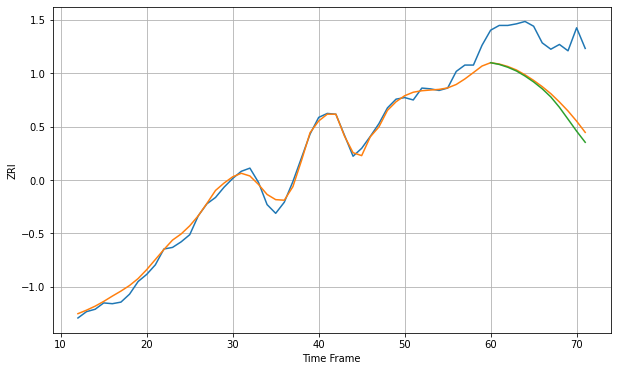

Wall time: 8.72 s
92410 8.21798364909304 71.65078837119759 77.36049645127483 [1285.97444278 1283.8053422  1280.24302914 1275.55078276 1269.1487473
 1261.72967994 1253.09874611 1242.81327697 1229.72830834 1214.7355512
 1199.6334245  1185.59126349]

Got an mse at 0.0025 in round 69 and stopped training

60 60 12


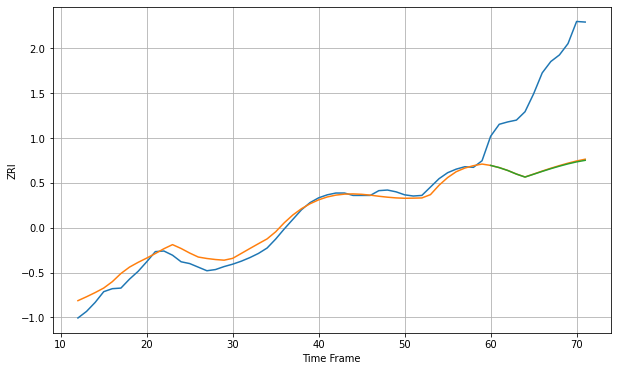

Wall time: 6.03 s
92507 12.549397056951628 156.12772376664208 156.92582839879222 [1469.18330555 1465.51499296 1460.6725655  1454.7089362  1449.7012759
 1454.42757313 1459.21246666 1463.76118681 1467.94594921 1471.79421119
 1475.10787458 1477.71404839]

Got an mse at 0.0025 in round 259 and stopped training

60 60 12


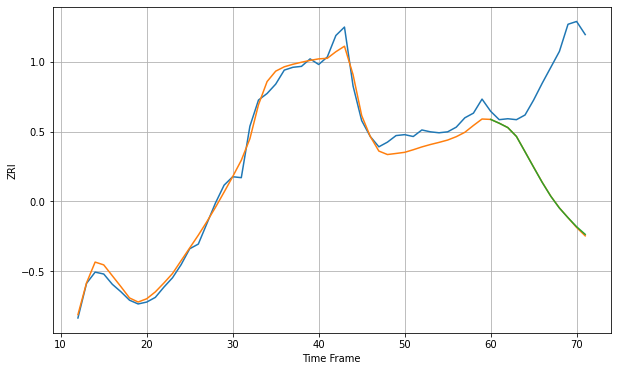

Wall time: 10.5 s
92602 10.50033155150085 130.06260356006786 129.77175156331018 [2464.28660593 2460.21693992 2455.53130892 2446.0910148  2429.68995743
 2413.18824068 2396.92412939 2382.07261832 2369.52230527 2359.18166155
 2349.53034345 2341.41144052]

Got an mse at 0.0024 in round 396 and stopped training

60 60 12


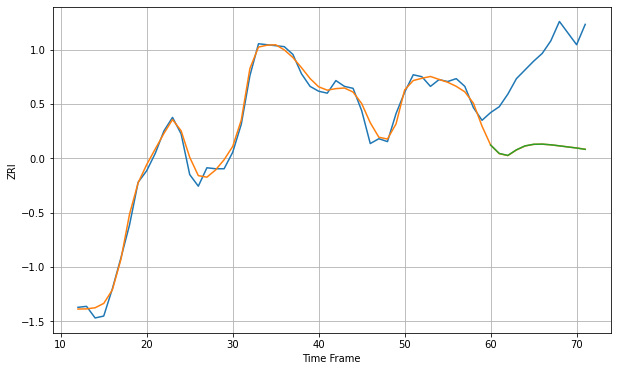

Wall time: 13.9 s
92603 7.107598040006075 93.53156046930127 93.49361973986747 [2860.45160244 2851.80887236 2849.76392644 2855.543992   2859.58760669
 2861.23192805 2861.41266334 2860.71176484 2859.64442374 2858.50784991
 2857.38635507 2856.04199071]

Got an mse at 0.0025 in round 114 and stopped training

60 60 12


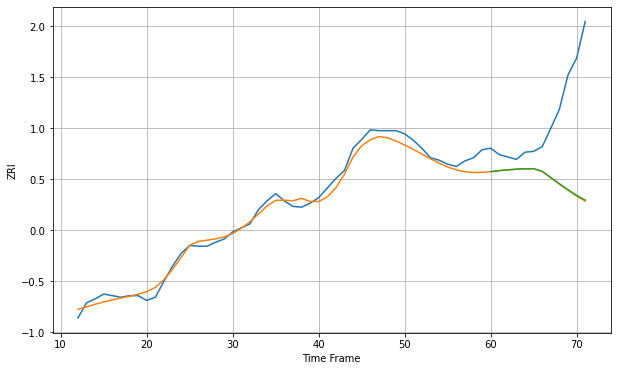

Wall time: 7.19 s
92612 8.882298831033076 99.14972826843861 98.65874573982254 [2382.59220362 2383.83476201 2384.87616553 2385.66740688 2386.17952276
 2386.3328381  2382.89107598 2375.13241802 2367.34566584 2359.93441187
 2352.75348899 2346.88877415]

Got an mse at 0.0025 in round 197 and stopped training

60 60 12


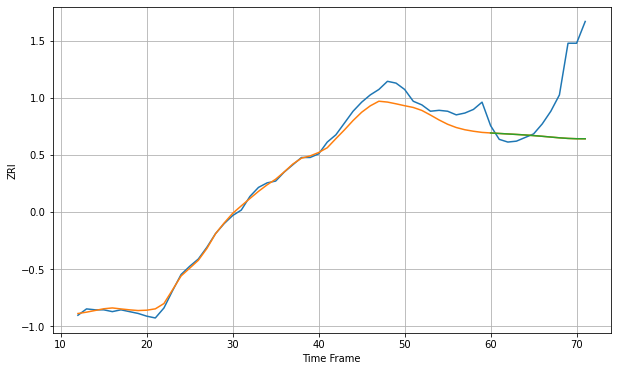

Wall time: 9.12 s
92618 10.171112141230127 59.39578917262655 59.39982235653598 [2093.03544456 2092.48101381 2091.95035409 2091.40526209 2090.82421986
 2090.13746951 2089.3713344  2088.52128037 2087.68835577 2087.02486115
 2086.67281616 2086.61888864]

Got an mse at 0.0025 in round 380 and stopped training

60 60 12


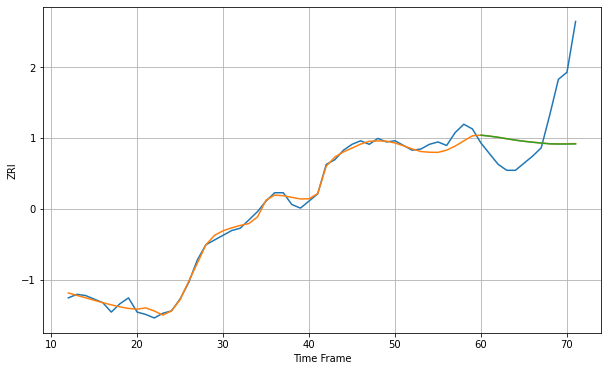

Wall time: 13.6 s
92620 4.4728218650906575 41.4271319473511 41.53686771275546 [1923.74049531 1922.92818049 1921.93656701 1920.72629273 1919.55492912
 1918.58010459 1917.77401606 1917.0577092  1916.38934189 1916.22560703
 1916.25695583 1916.33675823]

Got an mse at 0.0025 in round 210 and stopped training

60 60 12


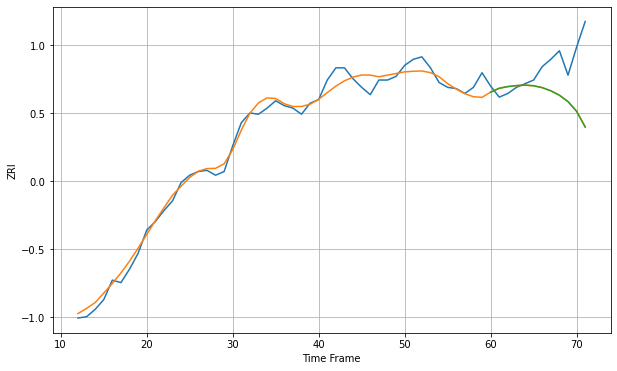

Wall time: 9.38 s
92626 6.8282219480303015 33.01194691855387 33.13886177147786 [2204.06885625 2207.25521859 2208.64603453 2209.43963853 2209.82412097
 2209.32275489 2207.77273888 2205.20837266 2201.54016462 2196.29967941
 2188.26983034 2175.38957862]

Got an mse at 0.0025 in round 289 and stopped training

60 60 12


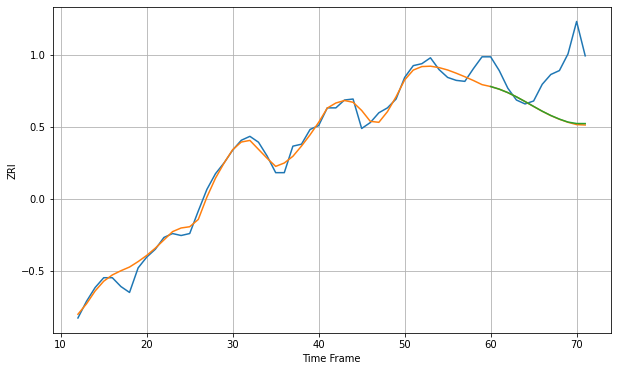

Wall time: 11.2 s
92627 8.360716824713737 47.583167110010756 47.148065387877146 [2283.72562191 2281.05762114 2277.52604202 2273.24721192 2268.47405887
 2263.47214445 2258.6056428  2254.23268873 2250.53950909 2247.52952378
 2246.05658721 2245.99992083]

Got an mse at 0.0025 in round 91 and stopped training

60 60 12


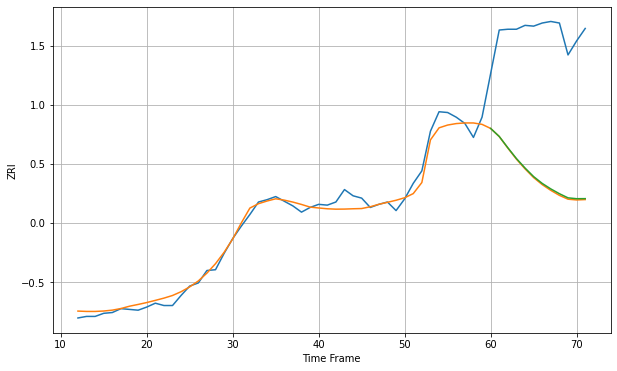

Wall time: 6.58 s
92647 9.106886328664462 184.94934228264412 183.69684359696635 [2104.55339146 2094.25202075 2079.74114069 2065.86233935 2053.69040678
 2042.68103442 2033.90849155 2026.82462267 2020.68221367 2015.35857243
 2014.25564    2014.34816708]

Got an mse at 0.0025 in round 199 and stopped training

60 60 12


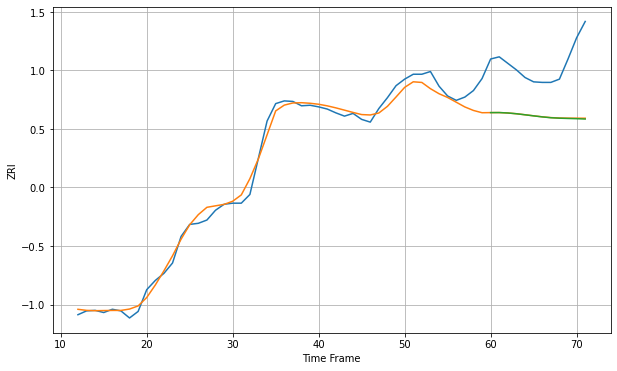

Wall time: 9.06 s
92648 16.208743519430328 100.9076972725522 101.33240555588445 [2271.47719257 2271.56607027 2270.78615542 2269.37672348 2267.4822698
 2265.49443887 2263.60937321 2262.07471427 2261.21586828 2260.73392644
 2260.30258186 2259.66428713]
60 60 12


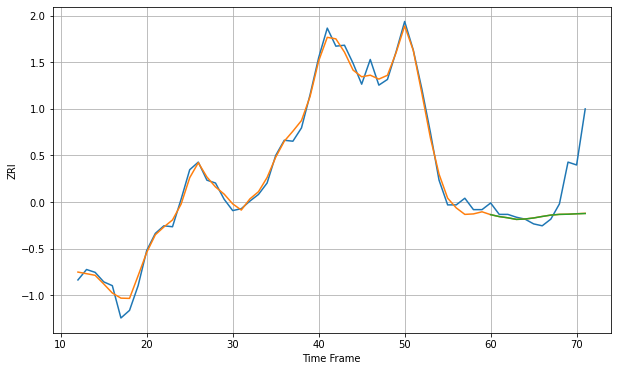

Wall time: 16.1 s
92651 7.237979857368762 38.898446966733616 38.960249487220175 [2554.71773722 2552.69715552 2551.40554602 2549.72009195 2550.13737925
 2551.21688198 2552.80695759 2554.24378935 2555.00402198 2555.18449319
 2555.60698311 2555.90554434]

Got an mse at 0.0025 in round 117 and stopped training

60 60 12


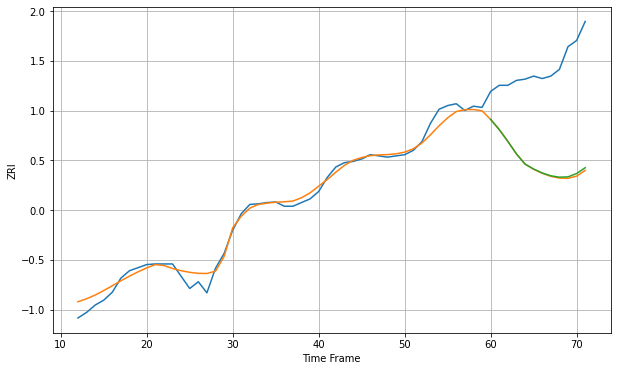

Wall time: 7.21 s
92656 11.504810042472478 160.12110482121747 158.52431903926743 [2219.43725633 2202.86285043 2183.69755713 2163.28305404 2146.77204711
 2138.63032871 2132.22857208 2127.5924128  2125.31951122 2125.8991013
 2131.28444635 2140.7693886 ]

Got an mse at 0.0025 in round 259 and stopped training

60 60 12


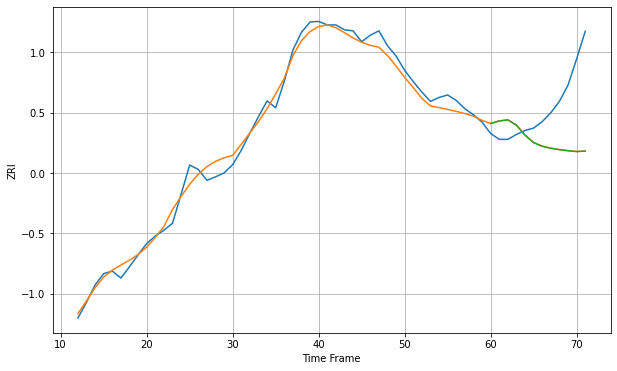

Wall time: 10.7 s
92660 17.025102800891613 105.51745180189947 105.59602589189264 [2893.18793875 2898.37448864 2900.47098492 2889.86526734 2869.52173551
 2854.51733689 2847.01586996 2842.98167822 2840.11614011 2837.95812763
 2836.35179671 2837.20248951]

Got an mse at 0.0024 in round 236 and stopped training

60 60 12


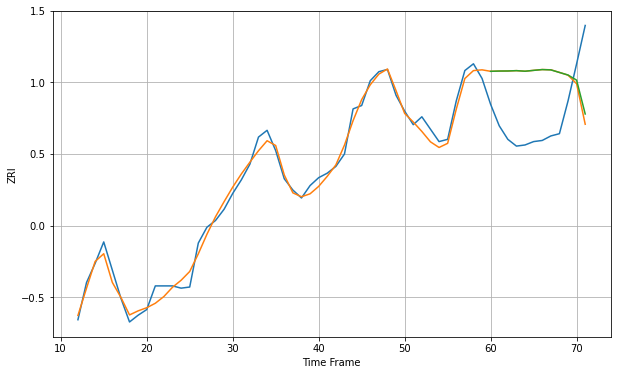

Wall time: 9.94 s
92663 6.940586827142937 56.65487427655106 55.44412063599426 [2344.33180123 2344.56694872 2344.62539007 2344.93798864 2344.41352284
 2345.16880364 2345.87261427 2345.61315626 2343.30020749 2341.05831463
 2336.49022955 2306.48283906]

Got an mse at 0.0025 in round 280 and stopped training

60 60 12


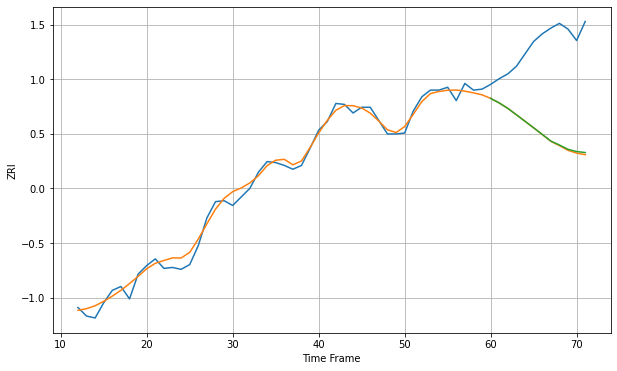

Wall time: 11 s
92672 6.751102974442704 95.42815340829962 94.75108804587751 [2217.34314309 2212.51305803 2206.819678   2200.09228024 2193.29567822
 2186.47942086 2179.54853427 2172.60987278 2168.42322738 2163.89718213
 2161.57293636 2160.50134551]

Got an mse at 0.0025 in round 300 and stopped training

60 60 12


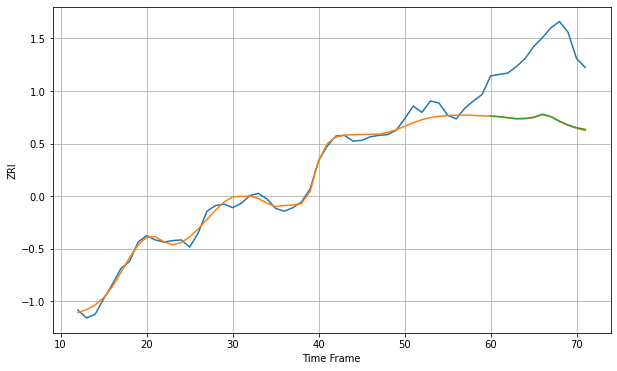

Wall time: 11.4 s
92673 9.840473279197559 97.1070625875056 96.64267011532404 [2181.91175536 2181.07682748 2179.67515158 2178.33351761 2178.57674432
 2180.14407696 2184.64138538 2181.19619739 2174.8304293  2169.53224268
 2165.71005502 2163.27203594]
60 60 12


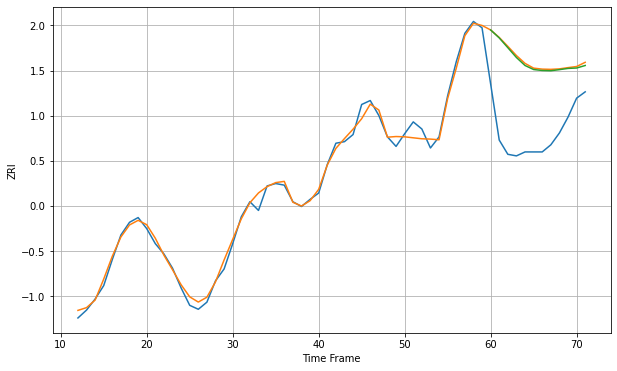

Wall time: 16.4 s
92677 7.537606418991019 97.29182413673266 95.73701492017938 [2464.26646355 2454.20102913 2441.83288464 2429.43089929 2419.31837523
 2414.21057362 2412.99831868 2412.6919335  2414.08270957 2415.61541012
 2416.13073187 2419.31525381]

Got an mse at 0.0025 in round 220 and stopped training

60 60 12


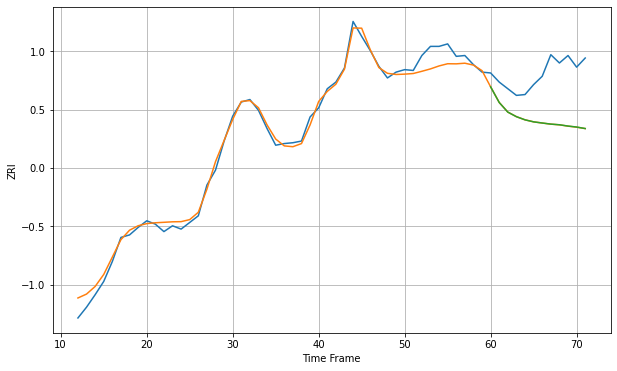

Wall time: 9.7 s
92691 9.595500130413063 58.20463021402774 58.14949959517474 [2099.25607967 2080.39864764 2068.8431504  2063.35318584 2059.56335186
 2057.13176021 2055.7417099  2054.42190036 2053.63115571 2052.07597521
 2050.90051877 2049.09283682]

Got an mse at 0.0025 in round 240 and stopped training

60 60 12


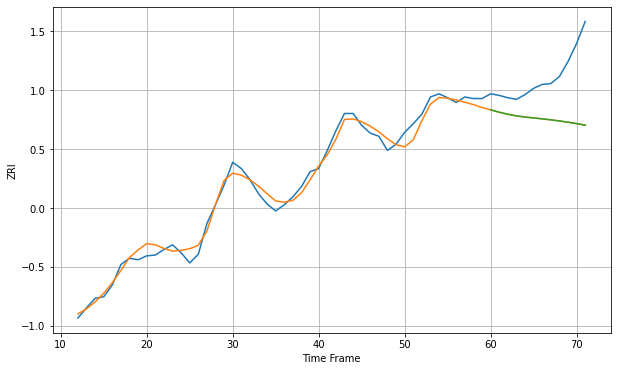

Wall time: 10.2 s
92692 9.17010691972355 61.18994799792109 61.181539317475135 [2161.63665244 2158.60061015 2155.99890074 2153.96877697 2152.48450961
 2151.35181696 2150.20005235 2148.93810978 2147.51773077 2145.98607648
 2144.08872086 2142.15062107]

Got an mse at 0.0025 in round 295 and stopped training

60 60 12


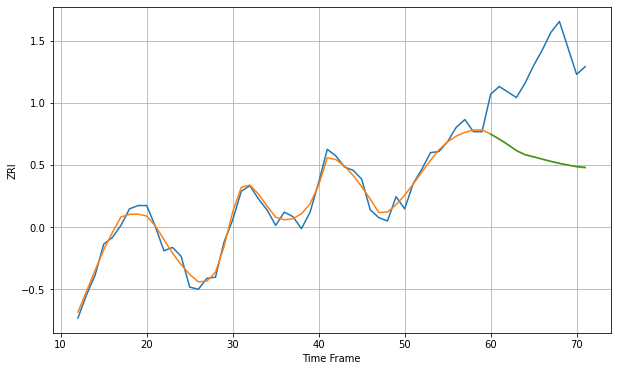

Wall time: 11.5 s
92707 6.445904414331144 84.71006546480983 84.57361240655966 [2154.82997041 2150.24543474 2145.33964167 2139.87278528 2136.14813456
 2134.21971178 2132.12491887 2130.1160851  2128.32747924 2126.7956041
 2125.43317697 2124.67658641]

Got an mse at 0.0025 in round 203 and stopped training

60 60 12


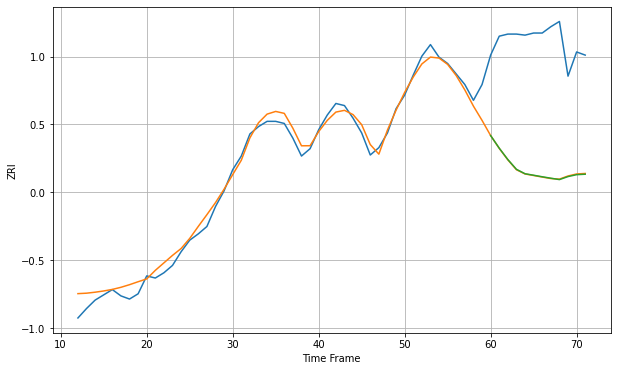

Wall time: 9.22 s
92780 9.011966091965492 122.89139504060178 122.9078786784133 [2062.47534768 2050.49981173 2039.69426242 2030.392023   2026.18272342
 2024.76365435 2023.29804967 2021.93172909 2020.60713742 2023.48330157
 2025.28285483 2025.72211978]

Got an mse at 0.0025 in round 204 and stopped training

60 60 12


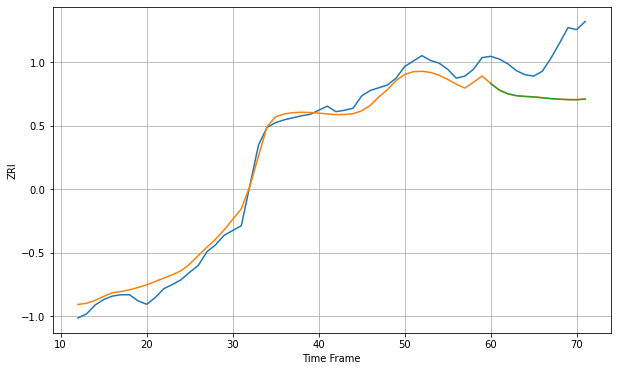

Wall time: 9.25 s
92782 14.233165524325527 67.6058595668352 67.76314348697635 [2359.39462189 2349.61700785 2344.07841412 2341.33963804 2340.21602612
 2339.62995776 2338.28527915 2337.05449689 2336.15933954 2335.51400519
 2335.42150833 2336.21364134]

Got an mse at 0.0025 in round 116 and stopped training

60 60 12


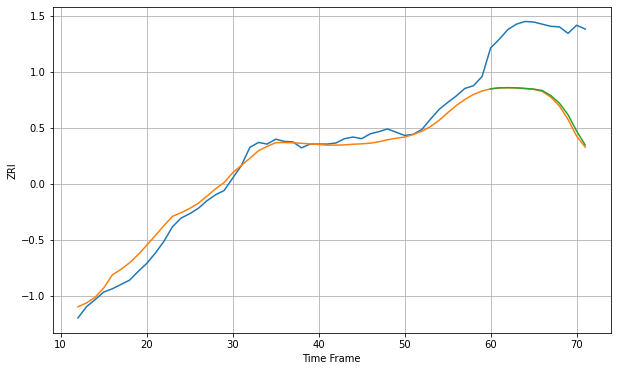

Wall time: 7.02 s
92805 16.6254755776415 141.3680898434416 138.0595232127614 [1947.25528689 1949.06891566 1949.47790495 1949.10263225 1948.10443455
 1946.7657535  1944.14208297 1934.89012757 1920.75936276 1899.30191632
 1869.13773787 1843.225212  ]

Got an mse at 0.0025 in round 69 and stopped training

60 60 12


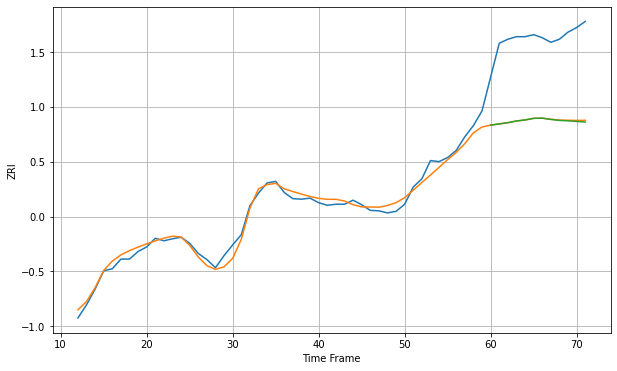

Wall time: 6.06 s
92806 11.822159920822298 162.72323510853172 163.41673861532212 [2173.80647896 2176.24230785 2178.67251669 2182.02366917 2184.04789506
 2187.20931198 2187.52250197 2185.06553784 2183.07708669 2182.27667766
 2181.13253132 2179.95249732]

Got an mse at 0.0025 in round 198 and stopped training

60 60 12


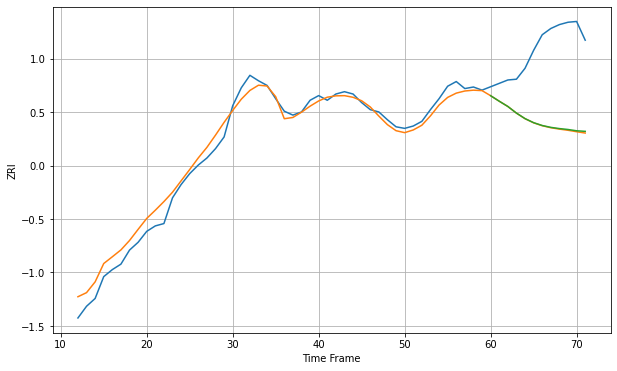

Wall time: 8.93 s
92832 12.087161182915805 98.96042130249947 98.30587559176406 [1943.8546209  1936.7975586  1930.07436736 1921.57890604 1914.49437502
 1909.28911691 1905.67452519 1903.27790925 1901.71675163 1900.56083912
 1898.89469978 1898.17699303]

Got an mse at 0.0025 in round 125 and stopped training

60 60 12


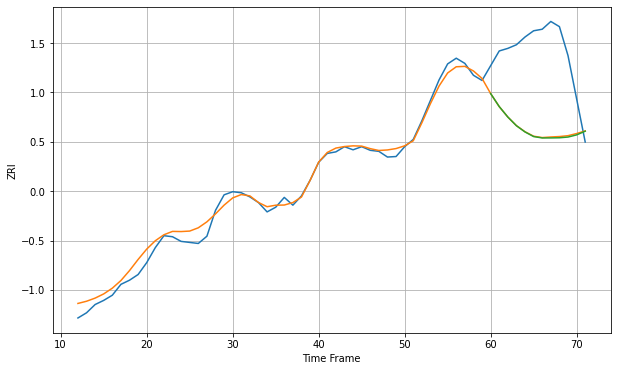

Wall time: 7.17 s
93001 13.65811890241039 157.91319155786658 158.89310218538176 [2149.65349309 2124.53364453 2104.3381182  2087.55520714 2075.48398293
 2066.57128795 2063.88958804 2063.94652567 2064.24338159 2065.63957398
 2069.81410223 2076.93063732]

Got an mse at 0.0025 in round 183 and stopped training

60 60 12


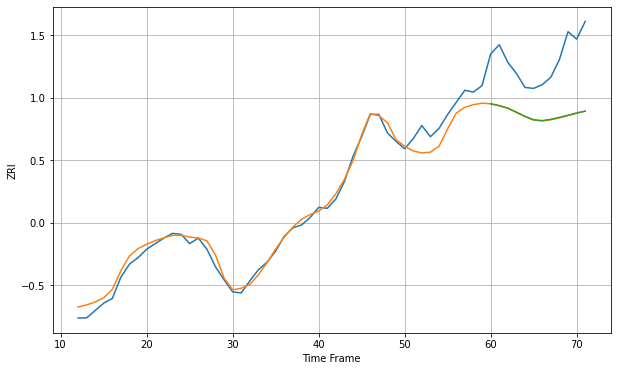

Wall time: 8.56 s
93010 9.578796616083883 61.11233214523032 60.947133070514035 [2029.42521803 2027.47505264 2024.66900057 2020.37021148 2015.87175676
 2012.17854397 2011.33061585 2012.66147949 2014.83274219 2017.07817826
 2019.46207922 2021.54519385]

Got an mse at 0.0025 in round 97 and stopped training

60 60 12


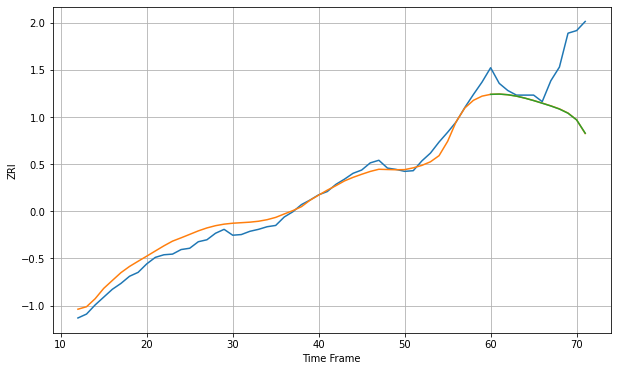

Wall time: 6.95 s
93030 12.230484710322305 76.90900416922057 76.90671209921503 [1872.15949213 1872.56890917 1871.5505396  1869.41302814 1866.28847668
 1862.61394023 1858.54802444 1854.33391574 1849.59890011 1843.21122671
 1832.95910621 1812.54950349]

Got an mse at 0.0025 in round 385 and stopped training

60 60 12


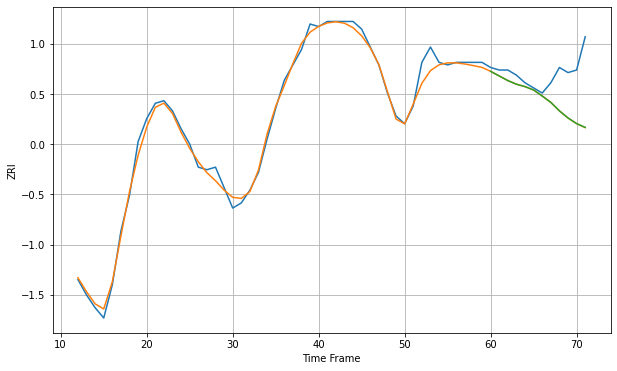

Wall time: 13.7 s
93304 2.6227046846062048 14.161561249891177 14.1340410508705 [879.48343126 877.67853239 875.87663941 874.45202178 873.50230079
 872.19576433 869.83951795 867.34841532 864.02282624 861.25569163
 859.05259421 857.56961939]

Got an mse at 0.0025 in round 493 and stopped training

60 60 12


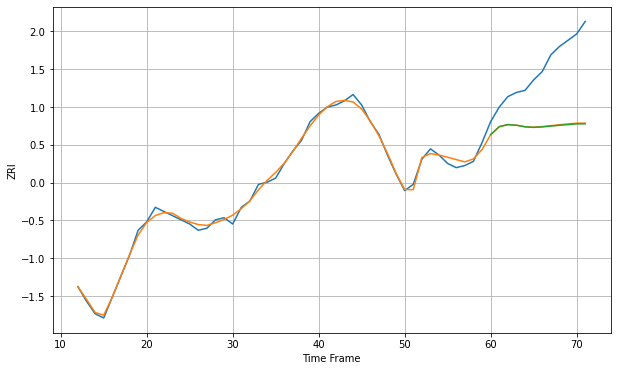

Wall time: 15.9 s
93305 1.7742672015144771 29.457394300862173 29.649087440382353 [796.77395005 800.62429613 801.61062557 801.30289998 800.53664803
 800.27661609 800.51106733 800.88694242 801.27142873 801.61004133
 801.95532426 801.9882079 ]

Got an mse at 0.0025 in round 276 and stopped training

60 60 12


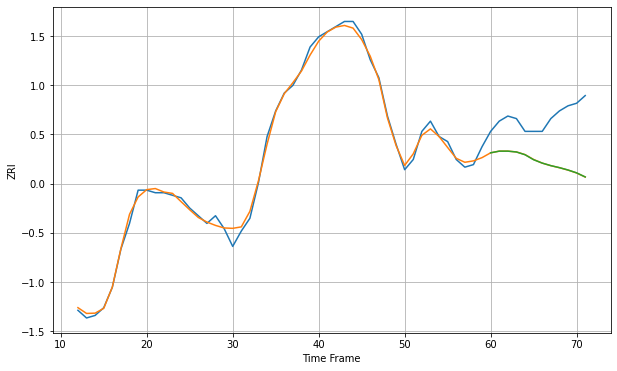

Wall time: 10.9 s
93307 2.016990547383321 18.593885414535016 18.580393678505857 [860.61141707 861.26383441 861.26498406 860.93795543 859.86464792
 857.90640109 856.59237929 855.60141324 854.813382   853.89334836
 852.77610735 851.17722786]
60 60 12


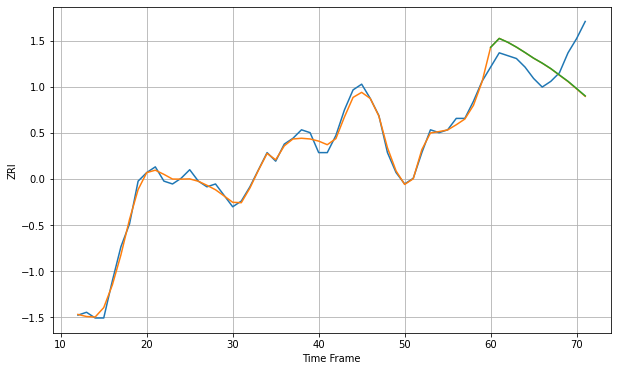

Wall time: 16.1 s
93308 1.6993346631770883 10.72828654167885 10.674865165118266 [861.93347558 865.04193424 863.69703241 862.00536262 860.11085502
 858.12695704 856.39024784 854.47044616 852.22390181 850.01298392
 847.47402701 844.90333974]

Got an mse at 0.0025 in round 324 and stopped training

60 60 12


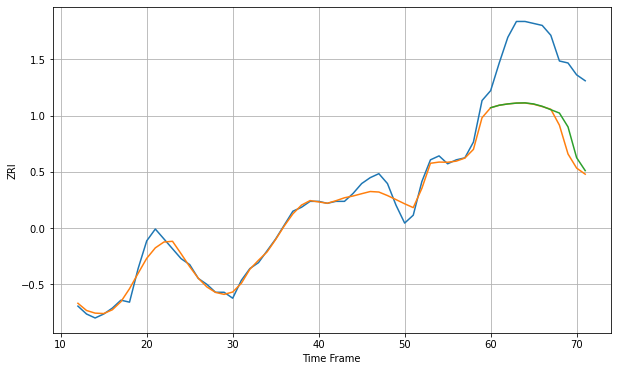

Wall time: 12 s
93309 3.860043031150886 38.14719632351942 35.800196780019675 [1030.35069557 1031.61986217 1032.28356709 1032.7131205  1032.82348159
 1032.27285257 1031.09360634 1029.37219086 1027.66383557 1020.66014668
 1005.08764304  998.53542652]

Got an mse at 0.0025 in round 97 and stopped training

60 60 12


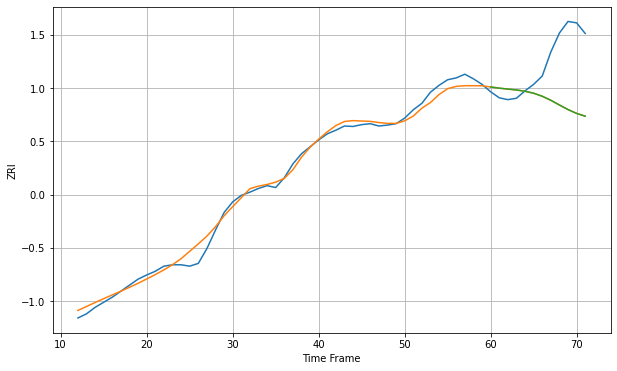

Wall time: 6.52 s
93906 13.455426786777357 110.03485236754041 110.053122794252 [1779.38396198 1776.79617777 1774.83895496 1772.97411714 1770.13876827
 1765.91936503 1759.39894542 1750.6660236  1740.47638152 1730.57171481
 1722.20485861 1716.06544332]

Got an mse at 0.0024 in round 105 and stopped training

60 60 12


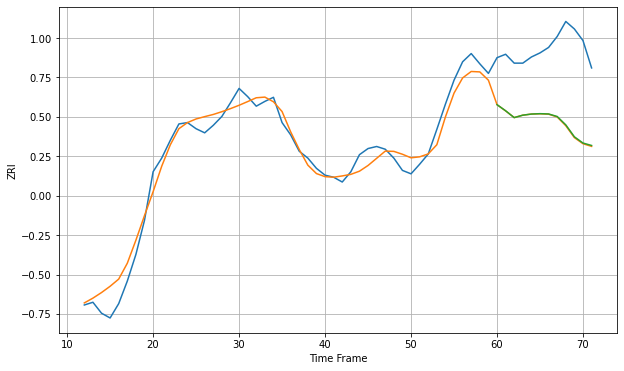

Wall time: 6.69 s
94010 17.540532531471012 110.55314196988078 109.9270893436718 [2652.2134357  2643.28761808 2633.25645464 2636.83660262 2638.48232381
 2639.03489202 2638.60610659 2634.90606668 2622.65699256 2605.18509378
 2596.04365941 2592.46125331]

Got an mse at 0.0025 in round 189 and stopped training

60 60 12


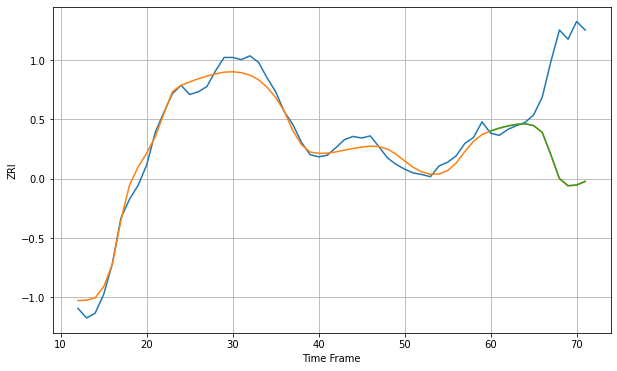

Wall time: 8.74 s
94025 17.954263286157897 172.9678447067655 172.47766538498428 [3341.15142885 3346.37014512 3350.49486997 3353.32035735 3354.54659083
 3351.07137148 3338.5657051  3297.50360477 3253.10886845 3239.40804353
 3240.6438633  3247.49652537]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


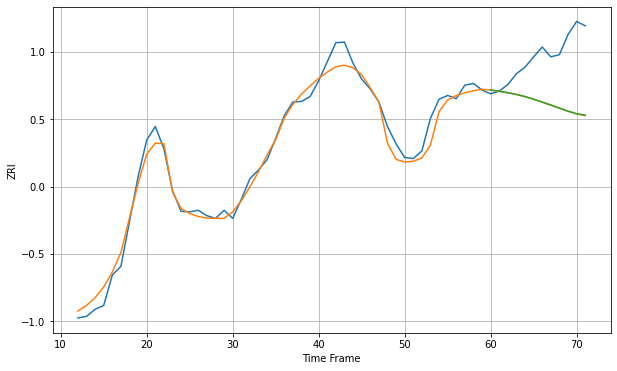

Wall time: 8.25 s
94040 18.214595728568558 97.7089542105353 97.47623848273889 [3392.9947432  3390.64170741 3387.96800717 3384.78421054 3380.96797194
 3376.0681417  3370.78608168 3365.34612124 3359.82991425 3354.11471298
 3349.57487348 3346.69407424]

Got an mse at 0.0025 in round 76 and stopped training

60 60 12


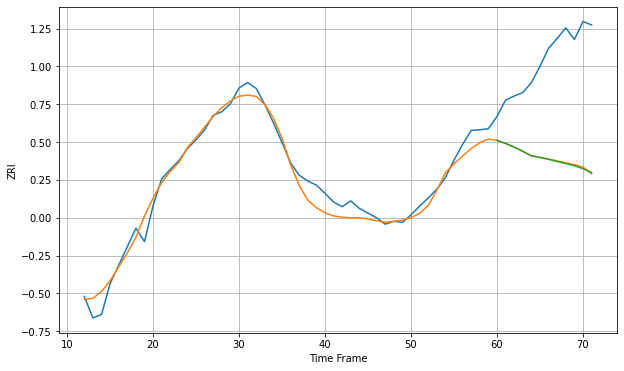

Wall time: 6.3 s
94061 17.771985343583843 176.324698231132 176.92772913611134 [3010.87387847 3005.61342134 2999.27014194 2992.08498254 2984.31745659
 2981.48505197 2978.25504454 2974.73632749 2971.06605943 2967.33687874
 2962.43992993 2955.54538762]

Got an mse at 0.0025 in round 378 and stopped training

60 60 12


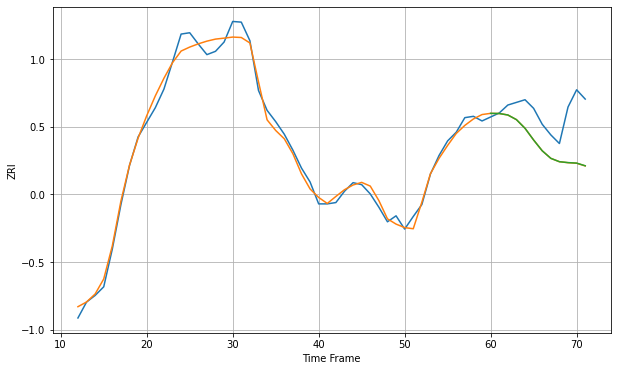

Wall time: 13.1 s
94066 11.450137092753131 56.35734035865176 56.2701859667925 [2842.46101025 2842.23872351 2840.02821952 2833.01838389 2819.93783346
 2802.29593836 2786.05184965 2774.64675357 2769.59144871 2768.23240381
 2767.49843262 2763.44237721]

Got an mse at 0.0025 in round 154 and stopped training

60 60 12


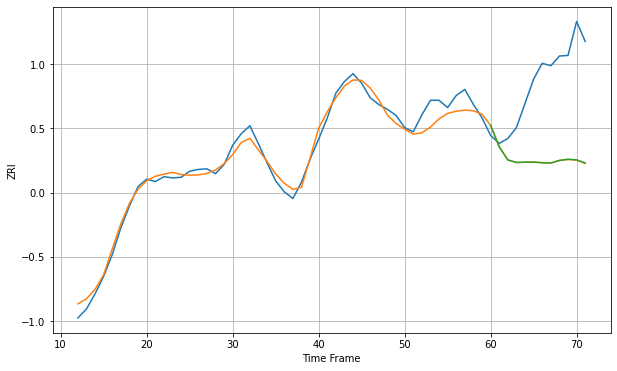

Wall time: 7.86 s
94085 14.603338091526934 140.72128829844928 140.4766475267735 [2977.620209   2942.25014828 2920.64294864 2916.45268042 2916.95637841
 2917.08370609 2916.04106273 2915.57650091 2919.89158427 2921.77695485
 2920.77235441 2915.68801727]

Got an mse at 0.0025 in round 181 and stopped training

60 60 12


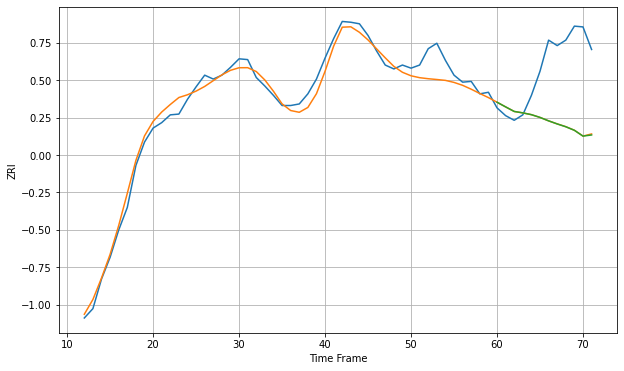

Wall time: 8.54 s
94086 13.524528246917772 85.16542288830564 85.33675974336498 [2907.24073198 2901.2382185  2895.36632644 2893.5368748  2891.24225236
 2887.7044383  2883.29391056 2879.33678875 2875.71238241 2871.15135581
 2863.69205874 2865.13490388]

Got an mse at 0.0025 in round 145 and stopped training

60 60 12


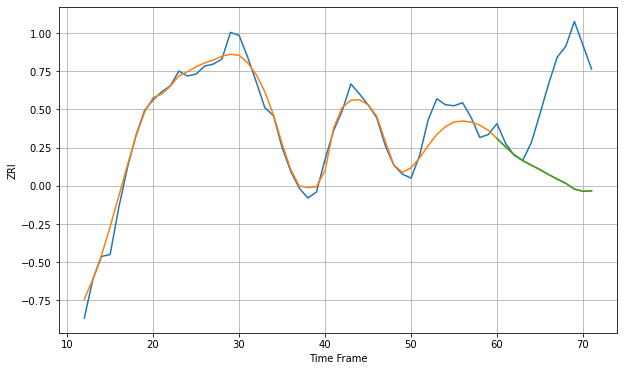

Wall time: 7.71 s
94087 11.777242595313199 96.51023500751504 96.58125174359968 [2701.91829558 2693.53287288 2685.55181673 2679.59471588 2675.02159143
 2670.56997018 2665.63760038 2661.02384839 2656.70614915 2650.91631684
 2648.68418061 2649.13299248]

Got an mse at 0.0025 in round 489 and stopped training

60 60 12


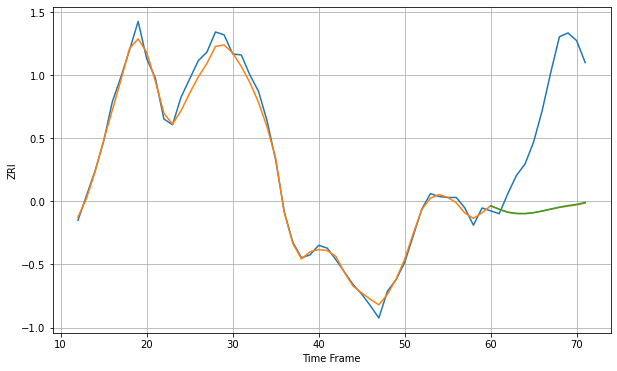

Wall time: 15.5 s
94103 7.338125124345398 114.56677598611662 114.27458839357479 [3492.34853807 3488.63660172 3485.54874334 3484.24639298 3484.14706154
 3485.11695023 3486.85321306 3488.91096918 3490.8784676  3492.45802121
 3493.79015498 3495.77371719]

Got an mse at 0.0024 in round 294 and stopped training

60 60 12


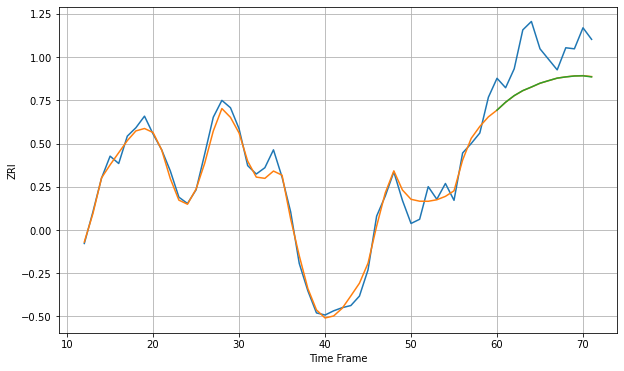

Wall time: 11 s
94105 8.750455639384125 35.682632338525245 35.700556093893695 [3976.73179964 3984.27980768 3990.52069082 3995.29243151 3998.70318026
 4002.3205924  4004.77769269 4007.14153429 4008.30308771 4009.16674551
 4009.35484707 4008.31947904]

Got an mse at 0.0025 in round 173 and stopped training

60 60 12


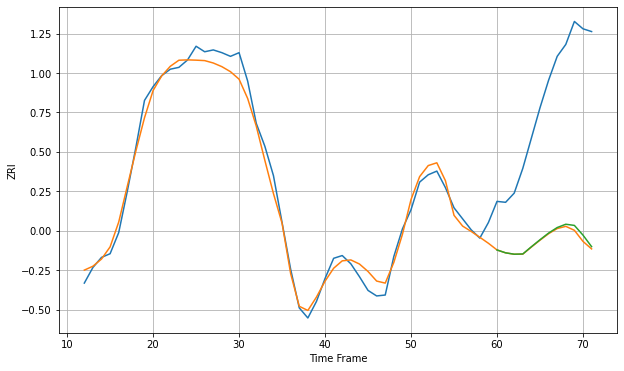

Wall time: 8.29 s
94107 11.363979651808078 162.73025270253078 160.53894197077136 [3797.08245097 3793.96702223 3792.46838621 3792.7366153  3800.61197825
 3808.21219362 3815.49862805 3821.50899923 3825.11411894 3823.83346587
 3813.26386341 3800.71005803]

Got an mse at 0.0025 in round 380 and stopped training

60 60 12


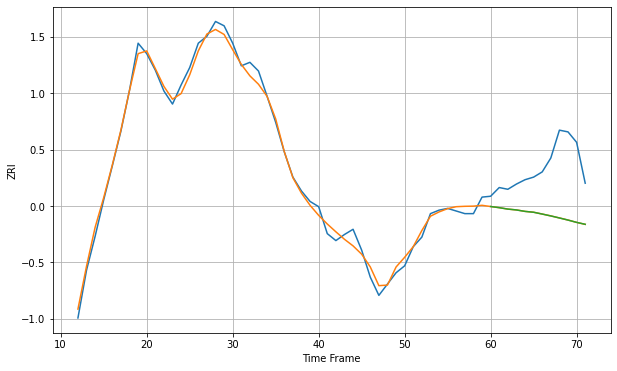

Wall time: 13 s
94109 7.832544450703293 59.86758780706818 59.875674558305995 [3371.17975026 3369.86315014 3368.21516277 3367.2472575  3365.57461151
 3364.5893621  3362.50569398 3360.35241945 3358.00932931 3355.60389918
 3352.94868639 3350.72849939]

Got an mse at 0.0025 in round 237 and stopped training

60 60 12


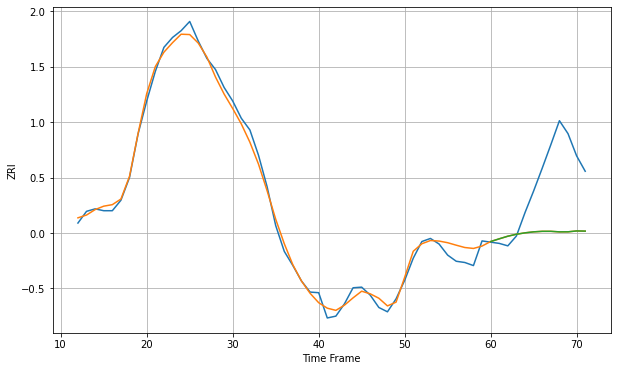

Wall time: 9.66 s
94110 11.629173075543191 99.23496413313016 99.21392656064532 [3868.99669145 3873.39016376 3877.6451706  3880.82384199 3883.10083368
 3884.72566428 3885.54670929 3885.571854   3884.69793025 3884.78254336
 3886.18593422 3885.92580076]

Got an mse at 0.0025 in round 252 and stopped training

60 60 12


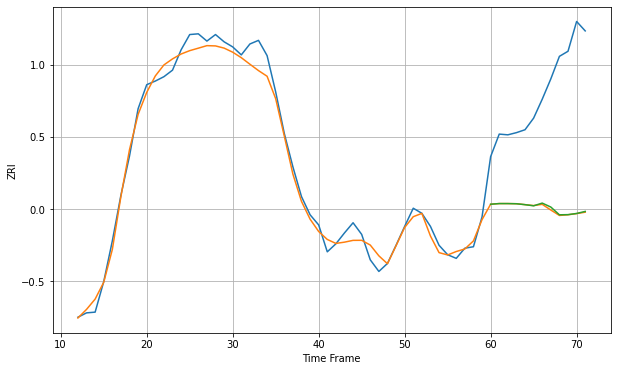

Wall time: 10.6 s
94115 13.593626564979504 168.63514243882673 167.90380335040197 [3490.51219184 3491.40285106 3491.39503479 3491.15669315 3489.90390395
 3488.32150139 3492.0643617  3486.61213384 3475.94706944 3476.17417748
 3477.78304669 3480.58571775]

Got an mse at 0.0024 in round 277 and stopped training

60 60 12


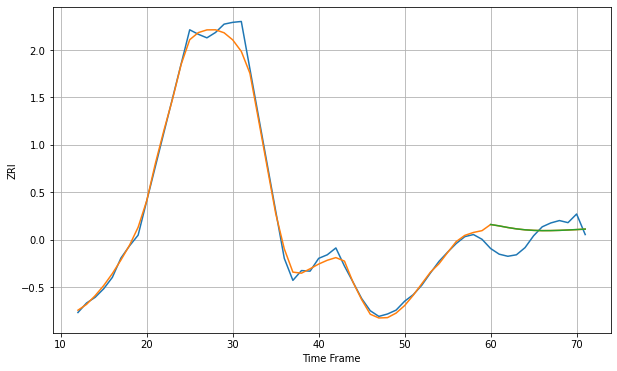

Wall time: 11.1 s
94158 22.2829478762586 59.14516680460595 59.15075177941154 [3983.75765605 3979.05291738 3973.64234513 3969.10339524 3965.91940836
 3964.04728051 3963.15332247 3963.32421726 3964.08824573 3965.30321081
 3966.74871783 3968.39843896]

Got an mse at 0.0025 in round 127 and stopped training

60 60 12


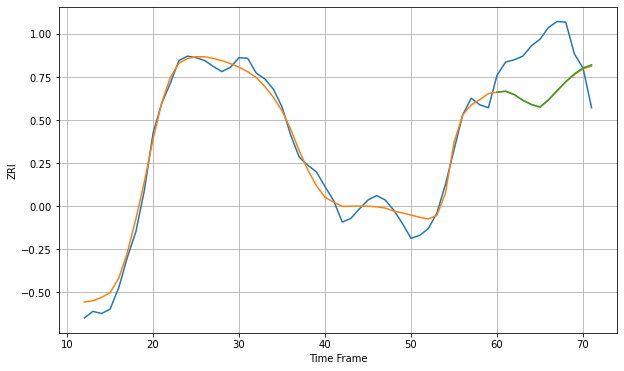

Wall time: 7.25 s
94401 13.1212597174349 65.74892359409097 65.58982207859951 [2838.11098925 2839.39000828 2834.87218433 2827.19729722 2821.41106296
 2818.00517466 2827.9543054  2840.49570654 2852.60415013 2862.93827803
 2871.07791284 2875.17861414]

Got an mse at 0.0025 in round 86 and stopped training

60 60 12


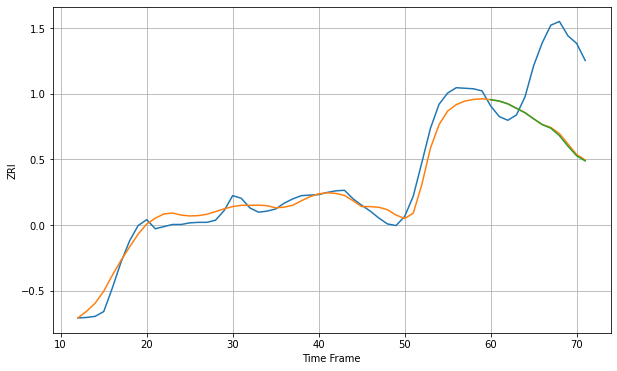

Wall time: 6.61 s
94403 19.121831205938285 140.22064237370907 141.83579859333486 [3090.61485336 3088.04705633 3082.82576868 3074.45709105 3066.14907714
 3054.80942291 3044.063767   3037.16890794 3023.22962482 3003.37609005
 2985.66100647 2975.88352958]

Got an mse at 0.0025 in round 149 and stopped training

60 60 12


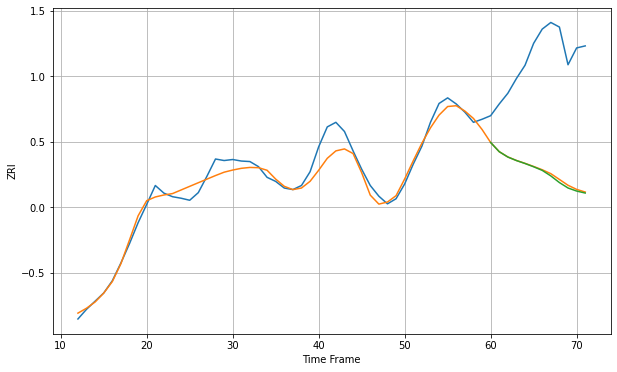

Wall time: 8.11 s
94404 19.30608176874168 226.85755406459361 229.24418826827704 [3096.40353513 3078.34159823 3067.88939791 3060.96169639 3055.16808244
 3048.75094251 3041.68762761 3030.79678857 3017.73826473 3007.11300118
 3001.09282609 2997.1863514 ]

Got an mse at 0.0024 in round 156 and stopped training

60 60 12


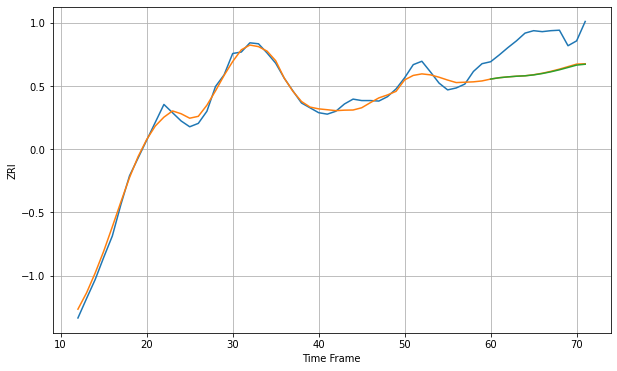

Wall time: 8.42 s
94501 13.02355838690292 71.24113991366576 71.89361629977132 [2583.31434141 2586.0500237  2587.79134189 2589.14980002 2589.9732734
 2591.86557031 2594.67992154 2598.24059454 2602.41895317 2607.20272463
 2612.05981245 2613.8608085 ]

Got an mse at 0.0025 in round 117 and stopped training

60 60 12


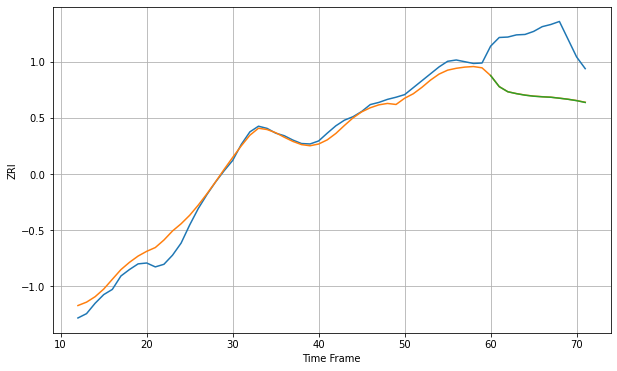

Wall time: 7.23 s
94509 19.569716513109974 133.83640832538018 133.99807571904051 [1879.03682234 1853.4204289  1841.60241665 1837.24088158 1833.7527357
 1831.33951816 1829.95650809 1828.93006609 1826.70812229 1824.23522595
 1821.09541234 1816.91893568]

Got an mse at 0.0025 in round 100 and stopped training

60 60 12


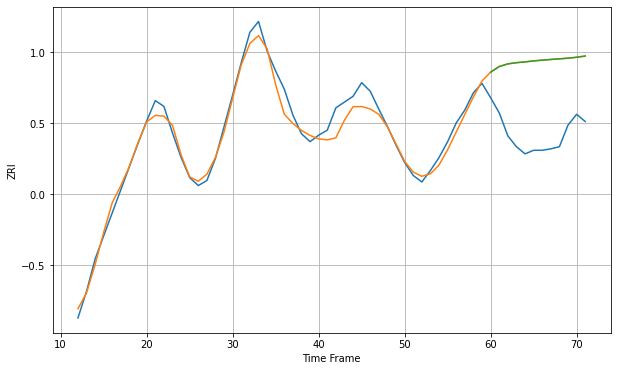

Wall time: 6.6 s
94530 13.680072633070996 104.07944947750794 104.10265906217053 [2486.57882471 2494.36687908 2498.05936444 2499.73350495 2500.84299067
 2502.17068384 2503.26029148 2504.21097125 2505.08092735 2505.99018627
 2507.28535066 2509.01120052]

Got an mse at 0.0025 in round 135 and stopped training

60 60 12


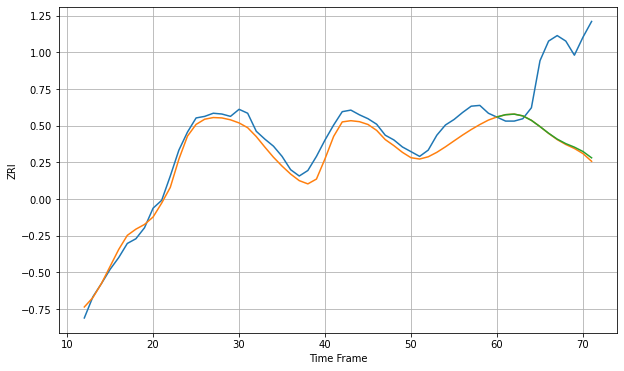

Wall time: 7.65 s
94538 14.122858592577847 101.76042622747424 100.41233411981545 [2458.30311859 2461.14337933 2461.88888632 2459.61868856 2453.92845463
 2445.98907886 2437.53963092 2430.0368701  2424.24237985 2419.79223678
 2414.22180968 2406.1630153 ]

Got an mse at 0.0025 in round 221 and stopped training

60 60 12


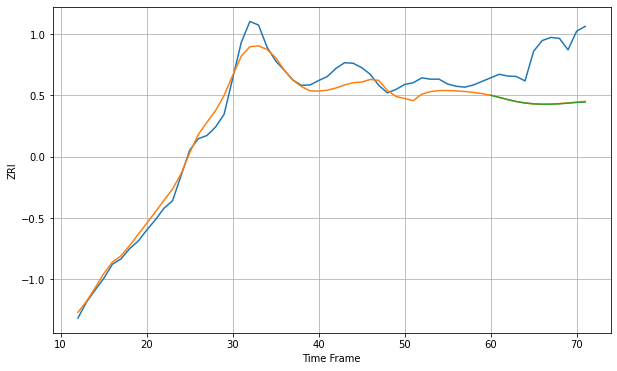

Wall time: 9.51 s
94541 24.81297916037395 115.46635583288074 115.79439596052798 [2344.74488694 2339.94392314 2334.91677112 2330.56987991 2327.3368999
 2325.34628083 2324.50430472 2324.6435622  2325.57943312 2327.01973394
 2328.56234772 2329.60167441]

Got an mse at 0.0025 in round 204 and stopped training

60 60 12


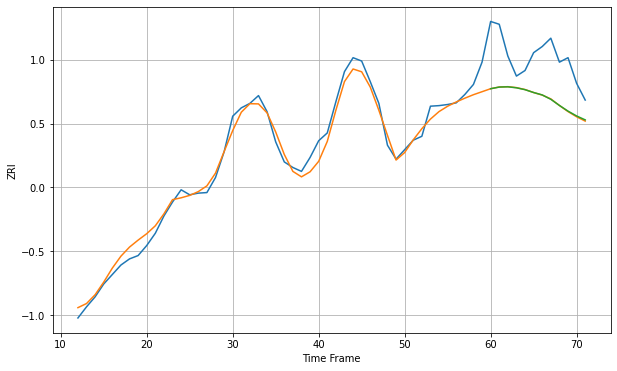

Wall time: 9.24 s
94549 16.400124163920026 80.02534473380899 79.85912405455664 [2697.33292845 2700.29612406 2700.74552923 2698.98515276 2695.60619709
 2690.51484879 2686.20102414 2678.33435542 2667.31887927 2657.1309289
 2648.45992624 2641.41182355]

Got an mse at 0.0025 in round 117 and stopped training

60 60 12


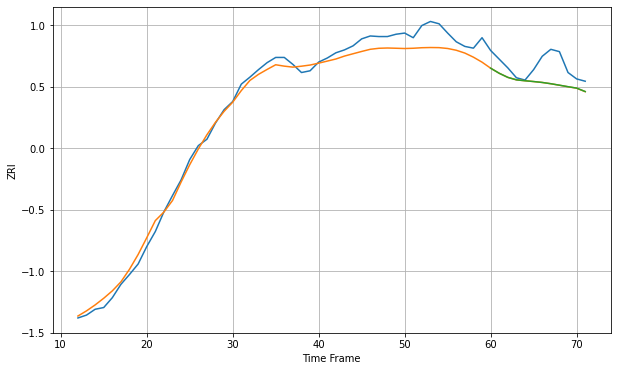

Wall time: 7.19 s
94565 17.571197793811194 32.038570755811904 31.986847962950833 [1973.46760851 1964.70340009 1957.64039522 1953.3875928  1951.83561242
 1950.46560775 1948.89714385 1946.72159544 1944.19032132 1941.5880813
 1939.18974793 1933.23529564]

Got an mse at 0.0024 in round 311 and stopped training

60 60 12


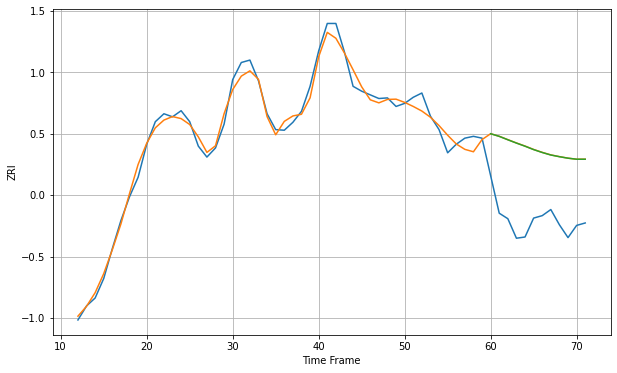

Wall time: 12 s
94568 13.27539981778057 118.17987567810763 118.03277293690348 [2773.26637594 2768.96190454 2763.37146385 2757.9292333  2752.81356042
 2747.24887219 2742.50609177 2738.39650497 2735.61221138 2733.17561669
 2731.47154776 2731.47546957]

Got an mse at 0.0025 in round 151 and stopped training

60 60 12


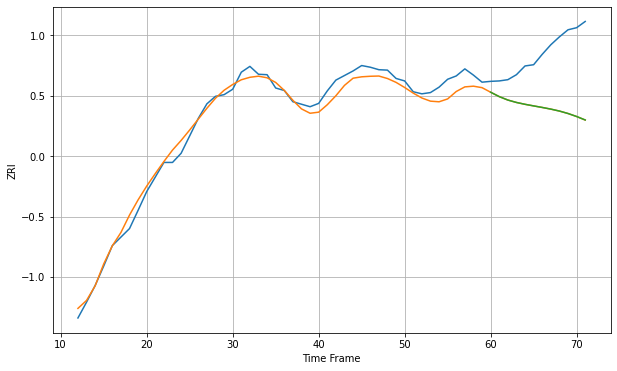

Wall time: 8.14 s
94603 20.863214353345132 141.92045036491305 141.89582753954187 [2351.85007432 2341.31508527 2333.0791623  2327.25712215 2322.79226311
 2318.96068888 2315.2381472  2311.23599476 2306.55677412 2300.69061489
 2293.48560266 2285.10469093]

Got an mse at 0.0025 in round 337 and stopped training

60 60 12


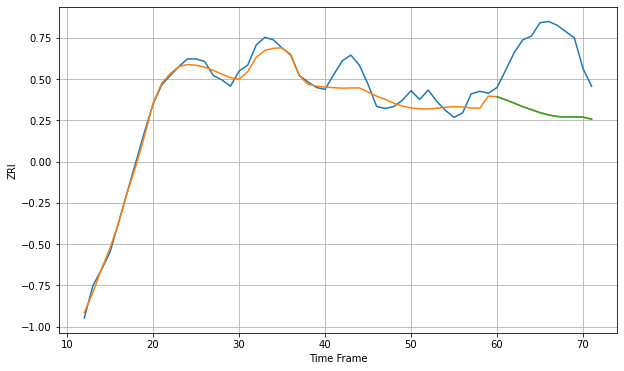

Wall time: 12.2 s
94608 16.267384259022744 107.14774368185704 107.0883236366734 [2784.45558322 2779.59329157 2774.39002763 2768.73030821 2764.11032838
 2759.44068249 2755.82255117 2753.34861262 2752.40092565 2752.85879109
 2752.47609883 2749.23038111]

Got an mse at 0.0025 in round 205 and stopped training

60 60 12


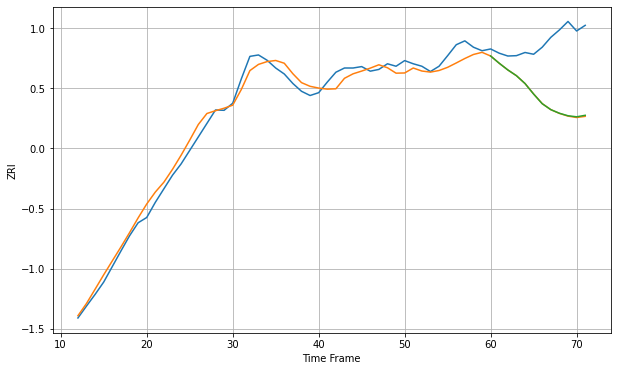

Wall time: 9.01 s
94621 24.087625670438047 170.5748066913334 169.80309592944477 [2511.05221597 2490.45988513 2471.51406488 2455.19918155 2432.91524436
 2403.11441662 2375.73075159 2358.87052682 2348.65805699 2341.52968573
 2338.59080434 2342.87877212]

Got an mse at 0.0025 in round 200 and stopped training

60 60 12


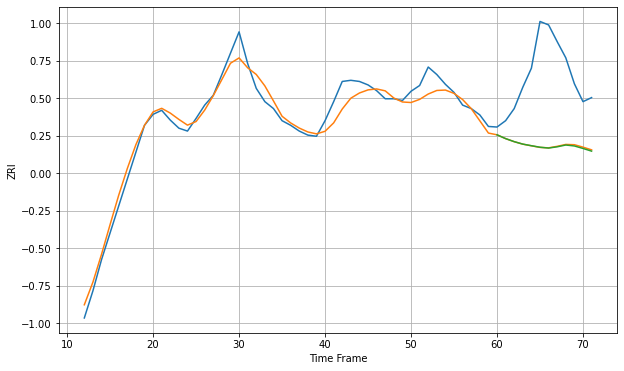

Wall time: 9.34 s
94703 18.58978361320709 131.1509191323656 131.71954277766977 [2749.49204474 2742.93413278 2737.65451333 2733.40291932 2730.6278438
 2727.98801633 2726.53697851 2728.72867611 2731.81733168 2730.18900198
 2725.87040594 2721.22503945]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


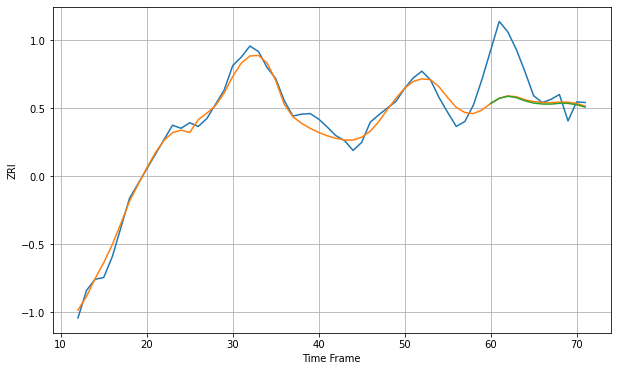

Wall time: 10.2 s
94801 14.392396433844166 60.005485815230465 60.42998037030905 [2241.39642929 2249.7639172  2253.11753992 2250.97434852 2245.61669006
 2242.14522343 2240.56361731 2240.35882977 2241.64230144 2241.5568644
 2239.40614028 2235.51508698]

Got an mse at 0.0025 in round 102 and stopped training

60 60 12


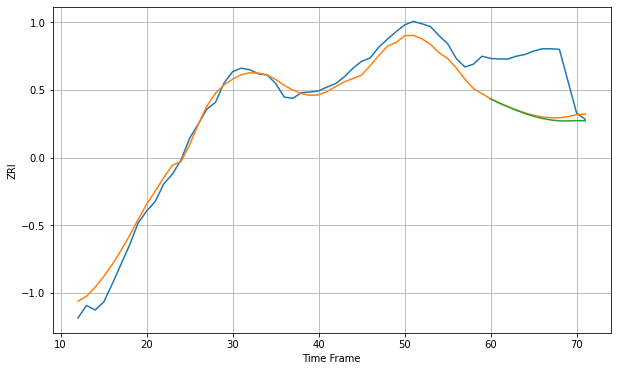

Wall time: 6.73 s
94806 21.559103623390378 90.24587383066908 92.40263071791736 [2073.95389694 2066.66674794 2060.09176188 2053.89864171 2048.22611339
 2043.4610371  2039.57925675 2036.95824121 2035.35889622 2035.21898206
 2035.82150172 2035.37532191]

Got an mse at 0.0025 in round 138 and stopped training

60 60 12


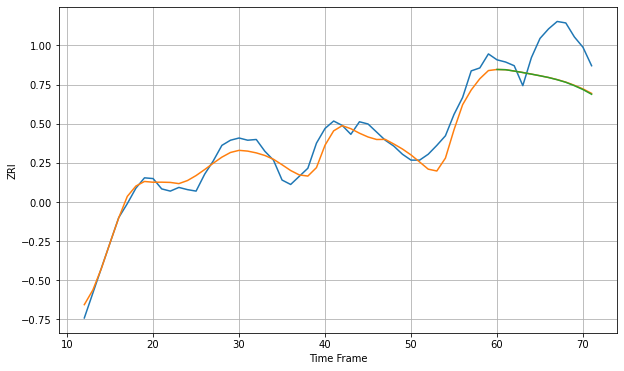

Wall time: 7.57 s
94901 14.96965107567474 49.66180518499918 49.94576185062471 [2621.92017811 2621.58603562 2619.76777219 2617.76531724 2615.62195005
 2613.37898037 2610.9948529  2608.02254948 2604.5266701  2599.9124566
 2594.67201671 2588.26880142]

Got an mse at 0.0025 in round 286 and stopped training

60 60 12


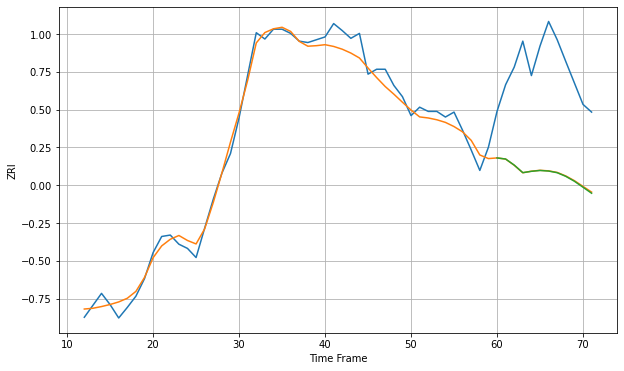

Wall time: 11.3 s
94903 14.03765554227975 150.91248291974267 151.27289623894535 [2580.77774265 2579.22504467 2570.60582143 2559.8372921  2561.72834796
 2562.94364988 2562.11187609 2559.75263693 2554.56788278 2547.60023494
 2539.09503071 2530.54823577]

Got an mse at 0.0025 in round 207 and stopped training

60 60 12


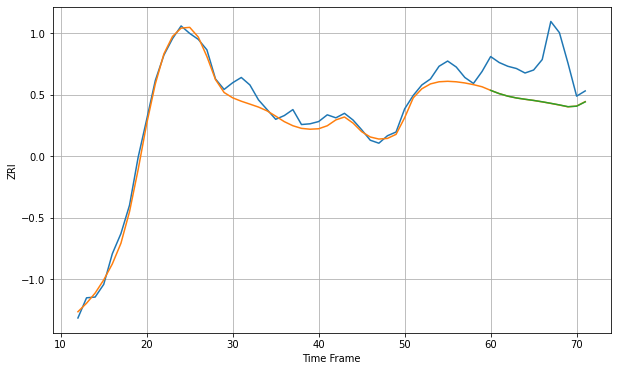

Wall time: 9.43 s
95008 11.747580986942683 56.45219639158692 56.396349639437965 [2585.76071355 2581.39932931 2578.00242104 2575.57186166 2573.8639766
 2572.28891526 2570.438644   2568.40472313 2566.25321051 2563.88205729
 2564.55033934 2570.36403073]

Got an mse at 0.0025 in round 155 and stopped training

60 60 12


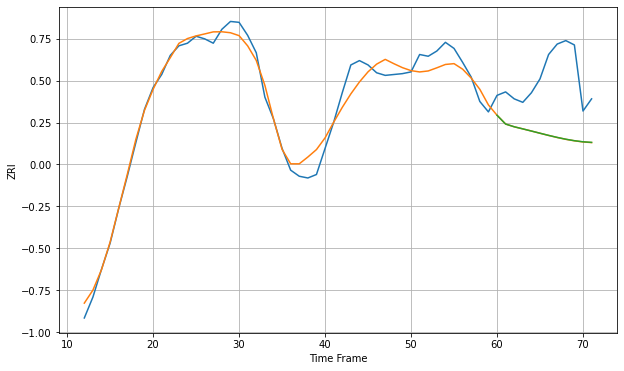

Wall time: 8.12 s
95014 13.152851843653774 69.97064841518109 69.89055455007131 [3186.17398465 3176.02690171 3172.88231387 3170.47200236 3167.99723554
 3165.46868945 3162.98778118 3160.65843224 3158.58369263 3156.89064168
 3155.62256746 3154.94054926]

Got an mse at 0.0025 in round 325 and stopped training

60 60 12


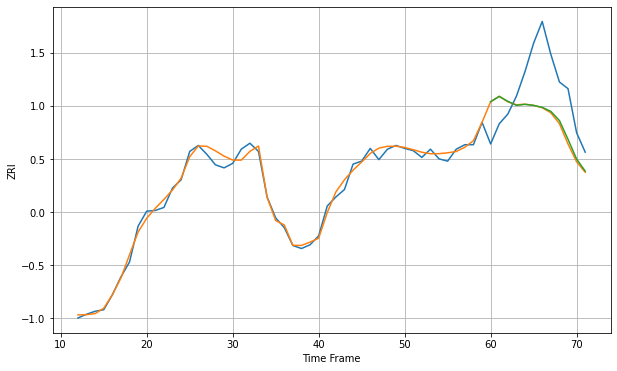

Wall time: 11.9 s
95050 7.386168356696522 60.6276702502483 59.21387824912858 [2732.56356197 2739.61522088 2733.0642147  2727.71178831 2729.00102802
 2727.63827541 2725.01024111 2719.61240817 2707.37229856 2682.1719616
 2655.77812434 2639.62947296]

Got an mse at 0.0024 in round 100 and stopped training

60 60 12


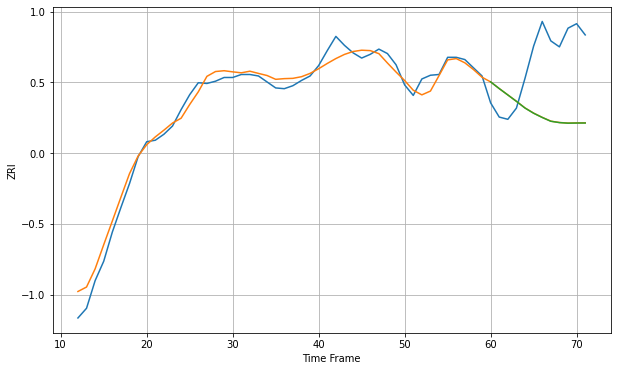

Wall time: 6.78 s
95051 12.653500395594303 90.81115629211433 90.93168058692902 [2831.09337904 2822.1290376  2813.5862689  2805.027117   2796.05178494
 2789.12590358 2783.46458183 2778.37845305 2776.58432045 2775.82514942
 2776.01235928 2776.03741378]

Got an mse at 0.0025 in round 66 and stopped training

60 60 12


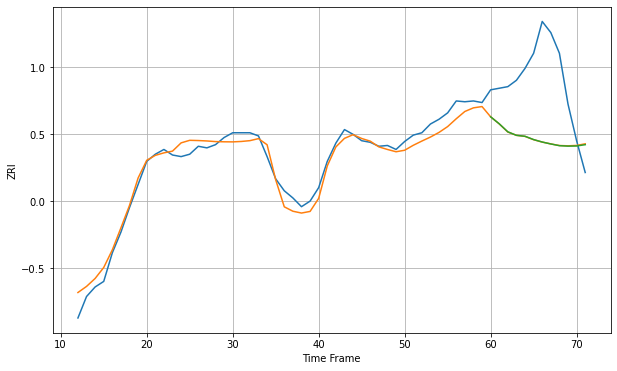

Wall time: 5.78 s
95112 11.584134450992101 86.87187616354505 86.82798699154569 [2549.04951737 2540.26704013 2530.17977725 2525.74774318 2524.56624748
 2520.40672637 2517.34172925 2514.9079736  2512.74747784 2512.1796129
 2512.35094256 2513.9974553 ]
60 60 12


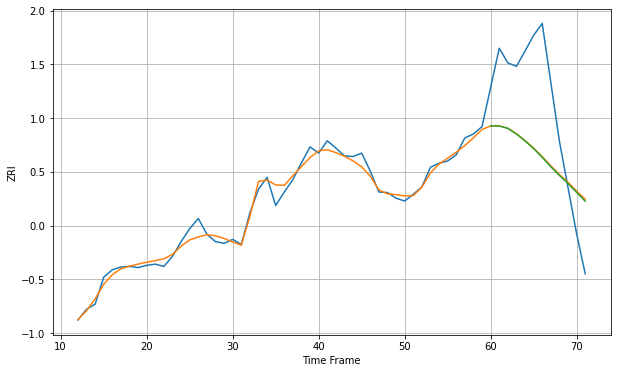

Wall time: 15.7 s
95116 11.340741106959332 135.72234424814616 135.916848749862 [2572.18842829 2572.19305304 2567.90462276 2557.97565477 2545.76576179
 2532.09252763 2516.62049521 2499.79801528 2484.4240676  2470.10899484
 2454.3395965  2438.69236714]

Got an mse at 0.0025 in round 210 and stopped training

60 60 12


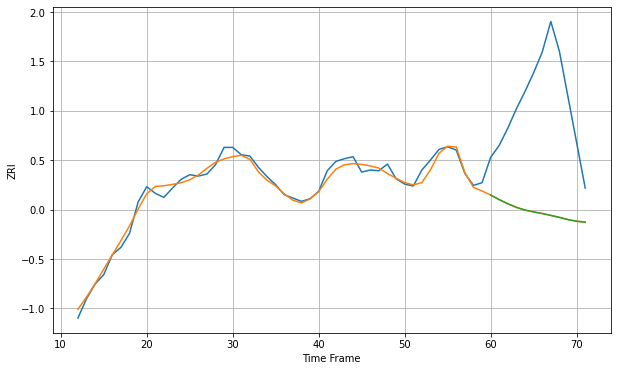

Wall time: 9.27 s
95117 8.651138822013246 176.8955483898948 177.01401337210436 [2495.56651275 2488.56497271 2482.43091931 2476.96054748 2472.91901642
 2470.14776617 2467.70109464 2464.8745542  2461.875704   2458.54885781
 2456.06747726 2454.6819594 ]

Got an mse at 0.0025 in round 152 and stopped training

60 60 12


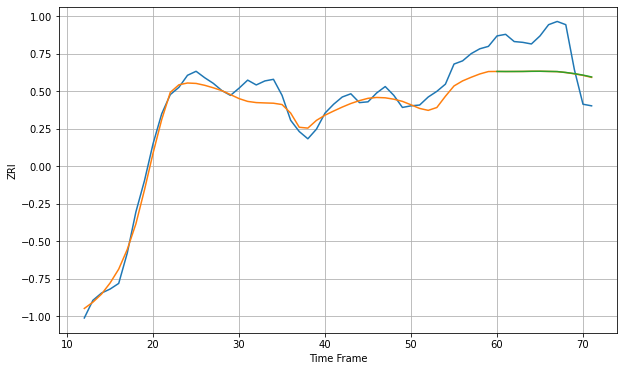

Wall time: 7.88 s
95123 15.06670112365726 44.053321989065566 44.0824877305705 [2753.79086344 2753.71773152 2753.74567036 2753.8001817  2753.99038412
 2754.04292839 2753.84698384 2753.65835007 2752.53215103 2751.07091672
 2749.25459535 2746.94622809]

Got an mse at 0.0024 in round 170 and stopped training

60 60 12


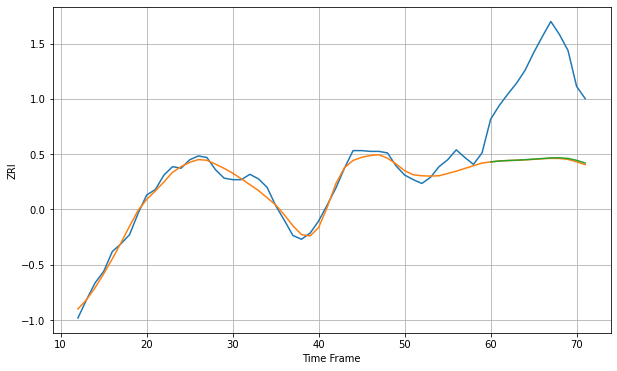

Wall time: 8.16 s
95128 9.206577576296008 122.68766388924132 122.07104431822182 [2531.20530847 2532.41791187 2533.03122044 2533.43164928 2534.10065307
 2534.82888984 2535.6572538  2536.44248526 2536.59482996 2535.7760447
 2533.28190889 2529.73770856]

Got an mse at 0.0025 in round 129 and stopped training

60 60 12


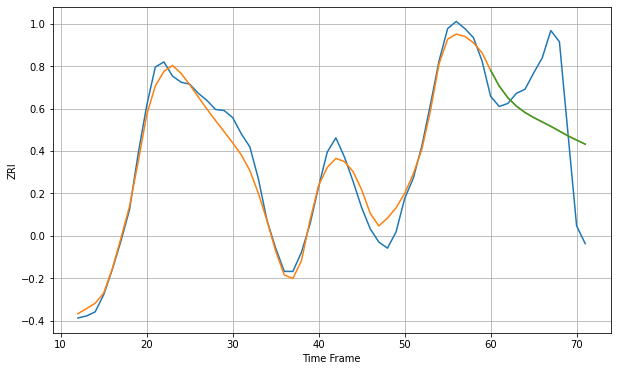

Wall time: 7.3 s
95134 12.134674646260352 58.675390832130596 58.678315574867064 [3125.69100177 3110.15451972 3098.66820734 3090.30357938 3084.0470161
 3079.08315808 3074.72471968 3070.3706729  3065.64487596 3060.96129757
 3056.72621053 3052.75916035]

Got an mse at 0.0025 in round 76 and stopped training

60 60 12


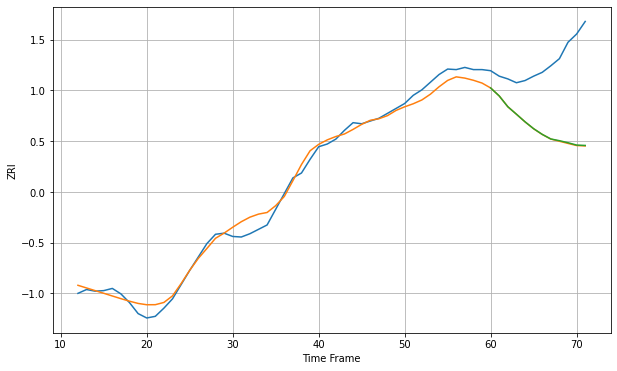

Wall time: 6.08 s
95207 14.39597420333608 130.48202630296933 129.94035326530027 [1208.45940074 1193.83336838 1174.12179261 1160.47011436 1146.60527618
 1134.00738379 1123.62636824 1115.20886165 1112.07590196 1108.33399796
 1104.03598704 1103.38268238]

Got an mse at 0.0025 in round 189 and stopped training

60 60 12


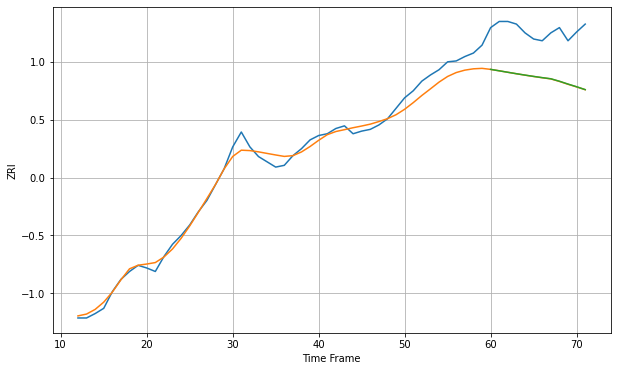

Wall time: 8.9 s
95608 9.532485835952823 55.08449979133039 54.97932592359902 [1398.37863684 1396.74911929 1395.07951011 1393.43653365 1391.86613249
 1390.36958351 1388.96931145 1387.68470087 1384.86883888 1381.63996215
 1378.59833401 1375.290833  ]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


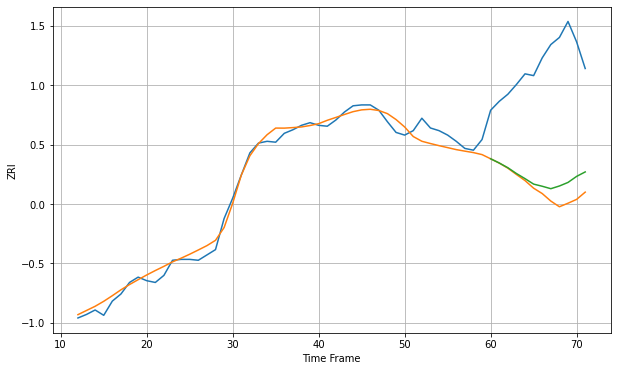

Wall time: 8.09 s
95678 9.176503790364997 141.17601966605366 128.53607348061405 [1646.31864188 1641.58489566 1636.26483146 1629.72526895 1623.9457084
 1617.79414602 1615.37635568 1612.62343836 1615.67496988 1619.68444545
 1626.48781194 1631.52057324]

Got an mse at 0.0025 in round 89 and stopped training

60 60 12


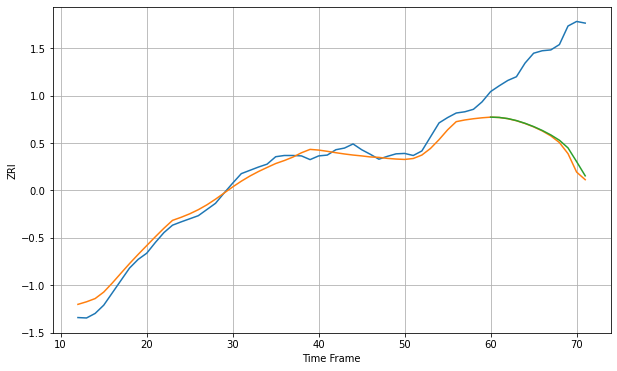

Wall time: 6.34 s
95816 19.19107453182261 222.52183181342377 215.2898739216564 [1430.00188239 1429.27831439 1426.49888314 1421.67331582 1415.08571845
 1407.11688833 1397.78749026 1386.93331932 1373.95628563 1355.38380459
 1322.09780619 1287.71591686]

Got an mse at 0.0025 in round 223 and stopped training

60 60 12


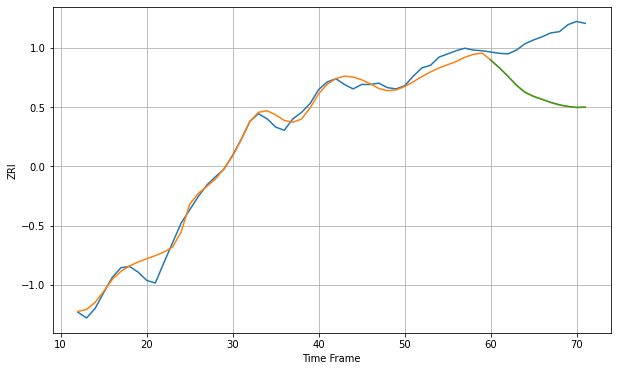

Wall time: 9.45 s
95826 12.426786057939141 93.95522608337986 93.77899818544097 [1427.44625682 1415.35869661 1402.1018376  1387.82751846 1376.68421111
 1370.205179   1365.53842092 1360.80438944 1357.01025462 1354.52315257
 1353.0478877  1353.3417371 ]

Got an mse at 0.0025 in round 69 and stopped training

60 60 12


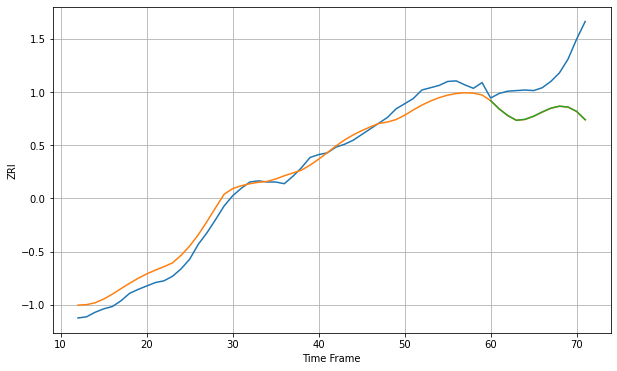

Wall time: 5.93 s
95831 16.745076071724583 76.4215916972542 76.32277449978795 [1530.47967782 1515.86164775 1504.19842247 1496.00667245 1497.71399531
 1503.20711676 1510.58920021 1517.24201812 1520.69947029 1519.25129959
 1511.54575236 1496.99804809]

Got an mse at 0.0025 in round 123 and stopped training

60 60 12


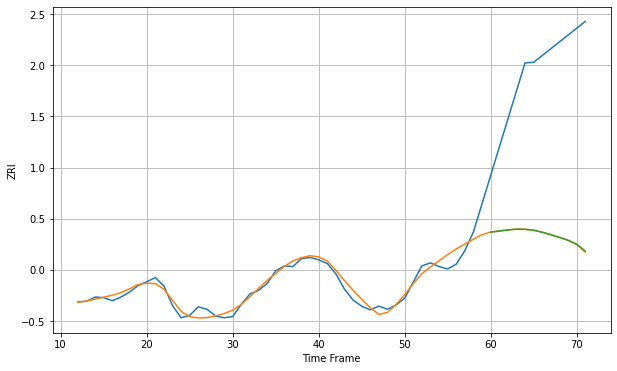

Wall time: 7.19 s
95928 11.70791504236088 277.472143585771 277.24709662293066 [1392.53086861 1394.17939527 1396.04977645 1397.27998968 1396.97993549
 1395.49806107 1392.30387551 1388.24443302 1383.84942483 1379.16742881
 1372.80390263 1361.58964182]

Got an mse at 0.0024 in round 239 and stopped training

60 60 12


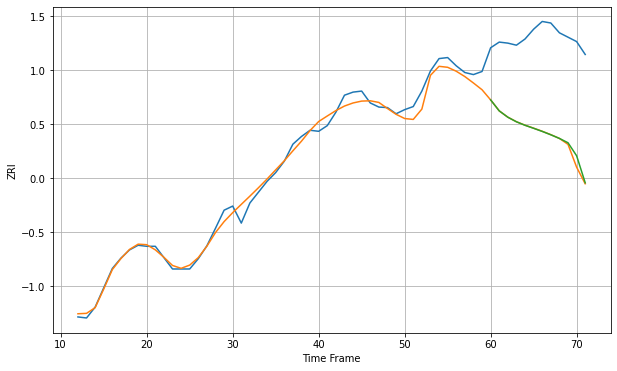

Wall time: 9.78 s
96150 14.038983511989452 190.39513525111482 187.73129227915715 [1597.91234165 1576.60276403 1564.32637921 1555.44279839 1548.6495167
 1542.82776834 1536.7913033  1530.2294042  1523.19124716 1514.76427517
 1489.58890535 1437.1595632 ]

Got an mse at 0.0025 in round 220 and stopped training

60 60 12


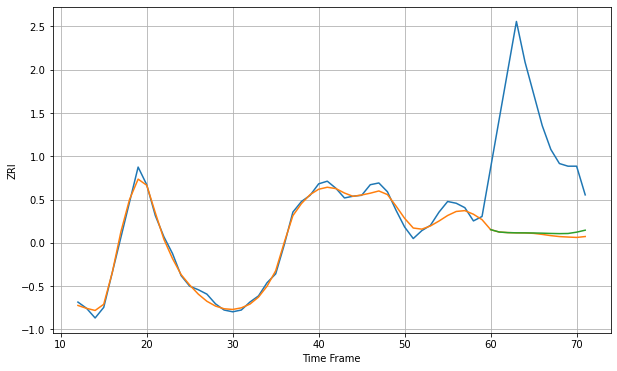

Wall time: 9.37 s
96826 5.8701812343887205 135.9597732767535 134.82719335199613 [1518.10639241 1515.39207324 1514.73379048 1514.47607323 1514.42618542
 1514.30900325 1514.09752822 1513.79321652 1513.58555547 1513.73547711
 1515.24678704 1517.47212634]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


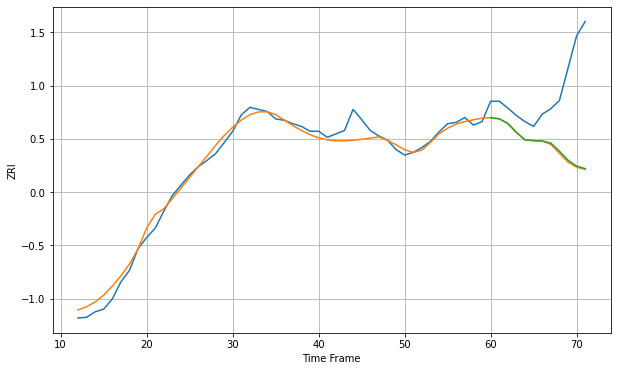

Wall time: 7.99 s
97030 11.718499017709602 98.7713252888181 97.6906634330431 [1372.83490355 1371.24360037 1364.34358883 1351.25212282 1340.27873669
 1339.23997141 1338.70556604 1335.57375133 1323.66139924 1310.48512214
 1301.87566522 1298.05358462]

Got an mse at 0.0025 in round 139 and stopped training

60 60 12


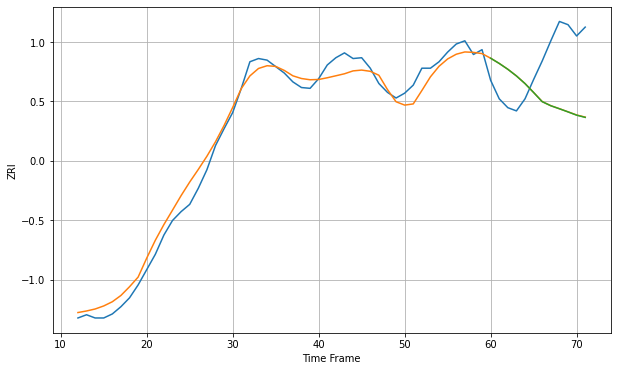

Wall time: 7.47 s
97035 13.718966994890783 71.88027693684597 71.98118651369757 [1580.39156036 1573.90285552 1566.64929052 1558.39606221 1548.87586189
 1537.81941843 1526.43037989 1521.3925467  1517.65190906 1513.75771811
 1509.7247087  1506.94031738]

Got an mse at 0.0025 in round 263 and stopped training

60 60 12


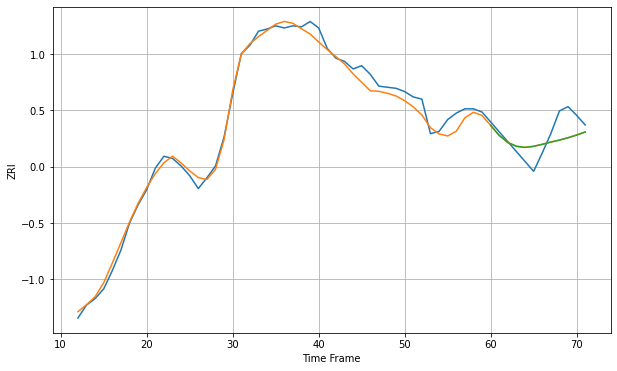

Wall time: 10.4 s
97062 7.06509098503256 15.339167047983683 15.339198688687333 [1443.61319727 1434.34056368 1427.74826584 1424.2449782  1423.23384412
 1424.20948933 1426.05756493 1428.1683527  1429.97704498 1432.14353986
 1434.6597341  1437.49006272]

Got an mse at 0.0025 in round 246 and stopped training

60 60 12


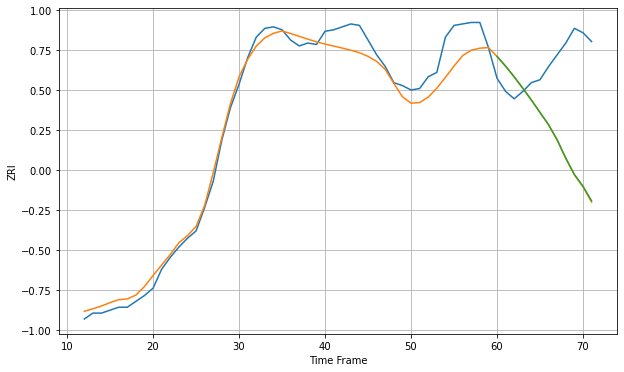

Wall time: 10.2 s
97070 10.164432148442545 61.556797364725576 61.305288698770816 [1367.85468798 1361.23305483 1353.93547021 1346.1584544  1338.13077064
 1329.67248271 1321.2775558  1311.02228077 1298.56091875 1287.42579355
 1279.41522053 1269.50889137]

Got an mse at 0.0024 in round 160 and stopped training

60 60 12


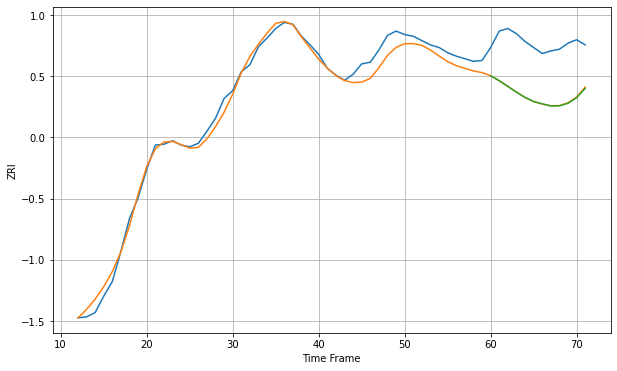

Wall time: 8.29 s
97124 9.798202246993188 61.146962024990366 61.356059911530956 [1477.23344698 1471.54860689 1464.97150128 1458.35149074 1452.19419213
 1447.4919382  1444.76799095 1442.30125319 1442.4070818  1445.44399478
 1451.84812297 1462.74115078]

Got an mse at 0.0025 in round 239 and stopped training

60 60 12


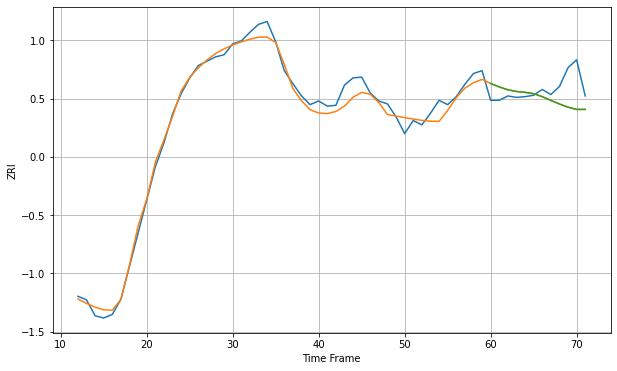

Wall time: 9.92 s
97209 11.452520993788509 28.64097444872553 28.62577386118011 [1750.2039018  1745.52197527 1741.55846668 1739.23402154 1738.01484997
 1736.14887816 1732.07886035 1726.90889269 1721.89979008 1717.43127493
 1714.42291528 1714.43620429]

Got an mse at 0.0025 in round 183 and stopped training

60 60 12


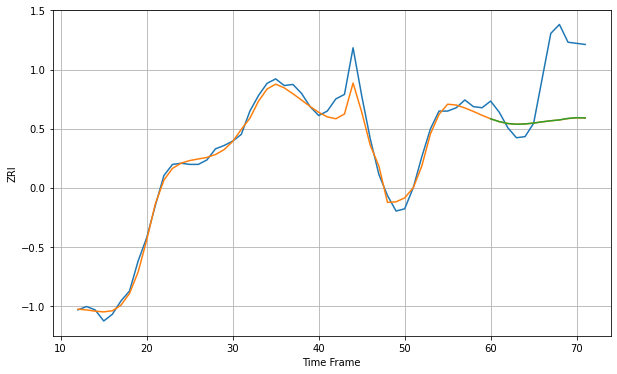

Wall time: 8.64 s
97214 7.927313933748556 49.47028028323265 49.40756314169866 [1564.03964103 1561.49782273 1559.78703091 1559.15966566 1559.424327
 1560.21138487 1561.32863769 1562.29718267 1563.08572231 1564.39759785
 1565.07286467 1564.83214336]

Got an mse at 0.0025 in round 114 and stopped training

60 60 12


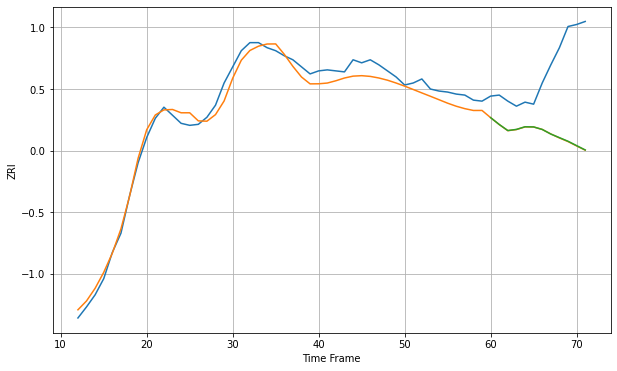

Wall time: 7.02 s
97229 9.20933894062936 72.13877876412985 71.9868801522869 [1421.6209803  1414.8585737  1408.84391419 1409.97608301 1412.5852551
 1412.43907843 1409.93537181 1405.37101608 1401.79271934 1398.22374902
 1393.89413538 1389.58919832]

Got an mse at 0.0024 in round 166 and stopped training

60 60 12


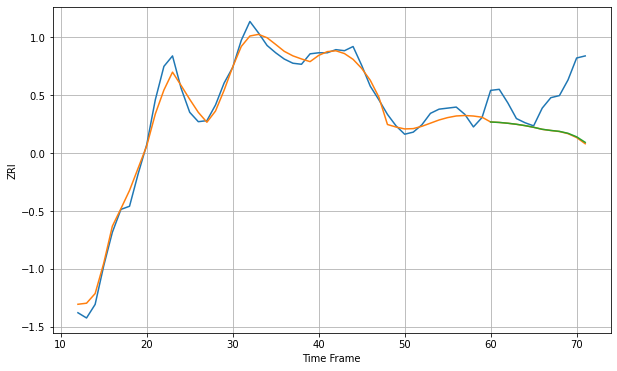

Wall time: 8.23 s
97239 8.27478419988855 41.293861809902275 40.89528764901325 [1606.7184798  1606.28752732 1605.52174933 1604.52592564 1603.24852168
 1601.65419059 1599.72963721 1598.62817641 1597.73401332 1595.89682782
 1592.52872913 1587.22917206]

Got an mse at 0.0025 in round 236 and stopped training

60 60 12


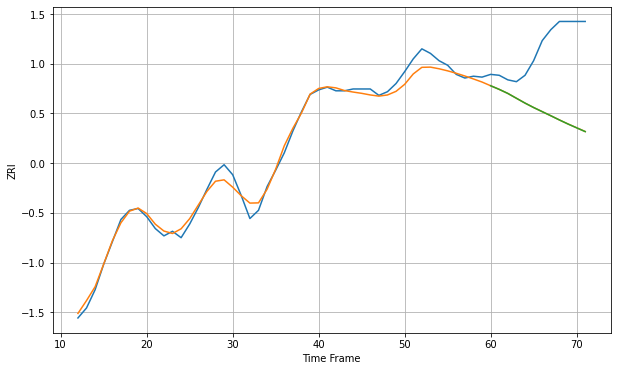

Wall time: 10.2 s
97401 7.592792018557815 77.39124216866222 77.41993692688574 [1268.54630011 1264.55147193 1260.11233725 1254.80048515 1249.52787626
 1244.66557234 1240.15077616 1235.64878681 1231.03339324 1226.60169003
 1222.44210513 1218.26390302]

Got an mse at 0.0025 in round 101 and stopped training

60 60 12


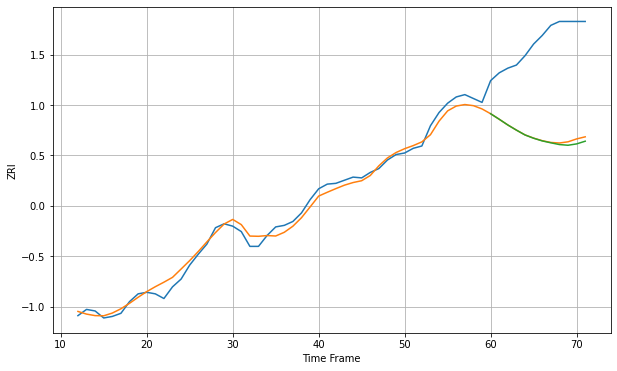

Wall time: 6.68 s
97402 8.242041874459595 121.32373597178535 123.35223815368906 [1104.43417148 1097.33410339 1089.98060535 1083.36582426 1077.17840234
 1072.95842706 1069.52353104 1067.07746199 1064.82989299 1063.94459277
 1065.67285192 1069.14131004]

Got an mse at 0.0025 in round 378 and stopped training

60 60 12


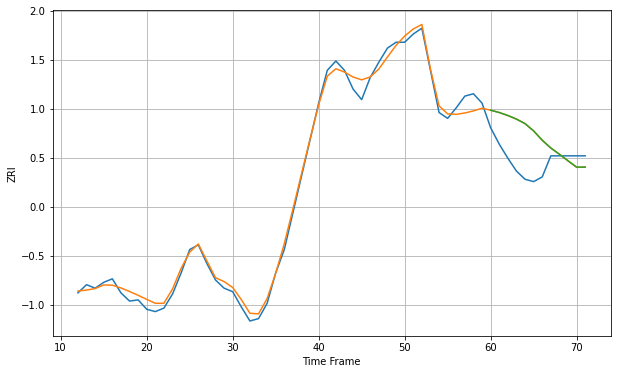

Wall time: 13.2 s
97477 5.923697291380043 28.30374114745964 28.30907558071295 [1084.97276857 1082.98885301 1080.46091466 1077.37647762 1073.53365177
 1067.30211877 1059.3193017  1052.66910875 1047.34134763 1041.78865124
 1036.41196127 1036.29274994]

Got an mse at 0.0024 in round 155 and stopped training

60 60 12


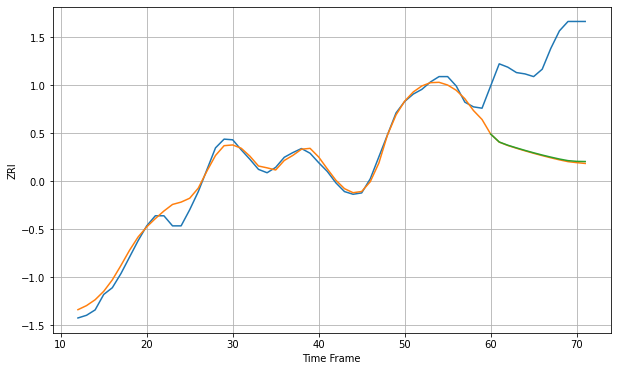

Wall time: 8.11 s
97501 10.269610116325753 153.55209423042194 152.40919044897672 [1064.59661042 1052.73080784 1047.92946206 1043.99232303 1040.23618553
 1036.68026707 1033.33183165 1030.2483737  1027.40962306 1025.0101285
 1023.93277209 1023.67359686]

Got an mse at 0.0025 in round 137 and stopped training

60 60 12


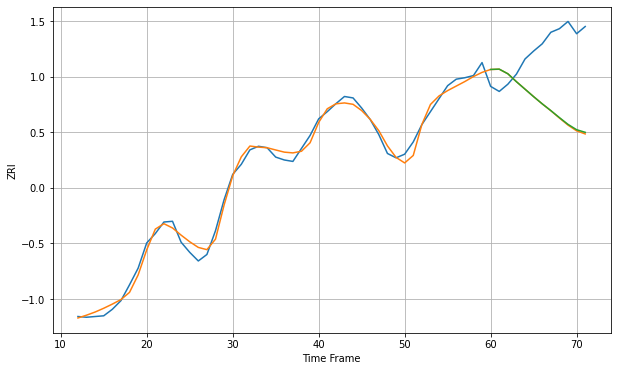

Wall time: 7.74 s
98004 8.491305210414327 92.46263547033726 91.75467599771089 [2283.45082563 2283.93429014 2277.49748307 2266.49127026 2256.12384295
 2245.77173166 2235.81797875 2226.45763305 2216.74898823 2207.3620477
 2199.95769409 2196.33442178]

Got an mse at 0.0024 in round 203 and stopped training

60 60 12


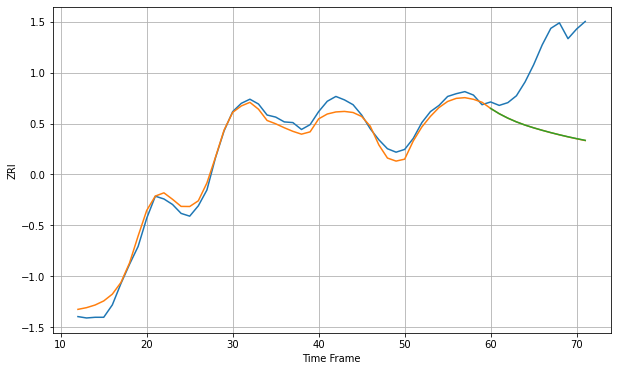

Wall time: 9.23 s
98005 10.607731152024943 113.70649434720174 113.63183490434619 [1950.57642492 1942.90763888 1936.48643433 1931.03854609 1926.40677084
 1922.41837351 1918.8081368  1915.41809792 1912.29656291 1909.37657753
 1906.69181922 1904.18616623]

Got an mse at 0.0025 in round 187 and stopped training

60 60 12


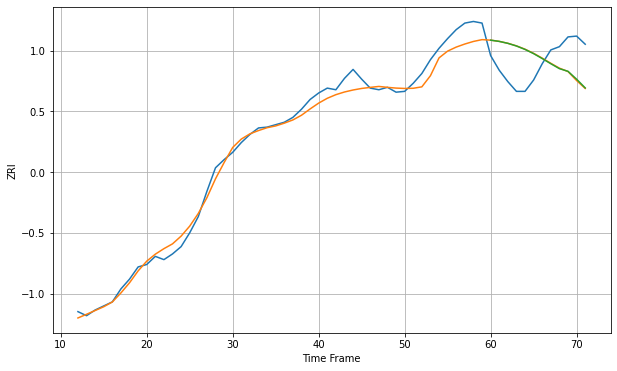

Wall time: 8.96 s
98012 11.127720572294264 40.344339119775945 40.027343525471466 [1796.00874242 1794.47738724 1792.09590648 1788.83367914 1784.60866957
 1779.40966674 1773.37796688 1766.99690379 1760.94716747 1757.64188916
 1747.96280084 1737.25781435]

Got an mse at 0.0025 in round 146 and stopped training

60 60 12


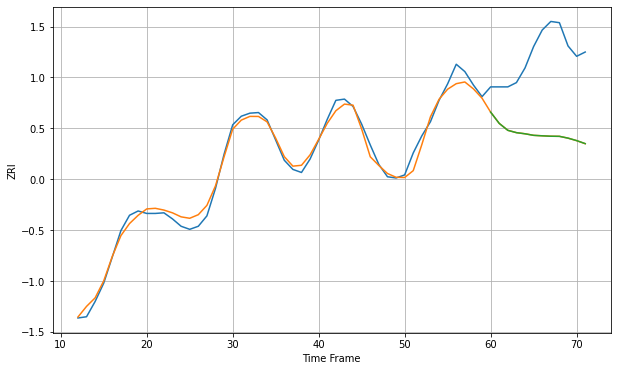

Wall time: 7.85 s
98029 11.170724607959242 133.44206170528156 133.43972442745718 [2079.69713114 2061.235052   2049.91342553 2046.1171167  2044.27882299
 2041.73534199 2040.96028444 2040.27983746 2040.10116661 2037.17752522
 2033.14664534 2028.19539707]

Got an mse at 0.0025 in round 167 and stopped training

60 60 12


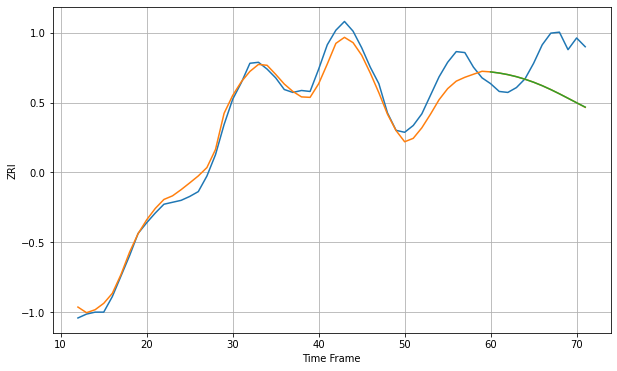

Wall time: 8.37 s
98034 11.719540530887015 42.15411883273846 42.13453416569376 [1844.12867545 1842.9441943  1841.32282137 1839.20802428 1836.58129186
 1833.50262388 1829.93590455 1825.92075617 1821.58085708 1817.00363781
 1812.38980275 1807.91100908]

Got an mse at 0.0024 in round 172 and stopped training

60 60 12


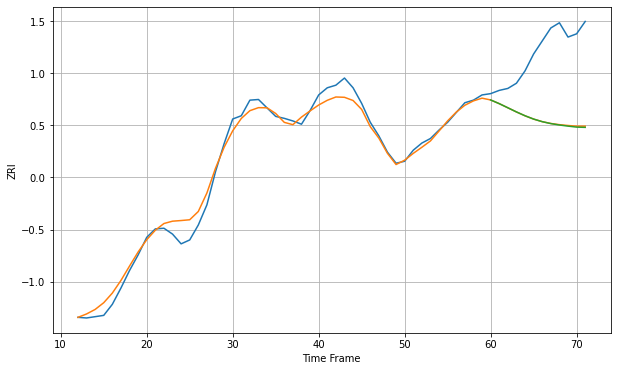

Wall time: 8.55 s
98052 12.937820117819738 109.6475317034839 110.20465234587674 [2111.29393068 2105.61616398 2099.28188764 2092.89907844 2086.99069674
 2081.89966668 2077.90761775 2074.92901883 2072.75489378 2071.04848757
 2069.52509308 2069.13479149]

Got an mse at 0.0025 in round 184 and stopped training

60 60 12


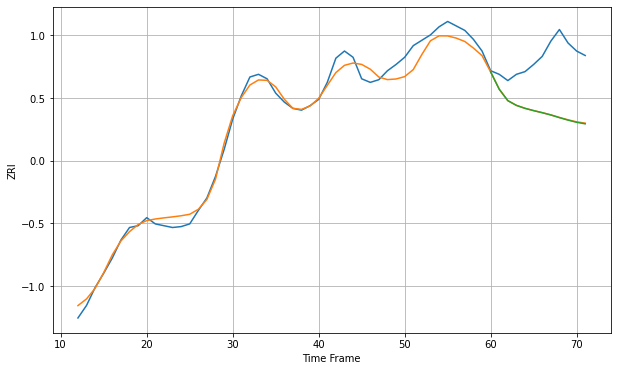

Wall time: 8.8 s
98056 9.967173093533852 61.88813879667044 62.11288882009547 [1632.69351296 1613.35992228 1600.59771843 1595.31749845 1592.0208817
 1589.46435908 1587.15380596 1584.61980773 1581.63792903 1578.88190606
 1576.42805286 1574.72204922]

Got an mse at 0.0025 in round 285 and stopped training

60 60 12


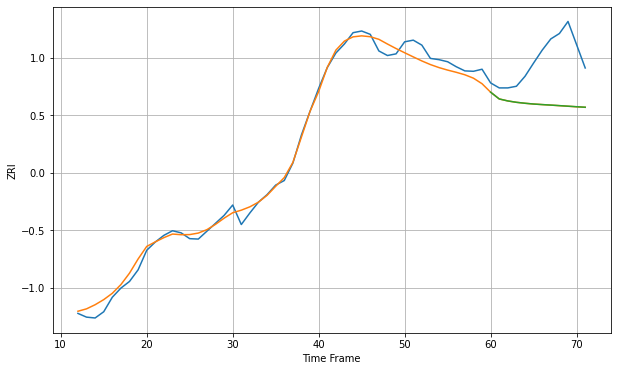

Wall time: 11.4 s
98101 17.44697498501814 116.73660210382985 116.6424947237618 [2545.66981815 2529.40652798 2524.62262431 2521.32698673 2519.03025093
 2517.16760694 2515.85991771 2514.63835142 2513.34239037 2512.00351916
 2510.71631875 2509.44972782]

Got an mse at 0.0025 in round 215 and stopped training

60 60 12


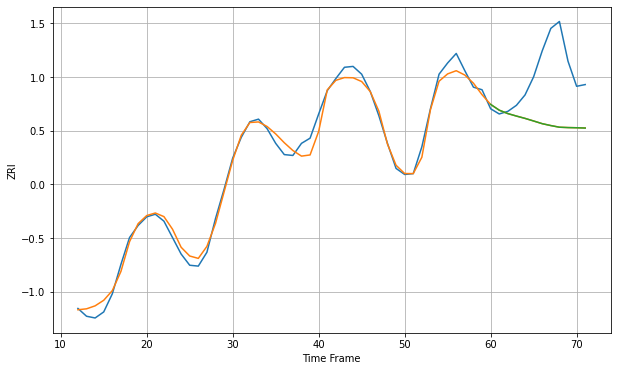

Wall time: 9.38 s
98102 8.76303277611568 63.87267865484114 63.88608541017189 [1997.0667066  1990.3822767  1986.43893221 1983.57020649 1980.88298786
 1977.86643387 1974.7580277  1972.57849339 1970.67226202 1970.2548867
 1970.03388611 1969.68764313]

Got an mse at 0.0025 in round 158 and stopped training

60 60 12


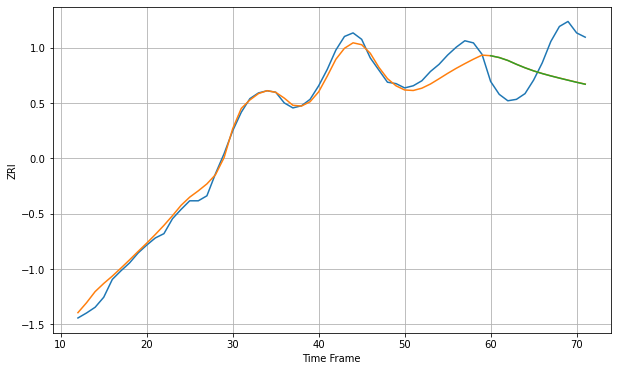

Wall time: 8.01 s
98103 12.015972764122088 53.68455572806566 53.745162347118686 [1927.06440824 1924.50355952 1920.4271261  1915.07087332 1910.15489168
 1905.83877946 1902.10517213 1898.79867974 1895.73484931 1892.78043196
 1889.8498192  1887.1517665 ]

Got an mse at 0.0025 in round 218 and stopped training

60 60 12


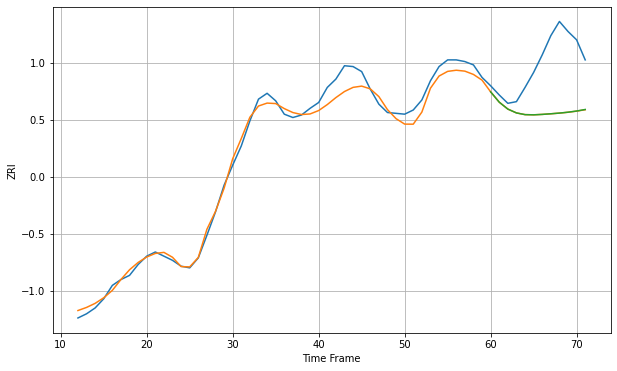

Wall time: 9.43 s
98105 10.54865632139683 64.59257363536588 64.53453811211807 [1811.7323776  1799.37520678 1791.09860627 1786.50990692 1784.45994688
 1784.23568759 1784.73155496 1785.48080213 1786.30917884 1787.36888729
 1788.77754003 1790.61781329]

Got an mse at 0.0025 in round 266 and stopped training

60 60 12


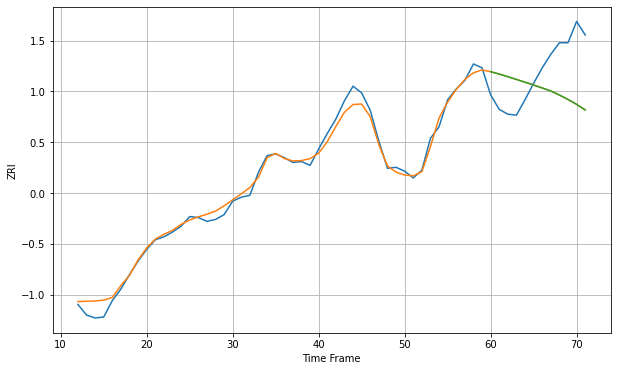

Wall time: 10.7 s
98107 7.075077263041966 47.25497039413874 47.22732856174855 [1959.97924331 1957.54606935 1954.8231812  1951.99733665 1949.12983878
 1946.20875683 1943.14347374 1940.02250799 1935.84137681 1931.24152992
 1926.18604814 1920.41487034]

Got an mse at 0.0025 in round 224 and stopped training

60 60 12


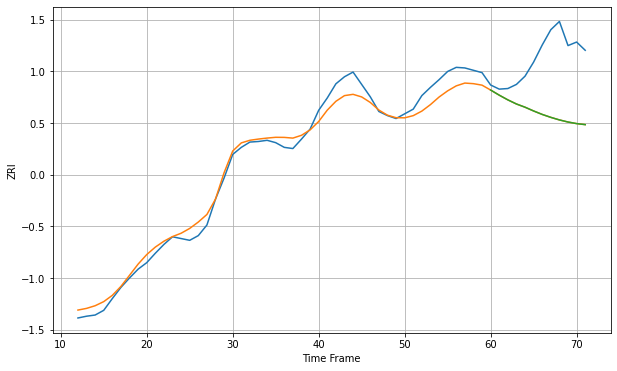

Wall time: 9.85 s
98109 17.41200364588811 103.09475382120505 103.09807026856242 [2051.41623761 2042.72341154 2034.74438484 2027.73850493 2022.26517406
 2015.86612983 2009.99081481 2004.9903031  2000.65473918 1997.06673864
 1994.38790895 1992.62164034]

Got an mse at 0.0025 in round 244 and stopped training

60 60 12


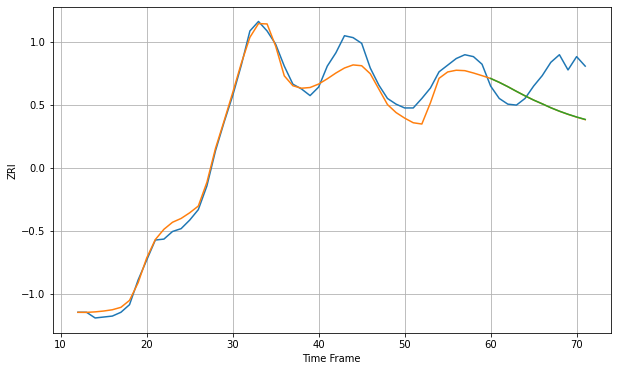

Wall time: 10 s
98115 11.674963522945204 37.88370474617075 37.82726636063068 [1846.01518121 1841.9538404  1837.3767994  1832.47188308 1827.74280001
 1823.29527746 1819.34085495 1815.23103107 1811.58418549 1808.35832042
 1805.47946843 1802.90924621]

Got an mse at 0.0025 in round 171 and stopped training

60 60 12


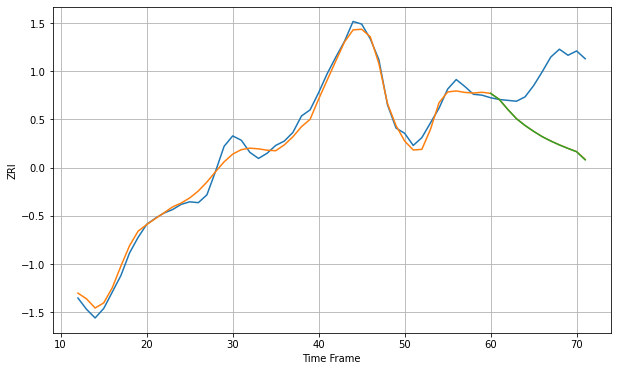

Wall time: 8.39 s
98119 8.368116993005176 76.40885969995968 76.5231881696229 [1897.05161653 1890.16136719 1878.49283507 1867.89753098 1860.03412448
 1853.25828285 1847.13618018 1842.08063549 1837.57350919 1833.56516053
 1829.7217031  1820.3542288 ]

Got an mse at 0.0024 in round 173 and stopped training

60 60 12


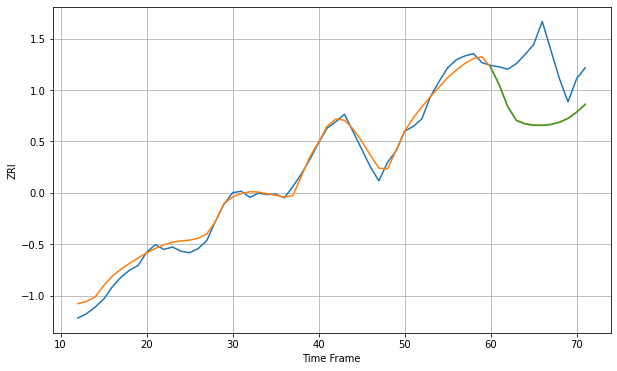

Wall time: 8.34 s
98121 15.500401441239388 117.42069508278176 117.91719048086027 [2308.03006699 2271.17046173 2224.29534766 2195.62899466 2188.41666617
 2185.33657952 2185.17524184 2186.99323883 2191.72598178 2199.8708266
 2212.97707582 2229.36024933]

Got an mse at 0.0025 in round 174 and stopped training

60 60 12


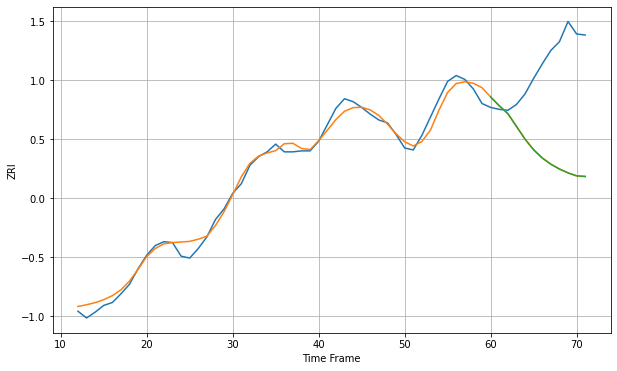

Wall time: 8.29 s
98122 7.497940703200429 98.60862020820211 98.5616875231918 [1899.86557781 1890.74571702 1882.62286855 1869.40373633 1856.14982329
 1845.12102406 1836.66678438 1830.21972045 1825.24036555 1821.26790292
 1818.1869943  1817.57532238]

Got an mse at 0.0025 in round 185 and stopped training

60 60 12


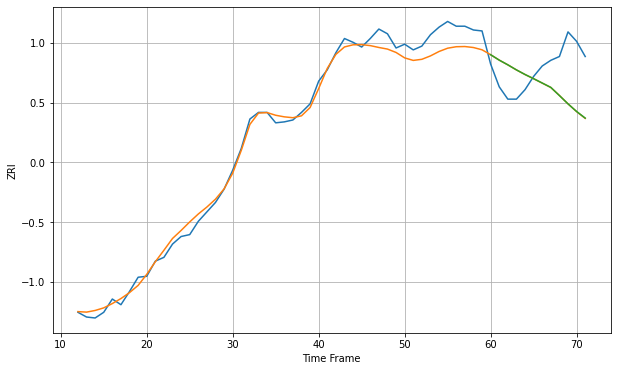

Wall time: 8.72 s
98133 11.054776720029185 42.61913894368072 42.56345056036991 [1740.90317361 1735.18603341 1730.22555186 1724.87862006 1720.02762778
 1715.60208345 1711.01446814 1706.40233189 1697.79013459 1689.00945242
 1680.97273075 1674.00254608]

Got an mse at 0.0025 in round 162 and stopped training

60 60 12


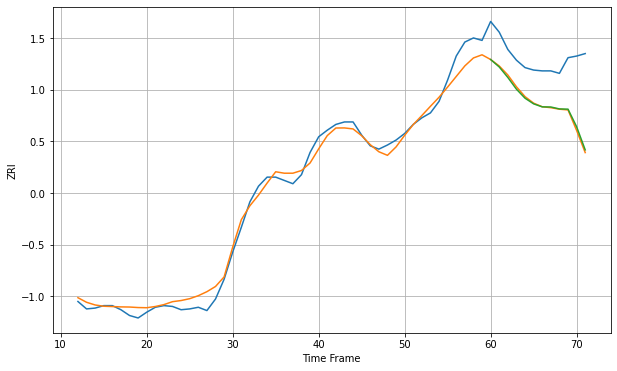

Wall time: 8.32 s
98201 10.839375072911766 58.509185116715685 57.741483717762584 [1447.79816694 1438.74960744 1426.0325735  1411.80120883 1400.82338876
 1393.96897806 1390.30579087 1390.16106151 1387.81138718 1387.53321604
 1366.19384063 1338.08221989]

Got an mse at 0.0025 in round 163 and stopped training

60 60 12


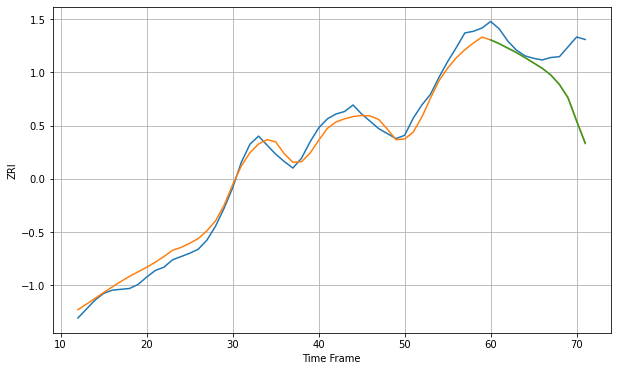

Wall time: 8.37 s
98203 10.416766166709818 52.18648383502179 52.63968916487954 [1518.50778685 1513.86746165 1508.43059243 1503.01207549 1496.87937556
 1490.3688182  1483.8461125  1475.59036069 1464.03115658 1447.66511901
 1419.14744807 1392.04196373]

Got an mse at 0.0025 in round 110 and stopped training

60 60 12


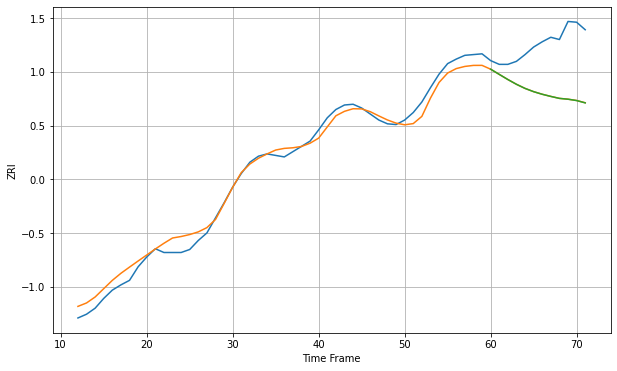

Wall time: 7.03 s
98204 11.030763161999367 67.8296565370499 67.88280712108555 [1430.57238298 1423.68918383 1416.86543108 1410.51679926 1405.054751
 1400.71950591 1397.26051075 1394.38007001 1391.78348006 1390.68458132
 1388.90668145 1385.79788815]

Got an mse at 0.0025 in round 125 and stopped training

60 60 12


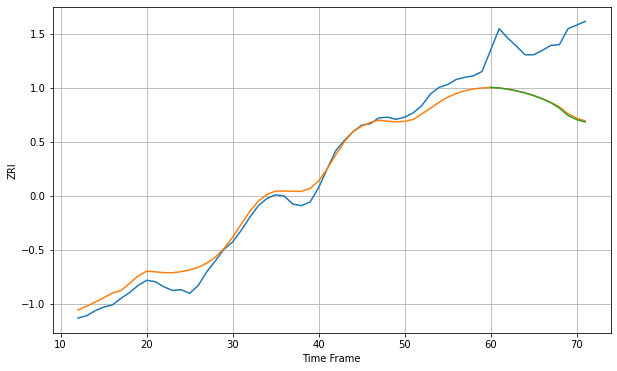

Wall time: 7.34 s
98405 14.125109551353907 87.06529820605257 88.01421347824763 [1221.02177426 1220.22299596 1218.60951266 1216.30303186 1213.37722597
 1209.77964336 1205.34192935 1199.90585194 1192.49644298 1182.29448428
 1176.6670535  1173.22979003]

Got an mse at 0.0025 in round 107 and stopped training

60 60 12


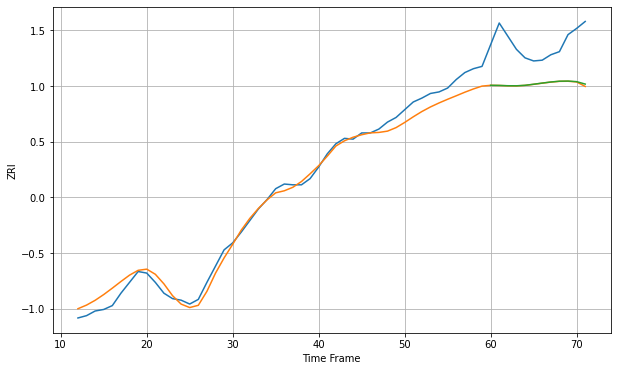

Wall time: 7 s
98409 12.139336024069301 55.40006598277611 54.89875350012004 [1241.52187297 1241.37743355 1240.98958112 1240.90802215 1241.53202879
 1242.92634123 1244.42099112 1245.81758002 1246.82485821 1247.00707328
 1246.2752492  1243.11223187]

Got an mse at 0.0025 in round 168 and stopped training

60 60 12


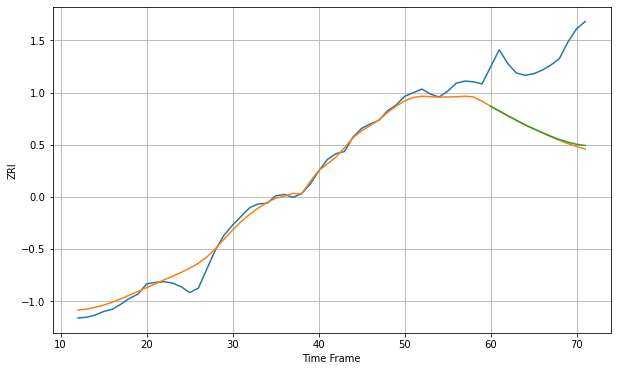

Wall time: 8.09 s
98444 11.314430382199944 106.57792814933028 105.15441513047404 [1195.28184647 1188.77359134 1182.29119221 1175.88275284 1169.7691561
 1164.30614177 1159.13779074 1154.08876165 1149.53407686 1145.82954343
 1142.9756784  1141.33978959]

Got an mse at 0.0025 in round 168 and stopped training

60 60 12


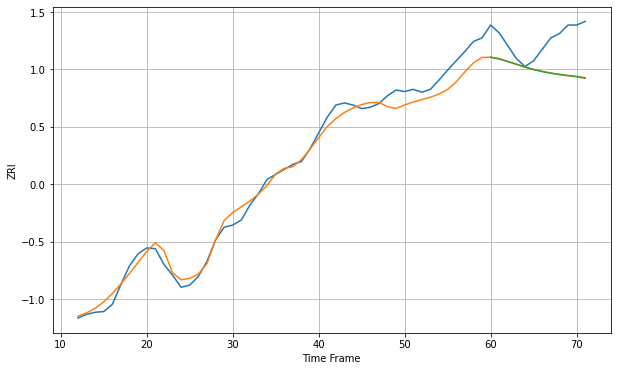

Wall time: 8.19 s
98466 13.96985051311115 47.72808063227641 47.525493258302824 [1365.97419173 1363.62996123 1359.98385698 1356.11929113 1352.15400009
 1348.73109565 1345.9862993  1343.72661837 1341.86380574 1340.33376924
 1339.020689   1337.08921947]

Got an mse at 0.0025 in round 250 and stopped training

60 60 12


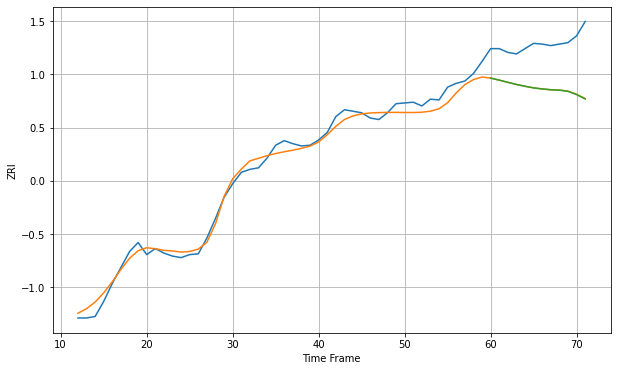

Wall time: 9.95 s
98498 9.751777860675697 60.33393818509115 60.519515129335424 [1363.97204133 1361.23904247 1358.3427533  1355.49110419 1353.09144044
 1350.95840545 1349.54212773 1348.46290219 1347.94083871 1346.37282569
 1342.03983827 1336.29055886]

Got an mse at 0.0025 in round 195 and stopped training

60 60 12


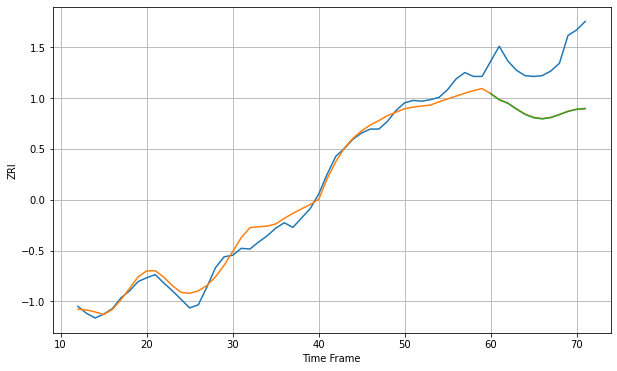

Wall time: 8.86 s
98499 11.190307054027045 71.2531838709521 71.46363897987524 [1257.86179597 1249.89279056 1245.33386102 1237.87734285 1231.03484651
 1226.6629433  1225.17357382 1226.83987859 1230.70854433 1234.87141622
 1237.49507941 1238.45586036]

Got an mse at 0.0025 in round 406 and stopped training

60 60 12


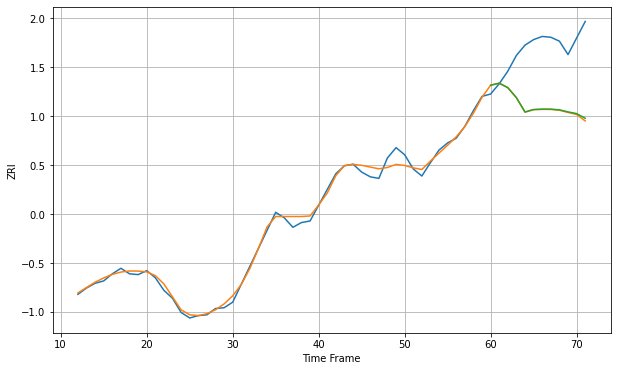

Wall time: 14.2 s
99207 6.316769570372443 78.4712275457956 77.66642274065565 [1040.17553456 1042.67554002 1037.05388805 1024.3274144  1006.22227088
 1009.38881853 1009.81713863 1009.81552818 1008.96797675 1006.31817884
 1004.1919531   998.31280033]

Got an mse at 0.0025 in round 312 and stopped training

60 60 12


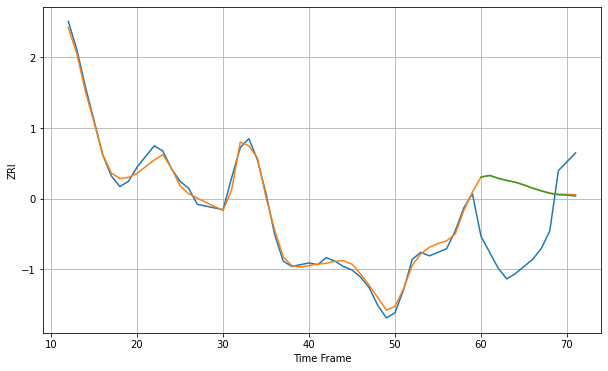

Wall time: 11.8 s
99501 3.122252757833205 38.30074793968248 38.32273889404258 [1276.35837425 1277.27754621 1275.67596789 1274.4311461  1273.43999955
 1271.88545776 1270.0792158  1268.56806002 1267.20402341 1266.38944865
 1266.16786888 1265.72826258]

Got an mse at 0.0025 in round 478 and stopped training

60 60 12


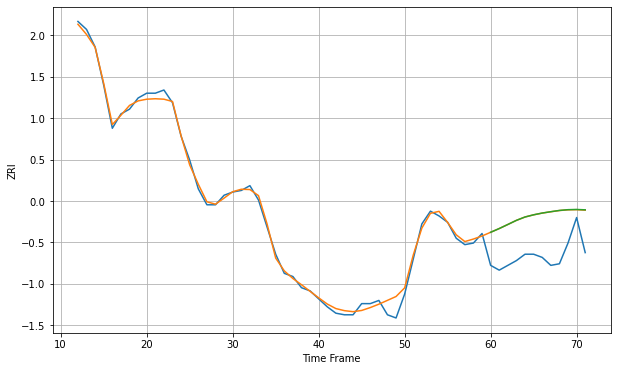

Wall time: 15.6 s
99504 3.2783267519432258 25.408106417682927 25.453305932112762 [1436.75261349 1439.09755936 1441.64986803 1444.23962026 1446.34682227
 1447.72084812 1448.82449537 1449.67059532 1450.45765352 1450.93475601
 1451.06572509 1450.83832203]
60 60 12


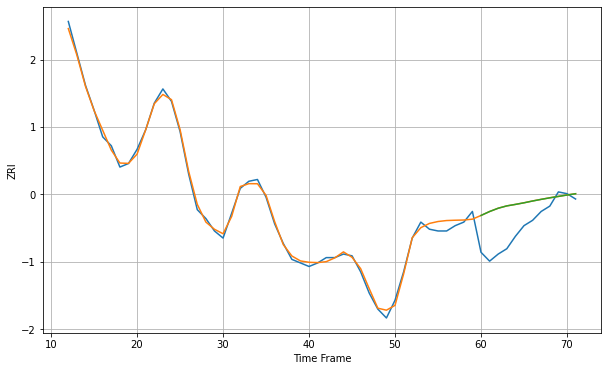

Wall time: 16.3 s
99508 2.362608262363327 16.20882691340858 16.20363989099083 [1276.74344441 1278.95579555 1280.8145675  1282.12622896 1282.95855345
 1283.86630201 1284.88062298 1285.80358254 1286.66856776 1287.45157816
 1288.23818209 1288.96869194]
60 60 12


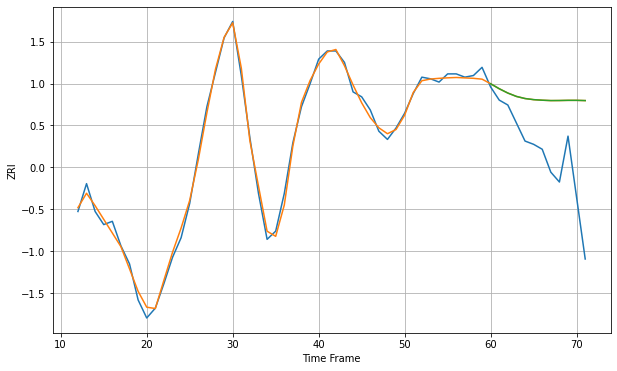

Wall time: 16.2 s
99654 3.479017180617018 41.243359479730685 41.25441779251796 [1330.97603307 1327.93572809 1325.30235478 1323.23697298 1321.95802553
 1321.27983327 1320.93683345 1320.71296786 1320.75163682 1320.85699968
 1320.85771448 1320.70994325]


In [13]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_test":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_test, M_pure, forecast = NN_test(ZONE, plot=True);
        print(ZONE, M_train, M_test, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [14]:
print(len(score_dict["RMSE_pure"]), sum(score_dict["RMSE_test"])/len(score_dict["RMSE_test"]),
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

1301 62.61653736641492 62.522703232513564


In [15]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_test,RMSE_pure,forecast
0,1013,4.594100,77.158051,77.196368,"[1093.8905945563306, 1084.6683115480425, 1077...."
1,1020,5.039781,67.789162,67.798570,"[1125.3007868419265, 1122.4764948193967, 1119...."
2,1040,3.588007,64.680354,65.144778,"[1093.4570469175562, 1083.4803768081292, 1078...."
3,1085,6.682261,78.266724,77.783950,"[1141.4750208908522, 1134.7845985930182, 1129...."
4,1104,5.955348,83.213050,82.952994,"[1100.837284157796, 1084.6570759538029, 1077.7..."


In [16]:
test.to_csv('NN_feature_window_12_overoverfit.csv', index = False)